In [1]:
import os
import re
from collections import Counter
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
cm = 1/2.54

# force GPU device
os.environ["CUDA_VISIBLE_DEVICES"]='1'
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import tensorflow as tf

from keras.src.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, CSVLogger
from keras.src.layers import SimpleRNN, LSTM, Dense, Dropout, Bidirectional
from keras import Sequential, Input
from keras.losses import CategoricalCrossentropy, CategoricalFocalCrossentropy
from keras.optimizers import Adam
from keras.models import load_model
from keras.metrics import CategoricalAccuracy, TopKCategoricalAccuracy


from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils.class_weight import compute_class_weight

from utils import *

In [2]:
max_sequence_length = 100
experiment_name = 'feature_obj_type_dropout'
top_k = 3

In [3]:
checkpoint_path = f'saves/{experiment_name}'
model_path = f'{checkpoint_path}/model.keras'
log_path = f'{checkpoint_path}/log.csv'
history_path = f'{checkpoint_path}/history.npy'

# ensure directory exists
if not os.path.exists(checkpoint_path):
    os.makedirs(checkpoint_path)

In [4]:
data_directory = '/home/jrosendahl/datasets/cadets/sequences_export_benign_filetypes_more/'
unusable_threshold = 10
rare_threshold = 50
splits = (0.7, 0.15, 0.15)

max_sequence_length = 100

assert(sum(splits) == 1)

print(f'experiment parameters: \n{data_directory=} \n{unusable_threshold=} \n{rare_threshold=} \n{splits=} \n{max_sequence_length=}')

experiment parameters: 
data_directory='/home/jrosendahl/datasets/cadets/sequences_export_benign_filetypes_more/' 
unusable_threshold=10 
rare_threshold=50 
splits=(0.7, 0.15, 0.15) 
max_sequence_length=100


In [5]:
total_classes = 0

# unusable classes will be removed from the dataset
unusable_classes = []
# rare classes will be oversampled
rare_classes = []

# all classes in training data (all classes - unusable classes)
classes = []

# walk all files, build unusable_classes, rare_classes
classes_occurrences = Counter()
for filename in os.listdir(data_directory):
    label = class_from_filename(filename)
    classes_occurrences[label] += 1

total_classes = len(classes_occurrences)
for label, count in classes_occurrences.items():
    if count < unusable_threshold:
        unusable_classes.append(label)
    elif count < rare_threshold:
        rare_classes.append(label)
        classes.append(label)
    else:
        classes.append(label)

print(f'Total classes: {total_classes}')
print(f'Unusable classes: {len(unusable_classes)}')
print(f'\t{unusable_classes}')
print(f'Rare classes: {len(rare_classes)}')
print(f'\t{rare_classes}')

labels_cardinality = len(set(classes))
print(f'Usable classes: {labels_cardinality}')

Total classes: 118
Unusable classes: 51
	['ping', 'pwd_mkdb', 'vi', 'tr', 'uname', 'msgs', 'screen', 'pw', 'bzip2', 'bzcat', 'nginx', 'stat', 'tail', 'smtp', 'kenv', 'nawk', 'ssh', 'chown', 'cut', 'php-fpm', 'jot', 'xz', 'diff', 'bounce', 'links', 'ipfw', 'touch', 'env', 'pfctl', 'minions', 'csh', 'kldstat', 'su', 'nohup', 'stty', 'df', 'limits', 'id', 'postmap', 'ifconfig', 'chkgrp', 'ipfstat', 'locale', 'devd', 'uniq', 'XIM', 'getty', 'which', 'init', 'test', 'nice']
Rare classes: 20
	['wc', 'grep', 'mktemp', 'less', 'tty', 'mailwrapper', 'kill', 'lockf', 'mount', 'tee', 'expr', 'ps', 'route', 'sed', 'cmp', 'egrep', 'sort', 'basename', 'awk', 'mail']
Usable classes: 67


In [6]:
# split into train, validation, test
labels_set = set()

filenames_all = []

filenames_train = []
filenames_val = []
filenames_test = []

for filename in os.listdir(data_directory):
    label = class_from_filename(filename)
    if label in unusable_classes:
        continue
    labels_set.add(label)
    filenames_all.append(filename)

# stratisfied split
test_vs_val = splits[2] / (splits[1] + splits[2])
filenames_train, filenames_val_test = train_test_split(filenames_all, test_size=splits[1]+splits[2], stratify=[class_from_filename(f) for f in filenames_all])
filenames_val, filenames_test = train_test_split(filenames_val_test, test_size=test_vs_val, stratify=[class_from_filename(f) for f in filenames_val_test])

print(f'Train: {len(filenames_train)}')
print(f'Validation: {len(filenames_val)}')
print(f'Test: {len(filenames_test)}')

# build labels_map in alphabetical order
labels_map = {}
for i, label in enumerate(sorted(labels_set)):
    labels_map[label] = i

Train: 150475
Validation: 32245
Test: 32245


In [7]:
# load data
count_files_read = 0
count_sequences_split = 0
count_splits = 0

preprocessor = Preprocessor(['TYPE', 'PRED_OBJ_TYPES'])

def parse_file(filename) -> tuple[list[int], list[list[int]]]:
    """
    Parse a file and return the vectorized data. Not a pure function (calls parse_line)!
    """
    global count_files_read, count_sequences_split, count_splits

    y_list: list[int] = []
    X_list: list[list[int]] = []
    y = class_from_filename(filename)
    y = labels_map[y]
    with open(os.path.join(data_directory, filename), 'r') as f:
        lines = f.readlines()
        count_files_read += 1
    if count_files_read % 50000 == 0:
        print(f'Files read: {count_files_read}')
    X = []
    for line in lines:
        line_res = preprocessor.process(line)
        event = line_res['TYPE']
        ob1_type = line_res['PRED_OBJ1_TYPE']
        ob2_type = line_res['PRED_OBJ2_TYPE']
        X.append((event, ob1_type, ob2_type))

    # check if sequence needs to be split
    if len(X) > max_sequence_length:
        count_sequences_split += 1
        count_splits += len(X) // max_sequence_length
        for i in range(0, len(X), max_sequence_length):
            y_list.append(y)
            X_list.append(X[i:i+max_sequence_length])
        assert len(X_list[0]) == max_sequence_length
    else:
        y_list.append(y)
        X_list.append(X)

    # transform elements to numpy arrays
    y_list = np.array(y_list)
    X_list = [np.array(x) for x in X_list]

    assert len(y_list) == len(X_list)
    return y_list, X_list


y_train = []
X_train = []
y_val = []
X_val = []
y_test = []
X_test = []

for filename in filenames_train:
    try:
        y_list, X_list = parse_file(filename)
    except Exception as e:
        print(f'Error parsing file: {filename}')
        raise e
    y_train.extend(y_list)
    X_train.extend(X_list)

for filename in filenames_val:
    y_list, X_list = parse_file(filename)
    y_val.extend(y_list)
    X_val.extend(X_list)

for filename in filenames_test:
    y_list, X_list = parse_file(filename)
    y_test.extend(y_list)
    X_test.extend(X_list)

assert len(X_train) == len(y_train)
assert len(X_val) == len(y_val)
assert len(X_test) == len(y_test)

print(f'Files read: {count_files_read}')
print(f'Sequences split: {count_sequences_split}')
print(f'Splits: {count_splits}')


event_types_map = preprocessor.event_types_map
filetypes_map = preprocessor.filetypes_map

event_types_cardinality = len(event_types_map)
filetypes_cardinality = len(filetypes_map)

print(f'Event types: {event_types_cardinality}')
print(f'Filetypes: {filetypes_cardinality}')


# print lengths
print(f'Train: {len(y_train)}')
print(f'Validation: {len(y_val)}')
print(f'Test: {len(y_test)}')

Files read: 50000


Files read: 100000


Files read: 150000


Files read: 200000


Files read: 214965
Sequences split: 22897
Splits: 132960
Event types: 29
Filetypes: 7
Train: 247249
Validation: 48541
Test: 52084


In [8]:
# debug print all maps (sorted)
print('Event types:')
for k, v in sorted(event_types_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

print('Filetypes:')
for k, v in sorted(filetypes_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

Event types:
0: EVENT_EXECUTE, 1: EVENT_OPEN, 2: EVENT_READ, 3: EVENT_CLOSE, 4: EVENT_MMAP, 5: EVENT_WRITE, 6: EVENT_EXIT, 7: EVENT_CONNECT, 8: EVENT_SENDTO, 9: EVENT_LSEEK, 10: EVENT_CHANGE_PRINCIPAL, 11: EVENT_LOGIN, 12: EVENT_MODIFY_PROCESS, 13: EVENT_FCNTL, 14: EVENT_RECVFROM, 15: EVENT_MPROTECT, 16: EVENT_CREATE_OBJECT, 17: EVENT_ACCEPT, 18: EVENT_UNLINK, 19: EVENT_FORK, 20: EVENT_MODIFY_FILE_ATTRIBUTES, 21: EVENT_LINK, 22: EVENT_RENAME, 23: EVENT_TRUNCATE, 24: EVENT_SIGNAL, 25: EVENT_OTHER, 26: EVENT_SENDMSG, 27: EVENT_RECVMSG, 28: EVENT_BIND, 
Filetypes:
0: None, 1: FILE_OBJECT_FILE, 2: SUBJECT_PROCESS, 3: UNNAMEDPIPE, 4: FILE_OBJECT_UNIX_SOCKET, 5: FILE_OBJECT_DIR, 6: NETFLOW, 


In [9]:
# turn labels map into bidirectional map
for k, v in labels_map.copy().items():
    labels_map[v] = k

# turn feature maps into bidirectional maps
for k, v in event_types_map.copy().items():
    event_types_map[v] = k

for k, v in filetypes_map.copy().items():
    filetypes_map[v] = k

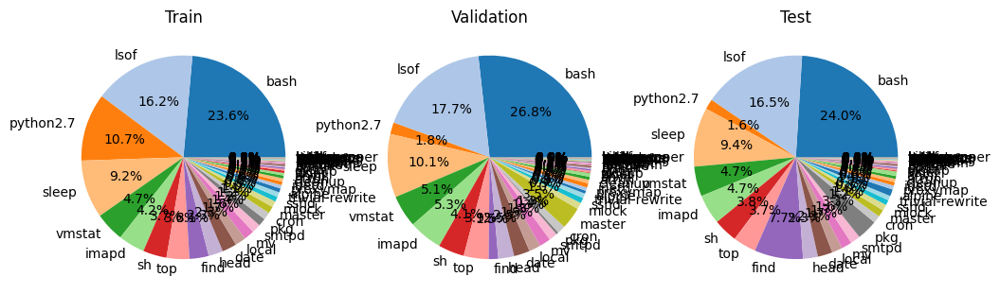

In [10]:
# print distributions in all 3 sets
train_distribution = Counter(y_train)
val_distribution = Counter(y_val)
test_distribution = Counter(y_test)

# plot 3 pie plots, use same colors for same classes
colors = plt.cm.tab20.colors
colors = [ colors[i % 20] for i in range(labels_cardinality) ]

# sort labels by occurence in training set
sorted_labels = sorted(train_distribution, key=train_distribution.get, reverse=True)

# sort all distributions by sorted_labels
train_distribution = [train_distribution[label] for label in sorted_labels]
val_distribution = [val_distribution[label] for label in sorted_labels]
test_distribution = [test_distribution[label] for label in sorted_labels]

# transform labels to names
sorted_labels = [labels_map[label] for label in sorted_labels]

fig, axs = plt.subplots(1, 3, figsize=(30*cm, 10*cm))
axs[0].pie(train_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[0].set_title('Train')
axs[1].pie(val_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[1].set_title('Validation')
axs[2].pie(test_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[2].set_title('Test')
plt.savefig(f'{checkpoint_path}/distributions.png')
plt.show()

In [11]:
# one-hot encode labels
y_train = np.eye(labels_cardinality)[y_train]
y_val = np.eye(labels_cardinality)[y_val]
y_test = np.eye(labels_cardinality)[y_test]

In [12]:
# one-hot encode features
# at this point, X_* are lists of tuples of vectorized features
def encode_features(sequence: np.ndarray) -> np.ndarray:
    # Precompute identity matrices
    event_eye = np.eye(event_types_cardinality)
    filetype_eye = np.eye(filetypes_cardinality)

    # Initialize the output array with precomputed shapes
    encoded_seq = np.empty((len(sequence), event_eye.shape[1] + (2* filetype_eye.shape[1])))

    for i, feature_vector in enumerate(sequence):
        event = event_eye[feature_vector[0]]
        ob1_type = filetype_eye[feature_vector[1]]
        ob2_type = filetype_eye[feature_vector[2]]

        # Concatenate all features into a single feature vector
        encoded_seq[i] = np.concatenate((event, ob1_type, ob2_type))

    return encoded_seq

X_train = [ encode_features(x) for x in X_train ]
X_val = [ encode_features(x) for x in X_val ]
X_test = [ encode_features(x) for x in X_test ]

In [13]:
feature_vector_cardinality = X_train[0].shape[1]

print(f'Feature vector cardinality: {feature_vector_cardinality}')

Feature vector cardinality: 43


In [14]:
X_train, y_train = shuffle(X_train, y_train)
X_val, y_val = shuffle(X_val, y_val)
X_test, y_test = shuffle(X_test, y_test)

build model

In [15]:
model = Sequential(layers=[
    Input(shape=(None, feature_vector_cardinality)),
    SimpleRNN(128, return_sequences=True, dropout=0.1, recurrent_dropout=0.1),
    SimpleRNN(128, return_sequences=True, dropout=0.1, recurrent_dropout=0.1),
    SimpleRNN(128, return_sequences=False, dropout=0.1, recurrent_dropout=0.1),
    Dense(labels_cardinality, activation='softmax')
])

model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ simple_rnn (SimpleRNN)          │ (None, None, 128)      │        22,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_1 (SimpleRNN)        │ (None, None, 128)      │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_2 (SimpleRNN)        │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 67)             │         8,643 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 96,451 (376.76 KB)

 Trainable params: 96,451 (376.76 KB)

 Non-trainable params: 0 (0.00 B)

In [16]:
callbacks = [
    EarlyStopping(
        monitor='val_loss',
        patience=7,
        verbose=1,
        mode='auto'
    ),
    ModelCheckpoint(
        filepath=model_path,
        monitor='val_loss',
        save_best_only=True,
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.1,
        patience=3,
        verbose=1,
        mode='auto',
        min_lr=1e-7
    ),
    CSVLogger(
        filename=log_path,
        append=True
    )
]

loss = CategoricalCrossentropy()
optimizer = Adam(learning_rate=0.0001)

# class weights
y_train_int = np.argmax(y_train, axis=1)
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train_int),
    y=y_train_int
)
class_weights_dict = dict(enumerate(class_weights))

metrics = [
    CategoricalAccuracy(name='categorical_accuracy'),
    TopKCategoricalAccuracy(k=top_k, name=f'top_{top_k}_categorical_accuracy'),
]

weighted_metrics = [
    CategoricalAccuracy(name='w_categorical_accuracy'),
    TopKCategoricalAccuracy(k=top_k, name=f'w_top_{top_k}_categorical_accuracy'),
]

# 'categorical_focal_crossentropy'
# 'categorical_crossentropy'
model.compile(
    loss=loss,
    optimizer=optimizer,
    metrics=metrics,
    weighted_metrics=weighted_metrics,
)

train model

In [17]:
history = model.fit(
    x=Generator(X_train, y_train, 64, max_sequence_length),
    validation_data=Generator(X_val, y_val, 64, max_sequence_length),
    epochs=200,
    callbacks=callbacks,
    class_weight=class_weights_dict
)

# save history to file
with open(history_path, 'wb') as f:
    np.save(f, history.history)

Epoch 1/200


I0000 00:00:1723943590.639652 3431901 service.cc:145] XLA service 0x21c31610 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1723943590.639699 3431901 service.cc:153]   StreamExecutor device (0): NVIDIA GeForce RTX 2080 Ti, Compute Capability 7.5


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 16:39:13 16s/step - categorical_accuracy: 0.0156 - loss: 2.0935 - top_3_categorical_accuracy: 0.0469 - w_categorical_accuracy: 0.0047 - w_top_3_categorical_accuracy: 0.0089

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:10 34ms/step - categorical_accuracy: 0.0174 - loss: 2.1135 - top_3_categorical_accuracy: 0.0460 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.0926   

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 33ms/step - categorical_accuracy: 0.0199 - loss: 3.1316 - top_3_categorical_accuracy: 0.0518 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.0955

I0000 00:00:1723943603.113990 3431901 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 32ms/step - categorical_accuracy: 0.0218 - loss: 5.0163 - top_3_categorical_accuracy: 0.0546 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.0783

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.0227 - loss: 5.7154 - top_3_categorical_accuracy: 0.0567 - w_categorical_accuracy: 0.0603 - w_top_3_categorical_accuracy: 0.0685

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.0229 - loss: 5.9839 - top_3_categorical_accuracy: 0.0583 - w_categorical_accuracy: 0.0543 - w_top_3_categorical_accuracy: 0.0625

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0230 - loss: 6.0641 - top_3_categorical_accuracy: 0.0600 - w_categorical_accuracy: 0.0498 - w_top_3_categorical_accuracy: 0.0592

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0232 - loss: 6.0873 - top_3_categorical_accuracy: 0.0611 - w_categorical_accuracy: 0.0463 - w_top_3_categorical_accuracy: 0.0565

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0234 - loss: 6.0696 - top_3_categorical_accuracy: 0.0618 - w_categorical_accuracy: 0.0436 - w_top_3_categorical_accuracy: 0.0541

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.0236 - loss: 6.0488 - top_3_categorical_accuracy: 0.0622 - w_categorical_accuracy: 0.0412 - w_top_3_categorical_accuracy: 0.0521

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0237 - loss: 6.0008 - top_3_categorical_accuracy: 0.0623 - w_categorical_accuracy: 0.0393 - w_top_3_categorical_accuracy: 0.0505

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0238 - loss: 5.9460 - top_3_categorical_accuracy: 0.0626 - w_categorical_accuracy: 0.0376 - w_top_3_categorical_accuracy: 0.0490

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0239 - loss: 5.8799 - top_3_categorical_accuracy: 0.0626 - w_categorical_accuracy: 0.0362 - w_top_3_categorical_accuracy: 0.0477

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0239 - loss: 5.8239 - top_3_categorical_accuracy: 0.0625 - w_categorical_accuracy: 0.0348 - w_top_3_categorical_accuracy: 0.0465

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0239 - loss: 5.7602 - top_3_categorical_accuracy: 0.0623 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0455

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0238 - loss: 5.6968 - top_3_categorical_accuracy: 0.0620 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0446

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.0237 - loss: 5.6420 - top_3_categorical_accuracy: 0.0618 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0437

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.0236 - loss: 5.5909 - top_3_categorical_accuracy: 0.0616 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0429

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.0235 - loss: 5.5363 - top_3_categorical_accuracy: 0.0615 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0421

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.0235 - loss: 5.4842 - top_3_categorical_accuracy: 0.0614 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0416

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.0234 - loss: 5.4343 - top_3_categorical_accuracy: 0.0613 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0412

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.0234 - loss: 5.3829 - top_3_categorical_accuracy: 0.0613 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0409

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.0234 - loss: 5.3323 - top_3_categorical_accuracy: 0.0613 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0405

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.0233 - loss: 5.2897 - top_3_categorical_accuracy: 0.0613 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0404

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.0232 - loss: 5.2466 - top_3_categorical_accuracy: 0.0613 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0404

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.0232 - loss: 5.2105 - top_3_categorical_accuracy: 0.0614 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0402

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.0232 - loss: 5.1750 - top_3_categorical_accuracy: 0.0615 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0401

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.0232 - loss: 5.1403 - top_3_categorical_accuracy: 0.0615 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0400

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.0232 - loss: 5.1113 - top_3_categorical_accuracy: 0.0616 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0398

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.0232 - loss: 5.0816 - top_3_categorical_accuracy: 0.0617 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0397

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0232 - loss: 5.0562 - top_3_categorical_accuracy: 0.0618 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0395

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0232 - loss: 5.0305 - top_3_categorical_accuracy: 0.0618 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0393

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0231 - loss: 5.0084 - top_3_categorical_accuracy: 0.0618 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0392

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0231 - loss: 4.9853 - top_3_categorical_accuracy: 0.0618 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0390

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0230 - loss: 4.9618 - top_3_categorical_accuracy: 0.0618 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0388

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0230 - loss: 4.9393 - top_3_categorical_accuracy: 0.0618 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0388

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0230 - loss: 4.9170 - top_3_categorical_accuracy: 0.0618 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0388

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0230 - loss: 4.8954 - top_3_categorical_accuracy: 0.0618 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0387

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0230 - loss: 4.8742 - top_3_categorical_accuracy: 0.0619 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0387

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0230 - loss: 4.8562 - top_3_categorical_accuracy: 0.0619 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0386

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0230 - loss: 4.8381 - top_3_categorical_accuracy: 0.0619 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0386

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0230 - loss: 4.8215 - top_3_categorical_accuracy: 0.0620 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0385

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0230 - loss: 4.8063 - top_3_categorical_accuracy: 0.0620 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0384

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0229 - loss: 4.7917 - top_3_categorical_accuracy: 0.0620 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0385

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0229 - loss: 4.7779 - top_3_categorical_accuracy: 0.0620 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0385

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0229 - loss: 4.7648 - top_3_categorical_accuracy: 0.0621 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0386

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0229 - loss: 4.7512 - top_3_categorical_accuracy: 0.0621 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0386

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0229 - loss: 4.7370 - top_3_categorical_accuracy: 0.0622 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0387

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0229 - loss: 4.7235 - top_3_categorical_accuracy: 0.0622 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0387

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0230 - loss: 4.7107 - top_3_categorical_accuracy: 0.0622 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0387

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.0230 - loss: 4.6977 - top_3_categorical_accuracy: 0.0623 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0388

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0230 - loss: 4.6847 - top_3_categorical_accuracy: 0.0624 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0388

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0230 - loss: 4.6745 - top_3_categorical_accuracy: 0.0624 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0388

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0231 - loss: 4.6643 - top_3_categorical_accuracy: 0.0625 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0388

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0231 - loss: 4.6537 - top_3_categorical_accuracy: 0.0626 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0388

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0232 - loss: 4.6431 - top_3_categorical_accuracy: 0.0627 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0388

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0232 - loss: 4.6324 - top_3_categorical_accuracy: 0.0627 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0388

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0232 - loss: 4.6214 - top_3_categorical_accuracy: 0.0628 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0388

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0233 - loss: 4.6118 - top_3_categorical_accuracy: 0.0628 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0387

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0233 - loss: 4.6038 - top_3_categorical_accuracy: 0.0629 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0387

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0233 - loss: 4.5959 - top_3_categorical_accuracy: 0.0630 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0387

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0234 - loss: 4.5880 - top_3_categorical_accuracy: 0.0631 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0387

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0234 - loss: 4.5803 - top_3_categorical_accuracy: 0.0631 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0387

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.0235 - loss: 4.5733 - top_3_categorical_accuracy: 0.0632 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0387

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0235 - loss: 4.5664 - top_3_categorical_accuracy: 0.0633 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0386

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0236 - loss: 4.5594 - top_3_categorical_accuracy: 0.0633 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0386

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0236 - loss: 4.5521 - top_3_categorical_accuracy: 0.0634 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0386

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0237 - loss: 4.5450 - top_3_categorical_accuracy: 0.0635 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0386

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0237 - loss: 4.5381 - top_3_categorical_accuracy: 0.0636 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0386

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0238 - loss: 4.5311 - top_3_categorical_accuracy: 0.0637 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0386

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0238 - loss: 4.5239 - top_3_categorical_accuracy: 0.0638 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0385

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0239 - loss: 4.5166 - top_3_categorical_accuracy: 0.0639 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0385

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0239 - loss: 4.5111 - top_3_categorical_accuracy: 0.0640 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0385

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0240 - loss: 4.5063 - top_3_categorical_accuracy: 0.0641 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0386

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0240 - loss: 4.5014 - top_3_categorical_accuracy: 0.0642 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0386

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0241 - loss: 4.4967 - top_3_categorical_accuracy: 0.0643 - w_categorical_accuracy: 0.0187 - w_top_3_categorical_accuracy: 0.0387

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0241 - loss: 4.4921 - top_3_categorical_accuracy: 0.0644 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0388

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0242 - loss: 4.4875 - top_3_categorical_accuracy: 0.0645 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0389

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0243 - loss: 4.4830 - top_3_categorical_accuracy: 0.0646 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0389

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0243 - loss: 4.4788 - top_3_categorical_accuracy: 0.0647 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0390

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.0244 - loss: 4.4753 - top_3_categorical_accuracy: 0.0648 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0390

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0245 - loss: 4.4729 - top_3_categorical_accuracy: 0.0649 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0391

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0245 - loss: 4.4704 - top_3_categorical_accuracy: 0.0650 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0391

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0246 - loss: 4.4681 - top_3_categorical_accuracy: 0.0651 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0391

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0246 - loss: 4.4678 - top_3_categorical_accuracy: 0.0652 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0392

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0247 - loss: 4.4677 - top_3_categorical_accuracy: 0.0653 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0392

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0248 - loss: 4.4672 - top_3_categorical_accuracy: 0.0654 - w_categorical_accuracy: 0.0180 - w_top_3_categorical_accuracy: 0.0392

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0248 - loss: 4.4667 - top_3_categorical_accuracy: 0.0655 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0392

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0249 - loss: 4.4663 - top_3_categorical_accuracy: 0.0656 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0392

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.0249 - loss: 4.4656 - top_3_categorical_accuracy: 0.0657 - w_categorical_accuracy: 0.0178 - w_top_3_categorical_accuracy: 0.0392

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0250 - loss: 4.4647 - top_3_categorical_accuracy: 0.0658 - w_categorical_accuracy: 0.0178 - w_top_3_categorical_accuracy: 0.0392

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0250 - loss: 4.4639 - top_3_categorical_accuracy: 0.0659 - w_categorical_accuracy: 0.0177 - w_top_3_categorical_accuracy: 0.0392

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0251 - loss: 4.4629 - top_3_categorical_accuracy: 0.0660 - w_categorical_accuracy: 0.0176 - w_top_3_categorical_accuracy: 0.0392

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0252 - loss: 4.4618 - top_3_categorical_accuracy: 0.0661 - w_categorical_accuracy: 0.0176 - w_top_3_categorical_accuracy: 0.0392

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0252 - loss: 4.4608 - top_3_categorical_accuracy: 0.0662 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0391

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0253 - loss: 4.4596 - top_3_categorical_accuracy: 0.0663 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0391

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0253 - loss: 4.4582 - top_3_categorical_accuracy: 0.0664 - w_categorical_accuracy: 0.0174 - w_top_3_categorical_accuracy: 0.0391

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0254 - loss: 4.4567 - top_3_categorical_accuracy: 0.0665 - w_categorical_accuracy: 0.0174 - w_top_3_categorical_accuracy: 0.0391

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0254 - loss: 4.4549 - top_3_categorical_accuracy: 0.0666 - w_categorical_accuracy: 0.0173 - w_top_3_categorical_accuracy: 0.0391

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0255 - loss: 4.4530 - top_3_categorical_accuracy: 0.0667 - w_categorical_accuracy: 0.0173 - w_top_3_categorical_accuracy: 0.0391

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.0256 - loss: 4.4515 - top_3_categorical_accuracy: 0.0668 - w_categorical_accuracy: 0.0172 - w_top_3_categorical_accuracy: 0.0391

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0256 - loss: 4.4500 - top_3_categorical_accuracy: 0.0669 - w_categorical_accuracy: 0.0172 - w_top_3_categorical_accuracy: 0.0391

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0257 - loss: 4.4496 - top_3_categorical_accuracy: 0.0670 - w_categorical_accuracy: 0.0171 - w_top_3_categorical_accuracy: 0.0395

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0257 - loss: 4.4492 - top_3_categorical_accuracy: 0.0671 - w_categorical_accuracy: 0.0171 - w_top_3_categorical_accuracy: 0.0398

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0258 - loss: 4.4489 - top_3_categorical_accuracy: 0.0672 - w_categorical_accuracy: 0.0170 - w_top_3_categorical_accuracy: 0.0401

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0258 - loss: 4.4485 - top_3_categorical_accuracy: 0.0673 - w_categorical_accuracy: 0.0170 - w_top_3_categorical_accuracy: 0.0404

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0259 - loss: 4.4480 - top_3_categorical_accuracy: 0.0674 - w_categorical_accuracy: 0.0169 - w_top_3_categorical_accuracy: 0.0407

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0259 - loss: 4.4474 - top_3_categorical_accuracy: 0.0675 - w_categorical_accuracy: 0.0169 - w_top_3_categorical_accuracy: 0.0409

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0260 - loss: 4.4466 - top_3_categorical_accuracy: 0.0676 - w_categorical_accuracy: 0.0168 - w_top_3_categorical_accuracy: 0.0412

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0261 - loss: 4.4456 - top_3_categorical_accuracy: 0.0677 - w_categorical_accuracy: 0.0168 - w_top_3_categorical_accuracy: 0.0415

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0261 - loss: 4.4449 - top_3_categorical_accuracy: 0.0678 - w_categorical_accuracy: 0.0167 - w_top_3_categorical_accuracy: 0.0417

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.0262 - loss: 4.4444 - top_3_categorical_accuracy: 0.0679 - w_categorical_accuracy: 0.0167 - w_top_3_categorical_accuracy: 0.0420

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0262 - loss: 4.4438 - top_3_categorical_accuracy: 0.0680 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0422

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0263 - loss: 4.4430 - top_3_categorical_accuracy: 0.0681 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0425

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0263 - loss: 4.4422 - top_3_categorical_accuracy: 0.0682 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0427

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0264 - loss: 4.4412 - top_3_categorical_accuracy: 0.0683 - w_categorical_accuracy: 0.0165 - w_top_3_categorical_accuracy: 0.0429

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0265 - loss: 4.4403 - top_3_categorical_accuracy: 0.0684 - w_categorical_accuracy: 0.0165 - w_top_3_categorical_accuracy: 0.0431

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0265 - loss: 4.4393 - top_3_categorical_accuracy: 0.0685 - w_categorical_accuracy: 0.0164 - w_top_3_categorical_accuracy: 0.0433

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0266 - loss: 4.4382 - top_3_categorical_accuracy: 0.0686 - w_categorical_accuracy: 0.0164 - w_top_3_categorical_accuracy: 0.0435

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0266 - loss: 4.4370 - top_3_categorical_accuracy: 0.0687 - w_categorical_accuracy: 0.0164 - w_top_3_categorical_accuracy: 0.0437

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0267 - loss: 4.4356 - top_3_categorical_accuracy: 0.0688 - w_categorical_accuracy: 0.0163 - w_top_3_categorical_accuracy: 0.0439

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0267 - loss: 4.4341 - top_3_categorical_accuracy: 0.0689 - w_categorical_accuracy: 0.0163 - w_top_3_categorical_accuracy: 0.0441

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0268 - loss: 4.4327 - top_3_categorical_accuracy: 0.0690 - w_categorical_accuracy: 0.0163 - w_top_3_categorical_accuracy: 0.0443

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0268 - loss: 4.4313 - top_3_categorical_accuracy: 0.0691 - w_categorical_accuracy: 0.0162 - w_top_3_categorical_accuracy: 0.0445

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0269 - loss: 4.4298 - top_3_categorical_accuracy: 0.0692 - w_categorical_accuracy: 0.0162 - w_top_3_categorical_accuracy: 0.0447

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0269 - loss: 4.4282 - top_3_categorical_accuracy: 0.0693 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0448

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0270 - loss: 4.4265 - top_3_categorical_accuracy: 0.0694 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0450

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0270 - loss: 4.4248 - top_3_categorical_accuracy: 0.0695 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0452

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0271 - loss: 4.4230 - top_3_categorical_accuracy: 0.0696 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0453

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0271 - loss: 4.4214 - top_3_categorical_accuracy: 0.0697 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0455

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0272 - loss: 4.4199 - top_3_categorical_accuracy: 0.0698 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0456

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0272 - loss: 4.4182 - top_3_categorical_accuracy: 0.0699 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0458

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0273 - loss: 4.4165 - top_3_categorical_accuracy: 0.0700 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0459

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.0274 - loss: 4.4146 - top_3_categorical_accuracy: 0.0701 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0461

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0274 - loss: 4.4127 - top_3_categorical_accuracy: 0.0702 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0462

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0275 - loss: 4.4107 - top_3_categorical_accuracy: 0.0702 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0463

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0275 - loss: 4.4087 - top_3_categorical_accuracy: 0.0703 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0465

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0276 - loss: 4.4066 - top_3_categorical_accuracy: 0.0704 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0466

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0276 - loss: 4.4048 - top_3_categorical_accuracy: 0.0705 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0467

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0277 - loss: 4.4030 - top_3_categorical_accuracy: 0.0706 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0469

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0277 - loss: 4.4010 - top_3_categorical_accuracy: 0.0707 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0470

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.0278 - loss: 4.3990 - top_3_categorical_accuracy: 0.0708 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0471

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 3:56 66ms/step - categorical_accuracy: 0.0278 - loss: 4.3971 - top_3_categorical_accuracy: 0.0709 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0472

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 3:55 66ms/step - categorical_accuracy: 0.0279 - loss: 4.3950 - top_3_categorical_accuracy: 0.0710 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0474

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 3:54 66ms/step - categorical_accuracy: 0.0279 - loss: 4.3930 - top_3_categorical_accuracy: 0.0711 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0475

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 3:53 65ms/step - categorical_accuracy: 0.0280 - loss: 4.3911 - top_3_categorical_accuracy: 0.0712 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0476

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 3:52 65ms/step - categorical_accuracy: 0.0280 - loss: 4.3891 - top_3_categorical_accuracy: 0.0713 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0477

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 3:51 65ms/step - categorical_accuracy: 0.0281 - loss: 4.3871 - top_3_categorical_accuracy: 0.0714 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0478

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 3:50 65ms/step - categorical_accuracy: 0.0281 - loss: 4.3850 - top_3_categorical_accuracy: 0.0715 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0479

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 3:49 64ms/step - categorical_accuracy: 0.0282 - loss: 4.3829 - top_3_categorical_accuracy: 0.0716 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0480

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 3:48 64ms/step - categorical_accuracy: 0.0283 - loss: 4.3810 - top_3_categorical_accuracy: 0.0717 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0481

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 3:47 64ms/step - categorical_accuracy: 0.0283 - loss: 4.3791 - top_3_categorical_accuracy: 0.0718 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0482

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 3:46 64ms/step - categorical_accuracy: 0.0284 - loss: 4.3770 - top_3_categorical_accuracy: 0.0719 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0483

 306/3864 ━━━━━━━━━━━━━━━━━━━━ 3:46 64ms/step - categorical_accuracy: 0.0284 - loss: 4.3760 - top_3_categorical_accuracy: 0.0719 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0484

 308/3864 ━━━━━━━━━━━━━━━━━━━━ 3:45 63ms/step - categorical_accuracy: 0.0285 - loss: 4.3739 - top_3_categorical_accuracy: 0.0720 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0484

 310/3864 ━━━━━━━━━━━━━━━━━━━━ 3:44 63ms/step - categorical_accuracy: 0.0285 - loss: 4.3718 - top_3_categorical_accuracy: 0.0721 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0485

 312/3864 ━━━━━━━━━━━━━━━━━━━━ 3:43 63ms/step - categorical_accuracy: 0.0286 - loss: 4.3697 - top_3_categorical_accuracy: 0.0722 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0486

 314/3864 ━━━━━━━━━━━━━━━━━━━━ 3:42 63ms/step - categorical_accuracy: 0.0286 - loss: 4.3675 - top_3_categorical_accuracy: 0.0723 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0487

 316/3864 ━━━━━━━━━━━━━━━━━━━━ 3:42 63ms/step - categorical_accuracy: 0.0287 - loss: 4.3653 - top_3_categorical_accuracy: 0.0724 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0488

 318/3864 ━━━━━━━━━━━━━━━━━━━━ 3:41 62ms/step - categorical_accuracy: 0.0287 - loss: 4.3632 - top_3_categorical_accuracy: 0.0725 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0489

 320/3864 ━━━━━━━━━━━━━━━━━━━━ 3:40 62ms/step - categorical_accuracy: 0.0288 - loss: 4.3611 - top_3_categorical_accuracy: 0.0726 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0490

 322/3864 ━━━━━━━━━━━━━━━━━━━━ 3:39 62ms/step - categorical_accuracy: 0.0289 - loss: 4.3590 - top_3_categorical_accuracy: 0.0728 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0491

 324/3864 ━━━━━━━━━━━━━━━━━━━━ 3:38 62ms/step - categorical_accuracy: 0.0289 - loss: 4.3569 - top_3_categorical_accuracy: 0.0729 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0491

 326/3864 ━━━━━━━━━━━━━━━━━━━━ 3:37 62ms/step - categorical_accuracy: 0.0290 - loss: 4.3548 - top_3_categorical_accuracy: 0.0730 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0492

 328/3864 ━━━━━━━━━━━━━━━━━━━━ 3:37 61ms/step - categorical_accuracy: 0.0290 - loss: 4.3527 - top_3_categorical_accuracy: 0.0731 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0493

 330/3864 ━━━━━━━━━━━━━━━━━━━━ 3:36 61ms/step - categorical_accuracy: 0.0291 - loss: 4.3506 - top_3_categorical_accuracy: 0.0732 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0494

 332/3864 ━━━━━━━━━━━━━━━━━━━━ 3:35 61ms/step - categorical_accuracy: 0.0292 - loss: 4.3484 - top_3_categorical_accuracy: 0.0733 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0495

 334/3864 ━━━━━━━━━━━━━━━━━━━━ 3:34 61ms/step - categorical_accuracy: 0.0292 - loss: 4.3463 - top_3_categorical_accuracy: 0.0734 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0495

 336/3864 ━━━━━━━━━━━━━━━━━━━━ 3:34 61ms/step - categorical_accuracy: 0.0293 - loss: 4.3441 - top_3_categorical_accuracy: 0.0735 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0496

 338/3864 ━━━━━━━━━━━━━━━━━━━━ 3:33 60ms/step - categorical_accuracy: 0.0293 - loss: 4.3420 - top_3_categorical_accuracy: 0.0736 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0497

 340/3864 ━━━━━━━━━━━━━━━━━━━━ 3:32 60ms/step - categorical_accuracy: 0.0294 - loss: 4.3400 - top_3_categorical_accuracy: 0.0737 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0498

 342/3864 ━━━━━━━━━━━━━━━━━━━━ 3:31 60ms/step - categorical_accuracy: 0.0295 - loss: 4.3382 - top_3_categorical_accuracy: 0.0738 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0499

 344/3864 ━━━━━━━━━━━━━━━━━━━━ 3:31 60ms/step - categorical_accuracy: 0.0295 - loss: 4.3366 - top_3_categorical_accuracy: 0.0739 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0499

 346/3864 ━━━━━━━━━━━━━━━━━━━━ 3:30 60ms/step - categorical_accuracy: 0.0296 - loss: 4.3350 - top_3_categorical_accuracy: 0.0740 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0500

 348/3864 ━━━━━━━━━━━━━━━━━━━━ 3:29 60ms/step - categorical_accuracy: 0.0296 - loss: 4.3334 - top_3_categorical_accuracy: 0.0741 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0501

 350/3864 ━━━━━━━━━━━━━━━━━━━━ 3:28 59ms/step - categorical_accuracy: 0.0297 - loss: 4.3318 - top_3_categorical_accuracy: 0.0742 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0501

 352/3864 ━━━━━━━━━━━━━━━━━━━━ 3:28 59ms/step - categorical_accuracy: 0.0298 - loss: 4.3302 - top_3_categorical_accuracy: 0.0743 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0502

 354/3864 ━━━━━━━━━━━━━━━━━━━━ 3:27 59ms/step - categorical_accuracy: 0.0298 - loss: 4.3287 - top_3_categorical_accuracy: 0.0744 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0503

 356/3864 ━━━━━━━━━━━━━━━━━━━━ 3:26 59ms/step - categorical_accuracy: 0.0299 - loss: 4.3273 - top_3_categorical_accuracy: 0.0745 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0504

 358/3864 ━━━━━━━━━━━━━━━━━━━━ 3:26 59ms/step - categorical_accuracy: 0.0299 - loss: 4.3259 - top_3_categorical_accuracy: 0.0746 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0504

 360/3864 ━━━━━━━━━━━━━━━━━━━━ 3:25 59ms/step - categorical_accuracy: 0.0300 - loss: 4.3244 - top_3_categorical_accuracy: 0.0748 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0505

 362/3864 ━━━━━━━━━━━━━━━━━━━━ 3:24 58ms/step - categorical_accuracy: 0.0301 - loss: 4.3228 - top_3_categorical_accuracy: 0.0749 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0505

 364/3864 ━━━━━━━━━━━━━━━━━━━━ 3:24 58ms/step - categorical_accuracy: 0.0301 - loss: 4.3212 - top_3_categorical_accuracy: 0.0750 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0506

 366/3864 ━━━━━━━━━━━━━━━━━━━━ 3:23 58ms/step - categorical_accuracy: 0.0302 - loss: 4.3196 - top_3_categorical_accuracy: 0.0751 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0507

 368/3864 ━━━━━━━━━━━━━━━━━━━━ 3:22 58ms/step - categorical_accuracy: 0.0302 - loss: 4.3181 - top_3_categorical_accuracy: 0.0752 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0507

 370/3864 ━━━━━━━━━━━━━━━━━━━━ 3:22 58ms/step - categorical_accuracy: 0.0303 - loss: 4.3165 - top_3_categorical_accuracy: 0.0753 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0508

 372/3864 ━━━━━━━━━━━━━━━━━━━━ 3:21 58ms/step - categorical_accuracy: 0.0304 - loss: 4.3149 - top_3_categorical_accuracy: 0.0754 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0509

 374/3864 ━━━━━━━━━━━━━━━━━━━━ 3:20 58ms/step - categorical_accuracy: 0.0304 - loss: 4.3134 - top_3_categorical_accuracy: 0.0755 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0509

 376/3864 ━━━━━━━━━━━━━━━━━━━━ 3:20 57ms/step - categorical_accuracy: 0.0305 - loss: 4.3118 - top_3_categorical_accuracy: 0.0756 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0510

 378/3864 ━━━━━━━━━━━━━━━━━━━━ 3:19 57ms/step - categorical_accuracy: 0.0305 - loss: 4.3103 - top_3_categorical_accuracy: 0.0757 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0510

 380/3864 ━━━━━━━━━━━━━━━━━━━━ 3:18 57ms/step - categorical_accuracy: 0.0306 - loss: 4.3087 - top_3_categorical_accuracy: 0.0758 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0511

 382/3864 ━━━━━━━━━━━━━━━━━━━━ 3:18 57ms/step - categorical_accuracy: 0.0307 - loss: 4.3071 - top_3_categorical_accuracy: 0.0759 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0512

 384/3864 ━━━━━━━━━━━━━━━━━━━━ 3:17 57ms/step - categorical_accuracy: 0.0307 - loss: 4.3056 - top_3_categorical_accuracy: 0.0761 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0512

 386/3864 ━━━━━━━━━━━━━━━━━━━━ 3:17 57ms/step - categorical_accuracy: 0.0308 - loss: 4.3041 - top_3_categorical_accuracy: 0.0762 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0513

 388/3864 ━━━━━━━━━━━━━━━━━━━━ 3:16 57ms/step - categorical_accuracy: 0.0308 - loss: 4.3026 - top_3_categorical_accuracy: 0.0763 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0513

 390/3864 ━━━━━━━━━━━━━━━━━━━━ 3:16 56ms/step - categorical_accuracy: 0.0309 - loss: 4.3010 - top_3_categorical_accuracy: 0.0764 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0514

 392/3864 ━━━━━━━━━━━━━━━━━━━━ 3:15 56ms/step - categorical_accuracy: 0.0309 - loss: 4.2995 - top_3_categorical_accuracy: 0.0765 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0514

 394/3864 ━━━━━━━━━━━━━━━━━━━━ 3:14 56ms/step - categorical_accuracy: 0.0310 - loss: 4.2980 - top_3_categorical_accuracy: 0.0766 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0515

 396/3864 ━━━━━━━━━━━━━━━━━━━━ 3:14 56ms/step - categorical_accuracy: 0.0311 - loss: 4.2964 - top_3_categorical_accuracy: 0.0767 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0515

 398/3864 ━━━━━━━━━━━━━━━━━━━━ 3:13 56ms/step - categorical_accuracy: 0.0311 - loss: 4.2949 - top_3_categorical_accuracy: 0.0768 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0516

 400/3864 ━━━━━━━━━━━━━━━━━━━━ 3:13 56ms/step - categorical_accuracy: 0.0312 - loss: 4.2933 - top_3_categorical_accuracy: 0.0769 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0516

 402/3864 ━━━━━━━━━━━━━━━━━━━━ 3:12 56ms/step - categorical_accuracy: 0.0312 - loss: 4.2917 - top_3_categorical_accuracy: 0.0770 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0517

 404/3864 ━━━━━━━━━━━━━━━━━━━━ 3:12 56ms/step - categorical_accuracy: 0.0313 - loss: 4.2901 - top_3_categorical_accuracy: 0.0771 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0517

 406/3864 ━━━━━━━━━━━━━━━━━━━━ 3:11 55ms/step - categorical_accuracy: 0.0314 - loss: 4.2885 - top_3_categorical_accuracy: 0.0772 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0518

 408/3864 ━━━━━━━━━━━━━━━━━━━━ 3:11 55ms/step - categorical_accuracy: 0.0314 - loss: 4.2868 - top_3_categorical_accuracy: 0.0774 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0518

 410/3864 ━━━━━━━━━━━━━━━━━━━━ 3:10 55ms/step - categorical_accuracy: 0.0315 - loss: 4.2852 - top_3_categorical_accuracy: 0.0775 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0519

 412/3864 ━━━━━━━━━━━━━━━━━━━━ 3:09 55ms/step - categorical_accuracy: 0.0315 - loss: 4.2836 - top_3_categorical_accuracy: 0.0776 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0519

 414/3864 ━━━━━━━━━━━━━━━━━━━━ 3:09 55ms/step - categorical_accuracy: 0.0316 - loss: 4.2821 - top_3_categorical_accuracy: 0.0777 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0520

 416/3864 ━━━━━━━━━━━━━━━━━━━━ 3:08 55ms/step - categorical_accuracy: 0.0316 - loss: 4.2805 - top_3_categorical_accuracy: 0.0778 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0520

 418/3864 ━━━━━━━━━━━━━━━━━━━━ 3:08 55ms/step - categorical_accuracy: 0.0317 - loss: 4.2789 - top_3_categorical_accuracy: 0.0779 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0521

 420/3864 ━━━━━━━━━━━━━━━━━━━━ 3:07 55ms/step - categorical_accuracy: 0.0318 - loss: 4.2774 - top_3_categorical_accuracy: 0.0780 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0521

 422/3864 ━━━━━━━━━━━━━━━━━━━━ 3:07 54ms/step - categorical_accuracy: 0.0318 - loss: 4.2758 - top_3_categorical_accuracy: 0.0781 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0522

 424/3864 ━━━━━━━━━━━━━━━━━━━━ 3:06 54ms/step - categorical_accuracy: 0.0319 - loss: 4.2742 - top_3_categorical_accuracy: 0.0782 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0522

 426/3864 ━━━━━━━━━━━━━━━━━━━━ 3:06 54ms/step - categorical_accuracy: 0.0319 - loss: 4.2726 - top_3_categorical_accuracy: 0.0784 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0523

 428/3864 ━━━━━━━━━━━━━━━━━━━━ 3:05 54ms/step - categorical_accuracy: 0.0320 - loss: 4.2711 - top_3_categorical_accuracy: 0.0785 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0523

 430/3864 ━━━━━━━━━━━━━━━━━━━━ 3:05 54ms/step - categorical_accuracy: 0.0321 - loss: 4.2695 - top_3_categorical_accuracy: 0.0786 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0523

 432/3864 ━━━━━━━━━━━━━━━━━━━━ 3:04 54ms/step - categorical_accuracy: 0.0321 - loss: 4.2679 - top_3_categorical_accuracy: 0.0787 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0524

 434/3864 ━━━━━━━━━━━━━━━━━━━━ 3:04 54ms/step - categorical_accuracy: 0.0322 - loss: 4.2663 - top_3_categorical_accuracy: 0.0788 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0524

 436/3864 ━━━━━━━━━━━━━━━━━━━━ 3:03 54ms/step - categorical_accuracy: 0.0323 - loss: 4.2647 - top_3_categorical_accuracy: 0.0789 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0525

 438/3864 ━━━━━━━━━━━━━━━━━━━━ 3:03 54ms/step - categorical_accuracy: 0.0323 - loss: 4.2630 - top_3_categorical_accuracy: 0.0790 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0525

 440/3864 ━━━━━━━━━━━━━━━━━━━━ 3:03 53ms/step - categorical_accuracy: 0.0324 - loss: 4.2614 - top_3_categorical_accuracy: 0.0791 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0526

 442/3864 ━━━━━━━━━━━━━━━━━━━━ 3:02 53ms/step - categorical_accuracy: 0.0324 - loss: 4.2597 - top_3_categorical_accuracy: 0.0793 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0526

 444/3864 ━━━━━━━━━━━━━━━━━━━━ 3:02 53ms/step - categorical_accuracy: 0.0325 - loss: 4.2581 - top_3_categorical_accuracy: 0.0794 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0527

 446/3864 ━━━━━━━━━━━━━━━━━━━━ 3:01 53ms/step - categorical_accuracy: 0.0326 - loss: 4.2565 - top_3_categorical_accuracy: 0.0795 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0527

 448/3864 ━━━━━━━━━━━━━━━━━━━━ 3:01 53ms/step - categorical_accuracy: 0.0326 - loss: 4.2549 - top_3_categorical_accuracy: 0.0796 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0527

 450/3864 ━━━━━━━━━━━━━━━━━━━━ 3:00 53ms/step - categorical_accuracy: 0.0327 - loss: 4.2534 - top_3_categorical_accuracy: 0.0797 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0528

 452/3864 ━━━━━━━━━━━━━━━━━━━━ 3:00 53ms/step - categorical_accuracy: 0.0327 - loss: 4.2518 - top_3_categorical_accuracy: 0.0798 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0528

 454/3864 ━━━━━━━━━━━━━━━━━━━━ 2:59 53ms/step - categorical_accuracy: 0.0328 - loss: 4.2502 - top_3_categorical_accuracy: 0.0799 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0529

 456/3864 ━━━━━━━━━━━━━━━━━━━━ 2:59 53ms/step - categorical_accuracy: 0.0329 - loss: 4.2488 - top_3_categorical_accuracy: 0.0801 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0529

 458/3864 ━━━━━━━━━━━━━━━━━━━━ 2:58 53ms/step - categorical_accuracy: 0.0329 - loss: 4.2474 - top_3_categorical_accuracy: 0.0802 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0529

 460/3864 ━━━━━━━━━━━━━━━━━━━━ 2:58 52ms/step - categorical_accuracy: 0.0330 - loss: 4.2461 - top_3_categorical_accuracy: 0.0803 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0530

 462/3864 ━━━━━━━━━━━━━━━━━━━━ 2:58 52ms/step - categorical_accuracy: 0.0331 - loss: 4.2450 - top_3_categorical_accuracy: 0.0804 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0530

 464/3864 ━━━━━━━━━━━━━━━━━━━━ 2:57 52ms/step - categorical_accuracy: 0.0331 - loss: 4.2439 - top_3_categorical_accuracy: 0.0805 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0530

 466/3864 ━━━━━━━━━━━━━━━━━━━━ 2:57 52ms/step - categorical_accuracy: 0.0332 - loss: 4.2428 - top_3_categorical_accuracy: 0.0806 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0531

 468/3864 ━━━━━━━━━━━━━━━━━━━━ 2:56 52ms/step - categorical_accuracy: 0.0333 - loss: 4.2416 - top_3_categorical_accuracy: 0.0807 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0531

 470/3864 ━━━━━━━━━━━━━━━━━━━━ 2:56 52ms/step - categorical_accuracy: 0.0333 - loss: 4.2404 - top_3_categorical_accuracy: 0.0809 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0532

 472/3864 ━━━━━━━━━━━━━━━━━━━━ 2:55 52ms/step - categorical_accuracy: 0.0334 - loss: 4.2392 - top_3_categorical_accuracy: 0.0810 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0532

 474/3864 ━━━━━━━━━━━━━━━━━━━━ 2:55 52ms/step - categorical_accuracy: 0.0335 - loss: 4.2381 - top_3_categorical_accuracy: 0.0811 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0532

 476/3864 ━━━━━━━━━━━━━━━━━━━━ 2:55 52ms/step - categorical_accuracy: 0.0335 - loss: 4.2370 - top_3_categorical_accuracy: 0.0812 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0533

 478/3864 ━━━━━━━━━━━━━━━━━━━━ 2:54 52ms/step - categorical_accuracy: 0.0336 - loss: 4.2359 - top_3_categorical_accuracy: 0.0813 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0533

 480/3864 ━━━━━━━━━━━━━━━━━━━━ 2:54 51ms/step - categorical_accuracy: 0.0337 - loss: 4.2349 - top_3_categorical_accuracy: 0.0814 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0533

 482/3864 ━━━━━━━━━━━━━━━━━━━━ 2:53 51ms/step - categorical_accuracy: 0.0337 - loss: 4.2340 - top_3_categorical_accuracy: 0.0816 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0534

 484/3864 ━━━━━━━━━━━━━━━━━━━━ 2:53 51ms/step - categorical_accuracy: 0.0338 - loss: 4.2331 - top_3_categorical_accuracy: 0.0817 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0534

 486/3864 ━━━━━━━━━━━━━━━━━━━━ 2:53 51ms/step - categorical_accuracy: 0.0339 - loss: 4.2322 - top_3_categorical_accuracy: 0.0818 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0535

 488/3864 ━━━━━━━━━━━━━━━━━━━━ 2:52 51ms/step - categorical_accuracy: 0.0339 - loss: 4.2313 - top_3_categorical_accuracy: 0.0819 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0535

 490/3864 ━━━━━━━━━━━━━━━━━━━━ 2:52 51ms/step - categorical_accuracy: 0.0340 - loss: 4.2304 - top_3_categorical_accuracy: 0.0820 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0535

 492/3864 ━━━━━━━━━━━━━━━━━━━━ 2:51 51ms/step - categorical_accuracy: 0.0341 - loss: 4.2294 - top_3_categorical_accuracy: 0.0822 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0536

 494/3864 ━━━━━━━━━━━━━━━━━━━━ 2:51 51ms/step - categorical_accuracy: 0.0341 - loss: 4.2285 - top_3_categorical_accuracy: 0.0823 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0536

 496/3864 ━━━━━━━━━━━━━━━━━━━━ 2:51 51ms/step - categorical_accuracy: 0.0342 - loss: 4.2275 - top_3_categorical_accuracy: 0.0824 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0537

 498/3864 ━━━━━━━━━━━━━━━━━━━━ 2:50 51ms/step - categorical_accuracy: 0.0343 - loss: 4.2265 - top_3_categorical_accuracy: 0.0825 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0537

 500/3864 ━━━━━━━━━━━━━━━━━━━━ 2:50 51ms/step - categorical_accuracy: 0.0343 - loss: 4.2255 - top_3_categorical_accuracy: 0.0826 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0537

 502/3864 ━━━━━━━━━━━━━━━━━━━━ 2:49 51ms/step - categorical_accuracy: 0.0344 - loss: 4.2245 - top_3_categorical_accuracy: 0.0828 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0538

 504/3864 ━━━━━━━━━━━━━━━━━━━━ 2:49 50ms/step - categorical_accuracy: 0.0345 - loss: 4.2235 - top_3_categorical_accuracy: 0.0829 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0538

 506/3864 ━━━━━━━━━━━━━━━━━━━━ 2:49 50ms/step - categorical_accuracy: 0.0345 - loss: 4.2225 - top_3_categorical_accuracy: 0.0830 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0538

 508/3864 ━━━━━━━━━━━━━━━━━━━━ 2:48 50ms/step - categorical_accuracy: 0.0346 - loss: 4.2214 - top_3_categorical_accuracy: 0.0831 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0539

 510/3864 ━━━━━━━━━━━━━━━━━━━━ 2:48 50ms/step - categorical_accuracy: 0.0347 - loss: 4.2204 - top_3_categorical_accuracy: 0.0832 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0539

 512/3864 ━━━━━━━━━━━━━━━━━━━━ 2:48 50ms/step - categorical_accuracy: 0.0347 - loss: 4.2193 - top_3_categorical_accuracy: 0.0834 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0540

 514/3864 ━━━━━━━━━━━━━━━━━━━━ 2:47 50ms/step - categorical_accuracy: 0.0348 - loss: 4.2183 - top_3_categorical_accuracy: 0.0835 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0540

 516/3864 ━━━━━━━━━━━━━━━━━━━━ 2:47 50ms/step - categorical_accuracy: 0.0349 - loss: 4.2172 - top_3_categorical_accuracy: 0.0836 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0540

 518/3864 ━━━━━━━━━━━━━━━━━━━━ 2:47 50ms/step - categorical_accuracy: 0.0349 - loss: 4.2162 - top_3_categorical_accuracy: 0.0837 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0541

 520/3864 ━━━━━━━━━━━━━━━━━━━━ 2:46 50ms/step - categorical_accuracy: 0.0350 - loss: 4.2151 - top_3_categorical_accuracy: 0.0838 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0541

 522/3864 ━━━━━━━━━━━━━━━━━━━━ 2:46 50ms/step - categorical_accuracy: 0.0351 - loss: 4.2141 - top_3_categorical_accuracy: 0.0840 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0542

 524/3864 ━━━━━━━━━━━━━━━━━━━━ 2:45 50ms/step - categorical_accuracy: 0.0351 - loss: 4.2132 - top_3_categorical_accuracy: 0.0841 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0542

 526/3864 ━━━━━━━━━━━━━━━━━━━━ 2:45 50ms/step - categorical_accuracy: 0.0352 - loss: 4.2122 - top_3_categorical_accuracy: 0.0842 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0543

 528/3864 ━━━━━━━━━━━━━━━━━━━━ 2:45 50ms/step - categorical_accuracy: 0.0353 - loss: 4.2112 - top_3_categorical_accuracy: 0.0843 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0543

 530/3864 ━━━━━━━━━━━━━━━━━━━━ 2:44 49ms/step - categorical_accuracy: 0.0353 - loss: 4.2101 - top_3_categorical_accuracy: 0.0844 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0544

 532/3864 ━━━━━━━━━━━━━━━━━━━━ 2:44 49ms/step - categorical_accuracy: 0.0354 - loss: 4.2093 - top_3_categorical_accuracy: 0.0846 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0545

 534/3864 ━━━━━━━━━━━━━━━━━━━━ 2:44 49ms/step - categorical_accuracy: 0.0355 - loss: 4.2086 - top_3_categorical_accuracy: 0.0847 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0545

 536/3864 ━━━━━━━━━━━━━━━━━━━━ 2:43 49ms/step - categorical_accuracy: 0.0355 - loss: 4.2079 - top_3_categorical_accuracy: 0.0848 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0546

 538/3864 ━━━━━━━━━━━━━━━━━━━━ 2:43 49ms/step - categorical_accuracy: 0.0356 - loss: 4.2073 - top_3_categorical_accuracy: 0.0849 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0546

 540/3864 ━━━━━━━━━━━━━━━━━━━━ 2:43 49ms/step - categorical_accuracy: 0.0357 - loss: 4.2066 - top_3_categorical_accuracy: 0.0850 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0547

 542/3864 ━━━━━━━━━━━━━━━━━━━━ 2:42 49ms/step - categorical_accuracy: 0.0357 - loss: 4.2059 - top_3_categorical_accuracy: 0.0851 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0547

 544/3864 ━━━━━━━━━━━━━━━━━━━━ 2:42 49ms/step - categorical_accuracy: 0.0358 - loss: 4.2053 - top_3_categorical_accuracy: 0.0853 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0548

 546/3864 ━━━━━━━━━━━━━━━━━━━━ 2:42 49ms/step - categorical_accuracy: 0.0359 - loss: 4.2046 - top_3_categorical_accuracy: 0.0854 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0548

 548/3864 ━━━━━━━━━━━━━━━━━━━━ 2:41 49ms/step - categorical_accuracy: 0.0359 - loss: 4.2039 - top_3_categorical_accuracy: 0.0855 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0548

 550/3864 ━━━━━━━━━━━━━━━━━━━━ 2:41 49ms/step - categorical_accuracy: 0.0360 - loss: 4.2033 - top_3_categorical_accuracy: 0.0856 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0549

 552/3864 ━━━━━━━━━━━━━━━━━━━━ 2:41 49ms/step - categorical_accuracy: 0.0360 - loss: 4.2027 - top_3_categorical_accuracy: 0.0857 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0549

 554/3864 ━━━━━━━━━━━━━━━━━━━━ 2:40 49ms/step - categorical_accuracy: 0.0361 - loss: 4.2022 - top_3_categorical_accuracy: 0.0858 - w_categorical_accuracy: 0.0151 - w_top_3_categorical_accuracy: 0.0550

 556/3864 ━━━━━━━━━━━━━━━━━━━━ 2:40 48ms/step - categorical_accuracy: 0.0362 - loss: 4.2018 - top_3_categorical_accuracy: 0.0859 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0550

 558/3864 ━━━━━━━━━━━━━━━━━━━━ 2:40 48ms/step - categorical_accuracy: 0.0362 - loss: 4.2013 - top_3_categorical_accuracy: 0.0861 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0551

 560/3864 ━━━━━━━━━━━━━━━━━━━━ 2:39 48ms/step - categorical_accuracy: 0.0363 - loss: 4.2009 - top_3_categorical_accuracy: 0.0862 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0551

 562/3864 ━━━━━━━━━━━━━━━━━━━━ 2:39 48ms/step - categorical_accuracy: 0.0364 - loss: 4.2004 - top_3_categorical_accuracy: 0.0863 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0551

 564/3864 ━━━━━━━━━━━━━━━━━━━━ 2:39 48ms/step - categorical_accuracy: 0.0364 - loss: 4.1999 - top_3_categorical_accuracy: 0.0864 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0552

 566/3864 ━━━━━━━━━━━━━━━━━━━━ 2:38 48ms/step - categorical_accuracy: 0.0365 - loss: 4.1994 - top_3_categorical_accuracy: 0.0865 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0552

 568/3864 ━━━━━━━━━━━━━━━━━━━━ 2:38 48ms/step - categorical_accuracy: 0.0366 - loss: 4.1989 - top_3_categorical_accuracy: 0.0866 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0553

 570/3864 ━━━━━━━━━━━━━━━━━━━━ 2:38 48ms/step - categorical_accuracy: 0.0366 - loss: 4.1983 - top_3_categorical_accuracy: 0.0868 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0553

 572/3864 ━━━━━━━━━━━━━━━━━━━━ 2:37 48ms/step - categorical_accuracy: 0.0367 - loss: 4.1978 - top_3_categorical_accuracy: 0.0869 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0553

 574/3864 ━━━━━━━━━━━━━━━━━━━━ 2:37 48ms/step - categorical_accuracy: 0.0368 - loss: 4.1974 - top_3_categorical_accuracy: 0.0870 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0554

 576/3864 ━━━━━━━━━━━━━━━━━━━━ 2:37 48ms/step - categorical_accuracy: 0.0368 - loss: 4.1968 - top_3_categorical_accuracy: 0.0871 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0554

 578/3864 ━━━━━━━━━━━━━━━━━━━━ 2:36 48ms/step - categorical_accuracy: 0.0369 - loss: 4.1963 - top_3_categorical_accuracy: 0.0872 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0555

 580/3864 ━━━━━━━━━━━━━━━━━━━━ 2:36 48ms/step - categorical_accuracy: 0.0370 - loss: 4.1958 - top_3_categorical_accuracy: 0.0873 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0555

 582/3864 ━━━━━━━━━━━━━━━━━━━━ 2:36 48ms/step - categorical_accuracy: 0.0370 - loss: 4.1952 - top_3_categorical_accuracy: 0.0875 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0555

 584/3864 ━━━━━━━━━━━━━━━━━━━━ 2:35 48ms/step - categorical_accuracy: 0.0371 - loss: 4.1947 - top_3_categorical_accuracy: 0.0876 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0556

 586/3864 ━━━━━━━━━━━━━━━━━━━━ 2:35 47ms/step - categorical_accuracy: 0.0372 - loss: 4.1941 - top_3_categorical_accuracy: 0.0877 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0556

 588/3864 ━━━━━━━━━━━━━━━━━━━━ 2:35 47ms/step - categorical_accuracy: 0.0372 - loss: 4.1936 - top_3_categorical_accuracy: 0.0878 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0557

 590/3864 ━━━━━━━━━━━━━━━━━━━━ 2:35 47ms/step - categorical_accuracy: 0.0373 - loss: 4.1930 - top_3_categorical_accuracy: 0.0879 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0557

 592/3864 ━━━━━━━━━━━━━━━━━━━━ 2:34 47ms/step - categorical_accuracy: 0.0374 - loss: 4.1924 - top_3_categorical_accuracy: 0.0880 - w_categorical_accuracy: 0.0152 - w_top_3_categorical_accuracy: 0.0557

 594/3864 ━━━━━━━━━━━━━━━━━━━━ 2:34 47ms/step - categorical_accuracy: 0.0375 - loss: 4.1919 - top_3_categorical_accuracy: 0.0882 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0558

 596/3864 ━━━━━━━━━━━━━━━━━━━━ 2:34 47ms/step - categorical_accuracy: 0.0375 - loss: 4.1913 - top_3_categorical_accuracy: 0.0883 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0558

 598/3864 ━━━━━━━━━━━━━━━━━━━━ 2:33 47ms/step - categorical_accuracy: 0.0376 - loss: 4.1907 - top_3_categorical_accuracy: 0.0884 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0559

 600/3864 ━━━━━━━━━━━━━━━━━━━━ 2:33 47ms/step - categorical_accuracy: 0.0377 - loss: 4.1901 - top_3_categorical_accuracy: 0.0885 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0559

 602/3864 ━━━━━━━━━━━━━━━━━━━━ 2:33 47ms/step - categorical_accuracy: 0.0377 - loss: 4.1894 - top_3_categorical_accuracy: 0.0886 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0560

 604/3864 ━━━━━━━━━━━━━━━━━━━━ 2:32 47ms/step - categorical_accuracy: 0.0378 - loss: 4.1888 - top_3_categorical_accuracy: 0.0887 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0560

 606/3864 ━━━━━━━━━━━━━━━━━━━━ 2:32 47ms/step - categorical_accuracy: 0.0379 - loss: 4.1882 - top_3_categorical_accuracy: 0.0888 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0560

 608/3864 ━━━━━━━━━━━━━━━━━━━━ 2:32 47ms/step - categorical_accuracy: 0.0379 - loss: 4.1876 - top_3_categorical_accuracy: 0.0890 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0561

 610/3864 ━━━━━━━━━━━━━━━━━━━━ 2:32 47ms/step - categorical_accuracy: 0.0380 - loss: 4.1870 - top_3_categorical_accuracy: 0.0891 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0561

 612/3864 ━━━━━━━━━━━━━━━━━━━━ 2:31 47ms/step - categorical_accuracy: 0.0381 - loss: 4.1864 - top_3_categorical_accuracy: 0.0892 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0562

 614/3864 ━━━━━━━━━━━━━━━━━━━━ 2:31 47ms/step - categorical_accuracy: 0.0381 - loss: 4.1858 - top_3_categorical_accuracy: 0.0893 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0562

 616/3864 ━━━━━━━━━━━━━━━━━━━━ 2:31 47ms/step - categorical_accuracy: 0.0382 - loss: 4.1853 - top_3_categorical_accuracy: 0.0894 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0562

 618/3864 ━━━━━━━━━━━━━━━━━━━━ 2:30 47ms/step - categorical_accuracy: 0.0383 - loss: 4.1847 - top_3_categorical_accuracy: 0.0895 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0563

 620/3864 ━━━━━━━━━━━━━━━━━━━━ 2:30 46ms/step - categorical_accuracy: 0.0383 - loss: 4.1841 - top_3_categorical_accuracy: 0.0897 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0563

 622/3864 ━━━━━━━━━━━━━━━━━━━━ 2:30 46ms/step - categorical_accuracy: 0.0384 - loss: 4.1835 - top_3_categorical_accuracy: 0.0898 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0564

 624/3864 ━━━━━━━━━━━━━━━━━━━━ 2:30 46ms/step - categorical_accuracy: 0.0385 - loss: 4.1829 - top_3_categorical_accuracy: 0.0899 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0564

 626/3864 ━━━━━━━━━━━━━━━━━━━━ 2:29 46ms/step - categorical_accuracy: 0.0386 - loss: 4.1824 - top_3_categorical_accuracy: 0.0900 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0564

 628/3864 ━━━━━━━━━━━━━━━━━━━━ 2:29 46ms/step - categorical_accuracy: 0.0386 - loss: 4.1818 - top_3_categorical_accuracy: 0.0901 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0565

 630/3864 ━━━━━━━━━━━━━━━━━━━━ 2:29 46ms/step - categorical_accuracy: 0.0387 - loss: 4.1813 - top_3_categorical_accuracy: 0.0902 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0565

 632/3864 ━━━━━━━━━━━━━━━━━━━━ 2:29 46ms/step - categorical_accuracy: 0.0388 - loss: 4.1807 - top_3_categorical_accuracy: 0.0904 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0565

 634/3864 ━━━━━━━━━━━━━━━━━━━━ 2:28 46ms/step - categorical_accuracy: 0.0388 - loss: 4.1802 - top_3_categorical_accuracy: 0.0905 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0566

 636/3864 ━━━━━━━━━━━━━━━━━━━━ 2:28 46ms/step - categorical_accuracy: 0.0389 - loss: 4.1796 - top_3_categorical_accuracy: 0.0906 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0566

 638/3864 ━━━━━━━━━━━━━━━━━━━━ 2:28 46ms/step - categorical_accuracy: 0.0390 - loss: 4.1790 - top_3_categorical_accuracy: 0.0907 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0566

 640/3864 ━━━━━━━━━━━━━━━━━━━━ 2:28 46ms/step - categorical_accuracy: 0.0391 - loss: 4.1784 - top_3_categorical_accuracy: 0.0908 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0567

 642/3864 ━━━━━━━━━━━━━━━━━━━━ 2:27 46ms/step - categorical_accuracy: 0.0391 - loss: 4.1778 - top_3_categorical_accuracy: 0.0909 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0567

 644/3864 ━━━━━━━━━━━━━━━━━━━━ 2:27 46ms/step - categorical_accuracy: 0.0392 - loss: 4.1772 - top_3_categorical_accuracy: 0.0911 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0567

 646/3864 ━━━━━━━━━━━━━━━━━━━━ 2:27 46ms/step - categorical_accuracy: 0.0393 - loss: 4.1766 - top_3_categorical_accuracy: 0.0912 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0568

 648/3864 ━━━━━━━━━━━━━━━━━━━━ 2:27 46ms/step - categorical_accuracy: 0.0393 - loss: 4.1760 - top_3_categorical_accuracy: 0.0913 - w_categorical_accuracy: 0.0155 - w_top_3_categorical_accuracy: 0.0568

 650/3864 ━━━━━━━━━━━━━━━━━━━━ 2:26 46ms/step - categorical_accuracy: 0.0394 - loss: 4.1754 - top_3_categorical_accuracy: 0.0914 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0569

 652/3864 ━━━━━━━━━━━━━━━━━━━━ 2:26 46ms/step - categorical_accuracy: 0.0395 - loss: 4.1748 - top_3_categorical_accuracy: 0.0915 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0569

 654/3864 ━━━━━━━━━━━━━━━━━━━━ 2:26 46ms/step - categorical_accuracy: 0.0395 - loss: 4.1742 - top_3_categorical_accuracy: 0.0916 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0569

 656/3864 ━━━━━━━━━━━━━━━━━━━━ 2:26 46ms/step - categorical_accuracy: 0.0396 - loss: 4.1736 - top_3_categorical_accuracy: 0.0917 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0570

 658/3864 ━━━━━━━━━━━━━━━━━━━━ 2:25 46ms/step - categorical_accuracy: 0.0397 - loss: 4.1730 - top_3_categorical_accuracy: 0.0919 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0570

 660/3864 ━━━━━━━━━━━━━━━━━━━━ 2:25 45ms/step - categorical_accuracy: 0.0398 - loss: 4.1724 - top_3_categorical_accuracy: 0.0920 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0571

 662/3864 ━━━━━━━━━━━━━━━━━━━━ 2:25 45ms/step - categorical_accuracy: 0.0398 - loss: 4.1718 - top_3_categorical_accuracy: 0.0921 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0571

 664/3864 ━━━━━━━━━━━━━━━━━━━━ 2:25 45ms/step - categorical_accuracy: 0.0399 - loss: 4.1712 - top_3_categorical_accuracy: 0.0922 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0571

 666/3864 ━━━━━━━━━━━━━━━━━━━━ 2:24 45ms/step - categorical_accuracy: 0.0400 - loss: 4.1706 - top_3_categorical_accuracy: 0.0923 - w_categorical_accuracy: 0.0156 - w_top_3_categorical_accuracy: 0.0572

 668/3864 ━━━━━━━━━━━━━━━━━━━━ 2:24 45ms/step - categorical_accuracy: 0.0400 - loss: 4.1701 - top_3_categorical_accuracy: 0.0924 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0572

 670/3864 ━━━━━━━━━━━━━━━━━━━━ 2:24 45ms/step - categorical_accuracy: 0.0401 - loss: 4.1696 - top_3_categorical_accuracy: 0.0926 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0573

 672/3864 ━━━━━━━━━━━━━━━━━━━━ 2:24 45ms/step - categorical_accuracy: 0.0402 - loss: 4.1692 - top_3_categorical_accuracy: 0.0927 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0573

 674/3864 ━━━━━━━━━━━━━━━━━━━━ 2:23 45ms/step - categorical_accuracy: 0.0403 - loss: 4.1688 - top_3_categorical_accuracy: 0.0928 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0573

 676/3864 ━━━━━━━━━━━━━━━━━━━━ 2:23 45ms/step - categorical_accuracy: 0.0403 - loss: 4.1684 - top_3_categorical_accuracy: 0.0929 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0574

 678/3864 ━━━━━━━━━━━━━━━━━━━━ 2:23 45ms/step - categorical_accuracy: 0.0404 - loss: 4.1680 - top_3_categorical_accuracy: 0.0930 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0574

 680/3864 ━━━━━━━━━━━━━━━━━━━━ 2:23 45ms/step - categorical_accuracy: 0.0405 - loss: 4.1676 - top_3_categorical_accuracy: 0.0931 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0575

 682/3864 ━━━━━━━━━━━━━━━━━━━━ 2:23 45ms/step - categorical_accuracy: 0.0405 - loss: 4.1672 - top_3_categorical_accuracy: 0.0933 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0575

 684/3864 ━━━━━━━━━━━━━━━━━━━━ 2:22 45ms/step - categorical_accuracy: 0.0406 - loss: 4.1668 - top_3_categorical_accuracy: 0.0934 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0575

 686/3864 ━━━━━━━━━━━━━━━━━━━━ 2:22 45ms/step - categorical_accuracy: 0.0407 - loss: 4.1664 - top_3_categorical_accuracy: 0.0935 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0576

 688/3864 ━━━━━━━━━━━━━━━━━━━━ 2:22 45ms/step - categorical_accuracy: 0.0408 - loss: 4.1661 - top_3_categorical_accuracy: 0.0936 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0576

 690/3864 ━━━━━━━━━━━━━━━━━━━━ 2:22 45ms/step - categorical_accuracy: 0.0408 - loss: 4.1658 - top_3_categorical_accuracy: 0.0937 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0576

 692/3864 ━━━━━━━━━━━━━━━━━━━━ 2:21 45ms/step - categorical_accuracy: 0.0409 - loss: 4.1654 - top_3_categorical_accuracy: 0.0938 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0577

 694/3864 ━━━━━━━━━━━━━━━━━━━━ 2:21 45ms/step - categorical_accuracy: 0.0410 - loss: 4.1651 - top_3_categorical_accuracy: 0.0940 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0577

 696/3864 ━━━━━━━━━━━━━━━━━━━━ 2:21 45ms/step - categorical_accuracy: 0.0411 - loss: 4.1647 - top_3_categorical_accuracy: 0.0941 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0577

 698/3864 ━━━━━━━━━━━━━━━━━━━━ 2:21 45ms/step - categorical_accuracy: 0.0411 - loss: 4.1643 - top_3_categorical_accuracy: 0.0942 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0578

 700/3864 ━━━━━━━━━━━━━━━━━━━━ 2:21 45ms/step - categorical_accuracy: 0.0412 - loss: 4.1639 - top_3_categorical_accuracy: 0.0943 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0578

 702/3864 ━━━━━━━━━━━━━━━━━━━━ 2:20 45ms/step - categorical_accuracy: 0.0413 - loss: 4.1636 - top_3_categorical_accuracy: 0.0944 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0579

 704/3864 ━━━━━━━━━━━━━━━━━━━━ 2:20 44ms/step - categorical_accuracy: 0.0413 - loss: 4.1632 - top_3_categorical_accuracy: 0.0945 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0579

 706/3864 ━━━━━━━━━━━━━━━━━━━━ 2:20 44ms/step - categorical_accuracy: 0.0414 - loss: 4.1628 - top_3_categorical_accuracy: 0.0946 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0579

 708/3864 ━━━━━━━━━━━━━━━━━━━━ 2:20 44ms/step - categorical_accuracy: 0.0415 - loss: 4.1625 - top_3_categorical_accuracy: 0.0948 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0580

 710/3864 ━━━━━━━━━━━━━━━━━━━━ 2:19 44ms/step - categorical_accuracy: 0.0416 - loss: 4.1622 - top_3_categorical_accuracy: 0.0949 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0580

 712/3864 ━━━━━━━━━━━━━━━━━━━━ 2:19 44ms/step - categorical_accuracy: 0.0416 - loss: 4.1619 - top_3_categorical_accuracy: 0.0950 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0580

 714/3864 ━━━━━━━━━━━━━━━━━━━━ 2:19 44ms/step - categorical_accuracy: 0.0417 - loss: 4.1616 - top_3_categorical_accuracy: 0.0951 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0581

 716/3864 ━━━━━━━━━━━━━━━━━━━━ 2:19 44ms/step - categorical_accuracy: 0.0418 - loss: 4.1613 - top_3_categorical_accuracy: 0.0952 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0581

 718/3864 ━━━━━━━━━━━━━━━━━━━━ 2:18 44ms/step - categorical_accuracy: 0.0419 - loss: 4.1609 - top_3_categorical_accuracy: 0.0953 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0581

 720/3864 ━━━━━━━━━━━━━━━━━━━━ 2:18 44ms/step - categorical_accuracy: 0.0419 - loss: 4.1606 - top_3_categorical_accuracy: 0.0954 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0582

 722/3864 ━━━━━━━━━━━━━━━━━━━━ 2:18 44ms/step - categorical_accuracy: 0.0420 - loss: 4.1603 - top_3_categorical_accuracy: 0.0956 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0582

 724/3864 ━━━━━━━━━━━━━━━━━━━━ 2:18 44ms/step - categorical_accuracy: 0.0421 - loss: 4.1600 - top_3_categorical_accuracy: 0.0957 - w_categorical_accuracy: 0.0159 - w_top_3_categorical_accuracy: 0.0582

 726/3864 ━━━━━━━━━━━━━━━━━━━━ 2:18 44ms/step - categorical_accuracy: 0.0422 - loss: 4.1596 - top_3_categorical_accuracy: 0.0958 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0583

 728/3864 ━━━━━━━━━━━━━━━━━━━━ 2:17 44ms/step - categorical_accuracy: 0.0422 - loss: 4.1593 - top_3_categorical_accuracy: 0.0959 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0583

 730/3864 ━━━━━━━━━━━━━━━━━━━━ 2:17 44ms/step - categorical_accuracy: 0.0423 - loss: 4.1589 - top_3_categorical_accuracy: 0.0960 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0583

 732/3864 ━━━━━━━━━━━━━━━━━━━━ 2:17 44ms/step - categorical_accuracy: 0.0424 - loss: 4.1586 - top_3_categorical_accuracy: 0.0961 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0584

 734/3864 ━━━━━━━━━━━━━━━━━━━━ 2:17 44ms/step - categorical_accuracy: 0.0424 - loss: 4.1582 - top_3_categorical_accuracy: 0.0963 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0584

 736/3864 ━━━━━━━━━━━━━━━━━━━━ 2:16 44ms/step - categorical_accuracy: 0.0425 - loss: 4.1578 - top_3_categorical_accuracy: 0.0964 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0584

 738/3864 ━━━━━━━━━━━━━━━━━━━━ 2:16 44ms/step - categorical_accuracy: 0.0426 - loss: 4.1575 - top_3_categorical_accuracy: 0.0965 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0585

 740/3864 ━━━━━━━━━━━━━━━━━━━━ 2:16 44ms/step - categorical_accuracy: 0.0427 - loss: 4.1571 - top_3_categorical_accuracy: 0.0966 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0585

 742/3864 ━━━━━━━━━━━━━━━━━━━━ 2:16 44ms/step - categorical_accuracy: 0.0427 - loss: 4.1567 - top_3_categorical_accuracy: 0.0967 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0585

 744/3864 ━━━━━━━━━━━━━━━━━━━━ 2:16 44ms/step - categorical_accuracy: 0.0428 - loss: 4.1563 - top_3_categorical_accuracy: 0.0968 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0586

 746/3864 ━━━━━━━━━━━━━━━━━━━━ 2:15 44ms/step - categorical_accuracy: 0.0429 - loss: 4.1559 - top_3_categorical_accuracy: 0.0969 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0586

 748/3864 ━━━━━━━━━━━━━━━━━━━━ 2:15 44ms/step - categorical_accuracy: 0.0430 - loss: 4.1556 - top_3_categorical_accuracy: 0.0971 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0586

 750/3864 ━━━━━━━━━━━━━━━━━━━━ 2:15 44ms/step - categorical_accuracy: 0.0430 - loss: 4.1552 - top_3_categorical_accuracy: 0.0972 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0587

 752/3864 ━━━━━━━━━━━━━━━━━━━━ 2:15 43ms/step - categorical_accuracy: 0.0431 - loss: 4.1548 - top_3_categorical_accuracy: 0.0973 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0587

 754/3864 ━━━━━━━━━━━━━━━━━━━━ 2:15 43ms/step - categorical_accuracy: 0.0432 - loss: 4.1544 - top_3_categorical_accuracy: 0.0974 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0587

 756/3864 ━━━━━━━━━━━━━━━━━━━━ 2:14 43ms/step - categorical_accuracy: 0.0433 - loss: 4.1540 - top_3_categorical_accuracy: 0.0975 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0588

 758/3864 ━━━━━━━━━━━━━━━━━━━━ 2:14 43ms/step - categorical_accuracy: 0.0433 - loss: 4.1536 - top_3_categorical_accuracy: 0.0976 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0588

 760/3864 ━━━━━━━━━━━━━━━━━━━━ 2:14 43ms/step - categorical_accuracy: 0.0434 - loss: 4.1532 - top_3_categorical_accuracy: 0.0977 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0588

 762/3864 ━━━━━━━━━━━━━━━━━━━━ 2:14 43ms/step - categorical_accuracy: 0.0435 - loss: 4.1528 - top_3_categorical_accuracy: 0.0978 - w_categorical_accuracy: 0.0161 - w_top_3_categorical_accuracy: 0.0588

 764/3864 ━━━━━━━━━━━━━━━━━━━━ 2:14 43ms/step - categorical_accuracy: 0.0435 - loss: 4.1523 - top_3_categorical_accuracy: 0.0980 - w_categorical_accuracy: 0.0162 - w_top_3_categorical_accuracy: 0.0589

 766/3864 ━━━━━━━━━━━━━━━━━━━━ 2:13 43ms/step - categorical_accuracy: 0.0436 - loss: 4.1519 - top_3_categorical_accuracy: 0.0981 - w_categorical_accuracy: 0.0162 - w_top_3_categorical_accuracy: 0.0589

 768/3864 ━━━━━━━━━━━━━━━━━━━━ 2:13 43ms/step - categorical_accuracy: 0.0437 - loss: 4.1514 - top_3_categorical_accuracy: 0.0982 - w_categorical_accuracy: 0.0162 - w_top_3_categorical_accuracy: 0.0589

 770/3864 ━━━━━━━━━━━━━━━━━━━━ 2:13 43ms/step - categorical_accuracy: 0.0438 - loss: 4.1510 - top_3_categorical_accuracy: 0.0983 - w_categorical_accuracy: 0.0162 - w_top_3_categorical_accuracy: 0.0590

 772/3864 ━━━━━━━━━━━━━━━━━━━━ 2:13 43ms/step - categorical_accuracy: 0.0438 - loss: 4.1505 - top_3_categorical_accuracy: 0.0984 - w_categorical_accuracy: 0.0162 - w_top_3_categorical_accuracy: 0.0590

 774/3864 ━━━━━━━━━━━━━━━━━━━━ 2:13 43ms/step - categorical_accuracy: 0.0439 - loss: 4.1501 - top_3_categorical_accuracy: 0.0985 - w_categorical_accuracy: 0.0162 - w_top_3_categorical_accuracy: 0.0591

 776/3864 ━━━━━━━━━━━━━━━━━━━━ 2:12 43ms/step - categorical_accuracy: 0.0440 - loss: 4.1496 - top_3_categorical_accuracy: 0.0986 - w_categorical_accuracy: 0.0162 - w_top_3_categorical_accuracy: 0.0591

 778/3864 ━━━━━━━━━━━━━━━━━━━━ 2:12 43ms/step - categorical_accuracy: 0.0441 - loss: 4.1491 - top_3_categorical_accuracy: 0.0988 - w_categorical_accuracy: 0.0162 - w_top_3_categorical_accuracy: 0.0591

 780/3864 ━━━━━━━━━━━━━━━━━━━━ 2:12 43ms/step - categorical_accuracy: 0.0441 - loss: 4.1487 - top_3_categorical_accuracy: 0.0989 - w_categorical_accuracy: 0.0163 - w_top_3_categorical_accuracy: 0.0592

 782/3864 ━━━━━━━━━━━━━━━━━━━━ 2:12 43ms/step - categorical_accuracy: 0.0442 - loss: 4.1482 - top_3_categorical_accuracy: 0.0990 - w_categorical_accuracy: 0.0163 - w_top_3_categorical_accuracy: 0.0592

 784/3864 ━━━━━━━━━━━━━━━━━━━━ 2:12 43ms/step - categorical_accuracy: 0.0443 - loss: 4.1477 - top_3_categorical_accuracy: 0.0991 - w_categorical_accuracy: 0.0163 - w_top_3_categorical_accuracy: 0.0592

 786/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 43ms/step - categorical_accuracy: 0.0444 - loss: 4.1472 - top_3_categorical_accuracy: 0.0992 - w_categorical_accuracy: 0.0163 - w_top_3_categorical_accuracy: 0.0593

 788/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 43ms/step - categorical_accuracy: 0.0444 - loss: 4.1467 - top_3_categorical_accuracy: 0.0993 - w_categorical_accuracy: 0.0163 - w_top_3_categorical_accuracy: 0.0593

 790/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 43ms/step - categorical_accuracy: 0.0445 - loss: 4.1462 - top_3_categorical_accuracy: 0.0994 - w_categorical_accuracy: 0.0163 - w_top_3_categorical_accuracy: 0.0593

 792/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 43ms/step - categorical_accuracy: 0.0446 - loss: 4.1457 - top_3_categorical_accuracy: 0.0996 - w_categorical_accuracy: 0.0163 - w_top_3_categorical_accuracy: 0.0594

 794/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 43ms/step - categorical_accuracy: 0.0447 - loss: 4.1451 - top_3_categorical_accuracy: 0.0997 - w_categorical_accuracy: 0.0163 - w_top_3_categorical_accuracy: 0.0594

 796/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 43ms/step - categorical_accuracy: 0.0447 - loss: 4.1446 - top_3_categorical_accuracy: 0.0998 - w_categorical_accuracy: 0.0164 - w_top_3_categorical_accuracy: 0.0594

 798/3864 ━━━━━━━━━━━━━━━━━━━━ 2:10 43ms/step - categorical_accuracy: 0.0448 - loss: 4.1441 - top_3_categorical_accuracy: 0.0999 - w_categorical_accuracy: 0.0164 - w_top_3_categorical_accuracy: 0.0595

 800/3864 ━━━━━━━━━━━━━━━━━━━━ 2:10 43ms/step - categorical_accuracy: 0.0449 - loss: 4.1436 - top_3_categorical_accuracy: 0.1000 - w_categorical_accuracy: 0.0164 - w_top_3_categorical_accuracy: 0.0595

 802/3864 ━━━━━━━━━━━━━━━━━━━━ 2:10 43ms/step - categorical_accuracy: 0.0450 - loss: 4.1430 - top_3_categorical_accuracy: 0.1001 - w_categorical_accuracy: 0.0164 - w_top_3_categorical_accuracy: 0.0595

 804/3864 ━━━━━━━━━━━━━━━━━━━━ 2:10 43ms/step - categorical_accuracy: 0.0450 - loss: 4.1425 - top_3_categorical_accuracy: 0.1002 - w_categorical_accuracy: 0.0164 - w_top_3_categorical_accuracy: 0.0596

 806/3864 ━━━━━━━━━━━━━━━━━━━━ 2:10 43ms/step - categorical_accuracy: 0.0451 - loss: 4.1420 - top_3_categorical_accuracy: 0.1003 - w_categorical_accuracy: 0.0164 - w_top_3_categorical_accuracy: 0.0596

 808/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 43ms/step - categorical_accuracy: 0.0452 - loss: 4.1414 - top_3_categorical_accuracy: 0.1004 - w_categorical_accuracy: 0.0164 - w_top_3_categorical_accuracy: 0.0596

 810/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 42ms/step - categorical_accuracy: 0.0453 - loss: 4.1409 - top_3_categorical_accuracy: 0.1006 - w_categorical_accuracy: 0.0165 - w_top_3_categorical_accuracy: 0.0597

 812/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 42ms/step - categorical_accuracy: 0.0453 - loss: 4.1404 - top_3_categorical_accuracy: 0.1007 - w_categorical_accuracy: 0.0165 - w_top_3_categorical_accuracy: 0.0597

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 42ms/step - categorical_accuracy: 0.0454 - loss: 4.1400 - top_3_categorical_accuracy: 0.1008 - w_categorical_accuracy: 0.0165 - w_top_3_categorical_accuracy: 0.0597

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 42ms/step - categorical_accuracy: 0.0455 - loss: 4.1395 - top_3_categorical_accuracy: 0.1009 - w_categorical_accuracy: 0.0165 - w_top_3_categorical_accuracy: 0.0598

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 42ms/step - categorical_accuracy: 0.0456 - loss: 4.1390 - top_3_categorical_accuracy: 0.1010 - w_categorical_accuracy: 0.0165 - w_top_3_categorical_accuracy: 0.0598

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 2:08 42ms/step - categorical_accuracy: 0.0456 - loss: 4.1386 - top_3_categorical_accuracy: 0.1011 - w_categorical_accuracy: 0.0165 - w_top_3_categorical_accuracy: 0.0599

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 2:08 42ms/step - categorical_accuracy: 0.0457 - loss: 4.1381 - top_3_categorical_accuracy: 0.1012 - w_categorical_accuracy: 0.0165 - w_top_3_categorical_accuracy: 0.0599

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 2:08 42ms/step - categorical_accuracy: 0.0458 - loss: 4.1376 - top_3_categorical_accuracy: 0.1013 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0599

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 2:08 42ms/step - categorical_accuracy: 0.0458 - loss: 4.1371 - top_3_categorical_accuracy: 0.1015 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0600

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 2:08 42ms/step - categorical_accuracy: 0.0459 - loss: 4.1367 - top_3_categorical_accuracy: 0.1016 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0600

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 42ms/step - categorical_accuracy: 0.0460 - loss: 4.1362 - top_3_categorical_accuracy: 0.1017 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0600

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 42ms/step - categorical_accuracy: 0.0461 - loss: 4.1357 - top_3_categorical_accuracy: 0.1018 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0601

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 42ms/step - categorical_accuracy: 0.0461 - loss: 4.1353 - top_3_categorical_accuracy: 0.1019 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0601

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 42ms/step - categorical_accuracy: 0.0462 - loss: 4.1348 - top_3_categorical_accuracy: 0.1020 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0601

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 42ms/step - categorical_accuracy: 0.0463 - loss: 4.1344 - top_3_categorical_accuracy: 0.1021 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0602

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 42ms/step - categorical_accuracy: 0.0464 - loss: 4.1340 - top_3_categorical_accuracy: 0.1022 - w_categorical_accuracy: 0.0167 - w_top_3_categorical_accuracy: 0.0602

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 42ms/step - categorical_accuracy: 0.0464 - loss: 4.1337 - top_3_categorical_accuracy: 0.1023 - w_categorical_accuracy: 0.0167 - w_top_3_categorical_accuracy: 0.0602

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 42ms/step - categorical_accuracy: 0.0465 - loss: 4.1333 - top_3_categorical_accuracy: 0.1025 - w_categorical_accuracy: 0.0167 - w_top_3_categorical_accuracy: 0.0602

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 42ms/step - categorical_accuracy: 0.0466 - loss: 4.1329 - top_3_categorical_accuracy: 0.1026 - w_categorical_accuracy: 0.0167 - w_top_3_categorical_accuracy: 0.0603

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 42ms/step - categorical_accuracy: 0.0467 - loss: 4.1327 - top_3_categorical_accuracy: 0.1027 - w_categorical_accuracy: 0.0167 - w_top_3_categorical_accuracy: 0.0603

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 42ms/step - categorical_accuracy: 0.0467 - loss: 4.1324 - top_3_categorical_accuracy: 0.1028 - w_categorical_accuracy: 0.0167 - w_top_3_categorical_accuracy: 0.0603

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 42ms/step - categorical_accuracy: 0.0468 - loss: 4.1321 - top_3_categorical_accuracy: 0.1029 - w_categorical_accuracy: 0.0167 - w_top_3_categorical_accuracy: 0.0604

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 42ms/step - categorical_accuracy: 0.0469 - loss: 4.1318 - top_3_categorical_accuracy: 0.1030 - w_categorical_accuracy: 0.0168 - w_top_3_categorical_accuracy: 0.0604

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 42ms/step - categorical_accuracy: 0.0470 - loss: 4.1316 - top_3_categorical_accuracy: 0.1031 - w_categorical_accuracy: 0.0168 - w_top_3_categorical_accuracy: 0.0604

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 42ms/step - categorical_accuracy: 0.0470 - loss: 4.1313 - top_3_categorical_accuracy: 0.1032 - w_categorical_accuracy: 0.0168 - w_top_3_categorical_accuracy: 0.0605

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 42ms/step - categorical_accuracy: 0.0471 - loss: 4.1310 - top_3_categorical_accuracy: 0.1033 - w_categorical_accuracy: 0.0168 - w_top_3_categorical_accuracy: 0.0605

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 42ms/step - categorical_accuracy: 0.0472 - loss: 4.1307 - top_3_categorical_accuracy: 0.1035 - w_categorical_accuracy: 0.0168 - w_top_3_categorical_accuracy: 0.0605

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 42ms/step - categorical_accuracy: 0.0473 - loss: 4.1304 - top_3_categorical_accuracy: 0.1036 - w_categorical_accuracy: 0.0168 - w_top_3_categorical_accuracy: 0.0605

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 42ms/step - categorical_accuracy: 0.0473 - loss: 4.1301 - top_3_categorical_accuracy: 0.1037 - w_categorical_accuracy: 0.0168 - w_top_3_categorical_accuracy: 0.0606

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 42ms/step - categorical_accuracy: 0.0474 - loss: 4.1298 - top_3_categorical_accuracy: 0.1038 - w_categorical_accuracy: 0.0168 - w_top_3_categorical_accuracy: 0.0606

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 42ms/step - categorical_accuracy: 0.0475 - loss: 4.1294 - top_3_categorical_accuracy: 0.1039 - w_categorical_accuracy: 0.0169 - w_top_3_categorical_accuracy: 0.0606

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 42ms/step - categorical_accuracy: 0.0476 - loss: 4.1291 - top_3_categorical_accuracy: 0.1040 - w_categorical_accuracy: 0.0169 - w_top_3_categorical_accuracy: 0.0607

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 42ms/step - categorical_accuracy: 0.0476 - loss: 4.1287 - top_3_categorical_accuracy: 0.1041 - w_categorical_accuracy: 0.0169 - w_top_3_categorical_accuracy: 0.0607

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 42ms/step - categorical_accuracy: 0.0477 - loss: 4.1284 - top_3_categorical_accuracy: 0.1042 - w_categorical_accuracy: 0.0169 - w_top_3_categorical_accuracy: 0.0607

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 42ms/step - categorical_accuracy: 0.0478 - loss: 4.1280 - top_3_categorical_accuracy: 0.1043 - w_categorical_accuracy: 0.0169 - w_top_3_categorical_accuracy: 0.0607

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 42ms/step - categorical_accuracy: 0.0479 - loss: 4.1276 - top_3_categorical_accuracy: 0.1044 - w_categorical_accuracy: 0.0169 - w_top_3_categorical_accuracy: 0.0608

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 41ms/step - categorical_accuracy: 0.0479 - loss: 4.1272 - top_3_categorical_accuracy: 0.1046 - w_categorical_accuracy: 0.0169 - w_top_3_categorical_accuracy: 0.0608

 884/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 41ms/step - categorical_accuracy: 0.0480 - loss: 4.1269 - top_3_categorical_accuracy: 0.1047 - w_categorical_accuracy: 0.0170 - w_top_3_categorical_accuracy: 0.0608

 886/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 41ms/step - categorical_accuracy: 0.0481 - loss: 4.1265 - top_3_categorical_accuracy: 0.1048 - w_categorical_accuracy: 0.0170 - w_top_3_categorical_accuracy: 0.0609

 888/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 41ms/step - categorical_accuracy: 0.0482 - loss: 4.1261 - top_3_categorical_accuracy: 0.1049 - w_categorical_accuracy: 0.0170 - w_top_3_categorical_accuracy: 0.0609

 890/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 41ms/step - categorical_accuracy: 0.0482 - loss: 4.1257 - top_3_categorical_accuracy: 0.1050 - w_categorical_accuracy: 0.0170 - w_top_3_categorical_accuracy: 0.0609

 892/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 41ms/step - categorical_accuracy: 0.0483 - loss: 4.1253 - top_3_categorical_accuracy: 0.1051 - w_categorical_accuracy: 0.0170 - w_top_3_categorical_accuracy: 0.0609

 894/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 41ms/step - categorical_accuracy: 0.0484 - loss: 4.1250 - top_3_categorical_accuracy: 0.1052 - w_categorical_accuracy: 0.0170 - w_top_3_categorical_accuracy: 0.0610

 896/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 41ms/step - categorical_accuracy: 0.0485 - loss: 4.1246 - top_3_categorical_accuracy: 0.1053 - w_categorical_accuracy: 0.0170 - w_top_3_categorical_accuracy: 0.0610

 898/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 41ms/step - categorical_accuracy: 0.0485 - loss: 4.1242 - top_3_categorical_accuracy: 0.1054 - w_categorical_accuracy: 0.0171 - w_top_3_categorical_accuracy: 0.0610

 900/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 41ms/step - categorical_accuracy: 0.0486 - loss: 4.1239 - top_3_categorical_accuracy: 0.1055 - w_categorical_accuracy: 0.0171 - w_top_3_categorical_accuracy: 0.0611

 902/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 41ms/step - categorical_accuracy: 0.0487 - loss: 4.1235 - top_3_categorical_accuracy: 0.1056 - w_categorical_accuracy: 0.0171 - w_top_3_categorical_accuracy: 0.0611

 904/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 41ms/step - categorical_accuracy: 0.0488 - loss: 4.1231 - top_3_categorical_accuracy: 0.1058 - w_categorical_accuracy: 0.0171 - w_top_3_categorical_accuracy: 0.0611

 906/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 41ms/step - categorical_accuracy: 0.0488 - loss: 4.1228 - top_3_categorical_accuracy: 0.1059 - w_categorical_accuracy: 0.0171 - w_top_3_categorical_accuracy: 0.0611

 908/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 41ms/step - categorical_accuracy: 0.0489 - loss: 4.1225 - top_3_categorical_accuracy: 0.1060 - w_categorical_accuracy: 0.0171 - w_top_3_categorical_accuracy: 0.0612

 910/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 41ms/step - categorical_accuracy: 0.0490 - loss: 4.1221 - top_3_categorical_accuracy: 0.1061 - w_categorical_accuracy: 0.0171 - w_top_3_categorical_accuracy: 0.0612

 912/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 41ms/step - categorical_accuracy: 0.0491 - loss: 4.1218 - top_3_categorical_accuracy: 0.1062 - w_categorical_accuracy: 0.0172 - w_top_3_categorical_accuracy: 0.0612

 914/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 41ms/step - categorical_accuracy: 0.0491 - loss: 4.1214 - top_3_categorical_accuracy: 0.1063 - w_categorical_accuracy: 0.0172 - w_top_3_categorical_accuracy: 0.0613

 916/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 41ms/step - categorical_accuracy: 0.0492 - loss: 4.1211 - top_3_categorical_accuracy: 0.1064 - w_categorical_accuracy: 0.0172 - w_top_3_categorical_accuracy: 0.0613

 918/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 41ms/step - categorical_accuracy: 0.0493 - loss: 4.1208 - top_3_categorical_accuracy: 0.1065 - w_categorical_accuracy: 0.0172 - w_top_3_categorical_accuracy: 0.0613

 920/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 41ms/step - categorical_accuracy: 0.0494 - loss: 4.1205 - top_3_categorical_accuracy: 0.1066 - w_categorical_accuracy: 0.0172 - w_top_3_categorical_accuracy: 0.0613

 922/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 41ms/step - categorical_accuracy: 0.0494 - loss: 4.1202 - top_3_categorical_accuracy: 0.1067 - w_categorical_accuracy: 0.0172 - w_top_3_categorical_accuracy: 0.0614

 924/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 41ms/step - categorical_accuracy: 0.0495 - loss: 4.1198 - top_3_categorical_accuracy: 0.1068 - w_categorical_accuracy: 0.0172 - w_top_3_categorical_accuracy: 0.0614

 926/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 41ms/step - categorical_accuracy: 0.0496 - loss: 4.1195 - top_3_categorical_accuracy: 0.1069 - w_categorical_accuracy: 0.0173 - w_top_3_categorical_accuracy: 0.0614

 928/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 41ms/step - categorical_accuracy: 0.0497 - loss: 4.1192 - top_3_categorical_accuracy: 0.1070 - w_categorical_accuracy: 0.0173 - w_top_3_categorical_accuracy: 0.0615

 930/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 41ms/step - categorical_accuracy: 0.0497 - loss: 4.1189 - top_3_categorical_accuracy: 0.1071 - w_categorical_accuracy: 0.0173 - w_top_3_categorical_accuracy: 0.0615

 932/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 41ms/step - categorical_accuracy: 0.0498 - loss: 4.1186 - top_3_categorical_accuracy: 0.1072 - w_categorical_accuracy: 0.0173 - w_top_3_categorical_accuracy: 0.0615

 934/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 41ms/step - categorical_accuracy: 0.0499 - loss: 4.1183 - top_3_categorical_accuracy: 0.1074 - w_categorical_accuracy: 0.0173 - w_top_3_categorical_accuracy: 0.0615

 936/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 41ms/step - categorical_accuracy: 0.0499 - loss: 4.1180 - top_3_categorical_accuracy: 0.1075 - w_categorical_accuracy: 0.0173 - w_top_3_categorical_accuracy: 0.0616

 938/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 41ms/step - categorical_accuracy: 0.0500 - loss: 4.1178 - top_3_categorical_accuracy: 0.1076 - w_categorical_accuracy: 0.0173 - w_top_3_categorical_accuracy: 0.0616

 940/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 41ms/step - categorical_accuracy: 0.0501 - loss: 4.1175 - top_3_categorical_accuracy: 0.1077 - w_categorical_accuracy: 0.0173 - w_top_3_categorical_accuracy: 0.0616

 942/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 41ms/step - categorical_accuracy: 0.0502 - loss: 4.1173 - top_3_categorical_accuracy: 0.1078 - w_categorical_accuracy: 0.0174 - w_top_3_categorical_accuracy: 0.0616

 944/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 41ms/step - categorical_accuracy: 0.0502 - loss: 4.1171 - top_3_categorical_accuracy: 0.1079 - w_categorical_accuracy: 0.0174 - w_top_3_categorical_accuracy: 0.0617

 946/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0503 - loss: 4.1169 - top_3_categorical_accuracy: 0.1080 - w_categorical_accuracy: 0.0174 - w_top_3_categorical_accuracy: 0.0617

 948/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0504 - loss: 4.1168 - top_3_categorical_accuracy: 0.1081 - w_categorical_accuracy: 0.0174 - w_top_3_categorical_accuracy: 0.0617

 950/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0505 - loss: 4.1166 - top_3_categorical_accuracy: 0.1082 - w_categorical_accuracy: 0.0174 - w_top_3_categorical_accuracy: 0.0617

 952/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0505 - loss: 4.1164 - top_3_categorical_accuracy: 0.1083 - w_categorical_accuracy: 0.0174 - w_top_3_categorical_accuracy: 0.0618

 954/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0506 - loss: 4.1162 - top_3_categorical_accuracy: 0.1084 - w_categorical_accuracy: 0.0174 - w_top_3_categorical_accuracy: 0.0618

 956/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0507 - loss: 4.1160 - top_3_categorical_accuracy: 0.1085 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0618

 958/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 41ms/step - categorical_accuracy: 0.0508 - loss: 4.1159 - top_3_categorical_accuracy: 0.1086 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0618

 960/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 41ms/step - categorical_accuracy: 0.0508 - loss: 4.1157 - top_3_categorical_accuracy: 0.1087 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0619

 962/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 41ms/step - categorical_accuracy: 0.0509 - loss: 4.1155 - top_3_categorical_accuracy: 0.1088 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0619

 964/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 41ms/step - categorical_accuracy: 0.0510 - loss: 4.1153 - top_3_categorical_accuracy: 0.1089 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0619

 966/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 41ms/step - categorical_accuracy: 0.0511 - loss: 4.1151 - top_3_categorical_accuracy: 0.1090 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0619

 968/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 41ms/step - categorical_accuracy: 0.0511 - loss: 4.1149 - top_3_categorical_accuracy: 0.1091 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0620

 970/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 41ms/step - categorical_accuracy: 0.0512 - loss: 4.1147 - top_3_categorical_accuracy: 0.1092 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0620

 972/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 40ms/step - categorical_accuracy: 0.0513 - loss: 4.1146 - top_3_categorical_accuracy: 0.1093 - w_categorical_accuracy: 0.0176 - w_top_3_categorical_accuracy: 0.0620

 974/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 40ms/step - categorical_accuracy: 0.0514 - loss: 4.1144 - top_3_categorical_accuracy: 0.1094 - w_categorical_accuracy: 0.0176 - w_top_3_categorical_accuracy: 0.0620

 976/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 40ms/step - categorical_accuracy: 0.0514 - loss: 4.1142 - top_3_categorical_accuracy: 0.1096 - w_categorical_accuracy: 0.0176 - w_top_3_categorical_accuracy: 0.0621

 978/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 40ms/step - categorical_accuracy: 0.0515 - loss: 4.1140 - top_3_categorical_accuracy: 0.1097 - w_categorical_accuracy: 0.0176 - w_top_3_categorical_accuracy: 0.0621

 980/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 40ms/step - categorical_accuracy: 0.0516 - loss: 4.1138 - top_3_categorical_accuracy: 0.1098 - w_categorical_accuracy: 0.0176 - w_top_3_categorical_accuracy: 0.0621

 982/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 40ms/step - categorical_accuracy: 0.0516 - loss: 4.1137 - top_3_categorical_accuracy: 0.1099 - w_categorical_accuracy: 0.0176 - w_top_3_categorical_accuracy: 0.0621

 984/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 40ms/step - categorical_accuracy: 0.0517 - loss: 4.1135 - top_3_categorical_accuracy: 0.1100 - w_categorical_accuracy: 0.0176 - w_top_3_categorical_accuracy: 0.0622

 986/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 40ms/step - categorical_accuracy: 0.0518 - loss: 4.1133 - top_3_categorical_accuracy: 0.1101 - w_categorical_accuracy: 0.0177 - w_top_3_categorical_accuracy: 0.0622

 988/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 40ms/step - categorical_accuracy: 0.0519 - loss: 4.1132 - top_3_categorical_accuracy: 0.1102 - w_categorical_accuracy: 0.0177 - w_top_3_categorical_accuracy: 0.0622

 990/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 40ms/step - categorical_accuracy: 0.0519 - loss: 4.1130 - top_3_categorical_accuracy: 0.1103 - w_categorical_accuracy: 0.0177 - w_top_3_categorical_accuracy: 0.0622

 992/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 40ms/step - categorical_accuracy: 0.0520 - loss: 4.1129 - top_3_categorical_accuracy: 0.1104 - w_categorical_accuracy: 0.0177 - w_top_3_categorical_accuracy: 0.0623

 994/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 40ms/step - categorical_accuracy: 0.0521 - loss: 4.1127 - top_3_categorical_accuracy: 0.1105 - w_categorical_accuracy: 0.0177 - w_top_3_categorical_accuracy: 0.0623

 996/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 40ms/step - categorical_accuracy: 0.0521 - loss: 4.1125 - top_3_categorical_accuracy: 0.1106 - w_categorical_accuracy: 0.0177 - w_top_3_categorical_accuracy: 0.0623

 998/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 40ms/step - categorical_accuracy: 0.0522 - loss: 4.1123 - top_3_categorical_accuracy: 0.1107 - w_categorical_accuracy: 0.0177 - w_top_3_categorical_accuracy: 0.0623

1000/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 40ms/step - categorical_accuracy: 0.0523 - loss: 4.1122 - top_3_categorical_accuracy: 0.1108 - w_categorical_accuracy: 0.0177 - w_top_3_categorical_accuracy: 0.0623

1002/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 40ms/step - categorical_accuracy: 0.0524 - loss: 4.1120 - top_3_categorical_accuracy: 0.1109 - w_categorical_accuracy: 0.0178 - w_top_3_categorical_accuracy: 0.0624

1004/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 40ms/step - categorical_accuracy: 0.0524 - loss: 4.1118 - top_3_categorical_accuracy: 0.1110 - w_categorical_accuracy: 0.0178 - w_top_3_categorical_accuracy: 0.0624

1006/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 40ms/step - categorical_accuracy: 0.0525 - loss: 4.1116 - top_3_categorical_accuracy: 0.1111 - w_categorical_accuracy: 0.0178 - w_top_3_categorical_accuracy: 0.0624

1008/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 40ms/step - categorical_accuracy: 0.0526 - loss: 4.1114 - top_3_categorical_accuracy: 0.1112 - w_categorical_accuracy: 0.0178 - w_top_3_categorical_accuracy: 0.0625

1010/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 40ms/step - categorical_accuracy: 0.0527 - loss: 4.1112 - top_3_categorical_accuracy: 0.1113 - w_categorical_accuracy: 0.0178 - w_top_3_categorical_accuracy: 0.0625

1012/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 40ms/step - categorical_accuracy: 0.0527 - loss: 4.1110 - top_3_categorical_accuracy: 0.1114 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0625

1014/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 40ms/step - categorical_accuracy: 0.0528 - loss: 4.1108 - top_3_categorical_accuracy: 0.1115 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0625

1016/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 40ms/step - categorical_accuracy: 0.0529 - loss: 4.1106 - top_3_categorical_accuracy: 0.1116 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0626

1018/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 40ms/step - categorical_accuracy: 0.0529 - loss: 4.1104 - top_3_categorical_accuracy: 0.1117 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0626

1020/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 40ms/step - categorical_accuracy: 0.0530 - loss: 4.1102 - top_3_categorical_accuracy: 0.1118 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0626

1022/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 40ms/step - categorical_accuracy: 0.0531 - loss: 4.1100 - top_3_categorical_accuracy: 0.1119 - w_categorical_accuracy: 0.0179 - w_top_3_categorical_accuracy: 0.0627

1024/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 40ms/step - categorical_accuracy: 0.0532 - loss: 4.1097 - top_3_categorical_accuracy: 0.1120 - w_categorical_accuracy: 0.0180 - w_top_3_categorical_accuracy: 0.0627

1026/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 40ms/step - categorical_accuracy: 0.0532 - loss: 4.1095 - top_3_categorical_accuracy: 0.1121 - w_categorical_accuracy: 0.0180 - w_top_3_categorical_accuracy: 0.0627

1028/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 40ms/step - categorical_accuracy: 0.0533 - loss: 4.1093 - top_3_categorical_accuracy: 0.1122 - w_categorical_accuracy: 0.0180 - w_top_3_categorical_accuracy: 0.0627

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0534 - loss: 4.1090 - top_3_categorical_accuracy: 0.1123 - w_categorical_accuracy: 0.0180 - w_top_3_categorical_accuracy: 0.0628

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0535 - loss: 4.1087 - top_3_categorical_accuracy: 0.1124 - w_categorical_accuracy: 0.0180 - w_top_3_categorical_accuracy: 0.0628

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0535 - loss: 4.1085 - top_3_categorical_accuracy: 0.1125 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0628

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0536 - loss: 4.1083 - top_3_categorical_accuracy: 0.1126 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0629

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0537 - loss: 4.1081 - top_3_categorical_accuracy: 0.1127 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0629

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0538 - loss: 4.1078 - top_3_categorical_accuracy: 0.1128 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0629

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0538 - loss: 4.1076 - top_3_categorical_accuracy: 0.1129 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0630

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 40ms/step - categorical_accuracy: 0.0539 - loss: 4.1073 - top_3_categorical_accuracy: 0.1130 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0630

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0540 - loss: 4.1071 - top_3_categorical_accuracy: 0.1131 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0630

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0540 - loss: 4.1068 - top_3_categorical_accuracy: 0.1132 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0630

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0541 - loss: 4.1065 - top_3_categorical_accuracy: 0.1133 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0631

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0542 - loss: 4.1063 - top_3_categorical_accuracy: 0.1134 - w_categorical_accuracy: 0.0182 - w_top_3_categorical_accuracy: 0.0631

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0543 - loss: 4.1060 - top_3_categorical_accuracy: 0.1135 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0631

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0543 - loss: 4.1057 - top_3_categorical_accuracy: 0.1136 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0632

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 40ms/step - categorical_accuracy: 0.0544 - loss: 4.1054 - top_3_categorical_accuracy: 0.1137 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0632

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0545 - loss: 4.1052 - top_3_categorical_accuracy: 0.1138 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0632

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0545 - loss: 4.1049 - top_3_categorical_accuracy: 0.1139 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0632

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0546 - loss: 4.1046 - top_3_categorical_accuracy: 0.1140 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0633

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0547 - loss: 4.1043 - top_3_categorical_accuracy: 0.1141 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0633

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 40ms/step - categorical_accuracy: 0.0547 - loss: 4.1040 - top_3_categorical_accuracy: 0.1142 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0633

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 39ms/step - categorical_accuracy: 0.0548 - loss: 4.1037 - top_3_categorical_accuracy: 0.1143 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0634

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 39ms/step - categorical_accuracy: 0.0549 - loss: 4.1034 - top_3_categorical_accuracy: 0.1144 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0634

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 39ms/step - categorical_accuracy: 0.0550 - loss: 4.1031 - top_3_categorical_accuracy: 0.1145 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0634

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 39ms/step - categorical_accuracy: 0.0550 - loss: 4.1029 - top_3_categorical_accuracy: 0.1146 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0634

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 39ms/step - categorical_accuracy: 0.0551 - loss: 4.1026 - top_3_categorical_accuracy: 0.1147 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0635

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 39ms/step - categorical_accuracy: 0.0552 - loss: 4.1023 - top_3_categorical_accuracy: 0.1148 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0635

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 39ms/step - categorical_accuracy: 0.0552 - loss: 4.1020 - top_3_categorical_accuracy: 0.1149 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0635

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 39ms/step - categorical_accuracy: 0.0553 - loss: 4.1017 - top_3_categorical_accuracy: 0.1150 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0635

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 39ms/step - categorical_accuracy: 0.0554 - loss: 4.1015 - top_3_categorical_accuracy: 0.1151 - w_categorical_accuracy: 0.0185 - w_top_3_categorical_accuracy: 0.0636

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 39ms/step - categorical_accuracy: 0.0554 - loss: 4.1012 - top_3_categorical_accuracy: 0.1151 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0636

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 39ms/step - categorical_accuracy: 0.0555 - loss: 4.1010 - top_3_categorical_accuracy: 0.1152 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0636

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 39ms/step - categorical_accuracy: 0.0556 - loss: 4.1007 - top_3_categorical_accuracy: 0.1153 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0637

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 39ms/step - categorical_accuracy: 0.0556 - loss: 4.1005 - top_3_categorical_accuracy: 0.1154 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0637

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 39ms/step - categorical_accuracy: 0.0557 - loss: 4.1002 - top_3_categorical_accuracy: 0.1155 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0637

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 39ms/step - categorical_accuracy: 0.0558 - loss: 4.0999 - top_3_categorical_accuracy: 0.1156 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0637

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 39ms/step - categorical_accuracy: 0.0559 - loss: 4.0997 - top_3_categorical_accuracy: 0.1157 - w_categorical_accuracy: 0.0187 - w_top_3_categorical_accuracy: 0.0638

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 39ms/step - categorical_accuracy: 0.0559 - loss: 4.0994 - top_3_categorical_accuracy: 0.1158 - w_categorical_accuracy: 0.0187 - w_top_3_categorical_accuracy: 0.0638

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 39ms/step - categorical_accuracy: 0.0560 - loss: 4.0992 - top_3_categorical_accuracy: 0.1159 - w_categorical_accuracy: 0.0187 - w_top_3_categorical_accuracy: 0.0638

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 39ms/step - categorical_accuracy: 0.0561 - loss: 4.0989 - top_3_categorical_accuracy: 0.1160 - w_categorical_accuracy: 0.0187 - w_top_3_categorical_accuracy: 0.0638

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 39ms/step - categorical_accuracy: 0.0561 - loss: 4.0987 - top_3_categorical_accuracy: 0.1161 - w_categorical_accuracy: 0.0187 - w_top_3_categorical_accuracy: 0.0639

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 39ms/step - categorical_accuracy: 0.0562 - loss: 4.0985 - top_3_categorical_accuracy: 0.1162 - w_categorical_accuracy: 0.0187 - w_top_3_categorical_accuracy: 0.0639

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 39ms/step - categorical_accuracy: 0.0563 - loss: 4.0983 - top_3_categorical_accuracy: 0.1163 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0639

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 39ms/step - categorical_accuracy: 0.0563 - loss: 4.0981 - top_3_categorical_accuracy: 0.1164 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0639

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 39ms/step - categorical_accuracy: 0.0564 - loss: 4.0979 - top_3_categorical_accuracy: 0.1165 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0640

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 39ms/step - categorical_accuracy: 0.0565 - loss: 4.0976 - top_3_categorical_accuracy: 0.1166 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0640

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 39ms/step - categorical_accuracy: 0.0565 - loss: 4.0974 - top_3_categorical_accuracy: 0.1167 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0640

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 39ms/step - categorical_accuracy: 0.0566 - loss: 4.0972 - top_3_categorical_accuracy: 0.1167 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0640

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 39ms/step - categorical_accuracy: 0.0567 - loss: 4.0970 - top_3_categorical_accuracy: 0.1168 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0641

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 39ms/step - categorical_accuracy: 0.0567 - loss: 4.0967 - top_3_categorical_accuracy: 0.1169 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0641

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 39ms/step - categorical_accuracy: 0.0568 - loss: 4.0965 - top_3_categorical_accuracy: 0.1170 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0641

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 39ms/step - categorical_accuracy: 0.0569 - loss: 4.0963 - top_3_categorical_accuracy: 0.1171 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0641

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 39ms/step - categorical_accuracy: 0.0569 - loss: 4.0961 - top_3_categorical_accuracy: 0.1172 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0642

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 39ms/step - categorical_accuracy: 0.0570 - loss: 4.0959 - top_3_categorical_accuracy: 0.1173 - w_categorical_accuracy: 0.0189 - w_top_3_categorical_accuracy: 0.0642

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 39ms/step - categorical_accuracy: 0.0571 - loss: 4.0957 - top_3_categorical_accuracy: 0.1174 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0642

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 39ms/step - categorical_accuracy: 0.0571 - loss: 4.0956 - top_3_categorical_accuracy: 0.1175 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0643

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 39ms/step - categorical_accuracy: 0.0572 - loss: 4.0954 - top_3_categorical_accuracy: 0.1176 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0643

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 39ms/step - categorical_accuracy: 0.0573 - loss: 4.0952 - top_3_categorical_accuracy: 0.1177 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0644

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 39ms/step - categorical_accuracy: 0.0573 - loss: 4.0950 - top_3_categorical_accuracy: 0.1178 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0644

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 39ms/step - categorical_accuracy: 0.0574 - loss: 4.0948 - top_3_categorical_accuracy: 0.1179 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0644

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 39ms/step - categorical_accuracy: 0.0575 - loss: 4.0946 - top_3_categorical_accuracy: 0.1179 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0645

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 39ms/step - categorical_accuracy: 0.0575 - loss: 4.0945 - top_3_categorical_accuracy: 0.1180 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0645

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 39ms/step - categorical_accuracy: 0.0576 - loss: 4.0944 - top_3_categorical_accuracy: 0.1181 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0645

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 39ms/step - categorical_accuracy: 0.0577 - loss: 4.0942 - top_3_categorical_accuracy: 0.1182 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0646

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0577 - loss: 4.0940 - top_3_categorical_accuracy: 0.1183 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0646

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0578 - loss: 4.0939 - top_3_categorical_accuracy: 0.1184 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0646

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0579 - loss: 4.0937 - top_3_categorical_accuracy: 0.1185 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0647

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0579 - loss: 4.0936 - top_3_categorical_accuracy: 0.1186 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0647

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0580 - loss: 4.0934 - top_3_categorical_accuracy: 0.1187 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0647

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0581 - loss: 4.0933 - top_3_categorical_accuracy: 0.1188 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0648

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0581 - loss: 4.0931 - top_3_categorical_accuracy: 0.1188 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0648

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 39ms/step - categorical_accuracy: 0.0582 - loss: 4.0929 - top_3_categorical_accuracy: 0.1189 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0648

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0583 - loss: 4.0928 - top_3_categorical_accuracy: 0.1190 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0649

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0583 - loss: 4.0926 - top_3_categorical_accuracy: 0.1191 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0649

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0584 - loss: 4.0925 - top_3_categorical_accuracy: 0.1192 - w_categorical_accuracy: 0.0193 - w_top_3_categorical_accuracy: 0.0649

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0584 - loss: 4.0923 - top_3_categorical_accuracy: 0.1193 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0650

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0585 - loss: 4.0921 - top_3_categorical_accuracy: 0.1194 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0650

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0586 - loss: 4.0920 - top_3_categorical_accuracy: 0.1195 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0650

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0586 - loss: 4.0918 - top_3_categorical_accuracy: 0.1195 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0651

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0587 - loss: 4.0916 - top_3_categorical_accuracy: 0.1196 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0651

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 39ms/step - categorical_accuracy: 0.0588 - loss: 4.0915 - top_3_categorical_accuracy: 0.1197 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0651

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 39ms/step - categorical_accuracy: 0.0588 - loss: 4.0913 - top_3_categorical_accuracy: 0.1198 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0652

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 38ms/step - categorical_accuracy: 0.0589 - loss: 4.0911 - top_3_categorical_accuracy: 0.1199 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0652

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 38ms/step - categorical_accuracy: 0.0590 - loss: 4.0910 - top_3_categorical_accuracy: 0.1200 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0652

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 38ms/step - categorical_accuracy: 0.0590 - loss: 4.0908 - top_3_categorical_accuracy: 0.1201 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0653

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 38ms/step - categorical_accuracy: 0.0591 - loss: 4.0906 - top_3_categorical_accuracy: 0.1201 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0653

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 38ms/step - categorical_accuracy: 0.0591 - loss: 4.0905 - top_3_categorical_accuracy: 0.1202 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0653

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 38ms/step - categorical_accuracy: 0.0592 - loss: 4.0903 - top_3_categorical_accuracy: 0.1203 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0654

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 38ms/step - categorical_accuracy: 0.0593 - loss: 4.0901 - top_3_categorical_accuracy: 0.1204 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0654

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 38ms/step - categorical_accuracy: 0.0593 - loss: 4.0900 - top_3_categorical_accuracy: 0.1205 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0654

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 38ms/step - categorical_accuracy: 0.0594 - loss: 4.0898 - top_3_categorical_accuracy: 0.1206 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0655

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 38ms/step - categorical_accuracy: 0.0595 - loss: 4.0896 - top_3_categorical_accuracy: 0.1206 - w_categorical_accuracy: 0.0196 - w_top_3_categorical_accuracy: 0.0655

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 38ms/step - categorical_accuracy: 0.0595 - loss: 4.0894 - top_3_categorical_accuracy: 0.1207 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0655

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 38ms/step - categorical_accuracy: 0.0596 - loss: 4.0893 - top_3_categorical_accuracy: 0.1208 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0656

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 38ms/step - categorical_accuracy: 0.0596 - loss: 4.0891 - top_3_categorical_accuracy: 0.1209 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0656

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 38ms/step - categorical_accuracy: 0.0597 - loss: 4.0889 - top_3_categorical_accuracy: 0.1210 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0656

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 38ms/step - categorical_accuracy: 0.0598 - loss: 4.0887 - top_3_categorical_accuracy: 0.1211 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0657

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 38ms/step - categorical_accuracy: 0.0598 - loss: 4.0885 - top_3_categorical_accuracy: 0.1211 - w_categorical_accuracy: 0.0197 - w_top_3_categorical_accuracy: 0.0657

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 38ms/step - categorical_accuracy: 0.0599 - loss: 4.0883 - top_3_categorical_accuracy: 0.1212 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0657

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 38ms/step - categorical_accuracy: 0.0599 - loss: 4.0882 - top_3_categorical_accuracy: 0.1213 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0658

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 38ms/step - categorical_accuracy: 0.0600 - loss: 4.0880 - top_3_categorical_accuracy: 0.1214 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0658

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 38ms/step - categorical_accuracy: 0.0601 - loss: 4.0878 - top_3_categorical_accuracy: 0.1215 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0658

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 38ms/step - categorical_accuracy: 0.0601 - loss: 4.0876 - top_3_categorical_accuracy: 0.1216 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0659

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 38ms/step - categorical_accuracy: 0.0602 - loss: 4.0875 - top_3_categorical_accuracy: 0.1216 - w_categorical_accuracy: 0.0198 - w_top_3_categorical_accuracy: 0.0659

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 38ms/step - categorical_accuracy: 0.0602 - loss: 4.0873 - top_3_categorical_accuracy: 0.1217 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0659

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 38ms/step - categorical_accuracy: 0.0603 - loss: 4.0872 - top_3_categorical_accuracy: 0.1218 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0659

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 38ms/step - categorical_accuracy: 0.0604 - loss: 4.0870 - top_3_categorical_accuracy: 0.1219 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0660

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 38ms/step - categorical_accuracy: 0.0604 - loss: 4.0869 - top_3_categorical_accuracy: 0.1220 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0660

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 38ms/step - categorical_accuracy: 0.0605 - loss: 4.0867 - top_3_categorical_accuracy: 0.1220 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0660

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 38ms/step - categorical_accuracy: 0.0605 - loss: 4.0865 - top_3_categorical_accuracy: 0.1221 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0661

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 38ms/step - categorical_accuracy: 0.0606 - loss: 4.0864 - top_3_categorical_accuracy: 0.1222 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0661

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 38ms/step - categorical_accuracy: 0.0607 - loss: 4.0863 - top_3_categorical_accuracy: 0.1223 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0661

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 38ms/step - categorical_accuracy: 0.0607 - loss: 4.0861 - top_3_categorical_accuracy: 0.1224 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0662

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 38ms/step - categorical_accuracy: 0.0608 - loss: 4.0860 - top_3_categorical_accuracy: 0.1224 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0662

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 38ms/step - categorical_accuracy: 0.0608 - loss: 4.0859 - top_3_categorical_accuracy: 0.1225 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0662

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 38ms/step - categorical_accuracy: 0.0609 - loss: 4.0857 - top_3_categorical_accuracy: 0.1226 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0663

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 38ms/step - categorical_accuracy: 0.0610 - loss: 4.0856 - top_3_categorical_accuracy: 0.1227 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0663

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 38ms/step - categorical_accuracy: 0.0610 - loss: 4.0855 - top_3_categorical_accuracy: 0.1228 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0663

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 38ms/step - categorical_accuracy: 0.0611 - loss: 4.0853 - top_3_categorical_accuracy: 0.1228 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0663

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 38ms/step - categorical_accuracy: 0.0611 - loss: 4.0852 - top_3_categorical_accuracy: 0.1229 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0664

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 38ms/step - categorical_accuracy: 0.0612 - loss: 4.0850 - top_3_categorical_accuracy: 0.1230 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0664

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 38ms/step - categorical_accuracy: 0.0612 - loss: 4.0849 - top_3_categorical_accuracy: 0.1231 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0664

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 38ms/step - categorical_accuracy: 0.0613 - loss: 4.0848 - top_3_categorical_accuracy: 0.1232 - w_categorical_accuracy: 0.0201 - w_top_3_categorical_accuracy: 0.0665

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 38ms/step - categorical_accuracy: 0.0614 - loss: 4.0846 - top_3_categorical_accuracy: 0.1232 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0665

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 38ms/step - categorical_accuracy: 0.0614 - loss: 4.0845 - top_3_categorical_accuracy: 0.1233 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0665

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 38ms/step - categorical_accuracy: 0.0615 - loss: 4.0843 - top_3_categorical_accuracy: 0.1234 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0666

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 38ms/step - categorical_accuracy: 0.0615 - loss: 4.0842 - top_3_categorical_accuracy: 0.1235 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0666

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 38ms/step - categorical_accuracy: 0.0616 - loss: 4.0840 - top_3_categorical_accuracy: 0.1235 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0666

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 38ms/step - categorical_accuracy: 0.0617 - loss: 4.0839 - top_3_categorical_accuracy: 0.1236 - w_categorical_accuracy: 0.0202 - w_top_3_categorical_accuracy: 0.0666

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 38ms/step - categorical_accuracy: 0.0617 - loss: 4.0838 - top_3_categorical_accuracy: 0.1237 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0667

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 38ms/step - categorical_accuracy: 0.0618 - loss: 4.0836 - top_3_categorical_accuracy: 0.1238 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0667

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 38ms/step - categorical_accuracy: 0.0618 - loss: 4.0835 - top_3_categorical_accuracy: 0.1239 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0667

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 38ms/step - categorical_accuracy: 0.0619 - loss: 4.0833 - top_3_categorical_accuracy: 0.1239 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0668

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 38ms/step - categorical_accuracy: 0.0619 - loss: 4.0832 - top_3_categorical_accuracy: 0.1240 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0668

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 38ms/step - categorical_accuracy: 0.0620 - loss: 4.0830 - top_3_categorical_accuracy: 0.1241 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0668

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 38ms/step - categorical_accuracy: 0.0620 - loss: 4.0829 - top_3_categorical_accuracy: 0.1242 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0668

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 38ms/step - categorical_accuracy: 0.0621 - loss: 4.0827 - top_3_categorical_accuracy: 0.1242 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0669

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 38ms/step - categorical_accuracy: 0.0622 - loss: 4.0826 - top_3_categorical_accuracy: 0.1243 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0669

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 38ms/step - categorical_accuracy: 0.0622 - loss: 4.0824 - top_3_categorical_accuracy: 0.1244 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0669

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 38ms/step - categorical_accuracy: 0.0623 - loss: 4.0822 - top_3_categorical_accuracy: 0.1245 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0670

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 38ms/step - categorical_accuracy: 0.0623 - loss: 4.0821 - top_3_categorical_accuracy: 0.1245 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0670

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 38ms/step - categorical_accuracy: 0.0624 - loss: 4.0819 - top_3_categorical_accuracy: 0.1246 - w_categorical_accuracy: 0.0204 - w_top_3_categorical_accuracy: 0.0670

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 38ms/step - categorical_accuracy: 0.0624 - loss: 4.0817 - top_3_categorical_accuracy: 0.1247 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0671

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 38ms/step - categorical_accuracy: 0.0625 - loss: 4.0816 - top_3_categorical_accuracy: 0.1248 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0671

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0625 - loss: 4.0814 - top_3_categorical_accuracy: 0.1248 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0671

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0626 - loss: 4.0812 - top_3_categorical_accuracy: 0.1249 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0671

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0627 - loss: 4.0810 - top_3_categorical_accuracy: 0.1250 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0672

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0627 - loss: 4.0808 - top_3_categorical_accuracy: 0.1251 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0672

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0628 - loss: 4.0806 - top_3_categorical_accuracy: 0.1251 - w_categorical_accuracy: 0.0205 - w_top_3_categorical_accuracy: 0.0672

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0628 - loss: 4.0804 - top_3_categorical_accuracy: 0.1252 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0673

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0629 - loss: 4.0802 - top_3_categorical_accuracy: 0.1253 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0673

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0629 - loss: 4.0800 - top_3_categorical_accuracy: 0.1254 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0673

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 38ms/step - categorical_accuracy: 0.0630 - loss: 4.0799 - top_3_categorical_accuracy: 0.1254 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0673

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0630 - loss: 4.0797 - top_3_categorical_accuracy: 0.1255 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0674

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0631 - loss: 4.0795 - top_3_categorical_accuracy: 0.1256 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0674

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0631 - loss: 4.0794 - top_3_categorical_accuracy: 0.1257 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0674

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0632 - loss: 4.0792 - top_3_categorical_accuracy: 0.1257 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0674

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0633 - loss: 4.0791 - top_3_categorical_accuracy: 0.1258 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0675

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 38ms/step - categorical_accuracy: 0.0633 - loss: 4.0789 - top_3_categorical_accuracy: 0.1259 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0675

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 37ms/step - categorical_accuracy: 0.0634 - loss: 4.0788 - top_3_categorical_accuracy: 0.1260 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0675

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 37ms/step - categorical_accuracy: 0.0634 - loss: 4.0786 - top_3_categorical_accuracy: 0.1260 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0676

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 37ms/step - categorical_accuracy: 0.0635 - loss: 4.0784 - top_3_categorical_accuracy: 0.1261 - w_categorical_accuracy: 0.0207 - w_top_3_categorical_accuracy: 0.0676

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 37ms/step - categorical_accuracy: 0.0635 - loss: 4.0783 - top_3_categorical_accuracy: 0.1262 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0676

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 37ms/step - categorical_accuracy: 0.0636 - loss: 4.0781 - top_3_categorical_accuracy: 0.1263 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0676

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 37ms/step - categorical_accuracy: 0.0636 - loss: 4.0780 - top_3_categorical_accuracy: 0.1263 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0677

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 37ms/step - categorical_accuracy: 0.0637 - loss: 4.0778 - top_3_categorical_accuracy: 0.1264 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0677

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 37ms/step - categorical_accuracy: 0.0637 - loss: 4.0777 - top_3_categorical_accuracy: 0.1265 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0677

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 37ms/step - categorical_accuracy: 0.0638 - loss: 4.0775 - top_3_categorical_accuracy: 0.1265 - w_categorical_accuracy: 0.0208 - w_top_3_categorical_accuracy: 0.0678

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 37ms/step - categorical_accuracy: 0.0638 - loss: 4.0774 - top_3_categorical_accuracy: 0.1266 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0678

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 37ms/step - categorical_accuracy: 0.0639 - loss: 4.0772 - top_3_categorical_accuracy: 0.1267 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0678

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 37ms/step - categorical_accuracy: 0.0640 - loss: 4.0770 - top_3_categorical_accuracy: 0.1268 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0679

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 37ms/step - categorical_accuracy: 0.0640 - loss: 4.0769 - top_3_categorical_accuracy: 0.1268 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0679

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 37ms/step - categorical_accuracy: 0.0641 - loss: 4.0767 - top_3_categorical_accuracy: 0.1269 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0679

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 37ms/step - categorical_accuracy: 0.0641 - loss: 4.0766 - top_3_categorical_accuracy: 0.1270 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0679

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 37ms/step - categorical_accuracy: 0.0642 - loss: 4.0764 - top_3_categorical_accuracy: 0.1270 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0680

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 37ms/step - categorical_accuracy: 0.0642 - loss: 4.0762 - top_3_categorical_accuracy: 0.1271 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0680

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 37ms/step - categorical_accuracy: 0.0643 - loss: 4.0760 - top_3_categorical_accuracy: 0.1272 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0680

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 37ms/step - categorical_accuracy: 0.0643 - loss: 4.0759 - top_3_categorical_accuracy: 0.1273 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0681

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 37ms/step - categorical_accuracy: 0.0644 - loss: 4.0757 - top_3_categorical_accuracy: 0.1273 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0681

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 37ms/step - categorical_accuracy: 0.0644 - loss: 4.0755 - top_3_categorical_accuracy: 0.1274 - w_categorical_accuracy: 0.0210 - w_top_3_categorical_accuracy: 0.0681

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 37ms/step - categorical_accuracy: 0.0645 - loss: 4.0754 - top_3_categorical_accuracy: 0.1275 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0682

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 37ms/step - categorical_accuracy: 0.0645 - loss: 4.0752 - top_3_categorical_accuracy: 0.1275 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0682

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 37ms/step - categorical_accuracy: 0.0646 - loss: 4.0750 - top_3_categorical_accuracy: 0.1276 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0682

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 37ms/step - categorical_accuracy: 0.0646 - loss: 4.0748 - top_3_categorical_accuracy: 0.1277 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0683

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 37ms/step - categorical_accuracy: 0.0647 - loss: 4.0747 - top_3_categorical_accuracy: 0.1278 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0683

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 37ms/step - categorical_accuracy: 0.0647 - loss: 4.0745 - top_3_categorical_accuracy: 0.1278 - w_categorical_accuracy: 0.0211 - w_top_3_categorical_accuracy: 0.0683

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 37ms/step - categorical_accuracy: 0.0648 - loss: 4.0743 - top_3_categorical_accuracy: 0.1279 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0683

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 37ms/step - categorical_accuracy: 0.0648 - loss: 4.0741 - top_3_categorical_accuracy: 0.1280 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0684

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 37ms/step - categorical_accuracy: 0.0649 - loss: 4.0739 - top_3_categorical_accuracy: 0.1280 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0684

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 37ms/step - categorical_accuracy: 0.0649 - loss: 4.0738 - top_3_categorical_accuracy: 0.1281 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0684

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 37ms/step - categorical_accuracy: 0.0650 - loss: 4.0736 - top_3_categorical_accuracy: 0.1282 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0685

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 37ms/step - categorical_accuracy: 0.0650 - loss: 4.0734 - top_3_categorical_accuracy: 0.1282 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0685

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 37ms/step - categorical_accuracy: 0.0651 - loss: 4.0732 - top_3_categorical_accuracy: 0.1283 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0685

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 37ms/step - categorical_accuracy: 0.0651 - loss: 4.0730 - top_3_categorical_accuracy: 0.1284 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0686

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 37ms/step - categorical_accuracy: 0.0652 - loss: 4.0728 - top_3_categorical_accuracy: 0.1284 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0686

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 37ms/step - categorical_accuracy: 0.0652 - loss: 4.0726 - top_3_categorical_accuracy: 0.1285 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0686

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 37ms/step - categorical_accuracy: 0.0653 - loss: 4.0725 - top_3_categorical_accuracy: 0.1286 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0687

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 37ms/step - categorical_accuracy: 0.0653 - loss: 4.0723 - top_3_categorical_accuracy: 0.1286 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0687

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 37ms/step - categorical_accuracy: 0.0654 - loss: 4.0721 - top_3_categorical_accuracy: 0.1287 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0687

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 37ms/step - categorical_accuracy: 0.0654 - loss: 4.0719 - top_3_categorical_accuracy: 0.1288 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0687

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 37ms/step - categorical_accuracy: 0.0655 - loss: 4.0717 - top_3_categorical_accuracy: 0.1289 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0688

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 37ms/step - categorical_accuracy: 0.0655 - loss: 4.0716 - top_3_categorical_accuracy: 0.1289 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0688

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 37ms/step - categorical_accuracy: 0.0656 - loss: 4.0714 - top_3_categorical_accuracy: 0.1290 - w_categorical_accuracy: 0.0214 - w_top_3_categorical_accuracy: 0.0688

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 37ms/step - categorical_accuracy: 0.0656 - loss: 4.0712 - top_3_categorical_accuracy: 0.1291 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0689

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 37ms/step - categorical_accuracy: 0.0657 - loss: 4.0710 - top_3_categorical_accuracy: 0.1291 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0689

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 37ms/step - categorical_accuracy: 0.0657 - loss: 4.0708 - top_3_categorical_accuracy: 0.1292 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0689

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 37ms/step - categorical_accuracy: 0.0658 - loss: 4.0706 - top_3_categorical_accuracy: 0.1293 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0690

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 37ms/step - categorical_accuracy: 0.0658 - loss: 4.0705 - top_3_categorical_accuracy: 0.1293 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0690

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 37ms/step - categorical_accuracy: 0.0659 - loss: 4.0703 - top_3_categorical_accuracy: 0.1294 - w_categorical_accuracy: 0.0215 - w_top_3_categorical_accuracy: 0.0690

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 37ms/step - categorical_accuracy: 0.0659 - loss: 4.0701 - top_3_categorical_accuracy: 0.1295 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0690

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 37ms/step - categorical_accuracy: 0.0660 - loss: 4.0699 - top_3_categorical_accuracy: 0.1295 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0691

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 37ms/step - categorical_accuracy: 0.0660 - loss: 4.0698 - top_3_categorical_accuracy: 0.1296 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0691

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 37ms/step - categorical_accuracy: 0.0661 - loss: 4.0696 - top_3_categorical_accuracy: 0.1296 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0691

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 37ms/step - categorical_accuracy: 0.0661 - loss: 4.0694 - top_3_categorical_accuracy: 0.1297 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0692

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 37ms/step - categorical_accuracy: 0.0662 - loss: 4.0693 - top_3_categorical_accuracy: 0.1298 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0692

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 37ms/step - categorical_accuracy: 0.0662 - loss: 4.0691 - top_3_categorical_accuracy: 0.1298 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0692

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 37ms/step - categorical_accuracy: 0.0663 - loss: 4.0689 - top_3_categorical_accuracy: 0.1299 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0692

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 37ms/step - categorical_accuracy: 0.0663 - loss: 4.0688 - top_3_categorical_accuracy: 0.1300 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0693

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 37ms/step - categorical_accuracy: 0.0663 - loss: 4.0686 - top_3_categorical_accuracy: 0.1300 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0693

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 37ms/step - categorical_accuracy: 0.0664 - loss: 4.0685 - top_3_categorical_accuracy: 0.1301 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0693

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 37ms/step - categorical_accuracy: 0.0664 - loss: 4.0683 - top_3_categorical_accuracy: 0.1302 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0694

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 37ms/step - categorical_accuracy: 0.0665 - loss: 4.0681 - top_3_categorical_accuracy: 0.1302 - w_categorical_accuracy: 0.0217 - w_top_3_categorical_accuracy: 0.0694

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 37ms/step - categorical_accuracy: 0.0665 - loss: 4.0680 - top_3_categorical_accuracy: 0.1303 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0694

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 37ms/step - categorical_accuracy: 0.0666 - loss: 4.0678 - top_3_categorical_accuracy: 0.1304 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0694

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 37ms/step - categorical_accuracy: 0.0666 - loss: 4.0676 - top_3_categorical_accuracy: 0.1304 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0695

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 37ms/step - categorical_accuracy: 0.0667 - loss: 4.0675 - top_3_categorical_accuracy: 0.1305 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0695

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 37ms/step - categorical_accuracy: 0.0667 - loss: 4.0673 - top_3_categorical_accuracy: 0.1306 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0695

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 37ms/step - categorical_accuracy: 0.0668 - loss: 4.0672 - top_3_categorical_accuracy: 0.1306 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0695

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 37ms/step - categorical_accuracy: 0.0668 - loss: 4.0670 - top_3_categorical_accuracy: 0.1307 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0696

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 37ms/step - categorical_accuracy: 0.0669 - loss: 4.0668 - top_3_categorical_accuracy: 0.1307 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0696

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 37ms/step - categorical_accuracy: 0.0669 - loss: 4.0667 - top_3_categorical_accuracy: 0.1308 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0696

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 37ms/step - categorical_accuracy: 0.0669 - loss: 4.0665 - top_3_categorical_accuracy: 0.1309 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0697

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 37ms/step - categorical_accuracy: 0.0670 - loss: 4.0664 - top_3_categorical_accuracy: 0.1309 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0697

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 37ms/step - categorical_accuracy: 0.0670 - loss: 4.0662 - top_3_categorical_accuracy: 0.1310 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0697

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 37ms/step - categorical_accuracy: 0.0671 - loss: 4.0660 - top_3_categorical_accuracy: 0.1311 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0697

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0671 - loss: 4.0659 - top_3_categorical_accuracy: 0.1311 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0698

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0672 - loss: 4.0657 - top_3_categorical_accuracy: 0.1312 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0698

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0672 - loss: 4.0656 - top_3_categorical_accuracy: 0.1313 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0698

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0673 - loss: 4.0654 - top_3_categorical_accuracy: 0.1313 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0698

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0673 - loss: 4.0653 - top_3_categorical_accuracy: 0.1314 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0699

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0674 - loss: 4.0651 - top_3_categorical_accuracy: 0.1314 - w_categorical_accuracy: 0.0220 - w_top_3_categorical_accuracy: 0.0699

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0674 - loss: 4.0650 - top_3_categorical_accuracy: 0.1315 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0699

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0674 - loss: 4.0648 - top_3_categorical_accuracy: 0.1316 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0699

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0675 - loss: 4.0647 - top_3_categorical_accuracy: 0.1316 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0700

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 37ms/step - categorical_accuracy: 0.0675 - loss: 4.0646 - top_3_categorical_accuracy: 0.1317 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0700

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0676 - loss: 4.0644 - top_3_categorical_accuracy: 0.1318 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0700

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0676 - loss: 4.0643 - top_3_categorical_accuracy: 0.1318 - w_categorical_accuracy: 0.0221 - w_top_3_categorical_accuracy: 0.0700

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0677 - loss: 4.0641 - top_3_categorical_accuracy: 0.1319 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0701

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0677 - loss: 4.0640 - top_3_categorical_accuracy: 0.1319 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0701

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0677 - loss: 4.0638 - top_3_categorical_accuracy: 0.1320 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0701

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0678 - loss: 4.0637 - top_3_categorical_accuracy: 0.1321 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0702

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0678 - loss: 4.0636 - top_3_categorical_accuracy: 0.1321 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0702

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0679 - loss: 4.0634 - top_3_categorical_accuracy: 0.1322 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0702

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0679 - loss: 4.0633 - top_3_categorical_accuracy: 0.1322 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0702

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0680 - loss: 4.0632 - top_3_categorical_accuracy: 0.1323 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0703

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 37ms/step - categorical_accuracy: 0.0680 - loss: 4.0631 - top_3_categorical_accuracy: 0.1324 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0703

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0681 - loss: 4.0629 - top_3_categorical_accuracy: 0.1324 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0703

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0681 - loss: 4.0628 - top_3_categorical_accuracy: 0.1325 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0703

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0681 - loss: 4.0627 - top_3_categorical_accuracy: 0.1325 - w_categorical_accuracy: 0.0223 - w_top_3_categorical_accuracy: 0.0704

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0682 - loss: 4.0626 - top_3_categorical_accuracy: 0.1326 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0704

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0682 - loss: 4.0625 - top_3_categorical_accuracy: 0.1327 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0704

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0683 - loss: 4.0623 - top_3_categorical_accuracy: 0.1327 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0705

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0683 - loss: 4.0622 - top_3_categorical_accuracy: 0.1328 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0705

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0684 - loss: 4.0621 - top_3_categorical_accuracy: 0.1328 - w_categorical_accuracy: 0.0224 - w_top_3_categorical_accuracy: 0.0705

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0684 - loss: 4.0620 - top_3_categorical_accuracy: 0.1329 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0706

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 37ms/step - categorical_accuracy: 0.0684 - loss: 4.0619 - top_3_categorical_accuracy: 0.1330 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0706

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 36ms/step - categorical_accuracy: 0.0685 - loss: 4.0617 - top_3_categorical_accuracy: 0.1330 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0706

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 36ms/step - categorical_accuracy: 0.0685 - loss: 4.0616 - top_3_categorical_accuracy: 0.1331 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0706

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 36ms/step - categorical_accuracy: 0.0686 - loss: 4.0615 - top_3_categorical_accuracy: 0.1331 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0707

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 36ms/step - categorical_accuracy: 0.0686 - loss: 4.0614 - top_3_categorical_accuracy: 0.1332 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0707

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 36ms/step - categorical_accuracy: 0.0686 - loss: 4.0612 - top_3_categorical_accuracy: 0.1333 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0707

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 36ms/step - categorical_accuracy: 0.0687 - loss: 4.0611 - top_3_categorical_accuracy: 0.1333 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0708

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 36ms/step - categorical_accuracy: 0.0687 - loss: 4.0610 - top_3_categorical_accuracy: 0.1334 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0708

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 36ms/step - categorical_accuracy: 0.0688 - loss: 4.0609 - top_3_categorical_accuracy: 0.1334 - w_categorical_accuracy: 0.0226 - w_top_3_categorical_accuracy: 0.0708

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 36ms/step - categorical_accuracy: 0.0688 - loss: 4.0608 - top_3_categorical_accuracy: 0.1335 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0708

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 36ms/step - categorical_accuracy: 0.0689 - loss: 4.0606 - top_3_categorical_accuracy: 0.1336 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0709

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 36ms/step - categorical_accuracy: 0.0689 - loss: 4.0605 - top_3_categorical_accuracy: 0.1336 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0709

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 36ms/step - categorical_accuracy: 0.0689 - loss: 4.0604 - top_3_categorical_accuracy: 0.1337 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0709

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 36ms/step - categorical_accuracy: 0.0690 - loss: 4.0603 - top_3_categorical_accuracy: 0.1337 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0710

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 36ms/step - categorical_accuracy: 0.0690 - loss: 4.0601 - top_3_categorical_accuracy: 0.1338 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0710

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 36ms/step - categorical_accuracy: 0.0691 - loss: 4.0600 - top_3_categorical_accuracy: 0.1338 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0710

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 36ms/step - categorical_accuracy: 0.0691 - loss: 4.0599 - top_3_categorical_accuracy: 0.1339 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0710

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 36ms/step - categorical_accuracy: 0.0691 - loss: 4.0598 - top_3_categorical_accuracy: 0.1340 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0711

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 36ms/step - categorical_accuracy: 0.0692 - loss: 4.0597 - top_3_categorical_accuracy: 0.1340 - w_categorical_accuracy: 0.0228 - w_top_3_categorical_accuracy: 0.0711

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 36ms/step - categorical_accuracy: 0.0692 - loss: 4.0595 - top_3_categorical_accuracy: 0.1341 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0711

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 36ms/step - categorical_accuracy: 0.0693 - loss: 4.0594 - top_3_categorical_accuracy: 0.1341 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0712

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 36ms/step - categorical_accuracy: 0.0693 - loss: 4.0593 - top_3_categorical_accuracy: 0.1342 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0712

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 36ms/step - categorical_accuracy: 0.0694 - loss: 4.0592 - top_3_categorical_accuracy: 0.1343 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0712

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 36ms/step - categorical_accuracy: 0.0694 - loss: 4.0590 - top_3_categorical_accuracy: 0.1343 - w_categorical_accuracy: 0.0229 - w_top_3_categorical_accuracy: 0.0712

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 36ms/step - categorical_accuracy: 0.0694 - loss: 4.0590 - top_3_categorical_accuracy: 0.1344 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0713

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 36ms/step - categorical_accuracy: 0.0695 - loss: 4.0589 - top_3_categorical_accuracy: 0.1344 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0713

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 36ms/step - categorical_accuracy: 0.0695 - loss: 4.0588 - top_3_categorical_accuracy: 0.1345 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0713

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 36ms/step - categorical_accuracy: 0.0696 - loss: 4.0587 - top_3_categorical_accuracy: 0.1345 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0713

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 36ms/step - categorical_accuracy: 0.0696 - loss: 4.0586 - top_3_categorical_accuracy: 0.1346 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0714

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 36ms/step - categorical_accuracy: 0.0696 - loss: 4.0585 - top_3_categorical_accuracy: 0.1347 - w_categorical_accuracy: 0.0230 - w_top_3_categorical_accuracy: 0.0714

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 36ms/step - categorical_accuracy: 0.0697 - loss: 4.0584 - top_3_categorical_accuracy: 0.1347 - w_categorical_accuracy: 0.0231 - w_top_3_categorical_accuracy: 0.0714

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 36ms/step - categorical_accuracy: 0.0697 - loss: 4.0583 - top_3_categorical_accuracy: 0.1348 - w_categorical_accuracy: 0.0231 - w_top_3_categorical_accuracy: 0.0714

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 36ms/step - categorical_accuracy: 0.0698 - loss: 4.0582 - top_3_categorical_accuracy: 0.1348 - w_categorical_accuracy: 0.0231 - w_top_3_categorical_accuracy: 0.0715

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 36ms/step - categorical_accuracy: 0.0698 - loss: 4.0581 - top_3_categorical_accuracy: 0.1349 - w_categorical_accuracy: 0.0231 - w_top_3_categorical_accuracy: 0.0715

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 36ms/step - categorical_accuracy: 0.0698 - loss: 4.0579 - top_3_categorical_accuracy: 0.1349 - w_categorical_accuracy: 0.0231 - w_top_3_categorical_accuracy: 0.0715

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 36ms/step - categorical_accuracy: 0.0699 - loss: 4.0578 - top_3_categorical_accuracy: 0.1350 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0716

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 36ms/step - categorical_accuracy: 0.0699 - loss: 4.0577 - top_3_categorical_accuracy: 0.1351 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0716

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 36ms/step - categorical_accuracy: 0.0700 - loss: 4.0576 - top_3_categorical_accuracy: 0.1351 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0716

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 36ms/step - categorical_accuracy: 0.0700 - loss: 4.0575 - top_3_categorical_accuracy: 0.1352 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0716

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 36ms/step - categorical_accuracy: 0.0700 - loss: 4.0574 - top_3_categorical_accuracy: 0.1352 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0717

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 36ms/step - categorical_accuracy: 0.0701 - loss: 4.0573 - top_3_categorical_accuracy: 0.1353 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0717

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 36ms/step - categorical_accuracy: 0.0701 - loss: 4.0572 - top_3_categorical_accuracy: 0.1353 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0717

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 36ms/step - categorical_accuracy: 0.0702 - loss: 4.0572 - top_3_categorical_accuracy: 0.1354 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0717

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 36ms/step - categorical_accuracy: 0.0702 - loss: 4.0571 - top_3_categorical_accuracy: 0.1354 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0718

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 36ms/step - categorical_accuracy: 0.0702 - loss: 4.0570 - top_3_categorical_accuracy: 0.1355 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0718

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 36ms/step - categorical_accuracy: 0.0703 - loss: 4.0569 - top_3_categorical_accuracy: 0.1356 - w_categorical_accuracy: 0.0233 - w_top_3_categorical_accuracy: 0.0718

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 36ms/step - categorical_accuracy: 0.0703 - loss: 4.0568 - top_3_categorical_accuracy: 0.1356 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0718

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 36ms/step - categorical_accuracy: 0.0703 - loss: 4.0568 - top_3_categorical_accuracy: 0.1357 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0719

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 36ms/step - categorical_accuracy: 0.0704 - loss: 4.0567 - top_3_categorical_accuracy: 0.1357 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0719

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 36ms/step - categorical_accuracy: 0.0704 - loss: 4.0566 - top_3_categorical_accuracy: 0.1358 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0719

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 36ms/step - categorical_accuracy: 0.0705 - loss: 4.0565 - top_3_categorical_accuracy: 0.1358 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0719

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 36ms/step - categorical_accuracy: 0.0705 - loss: 4.0564 - top_3_categorical_accuracy: 0.1359 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0720

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 36ms/step - categorical_accuracy: 0.0705 - loss: 4.0564 - top_3_categorical_accuracy: 0.1359 - w_categorical_accuracy: 0.0235 - w_top_3_categorical_accuracy: 0.0720

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 36ms/step - categorical_accuracy: 0.0706 - loss: 4.0563 - top_3_categorical_accuracy: 0.1360 - w_categorical_accuracy: 0.0235 - w_top_3_categorical_accuracy: 0.0720

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 36ms/step - categorical_accuracy: 0.0706 - loss: 4.0562 - top_3_categorical_accuracy: 0.1361 - w_categorical_accuracy: 0.0235 - w_top_3_categorical_accuracy: 0.0720

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 36ms/step - categorical_accuracy: 0.0707 - loss: 4.0561 - top_3_categorical_accuracy: 0.1361 - w_categorical_accuracy: 0.0235 - w_top_3_categorical_accuracy: 0.0721

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 36ms/step - categorical_accuracy: 0.0707 - loss: 4.0560 - top_3_categorical_accuracy: 0.1362 - w_categorical_accuracy: 0.0235 - w_top_3_categorical_accuracy: 0.0721

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 36ms/step - categorical_accuracy: 0.0707 - loss: 4.0559 - top_3_categorical_accuracy: 0.1362 - w_categorical_accuracy: 0.0235 - w_top_3_categorical_accuracy: 0.0721

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 36ms/step - categorical_accuracy: 0.0708 - loss: 4.0558 - top_3_categorical_accuracy: 0.1363 - w_categorical_accuracy: 0.0236 - w_top_3_categorical_accuracy: 0.0721

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 36ms/step - categorical_accuracy: 0.0708 - loss: 4.0557 - top_3_categorical_accuracy: 0.1363 - w_categorical_accuracy: 0.0236 - w_top_3_categorical_accuracy: 0.0722

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 36ms/step - categorical_accuracy: 0.0708 - loss: 4.0556 - top_3_categorical_accuracy: 0.1364 - w_categorical_accuracy: 0.0236 - w_top_3_categorical_accuracy: 0.0722

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 36ms/step - categorical_accuracy: 0.0709 - loss: 4.0555 - top_3_categorical_accuracy: 0.1364 - w_categorical_accuracy: 0.0236 - w_top_3_categorical_accuracy: 0.0722

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 36ms/step - categorical_accuracy: 0.0709 - loss: 4.0554 - top_3_categorical_accuracy: 0.1365 - w_categorical_accuracy: 0.0236 - w_top_3_categorical_accuracy: 0.0722

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 36ms/step - categorical_accuracy: 0.0710 - loss: 4.0554 - top_3_categorical_accuracy: 0.1365 - w_categorical_accuracy: 0.0236 - w_top_3_categorical_accuracy: 0.0723

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 36ms/step - categorical_accuracy: 0.0710 - loss: 4.0553 - top_3_categorical_accuracy: 0.1366 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0723

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 36ms/step - categorical_accuracy: 0.0710 - loss: 4.0552 - top_3_categorical_accuracy: 0.1366 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0723

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 36ms/step - categorical_accuracy: 0.0711 - loss: 4.0551 - top_3_categorical_accuracy: 0.1367 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0723

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 36ms/step - categorical_accuracy: 0.0711 - loss: 4.0550 - top_3_categorical_accuracy: 0.1368 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0724

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 36ms/step - categorical_accuracy: 0.0711 - loss: 4.0549 - top_3_categorical_accuracy: 0.1368 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0724

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 36ms/step - categorical_accuracy: 0.0712 - loss: 4.0548 - top_3_categorical_accuracy: 0.1369 - w_categorical_accuracy: 0.0237 - w_top_3_categorical_accuracy: 0.0724

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 36ms/step - categorical_accuracy: 0.0712 - loss: 4.0548 - top_3_categorical_accuracy: 0.1369 - w_categorical_accuracy: 0.0238 - w_top_3_categorical_accuracy: 0.0724

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 36ms/step - categorical_accuracy: 0.0713 - loss: 4.0547 - top_3_categorical_accuracy: 0.1370 - w_categorical_accuracy: 0.0238 - w_top_3_categorical_accuracy: 0.0725

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 36ms/step - categorical_accuracy: 0.0713 - loss: 4.0546 - top_3_categorical_accuracy: 0.1370 - w_categorical_accuracy: 0.0238 - w_top_3_categorical_accuracy: 0.0725

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 36ms/step - categorical_accuracy: 0.0713 - loss: 4.0545 - top_3_categorical_accuracy: 0.1371 - w_categorical_accuracy: 0.0238 - w_top_3_categorical_accuracy: 0.0725

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 36ms/step - categorical_accuracy: 0.0714 - loss: 4.0544 - top_3_categorical_accuracy: 0.1371 - w_categorical_accuracy: 0.0238 - w_top_3_categorical_accuracy: 0.0725

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 36ms/step - categorical_accuracy: 0.0714 - loss: 4.0543 - top_3_categorical_accuracy: 0.1372 - w_categorical_accuracy: 0.0238 - w_top_3_categorical_accuracy: 0.0726

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 36ms/step - categorical_accuracy: 0.0714 - loss: 4.0542 - top_3_categorical_accuracy: 0.1372 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0726

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 36ms/step - categorical_accuracy: 0.0715 - loss: 4.0542 - top_3_categorical_accuracy: 0.1373 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0726

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 36ms/step - categorical_accuracy: 0.0715 - loss: 4.0541 - top_3_categorical_accuracy: 0.1373 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0726

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 36ms/step - categorical_accuracy: 0.0716 - loss: 4.0540 - top_3_categorical_accuracy: 0.1374 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0727

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 36ms/step - categorical_accuracy: 0.0716 - loss: 4.0539 - top_3_categorical_accuracy: 0.1374 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0727

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 36ms/step - categorical_accuracy: 0.0716 - loss: 4.0538 - top_3_categorical_accuracy: 0.1375 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0727

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 36ms/step - categorical_accuracy: 0.0717 - loss: 4.0537 - top_3_categorical_accuracy: 0.1375 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0727

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 36ms/step - categorical_accuracy: 0.0717 - loss: 4.0536 - top_3_categorical_accuracy: 0.1376 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0728

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 36ms/step - categorical_accuracy: 0.0717 - loss: 4.0535 - top_3_categorical_accuracy: 0.1377 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0728

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 36ms/step - categorical_accuracy: 0.0718 - loss: 4.0534 - top_3_categorical_accuracy: 0.1377 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0728

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 36ms/step - categorical_accuracy: 0.0718 - loss: 4.0533 - top_3_categorical_accuracy: 0.1378 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0728

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 36ms/step - categorical_accuracy: 0.0719 - loss: 4.0532 - top_3_categorical_accuracy: 0.1378 - w_categorical_accuracy: 0.0240 - w_top_3_categorical_accuracy: 0.0728

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 36ms/step - categorical_accuracy: 0.0719 - loss: 4.0531 - top_3_categorical_accuracy: 0.1379 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0729

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 36ms/step - categorical_accuracy: 0.0719 - loss: 4.0530 - top_3_categorical_accuracy: 0.1379 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0729

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 36ms/step - categorical_accuracy: 0.0720 - loss: 4.0529 - top_3_categorical_accuracy: 0.1380 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0729

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 36ms/step - categorical_accuracy: 0.0720 - loss: 4.0528 - top_3_categorical_accuracy: 0.1380 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0729

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 36ms/step - categorical_accuracy: 0.0720 - loss: 4.0528 - top_3_categorical_accuracy: 0.1381 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0730

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 36ms/step - categorical_accuracy: 0.0721 - loss: 4.0527 - top_3_categorical_accuracy: 0.1381 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0730

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 36ms/step - categorical_accuracy: 0.0721 - loss: 4.0526 - top_3_categorical_accuracy: 0.1382 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0730

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 36ms/step - categorical_accuracy: 0.0721 - loss: 4.0525 - top_3_categorical_accuracy: 0.1382 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0730

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 36ms/step - categorical_accuracy: 0.0722 - loss: 4.0524 - top_3_categorical_accuracy: 0.1383 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0731

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 36ms/step - categorical_accuracy: 0.0722 - loss: 4.0523 - top_3_categorical_accuracy: 0.1383 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0731

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 36ms/step - categorical_accuracy: 0.0723 - loss: 4.0522 - top_3_categorical_accuracy: 0.1384 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0731

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 36ms/step - categorical_accuracy: 0.0723 - loss: 4.0521 - top_3_categorical_accuracy: 0.1384 - w_categorical_accuracy: 0.0242 - w_top_3_categorical_accuracy: 0.0731

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 36ms/step - categorical_accuracy: 0.0723 - loss: 4.0520 - top_3_categorical_accuracy: 0.1385 - w_categorical_accuracy: 0.0243 - w_top_3_categorical_accuracy: 0.0731

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 36ms/step - categorical_accuracy: 0.0724 - loss: 4.0519 - top_3_categorical_accuracy: 0.1385 - w_categorical_accuracy: 0.0243 - w_top_3_categorical_accuracy: 0.0732

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 36ms/step - categorical_accuracy: 0.0724 - loss: 4.0518 - top_3_categorical_accuracy: 0.1386 - w_categorical_accuracy: 0.0243 - w_top_3_categorical_accuracy: 0.0732

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 36ms/step - categorical_accuracy: 0.0724 - loss: 4.0517 - top_3_categorical_accuracy: 0.1386 - w_categorical_accuracy: 0.0243 - w_top_3_categorical_accuracy: 0.0732

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 36ms/step - categorical_accuracy: 0.0725 - loss: 4.0516 - top_3_categorical_accuracy: 0.1387 - w_categorical_accuracy: 0.0243 - w_top_3_categorical_accuracy: 0.0732

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0725 - loss: 4.0516 - top_3_categorical_accuracy: 0.1387 - w_categorical_accuracy: 0.0243 - w_top_3_categorical_accuracy: 0.0733

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0725 - loss: 4.0515 - top_3_categorical_accuracy: 0.1388 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0733

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0726 - loss: 4.0514 - top_3_categorical_accuracy: 0.1388 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0733

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0726 - loss: 4.0513 - top_3_categorical_accuracy: 0.1389 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0733

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0726 - loss: 4.0512 - top_3_categorical_accuracy: 0.1389 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0733

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0727 - loss: 4.0511 - top_3_categorical_accuracy: 0.1390 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0734

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0727 - loss: 4.0511 - top_3_categorical_accuracy: 0.1390 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0734

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0727 - loss: 4.0510 - top_3_categorical_accuracy: 0.1391 - w_categorical_accuracy: 0.0244 - w_top_3_categorical_accuracy: 0.0734

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0728 - loss: 4.0509 - top_3_categorical_accuracy: 0.1391 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0734

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0728 - loss: 4.0508 - top_3_categorical_accuracy: 0.1392 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0735

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0729 - loss: 4.0507 - top_3_categorical_accuracy: 0.1392 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0735

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 36ms/step - categorical_accuracy: 0.0729 - loss: 4.0506 - top_3_categorical_accuracy: 0.1393 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0735

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0729 - loss: 4.0506 - top_3_categorical_accuracy: 0.1393 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0735

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0730 - loss: 4.0505 - top_3_categorical_accuracy: 0.1394 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0735

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0730 - loss: 4.0504 - top_3_categorical_accuracy: 0.1394 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0736

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0730 - loss: 4.0504 - top_3_categorical_accuracy: 0.1395 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0736

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0731 - loss: 4.0503 - top_3_categorical_accuracy: 0.1395 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0736

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0731 - loss: 4.0503 - top_3_categorical_accuracy: 0.1396 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0736

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0731 - loss: 4.0502 - top_3_categorical_accuracy: 0.1396 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0737

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0732 - loss: 4.0502 - top_3_categorical_accuracy: 0.1397 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0737

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0732 - loss: 4.0501 - top_3_categorical_accuracy: 0.1397 - w_categorical_accuracy: 0.0246 - w_top_3_categorical_accuracy: 0.0737

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0732 - loss: 4.0501 - top_3_categorical_accuracy: 0.1398 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0737

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0733 - loss: 4.0501 - top_3_categorical_accuracy: 0.1398 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0737

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 36ms/step - categorical_accuracy: 0.0733 - loss: 4.0501 - top_3_categorical_accuracy: 0.1399 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0738

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0733 - loss: 4.0500 - top_3_categorical_accuracy: 0.1399 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0738

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0734 - loss: 4.0500 - top_3_categorical_accuracy: 0.1400 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0738

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0734 - loss: 4.0500 - top_3_categorical_accuracy: 0.1400 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0738

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0734 - loss: 4.0500 - top_3_categorical_accuracy: 0.1401 - w_categorical_accuracy: 0.0247 - w_top_3_categorical_accuracy: 0.0738

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0735 - loss: 4.0499 - top_3_categorical_accuracy: 0.1401 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0739

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0735 - loss: 4.0499 - top_3_categorical_accuracy: 0.1402 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0739

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0735 - loss: 4.0499 - top_3_categorical_accuracy: 0.1402 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0739

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0736 - loss: 4.0499 - top_3_categorical_accuracy: 0.1403 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0739

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0736 - loss: 4.0499 - top_3_categorical_accuracy: 0.1403 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0739

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0736 - loss: 4.0499 - top_3_categorical_accuracy: 0.1403 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0740

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0737 - loss: 4.0499 - top_3_categorical_accuracy: 0.1404 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0740

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 36ms/step - categorical_accuracy: 0.0737 - loss: 4.0498 - top_3_categorical_accuracy: 0.1404 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0740

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0737 - loss: 4.0498 - top_3_categorical_accuracy: 0.1405 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0740

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0738 - loss: 4.0498 - top_3_categorical_accuracy: 0.1405 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0740

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0738 - loss: 4.0498 - top_3_categorical_accuracy: 0.1406 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0741

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0738 - loss: 4.0498 - top_3_categorical_accuracy: 0.1406 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0741

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0739 - loss: 4.0498 - top_3_categorical_accuracy: 0.1407 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0741

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0739 - loss: 4.0498 - top_3_categorical_accuracy: 0.1407 - w_categorical_accuracy: 0.0249 - w_top_3_categorical_accuracy: 0.0741

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0739 - loss: 4.0498 - top_3_categorical_accuracy: 0.1408 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0741

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0740 - loss: 4.0497 - top_3_categorical_accuracy: 0.1408 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0742

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0740 - loss: 4.0497 - top_3_categorical_accuracy: 0.1409 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0742

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0741 - loss: 4.0497 - top_3_categorical_accuracy: 0.1409 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0742

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0741 - loss: 4.0497 - top_3_categorical_accuracy: 0.1410 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0742

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0741 - loss: 4.0497 - top_3_categorical_accuracy: 0.1410 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0742

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 36ms/step - categorical_accuracy: 0.0742 - loss: 4.0496 - top_3_categorical_accuracy: 0.1411 - w_categorical_accuracy: 0.0250 - w_top_3_categorical_accuracy: 0.0743

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0742 - loss: 4.0496 - top_3_categorical_accuracy: 0.1411 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0743

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0742 - loss: 4.0496 - top_3_categorical_accuracy: 0.1412 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0743

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0743 - loss: 4.0496 - top_3_categorical_accuracy: 0.1412 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0743

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0743 - loss: 4.0496 - top_3_categorical_accuracy: 0.1413 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0743

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 35ms/step - categorical_accuracy: 0.0743 - loss: 4.0496 - top_3_categorical_accuracy: 0.1413 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0744

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 35ms/step - categorical_accuracy: 0.0744 - loss: 4.0496 - top_3_categorical_accuracy: 0.1414 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0744

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 35ms/step - categorical_accuracy: 0.0744 - loss: 4.0495 - top_3_categorical_accuracy: 0.1414 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0744

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 35ms/step - categorical_accuracy: 0.0744 - loss: 4.0495 - top_3_categorical_accuracy: 0.1414 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0744

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 35ms/step - categorical_accuracy: 0.0744 - loss: 4.0495 - top_3_categorical_accuracy: 0.1415 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0744

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 35ms/step - categorical_accuracy: 0.0745 - loss: 4.0495 - top_3_categorical_accuracy: 0.1415 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0745

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 35ms/step - categorical_accuracy: 0.0745 - loss: 4.0495 - top_3_categorical_accuracy: 0.1416 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0745

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 35ms/step - categorical_accuracy: 0.0745 - loss: 4.0495 - top_3_categorical_accuracy: 0.1416 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0745

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 35ms/step - categorical_accuracy: 0.0746 - loss: 4.0494 - top_3_categorical_accuracy: 0.1417 - w_categorical_accuracy: 0.0252 - w_top_3_categorical_accuracy: 0.0745

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 35ms/step - categorical_accuracy: 0.0746 - loss: 4.0494 - top_3_categorical_accuracy: 0.1417 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0745

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 35ms/step - categorical_accuracy: 0.0746 - loss: 4.0494 - top_3_categorical_accuracy: 0.1418 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0746

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 35ms/step - categorical_accuracy: 0.0747 - loss: 4.0494 - top_3_categorical_accuracy: 0.1418 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0746

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 35ms/step - categorical_accuracy: 0.0747 - loss: 4.0494 - top_3_categorical_accuracy: 0.1419 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0746

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 35ms/step - categorical_accuracy: 0.0747 - loss: 4.0493 - top_3_categorical_accuracy: 0.1419 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0746

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 35ms/step - categorical_accuracy: 0.0748 - loss: 4.0493 - top_3_categorical_accuracy: 0.1420 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0747

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 35ms/step - categorical_accuracy: 0.0748 - loss: 4.0493 - top_3_categorical_accuracy: 0.1420 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0747

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 35ms/step - categorical_accuracy: 0.0748 - loss: 4.0493 - top_3_categorical_accuracy: 0.1421 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0747

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 35ms/step - categorical_accuracy: 0.0749 - loss: 4.0492 - top_3_categorical_accuracy: 0.1421 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0747

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 35ms/step - categorical_accuracy: 0.0749 - loss: 4.0492 - top_3_categorical_accuracy: 0.1421 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0747

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 35ms/step - categorical_accuracy: 0.0749 - loss: 4.0492 - top_3_categorical_accuracy: 0.1422 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0748

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.0750 - loss: 4.0492 - top_3_categorical_accuracy: 0.1422 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0748

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.0750 - loss: 4.0491 - top_3_categorical_accuracy: 0.1423 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0748

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.0750 - loss: 4.0491 - top_3_categorical_accuracy: 0.1423 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0748

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.0751 - loss: 4.0491 - top_3_categorical_accuracy: 0.1424 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0749

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.0751 - loss: 4.0490 - top_3_categorical_accuracy: 0.1424 - w_categorical_accuracy: 0.0255 - w_top_3_categorical_accuracy: 0.0749

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.0751 - loss: 4.0490 - top_3_categorical_accuracy: 0.1425 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0749

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.0752 - loss: 4.0490 - top_3_categorical_accuracy: 0.1425 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0749

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.0752 - loss: 4.0489 - top_3_categorical_accuracy: 0.1426 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0750

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.0752 - loss: 4.0489 - top_3_categorical_accuracy: 0.1426 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0750

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.0753 - loss: 4.0489 - top_3_categorical_accuracy: 0.1427 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0750

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.0753 - loss: 4.0488 - top_3_categorical_accuracy: 0.1427 - w_categorical_accuracy: 0.0256 - w_top_3_categorical_accuracy: 0.0750

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.0753 - loss: 4.0488 - top_3_categorical_accuracy: 0.1427 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0750

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.0754 - loss: 4.0488 - top_3_categorical_accuracy: 0.1428 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0751

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.0754 - loss: 4.0487 - top_3_categorical_accuracy: 0.1428 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0751

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.0754 - loss: 4.0487 - top_3_categorical_accuracy: 0.1429 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0751

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.0755 - loss: 4.0486 - top_3_categorical_accuracy: 0.1429 - w_categorical_accuracy: 0.0257 - w_top_3_categorical_accuracy: 0.0751

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.0755 - loss: 4.0486 - top_3_categorical_accuracy: 0.1430 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0752

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.0755 - loss: 4.0486 - top_3_categorical_accuracy: 0.1430 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0752

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.0755 - loss: 4.0485 - top_3_categorical_accuracy: 0.1431 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0752

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.0756 - loss: 4.0485 - top_3_categorical_accuracy: 0.1431 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0752

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.0756 - loss: 4.0485 - top_3_categorical_accuracy: 0.1431 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0753

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.0756 - loss: 4.0484 - top_3_categorical_accuracy: 0.1432 - w_categorical_accuracy: 0.0258 - w_top_3_categorical_accuracy: 0.0753

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.0757 - loss: 4.0484 - top_3_categorical_accuracy: 0.1432 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0753

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.0757 - loss: 4.0483 - top_3_categorical_accuracy: 0.1433 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0753

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.0757 - loss: 4.0483 - top_3_categorical_accuracy: 0.1433 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0754

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.0758 - loss: 4.0482 - top_3_categorical_accuracy: 0.1434 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0754

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.0758 - loss: 4.0482 - top_3_categorical_accuracy: 0.1434 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0754

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.0758 - loss: 4.0481 - top_3_categorical_accuracy: 0.1435 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0754

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.0759 - loss: 4.0481 - top_3_categorical_accuracy: 0.1435 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0754

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.0759 - loss: 4.0480 - top_3_categorical_accuracy: 0.1435 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0755

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.0759 - loss: 4.0480 - top_3_categorical_accuracy: 0.1436 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0755

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.0760 - loss: 4.0479 - top_3_categorical_accuracy: 0.1436 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0755

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.0760 - loss: 4.0479 - top_3_categorical_accuracy: 0.1437 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0755

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.0760 - loss: 4.0478 - top_3_categorical_accuracy: 0.1437 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0756

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.0760 - loss: 4.0478 - top_3_categorical_accuracy: 0.1438 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0756

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.0761 - loss: 4.0477 - top_3_categorical_accuracy: 0.1438 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0756

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.0761 - loss: 4.0477 - top_3_categorical_accuracy: 0.1439 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0756

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.0761 - loss: 4.0477 - top_3_categorical_accuracy: 0.1439 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0757

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.0762 - loss: 4.0476 - top_3_categorical_accuracy: 0.1439 - w_categorical_accuracy: 0.0261 - w_top_3_categorical_accuracy: 0.0757

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.0762 - loss: 4.0476 - top_3_categorical_accuracy: 0.1440 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0757

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.0762 - loss: 4.0476 - top_3_categorical_accuracy: 0.1440 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0757

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.0763 - loss: 4.0475 - top_3_categorical_accuracy: 0.1441 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0758

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.0763 - loss: 4.0475 - top_3_categorical_accuracy: 0.1441 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0758

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.0763 - loss: 4.0474 - top_3_categorical_accuracy: 0.1442 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0758

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.0763 - loss: 4.0474 - top_3_categorical_accuracy: 0.1442 - w_categorical_accuracy: 0.0262 - w_top_3_categorical_accuracy: 0.0758

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.0764 - loss: 4.0474 - top_3_categorical_accuracy: 0.1443 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0759

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.0764 - loss: 4.0473 - top_3_categorical_accuracy: 0.1443 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0759

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.0764 - loss: 4.0473 - top_3_categorical_accuracy: 0.1443 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0759

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.0765 - loss: 4.0473 - top_3_categorical_accuracy: 0.1444 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0759

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.0765 - loss: 4.0472 - top_3_categorical_accuracy: 0.1444 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0759

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.0765 - loss: 4.0472 - top_3_categorical_accuracy: 0.1445 - w_categorical_accuracy: 0.0263 - w_top_3_categorical_accuracy: 0.0760

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.0766 - loss: 4.0472 - top_3_categorical_accuracy: 0.1445 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0760

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.0766 - loss: 4.0472 - top_3_categorical_accuracy: 0.1446 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0760

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.0766 - loss: 4.0472 - top_3_categorical_accuracy: 0.1446 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0760

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.0767 - loss: 4.0472 - top_3_categorical_accuracy: 0.1446 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0761

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.0767 - loss: 4.0471 - top_3_categorical_accuracy: 0.1447 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0761

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.0767 - loss: 4.0471 - top_3_categorical_accuracy: 0.1447 - w_categorical_accuracy: 0.0264 - w_top_3_categorical_accuracy: 0.0761

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.0767 - loss: 4.0471 - top_3_categorical_accuracy: 0.1448 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0761

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.0768 - loss: 4.0471 - top_3_categorical_accuracy: 0.1448 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0761

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.0768 - loss: 4.0471 - top_3_categorical_accuracy: 0.1449 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0762

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.0768 - loss: 4.0470 - top_3_categorical_accuracy: 0.1449 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0762

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.0769 - loss: 4.0470 - top_3_categorical_accuracy: 0.1449 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0762

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.0769 - loss: 4.0470 - top_3_categorical_accuracy: 0.1450 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0762

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.0769 - loss: 4.0470 - top_3_categorical_accuracy: 0.1450 - w_categorical_accuracy: 0.0265 - w_top_3_categorical_accuracy: 0.0763

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.0770 - loss: 4.0470 - top_3_categorical_accuracy: 0.1451 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0763

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.0770 - loss: 4.0469 - top_3_categorical_accuracy: 0.1451 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0763

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.0770 - loss: 4.0469 - top_3_categorical_accuracy: 0.1452 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0763

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.0770 - loss: 4.0469 - top_3_categorical_accuracy: 0.1452 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0763

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.0771 - loss: 4.0468 - top_3_categorical_accuracy: 0.1453 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0764

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.0771 - loss: 4.0468 - top_3_categorical_accuracy: 0.1453 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0764

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.0771 - loss: 4.0468 - top_3_categorical_accuracy: 0.1453 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0764

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.0772 - loss: 4.0467 - top_3_categorical_accuracy: 0.1454 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0764

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.0772 - loss: 4.0467 - top_3_categorical_accuracy: 0.1454 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0764

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.0772 - loss: 4.0467 - top_3_categorical_accuracy: 0.1455 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0765

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.0772 - loss: 4.0466 - top_3_categorical_accuracy: 0.1455 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0765

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.0773 - loss: 4.0466 - top_3_categorical_accuracy: 0.1456 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0765

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.0773 - loss: 4.0466 - top_3_categorical_accuracy: 0.1456 - w_categorical_accuracy: 0.0267 - w_top_3_categorical_accuracy: 0.0765

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.0773 - loss: 4.0465 - top_3_categorical_accuracy: 0.1456 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0766

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.0774 - loss: 4.0465 - top_3_categorical_accuracy: 0.1457 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0766

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.0774 - loss: 4.0465 - top_3_categorical_accuracy: 0.1457 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0766

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.0774 - loss: 4.0464 - top_3_categorical_accuracy: 0.1458 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0766

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.0775 - loss: 4.0464 - top_3_categorical_accuracy: 0.1458 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0766

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.0775 - loss: 4.0463 - top_3_categorical_accuracy: 0.1459 - w_categorical_accuracy: 0.0268 - w_top_3_categorical_accuracy: 0.0767

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.0775 - loss: 4.0463 - top_3_categorical_accuracy: 0.1459 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0767

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.0775 - loss: 4.0463 - top_3_categorical_accuracy: 0.1459 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0767

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.0776 - loss: 4.0463 - top_3_categorical_accuracy: 0.1460 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0767

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.0776 - loss: 4.0463 - top_3_categorical_accuracy: 0.1460 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0767

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.0776 - loss: 4.0462 - top_3_categorical_accuracy: 0.1461 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0768

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.0777 - loss: 4.0462 - top_3_categorical_accuracy: 0.1461 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0768

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.0777 - loss: 4.0462 - top_3_categorical_accuracy: 0.1461 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0768

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.0777 - loss: 4.0462 - top_3_categorical_accuracy: 0.1462 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0768

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.0778 - loss: 4.0462 - top_3_categorical_accuracy: 0.1462 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0768

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.0778 - loss: 4.0461 - top_3_categorical_accuracy: 0.1463 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0769

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.0778 - loss: 4.0461 - top_3_categorical_accuracy: 0.1463 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0769

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.0778 - loss: 4.0461 - top_3_categorical_accuracy: 0.1464 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0769

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.0779 - loss: 4.0461 - top_3_categorical_accuracy: 0.1464 - w_categorical_accuracy: 0.0270 - w_top_3_categorical_accuracy: 0.0769

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.0779 - loss: 4.0461 - top_3_categorical_accuracy: 0.1464 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0769

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.0779 - loss: 4.0460 - top_3_categorical_accuracy: 0.1465 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0770

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.0780 - loss: 4.0460 - top_3_categorical_accuracy: 0.1465 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0770

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.0780 - loss: 4.0460 - top_3_categorical_accuracy: 0.1466 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0770

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.0780 - loss: 4.0460 - top_3_categorical_accuracy: 0.1466 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0770

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.0780 - loss: 4.0460 - top_3_categorical_accuracy: 0.1467 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0770

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.0781 - loss: 4.0460 - top_3_categorical_accuracy: 0.1467 - w_categorical_accuracy: 0.0271 - w_top_3_categorical_accuracy: 0.0771

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.0781 - loss: 4.0460 - top_3_categorical_accuracy: 0.1467 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0771

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.0781 - loss: 4.0460 - top_3_categorical_accuracy: 0.1468 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0771

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.0782 - loss: 4.0460 - top_3_categorical_accuracy: 0.1468 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0771

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.0782 - loss: 4.0461 - top_3_categorical_accuracy: 0.1469 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0771

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.0782 - loss: 4.0461 - top_3_categorical_accuracy: 0.1469 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0772

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.0782 - loss: 4.0461 - top_3_categorical_accuracy: 0.1469 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0772

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.0783 - loss: 4.0461 - top_3_categorical_accuracy: 0.1470 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0772

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.0783 - loss: 4.0461 - top_3_categorical_accuracy: 0.1470 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0772

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.0783 - loss: 4.0461 - top_3_categorical_accuracy: 0.1471 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0772

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.0784 - loss: 4.0461 - top_3_categorical_accuracy: 0.1471 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0773

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.0784 - loss: 4.0461 - top_3_categorical_accuracy: 0.1472 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0773

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0784 - loss: 4.0461 - top_3_categorical_accuracy: 0.1472 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0773 

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0785 - loss: 4.0461 - top_3_categorical_accuracy: 0.1472 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0773

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0785 - loss: 4.0461 - top_3_categorical_accuracy: 0.1473 - w_categorical_accuracy: 0.0273 - w_top_3_categorical_accuracy: 0.0773

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0785 - loss: 4.0461 - top_3_categorical_accuracy: 0.1473 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0773

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0785 - loss: 4.0461 - top_3_categorical_accuracy: 0.1474 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0774

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0786 - loss: 4.0462 - top_3_categorical_accuracy: 0.1474 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0774

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0786 - loss: 4.0462 - top_3_categorical_accuracy: 0.1474 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0774

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0786 - loss: 4.0462 - top_3_categorical_accuracy: 0.1475 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0774

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0787 - loss: 4.0462 - top_3_categorical_accuracy: 0.1475 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0774

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0787 - loss: 4.0462 - top_3_categorical_accuracy: 0.1476 - w_categorical_accuracy: 0.0274 - w_top_3_categorical_accuracy: 0.0775

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0787 - loss: 4.0462 - top_3_categorical_accuracy: 0.1476 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0775

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0787 - loss: 4.0462 - top_3_categorical_accuracy: 0.1477 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0775

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0788 - loss: 4.0462 - top_3_categorical_accuracy: 0.1477 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0775

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.0788 - loss: 4.0462 - top_3_categorical_accuracy: 0.1477 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0775

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0788 - loss: 4.0462 - top_3_categorical_accuracy: 0.1478 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0775

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0789 - loss: 4.0462 - top_3_categorical_accuracy: 0.1478 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0776

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0789 - loss: 4.0462 - top_3_categorical_accuracy: 0.1479 - w_categorical_accuracy: 0.0275 - w_top_3_categorical_accuracy: 0.0776

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0789 - loss: 4.0462 - top_3_categorical_accuracy: 0.1479 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0776

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0789 - loss: 4.0462 - top_3_categorical_accuracy: 0.1479 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0776

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0790 - loss: 4.0462 - top_3_categorical_accuracy: 0.1480 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0776

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0790 - loss: 4.0462 - top_3_categorical_accuracy: 0.1480 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0777

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0790 - loss: 4.0462 - top_3_categorical_accuracy: 0.1481 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0777

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0791 - loss: 4.0462 - top_3_categorical_accuracy: 0.1481 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0777

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0791 - loss: 4.0462 - top_3_categorical_accuracy: 0.1482 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0777

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0791 - loss: 4.0463 - top_3_categorical_accuracy: 0.1482 - w_categorical_accuracy: 0.0276 - w_top_3_categorical_accuracy: 0.0777

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0791 - loss: 4.0463 - top_3_categorical_accuracy: 0.1482 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0778

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.0792 - loss: 4.0463 - top_3_categorical_accuracy: 0.1483 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0778

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0792 - loss: 4.0463 - top_3_categorical_accuracy: 0.1483 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0778

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0792 - loss: 4.0463 - top_3_categorical_accuracy: 0.1484 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0778

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0793 - loss: 4.0464 - top_3_categorical_accuracy: 0.1484 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0778

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0793 - loss: 4.0464 - top_3_categorical_accuracy: 0.1484 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0778

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0793 - loss: 4.0464 - top_3_categorical_accuracy: 0.1485 - w_categorical_accuracy: 0.0277 - w_top_3_categorical_accuracy: 0.0779

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0793 - loss: 4.0464 - top_3_categorical_accuracy: 0.1485 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0779

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0794 - loss: 4.0464 - top_3_categorical_accuracy: 0.1486 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0779

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0794 - loss: 4.0465 - top_3_categorical_accuracy: 0.1486 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0779

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0794 - loss: 4.0465 - top_3_categorical_accuracy: 0.1486 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0779

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0795 - loss: 4.0465 - top_3_categorical_accuracy: 0.1487 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0779

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0795 - loss: 4.0465 - top_3_categorical_accuracy: 0.1487 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0780

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0795 - loss: 4.0466 - top_3_categorical_accuracy: 0.1488 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0780

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.0795 - loss: 4.0466 - top_3_categorical_accuracy: 0.1488 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0780

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0796 - loss: 4.0466 - top_3_categorical_accuracy: 0.1488 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0780

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0796 - loss: 4.0467 - top_3_categorical_accuracy: 0.1489 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0780

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0796 - loss: 4.0467 - top_3_categorical_accuracy: 0.1489 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0780

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0797 - loss: 4.0467 - top_3_categorical_accuracy: 0.1490 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0781

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0797 - loss: 4.0468 - top_3_categorical_accuracy: 0.1490 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0781

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0797 - loss: 4.0468 - top_3_categorical_accuracy: 0.1490 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0781

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0797 - loss: 4.0468 - top_3_categorical_accuracy: 0.1491 - w_categorical_accuracy: 0.0279 - w_top_3_categorical_accuracy: 0.0781

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0798 - loss: 4.0469 - top_3_categorical_accuracy: 0.1491 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0781

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0798 - loss: 4.0469 - top_3_categorical_accuracy: 0.1492 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0781

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0798 - loss: 4.0470 - top_3_categorical_accuracy: 0.1492 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0782

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0799 - loss: 4.0470 - top_3_categorical_accuracy: 0.1492 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0782

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0799 - loss: 4.0471 - top_3_categorical_accuracy: 0.1493 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0782

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.0799 - loss: 4.0471 - top_3_categorical_accuracy: 0.1493 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0782

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0799 - loss: 4.0471 - top_3_categorical_accuracy: 0.1494 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0782

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0800 - loss: 4.0472 - top_3_categorical_accuracy: 0.1494 - w_categorical_accuracy: 0.0280 - w_top_3_categorical_accuracy: 0.0782

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0800 - loss: 4.0472 - top_3_categorical_accuracy: 0.1494 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0783

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0800 - loss: 4.0472 - top_3_categorical_accuracy: 0.1495 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0783

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0800 - loss: 4.0473 - top_3_categorical_accuracy: 0.1495 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0783

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0801 - loss: 4.0473 - top_3_categorical_accuracy: 0.1496 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0783

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0801 - loss: 4.0474 - top_3_categorical_accuracy: 0.1496 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0783

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0801 - loss: 4.0474 - top_3_categorical_accuracy: 0.1496 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0783

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0802 - loss: 4.0474 - top_3_categorical_accuracy: 0.1497 - w_categorical_accuracy: 0.0281 - w_top_3_categorical_accuracy: 0.0784

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0802 - loss: 4.0475 - top_3_categorical_accuracy: 0.1497 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0784

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0802 - loss: 4.0475 - top_3_categorical_accuracy: 0.1498 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0784

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0802 - loss: 4.0475 - top_3_categorical_accuracy: 0.1498 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0784

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.0803 - loss: 4.0476 - top_3_categorical_accuracy: 0.1498 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0784

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0803 - loss: 4.0476 - top_3_categorical_accuracy: 0.1499 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0784

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0803 - loss: 4.0476 - top_3_categorical_accuracy: 0.1499 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0785

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0804 - loss: 4.0477 - top_3_categorical_accuracy: 0.1500 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0785

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0804 - loss: 4.0477 - top_3_categorical_accuracy: 0.1500 - w_categorical_accuracy: 0.0282 - w_top_3_categorical_accuracy: 0.0785

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0804 - loss: 4.0477 - top_3_categorical_accuracy: 0.1500 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0785

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0804 - loss: 4.0478 - top_3_categorical_accuracy: 0.1501 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0785

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0805 - loss: 4.0478 - top_3_categorical_accuracy: 0.1501 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0785

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0805 - loss: 4.0478 - top_3_categorical_accuracy: 0.1501 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0785

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0805 - loss: 4.0479 - top_3_categorical_accuracy: 0.1502 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0786

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0805 - loss: 4.0479 - top_3_categorical_accuracy: 0.1502 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0786

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0806 - loss: 4.0480 - top_3_categorical_accuracy: 0.1503 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0786

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0806 - loss: 4.0480 - top_3_categorical_accuracy: 0.1503 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0786

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.0806 - loss: 4.0480 - top_3_categorical_accuracy: 0.1503 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0786

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0807 - loss: 4.0481 - top_3_categorical_accuracy: 0.1504 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0786

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0807 - loss: 4.0481 - top_3_categorical_accuracy: 0.1504 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0787

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0807 - loss: 4.0482 - top_3_categorical_accuracy: 0.1505 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0787

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0807 - loss: 4.0482 - top_3_categorical_accuracy: 0.1505 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0787

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0808 - loss: 4.0482 - top_3_categorical_accuracy: 0.1505 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0787

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0808 - loss: 4.0483 - top_3_categorical_accuracy: 0.1506 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0787

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0808 - loss: 4.0483 - top_3_categorical_accuracy: 0.1506 - w_categorical_accuracy: 0.0284 - w_top_3_categorical_accuracy: 0.0787

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.0808 - loss: 4.0484 - top_3_categorical_accuracy: 0.1506 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0787

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.0809 - loss: 4.0484 - top_3_categorical_accuracy: 0.1507 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0788

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.0809 - loss: 4.0484 - top_3_categorical_accuracy: 0.1507 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0788

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.0809 - loss: 4.0485 - top_3_categorical_accuracy: 0.1508 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0788

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.0809 - loss: 4.0485 - top_3_categorical_accuracy: 0.1508 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0788

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.0810 - loss: 4.0486 - top_3_categorical_accuracy: 0.1508 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0788

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0810 - loss: 4.0486 - top_3_categorical_accuracy: 0.1509 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0788

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0810 - loss: 4.0487 - top_3_categorical_accuracy: 0.1509 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0789

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0811 - loss: 4.0487 - top_3_categorical_accuracy: 0.1509 - w_categorical_accuracy: 0.0285 - w_top_3_categorical_accuracy: 0.0789

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0811 - loss: 4.0488 - top_3_categorical_accuracy: 0.1510 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0789

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0811 - loss: 4.0488 - top_3_categorical_accuracy: 0.1510 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0789

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0811 - loss: 4.0489 - top_3_categorical_accuracy: 0.1511 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0789

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0812 - loss: 4.0489 - top_3_categorical_accuracy: 0.1511 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0789

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0812 - loss: 4.0490 - top_3_categorical_accuracy: 0.1511 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0789

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0812 - loss: 4.0490 - top_3_categorical_accuracy: 0.1512 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0790

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0812 - loss: 4.0491 - top_3_categorical_accuracy: 0.1512 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0790

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0813 - loss: 4.0492 - top_3_categorical_accuracy: 0.1512 - w_categorical_accuracy: 0.0286 - w_top_3_categorical_accuracy: 0.0790

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0813 - loss: 4.0492 - top_3_categorical_accuracy: 0.1513 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0790

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0813 - loss: 4.0493 - top_3_categorical_accuracy: 0.1513 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0790

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.0813 - loss: 4.0493 - top_3_categorical_accuracy: 0.1513 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0790

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.0814 - loss: 4.0494 - top_3_categorical_accuracy: 0.1514 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0790

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.0814 - loss: 4.0494 - top_3_categorical_accuracy: 0.1514 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0791

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.0814 - loss: 4.0495 - top_3_categorical_accuracy: 0.1515 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0791

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.0815 - loss: 4.0496 - top_3_categorical_accuracy: 0.1515 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0791

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.0815 - loss: 4.0496 - top_3_categorical_accuracy: 0.1515 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0791

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.0815 - loss: 4.0497 - top_3_categorical_accuracy: 0.1516 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0791

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.0815 - loss: 4.0497 - top_3_categorical_accuracy: 0.1516 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0791

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.0816 - loss: 4.0498 - top_3_categorical_accuracy: 0.1516 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0792

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.0816 - loss: 4.0498 - top_3_categorical_accuracy: 0.1517 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0792

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.0816 - loss: 4.0499 - top_3_categorical_accuracy: 0.1517 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0792

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.0816 - loss: 4.0499 - top_3_categorical_accuracy: 0.1518 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0792

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.0817 - loss: 4.0500 - top_3_categorical_accuracy: 0.1518 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0792

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.0817 - loss: 4.0500 - top_3_categorical_accuracy: 0.1518 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0792

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0817 - loss: 4.0501 - top_3_categorical_accuracy: 0.1519 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0793

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0817 - loss: 4.0501 - top_3_categorical_accuracy: 0.1519 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0793

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0818 - loss: 4.0502 - top_3_categorical_accuracy: 0.1519 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0793

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0818 - loss: 4.0502 - top_3_categorical_accuracy: 0.1520 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0793

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0818 - loss: 4.0503 - top_3_categorical_accuracy: 0.1520 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0793

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0818 - loss: 4.0503 - top_3_categorical_accuracy: 0.1520 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0793

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0819 - loss: 4.0504 - top_3_categorical_accuracy: 0.1521 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0793

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0819 - loss: 4.0504 - top_3_categorical_accuracy: 0.1521 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0794

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0819 - loss: 4.0505 - top_3_categorical_accuracy: 0.1522 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0794

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0820 - loss: 4.0505 - top_3_categorical_accuracy: 0.1522 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0794

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0820 - loss: 4.0506 - top_3_categorical_accuracy: 0.1522 - w_categorical_accuracy: 0.0289 - w_top_3_categorical_accuracy: 0.0794

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0820 - loss: 4.0506 - top_3_categorical_accuracy: 0.1523 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0794

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0820 - loss: 4.0507 - top_3_categorical_accuracy: 0.1523 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0794

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.0821 - loss: 4.0507 - top_3_categorical_accuracy: 0.1523 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0794

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.0821 - loss: 4.0508 - top_3_categorical_accuracy: 0.1524 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0795

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.0821 - loss: 4.0508 - top_3_categorical_accuracy: 0.1524 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0795

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.0821 - loss: 4.0508 - top_3_categorical_accuracy: 0.1524 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0795

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.0822 - loss: 4.0509 - top_3_categorical_accuracy: 0.1525 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0795

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.0822 - loss: 4.0509 - top_3_categorical_accuracy: 0.1525 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0795

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.0822 - loss: 4.0510 - top_3_categorical_accuracy: 0.1525 - w_categorical_accuracy: 0.0290 - w_top_3_categorical_accuracy: 0.0795

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.0822 - loss: 4.0510 - top_3_categorical_accuracy: 0.1526 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0796

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.0823 - loss: 4.0510 - top_3_categorical_accuracy: 0.1526 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0796

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.0823 - loss: 4.0511 - top_3_categorical_accuracy: 0.1527 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0796

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.0823 - loss: 4.0511 - top_3_categorical_accuracy: 0.1527 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0796

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.0823 - loss: 4.0512 - top_3_categorical_accuracy: 0.1527 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0796

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.0824 - loss: 4.0512 - top_3_categorical_accuracy: 0.1528 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0796

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.0824 - loss: 4.0513 - top_3_categorical_accuracy: 0.1528 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0796

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0824 - loss: 4.0513 - top_3_categorical_accuracy: 0.1528 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0797

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0824 - loss: 4.0514 - top_3_categorical_accuracy: 0.1529 - w_categorical_accuracy: 0.0291 - w_top_3_categorical_accuracy: 0.0797

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0825 - loss: 4.0514 - top_3_categorical_accuracy: 0.1529 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0797

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0825 - loss: 4.0514 - top_3_categorical_accuracy: 0.1529 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0797

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0825 - loss: 4.0515 - top_3_categorical_accuracy: 0.1530 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0797

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0825 - loss: 4.0515 - top_3_categorical_accuracy: 0.1530 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0797

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0826 - loss: 4.0516 - top_3_categorical_accuracy: 0.1530 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0797

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0826 - loss: 4.0516 - top_3_categorical_accuracy: 0.1531 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0798

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0826 - loss: 4.0516 - top_3_categorical_accuracy: 0.1531 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0798

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0826 - loss: 4.0517 - top_3_categorical_accuracy: 0.1531 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0798

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0827 - loss: 4.0517 - top_3_categorical_accuracy: 0.1532 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0798

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0827 - loss: 4.0517 - top_3_categorical_accuracy: 0.1532 - w_categorical_accuracy: 0.0292 - w_top_3_categorical_accuracy: 0.0798

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0827 - loss: 4.0518 - top_3_categorical_accuracy: 0.1533 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0798

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.0827 - loss: 4.0518 - top_3_categorical_accuracy: 0.1533 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0798

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.0828 - loss: 4.0518 - top_3_categorical_accuracy: 0.1533 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0799

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.0828 - loss: 4.0519 - top_3_categorical_accuracy: 0.1534 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0799

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.0828 - loss: 4.0519 - top_3_categorical_accuracy: 0.1534 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0799

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.0828 - loss: 4.0520 - top_3_categorical_accuracy: 0.1534 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0799

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.0829 - loss: 4.0520 - top_3_categorical_accuracy: 0.1535 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0799

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.0829 - loss: 4.0520 - top_3_categorical_accuracy: 0.1535 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0799

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.0829 - loss: 4.0521 - top_3_categorical_accuracy: 0.1535 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0799

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.0829 - loss: 4.0521 - top_3_categorical_accuracy: 0.1536 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0800

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.0830 - loss: 4.0521 - top_3_categorical_accuracy: 0.1536 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0800

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.0830 - loss: 4.0522 - top_3_categorical_accuracy: 0.1536 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0800

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.0830 - loss: 4.0522 - top_3_categorical_accuracy: 0.1537 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0800

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.0830 - loss: 4.0522 - top_3_categorical_accuracy: 0.1537 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0800

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.0831 - loss: 4.0522 - top_3_categorical_accuracy: 0.1537 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0800

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0831 - loss: 4.0523 - top_3_categorical_accuracy: 0.1538 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0800

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0831 - loss: 4.0523 - top_3_categorical_accuracy: 0.1538 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0800

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0831 - loss: 4.0523 - top_3_categorical_accuracy: 0.1538 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0801

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0832 - loss: 4.0524 - top_3_categorical_accuracy: 0.1539 - w_categorical_accuracy: 0.0294 - w_top_3_categorical_accuracy: 0.0801

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0832 - loss: 4.0524 - top_3_categorical_accuracy: 0.1539 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0801

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0832 - loss: 4.0524 - top_3_categorical_accuracy: 0.1539 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0801

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0832 - loss: 4.0525 - top_3_categorical_accuracy: 0.1540 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0801

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0833 - loss: 4.0525 - top_3_categorical_accuracy: 0.1540 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0801

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0833 - loss: 4.0525 - top_3_categorical_accuracy: 0.1540 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0801

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0833 - loss: 4.0526 - top_3_categorical_accuracy: 0.1541 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0802

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0833 - loss: 4.0526 - top_3_categorical_accuracy: 0.1541 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0802

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0834 - loss: 4.0527 - top_3_categorical_accuracy: 0.1541 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0802

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0834 - loss: 4.0527 - top_3_categorical_accuracy: 0.1542 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0802

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.0834 - loss: 4.0527 - top_3_categorical_accuracy: 0.1542 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0802

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0834 - loss: 4.0528 - top_3_categorical_accuracy: 0.1542 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0802

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0835 - loss: 4.0528 - top_3_categorical_accuracy: 0.1543 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0802

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0835 - loss: 4.0528 - top_3_categorical_accuracy: 0.1543 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0803

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0835 - loss: 4.0529 - top_3_categorical_accuracy: 0.1543 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0803

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0835 - loss: 4.0529 - top_3_categorical_accuracy: 0.1544 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0803

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0836 - loss: 4.0529 - top_3_categorical_accuracy: 0.1544 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0803

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0836 - loss: 4.0530 - top_3_categorical_accuracy: 0.1544 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0803

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0836 - loss: 4.0530 - top_3_categorical_accuracy: 0.1545 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0803

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0836 - loss: 4.0530 - top_3_categorical_accuracy: 0.1545 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0803

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0837 - loss: 4.0531 - top_3_categorical_accuracy: 0.1545 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0804

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0837 - loss: 4.0531 - top_3_categorical_accuracy: 0.1546 - w_categorical_accuracy: 0.0296 - w_top_3_categorical_accuracy: 0.0804

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0837 - loss: 4.0531 - top_3_categorical_accuracy: 0.1546 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0804

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0837 - loss: 4.0532 - top_3_categorical_accuracy: 0.1546 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0804

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.0838 - loss: 4.0532 - top_3_categorical_accuracy: 0.1547 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0804

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0838 - loss: 4.0532 - top_3_categorical_accuracy: 0.1547 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0804

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0838 - loss: 4.0532 - top_3_categorical_accuracy: 0.1547 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0804

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0838 - loss: 4.0533 - top_3_categorical_accuracy: 0.1548 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0804

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0838 - loss: 4.0533 - top_3_categorical_accuracy: 0.1548 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0805

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0839 - loss: 4.0534 - top_3_categorical_accuracy: 0.1548 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0805

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0839 - loss: 4.0534 - top_3_categorical_accuracy: 0.1549 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0805

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0839 - loss: 4.0534 - top_3_categorical_accuracy: 0.1549 - w_categorical_accuracy: 0.0297 - w_top_3_categorical_accuracy: 0.0805

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0839 - loss: 4.0535 - top_3_categorical_accuracy: 0.1549 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0805

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0840 - loss: 4.0535 - top_3_categorical_accuracy: 0.1550 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0805

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0840 - loss: 4.0535 - top_3_categorical_accuracy: 0.1550 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0805

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0840 - loss: 4.0535 - top_3_categorical_accuracy: 0.1550 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0806

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0840 - loss: 4.0536 - top_3_categorical_accuracy: 0.1551 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0806

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0841 - loss: 4.0536 - top_3_categorical_accuracy: 0.1551 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0806

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.0841 - loss: 4.0536 - top_3_categorical_accuracy: 0.1551 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0806

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0841 - loss: 4.0536 - top_3_categorical_accuracy: 0.1552 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0806

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0841 - loss: 4.0537 - top_3_categorical_accuracy: 0.1552 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0806

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0842 - loss: 4.0537 - top_3_categorical_accuracy: 0.1552 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0806

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0842 - loss: 4.0537 - top_3_categorical_accuracy: 0.1553 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0806

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0842 - loss: 4.0537 - top_3_categorical_accuracy: 0.1553 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0807

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0842 - loss: 4.0538 - top_3_categorical_accuracy: 0.1553 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0807

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0843 - loss: 4.0538 - top_3_categorical_accuracy: 0.1554 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0807

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0843 - loss: 4.0538 - top_3_categorical_accuracy: 0.1554 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0807

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0843 - loss: 4.0538 - top_3_categorical_accuracy: 0.1554 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0807

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0843 - loss: 4.0538 - top_3_categorical_accuracy: 0.1555 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0807

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0843 - loss: 4.0539 - top_3_categorical_accuracy: 0.1555 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0807

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0844 - loss: 4.0539 - top_3_categorical_accuracy: 0.1555 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0808

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0844 - loss: 4.0539 - top_3_categorical_accuracy: 0.1556 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0808

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.0844 - loss: 4.0539 - top_3_categorical_accuracy: 0.1556 - w_categorical_accuracy: 0.0299 - w_top_3_categorical_accuracy: 0.0808

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0844 - loss: 4.0539 - top_3_categorical_accuracy: 0.1556 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0808

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0845 - loss: 4.0540 - top_3_categorical_accuracy: 0.1556 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0808

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0845 - loss: 4.0540 - top_3_categorical_accuracy: 0.1557 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0808

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0845 - loss: 4.0540 - top_3_categorical_accuracy: 0.1557 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0808

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0845 - loss: 4.0540 - top_3_categorical_accuracy: 0.1557 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0808

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0846 - loss: 4.0541 - top_3_categorical_accuracy: 0.1558 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0809

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0846 - loss: 4.0541 - top_3_categorical_accuracy: 0.1558 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0809

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0846 - loss: 4.0541 - top_3_categorical_accuracy: 0.1558 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0809

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0846 - loss: 4.0541 - top_3_categorical_accuracy: 0.1559 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0809

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0847 - loss: 4.0542 - top_3_categorical_accuracy: 0.1559 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0809

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0847 - loss: 4.0542 - top_3_categorical_accuracy: 0.1559 - w_categorical_accuracy: 0.0300 - w_top_3_categorical_accuracy: 0.0809

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0847 - loss: 4.0542 - top_3_categorical_accuracy: 0.1560 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0809

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0847 - loss: 4.0542 - top_3_categorical_accuracy: 0.1560 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0809

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.0847 - loss: 4.0542 - top_3_categorical_accuracy: 0.1560 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0810

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0848 - loss: 4.0543 - top_3_categorical_accuracy: 0.1561 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0810

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0848 - loss: 4.0543 - top_3_categorical_accuracy: 0.1561 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0810

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0848 - loss: 4.0543 - top_3_categorical_accuracy: 0.1561 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0810

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0848 - loss: 4.0543 - top_3_categorical_accuracy: 0.1562 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0810

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0849 - loss: 4.0544 - top_3_categorical_accuracy: 0.1562 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0810

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0849 - loss: 4.0544 - top_3_categorical_accuracy: 0.1562 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0810

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0849 - loss: 4.0544 - top_3_categorical_accuracy: 0.1563 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0810

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0849 - loss: 4.0544 - top_3_categorical_accuracy: 0.1563 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0811

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0850 - loss: 4.0545 - top_3_categorical_accuracy: 0.1563 - w_categorical_accuracy: 0.0301 - w_top_3_categorical_accuracy: 0.0811

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0850 - loss: 4.0545 - top_3_categorical_accuracy: 0.1563 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0811

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0850 - loss: 4.0545 - top_3_categorical_accuracy: 0.1564 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0811

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0850 - loss: 4.0545 - top_3_categorical_accuracy: 0.1564 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0811

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0850 - loss: 4.0546 - top_3_categorical_accuracy: 0.1564 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0811

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.0851 - loss: 4.0546 - top_3_categorical_accuracy: 0.1565 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0811

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0851 - loss: 4.0546 - top_3_categorical_accuracy: 0.1565 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0811

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0851 - loss: 4.0547 - top_3_categorical_accuracy: 0.1565 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0812

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0851 - loss: 4.0547 - top_3_categorical_accuracy: 0.1566 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0812

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0852 - loss: 4.0547 - top_3_categorical_accuracy: 0.1566 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0812

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0852 - loss: 4.0547 - top_3_categorical_accuracy: 0.1566 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0812

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0852 - loss: 4.0548 - top_3_categorical_accuracy: 0.1567 - w_categorical_accuracy: 0.0302 - w_top_3_categorical_accuracy: 0.0812

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0852 - loss: 4.0548 - top_3_categorical_accuracy: 0.1567 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0812

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0852 - loss: 4.0548 - top_3_categorical_accuracy: 0.1567 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0812

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0853 - loss: 4.0548 - top_3_categorical_accuracy: 0.1568 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0812

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0853 - loss: 4.0549 - top_3_categorical_accuracy: 0.1568 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0813

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0853 - loss: 4.0549 - top_3_categorical_accuracy: 0.1568 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0813

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0853 - loss: 4.0549 - top_3_categorical_accuracy: 0.1568 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0813

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0854 - loss: 4.0549 - top_3_categorical_accuracy: 0.1569 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0813

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.0854 - loss: 4.0550 - top_3_categorical_accuracy: 0.1569 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0813

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0854 - loss: 4.0550 - top_3_categorical_accuracy: 0.1569 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0813

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0854 - loss: 4.0550 - top_3_categorical_accuracy: 0.1570 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0813

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0855 - loss: 4.0550 - top_3_categorical_accuracy: 0.1570 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0813

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0855 - loss: 4.0550 - top_3_categorical_accuracy: 0.1570 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0814

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0855 - loss: 4.0551 - top_3_categorical_accuracy: 0.1571 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0814

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0855 - loss: 4.0551 - top_3_categorical_accuracy: 0.1571 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0814

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0855 - loss: 4.0551 - top_3_categorical_accuracy: 0.1571 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0814

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0856 - loss: 4.0551 - top_3_categorical_accuracy: 0.1571 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0814

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0856 - loss: 4.0552 - top_3_categorical_accuracy: 0.1572 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0814

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0856 - loss: 4.0552 - top_3_categorical_accuracy: 0.1572 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0814

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0856 - loss: 4.0552 - top_3_categorical_accuracy: 0.1572 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0814

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0857 - loss: 4.0552 - top_3_categorical_accuracy: 0.1573 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0815

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0857 - loss: 4.0553 - top_3_categorical_accuracy: 0.1573 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0815

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.0857 - loss: 4.0553 - top_3_categorical_accuracy: 0.1573 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0815

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0857 - loss: 4.0553 - top_3_categorical_accuracy: 0.1574 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0815

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0857 - loss: 4.0553 - top_3_categorical_accuracy: 0.1574 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0815

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0858 - loss: 4.0553 - top_3_categorical_accuracy: 0.1574 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0815

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0858 - loss: 4.0554 - top_3_categorical_accuracy: 0.1575 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0815

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0858 - loss: 4.0554 - top_3_categorical_accuracy: 0.1575 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0815

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0858 - loss: 4.0554 - top_3_categorical_accuracy: 0.1575 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0815

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0859 - loss: 4.0554 - top_3_categorical_accuracy: 0.1575 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0816

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0859 - loss: 4.0555 - top_3_categorical_accuracy: 0.1576 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0816

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0859 - loss: 4.0555 - top_3_categorical_accuracy: 0.1576 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0816

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0859 - loss: 4.0555 - top_3_categorical_accuracy: 0.1576 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0816

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0859 - loss: 4.0555 - top_3_categorical_accuracy: 0.1577 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0816

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0860 - loss: 4.0555 - top_3_categorical_accuracy: 0.1577 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0816

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0860 - loss: 4.0556 - top_3_categorical_accuracy: 0.1577 - w_categorical_accuracy: 0.0305 - w_top_3_categorical_accuracy: 0.0816

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.0860 - loss: 4.0556 - top_3_categorical_accuracy: 0.1578 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0816

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0860 - loss: 4.0556 - top_3_categorical_accuracy: 0.1578 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0817

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0861 - loss: 4.0556 - top_3_categorical_accuracy: 0.1578 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0817

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0861 - loss: 4.0556 - top_3_categorical_accuracy: 0.1578 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0817

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0861 - loss: 4.0557 - top_3_categorical_accuracy: 0.1579 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0817

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0861 - loss: 4.0557 - top_3_categorical_accuracy: 0.1579 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0817

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0861 - loss: 4.0557 - top_3_categorical_accuracy: 0.1579 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0817

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0862 - loss: 4.0557 - top_3_categorical_accuracy: 0.1580 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0817

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0862 - loss: 4.0557 - top_3_categorical_accuracy: 0.1580 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0817

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0862 - loss: 4.0557 - top_3_categorical_accuracy: 0.1580 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0817

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0862 - loss: 4.0558 - top_3_categorical_accuracy: 0.1581 - w_categorical_accuracy: 0.0306 - w_top_3_categorical_accuracy: 0.0818

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0862 - loss: 4.0558 - top_3_categorical_accuracy: 0.1581 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0818

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0863 - loss: 4.0558 - top_3_categorical_accuracy: 0.1581 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0818

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0863 - loss: 4.0558 - top_3_categorical_accuracy: 0.1581 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0818

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.0863 - loss: 4.0558 - top_3_categorical_accuracy: 0.1582 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0818

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0863 - loss: 4.0559 - top_3_categorical_accuracy: 0.1582 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0818

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0864 - loss: 4.0559 - top_3_categorical_accuracy: 0.1582 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0818

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0864 - loss: 4.0559 - top_3_categorical_accuracy: 0.1583 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0818

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0864 - loss: 4.0559 - top_3_categorical_accuracy: 0.1583 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0819

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0864 - loss: 4.0559 - top_3_categorical_accuracy: 0.1583 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0819

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0864 - loss: 4.0560 - top_3_categorical_accuracy: 0.1583 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0819

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0865 - loss: 4.0560 - top_3_categorical_accuracy: 0.1584 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0819

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0865 - loss: 4.0560 - top_3_categorical_accuracy: 0.1584 - w_categorical_accuracy: 0.0307 - w_top_3_categorical_accuracy: 0.0819

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0865 - loss: 4.0560 - top_3_categorical_accuracy: 0.1584 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0819

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0865 - loss: 4.0560 - top_3_categorical_accuracy: 0.1585 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0819

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0865 - loss: 4.0561 - top_3_categorical_accuracy: 0.1585 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0819

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0866 - loss: 4.0561 - top_3_categorical_accuracy: 0.1585 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0819

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0866 - loss: 4.0561 - top_3_categorical_accuracy: 0.1586 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0820

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.0866 - loss: 4.0561 - top_3_categorical_accuracy: 0.1586 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0820

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0866 - loss: 4.0562 - top_3_categorical_accuracy: 0.1586 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0820

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0867 - loss: 4.0562 - top_3_categorical_accuracy: 0.1586 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0820

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0867 - loss: 4.0562 - top_3_categorical_accuracy: 0.1587 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0820

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0867 - loss: 4.0562 - top_3_categorical_accuracy: 0.1587 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0820

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0867 - loss: 4.0563 - top_3_categorical_accuracy: 0.1587 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0820

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0867 - loss: 4.0563 - top_3_categorical_accuracy: 0.1588 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0820

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0868 - loss: 4.0563 - top_3_categorical_accuracy: 0.1588 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0820

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0868 - loss: 4.0563 - top_3_categorical_accuracy: 0.1588 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0821

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0868 - loss: 4.0564 - top_3_categorical_accuracy: 0.1588 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0821

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0868 - loss: 4.0564 - top_3_categorical_accuracy: 0.1589 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0821

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0869 - loss: 4.0564 - top_3_categorical_accuracy: 0.1589 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0821

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0869 - loss: 4.0564 - top_3_categorical_accuracy: 0.1589 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0821

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0869 - loss: 4.0565 - top_3_categorical_accuracy: 0.1590 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0821

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.0869 - loss: 4.0565 - top_3_categorical_accuracy: 0.1590 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0821

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0869 - loss: 4.0565 - top_3_categorical_accuracy: 0.1590 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0821

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0870 - loss: 4.0566 - top_3_categorical_accuracy: 0.1590 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0821

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0870 - loss: 4.0566 - top_3_categorical_accuracy: 0.1591 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0822

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0870 - loss: 4.0566 - top_3_categorical_accuracy: 0.1591 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0822

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0870 - loss: 4.0566 - top_3_categorical_accuracy: 0.1591 - w_categorical_accuracy: 0.0309 - w_top_3_categorical_accuracy: 0.0822

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0870 - loss: 4.0566 - top_3_categorical_accuracy: 0.1592 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0822

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0871 - loss: 4.0567 - top_3_categorical_accuracy: 0.1592 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0822

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0871 - loss: 4.0567 - top_3_categorical_accuracy: 0.1592 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0822

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0871 - loss: 4.0567 - top_3_categorical_accuracy: 0.1592 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0822

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0871 - loss: 4.0567 - top_3_categorical_accuracy: 0.1593 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0822

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0871 - loss: 4.0568 - top_3_categorical_accuracy: 0.1593 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0822

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0872 - loss: 4.0568 - top_3_categorical_accuracy: 0.1593 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0823

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0872 - loss: 4.0568 - top_3_categorical_accuracy: 0.1594 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0823

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0872 - loss: 4.0568 - top_3_categorical_accuracy: 0.1594 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0823

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.0872 - loss: 4.0568 - top_3_categorical_accuracy: 0.1594 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0823

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0873 - loss: 4.0569 - top_3_categorical_accuracy: 0.1594 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0823

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0873 - loss: 4.0569 - top_3_categorical_accuracy: 0.1595 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0823

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0873 - loss: 4.0569 - top_3_categorical_accuracy: 0.1595 - w_categorical_accuracy: 0.0310 - w_top_3_categorical_accuracy: 0.0823

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0873 - loss: 4.0569 - top_3_categorical_accuracy: 0.1595 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0823

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0873 - loss: 4.0569 - top_3_categorical_accuracy: 0.1596 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0823

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0874 - loss: 4.0570 - top_3_categorical_accuracy: 0.1596 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0824

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0874 - loss: 4.0570 - top_3_categorical_accuracy: 0.1596 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0824

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0874 - loss: 4.0570 - top_3_categorical_accuracy: 0.1597 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0824

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0874 - loss: 4.0570 - top_3_categorical_accuracy: 0.1597 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0824

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0874 - loss: 4.0570 - top_3_categorical_accuracy: 0.1597 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0824

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0875 - loss: 4.0571 - top_3_categorical_accuracy: 0.1597 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0824

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0875 - loss: 4.0571 - top_3_categorical_accuracy: 0.1598 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0824

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0875 - loss: 4.0571 - top_3_categorical_accuracy: 0.1598 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0824

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.0875 - loss: 4.0571 - top_3_categorical_accuracy: 0.1598 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0824

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0875 - loss: 4.0571 - top_3_categorical_accuracy: 0.1599 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0825

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0876 - loss: 4.0572 - top_3_categorical_accuracy: 0.1599 - w_categorical_accuracy: 0.0311 - w_top_3_categorical_accuracy: 0.0825

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0876 - loss: 4.0572 - top_3_categorical_accuracy: 0.1599 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0825

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0876 - loss: 4.0572 - top_3_categorical_accuracy: 0.1599 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0825

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0876 - loss: 4.0572 - top_3_categorical_accuracy: 0.1600 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0825

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0877 - loss: 4.0573 - top_3_categorical_accuracy: 0.1600 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0825

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0877 - loss: 4.0573 - top_3_categorical_accuracy: 0.1600 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0825

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0877 - loss: 4.0573 - top_3_categorical_accuracy: 0.1601 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0825

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0877 - loss: 4.0573 - top_3_categorical_accuracy: 0.1601 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0825

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0877 - loss: 4.0573 - top_3_categorical_accuracy: 0.1601 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0826

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0878 - loss: 4.0574 - top_3_categorical_accuracy: 0.1601 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0826

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0878 - loss: 4.0574 - top_3_categorical_accuracy: 0.1602 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0826

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0878 - loss: 4.0574 - top_3_categorical_accuracy: 0.1602 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0826

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.0878 - loss: 4.0574 - top_3_categorical_accuracy: 0.1602 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0826

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0878 - loss: 4.0575 - top_3_categorical_accuracy: 0.1603 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0826

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0879 - loss: 4.0575 - top_3_categorical_accuracy: 0.1603 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0826

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0879 - loss: 4.0575 - top_3_categorical_accuracy: 0.1603 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0826

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0879 - loss: 4.0575 - top_3_categorical_accuracy: 0.1603 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0826

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0879 - loss: 4.0575 - top_3_categorical_accuracy: 0.1604 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0827

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0879 - loss: 4.0576 - top_3_categorical_accuracy: 0.1604 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0827

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0880 - loss: 4.0576 - top_3_categorical_accuracy: 0.1604 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0827

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0880 - loss: 4.0576 - top_3_categorical_accuracy: 0.1605 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0827

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0880 - loss: 4.0576 - top_3_categorical_accuracy: 0.1605 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0827

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0880 - loss: 4.0576 - top_3_categorical_accuracy: 0.1605 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0827

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0880 - loss: 4.0577 - top_3_categorical_accuracy: 0.1605 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0827

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0881 - loss: 4.0577 - top_3_categorical_accuracy: 0.1606 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0827

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0881 - loss: 4.0577 - top_3_categorical_accuracy: 0.1606 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0827

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0881 - loss: 4.0577 - top_3_categorical_accuracy: 0.1606 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0828

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.0881 - loss: 4.0578 - top_3_categorical_accuracy: 0.1606 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0828

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0881 - loss: 4.0578 - top_3_categorical_accuracy: 0.1607 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0828

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0882 - loss: 4.0578 - top_3_categorical_accuracy: 0.1607 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0828

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0882 - loss: 4.0578 - top_3_categorical_accuracy: 0.1607 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0828

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0882 - loss: 4.0578 - top_3_categorical_accuracy: 0.1608 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0828

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0882 - loss: 4.0579 - top_3_categorical_accuracy: 0.1608 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0828

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0882 - loss: 4.0579 - top_3_categorical_accuracy: 0.1608 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0828

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0883 - loss: 4.0579 - top_3_categorical_accuracy: 0.1608 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0828

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0883 - loss: 4.0579 - top_3_categorical_accuracy: 0.1609 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0829

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0883 - loss: 4.0580 - top_3_categorical_accuracy: 0.1609 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0829

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0883 - loss: 4.0580 - top_3_categorical_accuracy: 0.1609 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0829

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0884 - loss: 4.0580 - top_3_categorical_accuracy: 0.1610 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0829

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0884 - loss: 4.0580 - top_3_categorical_accuracy: 0.1610 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0829

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0884 - loss: 4.0581 - top_3_categorical_accuracy: 0.1610 - w_categorical_accuracy: 0.0314 - w_top_3_categorical_accuracy: 0.0829

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.0884 - loss: 4.0581 - top_3_categorical_accuracy: 0.1610 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0829

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0884 - loss: 4.0581 - top_3_categorical_accuracy: 0.1611 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0829

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0885 - loss: 4.0581 - top_3_categorical_accuracy: 0.1611 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0829

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0885 - loss: 4.0581 - top_3_categorical_accuracy: 0.1611 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0829

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0885 - loss: 4.0582 - top_3_categorical_accuracy: 0.1612 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0830

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0885 - loss: 4.0582 - top_3_categorical_accuracy: 0.1612 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0830

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0885 - loss: 4.0582 - top_3_categorical_accuracy: 0.1612 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0830

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0886 - loss: 4.0582 - top_3_categorical_accuracy: 0.1612 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0830

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0886 - loss: 4.0582 - top_3_categorical_accuracy: 0.1613 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0830

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0886 - loss: 4.0583 - top_3_categorical_accuracy: 0.1613 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0830

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0886 - loss: 4.0583 - top_3_categorical_accuracy: 0.1613 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0830

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0886 - loss: 4.0583 - top_3_categorical_accuracy: 0.1613 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0830

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0887 - loss: 4.0583 - top_3_categorical_accuracy: 0.1614 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0830

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0887 - loss: 4.0583 - top_3_categorical_accuracy: 0.1614 - w_categorical_accuracy: 0.0315 - w_top_3_categorical_accuracy: 0.0831

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0887 - loss: 4.0583 - top_3_categorical_accuracy: 0.1614 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0831

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.0887 - loss: 4.0583 - top_3_categorical_accuracy: 0.1615 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0831

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0887 - loss: 4.0584 - top_3_categorical_accuracy: 0.1615 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0831

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0888 - loss: 4.0584 - top_3_categorical_accuracy: 0.1615 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0831

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0888 - loss: 4.0584 - top_3_categorical_accuracy: 0.1615 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0831

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0888 - loss: 4.0584 - top_3_categorical_accuracy: 0.1616 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0831

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0888 - loss: 4.0584 - top_3_categorical_accuracy: 0.1616 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0831

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0888 - loss: 4.0584 - top_3_categorical_accuracy: 0.1616 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0831

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0889 - loss: 4.0584 - top_3_categorical_accuracy: 0.1617 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0832

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0889 - loss: 4.0584 - top_3_categorical_accuracy: 0.1617 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0832

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0889 - loss: 4.0584 - top_3_categorical_accuracy: 0.1617 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0832

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0889 - loss: 4.0584 - top_3_categorical_accuracy: 0.1617 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0832

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0889 - loss: 4.0585 - top_3_categorical_accuracy: 0.1618 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0832

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0890 - loss: 4.0585 - top_3_categorical_accuracy: 0.1618 - w_categorical_accuracy: 0.0316 - w_top_3_categorical_accuracy: 0.0832

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0890 - loss: 4.0585 - top_3_categorical_accuracy: 0.1618 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0832

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.0890 - loss: 4.0585 - top_3_categorical_accuracy: 0.1619 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0832

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0890 - loss: 4.0585 - top_3_categorical_accuracy: 0.1619 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0832

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0890 - loss: 4.0585 - top_3_categorical_accuracy: 0.1619 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0833

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0891 - loss: 4.0585 - top_3_categorical_accuracy: 0.1619 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0833

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0891 - loss: 4.0585 - top_3_categorical_accuracy: 0.1620 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0833

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0891 - loss: 4.0585 - top_3_categorical_accuracy: 0.1620 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0833

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0891 - loss: 4.0585 - top_3_categorical_accuracy: 0.1620 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0833

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0891 - loss: 4.0585 - top_3_categorical_accuracy: 0.1620 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0833

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0892 - loss: 4.0586 - top_3_categorical_accuracy: 0.1621 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0833

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0892 - loss: 4.0586 - top_3_categorical_accuracy: 0.1621 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0833

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0892 - loss: 4.0586 - top_3_categorical_accuracy: 0.1621 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0833

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0892 - loss: 4.0586 - top_3_categorical_accuracy: 0.1622 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0834

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0892 - loss: 4.0586 - top_3_categorical_accuracy: 0.1622 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0834

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0893 - loss: 4.0586 - top_3_categorical_accuracy: 0.1622 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0834

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0893 - loss: 4.0586 - top_3_categorical_accuracy: 0.1622 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0834

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.0893 - loss: 4.0587 - top_3_categorical_accuracy: 0.1623 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0834

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0893 - loss: 4.0587 - top_3_categorical_accuracy: 0.1623 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0834

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0893 - loss: 4.0587 - top_3_categorical_accuracy: 0.1623 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0834

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0894 - loss: 4.0587 - top_3_categorical_accuracy: 0.1624 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0834

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0894 - loss: 4.0587 - top_3_categorical_accuracy: 0.1624 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0834

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0894 - loss: 4.0588 - top_3_categorical_accuracy: 0.1624 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0835

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0894 - loss: 4.0588 - top_3_categorical_accuracy: 0.1624 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0835

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0894 - loss: 4.0588 - top_3_categorical_accuracy: 0.1625 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0835

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0895 - loss: 4.0588 - top_3_categorical_accuracy: 0.1625 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0835

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0895 - loss: 4.0588 - top_3_categorical_accuracy: 0.1625 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0835

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0895 - loss: 4.0588 - top_3_categorical_accuracy: 0.1625 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0835

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0895 - loss: 4.0588 - top_3_categorical_accuracy: 0.1626 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0835

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0895 - loss: 4.0589 - top_3_categorical_accuracy: 0.1626 - w_categorical_accuracy: 0.0318 - w_top_3_categorical_accuracy: 0.0835

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0896 - loss: 4.0589 - top_3_categorical_accuracy: 0.1626 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0835

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.0896 - loss: 4.0589 - top_3_categorical_accuracy: 0.1627 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0836

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0896 - loss: 4.0589 - top_3_categorical_accuracy: 0.1627 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0836

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0896 - loss: 4.0589 - top_3_categorical_accuracy: 0.1627 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0836

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0896 - loss: 4.0589 - top_3_categorical_accuracy: 0.1627 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0836

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0897 - loss: 4.0589 - top_3_categorical_accuracy: 0.1628 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0836

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0897 - loss: 4.0590 - top_3_categorical_accuracy: 0.1628 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0836

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0897 - loss: 4.0590 - top_3_categorical_accuracy: 0.1628 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0836

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0897 - loss: 4.0590 - top_3_categorical_accuracy: 0.1628 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0836

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0897 - loss: 4.0590 - top_3_categorical_accuracy: 0.1629 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0836

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0898 - loss: 4.0590 - top_3_categorical_accuracy: 0.1629 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0836

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0898 - loss: 4.0590 - top_3_categorical_accuracy: 0.1629 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0837

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0898 - loss: 4.0591 - top_3_categorical_accuracy: 0.1630 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0837

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0898 - loss: 4.0591 - top_3_categorical_accuracy: 0.1630 - w_categorical_accuracy: 0.0319 - w_top_3_categorical_accuracy: 0.0837

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0898 - loss: 4.0591 - top_3_categorical_accuracy: 0.1630 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0837

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0899 - loss: 4.0592 - top_3_categorical_accuracy: 0.1630 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0837

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.0899 - loss: 4.0592 - top_3_categorical_accuracy: 0.1631 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0837

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0899 - loss: 4.0592 - top_3_categorical_accuracy: 0.1631 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0837

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0899 - loss: 4.0593 - top_3_categorical_accuracy: 0.1631 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0837

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0899 - loss: 4.0593 - top_3_categorical_accuracy: 0.1631 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0837

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0900 - loss: 4.0593 - top_3_categorical_accuracy: 0.1632 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0838

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0900 - loss: 4.0593 - top_3_categorical_accuracy: 0.1632 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0838

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0900 - loss: 4.0594 - top_3_categorical_accuracy: 0.1632 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0838

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0900 - loss: 4.0594 - top_3_categorical_accuracy: 0.1632 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0838

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0900 - loss: 4.0594 - top_3_categorical_accuracy: 0.1633 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0838

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0901 - loss: 4.0595 - top_3_categorical_accuracy: 0.1633 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0838

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0901 - loss: 4.0595 - top_3_categorical_accuracy: 0.1633 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0838

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0901 - loss: 4.0595 - top_3_categorical_accuracy: 0.1634 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0838

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0901 - loss: 4.0595 - top_3_categorical_accuracy: 0.1634 - w_categorical_accuracy: 0.0320 - w_top_3_categorical_accuracy: 0.0838

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0901 - loss: 4.0595 - top_3_categorical_accuracy: 0.1634 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0838

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.0902 - loss: 4.0596 - top_3_categorical_accuracy: 0.1634 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0839

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0902 - loss: 4.0596 - top_3_categorical_accuracy: 0.1635 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0839

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0902 - loss: 4.0596 - top_3_categorical_accuracy: 0.1635 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0839

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0902 - loss: 4.0596 - top_3_categorical_accuracy: 0.1635 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0839

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0902 - loss: 4.0596 - top_3_categorical_accuracy: 0.1635 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0839

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0903 - loss: 4.0597 - top_3_categorical_accuracy: 0.1636 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0839

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0903 - loss: 4.0597 - top_3_categorical_accuracy: 0.1636 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0839

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0903 - loss: 4.0597 - top_3_categorical_accuracy: 0.1636 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0839

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0903 - loss: 4.0597 - top_3_categorical_accuracy: 0.1637 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0839

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0903 - loss: 4.0597 - top_3_categorical_accuracy: 0.1637 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0839

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0903 - loss: 4.0598 - top_3_categorical_accuracy: 0.1637 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0840

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0904 - loss: 4.0598 - top_3_categorical_accuracy: 0.1637 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0840

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0904 - loss: 4.0598 - top_3_categorical_accuracy: 0.1638 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0840

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0904 - loss: 4.0598 - top_3_categorical_accuracy: 0.1638 - w_categorical_accuracy: 0.0321 - w_top_3_categorical_accuracy: 0.0840

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0904 - loss: 4.0598 - top_3_categorical_accuracy: 0.1638 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0840

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.0904 - loss: 4.0598 - top_3_categorical_accuracy: 0.1638 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0840

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0905 - loss: 4.0598 - top_3_categorical_accuracy: 0.1639 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0840

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0905 - loss: 4.0599 - top_3_categorical_accuracy: 0.1639 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0840

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0905 - loss: 4.0599 - top_3_categorical_accuracy: 0.1639 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0840

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0905 - loss: 4.0599 - top_3_categorical_accuracy: 0.1639 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0840

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0905 - loss: 4.0599 - top_3_categorical_accuracy: 0.1640 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0841

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0906 - loss: 4.0599 - top_3_categorical_accuracy: 0.1640 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0841

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0906 - loss: 4.0599 - top_3_categorical_accuracy: 0.1640 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0841

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0906 - loss: 4.0599 - top_3_categorical_accuracy: 0.1641 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0841

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0906 - loss: 4.0600 - top_3_categorical_accuracy: 0.1641 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0841

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0906 - loss: 4.0600 - top_3_categorical_accuracy: 0.1641 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0841

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0907 - loss: 4.0600 - top_3_categorical_accuracy: 0.1641 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0841

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0907 - loss: 4.0600 - top_3_categorical_accuracy: 0.1642 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0841

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0907 - loss: 4.0600 - top_3_categorical_accuracy: 0.1642 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0841

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0907 - loss: 4.0600 - top_3_categorical_accuracy: 0.1642 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0841

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.0907 - loss: 4.0600 - top_3_categorical_accuracy: 0.1642 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0842

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0908 - loss: 4.0600 - top_3_categorical_accuracy: 0.1643 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0842

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0908 - loss: 4.0601 - top_3_categorical_accuracy: 0.1643 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0842

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0908 - loss: 4.0601 - top_3_categorical_accuracy: 0.1643 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0842

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0908 - loss: 4.0601 - top_3_categorical_accuracy: 0.1644 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0842

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0908 - loss: 4.0601 - top_3_categorical_accuracy: 0.1644 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0842

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0909 - loss: 4.0601 - top_3_categorical_accuracy: 0.1644 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0842

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0909 - loss: 4.0601 - top_3_categorical_accuracy: 0.1644 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0842

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0909 - loss: 4.0601 - top_3_categorical_accuracy: 0.1645 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0842

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0909 - loss: 4.0601 - top_3_categorical_accuracy: 0.1645 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0843

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0909 - loss: 4.0602 - top_3_categorical_accuracy: 0.1645 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0843

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0910 - loss: 4.0602 - top_3_categorical_accuracy: 0.1645 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0843

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0910 - loss: 4.0602 - top_3_categorical_accuracy: 0.1646 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0843

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0910 - loss: 4.0602 - top_3_categorical_accuracy: 0.1646 - w_categorical_accuracy: 0.0323 - w_top_3_categorical_accuracy: 0.0843

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0910 - loss: 4.0602 - top_3_categorical_accuracy: 0.1646 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0843

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.0910 - loss: 4.0602 - top_3_categorical_accuracy: 0.1646 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0843

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0910 - loss: 4.0602 - top_3_categorical_accuracy: 0.1647 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0843

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0911 - loss: 4.0602 - top_3_categorical_accuracy: 0.1647 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0843

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0911 - loss: 4.0602 - top_3_categorical_accuracy: 0.1647 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0843

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0911 - loss: 4.0602 - top_3_categorical_accuracy: 0.1648 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0844

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0911 - loss: 4.0602 - top_3_categorical_accuracy: 0.1648 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0844

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0911 - loss: 4.0602 - top_3_categorical_accuracy: 0.1648 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0844

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0912 - loss: 4.0603 - top_3_categorical_accuracy: 0.1648 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0844

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0912 - loss: 4.0603 - top_3_categorical_accuracy: 0.1649 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0844

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0912 - loss: 4.0603 - top_3_categorical_accuracy: 0.1649 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0844

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0912 - loss: 4.0603 - top_3_categorical_accuracy: 0.1649 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0844

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0912 - loss: 4.0603 - top_3_categorical_accuracy: 0.1649 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0844

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0913 - loss: 4.0603 - top_3_categorical_accuracy: 0.1650 - w_categorical_accuracy: 0.0324 - w_top_3_categorical_accuracy: 0.0844

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0913 - loss: 4.0603 - top_3_categorical_accuracy: 0.1650 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0844

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0913 - loss: 4.0603 - top_3_categorical_accuracy: 0.1650 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0845

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.0913 - loss: 4.0603 - top_3_categorical_accuracy: 0.1650 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0845

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0913 - loss: 4.0603 - top_3_categorical_accuracy: 0.1651 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0845

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0914 - loss: 4.0603 - top_3_categorical_accuracy: 0.1651 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0845

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0914 - loss: 4.0604 - top_3_categorical_accuracy: 0.1651 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0845

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0914 - loss: 4.0604 - top_3_categorical_accuracy: 0.1652 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0845

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0914 - loss: 4.0604 - top_3_categorical_accuracy: 0.1652 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0845

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0914 - loss: 4.0604 - top_3_categorical_accuracy: 0.1652 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0845

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0915 - loss: 4.0604 - top_3_categorical_accuracy: 0.1652 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0845

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0915 - loss: 4.0604 - top_3_categorical_accuracy: 0.1653 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0845

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0915 - loss: 4.0604 - top_3_categorical_accuracy: 0.1653 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0846

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0915 - loss: 4.0605 - top_3_categorical_accuracy: 0.1653 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0846

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0915 - loss: 4.0605 - top_3_categorical_accuracy: 0.1653 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0846

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0915 - loss: 4.0605 - top_3_categorical_accuracy: 0.1654 - w_categorical_accuracy: 0.0325 - w_top_3_categorical_accuracy: 0.0846

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0916 - loss: 4.0605 - top_3_categorical_accuracy: 0.1654 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0846

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.0916 - loss: 4.0605 - top_3_categorical_accuracy: 0.1654 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0846

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0916 - loss: 4.0605 - top_3_categorical_accuracy: 0.1655 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0846

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0916 - loss: 4.0605 - top_3_categorical_accuracy: 0.1655 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0846

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0916 - loss: 4.0605 - top_3_categorical_accuracy: 0.1655 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0846

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0917 - loss: 4.0606 - top_3_categorical_accuracy: 0.1655 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0846

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0917 - loss: 4.0606 - top_3_categorical_accuracy: 0.1656 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0847

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0917 - loss: 4.0606 - top_3_categorical_accuracy: 0.1656 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0847

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0917 - loss: 4.0606 - top_3_categorical_accuracy: 0.1656 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0847

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0917 - loss: 4.0606 - top_3_categorical_accuracy: 0.1656 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0847

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0918 - loss: 4.0606 - top_3_categorical_accuracy: 0.1657 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0847

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0918 - loss: 4.0606 - top_3_categorical_accuracy: 0.1657 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0847

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0918 - loss: 4.0606 - top_3_categorical_accuracy: 0.1657 - w_categorical_accuracy: 0.0326 - w_top_3_categorical_accuracy: 0.0847

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0918 - loss: 4.0607 - top_3_categorical_accuracy: 0.1657 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0847

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0918 - loss: 4.0607 - top_3_categorical_accuracy: 0.1658 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0847

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0919 - loss: 4.0607 - top_3_categorical_accuracy: 0.1658 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0848

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.0919 - loss: 4.0607 - top_3_categorical_accuracy: 0.1658 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0848

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0919 - loss: 4.0607 - top_3_categorical_accuracy: 0.1659 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0848

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0919 - loss: 4.0607 - top_3_categorical_accuracy: 0.1659 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0848

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0919 - loss: 4.0607 - top_3_categorical_accuracy: 0.1659 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0848

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0920 - loss: 4.0608 - top_3_categorical_accuracy: 0.1659 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0848

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0920 - loss: 4.0608 - top_3_categorical_accuracy: 0.1660 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0848

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0920 - loss: 4.0608 - top_3_categorical_accuracy: 0.1660 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0848

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0920 - loss: 4.0608 - top_3_categorical_accuracy: 0.1660 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0848

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0920 - loss: 4.0608 - top_3_categorical_accuracy: 0.1660 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0849

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0920 - loss: 4.0608 - top_3_categorical_accuracy: 0.1661 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0849

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0921 - loss: 4.0608 - top_3_categorical_accuracy: 0.1661 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0849

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0921 - loss: 4.0608 - top_3_categorical_accuracy: 0.1661 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0849

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0921 - loss: 4.0608 - top_3_categorical_accuracy: 0.1661 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0849

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0921 - loss: 4.0609 - top_3_categorical_accuracy: 0.1662 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0849

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0921 - loss: 4.0609 - top_3_categorical_accuracy: 0.1662 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0849

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.0922 - loss: 4.0609 - top_3_categorical_accuracy: 0.1662 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0849

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0922 - loss: 4.0609 - top_3_categorical_accuracy: 0.1662 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0849

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0922 - loss: 4.0609 - top_3_categorical_accuracy: 0.1663 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0849

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0922 - loss: 4.0609 - top_3_categorical_accuracy: 0.1663 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0850

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0922 - loss: 4.0609 - top_3_categorical_accuracy: 0.1663 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0850

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0923 - loss: 4.0609 - top_3_categorical_accuracy: 0.1664 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0850

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0923 - loss: 4.0609 - top_3_categorical_accuracy: 0.1664 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0850

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0923 - loss: 4.0609 - top_3_categorical_accuracy: 0.1664 - w_categorical_accuracy: 0.0328 - w_top_3_categorical_accuracy: 0.0850

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0923 - loss: 4.0610 - top_3_categorical_accuracy: 0.1664 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0850

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0923 - loss: 4.0610 - top_3_categorical_accuracy: 0.1665 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0850

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0924 - loss: 4.0610 - top_3_categorical_accuracy: 0.1665 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0850

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0924 - loss: 4.0610 - top_3_categorical_accuracy: 0.1665 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0850

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0924 - loss: 4.0610 - top_3_categorical_accuracy: 0.1665 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0851

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0924 - loss: 4.0610 - top_3_categorical_accuracy: 0.1666 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0851

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0924 - loss: 4.0610 - top_3_categorical_accuracy: 0.1666 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0851

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.0924 - loss: 4.0610 - top_3_categorical_accuracy: 0.1666 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0851

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0925 - loss: 4.0610 - top_3_categorical_accuracy: 0.1666 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0851

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0925 - loss: 4.0610 - top_3_categorical_accuracy: 0.1667 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0851

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0925 - loss: 4.0610 - top_3_categorical_accuracy: 0.1667 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0851

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0925 - loss: 4.0610 - top_3_categorical_accuracy: 0.1667 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0851

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0925 - loss: 4.0610 - top_3_categorical_accuracy: 0.1667 - w_categorical_accuracy: 0.0329 - w_top_3_categorical_accuracy: 0.0851

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0926 - loss: 4.0611 - top_3_categorical_accuracy: 0.1668 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0851

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0926 - loss: 4.0611 - top_3_categorical_accuracy: 0.1668 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0852

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0926 - loss: 4.0611 - top_3_categorical_accuracy: 0.1668 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0852

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0926 - loss: 4.0611 - top_3_categorical_accuracy: 0.1669 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0852

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0926 - loss: 4.0611 - top_3_categorical_accuracy: 0.1669 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0852

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0927 - loss: 4.0611 - top_3_categorical_accuracy: 0.1669 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0852

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0927 - loss: 4.0611 - top_3_categorical_accuracy: 0.1669 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0852

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0927 - loss: 4.0611 - top_3_categorical_accuracy: 0.1670 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0852

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0927 - loss: 4.0611 - top_3_categorical_accuracy: 0.1670 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0852

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.0927 - loss: 4.0611 - top_3_categorical_accuracy: 0.1670 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0852

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0927 - loss: 4.0611 - top_3_categorical_accuracy: 0.1670 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0853

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0928 - loss: 4.0611 - top_3_categorical_accuracy: 0.1671 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0853

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0928 - loss: 4.0611 - top_3_categorical_accuracy: 0.1671 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0853

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0928 - loss: 4.0611 - top_3_categorical_accuracy: 0.1671 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0853

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0928 - loss: 4.0611 - top_3_categorical_accuracy: 0.1671 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0853

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0928 - loss: 4.0612 - top_3_categorical_accuracy: 0.1672 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0853

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0929 - loss: 4.0612 - top_3_categorical_accuracy: 0.1672 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0853

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0929 - loss: 4.0612 - top_3_categorical_accuracy: 0.1672 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0853

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0929 - loss: 4.0612 - top_3_categorical_accuracy: 0.1672 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0853

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0929 - loss: 4.0612 - top_3_categorical_accuracy: 0.1673 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0853

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0929 - loss: 4.0612 - top_3_categorical_accuracy: 0.1673 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0854

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0930 - loss: 4.0612 - top_3_categorical_accuracy: 0.1673 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0854

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0930 - loss: 4.0612 - top_3_categorical_accuracy: 0.1673 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0854

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0930 - loss: 4.0612 - top_3_categorical_accuracy: 0.1674 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0854

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.0930 - loss: 4.0612 - top_3_categorical_accuracy: 0.1674 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0854

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0930 - loss: 4.0612 - top_3_categorical_accuracy: 0.1674 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0854

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0930 - loss: 4.0612 - top_3_categorical_accuracy: 0.1675 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0854

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0931 - loss: 4.0612 - top_3_categorical_accuracy: 0.1675 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0854

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0931 - loss: 4.0612 - top_3_categorical_accuracy: 0.1675 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0854

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0931 - loss: 4.0612 - top_3_categorical_accuracy: 0.1675 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0854

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0931 - loss: 4.0612 - top_3_categorical_accuracy: 0.1676 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0855

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0931 - loss: 4.0612 - top_3_categorical_accuracy: 0.1676 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0855

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0932 - loss: 4.0612 - top_3_categorical_accuracy: 0.1676 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0855

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0932 - loss: 4.0612 - top_3_categorical_accuracy: 0.1676 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0855

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0932 - loss: 4.0612 - top_3_categorical_accuracy: 0.1677 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0855

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0932 - loss: 4.0612 - top_3_categorical_accuracy: 0.1677 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0855

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0932 - loss: 4.0611 - top_3_categorical_accuracy: 0.1677 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0855

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0932 - loss: 4.0611 - top_3_categorical_accuracy: 0.1677 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0855

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0933 - loss: 4.0611 - top_3_categorical_accuracy: 0.1678 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0855

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.0933 - loss: 4.0611 - top_3_categorical_accuracy: 0.1678 - w_categorical_accuracy: 0.0332 - w_top_3_categorical_accuracy: 0.0856

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0933 - loss: 4.0611 - top_3_categorical_accuracy: 0.1678 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0856

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0933 - loss: 4.0611 - top_3_categorical_accuracy: 0.1678 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0856

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0933 - loss: 4.0611 - top_3_categorical_accuracy: 0.1679 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0856

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0934 - loss: 4.0611 - top_3_categorical_accuracy: 0.1679 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0856

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0934 - loss: 4.0611 - top_3_categorical_accuracy: 0.1679 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0856

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0934 - loss: 4.0611 - top_3_categorical_accuracy: 0.1679 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0856

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0934 - loss: 4.0611 - top_3_categorical_accuracy: 0.1680 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0856

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0934 - loss: 4.0611 - top_3_categorical_accuracy: 0.1680 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0856

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0935 - loss: 4.0611 - top_3_categorical_accuracy: 0.1680 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0856

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0935 - loss: 4.0611 - top_3_categorical_accuracy: 0.1681 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0857

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0935 - loss: 4.0611 - top_3_categorical_accuracy: 0.1681 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0857

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0935 - loss: 4.0611 - top_3_categorical_accuracy: 0.1681 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0857

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0935 - loss: 4.0611 - top_3_categorical_accuracy: 0.1681 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0857

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0935 - loss: 4.0611 - top_3_categorical_accuracy: 0.1682 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.0857

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.0936 - loss: 4.0611 - top_3_categorical_accuracy: 0.1682 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0857

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0936 - loss: 4.0611 - top_3_categorical_accuracy: 0.1682 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0857

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0936 - loss: 4.0611 - top_3_categorical_accuracy: 0.1682 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0857

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0936 - loss: 4.0611 - top_3_categorical_accuracy: 0.1683 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0857

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0936 - loss: 4.0611 - top_3_categorical_accuracy: 0.1683 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0858

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0937 - loss: 4.0611 - top_3_categorical_accuracy: 0.1683 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0858

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0937 - loss: 4.0611 - top_3_categorical_accuracy: 0.1683 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0858

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0937 - loss: 4.0611 - top_3_categorical_accuracy: 0.1684 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0858

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0937 - loss: 4.0611 - top_3_categorical_accuracy: 0.1684 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0858

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0937 - loss: 4.0611 - top_3_categorical_accuracy: 0.1684 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0858

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0937 - loss: 4.0612 - top_3_categorical_accuracy: 0.1684 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0858

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0938 - loss: 4.0612 - top_3_categorical_accuracy: 0.1685 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0858

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0938 - loss: 4.0612 - top_3_categorical_accuracy: 0.1685 - w_categorical_accuracy: 0.0334 - w_top_3_categorical_accuracy: 0.0858

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0938 - loss: 4.0612 - top_3_categorical_accuracy: 0.1685 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0858

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0938 - loss: 4.0612 - top_3_categorical_accuracy: 0.1685 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0859

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.0938 - loss: 4.0612 - top_3_categorical_accuracy: 0.1686 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0859

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0939 - loss: 4.0612 - top_3_categorical_accuracy: 0.1686 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0859

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0939 - loss: 4.0612 - top_3_categorical_accuracy: 0.1686 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0859

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0939 - loss: 4.0612 - top_3_categorical_accuracy: 0.1686 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0859

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0939 - loss: 4.0612 - top_3_categorical_accuracy: 0.1687 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0859

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0939 - loss: 4.0612 - top_3_categorical_accuracy: 0.1687 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0859

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0939 - loss: 4.0612 - top_3_categorical_accuracy: 0.1687 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0859

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0940 - loss: 4.0612 - top_3_categorical_accuracy: 0.1687 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0859

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0940 - loss: 4.0612 - top_3_categorical_accuracy: 0.1688 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0859

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0940 - loss: 4.0612 - top_3_categorical_accuracy: 0.1688 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0860

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0940 - loss: 4.0612 - top_3_categorical_accuracy: 0.1688 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0860

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0940 - loss: 4.0612 - top_3_categorical_accuracy: 0.1688 - w_categorical_accuracy: 0.0335 - w_top_3_categorical_accuracy: 0.0860

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0940 - loss: 4.0612 - top_3_categorical_accuracy: 0.1689 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0860

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0941 - loss: 4.0612 - top_3_categorical_accuracy: 0.1689 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0860

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0941 - loss: 4.0612 - top_3_categorical_accuracy: 0.1689 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0860

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.0941 - loss: 4.0612 - top_3_categorical_accuracy: 0.1689 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0860

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0941 - loss: 4.0612 - top_3_categorical_accuracy: 0.1690 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0860 

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0941 - loss: 4.0612 - top_3_categorical_accuracy: 0.1690 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0860

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0942 - loss: 4.0612 - top_3_categorical_accuracy: 0.1690 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0860

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0942 - loss: 4.0612 - top_3_categorical_accuracy: 0.1690 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0861

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0942 - loss: 4.0612 - top_3_categorical_accuracy: 0.1691 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0861

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0942 - loss: 4.0612 - top_3_categorical_accuracy: 0.1691 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0861

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0942 - loss: 4.0612 - top_3_categorical_accuracy: 0.1691 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0861

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0942 - loss: 4.0612 - top_3_categorical_accuracy: 0.1691 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0861

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0943 - loss: 4.0612 - top_3_categorical_accuracy: 0.1692 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0861

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0943 - loss: 4.0612 - top_3_categorical_accuracy: 0.1692 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0861

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0943 - loss: 4.0612 - top_3_categorical_accuracy: 0.1692 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0861

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0943 - loss: 4.0612 - top_3_categorical_accuracy: 0.1692 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0861

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0943 - loss: 4.0612 - top_3_categorical_accuracy: 0.1693 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0861

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0944 - loss: 4.0612 - top_3_categorical_accuracy: 0.1693 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0862

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.0944 - loss: 4.0612 - top_3_categorical_accuracy: 0.1693 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0862

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0944 - loss: 4.0612 - top_3_categorical_accuracy: 0.1693 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0862

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0944 - loss: 4.0612 - top_3_categorical_accuracy: 0.1694 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0862

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0944 - loss: 4.0612 - top_3_categorical_accuracy: 0.1694 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0862

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0944 - loss: 4.0612 - top_3_categorical_accuracy: 0.1694 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0862

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0945 - loss: 4.0612 - top_3_categorical_accuracy: 0.1694 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0862

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0945 - loss: 4.0612 - top_3_categorical_accuracy: 0.1695 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0862

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0945 - loss: 4.0612 - top_3_categorical_accuracy: 0.1695 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0862

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0945 - loss: 4.0612 - top_3_categorical_accuracy: 0.1695 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0863

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0945 - loss: 4.0612 - top_3_categorical_accuracy: 0.1695 - w_categorical_accuracy: 0.0337 - w_top_3_categorical_accuracy: 0.0863

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0945 - loss: 4.0612 - top_3_categorical_accuracy: 0.1696 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0863

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0946 - loss: 4.0612 - top_3_categorical_accuracy: 0.1696 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0863

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0946 - loss: 4.0612 - top_3_categorical_accuracy: 0.1696 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0863

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0946 - loss: 4.0612 - top_3_categorical_accuracy: 0.1696 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0863

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0946 - loss: 4.0612 - top_3_categorical_accuracy: 0.1697 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0863

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.0946 - loss: 4.0611 - top_3_categorical_accuracy: 0.1697 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0863

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0947 - loss: 4.0611 - top_3_categorical_accuracy: 0.1697 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0863

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0947 - loss: 4.0611 - top_3_categorical_accuracy: 0.1697 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0863

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0947 - loss: 4.0611 - top_3_categorical_accuracy: 0.1698 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0864

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0947 - loss: 4.0611 - top_3_categorical_accuracy: 0.1698 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0864

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0947 - loss: 4.0611 - top_3_categorical_accuracy: 0.1698 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0864

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0947 - loss: 4.0611 - top_3_categorical_accuracy: 0.1698 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0864

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0948 - loss: 4.0611 - top_3_categorical_accuracy: 0.1699 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0864

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0948 - loss: 4.0611 - top_3_categorical_accuracy: 0.1699 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0864

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0948 - loss: 4.0611 - top_3_categorical_accuracy: 0.1699 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0864

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0948 - loss: 4.0611 - top_3_categorical_accuracy: 0.1699 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0864

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0948 - loss: 4.0611 - top_3_categorical_accuracy: 0.1700 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0864

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0949 - loss: 4.0611 - top_3_categorical_accuracy: 0.1700 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0864

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0949 - loss: 4.0611 - top_3_categorical_accuracy: 0.1700 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0864

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0949 - loss: 4.0611 - top_3_categorical_accuracy: 0.1700 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0865

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.0949 - loss: 4.0611 - top_3_categorical_accuracy: 0.1701 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0865

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0949 - loss: 4.0611 - top_3_categorical_accuracy: 0.1701 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0865

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0949 - loss: 4.0611 - top_3_categorical_accuracy: 0.1701 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0865

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0950 - loss: 4.0611 - top_3_categorical_accuracy: 0.1701 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0865

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0950 - loss: 4.0611 - top_3_categorical_accuracy: 0.1702 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0865

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0950 - loss: 4.0611 - top_3_categorical_accuracy: 0.1702 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0865

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0950 - loss: 4.0611 - top_3_categorical_accuracy: 0.1702 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0865

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0950 - loss: 4.0611 - top_3_categorical_accuracy: 0.1702 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0865

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0950 - loss: 4.0611 - top_3_categorical_accuracy: 0.1703 - w_categorical_accuracy: 0.0339 - w_top_3_categorical_accuracy: 0.0865

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0951 - loss: 4.0611 - top_3_categorical_accuracy: 0.1703 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0866

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0951 - loss: 4.0611 - top_3_categorical_accuracy: 0.1703 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0866

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0951 - loss: 4.0611 - top_3_categorical_accuracy: 0.1703 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0866

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0951 - loss: 4.0611 - top_3_categorical_accuracy: 0.1704 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0866

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0951 - loss: 4.0611 - top_3_categorical_accuracy: 0.1704 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0866

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0952 - loss: 4.0611 - top_3_categorical_accuracy: 0.1704 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0866

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.0952 - loss: 4.0611 - top_3_categorical_accuracy: 0.1704 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0866

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0952 - loss: 4.0611 - top_3_categorical_accuracy: 0.1705 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0866

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0952 - loss: 4.0611 - top_3_categorical_accuracy: 0.1705 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0866

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0952 - loss: 4.0611 - top_3_categorical_accuracy: 0.1705 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0866

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0952 - loss: 4.0610 - top_3_categorical_accuracy: 0.1705 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0867

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0953 - loss: 4.0611 - top_3_categorical_accuracy: 0.1706 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0867

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0953 - loss: 4.0611 - top_3_categorical_accuracy: 0.1706 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0867

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0953 - loss: 4.0611 - top_3_categorical_accuracy: 0.1706 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0867

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0953 - loss: 4.0611 - top_3_categorical_accuracy: 0.1706 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0867

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0953 - loss: 4.0611 - top_3_categorical_accuracy: 0.1707 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0867

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0953 - loss: 4.0611 - top_3_categorical_accuracy: 0.1707 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0867

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0954 - loss: 4.0611 - top_3_categorical_accuracy: 0.1707 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0867

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0954 - loss: 4.0611 - top_3_categorical_accuracy: 0.1707 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0867

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0954 - loss: 4.0611 - top_3_categorical_accuracy: 0.1708 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0867

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0954 - loss: 4.0611 - top_3_categorical_accuracy: 0.1708 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0867

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0954 - loss: 4.0611 - top_3_categorical_accuracy: 0.1708 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0868

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.0954 - loss: 4.0611 - top_3_categorical_accuracy: 0.1708 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0868

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0955 - loss: 4.0611 - top_3_categorical_accuracy: 0.1708 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0868

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0955 - loss: 4.0611 - top_3_categorical_accuracy: 0.1709 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0868

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0955 - loss: 4.0611 - top_3_categorical_accuracy: 0.1709 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0868

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0955 - loss: 4.0611 - top_3_categorical_accuracy: 0.1709 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0868

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0955 - loss: 4.0611 - top_3_categorical_accuracy: 0.1709 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0868

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0956 - loss: 4.0611 - top_3_categorical_accuracy: 0.1710 - w_categorical_accuracy: 0.0341 - w_top_3_categorical_accuracy: 0.0868

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0956 - loss: 4.0611 - top_3_categorical_accuracy: 0.1710 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0868

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0956 - loss: 4.0611 - top_3_categorical_accuracy: 0.1710 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0868

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0956 - loss: 4.0611 - top_3_categorical_accuracy: 0.1710 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0869

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0956 - loss: 4.0611 - top_3_categorical_accuracy: 0.1711 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0869

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0956 - loss: 4.0611 - top_3_categorical_accuracy: 0.1711 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0869

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0957 - loss: 4.0611 - top_3_categorical_accuracy: 0.1711 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0869

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0957 - loss: 4.0611 - top_3_categorical_accuracy: 0.1711 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0869

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0957 - loss: 4.0611 - top_3_categorical_accuracy: 0.1712 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0869

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.0957 - loss: 4.0611 - top_3_categorical_accuracy: 0.1712 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0869

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0957 - loss: 4.0611 - top_3_categorical_accuracy: 0.1712 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0869

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0957 - loss: 4.0611 - top_3_categorical_accuracy: 0.1712 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0869

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0958 - loss: 4.0611 - top_3_categorical_accuracy: 0.1713 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0869

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0958 - loss: 4.0611 - top_3_categorical_accuracy: 0.1713 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0869

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0958 - loss: 4.0611 - top_3_categorical_accuracy: 0.1713 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0870

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0958 - loss: 4.0611 - top_3_categorical_accuracy: 0.1713 - w_categorical_accuracy: 0.0342 - w_top_3_categorical_accuracy: 0.0870

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0958 - loss: 4.0611 - top_3_categorical_accuracy: 0.1714 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0870

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0958 - loss: 4.0611 - top_3_categorical_accuracy: 0.1714 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0870

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0959 - loss: 4.0611 - top_3_categorical_accuracy: 0.1714 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0870

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0959 - loss: 4.0611 - top_3_categorical_accuracy: 0.1714 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0870

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0959 - loss: 4.0611 - top_3_categorical_accuracy: 0.1715 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0870

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0959 - loss: 4.0611 - top_3_categorical_accuracy: 0.1715 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0870

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0959 - loss: 4.0611 - top_3_categorical_accuracy: 0.1715 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0870

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0959 - loss: 4.0611 - top_3_categorical_accuracy: 0.1715 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0870

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.0960 - loss: 4.0611 - top_3_categorical_accuracy: 0.1715 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0870

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0960 - loss: 4.0611 - top_3_categorical_accuracy: 0.1716 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0871

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0960 - loss: 4.0611 - top_3_categorical_accuracy: 0.1716 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0871

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0960 - loss: 4.0611 - top_3_categorical_accuracy: 0.1716 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0871

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0960 - loss: 4.0611 - top_3_categorical_accuracy: 0.1716 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0871

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0961 - loss: 4.0611 - top_3_categorical_accuracy: 0.1717 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0871

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0961 - loss: 4.0611 - top_3_categorical_accuracy: 0.1717 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0871

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0961 - loss: 4.0610 - top_3_categorical_accuracy: 0.1717 - w_categorical_accuracy: 0.0343 - w_top_3_categorical_accuracy: 0.0871

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0961 - loss: 4.0610 - top_3_categorical_accuracy: 0.1717 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0871

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0961 - loss: 4.0610 - top_3_categorical_accuracy: 0.1718 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0871

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0961 - loss: 4.0610 - top_3_categorical_accuracy: 0.1718 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0871

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0962 - loss: 4.0610 - top_3_categorical_accuracy: 0.1718 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0872

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0962 - loss: 4.0610 - top_3_categorical_accuracy: 0.1718 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0872

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0962 - loss: 4.0610 - top_3_categorical_accuracy: 0.1719 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0872

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0962 - loss: 4.0610 - top_3_categorical_accuracy: 0.1719 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0872

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.0962 - loss: 4.0610 - top_3_categorical_accuracy: 0.1719 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0872

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0962 - loss: 4.0610 - top_3_categorical_accuracy: 0.1719 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0872

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0963 - loss: 4.0610 - top_3_categorical_accuracy: 0.1720 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0872

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0963 - loss: 4.0610 - top_3_categorical_accuracy: 0.1720 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0872

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0963 - loss: 4.0610 - top_3_categorical_accuracy: 0.1720 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0872

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0963 - loss: 4.0610 - top_3_categorical_accuracy: 0.1720 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0872

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0963 - loss: 4.0610 - top_3_categorical_accuracy: 0.1720 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0872

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0963 - loss: 4.0610 - top_3_categorical_accuracy: 0.1721 - w_categorical_accuracy: 0.0344 - w_top_3_categorical_accuracy: 0.0873

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0964 - loss: 4.0610 - top_3_categorical_accuracy: 0.1721 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0873

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0964 - loss: 4.0610 - top_3_categorical_accuracy: 0.1721 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0873

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0964 - loss: 4.0610 - top_3_categorical_accuracy: 0.1721 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0873

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0964 - loss: 4.0610 - top_3_categorical_accuracy: 0.1722 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0873

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0964 - loss: 4.0610 - top_3_categorical_accuracy: 0.1722 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0873

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0964 - loss: 4.0610 - top_3_categorical_accuracy: 0.1722 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0873

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0965 - loss: 4.0610 - top_3_categorical_accuracy: 0.1722 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0873

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0965 - loss: 4.0610 - top_3_categorical_accuracy: 0.1723 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0873

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.0965 - loss: 4.0610 - top_3_categorical_accuracy: 0.1723 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0873

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0965 - loss: 4.0609 - top_3_categorical_accuracy: 0.1723 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0873

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0965 - loss: 4.0609 - top_3_categorical_accuracy: 0.1723 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0874

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0965 - loss: 4.0609 - top_3_categorical_accuracy: 0.1724 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0874

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0966 - loss: 4.0609 - top_3_categorical_accuracy: 0.1724 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0874

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0966 - loss: 4.0609 - top_3_categorical_accuracy: 0.1724 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0874

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0966 - loss: 4.0609 - top_3_categorical_accuracy: 0.1724 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0874

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0966 - loss: 4.0609 - top_3_categorical_accuracy: 0.1724 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0874

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0966 - loss: 4.0609 - top_3_categorical_accuracy: 0.1725 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0874

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0966 - loss: 4.0609 - top_3_categorical_accuracy: 0.1725 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0874

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0967 - loss: 4.0609 - top_3_categorical_accuracy: 0.1725 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0874

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0967 - loss: 4.0609 - top_3_categorical_accuracy: 0.1725 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0874

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0967 - loss: 4.0609 - top_3_categorical_accuracy: 0.1726 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0875

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0967 - loss: 4.0609 - top_3_categorical_accuracy: 0.1726 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0875

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0967 - loss: 4.0608 - top_3_categorical_accuracy: 0.1726 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0875

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.0967 - loss: 4.0608 - top_3_categorical_accuracy: 0.1726 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0875


Epoch 1: val_loss improved from inf to 3.77099, saving model to saves/feature_obj_type_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 154s 36ms/step - categorical_accuracy: 0.0968 - loss: 4.0608 - top_3_categorical_accuracy: 0.1727 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0875 - val_categorical_accuracy: 0.0735 - val_loss: 3.7710 - val_top_3_categorical_accuracy: 0.2122 - val_w_categorical_accuracy: 0.0735 - val_w_top_3_categorical_accuracy: 0.2122 - learning_rate: 1.0000e-04


Epoch 2/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:58 139ms/step - categorical_accuracy: 0.2188 - loss: 2.3718 - top_3_categorical_accuracy: 0.3594 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2147

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 33ms/step - categorical_accuracy: 0.1788 - loss: 2.1143 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.1888 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.1704 - loss: 2.3753 - top_3_categorical_accuracy: 0.3066 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.1719

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.1696 - loss: 2.5687 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.1053 - w_top_3_categorical_accuracy: 0.1602

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.1685 - loss: 2.6075 - top_3_categorical_accuracy: 0.2896 - w_categorical_accuracy: 0.1016 - w_top_3_categorical_accuracy: 0.1572

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.1650 - loss: 2.9995 - top_3_categorical_accuracy: 0.2808 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.1483

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.1634 - loss: 3.4005 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1382

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.1627 - loss: 3.6256 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.1317

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1619 - loss: 3.7548 - top_3_categorical_accuracy: 0.2697 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1277

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1620 - loss: 3.8206 - top_3_categorical_accuracy: 0.2687 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1254

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1620 - loss: 3.8511 - top_3_categorical_accuracy: 0.2677 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1245

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1618 - loss: 3.8588 - top_3_categorical_accuracy: 0.2669 - w_categorical_accuracy: 0.0684 - w_top_3_categorical_accuracy: 0.1244

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.1617 - loss: 3.8528 - top_3_categorical_accuracy: 0.2664 - w_categorical_accuracy: 0.0671 - w_top_3_categorical_accuracy: 0.1245

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1616 - loss: 3.8396 - top_3_categorical_accuracy: 0.2662 - w_categorical_accuracy: 0.0661 - w_top_3_categorical_accuracy: 0.1246

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1615 - loss: 3.8198 - top_3_categorical_accuracy: 0.2659 - w_categorical_accuracy: 0.0652 - w_top_3_categorical_accuracy: 0.1248

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1613 - loss: 3.7988 - top_3_categorical_accuracy: 0.2656 - w_categorical_accuracy: 0.0646 - w_top_3_categorical_accuracy: 0.1254

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1610 - loss: 3.7769 - top_3_categorical_accuracy: 0.2654 - w_categorical_accuracy: 0.0640 - w_top_3_categorical_accuracy: 0.1258

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1607 - loss: 3.7562 - top_3_categorical_accuracy: 0.2650 - w_categorical_accuracy: 0.0634 - w_top_3_categorical_accuracy: 0.1261

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1604 - loss: 3.7335 - top_3_categorical_accuracy: 0.2646 - w_categorical_accuracy: 0.0630 - w_top_3_categorical_accuracy: 0.1263

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1601 - loss: 3.7130 - top_3_categorical_accuracy: 0.2643 - w_categorical_accuracy: 0.0625 - w_top_3_categorical_accuracy: 0.1277

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1598 - loss: 3.7031 - top_3_categorical_accuracy: 0.2639 - w_categorical_accuracy: 0.0619 - w_top_3_categorical_accuracy: 0.1283

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.1594 - loss: 3.6959 - top_3_categorical_accuracy: 0.2635 - w_categorical_accuracy: 0.0613 - w_top_3_categorical_accuracy: 0.1302

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1591 - loss: 3.6886 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0608 - w_top_3_categorical_accuracy: 0.1318

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1589 - loss: 3.6824 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0603 - w_top_3_categorical_accuracy: 0.1333

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1586 - loss: 3.6744 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0600 - w_top_3_categorical_accuracy: 0.1348

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1583 - loss: 3.6659 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0597 - w_top_3_categorical_accuracy: 0.1368

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1580 - loss: 3.6572 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0595 - w_top_3_categorical_accuracy: 0.1385

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1578 - loss: 3.6499 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0593 - w_top_3_categorical_accuracy: 0.1400

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1576 - loss: 3.6512 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0590 - w_top_3_categorical_accuracy: 0.1410

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1573 - loss: 3.6585 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0587 - w_top_3_categorical_accuracy: 0.1435

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1571 - loss: 3.6770 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0582 - w_top_3_categorical_accuracy: 0.1469

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1569 - loss: 3.6940 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0578 - w_top_3_categorical_accuracy: 0.1500

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.1566 - loss: 3.7101 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0573 - w_top_3_categorical_accuracy: 0.1528

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1564 - loss: 3.7255 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0569 - w_top_3_categorical_accuracy: 0.1552

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1562 - loss: 3.7403 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0565 - w_top_3_categorical_accuracy: 0.1574

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1560 - loss: 3.7537 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0562 - w_top_3_categorical_accuracy: 0.1593

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1558 - loss: 3.7647 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0558 - w_top_3_categorical_accuracy: 0.1612

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1556 - loss: 3.7736 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0555 - w_top_3_categorical_accuracy: 0.1629

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.1553 - loss: 3.7805 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0552 - w_top_3_categorical_accuracy: 0.1645

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1551 - loss: 3.7858 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0549 - w_top_3_categorical_accuracy: 0.1661

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1549 - loss: 3.7908 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0548 - w_top_3_categorical_accuracy: 0.1677

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1547 - loss: 3.7976 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0548 - w_top_3_categorical_accuracy: 0.1691

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1545 - loss: 3.8039 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0548 - w_top_3_categorical_accuracy: 0.1704

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.1544 - loss: 3.8099 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0548 - w_top_3_categorical_accuracy: 0.1716

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.1542 - loss: 3.8143 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0548 - w_top_3_categorical_accuracy: 0.1727

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.1541 - loss: 3.8178 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0548 - w_top_3_categorical_accuracy: 0.1737

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1539 - loss: 3.8215 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0552 - w_top_3_categorical_accuracy: 0.1750

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1538 - loss: 3.8250 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0558 - w_top_3_categorical_accuracy: 0.1764

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1537 - loss: 3.8285 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0564 - w_top_3_categorical_accuracy: 0.1779

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1536 - loss: 3.8322 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0570 - w_top_3_categorical_accuracy: 0.1796

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1535 - loss: 3.8351 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0575 - w_top_3_categorical_accuracy: 0.1811

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1534 - loss: 3.8377 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0580 - w_top_3_categorical_accuracy: 0.1825

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1533 - loss: 3.8400 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0585 - w_top_3_categorical_accuracy: 0.1839

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1532 - loss: 3.8414 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0590 - w_top_3_categorical_accuracy: 0.1852

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1532 - loss: 3.8427 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0594 - w_top_3_categorical_accuracy: 0.1863

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1531 - loss: 3.8438 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0599 - w_top_3_categorical_accuracy: 0.1875

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1530 - loss: 3.8443 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0603 - w_top_3_categorical_accuracy: 0.1885

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1530 - loss: 3.8447 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0607 - w_top_3_categorical_accuracy: 0.1895

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1530 - loss: 3.8445 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0611 - w_top_3_categorical_accuracy: 0.1905

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8445 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0615 - w_top_3_categorical_accuracy: 0.1914

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8446 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0618 - w_top_3_categorical_accuracy: 0.1923

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8458 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0621 - w_top_3_categorical_accuracy: 0.1930

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8467 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0624 - w_top_3_categorical_accuracy: 0.1937

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8477 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0627 - w_top_3_categorical_accuracy: 0.1944

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8489 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0630 - w_top_3_categorical_accuracy: 0.1950

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8503 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.0633 - w_top_3_categorical_accuracy: 0.1955

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8515 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0635 - w_top_3_categorical_accuracy: 0.1960

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8524 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0638 - w_top_3_categorical_accuracy: 0.1965

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8529 - top_3_categorical_accuracy: 0.2564 - w_categorical_accuracy: 0.0640 - w_top_3_categorical_accuracy: 0.1970

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8539 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0642 - w_top_3_categorical_accuracy: 0.1974

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8549 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0644 - w_top_3_categorical_accuracy: 0.1978

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8557 - top_3_categorical_accuracy: 0.2565 - w_categorical_accuracy: 0.0646 - w_top_3_categorical_accuracy: 0.1981

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8562 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0648 - w_top_3_categorical_accuracy: 0.1984

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8564 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0650 - w_top_3_categorical_accuracy: 0.1988

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8563 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0652 - w_top_3_categorical_accuracy: 0.1991

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8564 - top_3_categorical_accuracy: 0.2566 - w_categorical_accuracy: 0.0654 - w_top_3_categorical_accuracy: 0.1993

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8562 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0655 - w_top_3_categorical_accuracy: 0.1996

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8558 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0657 - w_top_3_categorical_accuracy: 0.1998

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8553 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0658 - w_top_3_categorical_accuracy: 0.2001

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1527 - loss: 3.8545 - top_3_categorical_accuracy: 0.2567 - w_categorical_accuracy: 0.0660 - w_top_3_categorical_accuracy: 0.2003

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1527 - loss: 3.8533 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0661 - w_top_3_categorical_accuracy: 0.2006

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1527 - loss: 3.8519 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0663 - w_top_3_categorical_accuracy: 0.2008

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1527 - loss: 3.8502 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.0664 - w_top_3_categorical_accuracy: 0.2010

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1527 - loss: 3.8486 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0665 - w_top_3_categorical_accuracy: 0.2012

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1526 - loss: 3.8468 - top_3_categorical_accuracy: 0.2569 - w_categorical_accuracy: 0.0666 - w_top_3_categorical_accuracy: 0.2014

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1526 - loss: 3.8448 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0668 - w_top_3_categorical_accuracy: 0.2017

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1526 - loss: 3.8428 - top_3_categorical_accuracy: 0.2570 - w_categorical_accuracy: 0.0669 - w_top_3_categorical_accuracy: 0.2019

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.1526 - loss: 3.8406 - top_3_categorical_accuracy: 0.2571 - w_categorical_accuracy: 0.0670 - w_top_3_categorical_accuracy: 0.2021

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1526 - loss: 3.8382 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0671 - w_top_3_categorical_accuracy: 0.2024

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1526 - loss: 3.8357 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.0672 - w_top_3_categorical_accuracy: 0.2026

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1526 - loss: 3.8331 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.0673 - w_top_3_categorical_accuracy: 0.2028

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1526 - loss: 3.8307 - top_3_categorical_accuracy: 0.2574 - w_categorical_accuracy: 0.0675 - w_top_3_categorical_accuracy: 0.2030

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1526 - loss: 3.8284 - top_3_categorical_accuracy: 0.2575 - w_categorical_accuracy: 0.0676 - w_top_3_categorical_accuracy: 0.2032

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1526 - loss: 3.8261 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0677 - w_top_3_categorical_accuracy: 0.2034

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1526 - loss: 3.8241 - top_3_categorical_accuracy: 0.2576 - w_categorical_accuracy: 0.0678 - w_top_3_categorical_accuracy: 0.2036

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1527 - loss: 3.8222 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.0679 - w_top_3_categorical_accuracy: 0.2038

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1527 - loss: 3.8203 - top_3_categorical_accuracy: 0.2578 - w_categorical_accuracy: 0.0679 - w_top_3_categorical_accuracy: 0.2040

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1527 - loss: 3.8184 - top_3_categorical_accuracy: 0.2579 - w_categorical_accuracy: 0.0680 - w_top_3_categorical_accuracy: 0.2041

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1527 - loss: 3.8164 - top_3_categorical_accuracy: 0.2580 - w_categorical_accuracy: 0.0681 - w_top_3_categorical_accuracy: 0.2042

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1527 - loss: 3.8142 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0682 - w_top_3_categorical_accuracy: 0.2044

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1527 - loss: 3.8127 - top_3_categorical_accuracy: 0.2581 - w_categorical_accuracy: 0.0683 - w_top_3_categorical_accuracy: 0.2045

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1527 - loss: 3.8113 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.0683 - w_top_3_categorical_accuracy: 0.2046

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1527 - loss: 3.8099 - top_3_categorical_accuracy: 0.2583 - w_categorical_accuracy: 0.0684 - w_top_3_categorical_accuracy: 0.2046

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8084 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0684 - w_top_3_categorical_accuracy: 0.2047

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8071 - top_3_categorical_accuracy: 0.2584 - w_categorical_accuracy: 0.0685 - w_top_3_categorical_accuracy: 0.2048

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8060 - top_3_categorical_accuracy: 0.2585 - w_categorical_accuracy: 0.0685 - w_top_3_categorical_accuracy: 0.2048

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8051 - top_3_categorical_accuracy: 0.2586 - w_categorical_accuracy: 0.0685 - w_top_3_categorical_accuracy: 0.2048

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8042 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.0686 - w_top_3_categorical_accuracy: 0.2048

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8032 - top_3_categorical_accuracy: 0.2588 - w_categorical_accuracy: 0.0686 - w_top_3_categorical_accuracy: 0.2048

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8023 - top_3_categorical_accuracy: 0.2589 - w_categorical_accuracy: 0.0686 - w_top_3_categorical_accuracy: 0.2048

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1528 - loss: 3.8017 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0687 - w_top_3_categorical_accuracy: 0.2048

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8011 - top_3_categorical_accuracy: 0.2590 - w_categorical_accuracy: 0.0687 - w_top_3_categorical_accuracy: 0.2048

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1529 - loss: 3.8004 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.2048

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1529 - loss: 3.7995 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.2049

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1529 - loss: 3.7985 - top_3_categorical_accuracy: 0.2593 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.2049

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1530 - loss: 3.7978 - top_3_categorical_accuracy: 0.2594 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.2049

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1530 - loss: 3.7971 - top_3_categorical_accuracy: 0.2595 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.2049

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1530 - loss: 3.7962 - top_3_categorical_accuracy: 0.2596 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.2049

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1531 - loss: 3.7952 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.2049

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1531 - loss: 3.7942 - top_3_categorical_accuracy: 0.2598 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.2049

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1531 - loss: 3.7932 - top_3_categorical_accuracy: 0.2599 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.2050

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1532 - loss: 3.7924 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.2050

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1532 - loss: 3.7915 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.2050

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1532 - loss: 3.7907 - top_3_categorical_accuracy: 0.2601 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.2050

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1532 - loss: 3.7897 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.2050

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1533 - loss: 3.7888 - top_3_categorical_accuracy: 0.2603 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.2050

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.1533 - loss: 3.7880 - top_3_categorical_accuracy: 0.2604 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.2050

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1533 - loss: 3.7875 - top_3_categorical_accuracy: 0.2605 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.2049

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1534 - loss: 3.7870 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.2049

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1534 - loss: 3.7865 - top_3_categorical_accuracy: 0.2606 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.2049

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1534 - loss: 3.7861 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.2048

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1535 - loss: 3.7857 - top_3_categorical_accuracy: 0.2608 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.2048

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1535 - loss: 3.7855 - top_3_categorical_accuracy: 0.2609 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.2047

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1535 - loss: 3.7853 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.2047

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1536 - loss: 3.7852 - top_3_categorical_accuracy: 0.2611 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.2047

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1536 - loss: 3.7849 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.2046

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1537 - loss: 3.7849 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.2046

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1537 - loss: 3.7850 - top_3_categorical_accuracy: 0.2613 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.2045

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1537 - loss: 3.7853 - top_3_categorical_accuracy: 0.2614 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.2045

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1538 - loss: 3.7856 - top_3_categorical_accuracy: 0.2615 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.2044

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1538 - loss: 3.7857 - top_3_categorical_accuracy: 0.2616 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.2043

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1539 - loss: 3.7858 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.2042

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1539 - loss: 3.7858 - top_3_categorical_accuracy: 0.2618 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.2042

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1539 - loss: 3.7858 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.2041

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1540 - loss: 3.7857 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.2040

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1540 - loss: 3.7856 - top_3_categorical_accuracy: 0.2620 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.2040

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.1541 - loss: 3.7855 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.2039

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1541 - loss: 3.7853 - top_3_categorical_accuracy: 0.2622 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.2038

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1542 - loss: 3.7850 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.2037

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1542 - loss: 3.7848 - top_3_categorical_accuracy: 0.2623 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.2036

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1542 - loss: 3.7845 - top_3_categorical_accuracy: 0.2624 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.2036

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1543 - loss: 3.7842 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.2035

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1543 - loss: 3.7839 - top_3_categorical_accuracy: 0.2625 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.2034

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1543 - loss: 3.7837 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.2033

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1544 - loss: 3.7835 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.2032

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1544 - loss: 3.7835 - top_3_categorical_accuracy: 0.2627 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.2031

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1544 - loss: 3.7833 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.2030

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1544 - loss: 3.7831 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.2029

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.1545 - loss: 3.7828 - top_3_categorical_accuracy: 0.2629 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.2028

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1545 - loss: 3.7825 - top_3_categorical_accuracy: 0.2630 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.2027

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1545 - loss: 3.7822 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.2026

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1546 - loss: 3.7818 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.2025

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1546 - loss: 3.7815 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.2025

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1546 - loss: 3.7811 - top_3_categorical_accuracy: 0.2632 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.2024

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1547 - loss: 3.7807 - top_3_categorical_accuracy: 0.2633 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.2024

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1547 - loss: 3.7803 - top_3_categorical_accuracy: 0.2634 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.2023

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1547 - loss: 3.7799 - top_3_categorical_accuracy: 0.2634 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.2023

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1548 - loss: 3.7794 - top_3_categorical_accuracy: 0.2635 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.2022

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1548 - loss: 3.7788 - top_3_categorical_accuracy: 0.2635 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.2022

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1548 - loss: 3.7783 - top_3_categorical_accuracy: 0.2636 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.2021

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1548 - loss: 3.7777 - top_3_categorical_accuracy: 0.2636 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.2020

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1549 - loss: 3.7771 - top_3_categorical_accuracy: 0.2637 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.2020

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.1549 - loss: 3.7765 - top_3_categorical_accuracy: 0.2637 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.2019

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1549 - loss: 3.7761 - top_3_categorical_accuracy: 0.2638 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.2019

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1550 - loss: 3.7757 - top_3_categorical_accuracy: 0.2638 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.2018

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1550 - loss: 3.7755 - top_3_categorical_accuracy: 0.2639 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.2017

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1550 - loss: 3.7752 - top_3_categorical_accuracy: 0.2639 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.2017

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1551 - loss: 3.7750 - top_3_categorical_accuracy: 0.2640 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.2016

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1551 - loss: 3.7747 - top_3_categorical_accuracy: 0.2641 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.2015

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1551 - loss: 3.7744 - top_3_categorical_accuracy: 0.2641 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.2014

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1552 - loss: 3.7740 - top_3_categorical_accuracy: 0.2642 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.2014

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1552 - loss: 3.7736 - top_3_categorical_accuracy: 0.2642 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.2013

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1552 - loss: 3.7731 - top_3_categorical_accuracy: 0.2643 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.2012

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1553 - loss: 3.7728 - top_3_categorical_accuracy: 0.2643 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.2012

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.1553 - loss: 3.7725 - top_3_categorical_accuracy: 0.2644 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.2011

 372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1554 - loss: 3.7718 - top_3_categorical_accuracy: 0.2645 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.2010

 374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1554 - loss: 3.7713 - top_3_categorical_accuracy: 0.2645 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.2009

 376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1554 - loss: 3.7708 - top_3_categorical_accuracy: 0.2646 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.2008

 378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1555 - loss: 3.7704 - top_3_categorical_accuracy: 0.2646 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.2008

 380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1555 - loss: 3.7702 - top_3_categorical_accuracy: 0.2647 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.2007

 382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1555 - loss: 3.7700 - top_3_categorical_accuracy: 0.2647 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.2006

 384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1556 - loss: 3.7698 - top_3_categorical_accuracy: 0.2648 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.2005

 386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1556 - loss: 3.7695 - top_3_categorical_accuracy: 0.2648 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.2004

 388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1556 - loss: 3.7692 - top_3_categorical_accuracy: 0.2649 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.2003

 390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1557 - loss: 3.7688 - top_3_categorical_accuracy: 0.2649 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.2003

 392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1557 - loss: 3.7685 - top_3_categorical_accuracy: 0.2650 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.2002

 394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1557 - loss: 3.7682 - top_3_categorical_accuracy: 0.2650 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.2001

 396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1558 - loss: 3.7678 - top_3_categorical_accuracy: 0.2651 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.2000

 398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1558 - loss: 3.7675 - top_3_categorical_accuracy: 0.2651 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1999

 400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1558 - loss: 3.7672 - top_3_categorical_accuracy: 0.2652 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1998

 402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1559 - loss: 3.7669 - top_3_categorical_accuracy: 0.2653 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1997

 404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1559 - loss: 3.7666 - top_3_categorical_accuracy: 0.2653 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1996

 406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1559 - loss: 3.7664 - top_3_categorical_accuracy: 0.2654 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1995

 408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1560 - loss: 3.7662 - top_3_categorical_accuracy: 0.2654 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1994

 410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1560 - loss: 3.7662 - top_3_categorical_accuracy: 0.2655 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1993

 412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1560 - loss: 3.7661 - top_3_categorical_accuracy: 0.2655 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1992

 414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1561 - loss: 3.7660 - top_3_categorical_accuracy: 0.2656 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1991

 416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1561 - loss: 3.7659 - top_3_categorical_accuracy: 0.2656 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1990

 418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1561 - loss: 3.7657 - top_3_categorical_accuracy: 0.2657 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1989

 420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1562 - loss: 3.7655 - top_3_categorical_accuracy: 0.2657 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1988

 422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1562 - loss: 3.7654 - top_3_categorical_accuracy: 0.2658 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1987

 424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1562 - loss: 3.7651 - top_3_categorical_accuracy: 0.2658 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1986

 426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1563 - loss: 3.7649 - top_3_categorical_accuracy: 0.2659 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1985

 428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1563 - loss: 3.7647 - top_3_categorical_accuracy: 0.2659 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1984

 430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1563 - loss: 3.7644 - top_3_categorical_accuracy: 0.2660 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1983

 432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1563 - loss: 3.7641 - top_3_categorical_accuracy: 0.2660 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1982

 434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1564 - loss: 3.7640 - top_3_categorical_accuracy: 0.2661 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1981

 436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1564 - loss: 3.7638 - top_3_categorical_accuracy: 0.2661 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1980

 438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1564 - loss: 3.7637 - top_3_categorical_accuracy: 0.2662 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1979

 440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1565 - loss: 3.7635 - top_3_categorical_accuracy: 0.2662 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1978

 442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1565 - loss: 3.7633 - top_3_categorical_accuracy: 0.2663 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1977

 444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1565 - loss: 3.7631 - top_3_categorical_accuracy: 0.2663 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1976

 446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1566 - loss: 3.7629 - top_3_categorical_accuracy: 0.2664 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1975

 448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1566 - loss: 3.7627 - top_3_categorical_accuracy: 0.2664 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1974

 450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1566 - loss: 3.7625 - top_3_categorical_accuracy: 0.2664 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1973

 452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1566 - loss: 3.7624 - top_3_categorical_accuracy: 0.2665 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1972

 454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1567 - loss: 3.7622 - top_3_categorical_accuracy: 0.2665 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1970

 456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1567 - loss: 3.7620 - top_3_categorical_accuracy: 0.2666 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1969

 458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1567 - loss: 3.7621 - top_3_categorical_accuracy: 0.2666 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1968

 460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1567 - loss: 3.7623 - top_3_categorical_accuracy: 0.2667 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1967

 462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1568 - loss: 3.7624 - top_3_categorical_accuracy: 0.2667 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1966

 464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1568 - loss: 3.7625 - top_3_categorical_accuracy: 0.2668 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1965

 466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1568 - loss: 3.7625 - top_3_categorical_accuracy: 0.2668 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1964

 468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1569 - loss: 3.7625 - top_3_categorical_accuracy: 0.2669 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1962

 470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1569 - loss: 3.7625 - top_3_categorical_accuracy: 0.2669 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1961

 472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1569 - loss: 3.7629 - top_3_categorical_accuracy: 0.2669 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1960

 474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1570 - loss: 3.7636 - top_3_categorical_accuracy: 0.2670 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1959

 476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1570 - loss: 3.7642 - top_3_categorical_accuracy: 0.2670 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1957

 478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1570 - loss: 3.7647 - top_3_categorical_accuracy: 0.2671 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1956

 480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1571 - loss: 3.7654 - top_3_categorical_accuracy: 0.2671 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1955

 482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1571 - loss: 3.7661 - top_3_categorical_accuracy: 0.2672 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1953

 484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1571 - loss: 3.7669 - top_3_categorical_accuracy: 0.2672 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1952

 486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1571 - loss: 3.7677 - top_3_categorical_accuracy: 0.2672 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1951

 488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1572 - loss: 3.7685 - top_3_categorical_accuracy: 0.2673 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1949

 490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1572 - loss: 3.7692 - top_3_categorical_accuracy: 0.2673 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1948

 492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1572 - loss: 3.7699 - top_3_categorical_accuracy: 0.2674 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1947

 494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1572 - loss: 3.7706 - top_3_categorical_accuracy: 0.2674 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1945

 496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1573 - loss: 3.7714 - top_3_categorical_accuracy: 0.2674 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1944

 498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1573 - loss: 3.7721 - top_3_categorical_accuracy: 0.2675 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1944

 500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1573 - loss: 3.7729 - top_3_categorical_accuracy: 0.2675 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1943

 502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1574 - loss: 3.7739 - top_3_categorical_accuracy: 0.2675 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1942

 504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1574 - loss: 3.7749 - top_3_categorical_accuracy: 0.2676 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1941

 506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1574 - loss: 3.7759 - top_3_categorical_accuracy: 0.2676 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1940

 508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1574 - loss: 3.7768 - top_3_categorical_accuracy: 0.2676 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1939

 510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1575 - loss: 3.7777 - top_3_categorical_accuracy: 0.2677 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1938

 512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1575 - loss: 3.7785 - top_3_categorical_accuracy: 0.2677 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1937

 514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1575 - loss: 3.7794 - top_3_categorical_accuracy: 0.2677 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1936

 516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1575 - loss: 3.7802 - top_3_categorical_accuracy: 0.2678 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1935

 518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1576 - loss: 3.7811 - top_3_categorical_accuracy: 0.2678 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1934

 520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1576 - loss: 3.7818 - top_3_categorical_accuracy: 0.2678 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1934

 522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1576 - loss: 3.7827 - top_3_categorical_accuracy: 0.2678 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1933

 524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1576 - loss: 3.7835 - top_3_categorical_accuracy: 0.2679 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1932

 526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1576 - loss: 3.7844 - top_3_categorical_accuracy: 0.2679 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1931

 528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1577 - loss: 3.7851 - top_3_categorical_accuracy: 0.2679 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1930

 530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1577 - loss: 3.7859 - top_3_categorical_accuracy: 0.2679 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1929

 532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1577 - loss: 3.7866 - top_3_categorical_accuracy: 0.2680 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1929

 534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1577 - loss: 3.7873 - top_3_categorical_accuracy: 0.2680 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1928

 536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1578 - loss: 3.7880 - top_3_categorical_accuracy: 0.2680 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1927

 538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1578 - loss: 3.7886 - top_3_categorical_accuracy: 0.2680 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1926

 540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1578 - loss: 3.7892 - top_3_categorical_accuracy: 0.2681 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1925

 542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1578 - loss: 3.7898 - top_3_categorical_accuracy: 0.2681 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1924

 544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1578 - loss: 3.7904 - top_3_categorical_accuracy: 0.2681 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1924

 546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1579 - loss: 3.7909 - top_3_categorical_accuracy: 0.2681 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1923

 548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1579 - loss: 3.7915 - top_3_categorical_accuracy: 0.2681 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1922

 550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1579 - loss: 3.7921 - top_3_categorical_accuracy: 0.2682 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1921

 552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1579 - loss: 3.7927 - top_3_categorical_accuracy: 0.2682 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1920

 554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1579 - loss: 3.7933 - top_3_categorical_accuracy: 0.2682 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1919

 556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1579 - loss: 3.7939 - top_3_categorical_accuracy: 0.2682 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1919

 558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1580 - loss: 3.7945 - top_3_categorical_accuracy: 0.2682 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1918

 560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1580 - loss: 3.7951 - top_3_categorical_accuracy: 0.2683 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1917

 562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1580 - loss: 3.7956 - top_3_categorical_accuracy: 0.2683 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1916

 564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1580 - loss: 3.7962 - top_3_categorical_accuracy: 0.2683 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1915

 566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1580 - loss: 3.7967 - top_3_categorical_accuracy: 0.2683 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1914

 568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1580 - loss: 3.7971 - top_3_categorical_accuracy: 0.2683 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1913

 570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1581 - loss: 3.7976 - top_3_categorical_accuracy: 0.2683 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1913

 572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1581 - loss: 3.7980 - top_3_categorical_accuracy: 0.2683 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1912

 574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1581 - loss: 3.7985 - top_3_categorical_accuracy: 0.2684 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1911

 576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1581 - loss: 3.7989 - top_3_categorical_accuracy: 0.2684 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1910

 578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1581 - loss: 3.7993 - top_3_categorical_accuracy: 0.2684 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1909

 580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1582 - loss: 3.7997 - top_3_categorical_accuracy: 0.2684 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1909

 582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1582 - loss: 3.8000 - top_3_categorical_accuracy: 0.2684 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1908

 584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1582 - loss: 3.8004 - top_3_categorical_accuracy: 0.2684 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1907

 586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1582 - loss: 3.8008 - top_3_categorical_accuracy: 0.2685 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1906

 588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1582 - loss: 3.8012 - top_3_categorical_accuracy: 0.2685 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1906

 590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1582 - loss: 3.8016 - top_3_categorical_accuracy: 0.2685 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1905

 592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1583 - loss: 3.8019 - top_3_categorical_accuracy: 0.2685 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1904

 594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1583 - loss: 3.8022 - top_3_categorical_accuracy: 0.2685 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1904

 596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1583 - loss: 3.8025 - top_3_categorical_accuracy: 0.2685 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1903

 598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1583 - loss: 3.8029 - top_3_categorical_accuracy: 0.2685 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1902

 600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1583 - loss: 3.8032 - top_3_categorical_accuracy: 0.2686 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1901

 602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1583 - loss: 3.8036 - top_3_categorical_accuracy: 0.2686 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1901

 604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1584 - loss: 3.8039 - top_3_categorical_accuracy: 0.2686 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1900

 606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1584 - loss: 3.8042 - top_3_categorical_accuracy: 0.2686 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1899

 608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1584 - loss: 3.8046 - top_3_categorical_accuracy: 0.2686 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1899

 610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1584 - loss: 3.8049 - top_3_categorical_accuracy: 0.2686 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1898

 612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1584 - loss: 3.8052 - top_3_categorical_accuracy: 0.2686 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1897

 614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1584 - loss: 3.8055 - top_3_categorical_accuracy: 0.2687 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1897

 616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1584 - loss: 3.8058 - top_3_categorical_accuracy: 0.2687 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1896

 618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1585 - loss: 3.8061 - top_3_categorical_accuracy: 0.2687 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1895

 620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1585 - loss: 3.8063 - top_3_categorical_accuracy: 0.2687 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1895

 622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1585 - loss: 3.8066 - top_3_categorical_accuracy: 0.2687 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1894

 624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1585 - loss: 3.8068 - top_3_categorical_accuracy: 0.2687 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1893

 626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1585 - loss: 3.8071 - top_3_categorical_accuracy: 0.2687 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1893

 628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1585 - loss: 3.8073 - top_3_categorical_accuracy: 0.2687 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1892

 630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1585 - loss: 3.8076 - top_3_categorical_accuracy: 0.2687 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1892

 632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1586 - loss: 3.8078 - top_3_categorical_accuracy: 0.2688 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1891

 634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1586 - loss: 3.8081 - top_3_categorical_accuracy: 0.2688 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1890

 636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1586 - loss: 3.8084 - top_3_categorical_accuracy: 0.2688 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1890

 638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1586 - loss: 3.8087 - top_3_categorical_accuracy: 0.2688 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1889

 640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1586 - loss: 3.8091 - top_3_categorical_accuracy: 0.2688 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1889

 642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1586 - loss: 3.8094 - top_3_categorical_accuracy: 0.2688 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1888

 644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1586 - loss: 3.8097 - top_3_categorical_accuracy: 0.2688 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1887

 646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1587 - loss: 3.8100 - top_3_categorical_accuracy: 0.2688 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1887

 648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1587 - loss: 3.8103 - top_3_categorical_accuracy: 0.2688 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1886

 650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1587 - loss: 3.8107 - top_3_categorical_accuracy: 0.2688 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1885

 652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1587 - loss: 3.8111 - top_3_categorical_accuracy: 0.2689 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1885

 654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1587 - loss: 3.8115 - top_3_categorical_accuracy: 0.2689 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1884

 656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1587 - loss: 3.8119 - top_3_categorical_accuracy: 0.2689 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1883

 658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1587 - loss: 3.8122 - top_3_categorical_accuracy: 0.2689 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1882

 660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1587 - loss: 3.8126 - top_3_categorical_accuracy: 0.2689 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1882

 662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1587 - loss: 3.8129 - top_3_categorical_accuracy: 0.2689 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1881

 664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1588 - loss: 3.8132 - top_3_categorical_accuracy: 0.2689 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1880

 666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1588 - loss: 3.8135 - top_3_categorical_accuracy: 0.2689 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1880

 668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1588 - loss: 3.8139 - top_3_categorical_accuracy: 0.2689 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1879

 670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1588 - loss: 3.8142 - top_3_categorical_accuracy: 0.2689 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1879

 672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1588 - loss: 3.8145 - top_3_categorical_accuracy: 0.2689 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1878

 674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1588 - loss: 3.8148 - top_3_categorical_accuracy: 0.2690 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1877

 676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1588 - loss: 3.8150 - top_3_categorical_accuracy: 0.2690 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1877

 678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1588 - loss: 3.8153 - top_3_categorical_accuracy: 0.2690 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1876

 680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1589 - loss: 3.8155 - top_3_categorical_accuracy: 0.2690 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1875

 682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1589 - loss: 3.8157 - top_3_categorical_accuracy: 0.2690 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1875

 684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1589 - loss: 3.8159 - top_3_categorical_accuracy: 0.2690 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1874

 686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1589 - loss: 3.8160 - top_3_categorical_accuracy: 0.2690 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1874

 688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1589 - loss: 3.8162 - top_3_categorical_accuracy: 0.2690 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1873

 690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1589 - loss: 3.8164 - top_3_categorical_accuracy: 0.2690 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1873

 692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1589 - loss: 3.8165 - top_3_categorical_accuracy: 0.2690 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1872

 694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1589 - loss: 3.8167 - top_3_categorical_accuracy: 0.2690 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1871

 696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1589 - loss: 3.8169 - top_3_categorical_accuracy: 0.2690 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1871

 698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1590 - loss: 3.8170 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1870

 700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1590 - loss: 3.8172 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1870

 702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1590 - loss: 3.8173 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1869

 704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1590 - loss: 3.8175 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1869

 706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1590 - loss: 3.8176 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1868

 708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1590 - loss: 3.8178 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1867

 710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1590 - loss: 3.8179 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1867

 712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1590 - loss: 3.8180 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1866

 714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1590 - loss: 3.8181 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1866

 716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1590 - loss: 3.8182 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1865

 718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1591 - loss: 3.8183 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1865

 720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1591 - loss: 3.8184 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1864

 722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1591 - loss: 3.8184 - top_3_categorical_accuracy: 0.2691 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1863

 724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1591 - loss: 3.8185 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1863

 726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1591 - loss: 3.8186 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1862

 728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1591 - loss: 3.8186 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1862

 730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1591 - loss: 3.8187 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1861

 732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1591 - loss: 3.8187 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1861

 734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1591 - loss: 3.8187 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1860

 736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1591 - loss: 3.8187 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1860

 738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1592 - loss: 3.8187 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1859

 740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1592 - loss: 3.8187 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1858

 742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1592 - loss: 3.8186 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1858

 744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1592 - loss: 3.8186 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1857

 746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1592 - loss: 3.8185 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1857

 748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1592 - loss: 3.8185 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1856

 750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1592 - loss: 3.8184 - top_3_categorical_accuracy: 0.2692 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1856

 752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1592 - loss: 3.8184 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1855

 754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1592 - loss: 3.8183 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1855

 756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1592 - loss: 3.8182 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1854

 758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1593 - loss: 3.8182 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1854

 760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1593 - loss: 3.8183 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1853

 762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1593 - loss: 3.8183 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1853

 764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1593 - loss: 3.8182 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1852

 766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1593 - loss: 3.8183 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1852

 768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1593 - loss: 3.8183 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1851

 770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1593 - loss: 3.8184 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1851

 772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1593 - loss: 3.8184 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1850

 774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1593 - loss: 3.8184 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1850

 776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1594 - loss: 3.8184 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1849

 778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1594 - loss: 3.8184 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1849

 780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1594 - loss: 3.8184 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1848

 782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1594 - loss: 3.8183 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1847

 784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1594 - loss: 3.8183 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1847

 786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1594 - loss: 3.8183 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1846

 788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1594 - loss: 3.8183 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1846

 790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1594 - loss: 3.8183 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1845

 792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1594 - loss: 3.8182 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1845

 794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1594 - loss: 3.8182 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1844

 796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1594 - loss: 3.8181 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1844

 798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1595 - loss: 3.8181 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1844

 800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1595 - loss: 3.8181 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1843

 802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1595 - loss: 3.8181 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1843

 804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1595 - loss: 3.8181 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1842

 806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1595 - loss: 3.8180 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1842

 808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1595 - loss: 3.8180 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1841

 810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1595 - loss: 3.8179 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1841

 812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1595 - loss: 3.8179 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1840

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1595 - loss: 3.8179 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1840

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1595 - loss: 3.8179 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1839

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1595 - loss: 3.8179 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1839

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1595 - loss: 3.8178 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1838

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1596 - loss: 3.8178 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1838

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1596 - loss: 3.8177 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1837

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1596 - loss: 3.8177 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1837

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1596 - loss: 3.8177 - top_3_categorical_accuracy: 0.2695 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1836

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1596 - loss: 3.8176 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1836

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1596 - loss: 3.8176 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1835

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1596 - loss: 3.8175 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1835

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1596 - loss: 3.8175 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1834

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1596 - loss: 3.8174 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1834

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1596 - loss: 3.8173 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1833

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1596 - loss: 3.8173 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1833

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1597 - loss: 3.8172 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1832

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1597 - loss: 3.8171 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1832

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1597 - loss: 3.8170 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1832

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1597 - loss: 3.8169 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1831

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1597 - loss: 3.8168 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1831

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1597 - loss: 3.8168 - top_3_categorical_accuracy: 0.2696 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1830

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1597 - loss: 3.8167 - top_3_categorical_accuracy: 0.2697 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1830

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1597 - loss: 3.8167 - top_3_categorical_accuracy: 0.2697 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1830

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1597 - loss: 3.8166 - top_3_categorical_accuracy: 0.2697 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1829

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1597 - loss: 3.8166 - top_3_categorical_accuracy: 0.2697 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1829

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1597 - loss: 3.8165 - top_3_categorical_accuracy: 0.2697 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1828

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1598 - loss: 3.8165 - top_3_categorical_accuracy: 0.2697 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1828

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1598 - loss: 3.8164 - top_3_categorical_accuracy: 0.2697 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1828

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1598 - loss: 3.8164 - top_3_categorical_accuracy: 0.2697 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1827

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1598 - loss: 3.8164 - top_3_categorical_accuracy: 0.2697 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1827

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1598 - loss: 3.8164 - top_3_categorical_accuracy: 0.2697 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1826

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1598 - loss: 3.8164 - top_3_categorical_accuracy: 0.2698 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1826

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1598 - loss: 3.8165 - top_3_categorical_accuracy: 0.2698 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1826

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1598 - loss: 3.8165 - top_3_categorical_accuracy: 0.2698 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1825

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1598 - loss: 3.8166 - top_3_categorical_accuracy: 0.2698 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1825

 884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1598 - loss: 3.8166 - top_3_categorical_accuracy: 0.2698 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1824

 886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1599 - loss: 3.8167 - top_3_categorical_accuracy: 0.2698 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1824

 888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1599 - loss: 3.8167 - top_3_categorical_accuracy: 0.2698 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1824

 890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1599 - loss: 3.8167 - top_3_categorical_accuracy: 0.2698 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1823

 892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1599 - loss: 3.8168 - top_3_categorical_accuracy: 0.2698 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1823

 894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1599 - loss: 3.8169 - top_3_categorical_accuracy: 0.2698 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1823

 896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1599 - loss: 3.8169 - top_3_categorical_accuracy: 0.2698 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1822

 898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1599 - loss: 3.8170 - top_3_categorical_accuracy: 0.2698 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1822

 900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1599 - loss: 3.8170 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1821

 902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1599 - loss: 3.8170 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1821

 904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1599 - loss: 3.8170 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1821

 906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1599 - loss: 3.8171 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1820

 908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1599 - loss: 3.8171 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1820

 910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1600 - loss: 3.8171 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1820

 912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1600 - loss: 3.8171 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1819

 914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1600 - loss: 3.8171 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1819

 916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1600 - loss: 3.8171 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1819

 918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1600 - loss: 3.8171 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1818

 920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1600 - loss: 3.8171 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1818

 922/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1600 - loss: 3.8171 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1817

 924/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1600 - loss: 3.8171 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1817

 926/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1600 - loss: 3.8171 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1817

 928/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1600 - loss: 3.8171 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1816

 930/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1600 - loss: 3.8171 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1816

 932/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1600 - loss: 3.8170 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1816

 934/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1600 - loss: 3.8170 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1815

 936/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8169 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1815

 938/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8168 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1815

 940/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8168 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1814

 942/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8167 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1814

 944/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8166 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1814

 946/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8166 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1813

 948/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8166 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1813

 950/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8166 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1813

 952/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8166 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1812

 954/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8166 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1812

 956/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8166 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1812

 958/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8166 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1811

 960/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8166 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1811

 962/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1601 - loss: 3.8166 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1811

 964/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8166 - top_3_categorical_accuracy: 0.2700 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1810

 966/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8166 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1810

 968/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8166 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1810

 970/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8165 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1809

 972/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8165 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1809

 974/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8165 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1809

 976/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8164 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1808

 978/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8164 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1808

 980/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8163 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1808

 982/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8163 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1807

 984/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8163 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1807

 986/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8163 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1807

 988/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8163 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1806

 990/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1602 - loss: 3.8163 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1806

 992/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8163 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1805

 994/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8163 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1805

 996/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8163 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1805

 998/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8163 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1804

1000/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8163 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1804

1002/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8164 - top_3_categorical_accuracy: 0.2701 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1804

1004/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8164 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1803

1006/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8164 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1803

1008/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8164 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1803

1010/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8164 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1802

1012/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8163 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1802

1014/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8163 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1802

1016/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8163 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1801

1018/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8163 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1801

1020/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1603 - loss: 3.8163 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1801

1022/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8163 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1800

1024/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8163 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1800

1026/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8163 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1799

1028/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8163 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1799

1030/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8163 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1799

1032/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8164 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1798

1034/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8164 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1798

1036/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8164 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1798

1038/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8164 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1797

1040/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8164 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1797

1042/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8164 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1797

1044/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8164 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1796

1046/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8164 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1796

1048/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8164 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1796

1050/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8164 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1795

1052/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1604 - loss: 3.8164 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1795

1054/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8164 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1795

1056/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8164 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1795

1058/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8164 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1794

1060/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8163 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1794

1062/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8163 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1794

1064/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8163 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1793

1066/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8162 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1793

1068/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8162 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1793

1070/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8161 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1793

1072/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8161 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1792

1074/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8161 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1792

1076/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8160 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1792

1078/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8159 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1792

1080/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8159 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1791

1082/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8158 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1791

1084/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1605 - loss: 3.8157 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1791

1086/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8156 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1790

1088/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8156 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1790

1090/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8155 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1790

1092/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8154 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1790

1094/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8153 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1790

1096/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8152 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1789

1098/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8151 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1789

1100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8151 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1789

1102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8150 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1789

1104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8149 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1789

1106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8148 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1788

1108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8148 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1788

1110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8147 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1788

1112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8146 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1788

1114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8145 - top_3_categorical_accuracy: 0.2704 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1788

1116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1606 - loss: 3.8144 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1787

1118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8143 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1787

1120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8143 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1787

1122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8142 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1787

1124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8141 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1787

1126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8140 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1786

1128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8139 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1786

1130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8138 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1786

1132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8138 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1786

1134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8137 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1786

1136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8136 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1785

1138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8135 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1785

1140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8134 - top_3_categorical_accuracy: 0.2705 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1785

1142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8133 - top_3_categorical_accuracy: 0.2706 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1785

1144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1607 - loss: 3.8132 - top_3_categorical_accuracy: 0.2706 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1785

1146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8131 - top_3_categorical_accuracy: 0.2706 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1785

1148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8130 - top_3_categorical_accuracy: 0.2706 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1784

1150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8129 - top_3_categorical_accuracy: 0.2706 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1784

1152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8128 - top_3_categorical_accuracy: 0.2706 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1784

1154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8127 - top_3_categorical_accuracy: 0.2706 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1784

1156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8125 - top_3_categorical_accuracy: 0.2706 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1784

1158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8124 - top_3_categorical_accuracy: 0.2706 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1783

1160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8123 - top_3_categorical_accuracy: 0.2706 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1783

1162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8122 - top_3_categorical_accuracy: 0.2706 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1783

1164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8121 - top_3_categorical_accuracy: 0.2706 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1783

1166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8120 - top_3_categorical_accuracy: 0.2706 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1783

1168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8118 - top_3_categorical_accuracy: 0.2707 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1782

1170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8117 - top_3_categorical_accuracy: 0.2707 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1782

1172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1608 - loss: 3.8116 - top_3_categorical_accuracy: 0.2707 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1782

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1609 - loss: 3.8115 - top_3_categorical_accuracy: 0.2707 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1782

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1609 - loss: 3.8113 - top_3_categorical_accuracy: 0.2707 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1782

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1609 - loss: 3.8112 - top_3_categorical_accuracy: 0.2707 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1782

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1609 - loss: 3.8111 - top_3_categorical_accuracy: 0.2707 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1781

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1609 - loss: 3.8110 - top_3_categorical_accuracy: 0.2707 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1781

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1609 - loss: 3.8108 - top_3_categorical_accuracy: 0.2707 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1781

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1609 - loss: 3.8107 - top_3_categorical_accuracy: 0.2707 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1781

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1609 - loss: 3.8105 - top_3_categorical_accuracy: 0.2707 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1781

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1609 - loss: 3.8104 - top_3_categorical_accuracy: 0.2708 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1780

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1609 - loss: 3.8103 - top_3_categorical_accuracy: 0.2708 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1780

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1609 - loss: 3.8101 - top_3_categorical_accuracy: 0.2708 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1780

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1609 - loss: 3.8100 - top_3_categorical_accuracy: 0.2708 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1780

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1609 - loss: 3.8099 - top_3_categorical_accuracy: 0.2708 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1780

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1610 - loss: 3.8097 - top_3_categorical_accuracy: 0.2708 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1780

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1610 - loss: 3.8096 - top_3_categorical_accuracy: 0.2708 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1779

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1610 - loss: 3.8095 - top_3_categorical_accuracy: 0.2708 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1779

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1610 - loss: 3.8093 - top_3_categorical_accuracy: 0.2708 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1779

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1610 - loss: 3.8092 - top_3_categorical_accuracy: 0.2708 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1779

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1610 - loss: 3.8091 - top_3_categorical_accuracy: 0.2708 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1779

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1610 - loss: 3.8089 - top_3_categorical_accuracy: 0.2709 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1778

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1610 - loss: 3.8088 - top_3_categorical_accuracy: 0.2709 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1778

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1610 - loss: 3.8086 - top_3_categorical_accuracy: 0.2709 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1778

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1610 - loss: 3.8085 - top_3_categorical_accuracy: 0.2709 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1778

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1610 - loss: 3.8084 - top_3_categorical_accuracy: 0.2709 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1778

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1610 - loss: 3.8082 - top_3_categorical_accuracy: 0.2709 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1778

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1610 - loss: 3.8081 - top_3_categorical_accuracy: 0.2709 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1777

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1611 - loss: 3.8080 - top_3_categorical_accuracy: 0.2709 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1777

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1611 - loss: 3.8079 - top_3_categorical_accuracy: 0.2709 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1777

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1611 - loss: 3.8078 - top_3_categorical_accuracy: 0.2709 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1777

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1611 - loss: 3.8077 - top_3_categorical_accuracy: 0.2710 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1777

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1611 - loss: 3.8076 - top_3_categorical_accuracy: 0.2710 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1777

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1611 - loss: 3.8075 - top_3_categorical_accuracy: 0.2710 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1777

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1611 - loss: 3.8074 - top_3_categorical_accuracy: 0.2710 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1777

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1611 - loss: 3.8073 - top_3_categorical_accuracy: 0.2710 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1777

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1611 - loss: 3.8072 - top_3_categorical_accuracy: 0.2710 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1777

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1611 - loss: 3.8071 - top_3_categorical_accuracy: 0.2710 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1777

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1611 - loss: 3.8070 - top_3_categorical_accuracy: 0.2710 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1776

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1611 - loss: 3.8070 - top_3_categorical_accuracy: 0.2710 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1776

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1611 - loss: 3.8069 - top_3_categorical_accuracy: 0.2710 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1776

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1612 - loss: 3.8068 - top_3_categorical_accuracy: 0.2710 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1776

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1612 - loss: 3.8067 - top_3_categorical_accuracy: 0.2711 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1776

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1612 - loss: 3.8066 - top_3_categorical_accuracy: 0.2711 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1776

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1612 - loss: 3.8065 - top_3_categorical_accuracy: 0.2711 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1776

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1612 - loss: 3.8063 - top_3_categorical_accuracy: 0.2711 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1776

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1612 - loss: 3.8062 - top_3_categorical_accuracy: 0.2711 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1776

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1612 - loss: 3.8061 - top_3_categorical_accuracy: 0.2711 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1776

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1612 - loss: 3.8060 - top_3_categorical_accuracy: 0.2711 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1776

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1612 - loss: 3.8059 - top_3_categorical_accuracy: 0.2711 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1776

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1612 - loss: 3.8058 - top_3_categorical_accuracy: 0.2711 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1776

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1612 - loss: 3.8057 - top_3_categorical_accuracy: 0.2711 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1776

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1612 - loss: 3.8056 - top_3_categorical_accuracy: 0.2711 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1776

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1612 - loss: 3.8054 - top_3_categorical_accuracy: 0.2712 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1776

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8053 - top_3_categorical_accuracy: 0.2712 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1776

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8052 - top_3_categorical_accuracy: 0.2712 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1775

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8051 - top_3_categorical_accuracy: 0.2712 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1775

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8050 - top_3_categorical_accuracy: 0.2712 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1775

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8050 - top_3_categorical_accuracy: 0.2712 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1775

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8049 - top_3_categorical_accuracy: 0.2712 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1775

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8048 - top_3_categorical_accuracy: 0.2712 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1775

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8047 - top_3_categorical_accuracy: 0.2712 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1775

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8046 - top_3_categorical_accuracy: 0.2712 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1775

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8045 - top_3_categorical_accuracy: 0.2712 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1775

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8044 - top_3_categorical_accuracy: 0.2712 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1775

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8043 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1775

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8042 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1775

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1613 - loss: 3.8041 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1775

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1614 - loss: 3.8040 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1775

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1614 - loss: 3.8039 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1775

1310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1614 - loss: 3.8038 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1775

1312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1614 - loss: 3.8037 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1774

1314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1614 - loss: 3.8036 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1774

1316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1614 - loss: 3.8035 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1774

1318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1614 - loss: 3.8034 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1774

1320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1614 - loss: 3.8033 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1774

1322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1614 - loss: 3.8032 - top_3_categorical_accuracy: 0.2714 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1774

1324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1614 - loss: 3.8031 - top_3_categorical_accuracy: 0.2714 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1774

1326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1614 - loss: 3.8030 - top_3_categorical_accuracy: 0.2714 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1774

1328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1614 - loss: 3.8029 - top_3_categorical_accuracy: 0.2714 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1774

1330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1614 - loss: 3.8028 - top_3_categorical_accuracy: 0.2714 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1774

1332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1615 - loss: 3.8027 - top_3_categorical_accuracy: 0.2714 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1774

1334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1615 - loss: 3.8027 - top_3_categorical_accuracy: 0.2714 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1774

1336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1615 - loss: 3.8026 - top_3_categorical_accuracy: 0.2714 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1774

1338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1615 - loss: 3.8026 - top_3_categorical_accuracy: 0.2714 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1773

1340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1615 - loss: 3.8025 - top_3_categorical_accuracy: 0.2714 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1773

1342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1615 - loss: 3.8025 - top_3_categorical_accuracy: 0.2714 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1773

1344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1615 - loss: 3.8024 - top_3_categorical_accuracy: 0.2714 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1773

1346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1615 - loss: 3.8023 - top_3_categorical_accuracy: 0.2715 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1773

1348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1615 - loss: 3.8023 - top_3_categorical_accuracy: 0.2715 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1773

1350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1615 - loss: 3.8022 - top_3_categorical_accuracy: 0.2715 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1773

1352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1615 - loss: 3.8021 - top_3_categorical_accuracy: 0.2715 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1773

1354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1615 - loss: 3.8020 - top_3_categorical_accuracy: 0.2715 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1773

1356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1615 - loss: 3.8020 - top_3_categorical_accuracy: 0.2715 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1773

1358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1616 - loss: 3.8019 - top_3_categorical_accuracy: 0.2715 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1772

1360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1616 - loss: 3.8018 - top_3_categorical_accuracy: 0.2715 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1772

1362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1616 - loss: 3.8017 - top_3_categorical_accuracy: 0.2715 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1772

1364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1616 - loss: 3.8016 - top_3_categorical_accuracy: 0.2715 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1772

1366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1616 - loss: 3.8015 - top_3_categorical_accuracy: 0.2715 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1772

1368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1616 - loss: 3.8014 - top_3_categorical_accuracy: 0.2715 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1772

1370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1616 - loss: 3.8013 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1772

1372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1616 - loss: 3.8012 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1772

1374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1616 - loss: 3.8011 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1772

1376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1616 - loss: 3.8010 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1772

1378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1616 - loss: 3.8009 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1772

1380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1616 - loss: 3.8007 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1772

1382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1616 - loss: 3.8006 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1771

1384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1617 - loss: 3.8005 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1771

1386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1617 - loss: 3.8004 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1771

1388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1617 - loss: 3.8003 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1771

1390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1617 - loss: 3.8002 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1771

1392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1617 - loss: 3.8001 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1771

1394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1617 - loss: 3.8000 - top_3_categorical_accuracy: 0.2716 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1771

1396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1617 - loss: 3.7999 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1771

1398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1617 - loss: 3.7998 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1771

1400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1617 - loss: 3.7997 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1771

1402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1617 - loss: 3.7997 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1771

1404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1617 - loss: 3.7996 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1771

1406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1617 - loss: 3.7995 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1770

1408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1618 - loss: 3.7994 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1770

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1618 - loss: 3.7994 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1770

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1618 - loss: 3.7993 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1770

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1618 - loss: 3.7992 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1770

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1618 - loss: 3.7991 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1770

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1618 - loss: 3.7990 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1770

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1618 - loss: 3.7989 - top_3_categorical_accuracy: 0.2717 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1770

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1618 - loss: 3.7988 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1770

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1618 - loss: 3.7987 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1770

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1618 - loss: 3.7986 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1770

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1618 - loss: 3.7986 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1770

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1618 - loss: 3.7985 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1769

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1618 - loss: 3.7984 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1769

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1619 - loss: 3.7983 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1769

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1619 - loss: 3.7982 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1769

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1619 - loss: 3.7981 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1769

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1619 - loss: 3.7980 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1769

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1619 - loss: 3.7979 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1769

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1619 - loss: 3.7978 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1769

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1619 - loss: 3.7977 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1769

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1619 - loss: 3.7976 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1769

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1619 - loss: 3.7975 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1769

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1619 - loss: 3.7974 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1768

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1619 - loss: 3.7974 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1768

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1619 - loss: 3.7973 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1768

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1619 - loss: 3.7972 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1768

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7971 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1768

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7970 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1768

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7970 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1768

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7969 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1768

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7968 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1768

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7967 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1768

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7966 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1768

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7966 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1767

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7965 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1767

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7964 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1767

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7964 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1767

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7963 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1767

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7963 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1767

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1620 - loss: 3.7963 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1767

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7962 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1767

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7962 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1767

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7962 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1767

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7962 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1766

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7962 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1766

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7962 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1766

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7961 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1766

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7961 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1766

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7961 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1766

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7961 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1766

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7961 - top_3_categorical_accuracy: 0.2720 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1766

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1766

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1765

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1765

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1765

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1621 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1765

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1765

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1765

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1765

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1765

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1764

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1764

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1764

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7960 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1764

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1764

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1764

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1764

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1764

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1763

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2721 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1763

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7961 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1763

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7962 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1763

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1622 - loss: 3.7962 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1763

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7962 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1763

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7963 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1763

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7963 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1763

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7963 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1762

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7963 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1762

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7964 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1762

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7964 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1762

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7964 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1762

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7965 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1762

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7965 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1762

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7965 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1762

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7965 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1762

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7966 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1761

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7966 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1761

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7966 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1761

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7966 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1761

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1623 - loss: 3.7966 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1761

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7967 - top_3_categorical_accuracy: 0.2722 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1761

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7967 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1761

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7967 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1761

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7967 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1761

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7968 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1760

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7968 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1760

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7968 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1760

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7968 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1760

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7969 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1760

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7969 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1760

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7969 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1760

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7969 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1760

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7970 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1760

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7970 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1759

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7970 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1759

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7970 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1759

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1624 - loss: 3.7970 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1759

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7971 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1759

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7971 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1759

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7971 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1759

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7972 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1759

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7972 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1758

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7973 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1758

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7973 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1758

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7974 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1758

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7974 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1758

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7975 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1758

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7975 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1758

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7975 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1758

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7976 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1757

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7976 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1757

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7977 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1757

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1625 - loss: 3.7977 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1757

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7977 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1757

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7978 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1757

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7978 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1757

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7978 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1757

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7979 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1756

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7979 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1756

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7979 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1756

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7980 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1756

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7980 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1756

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7980 - top_3_categorical_accuracy: 0.2724 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1756

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7981 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1756

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7981 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1756

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7981 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1755

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7982 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1755

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7982 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1755

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7983 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1755

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1626 - loss: 3.7983 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1755

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7983 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1755

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7984 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1755

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7984 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1755

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7985 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1754

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7985 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1754

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7986 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1754

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7986 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1754

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7987 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1754

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7987 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1754

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7988 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1754

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7988 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1753

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7989 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1753

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7989 - top_3_categorical_accuracy: 0.2725 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1753

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7990 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1753

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7990 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1753

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7990 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1753

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1627 - loss: 3.7991 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1753

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7991 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1753

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7991 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1752

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7992 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1752

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7992 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1752

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7993 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1752

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7993 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1752

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7993 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1752

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7994 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1752

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7994 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1752

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7994 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1752

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7995 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1751

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7995 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1751

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7995 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1751

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7996 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1751

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7996 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1751

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7996 - top_3_categorical_accuracy: 0.2726 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1751

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1628 - loss: 3.7996 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1751

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7996 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1751

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7997 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1751

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7997 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1750

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7997 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1750

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7997 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1750

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7997 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1750

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7998 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1750

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7998 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1750

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7998 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1750

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7998 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1750

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7999 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1750

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7999 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1749

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7999 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1749

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7999 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1749

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7999 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1749

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1629 - loss: 3.7999 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1749

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1629 - loss: 3.8000 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1749

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1629 - loss: 3.8000 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1749

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1630 - loss: 3.8000 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1749

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1630 - loss: 3.8000 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1749

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1630 - loss: 3.8000 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1748

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1630 - loss: 3.8000 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1748

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1630 - loss: 3.8000 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1748

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1630 - loss: 3.8000 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1748

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1630 - loss: 3.8000 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1748

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1630 - loss: 3.8000 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1748

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1630 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1748

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1630 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1748

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1630 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1748

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1630 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1748

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1630 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1747

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1630 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1747

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1630 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1747

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1630 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1747

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1630 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1747

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1630 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1747

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1630 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1747

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1747

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1747

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1746

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1746

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1746

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1746

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1746

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1746

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1746

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1746

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1746

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1745

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1745

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1745

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1745

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1745

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.7999 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1745

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.8000 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1745

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1631 - loss: 3.8000 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1745

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1745

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1744

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1744

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1744 

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1744

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1744

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2729 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1744

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1744

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1744

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1744

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1743

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1743

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1743

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1743

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1743

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1743

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8000 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1743

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8001 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1743

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8001 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1743

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1632 - loss: 3.8001 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1742

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8001 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1742

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8001 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1742

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8002 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1742

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8002 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1742

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8002 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1742

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8003 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1742

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8003 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1742

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8003 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1742

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8003 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1742

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8004 - top_3_categorical_accuracy: 0.2730 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1741

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8004 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1741

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8004 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1741

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8004 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1741

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8005 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1741

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8005 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1741

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8005 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1741

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8005 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1741

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8005 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1741

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8005 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1740

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8006 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1740

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1633 - loss: 3.8006 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1740

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8006 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1740

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8006 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1740

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8006 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1740

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8006 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1740

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8007 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1740

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8007 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1740

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8007 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1739

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8007 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1739

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8007 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1739

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8008 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1739

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8008 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1739

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8008 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1739

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8008 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1739

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8008 - top_3_categorical_accuracy: 0.2731 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1739

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8008 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1739

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8008 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1738

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8009 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1738

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8009 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1738

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8009 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1738

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8009 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1738

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8009 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1738

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1634 - loss: 3.8009 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1738

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8010 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1738

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8010 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1737

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8010 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1737

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8011 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1737

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8011 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1737

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8012 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1737

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8012 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1737

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8012 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1737

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8013 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1737

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8013 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1737

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8013 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1736

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8014 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1736

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8014 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1736

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8015 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1736

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8015 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1736

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8015 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1736

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8015 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1736

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8016 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1736

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8016 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1735

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8016 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1735

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8016 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1735

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1635 - loss: 3.8017 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1735

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8017 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1735

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8017 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1735

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8017 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1735

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8018 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1735

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8018 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1735

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8018 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1734

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8018 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1734

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8018 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1734

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8018 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1734

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8018 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1734

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8018 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1734

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8018 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1734

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8019 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1734

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8019 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1734

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8019 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1733

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8019 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1733

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8019 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1733

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8019 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1733

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8019 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1733

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8020 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1733

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8020 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1733

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8020 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1733

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1636 - loss: 3.8020 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1733

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8020 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1732

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8020 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1732

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8021 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1732

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8021 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1732

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8021 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1732

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8021 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1732

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8022 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1732

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8022 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1732

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8022 - top_3_categorical_accuracy: 0.2733 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1732

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8022 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1732

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8023 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1732

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8023 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1731

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8023 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1731

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8023 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1731

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8023 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1731

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8024 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1731

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8024 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1731

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8024 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1731

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8024 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1731

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8024 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1731

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8024 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1731

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8024 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1731

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1637 - loss: 3.8024 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1731

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8025 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8025 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8025 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8025 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8026 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8026 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8026 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8026 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8026 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8027 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8027 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8027 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8028 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8028 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1730

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8028 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1729

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8028 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1729

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8029 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1729

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8029 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1729

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8029 - top_3_categorical_accuracy: 0.2734 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1729

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8030 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1729

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8030 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1729

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8031 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1729

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8031 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1729

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8031 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1729

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1638 - loss: 3.8032 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1729

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8032 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1729

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8032 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1729

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8033 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8033 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8033 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8034 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8034 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8035 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8035 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8035 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8036 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8036 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8037 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8037 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8037 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8038 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1728

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8038 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8038 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8039 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8039 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8040 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8040 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8040 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8041 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8041 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8042 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8042 - top_3_categorical_accuracy: 0.2735 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1639 - loss: 3.8043 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8044 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8044 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1727

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8045 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1726

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8045 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1726

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8046 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1726

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8046 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1726

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8047 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1726

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8047 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1726

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8048 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1726

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8049 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1726

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8049 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1726

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8050 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1726

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8050 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1726

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8051 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1726

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8052 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1726

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8052 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1726

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8053 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1725

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8053 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1725

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8054 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1725

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8054 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1725

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8055 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1725

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8056 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1725

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8056 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1725

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8057 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1725

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8057 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1725

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8058 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1725

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8058 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1725

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1640 - loss: 3.8059 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1725

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8060 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1725

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8060 - top_3_categorical_accuracy: 0.2736 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1724

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8061 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1724

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8061 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1724

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8062 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1724

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8062 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1724

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8063 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1724

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8063 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1724

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8064 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1724

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8064 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1724

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8065 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1724

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8066 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1724

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8066 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1724

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8067 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8067 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8068 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8068 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8068 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8069 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8069 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8070 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8070 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8071 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8071 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8071 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8072 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1641 - loss: 3.8072 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1723

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8073 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1722

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8073 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1722

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8073 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1722

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8074 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1722

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8074 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1722

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8075 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1722

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8075 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1722

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8076 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1722

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8076 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1722

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8077 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1722

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8077 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1722

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8078 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1722

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8078 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1721

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8078 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1721

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8079 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1721

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8079 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1721

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8080 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1721

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8080 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1721

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8081 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1721

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8082 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1721

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8082 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1721

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8083 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1721

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8083 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1721

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8084 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1721

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8084 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1721

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8085 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1720

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8086 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1720

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8086 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1720

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1642 - loss: 3.8087 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1720

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8087 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1720

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8088 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1720

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8088 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1720

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8089 - top_3_categorical_accuracy: 0.2738 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1720

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8090 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1720

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8090 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1720

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8091 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1720

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8091 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1719

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8092 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1719

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8092 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1719

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8093 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1719

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8093 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1719

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8094 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1719

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8094 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1719

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8095 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1719

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8095 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1719

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8096 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1719

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8096 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1719

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8096 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1719

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8097 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1718

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8097 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1718

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8098 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1718

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8098 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1718

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8099 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1718

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8099 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1718

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8100 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1718

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8100 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1718

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8101 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1718

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1643 - loss: 3.8101 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1718

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8102 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1718

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8102 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1718

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8103 - top_3_categorical_accuracy: 0.2739 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1717

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8103 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1717

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8104 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1717

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8104 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1717

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8104 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1717

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8105 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1717

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8105 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1717

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8106 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1717

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8106 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1717

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8106 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1717

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8107 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1717

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8107 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1717

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8107 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1716

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8108 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1716

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8108 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1716

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8108 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1716

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8109 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1716

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8109 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1716

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8109 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1716

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8110 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1716

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8110 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1716

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8110 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1716

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8111 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1716

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8111 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1716

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8111 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1644 - loss: 3.8111 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8112 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8112 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8112 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8112 - top_3_categorical_accuracy: 0.2740 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8113 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8113 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8113 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8114 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8114 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8114 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8115 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1714

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8115 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1714

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8115 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1714

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8116 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1714

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8116 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1714

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8117 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1714

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8117 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1714

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8117 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1714

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8118 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1714

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8118 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1714

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8118 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1714

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8119 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1714

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8119 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1713

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8119 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1713

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8120 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1713

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8120 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1713

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8120 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1713

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1645 - loss: 3.8121 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1713

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8121 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1713

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8121 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1713

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8122 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1713

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8122 - top_3_categorical_accuracy: 0.2741 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1713

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8123 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1713

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8123 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1713

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8124 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1712

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8124 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1712

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8125 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1712

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8125 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1712

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8126 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1712

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8126 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1712

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8127 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1712

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8127 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1712

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8128 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1712

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8128 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1712

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8129 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1712

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8130 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1711

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8130 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1711

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8131 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1711

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8131 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1711

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8132 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1711

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8132 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1711

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8133 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1711

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8134 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1711

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8134 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1711

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1646 - loss: 3.8135 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1711

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8135 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1711

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8136 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1711

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8136 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1710

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8137 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1710

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8137 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1710

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8138 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1710

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8138 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1710

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8139 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1710

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8139 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1710

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8140 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1710

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8140 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1710

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8141 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1710

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8141 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1710

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8141 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1710

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8142 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1710

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8142 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1709

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8143 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1709

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8143 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1709

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8144 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1709

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8144 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1709

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8144 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1709

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8145 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1709

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8145 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1709

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8145 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1709

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8146 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1709

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8146 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1709

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1647 - loss: 3.8147 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1709

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8147 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1709

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8147 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1708

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8148 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1708

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8148 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1708

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8149 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1708

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8149 - top_3_categorical_accuracy: 0.2743 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1708

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8150 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1708

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8150 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1708

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8150 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1708

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8151 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1708

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8151 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1708

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8152 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1708

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8152 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1708

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8153 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1708

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8153 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1708

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8153 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8154 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8154 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8155 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8155 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8155 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8156 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8156 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8157 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8157 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8158 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8158 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8158 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1648 - loss: 3.8159 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8159 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8159 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8160 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1707

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8160 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8161 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8161 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8161 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8162 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8162 - top_3_categorical_accuracy: 0.2744 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8162 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8163 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8163 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8163 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8164 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8164 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8165 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8165 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1706

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8165 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1706

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8166 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1706

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8166 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1706

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8166 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8166 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8167 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8167 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8167 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8168 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8168 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8168 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8168 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1649 - loss: 3.8169 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8169 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8169 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8170 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8170 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8170 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8171 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8171 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1705

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8172 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8172 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8172 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8173 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8173 - top_3_categorical_accuracy: 0.2745 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8174 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8174 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8175 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8175 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8175 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8176 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8176 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8177 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8177 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8178 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1704

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8178 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1704

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8179 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1704

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8179 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8179 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8180 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1650 - loss: 3.8180 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8181 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8181 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8182 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8182 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8182 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8183 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8183 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8183 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8184 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8184 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8185 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8185 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8186 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8186 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8186 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8187 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8187 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1703

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8188 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1702

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8188 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1702

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8188 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1702

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8189 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1702

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8189 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1702

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8190 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1702

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8190 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1702

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8190 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1702

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1651 - loss: 3.8191 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1702

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8191 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1702

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8191 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1702

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8192 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1702

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8192 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1702

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8193 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1702

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8193 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1702

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8193 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1702

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8194 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1702

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8194 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1702

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8194 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1702

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8195 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1702

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8195 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1702

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8195 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1702

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8195 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1702

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8196 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8196 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8196 - top_3_categorical_accuracy: 0.2747 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8197 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8197 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8197 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8198 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8198 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8198 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8199 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1652 - loss: 3.8199 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8199 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8200 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8200 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8201 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8201 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8201 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8202 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8202 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8203 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8203 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1701

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8204 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1701

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8204 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1701

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8205 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1701

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8205 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1701

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8206 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8206 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8207 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8207 - top_3_categorical_accuracy: 0.2748 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8207 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8208 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8208 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8209 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8209 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1653 - loss: 3.8209 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8210 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8210 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8211 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8211 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8212 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8212 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8212 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8213 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8213 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8213 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8214 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8214 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8215 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8215 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8215 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8215 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8216 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1700

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8216 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1699

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8216 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8217 - top_3_categorical_accuracy: 0.2749 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8217 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8217 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8217 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1654 - loss: 3.8218 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8218 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8218 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8218 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8219 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8219 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8219 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8219 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8220 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8220 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8220 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8220 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8221 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8221 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8221 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8221 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8222 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8222 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8222 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8222 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8222 - top_3_categorical_accuracy: 0.2750 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8223 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8223 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8223 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1699

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1655 - loss: 3.8223 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1699

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8223 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8224 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8224 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8224 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8224 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8224 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8224 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8225 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8225 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8225 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8225 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8225 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8225 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8225 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8226 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8226 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8226 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8226 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8226 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8226 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8227 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8227 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1656 - loss: 3.8227 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8227 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8227 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8228 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8228 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1698

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8228 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1698

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8228 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1698

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8228 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1698

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8228 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1698

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8228 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1698

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8229 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1698

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8229 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1698

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8229 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1698

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8229 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8229 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8229 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8230 - top_3_categorical_accuracy: 0.2752 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8230 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8230 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8230 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8230 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1657 - loss: 3.8230 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8231 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8231 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8231 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8231 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8231 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8231 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8231 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8231 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8231 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8232 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8232 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8232 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1697

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8232 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8232 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8232 - top_3_categorical_accuracy: 0.2753 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8232 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8232 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8232 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8233 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8233 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8233 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1658 - loss: 3.8233 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8233 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8234 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8234 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8234 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1697

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8234 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8235 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8235 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8235 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8235 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8235 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8236 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8236 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8236 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8236 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8236 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8236 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8237 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8237 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8237 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8237 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1659 - loss: 3.8237 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1696

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8238 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1696

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8238 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1696

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8238 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1696

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8238 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1696

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8238 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1696

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8239 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1696

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8239 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1696

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8239 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1696

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8239 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1696

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8239 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1696

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8240 - top_3_categorical_accuracy: 0.2755 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1696

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8240 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1696

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8240 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1696

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8240 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8240 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8241 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8241 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8241 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8241 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1660 - loss: 3.8242 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8242 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8242 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8242 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8242 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8243 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8243 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8243 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8243 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8244 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8244 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8244 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1695

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8244 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8244 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8245 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8245 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8245 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8245 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8246 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8246 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8246 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1661 - loss: 3.8246 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8246 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8247 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8247 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8247 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8247 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8247 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8247 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8248 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8248 - top_3_categorical_accuracy: 0.2757 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8248 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1695

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8248 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1694

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8248 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1694

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8249 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1694

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8249 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1694

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8249 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1694

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8249 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1694

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8249 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8249 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8250 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8250 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8250 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1662 - loss: 3.8250 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8250 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8250 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8251 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8251 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8251 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8251 - top_3_categorical_accuracy: 0.2758 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8251 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8251 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8251 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8252 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8252 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8252 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8252 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8252 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8252 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8252 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8252 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8253 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8253 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1694

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8253 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1663 - loss: 3.8253 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8253 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8253 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8253 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8253 - top_3_categorical_accuracy: 0.2759 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8253 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8253 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8253 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1694

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1693

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1693

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1693

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1693

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1693

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1693

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1693

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1693

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1664 - loss: 3.8254 - top_3_categorical_accuracy: 0.2760 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1693

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1693

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1665 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693 

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1693

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2762 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1666 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1693

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1693

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1693

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1693

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1693

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1667 - loss: 3.8254 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2764 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1692

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8253 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8252 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1668 - loss: 3.8252 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8252 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8252 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8252 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8252 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8252 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8252 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8252 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8252 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8252 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1692

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8251 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8251 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8251 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8251 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8251 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8251 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8251 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8251 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8251 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8250 - top_3_categorical_accuracy: 0.2766 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8250 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1669 - loss: 3.8250 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8250 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8250 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8250 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8250 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8249 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8249 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8249 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8249 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8249 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8249 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8248 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1692

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8248 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8248 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8248 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8248 - top_3_categorical_accuracy: 0.2767 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8248 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8247 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8247 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8247 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8247 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8247 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1670 - loss: 3.8246 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8246 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8246 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8246 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8246 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8245 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8245 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8245 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8245 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8245 - top_3_categorical_accuracy: 0.2768 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8244 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8244 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8244 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1692

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8244 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1691

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8244 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1691

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8243 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8243 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8243 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8243 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8243 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8243 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1671 - loss: 3.8242 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8242 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8242 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8242 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8242 - top_3_categorical_accuracy: 0.2769 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8242 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8241 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8241 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8241 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8241 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8241 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8241 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8240 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8240 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8240 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8240 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8240 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8239 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8239 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8239 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1691

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1672 - loss: 3.8239 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8239 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8238 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8238 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8238 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8238 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8238 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8238 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8237 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8237 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8237 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8237 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8237 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8236 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8236 - top_3_categorical_accuracy: 0.2771 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8236 - top_3_categorical_accuracy: 0.2772 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8236 - top_3_categorical_accuracy: 0.2772 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8236 - top_3_categorical_accuracy: 0.2772 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1673 - loss: 3.8235 - top_3_categorical_accuracy: 0.2772 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691


Epoch 2: val_loss improved from 3.77099 to 3.53492, saving model to saves/feature_obj_type_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 128s 33ms/step - categorical_accuracy: 0.1673 - loss: 3.8235 - top_3_categorical_accuracy: 0.2772 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1691 - val_categorical_accuracy: 0.1256 - val_loss: 3.5349 - val_top_3_categorical_accuracy: 0.2732 - val_w_categorical_accuracy: 0.1256 - val_w_top_3_categorical_accuracy: 0.2732 - learning_rate: 1.0000e-04


Epoch 3/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:54 138ms/step - categorical_accuracy: 0.2656 - loss: 28.9584 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.0110 - w_top_3_categorical_accuracy: 0.0331

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2387 - loss: 18.6428 - top_3_categorical_accuracy: 0.3837 - w_categorical_accuracy: 0.0191 - w_top_3_categorical_accuracy: 0.0764 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2262 - loss: 14.4619 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.0253 - w_top_3_categorical_accuracy: 0.0906

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2199 - loss: 12.1003 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.1022

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2215 - loss: 10.5986 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.0333 - w_top_3_categorical_accuracy: 0.1112

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2229 - loss: 9.5925 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.0366 - w_top_3_categorical_accuracy: 0.1174 

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2245 - loss: 8.8116 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.0399 - w_top_3_categorical_accuracy: 0.1227

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2252 - loss: 8.1801 - top_3_categorical_accuracy: 0.3586 - w_categorical_accuracy: 0.0429 - w_top_3_categorical_accuracy: 0.1275

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2254 - loss: 7.7520 - top_3_categorical_accuracy: 0.3589 - w_categorical_accuracy: 0.0445 - w_top_3_categorical_accuracy: 0.1326

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2253 - loss: 7.3860 - top_3_categorical_accuracy: 0.3591 - w_categorical_accuracy: 0.0460 - w_top_3_categorical_accuracy: 0.1375

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2251 - loss: 7.0768 - top_3_categorical_accuracy: 0.3589 - w_categorical_accuracy: 0.0475 - w_top_3_categorical_accuracy: 0.1415

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2243 - loss: 6.8071 - top_3_categorical_accuracy: 0.3582 - w_categorical_accuracy: 0.0487 - w_top_3_categorical_accuracy: 0.1454

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2234 - loss: 6.5634 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.0501 - w_top_3_categorical_accuracy: 0.1490

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2226 - loss: 6.3628 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.0511 - w_top_3_categorical_accuracy: 0.1513

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2223 - loss: 6.1795 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.0525 - w_top_3_categorical_accuracy: 0.1537

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2219 - loss: 6.0760 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.0530 - w_top_3_categorical_accuracy: 0.1539

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2217 - loss: 6.0192 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.0534 - w_top_3_categorical_accuracy: 0.1531

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2217 - loss: 5.9563 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.0538 - w_top_3_categorical_accuracy: 0.1526

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2217 - loss: 5.8921 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.0542 - w_top_3_categorical_accuracy: 0.1521

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2217 - loss: 5.8357 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.0546 - w_top_3_categorical_accuracy: 0.1516

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2217 - loss: 5.7788 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.0549 - w_top_3_categorical_accuracy: 0.1512

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2216 - loss: 5.7219 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.0553 - w_top_3_categorical_accuracy: 0.1510

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2216 - loss: 5.6745 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.0556 - w_top_3_categorical_accuracy: 0.1512

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2215 - loss: 5.6278 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.0558 - w_top_3_categorical_accuracy: 0.1518

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2215 - loss: 5.5838 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.0561 - w_top_3_categorical_accuracy: 0.1524

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2215 - loss: 5.5435 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.0563 - w_top_3_categorical_accuracy: 0.1529

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2214 - loss: 5.5029 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.0565 - w_top_3_categorical_accuracy: 0.1533

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2214 - loss: 5.4617 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.0568 - w_top_3_categorical_accuracy: 0.1537

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2213 - loss: 5.4211 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.0570 - w_top_3_categorical_accuracy: 0.1540

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2213 - loss: 5.3812 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.0572 - w_top_3_categorical_accuracy: 0.1544

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2213 - loss: 5.3506 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.0574 - w_top_3_categorical_accuracy: 0.1545

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2213 - loss: 5.3273 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.0575 - w_top_3_categorical_accuracy: 0.1544

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2213 - loss: 5.3025 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.0577 - w_top_3_categorical_accuracy: 0.1544

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2214 - loss: 5.2786 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.0578 - w_top_3_categorical_accuracy: 0.1543

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2214 - loss: 5.2539 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.0580 - w_top_3_categorical_accuracy: 0.1543

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2214 - loss: 5.2293 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.0582 - w_top_3_categorical_accuracy: 0.1543

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2213 - loss: 5.2046 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.0584 - w_top_3_categorical_accuracy: 0.1543

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2212 - loss: 5.1798 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.0585 - w_top_3_categorical_accuracy: 0.1544

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2211 - loss: 5.1576 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.0587 - w_top_3_categorical_accuracy: 0.1544

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2210 - loss: 5.1349 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.0588 - w_top_3_categorical_accuracy: 0.1544

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2209 - loss: 5.1117 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.0590 - w_top_3_categorical_accuracy: 0.1545

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2208 - loss: 5.0884 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.0592 - w_top_3_categorical_accuracy: 0.1546

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2207 - loss: 5.0654 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.0595 - w_top_3_categorical_accuracy: 0.1546

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2206 - loss: 5.0426 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.0597 - w_top_3_categorical_accuracy: 0.1548

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2205 - loss: 5.0195 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.0599 - w_top_3_categorical_accuracy: 0.1549

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2204 - loss: 5.0008 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.0601 - w_top_3_categorical_accuracy: 0.1550

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2203 - loss: 4.9822 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.0603 - w_top_3_categorical_accuracy: 0.1551

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2202 - loss: 4.9637 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.0607 - w_top_3_categorical_accuracy: 0.1553

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2201 - loss: 4.9454 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.0610 - w_top_3_categorical_accuracy: 0.1556

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2200 - loss: 4.9269 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.0613 - w_top_3_categorical_accuracy: 0.1559

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2198 - loss: 4.9084 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.0616 - w_top_3_categorical_accuracy: 0.1562

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2197 - loss: 4.8909 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.0619 - w_top_3_categorical_accuracy: 0.1565

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2195 - loss: 4.8745 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.0623 - w_top_3_categorical_accuracy: 0.1569

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2194 - loss: 4.8585 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.0627 - w_top_3_categorical_accuracy: 0.1572

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2193 - loss: 4.8426 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.0630 - w_top_3_categorical_accuracy: 0.1576

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2191 - loss: 4.8271 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.0634 - w_top_3_categorical_accuracy: 0.1579

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2190 - loss: 4.8120 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.0637 - w_top_3_categorical_accuracy: 0.1582

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2188 - loss: 4.7968 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.0640 - w_top_3_categorical_accuracy: 0.1585

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2186 - loss: 4.7814 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.0643 - w_top_3_categorical_accuracy: 0.1587

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2185 - loss: 4.7672 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.0646 - w_top_3_categorical_accuracy: 0.1590

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2183 - loss: 4.7544 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.0649 - w_top_3_categorical_accuracy: 0.1591

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2181 - loss: 4.7418 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.0651 - w_top_3_categorical_accuracy: 0.1593

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2179 - loss: 4.7302 - top_3_categorical_accuracy: 0.3506 - w_categorical_accuracy: 0.0653 - w_top_3_categorical_accuracy: 0.1597

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2178 - loss: 4.7198 - top_3_categorical_accuracy: 0.3504 - w_categorical_accuracy: 0.0655 - w_top_3_categorical_accuracy: 0.1600

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2176 - loss: 4.7107 - top_3_categorical_accuracy: 0.3502 - w_categorical_accuracy: 0.0657 - w_top_3_categorical_accuracy: 0.1602

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2174 - loss: 4.7015 - top_3_categorical_accuracy: 0.3500 - w_categorical_accuracy: 0.0658 - w_top_3_categorical_accuracy: 0.1605

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2172 - loss: 4.6926 - top_3_categorical_accuracy: 0.3497 - w_categorical_accuracy: 0.0660 - w_top_3_categorical_accuracy: 0.1607

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2170 - loss: 4.6853 - top_3_categorical_accuracy: 0.3495 - w_categorical_accuracy: 0.0661 - w_top_3_categorical_accuracy: 0.1608

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2168 - loss: 4.6795 - top_3_categorical_accuracy: 0.3492 - w_categorical_accuracy: 0.0662 - w_top_3_categorical_accuracy: 0.1609

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2166 - loss: 4.6737 - top_3_categorical_accuracy: 0.3490 - w_categorical_accuracy: 0.0662 - w_top_3_categorical_accuracy: 0.1610

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2164 - loss: 4.6680 - top_3_categorical_accuracy: 0.3487 - w_categorical_accuracy: 0.0663 - w_top_3_categorical_accuracy: 0.1610

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2162 - loss: 4.6620 - top_3_categorical_accuracy: 0.3484 - w_categorical_accuracy: 0.0664 - w_top_3_categorical_accuracy: 0.1611

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2160 - loss: 4.6558 - top_3_categorical_accuracy: 0.3482 - w_categorical_accuracy: 0.0665 - w_top_3_categorical_accuracy: 0.1613

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2158 - loss: 4.6496 - top_3_categorical_accuracy: 0.3479 - w_categorical_accuracy: 0.0666 - w_top_3_categorical_accuracy: 0.1614

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2156 - loss: 4.6435 - top_3_categorical_accuracy: 0.3476 - w_categorical_accuracy: 0.0667 - w_top_3_categorical_accuracy: 0.1615

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2154 - loss: 4.6373 - top_3_categorical_accuracy: 0.3474 - w_categorical_accuracy: 0.0668 - w_top_3_categorical_accuracy: 0.1617

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2152 - loss: 4.6310 - top_3_categorical_accuracy: 0.3471 - w_categorical_accuracy: 0.0668 - w_top_3_categorical_accuracy: 0.1618

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2150 - loss: 4.6245 - top_3_categorical_accuracy: 0.3469 - w_categorical_accuracy: 0.0669 - w_top_3_categorical_accuracy: 0.1620

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2148 - loss: 4.6182 - top_3_categorical_accuracy: 0.3467 - w_categorical_accuracy: 0.0670 - w_top_3_categorical_accuracy: 0.1621

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2146 - loss: 4.6120 - top_3_categorical_accuracy: 0.3464 - w_categorical_accuracy: 0.0671 - w_top_3_categorical_accuracy: 0.1622

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2144 - loss: 4.6070 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.0671 - w_top_3_categorical_accuracy: 0.1623

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2142 - loss: 4.6029 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.0672 - w_top_3_categorical_accuracy: 0.1623

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2141 - loss: 4.5987 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.0672 - w_top_3_categorical_accuracy: 0.1623

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2139 - loss: 4.5949 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.0672 - w_top_3_categorical_accuracy: 0.1624

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2137 - loss: 4.5908 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.0672 - w_top_3_categorical_accuracy: 0.1624

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2135 - loss: 4.5865 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.0673 - w_top_3_categorical_accuracy: 0.1624

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2133 - loss: 4.5820 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.0673 - w_top_3_categorical_accuracy: 0.1624

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2131 - loss: 4.5772 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.0673 - w_top_3_categorical_accuracy: 0.1624

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2130 - loss: 4.5729 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1624

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2128 - loss: 4.5691 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1624

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2126 - loss: 4.5661 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1623

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2124 - loss: 4.5638 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1623

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2123 - loss: 4.5615 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1622

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2121 - loss: 4.5589 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1622

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2119 - loss: 4.5567 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1621

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2118 - loss: 4.5543 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1620

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2116 - loss: 4.5518 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1620

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2114 - loss: 4.5492 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1619

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2113 - loss: 4.5465 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1619

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2111 - loss: 4.5438 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1618

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2110 - loss: 4.5409 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1618

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2108 - loss: 4.5380 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1617

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2107 - loss: 4.5350 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1617

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2105 - loss: 4.5319 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1616

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2103 - loss: 4.5286 - top_3_categorical_accuracy: 0.3415 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1616

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2102 - loss: 4.5252 - top_3_categorical_accuracy: 0.3413 - w_categorical_accuracy: 0.0675 - w_top_3_categorical_accuracy: 0.1616

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2100 - loss: 4.5217 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.0675 - w_top_3_categorical_accuracy: 0.1616

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2099 - loss: 4.5183 - top_3_categorical_accuracy: 0.3410 - w_categorical_accuracy: 0.0675 - w_top_3_categorical_accuracy: 0.1615

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2097 - loss: 4.5147 - top_3_categorical_accuracy: 0.3408 - w_categorical_accuracy: 0.0675 - w_top_3_categorical_accuracy: 0.1615

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2096 - loss: 4.5110 - top_3_categorical_accuracy: 0.3406 - w_categorical_accuracy: 0.0676 - w_top_3_categorical_accuracy: 0.1616

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2095 - loss: 4.5073 - top_3_categorical_accuracy: 0.3405 - w_categorical_accuracy: 0.0676 - w_top_3_categorical_accuracy: 0.1616

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2093 - loss: 4.5035 - top_3_categorical_accuracy: 0.3403 - w_categorical_accuracy: 0.0677 - w_top_3_categorical_accuracy: 0.1616

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2092 - loss: 4.4996 - top_3_categorical_accuracy: 0.3401 - w_categorical_accuracy: 0.0677 - w_top_3_categorical_accuracy: 0.1616

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2090 - loss: 4.4957 - top_3_categorical_accuracy: 0.3400 - w_categorical_accuracy: 0.0678 - w_top_3_categorical_accuracy: 0.1616

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2089 - loss: 4.4918 - top_3_categorical_accuracy: 0.3398 - w_categorical_accuracy: 0.0678 - w_top_3_categorical_accuracy: 0.1616

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2087 - loss: 4.4879 - top_3_categorical_accuracy: 0.3396 - w_categorical_accuracy: 0.0679 - w_top_3_categorical_accuracy: 0.1616

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2086 - loss: 4.4840 - top_3_categorical_accuracy: 0.3395 - w_categorical_accuracy: 0.0679 - w_top_3_categorical_accuracy: 0.1617

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2084 - loss: 4.4801 - top_3_categorical_accuracy: 0.3393 - w_categorical_accuracy: 0.0680 - w_top_3_categorical_accuracy: 0.1617

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2083 - loss: 4.4762 - top_3_categorical_accuracy: 0.3392 - w_categorical_accuracy: 0.0681 - w_top_3_categorical_accuracy: 0.1617

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2082 - loss: 4.4729 - top_3_categorical_accuracy: 0.3390 - w_categorical_accuracy: 0.0681 - w_top_3_categorical_accuracy: 0.1617

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2080 - loss: 4.4695 - top_3_categorical_accuracy: 0.3388 - w_categorical_accuracy: 0.0681 - w_top_3_categorical_accuracy: 0.1617

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2079 - loss: 4.4661 - top_3_categorical_accuracy: 0.3387 - w_categorical_accuracy: 0.0682 - w_top_3_categorical_accuracy: 0.1617

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2077 - loss: 4.4628 - top_3_categorical_accuracy: 0.3385 - w_categorical_accuracy: 0.0682 - w_top_3_categorical_accuracy: 0.1618

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2076 - loss: 4.4596 - top_3_categorical_accuracy: 0.3384 - w_categorical_accuracy: 0.0683 - w_top_3_categorical_accuracy: 0.1618

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2074 - loss: 4.4563 - top_3_categorical_accuracy: 0.3382 - w_categorical_accuracy: 0.0683 - w_top_3_categorical_accuracy: 0.1618

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2073 - loss: 4.4531 - top_3_categorical_accuracy: 0.3381 - w_categorical_accuracy: 0.0683 - w_top_3_categorical_accuracy: 0.1618

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2072 - loss: 4.4498 - top_3_categorical_accuracy: 0.3379 - w_categorical_accuracy: 0.0684 - w_top_3_categorical_accuracy: 0.1618

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2070 - loss: 4.4465 - top_3_categorical_accuracy: 0.3378 - w_categorical_accuracy: 0.0684 - w_top_3_categorical_accuracy: 0.1618

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2069 - loss: 4.4431 - top_3_categorical_accuracy: 0.3376 - w_categorical_accuracy: 0.0684 - w_top_3_categorical_accuracy: 0.1618

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2068 - loss: 4.4399 - top_3_categorical_accuracy: 0.3375 - w_categorical_accuracy: 0.0685 - w_top_3_categorical_accuracy: 0.1619

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2066 - loss: 4.4365 - top_3_categorical_accuracy: 0.3373 - w_categorical_accuracy: 0.0686 - w_top_3_categorical_accuracy: 0.1619

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2065 - loss: 4.4332 - top_3_categorical_accuracy: 0.3372 - w_categorical_accuracy: 0.0686 - w_top_3_categorical_accuracy: 0.1619

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2064 - loss: 4.4298 - top_3_categorical_accuracy: 0.3371 - w_categorical_accuracy: 0.0687 - w_top_3_categorical_accuracy: 0.1619

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2063 - loss: 4.4264 - top_3_categorical_accuracy: 0.3369 - w_categorical_accuracy: 0.0687 - w_top_3_categorical_accuracy: 0.1620

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2061 - loss: 4.4230 - top_3_categorical_accuracy: 0.3368 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1620

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2060 - loss: 4.4197 - top_3_categorical_accuracy: 0.3367 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1620

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2059 - loss: 4.4164 - top_3_categorical_accuracy: 0.3365 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1620

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2058 - loss: 4.4130 - top_3_categorical_accuracy: 0.3364 - w_categorical_accuracy: 0.0689 - w_top_3_categorical_accuracy: 0.1621

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2057 - loss: 4.4096 - top_3_categorical_accuracy: 0.3363 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1621

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2056 - loss: 4.4064 - top_3_categorical_accuracy: 0.3362 - w_categorical_accuracy: 0.0690 - w_top_3_categorical_accuracy: 0.1621

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2054 - loss: 4.4033 - top_3_categorical_accuracy: 0.3361 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1622

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2053 - loss: 4.4001 - top_3_categorical_accuracy: 0.3359 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1622

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2052 - loss: 4.3968 - top_3_categorical_accuracy: 0.3358 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1623

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2051 - loss: 4.3935 - top_3_categorical_accuracy: 0.3357 - w_categorical_accuracy: 0.0692 - w_top_3_categorical_accuracy: 0.1623

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2050 - loss: 4.3901 - top_3_categorical_accuracy: 0.3356 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1624

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2049 - loss: 4.3868 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1625

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2048 - loss: 4.3835 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1625

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2047 - loss: 4.3803 - top_3_categorical_accuracy: 0.3353 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1626

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2047 - loss: 4.3769 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1626

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2046 - loss: 4.3736 - top_3_categorical_accuracy: 0.3351 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1627

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2045 - loss: 4.3702 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.0695 - w_top_3_categorical_accuracy: 0.1628

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2044 - loss: 4.3668 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1628

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2043 - loss: 4.3633 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.0696 - w_top_3_categorical_accuracy: 0.1629

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2042 - loss: 4.3600 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1630

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2041 - loss: 4.3566 - top_3_categorical_accuracy: 0.3347 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1630

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2040 - loss: 4.3532 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1631

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2039 - loss: 4.3498 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1632

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2038 - loss: 4.3463 - top_3_categorical_accuracy: 0.3344 - w_categorical_accuracy: 0.0698 - w_top_3_categorical_accuracy: 0.1632

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2038 - loss: 4.3429 - top_3_categorical_accuracy: 0.3343 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1633

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2037 - loss: 4.3397 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.0699 - w_top_3_categorical_accuracy: 0.1635

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2036 - loss: 4.3366 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1636

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2035 - loss: 4.3334 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1638

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2034 - loss: 4.3303 - top_3_categorical_accuracy: 0.3340 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1640

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2033 - loss: 4.3272 - top_3_categorical_accuracy: 0.3339 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1642

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2033 - loss: 4.3243 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1643

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2032 - loss: 4.3213 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1645

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2031 - loss: 4.3183 - top_3_categorical_accuracy: 0.3337 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1647

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2030 - loss: 4.3152 - top_3_categorical_accuracy: 0.3336 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1648

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2030 - loss: 4.3122 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1650

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2029 - loss: 4.3092 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.0702 - w_top_3_categorical_accuracy: 0.1652

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2028 - loss: 4.3062 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1653

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2027 - loss: 4.3033 - top_3_categorical_accuracy: 0.3333 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1655

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2027 - loss: 4.3003 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1656

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2026 - loss: 4.2973 - top_3_categorical_accuracy: 0.3332 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1658

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2025 - loss: 4.2944 - top_3_categorical_accuracy: 0.3331 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1659

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2024 - loss: 4.2915 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1660

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2024 - loss: 4.2885 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1662

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2023 - loss: 4.2855 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.0704 - w_top_3_categorical_accuracy: 0.1663

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2022 - loss: 4.2825 - top_3_categorical_accuracy: 0.3328 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1665

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2021 - loss: 4.2795 - top_3_categorical_accuracy: 0.3327 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1666

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2021 - loss: 4.2765 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1667

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2020 - loss: 4.2736 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1668

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2019 - loss: 4.2707 - top_3_categorical_accuracy: 0.3325 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1670

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2019 - loss: 4.2678 - top_3_categorical_accuracy: 0.3324 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1671

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2018 - loss: 4.2650 - top_3_categorical_accuracy: 0.3323 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1672

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2017 - loss: 4.2622 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1673

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2016 - loss: 4.2594 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.0706 - w_top_3_categorical_accuracy: 0.1674

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2016 - loss: 4.2567 - top_3_categorical_accuracy: 0.3321 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1675

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2015 - loss: 4.2540 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1676

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2014 - loss: 4.2512 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1677

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2014 - loss: 4.2485 - top_3_categorical_accuracy: 0.3319 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1678

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2013 - loss: 4.2458 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1679

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2012 - loss: 4.2431 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1680

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2012 - loss: 4.2404 - top_3_categorical_accuracy: 0.3317 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1681

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2011 - loss: 4.2377 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1682

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2010 - loss: 4.2350 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1683

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2010 - loss: 4.2324 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1684

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2009 - loss: 4.2298 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1684

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2008 - loss: 4.2271 - top_3_categorical_accuracy: 0.3313 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1685

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2008 - loss: 4.2245 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1686

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2007 - loss: 4.2218 - top_3_categorical_accuracy: 0.3312 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1687

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2006 - loss: 4.2191 - top_3_categorical_accuracy: 0.3311 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1688

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2006 - loss: 4.2164 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1689

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2005 - loss: 4.2137 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1690

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2004 - loss: 4.2111 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.0709 - w_top_3_categorical_accuracy: 0.1691

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2004 - loss: 4.2085 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1692

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2003 - loss: 4.2058 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1693

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2003 - loss: 4.2032 - top_3_categorical_accuracy: 0.3307 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1693

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2002 - loss: 4.2006 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1694

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2001 - loss: 4.1981 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1695

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2001 - loss: 4.1955 - top_3_categorical_accuracy: 0.3305 - w_categorical_accuracy: 0.0710 - w_top_3_categorical_accuracy: 0.1697

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2000 - loss: 4.1929 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1698

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1999 - loss: 4.1905 - top_3_categorical_accuracy: 0.3304 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1699

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1999 - loss: 4.1881 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1699

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1998 - loss: 4.1856 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1700

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1998 - loss: 4.1832 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1701

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.1997 - loss: 4.1807 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1702

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1997 - loss: 4.1782 - top_3_categorical_accuracy: 0.3301 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1703

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1996 - loss: 4.1758 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1704

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1995 - loss: 4.1733 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1705

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1995 - loss: 4.1708 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1706

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1994 - loss: 4.1684 - top_3_categorical_accuracy: 0.3299 - w_categorical_accuracy: 0.0712 - w_top_3_categorical_accuracy: 0.1707

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1994 - loss: 4.1659 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1708

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1993 - loss: 4.1636 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1709

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1993 - loss: 4.1614 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1710

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1992 - loss: 4.1592 - top_3_categorical_accuracy: 0.3297 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1710

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1992 - loss: 4.1570 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1711

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1991 - loss: 4.1548 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1712

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1991 - loss: 4.1526 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1713

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1990 - loss: 4.1504 - top_3_categorical_accuracy: 0.3295 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1714

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1990 - loss: 4.1482 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1989 - loss: 4.1460 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1715

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1989 - loss: 4.1439 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1716

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1988 - loss: 4.1417 - top_3_categorical_accuracy: 0.3293 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1717

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1988 - loss: 4.1395 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1718

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1987 - loss: 4.1373 - top_3_categorical_accuracy: 0.3292 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1719

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.1987 - loss: 4.1351 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1719

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1986 - loss: 4.1329 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1720

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1986 - loss: 4.1307 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1721

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1985 - loss: 4.1285 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1722

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1985 - loss: 4.1264 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1722

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1984 - loss: 4.1244 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1723

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1984 - loss: 4.1223 - top_3_categorical_accuracy: 0.3289 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1724

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1984 - loss: 4.1202 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1725

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1983 - loss: 4.1182 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.0716 - w_top_3_categorical_accuracy: 0.1725

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1983 - loss: 4.1162 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1726

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1982 - loss: 4.1144 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1727

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1982 - loss: 4.1126 - top_3_categorical_accuracy: 0.3287 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1727

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1981 - loss: 4.1108 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1728

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1981 - loss: 4.1090 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1729

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1981 - loss: 4.1071 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1730

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1980 - loss: 4.1053 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1730

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.1980 - loss: 4.1036 - top_3_categorical_accuracy: 0.3285 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1731

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1979 - loss: 4.1019 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1732

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1979 - loss: 4.1002 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.0718 - w_top_3_categorical_accuracy: 0.1732

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1979 - loss: 4.0985 - top_3_categorical_accuracy: 0.3284 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1733

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1978 - loss: 4.0967 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1734

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1978 - loss: 4.0950 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1734

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1977 - loss: 4.0933 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.0719 - w_top_3_categorical_accuracy: 0.1735

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1977 - loss: 4.0916 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1736

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1977 - loss: 4.0898 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1736

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1976 - loss: 4.0881 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1737

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1976 - loss: 4.0863 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1737

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1976 - loss: 4.0846 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1738

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1975 - loss: 4.0828 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1739

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1975 - loss: 4.0810 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1739

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1975 - loss: 4.0794 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.0721 - w_top_3_categorical_accuracy: 0.1740

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1974 - loss: 4.0778 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1741

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.1974 - loss: 4.0762 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1741

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1973 - loss: 4.0747 - top_3_categorical_accuracy: 0.3279 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1742

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1973 - loss: 4.0732 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1742

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1973 - loss: 4.0717 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.0722 - w_top_3_categorical_accuracy: 0.1743

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1972 - loss: 4.0702 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1743

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1972 - loss: 4.0688 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1743

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1972 - loss: 4.0674 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1744

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1971 - loss: 4.0662 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1744

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1971 - loss: 4.0652 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1744

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1971 - loss: 4.0641 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1745

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1970 - loss: 4.0633 - top_3_categorical_accuracy: 0.3276 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1745

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1970 - loss: 4.0624 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1745

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1970 - loss: 4.0615 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1745

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1969 - loss: 4.0607 - top_3_categorical_accuracy: 0.3275 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1745

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1969 - loss: 4.0599 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1745

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1968 - loss: 4.0590 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1746

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1968 - loss: 4.0582 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1746

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.1968 - loss: 4.0573 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1746

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1967 - loss: 4.0565 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1746

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1967 - loss: 4.0556 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1746

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1967 - loss: 4.0547 - top_3_categorical_accuracy: 0.3273 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1746

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1966 - loss: 4.0539 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1747

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1966 - loss: 4.0530 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1747

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1966 - loss: 4.0522 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1747

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1965 - loss: 4.0513 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1747

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1965 - loss: 4.0505 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1747

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1965 - loss: 4.0496 - top_3_categorical_accuracy: 0.3271 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1747

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1964 - loss: 4.0487 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1748

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1964 - loss: 4.0479 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1748

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1964 - loss: 4.0471 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1748

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1963 - loss: 4.0463 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1748

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1963 - loss: 4.0455 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1748

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1963 - loss: 4.0447 - top_3_categorical_accuracy: 0.3269 - w_categorical_accuracy: 0.0724 - w_top_3_categorical_accuracy: 0.1748

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1962 - loss: 4.0438 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1749

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.1962 - loss: 4.0430 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1749

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1962 - loss: 4.0422 - top_3_categorical_accuracy: 0.3268 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1749

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1961 - loss: 4.0414 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1749

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1961 - loss: 4.0405 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1749

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1960 - loss: 4.0397 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1749

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1960 - loss: 4.0389 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1749

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1960 - loss: 4.0381 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1750

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1959 - loss: 4.0372 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1750

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1959 - loss: 4.0364 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1750

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1959 - loss: 4.0355 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1750

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1958 - loss: 4.0348 - top_3_categorical_accuracy: 0.3265 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1750

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1958 - loss: 4.0341 - top_3_categorical_accuracy: 0.3264 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1750

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1958 - loss: 4.0334 - top_3_categorical_accuracy: 0.3264 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1750

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1957 - loss: 4.0326 - top_3_categorical_accuracy: 0.3264 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1750

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1957 - loss: 4.0319 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1750

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1957 - loss: 4.0313 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1750

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.1956 - loss: 4.0306 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1750

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1956 - loss: 4.0300 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1750

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1955 - loss: 4.0294 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1750

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1955 - loss: 4.0289 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.0725 - w_top_3_categorical_accuracy: 0.1751

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1955 - loss: 4.0283 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1954 - loss: 4.0277 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1954 - loss: 4.0271 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1954 - loss: 4.0266 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1953 - loss: 4.0260 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1953 - loss: 4.0253 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1953 - loss: 4.0247 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1952 - loss: 4.0241 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1751

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1952 - loss: 4.0235 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1752

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1952 - loss: 4.0228 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1752

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1951 - loss: 4.0222 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1752

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1951 - loss: 4.0215 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1752

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.1950 - loss: 4.0209 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1752

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1950 - loss: 4.0202 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1752

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1950 - loss: 4.0195 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1752

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1949 - loss: 4.0188 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0727 - w_top_3_categorical_accuracy: 0.1752

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1949 - loss: 4.0181 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1752

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1949 - loss: 4.0174 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1753

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1948 - loss: 4.0167 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1753

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1948 - loss: 4.0159 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1753

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1948 - loss: 4.0153 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1753

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1947 - loss: 4.0147 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1753

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1947 - loss: 4.0140 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1753

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1947 - loss: 4.0134 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1753

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1946 - loss: 4.0127 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1753

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1946 - loss: 4.0121 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1753

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1946 - loss: 4.0114 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1753

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.1945 - loss: 4.0107 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1753

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1945 - loss: 4.0100 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1753

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1945 - loss: 4.0093 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1753

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1944 - loss: 4.0086 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1753

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1944 - loss: 4.0079 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1753

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1944 - loss: 4.0072 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1754

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1943 - loss: 4.0065 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1754

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1943 - loss: 4.0058 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1754

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1943 - loss: 4.0051 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0729 - w_top_3_categorical_accuracy: 0.1754

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1942 - loss: 4.0044 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1754

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1942 - loss: 4.0037 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1754

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1942 - loss: 4.0030 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1754

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1941 - loss: 4.0023 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1754

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1941 - loss: 4.0016 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1754

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1941 - loss: 4.0008 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1754

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1940 - loss: 4.0001 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1754

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.1940 - loss: 3.9994 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1754

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1940 - loss: 3.9987 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1754

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1939 - loss: 3.9979 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1754

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1939 - loss: 3.9972 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1754

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1939 - loss: 3.9964 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0730 - w_top_3_categorical_accuracy: 0.1754

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1938 - loss: 3.9956 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1754

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1938 - loss: 3.9949 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1754

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1938 - loss: 3.9942 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1754

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1937 - loss: 3.9934 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1754

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1937 - loss: 3.9927 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1754

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1937 - loss: 3.9920 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1754

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1936 - loss: 3.9912 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1754

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1936 - loss: 3.9905 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1754

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1936 - loss: 3.9897 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1754

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1936 - loss: 3.9890 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1754

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1935 - loss: 3.9883 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1754

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1935 - loss: 3.9876 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1754

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.1935 - loss: 3.9869 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1754

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1934 - loss: 3.9862 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1754

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1934 - loss: 3.9855 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1754

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1934 - loss: 3.9849 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1754

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1933 - loss: 3.9843 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1754

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1933 - loss: 3.9837 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1754

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1933 - loss: 3.9831 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1754

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1933 - loss: 3.9825 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1754

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1932 - loss: 3.9820 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1754

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1932 - loss: 3.9814 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1754

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1932 - loss: 3.9808 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1754

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1931 - loss: 3.9803 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1754

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1931 - loss: 3.9797 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1754

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1931 - loss: 3.9792 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1754

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1931 - loss: 3.9786 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1754

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1930 - loss: 3.9781 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1754

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.1930 - loss: 3.9776 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0733 - w_top_3_categorical_accuracy: 0.1754

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1930 - loss: 3.9770 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1754

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1929 - loss: 3.9765 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1754

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1929 - loss: 3.9760 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1754

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1929 - loss: 3.9756 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1754

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1929 - loss: 3.9751 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1754

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1928 - loss: 3.9746 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1754

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1928 - loss: 3.9741 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1754

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1928 - loss: 3.9736 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1754

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1927 - loss: 3.9731 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1754

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1927 - loss: 3.9727 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1754

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1927 - loss: 3.9724 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1753

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1927 - loss: 3.9720 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1753

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1926 - loss: 3.9716 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1753

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1926 - loss: 3.9712 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1753

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1926 - loss: 3.9709 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1753

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1926 - loss: 3.9705 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1753

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.1925 - loss: 3.9701 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1753

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1925 - loss: 3.9697 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1753

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1925 - loss: 3.9693 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1753

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1924 - loss: 3.9689 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1753

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1924 - loss: 3.9685 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1753

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1924 - loss: 3.9681 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1753

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1924 - loss: 3.9676 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1752

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1923 - loss: 3.9672 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1752

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1923 - loss: 3.9668 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1752

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1923 - loss: 3.9664 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1752

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1923 - loss: 3.9660 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0735 - w_top_3_categorical_accuracy: 0.1752

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1922 - loss: 3.9656 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1752

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1922 - loss: 3.9653 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1752

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1922 - loss: 3.9649 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1752

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1922 - loss: 3.9646 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1752

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1921 - loss: 3.9642 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1751

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.1921 - loss: 3.9640 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1751

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1921 - loss: 3.9637 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1751

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1921 - loss: 3.9634 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1751

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1921 - loss: 3.9631 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1751

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1920 - loss: 3.9628 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1751

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1920 - loss: 3.9626 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1750

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1920 - loss: 3.9623 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1750

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1920 - loss: 3.9620 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1750

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1919 - loss: 3.9617 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1750

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1919 - loss: 3.9614 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1750

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1919 - loss: 3.9611 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1750

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1919 - loss: 3.9608 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1750

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1919 - loss: 3.9605 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1750

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1918 - loss: 3.9602 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1749

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1918 - loss: 3.9599 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1749

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1918 - loss: 3.9595 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1749

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1918 - loss: 3.9592 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1749

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.1917 - loss: 3.9589 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1749

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1917 - loss: 3.9585 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1749

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1917 - loss: 3.9582 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1749

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1917 - loss: 3.9579 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1749

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1917 - loss: 3.9575 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1749

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1916 - loss: 3.9572 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1749

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1916 - loss: 3.9570 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1749

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1916 - loss: 3.9567 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1748

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1916 - loss: 3.9564 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1748

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1916 - loss: 3.9561 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1748

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1915 - loss: 3.9558 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1748

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1915 - loss: 3.9554 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1748

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1915 - loss: 3.9551 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1748

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1915 - loss: 3.9548 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1748

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1914 - loss: 3.9545 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1748

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1914 - loss: 3.9541 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1748

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.1914 - loss: 3.9538 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1748

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1914 - loss: 3.9534 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1748

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1914 - loss: 3.9531 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1913 - loss: 3.9527 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1913 - loss: 3.9524 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1913 - loss: 3.9520 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1913 - loss: 3.9517 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1913 - loss: 3.9513 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1912 - loss: 3.9510 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1912 - loss: 3.9507 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1912 - loss: 3.9503 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1912 - loss: 3.9500 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1912 - loss: 3.9497 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1911 - loss: 3.9494 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1911 - loss: 3.9490 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1911 - loss: 3.9487 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1747

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1911 - loss: 3.9484 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1746

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.1911 - loss: 3.9481 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1746

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1911 - loss: 3.9477 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1746

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1910 - loss: 3.9474 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1746

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1910 - loss: 3.9471 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1746

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1910 - loss: 3.9468 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1746

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1910 - loss: 3.9465 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1746

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1910 - loss: 3.9462 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1746

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1910 - loss: 3.9459 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1746

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1909 - loss: 3.9456 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1746

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1909 - loss: 3.9453 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1746

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1909 - loss: 3.9450 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1746

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1909 - loss: 3.9447 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1746

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1909 - loss: 3.9444 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1746

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1908 - loss: 3.9440 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1745

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1908 - loss: 3.9437 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1745

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1908 - loss: 3.9434 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1745

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.1908 - loss: 3.9431 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1745

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1908 - loss: 3.9428 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1745

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1908 - loss: 3.9425 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1745

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1908 - loss: 3.9423 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1745

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1907 - loss: 3.9420 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1745

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1907 - loss: 3.9417 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1745

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1907 - loss: 3.9414 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1745

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1907 - loss: 3.9411 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1745

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1907 - loss: 3.9408 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0739 - w_top_3_categorical_accuracy: 0.1745

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1907 - loss: 3.9406 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1745

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1907 - loss: 3.9403 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1745

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1906 - loss: 3.9400 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1745

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1906 - loss: 3.9397 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1745

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1906 - loss: 3.9394 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1745

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1906 - loss: 3.9390 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1745

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1906 - loss: 3.9387 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1745

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.1906 - loss: 3.9384 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1744

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1906 - loss: 3.9381 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1744

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1905 - loss: 3.9378 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1744

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1905 - loss: 3.9375 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1744

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1905 - loss: 3.9373 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1744

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1905 - loss: 3.9369 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1744

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1905 - loss: 3.9366 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1744

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1905 - loss: 3.9363 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1744

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1905 - loss: 3.9360 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1744

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1905 - loss: 3.9358 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1744

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1904 - loss: 3.9355 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1744

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1904 - loss: 3.9353 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1744

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1904 - loss: 3.9351 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1744

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1904 - loss: 3.9348 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1743

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1904 - loss: 3.9346 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1743

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1904 - loss: 3.9344 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1743

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1904 - loss: 3.9342 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1743

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.1904 - loss: 3.9339 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1743

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1903 - loss: 3.9337 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1743

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1903 - loss: 3.9334 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1743

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1903 - loss: 3.9332 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1743

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1903 - loss: 3.9329 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1743

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1903 - loss: 3.9327 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1743

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1903 - loss: 3.9324 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1742

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1903 - loss: 3.9322 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1742

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1903 - loss: 3.9320 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1742

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1903 - loss: 3.9318 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1742

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1902 - loss: 3.9315 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1742

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1902 - loss: 3.9313 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1742

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1902 - loss: 3.9311 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0741 - w_top_3_categorical_accuracy: 0.1742

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1902 - loss: 3.9308 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1742

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1902 - loss: 3.9306 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1742

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1902 - loss: 3.9304 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1742

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.1902 - loss: 3.9302 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1742

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1902 - loss: 3.9300 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1741

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1902 - loss: 3.9298 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1741

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1902 - loss: 3.9296 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1741

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1902 - loss: 3.9294 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1741

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1902 - loss: 3.9293 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1741

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9291 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1741

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9289 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1741

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9287 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1741

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9285 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1741

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9283 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1741

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9281 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1741

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9279 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1741

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9277 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1741

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9275 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1740

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9272 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1740

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9270 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9268 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9266 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9263 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9261 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9259 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1901 - loss: 3.9256 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9254 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9251 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9249 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9246 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9244 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9241 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9238 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9236 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9233 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9231 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9228 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0743 - w_top_3_categorical_accuracy: 0.1740

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9226 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9223 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9221 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9218 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9215 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9213 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9210 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9207 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9204 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9202 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9199 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9196 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9193 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9190 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9187 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1739

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9184 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1740

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9181 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1740

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9178 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1740

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9175 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9172 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9169 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9166 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9163 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9160 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9157 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9154 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9151 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9148 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9145 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9142 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9139 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9136 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9133 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9130 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1740

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9127 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9124 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9121 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9117 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9114 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9111 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9108 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9106 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9103 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9101 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9098 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9096 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9093 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9090 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0746 - w_top_3_categorical_accuracy: 0.1740

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9088 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1740

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9085 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1740

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9082 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1740

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9080 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1740

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9077 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1740

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9074 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1740

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9072 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1740

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9069 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1741

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9066 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1741

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9063 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1741

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1899 - loss: 3.9061 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1741

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9058 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1741

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9055 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1741

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9053 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1741

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9051 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0747 - w_top_3_categorical_accuracy: 0.1741

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9048 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1741

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9046 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1741

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9043 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1741

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9041 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1741

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9038 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1741

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9036 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1741

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9033 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1741

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9031 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1742

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9029 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1742

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9027 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1742

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9025 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1742

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9023 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1742

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9021 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1742

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9018 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1742

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9016 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1742

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9014 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1742

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9012 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1742

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9009 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1742

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9007 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1742

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9004 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1742

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.9002 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1742

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8999 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1742

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8997 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1742

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8994 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1742

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8992 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1742

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8989 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1742

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8987 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1742

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8984 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1742

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8982 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1742

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8979 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1742

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8976 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1743

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8974 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1743

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8971 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0749 - w_top_3_categorical_accuracy: 0.1743

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8968 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8966 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8963 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8960 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8958 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8955 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8952 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8950 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8947 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8945 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8942 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1900 - loss: 3.8939 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8937 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8934 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1743

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8931 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1743

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8928 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1743

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8926 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1743

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8923 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1744

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8920 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1744

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8917 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1744

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8914 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1744

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8911 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1744

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8909 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1744

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8906 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1744

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8903 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1744

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8900 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1744

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8898 - top_3_categorical_accuracy: 0.3198 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1744

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8895 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1744

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8893 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1744

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8890 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1744

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8887 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1744

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8885 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1744

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8882 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1744

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8879 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1744

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8876 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1744

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8873 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1744

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8871 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1744

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8868 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1744

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8865 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1744

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8862 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1745

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8859 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1745

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8856 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0752 - w_top_3_categorical_accuracy: 0.1745

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8853 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8850 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8847 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8845 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8842 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8839 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8836 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8834 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8831 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8828 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8825 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8823 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8820 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8817 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1745

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8814 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1745

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8812 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1746

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8809 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1746

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8806 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1746

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1901 - loss: 3.8803 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1746

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8800 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1746

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8798 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1746

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8795 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1746

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8792 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1746

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8789 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1746

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8786 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1746

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8783 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1746

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8781 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1746

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8778 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.1746

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8775 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.1746

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8772 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.1746

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8769 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.1747

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8766 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.1747

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8763 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.1747

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8760 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.1747

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8757 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.1747

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8754 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.1747

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8751 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.1747

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8748 - top_3_categorical_accuracy: 0.3199 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1747

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8745 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1747

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8742 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1747

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8739 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1747

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8736 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1747

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8733 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1748

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8731 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1748

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8728 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1748

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8725 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1748

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8722 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1748

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8719 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1748

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8716 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1748

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8713 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1748

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8710 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1748

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8707 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1748

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1902 - loss: 3.8705 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1748

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8702 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1748

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8699 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1748

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8696 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1749

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8693 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0757 - w_top_3_categorical_accuracy: 0.1749

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8690 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.1749

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8687 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.1749

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8684 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.1749

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8682 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.1749

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8679 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.1749

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8676 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.1749

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8673 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.1749

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8670 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.1749

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8667 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0758 - w_top_3_categorical_accuracy: 0.1749

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8665 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1749

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8662 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1750

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8659 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1750

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8656 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1750

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8653 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1750

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8650 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1750

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8647 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1750

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8644 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1750

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8641 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1750

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8638 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1750

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8635 - top_3_categorical_accuracy: 0.3201 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1750

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8633 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1751

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1903 - loss: 3.8630 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1751

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8627 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1751

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8624 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1751

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8621 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1751

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8619 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1751

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8616 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0760 - w_top_3_categorical_accuracy: 0.1751

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8613 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1751

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8610 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1751

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8608 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1751

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8605 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1752

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8602 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1752

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8599 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1752

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8597 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1752

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8594 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1752

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8591 - top_3_categorical_accuracy: 0.3202 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.1752

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8589 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.1752

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8586 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.1752

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8583 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.1752

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8581 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.1752

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8578 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.1753

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8575 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.1753

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8573 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.1753

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8570 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0762 - w_top_3_categorical_accuracy: 0.1753

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8567 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1753

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1904 - loss: 3.8564 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1753

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8561 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1753

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8559 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1753

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8556 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1753

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8553 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1753

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8550 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1754

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8547 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1754

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8545 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0763 - w_top_3_categorical_accuracy: 0.1754

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8542 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1754

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8539 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1754

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8536 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1754

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8534 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1754

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8531 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1754

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8528 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1754

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8525 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1754

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8523 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1754

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8520 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1755

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8517 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.1755

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8514 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.1755

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8511 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.1755

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8509 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.1755

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8506 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.1755

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8503 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.1755

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1905 - loss: 3.8500 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.1755

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8497 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.1755

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8495 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0765 - w_top_3_categorical_accuracy: 0.1755

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8492 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1756

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8489 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1756

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8486 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1756

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8484 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1756

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8481 - top_3_categorical_accuracy: 0.3205 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1756

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8479 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1756

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8476 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1756

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8474 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1756

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8471 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0766 - w_top_3_categorical_accuracy: 0.1756

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8469 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1756

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8466 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1756

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8464 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1756

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8461 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1757

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8459 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1757

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8456 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1757

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8454 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1757

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8452 - top_3_categorical_accuracy: 0.3206 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1757

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8449 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1757

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8447 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1757

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1906 - loss: 3.8445 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1757

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8442 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1757

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8440 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1757

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8438 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1757

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8435 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1757

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8433 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1757

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8430 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1758

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8428 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1758

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8426 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0768 - w_top_3_categorical_accuracy: 0.1758

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8423 - top_3_categorical_accuracy: 0.3207 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1758

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8421 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1758

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8418 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1758

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8416 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1758

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8414 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1758

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8411 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1758

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8409 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1758

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8406 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1758

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8404 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1759

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8401 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1759

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8399 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1759

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8396 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1759

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8394 - top_3_categorical_accuracy: 0.3208 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1759

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8391 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1759

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1907 - loss: 3.8389 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1759

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8386 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1759

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8384 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1759

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8381 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1759

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8379 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0770 - w_top_3_categorical_accuracy: 0.1760

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8376 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1760

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8374 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1760

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8371 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1760

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8369 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1760

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8366 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1760

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8364 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1760

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8361 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1760

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8359 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1761

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8356 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0771 - w_top_3_categorical_accuracy: 0.1761

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8354 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1761

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8351 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1761

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8349 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1761

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8346 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1761

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8344 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1761

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8341 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1761

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8339 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1762

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8336 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1762

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8334 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1762

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8331 - top_3_categorical_accuracy: 0.3210 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1762

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8329 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1762

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1908 - loss: 3.8326 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1762

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8324 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1762

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8321 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1762

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8318 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1762

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8316 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1763

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8313 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1763

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8311 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0773 - w_top_3_categorical_accuracy: 0.1763

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8308 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1763

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8305 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1763

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8303 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1763

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8300 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1763

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8297 - top_3_categorical_accuracy: 0.3211 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1763

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8295 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1764

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8292 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1764

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8289 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1764

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8287 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0774 - w_top_3_categorical_accuracy: 0.1764

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8284 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1764

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8281 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1764

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8279 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1764

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8276 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1765

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8273 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1765

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8270 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1765

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1909 - loss: 3.8268 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1765

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8265 - top_3_categorical_accuracy: 0.3212 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1765

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8262 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1765

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8260 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1765

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8257 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1766

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8254 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1766 

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8251 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1766

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8249 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1766

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8246 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1766

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8244 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0776 - w_top_3_categorical_accuracy: 0.1766

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8241 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1766

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8239 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1766

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8236 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1767

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8234 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1767

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8231 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1767

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8229 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1767

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8226 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1767

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8224 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1767

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8221 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1767

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8219 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1768

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8216 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1768

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.1910 - loss: 3.8214 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1768

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8211 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1768

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8209 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1768

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8206 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1768

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8204 - top_3_categorical_accuracy: 0.3214 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1768

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8202 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1768

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8199 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1769

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8197 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1769

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8195 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1769

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8192 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1769

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8190 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1769

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8188 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1769

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8185 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1770

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8183 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1770

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8181 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1770

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8179 - top_3_categorical_accuracy: 0.3215 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1770

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8177 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1770

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8174 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1770

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8172 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1770

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8170 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1771

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1911 - loss: 3.8168 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1771

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8166 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1771

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8164 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1771

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8161 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1771

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8159 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1771

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8157 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1772

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8155 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0781 - w_top_3_categorical_accuracy: 0.1772

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8153 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.1772

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8150 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.1772

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8148 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.1772

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8146 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.1772

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8144 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.1773

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8141 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0782 - w_top_3_categorical_accuracy: 0.1773

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8139 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1773

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8137 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1773

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8135 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1773

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8132 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1773

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8130 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1774

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8128 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1774

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8125 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1774

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8123 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.1774

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1912 - loss: 3.8121 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.1774

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8119 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.1774

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8116 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.1775

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8114 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.1775

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8112 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0784 - w_top_3_categorical_accuracy: 0.1775

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8109 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1775

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8107 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1775

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8105 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1775

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8103 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1775

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8101 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1776

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8099 - top_3_categorical_accuracy: 0.3218 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1776

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8097 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1776

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8095 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.1776

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8093 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.1776

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8091 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.1776

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8089 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.1777

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8087 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.1777

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8085 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.1777

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8083 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0786 - w_top_3_categorical_accuracy: 0.1777

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8081 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.1777

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8080 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.1777

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8078 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.1777

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1913 - loss: 3.8076 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.1778

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8074 - top_3_categorical_accuracy: 0.3219 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.1778

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8072 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0787 - w_top_3_categorical_accuracy: 0.1778

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8070 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1778

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8068 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1778

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8066 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1778

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8064 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1778

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8062 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1778

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8060 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1779

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8058 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1779

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8056 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1779

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8054 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1779

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8052 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1779

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8050 - top_3_categorical_accuracy: 0.3220 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1779

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8048 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1779

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8047 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1780

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8045 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1780

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8043 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0789 - w_top_3_categorical_accuracy: 0.1780

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8041 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.1780

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8039 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.1780

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8038 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.1780

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1914 - loss: 3.8036 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.1780

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8034 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.1781

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8032 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.1781

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8031 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.1781

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8029 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.1781

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8027 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.1781

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8025 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.1781

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8023 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.1781

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8021 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.1781

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8020 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.1782

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8018 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.1782

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8016 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0791 - w_top_3_categorical_accuracy: 0.1782

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8014 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.1782

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8012 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.1782

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8011 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.1782

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8009 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.1782

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8007 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.1782

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8005 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.1783

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8003 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.1783

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8001 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1783

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.8000 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1783

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.7998 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1783

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1915 - loss: 3.7996 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1783

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7994 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1783

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7992 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1783

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7990 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1784

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7988 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1784

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7986 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1784

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7984 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1784

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7982 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1784

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7980 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1784

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7979 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1784

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7977 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1784

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7975 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1785

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7973 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1785

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7971 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.1785

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7969 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.1785

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7967 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.1785

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7965 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.1785

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7964 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.1785

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7962 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.1786

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7960 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.1786

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1916 - loss: 3.7958 - top_3_categorical_accuracy: 0.3224 - w_categorical_accuracy: 0.0795 - w_top_3_categorical_accuracy: 0.1786

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7956 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.1786

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7955 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.1786

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7953 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.1786

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7951 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.1786

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7949 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.1787

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7947 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.1787

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7945 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.1787

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7944 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1787

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7942 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1787

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7940 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1787

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7938 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1788

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7936 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1788

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7934 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1788

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7933 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1788

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7931 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0797 - w_top_3_categorical_accuracy: 0.1788

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7929 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1788

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7927 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1788

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7925 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1789

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1917 - loss: 3.7924 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1789

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7922 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1789

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7920 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1789

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7919 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1789

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7917 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1789

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7915 - top_3_categorical_accuracy: 0.3226 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1790

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7913 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1790

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7911 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1790

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7910 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1790

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7908 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1790

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7906 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1790

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7905 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1791

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7903 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.1791

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7901 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.1791

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7899 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.1791

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7898 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.1791

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7896 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.1791

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7894 - top_3_categorical_accuracy: 0.3227 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.1792

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7893 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.1792

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1918 - loss: 3.7891 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0800 - w_top_3_categorical_accuracy: 0.1792

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7890 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1792

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7888 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1792

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7886 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1792

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7885 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1793

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7883 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1793

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7881 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1793

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7880 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1793

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7878 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1793

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7876 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1793

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7875 - top_3_categorical_accuracy: 0.3228 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.1794

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7873 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.1794

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7871 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.1794

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7870 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.1794

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7868 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.1794

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7866 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.1794

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7865 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.1795

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7863 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0802 - w_top_3_categorical_accuracy: 0.1795

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7861 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1795

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7860 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1795

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1919 - loss: 3.7858 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1795

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7856 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1795

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7855 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1796

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7853 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1796

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7852 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1796

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7850 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1796

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7848 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1796

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7847 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1796

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7845 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1797

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7843 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1797

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7842 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1797

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7840 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1797

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7839 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1797

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7837 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1797

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7835 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1797

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7834 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1798

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7832 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1798

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7831 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1798

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7829 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1798

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7827 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1798

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7826 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1798

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7824 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1799

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1920 - loss: 3.7823 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1799

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7821 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0805 - w_top_3_categorical_accuracy: 0.1799

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7819 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1799

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7818 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1799

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7816 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1799

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7814 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1799

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7813 - top_3_categorical_accuracy: 0.3231 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1800

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7811 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1800

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7810 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1800

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7808 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1800

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7807 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1800

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7805 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1800

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7804 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1800

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7802 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1801

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7801 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1801

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7799 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1801

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7798 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1801

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7796 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1801

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7795 - top_3_categorical_accuracy: 0.3232 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1801

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7794 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1802

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7792 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1802

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7791 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1802

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7789 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1802

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7788 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1802

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1921 - loss: 3.7787 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1802

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7785 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1802

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7784 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1803

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7783 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1803

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7781 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1803

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7780 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1803

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7778 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1803

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7777 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1803

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7775 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1803

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7774 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1804

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7773 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1804

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7771 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1804

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7770 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1804

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7769 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1804

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7767 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1804

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7766 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1804

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7764 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1805

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7763 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1805

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7762 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1805

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7760 - top_3_categorical_accuracy: 0.3234 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1805

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7759 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1805

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7757 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1805

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7756 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1805

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7755 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0810 - w_top_3_categorical_accuracy: 0.1806

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7753 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1806

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7752 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1806

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7750 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1806

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1922 - loss: 3.7749 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1806

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7748 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1806

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7746 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1806

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7745 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1807

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7743 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1807

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7742 - top_3_categorical_accuracy: 0.3235 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1807

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7741 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1807

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7739 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1807

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7738 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1807

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7736 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1807

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7735 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1808

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7734 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1808

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7732 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1808

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7731 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1808

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7730 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1808

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7728 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1808

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7727 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1809

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7726 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1809

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7724 - top_3_categorical_accuracy: 0.3236 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1809

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7723 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1809

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7722 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1809

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7720 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1809

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7719 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1809

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7718 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1810

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7716 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1810

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7715 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1810

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7714 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1810

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7712 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1810

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7711 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1810

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7710 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1810

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1923 - loss: 3.7708 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1811

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7707 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1811

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7706 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1811

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7704 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1811

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7703 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1811

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7701 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1811

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7700 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1811

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7699 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1812

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7697 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1812

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7696 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1812

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7695 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1812

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7693 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1812

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7692 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1812

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7690 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1813

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7689 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1813

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7688 - top_3_categorical_accuracy: 0.3238 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1813

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7686 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1813

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7685 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1813

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7684 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1813

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7682 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1813

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7681 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1814

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7680 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1814

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7678 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1814

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7677 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1814

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7676 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1814

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7674 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1814

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7673 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1814

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7672 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1815

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7671 - top_3_categorical_accuracy: 0.3239 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1815

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7669 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1815

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7668 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0817 - w_top_3_categorical_accuracy: 0.1815

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1924 - loss: 3.7667 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1815

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7665 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1815

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7664 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1816

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7663 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1816

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7661 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1816

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7660 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1816

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7659 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1816

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7658 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1816

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7657 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1816

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7655 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1817

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7654 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1817

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7653 - top_3_categorical_accuracy: 0.3240 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1817

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7652 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1817

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7651 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1817

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7649 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1817

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7648 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1817

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7647 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1818

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7646 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1818

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7645 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1818

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7644 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1818

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7642 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1818

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7641 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1818

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7640 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1818

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7639 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1819

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7638 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1819

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7636 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1819

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7635 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1819

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7634 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1819

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7633 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1819

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7632 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1819

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7630 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1820

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7629 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1820

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1925 - loss: 3.7628 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1820

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7627 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1820

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7626 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1820

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7625 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1820

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7624 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0821 - w_top_3_categorical_accuracy: 0.1820

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7622 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1821

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7621 - top_3_categorical_accuracy: 0.3242 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1821

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7620 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1821

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7619 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1821

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7618 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1821

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7617 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1821

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7616 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1821

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7615 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1822

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7614 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1822

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7613 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0822 - w_top_3_categorical_accuracy: 0.1822

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7611 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1822

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7610 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1822

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7609 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1822

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7608 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1822

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7607 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1823

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7606 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1823

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7605 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1823

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7604 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1823

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7603 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1823

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7601 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1823

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7600 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1823

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7599 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1824

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7598 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1824

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7597 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1824

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7596 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1824

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7595 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1824

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7593 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1824

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7592 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1824

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7591 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1825

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1926 - loss: 3.7590 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0824 - w_top_3_categorical_accuracy: 0.1825

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7589 - top_3_categorical_accuracy: 0.3244 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1825

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7588 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1825

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7587 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1825

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7585 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1825

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7584 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1825

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7583 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1826

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7582 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1826

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7581 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1826

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7580 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1826

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7579 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1826

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7577 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1826

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7576 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1826

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7575 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1826

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7574 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1827

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7573 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1827

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7572 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1827

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7570 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1827

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7569 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1827

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7568 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1827

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7567 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1827

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7566 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0826 - w_top_3_categorical_accuracy: 0.1828

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7564 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1828

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7563 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1828

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7562 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1828

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7561 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1828

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7559 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1828

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7558 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1829

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7557 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1829

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7556 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1829

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7555 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1829

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7554 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0827 - w_top_3_categorical_accuracy: 0.1829

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7553 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1829

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7551 - top_3_categorical_accuracy: 0.3246 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1829

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7550 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1829

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7549 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1830

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7548 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1830

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7547 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1830

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7546 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1830

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1927 - loss: 3.7545 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1830

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7544 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1830

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7543 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1830

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7542 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1830

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7541 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1831

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7540 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1831

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7539 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1831

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7538 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1831

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7537 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1831

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7536 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1831

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7535 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1831

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7534 - top_3_categorical_accuracy: 0.3247 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1832

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7533 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1832

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7532 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1832

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7531 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1832

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7530 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1832

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7529 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1832

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7528 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1832

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7527 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1832

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7526 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1833

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7525 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1833

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7525 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1833

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7524 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1833

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7523 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1833

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7522 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1833

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7521 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1833

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7520 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1833

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7519 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1834

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7518 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1834

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7517 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1834

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7516 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1834

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7515 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1834

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7514 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1834

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7513 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1834

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7512 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1834

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7511 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0831 - w_top_3_categorical_accuracy: 0.1835

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7510 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1835

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7509 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1835

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7508 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1835

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7507 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1835

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7506 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1835

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7505 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1835

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7504 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1835

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7503 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1836

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7502 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1836

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7501 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1836

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1928 - loss: 3.7500 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1836

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7499 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1836

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7498 - top_3_categorical_accuracy: 0.3249 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1836

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7497 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1836

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7496 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1836

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7495 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1837

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7495 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1837

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7494 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1837

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7493 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1837

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7492 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1837

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7491 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1837

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7490 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0833 - w_top_3_categorical_accuracy: 0.1837

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7489 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1837

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7488 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1838

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7487 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1838

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7486 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1838

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7485 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1838

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7484 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1838

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7483 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1838

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7482 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1838

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7480 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1838

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7479 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1839

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7478 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0834 - w_top_3_categorical_accuracy: 0.1839

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7477 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1839

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7476 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1839

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7475 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1839

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7475 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1839

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7474 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1839

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7473 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1839

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7472 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1839

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7471 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1840

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7470 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1840

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7469 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1840

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7468 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1840

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7467 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1840

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7466 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1840

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7465 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1840

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7464 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1840

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7463 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1841

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7462 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1841

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7461 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1841

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7460 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1841

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7459 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1841

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7458 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1841

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7457 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1841

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7456 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1841

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7456 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1841

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7455 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1842

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7454 - top_3_categorical_accuracy: 0.3251 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1842

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7453 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1842

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7452 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1842

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7451 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1842

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7450 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1842

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7450 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1842

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7449 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1842

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7448 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1843

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7447 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1843

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7446 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1843

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7446 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1843

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7445 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1843

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7444 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1843

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1929 - loss: 3.7443 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1843

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7442 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1843

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7441 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1843

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7440 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1844

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7440 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1844

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7439 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1844

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7438 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1844

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7437 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1844

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7436 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1844

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7436 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1844

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7435 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1844

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7434 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1844

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7433 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1845

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7433 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1845

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7432 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1845

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7431 - top_3_categorical_accuracy: 0.3252 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1845

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7430 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1845

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7430 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1845

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7429 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1845

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7428 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1845

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7427 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1845

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7427 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1845

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7426 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1846

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7425 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1846

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7424 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1846

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7424 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1846

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7423 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1846

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7422 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1846

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7422 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1846

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7421 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1846

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7420 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1846

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7419 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1846

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7419 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1847

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7418 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1847

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7417 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1847

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7417 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1847

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7416 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1847

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7415 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1847

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7415 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1847

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7414 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1847

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7413 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1847

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7413 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0841 - w_top_3_categorical_accuracy: 0.1847

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7412 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1848

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7411 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1848

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7411 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1848

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7410 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1848

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7409 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1848

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7409 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1848

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7408 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1848

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7407 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1848

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7407 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1848

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7406 - top_3_categorical_accuracy: 0.3253 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1848

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7405 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1848

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7405 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1849

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7404 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1849

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7403 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1849

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7402 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1849

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7402 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1849

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7401 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1849

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7400 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1849

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7400 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1849

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7399 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1849

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7398 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1849

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7398 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1849

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7397 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1850

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7396 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1850

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7396 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1850

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7395 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1850

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7394 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1850

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7394 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1850

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7393 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1850

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7393 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1850

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7392 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1850

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7392 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1850

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7391 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1850

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7390 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1851

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7390 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1851

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7389 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1851

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7389 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1851

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7388 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1851

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7388 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1851

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7387 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1851

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7387 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1851

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7386 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1851

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1930 - loss: 3.7386 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1851

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7385 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1851

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7385 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1851

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7384 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1852

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7384 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1852

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7383 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1852

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7383 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1852

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7382 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1852

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7382 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1852

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7381 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1852

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7381 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1852

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7380 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1852

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7380 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1852

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7379 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1852

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7379 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1852

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7378 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1852

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7378 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1853

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7377 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1853

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7377 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1853

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7376 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1853

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7376 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1853

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7375 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1853

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7375 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1853

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7374 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1853

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7373 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1853

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7373 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1853

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7372 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1853

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7372 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1853

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7371 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1853

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7371 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1853

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7370 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1854

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7370 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1854

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7369 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1854

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7369 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1854

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7368 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1854

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7368 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1854

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7367 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1854

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7367 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1854

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7366 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1854

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7366 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1854

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7365 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1854

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7365 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1854

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7364 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1854

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7364 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1854

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7363 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1854

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7363 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1855

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7362 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1855

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7361 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1855

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7361 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1855

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7360 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1855

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7360 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1855

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7359 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1855

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7359 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1855

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7358 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1855

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7358 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1855

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7357 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1855

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7357 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1855

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7356 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1855

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7355 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1855

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7355 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1856

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7354 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1856

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7354 - top_3_categorical_accuracy: 0.3255 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1856

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7353 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1856

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7353 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1856

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7352 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1856

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7352 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1856

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1931 - loss: 3.7351 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1856

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7351 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1856

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7350 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1856

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7350 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1856

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7349 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1856

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7349 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1856

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7348 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1856

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7348 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1856

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7347 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1856

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7347 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1857

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7347 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1857

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7346 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1857

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7346 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1857

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7345 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1857

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7345 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1857

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7344 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1857

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7344 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0850 - w_top_3_categorical_accuracy: 0.1857

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7344 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1857

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7343 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1857

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7343 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1857

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7342 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1857

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7342 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1857

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7341 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1857

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7341 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1857

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7341 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1857

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7340 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1857

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7340 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1858

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7339 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1858

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7339 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1858

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7339 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1858

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7338 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1858

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7338 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1858

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7337 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1858

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7337 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1858

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7337 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1858

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7336 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1858

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7336 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1858

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7335 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1858

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7335 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1858

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7335 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1858

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7334 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1858

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7334 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1858

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7333 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1858

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7333 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1858

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7332 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1859

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7332 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1859

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7331 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1859

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7331 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1859

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7330 - top_3_categorical_accuracy: 0.3256 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1859

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7330 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1859

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7329 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1859

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7329 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1859

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7329 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1859

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7328 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1859

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7328 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1859

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1932 - loss: 3.7327 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1859

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7327 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1859

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7326 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1859

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7326 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1859

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7326 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1859

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7325 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1859

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7325 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1859

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7324 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1859

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7324 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1860

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7324 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1860

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7323 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1860

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7323 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0853 - w_top_3_categorical_accuracy: 0.1860

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7322 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7322 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7322 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7321 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7321 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7321 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7320 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7320 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7320 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7319 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7319 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7319 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7318 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7318 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7318 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7318 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1860

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7317 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1861

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7317 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1861

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7317 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1861

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7316 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7316 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7316 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7316 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7315 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7315 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7315 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7315 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7315 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7314 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7314 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7314 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7314 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7314 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7314 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7313 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7313 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1933 - loss: 3.7313 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1861

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7313 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7313 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7312 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7312 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7312 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7312 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7312 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7312 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7311 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7311 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7311 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7311 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7311 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7310 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7310 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7310 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7310 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7310 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1862

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7309 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1862

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7309 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1862

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7309 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1862

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7309 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1862

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7309 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7308 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7308 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7308 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7308 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863 

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7307 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7307 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7307 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7307 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7306 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7306 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7306 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7306 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7305 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7305 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7305 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1863

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7305 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1863

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7304 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1863

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7304 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1863

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7304 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1863

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7303 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1863

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7303 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7303 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7303 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7302 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1934 - loss: 3.7302 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7302 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7301 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7301 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7301 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7301 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7300 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7300 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7300 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7299 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1864

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7299 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1864

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7299 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1864

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7299 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1864

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7299 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1864

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7298 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1864

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7298 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1864

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7298 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1865

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7298 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1865

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7297 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1865

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7297 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1865

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7297 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1865

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7297 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1865

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7297 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1865

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7296 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1865

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7296 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1865

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7296 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1865

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7296 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1865

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7295 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1865

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7295 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1865

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7295 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1865

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7295 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1865

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7294 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1865

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7294 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1865

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7294 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1866

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7294 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1866

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7293 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1866

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7293 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1866

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7293 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1866

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7293 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1866

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7292 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1866

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7292 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0860 - w_top_3_categorical_accuracy: 0.1866

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7292 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1866

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7292 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1866

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7291 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1866

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.1935 - loss: 3.7291 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1866

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7291 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1866

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7291 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1866

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7290 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1866

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7290 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1866

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7290 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1866

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7290 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1866

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7289 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1866

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7289 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1867

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7289 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1867

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7289 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1867

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7288 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1867

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7288 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1867

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7288 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1867

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7288 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1867

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7287 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1867

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7287 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1867

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7287 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1867

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7287 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1867

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7286 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1867

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7286 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1867

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7286 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1867

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7286 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1867

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7285 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1867

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7285 - top_3_categorical_accuracy: 0.3259 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1867

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7285 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1868

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7285 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1868

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7284 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1868

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7284 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7284 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7284 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7283 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7283 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7283 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7283 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7282 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7282 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7282 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7282 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7281 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7281 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7281 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1936 - loss: 3.7281 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1868

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7280 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1869

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7280 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7280 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7280 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7279 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7279 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7279 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7278 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7278 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7278 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7278 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7277 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7277 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7277 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7277 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7276 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7276 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7276 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1869

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7276 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1869

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7276 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7275 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7275 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7275 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7275 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7274 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7274 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7274 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7274 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7274 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7273 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7273 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7273 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7273 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7272 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7272 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1870

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7272 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1870

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7272 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1870

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7271 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1870

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7271 - top_3_categorical_accuracy: 0.3260 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1937 - loss: 3.7271 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7271 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7271 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7270 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7270 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7270 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7270 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7270 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7269 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7269 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7269 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7269 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7268 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7268 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0866 - w_top_3_categorical_accuracy: 0.1871

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7268 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1871

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7268 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1871

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7268 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1871

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7267 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1871

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.1938 - loss: 3.7267 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1872


Epoch 3: val_loss did not improve from 3.53492


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.1938 - loss: 3.7267 - top_3_categorical_accuracy: 0.3261 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1872 - val_categorical_accuracy: 0.2080 - val_loss: 3.5429 - val_top_3_categorical_accuracy: 0.2518 - val_w_categorical_accuracy: 0.2080 - val_w_top_3_categorical_accuracy: 0.2518 - learning_rate: 1.0000e-04


Epoch 4/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 10:15 159ms/step - categorical_accuracy: 0.2188 - loss: 2.4086 - top_3_categorical_accuracy: 0.3594 - w_categorical_accuracy: 0.1331 - w_top_3_categorical_accuracy: 0.1759

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2179 - loss: 2.7078 - top_3_categorical_accuracy: 0.3411 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.3508  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2071 - loss: 3.9220 - top_3_categorical_accuracy: 0.3291 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.2991

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2050 - loss: 4.8629 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.0608 - w_top_3_categorical_accuracy: 0.2475

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2057 - loss: 5.1144 - top_3_categorical_accuracy: 0.3222 - w_categorical_accuracy: 0.0553 - w_top_3_categorical_accuracy: 0.2241

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2095 - loss: 5.1209 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.0543 - w_top_3_categorical_accuracy: 0.2117

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2120 - loss: 5.0489 - top_3_categorical_accuracy: 0.3248 - w_categorical_accuracy: 0.0538 - w_top_3_categorical_accuracy: 0.2052

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2142 - loss: 5.0599 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.0529 - w_top_3_categorical_accuracy: 0.1983

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2162 - loss: 5.0628 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.0531 - w_top_3_categorical_accuracy: 0.1927

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2173 - loss: 5.0296 - top_3_categorical_accuracy: 0.3267 - w_categorical_accuracy: 0.0540 - w_top_3_categorical_accuracy: 0.1894

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2182 - loss: 4.9782 - top_3_categorical_accuracy: 0.3272 - w_categorical_accuracy: 0.0558 - w_top_3_categorical_accuracy: 0.1886

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2189 - loss: 4.9281 - top_3_categorical_accuracy: 0.3280 - w_categorical_accuracy: 0.0572 - w_top_3_categorical_accuracy: 0.1878

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2195 - loss: 4.8687 - top_3_categorical_accuracy: 0.3288 - w_categorical_accuracy: 0.0586 - w_top_3_categorical_accuracy: 0.1874

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2202 - loss: 4.8059 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.0601 - w_top_3_categorical_accuracy: 0.1871

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2208 - loss: 4.7636 - top_3_categorical_accuracy: 0.3300 - w_categorical_accuracy: 0.0684 - w_top_3_categorical_accuracy: 0.1931

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2216 - loss: 4.7206 - top_3_categorical_accuracy: 0.3308 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1986

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2220 - loss: 4.6878 - top_3_categorical_accuracy: 0.3315 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.2023

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2225 - loss: 4.6536 - top_3_categorical_accuracy: 0.3320 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.2054

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2229 - loss: 4.6189 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.2079

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2236 - loss: 4.5802 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2104

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2242 - loss: 4.5446 - top_3_categorical_accuracy: 0.3341 - w_categorical_accuracy: 0.0961 - w_top_3_categorical_accuracy: 0.2124

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2245 - loss: 4.5106 - top_3_categorical_accuracy: 0.3345 - w_categorical_accuracy: 0.0990 - w_top_3_categorical_accuracy: 0.2140

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2247 - loss: 4.4745 - top_3_categorical_accuracy: 0.3349 - w_categorical_accuracy: 0.1016 - w_top_3_categorical_accuracy: 0.2156

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2249 - loss: 4.4378 - top_3_categorical_accuracy: 0.3352 - w_categorical_accuracy: 0.1039 - w_top_3_categorical_accuracy: 0.2170

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2250 - loss: 4.4097 - top_3_categorical_accuracy: 0.3355 - w_categorical_accuracy: 0.1057 - w_top_3_categorical_accuracy: 0.2178

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2251 - loss: 4.3814 - top_3_categorical_accuracy: 0.3358 - w_categorical_accuracy: 0.1073 - w_top_3_categorical_accuracy: 0.2185

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2252 - loss: 4.3533 - top_3_categorical_accuracy: 0.3360 - w_categorical_accuracy: 0.1087 - w_top_3_categorical_accuracy: 0.2193

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2253 - loss: 4.3258 - top_3_categorical_accuracy: 0.3362 - w_categorical_accuracy: 0.1100 - w_top_3_categorical_accuracy: 0.2202

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2253 - loss: 4.3009 - top_3_categorical_accuracy: 0.3363 - w_categorical_accuracy: 0.1110 - w_top_3_categorical_accuracy: 0.2213

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2253 - loss: 4.2778 - top_3_categorical_accuracy: 0.3364 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2236

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2253 - loss: 4.2556 - top_3_categorical_accuracy: 0.3365 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2261

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2252 - loss: 4.2341 - top_3_categorical_accuracy: 0.3367 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2287

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2252 - loss: 4.2137 - top_3_categorical_accuracy: 0.3368 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2310

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2252 - loss: 4.1960 - top_3_categorical_accuracy: 0.3370 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2330

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2252 - loss: 4.1804 - top_3_categorical_accuracy: 0.3372 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2347

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2252 - loss: 4.1645 - top_3_categorical_accuracy: 0.3374 - w_categorical_accuracy: 0.1282 - w_top_3_categorical_accuracy: 0.2362

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2252 - loss: 4.1494 - top_3_categorical_accuracy: 0.3377 - w_categorical_accuracy: 0.1299 - w_top_3_categorical_accuracy: 0.2376

  76/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2254 - loss: 4.1255 - top_3_categorical_accuracy: 0.3380 - w_categorical_accuracy: 0.1323 - w_top_3_categorical_accuracy: 0.2395

  78/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2255 - loss: 4.1105 - top_3_categorical_accuracy: 0.3383 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2406

  80/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2255 - loss: 4.0975 - top_3_categorical_accuracy: 0.3385 - w_categorical_accuracy: 0.1349 - w_top_3_categorical_accuracy: 0.2417

  82/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2256 - loss: 4.0850 - top_3_categorical_accuracy: 0.3388 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2430

  84/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2257 - loss: 4.0725 - top_3_categorical_accuracy: 0.3391 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2442

  86/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2258 - loss: 4.0600 - top_3_categorical_accuracy: 0.3393 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.2453

  88/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2259 - loss: 4.0472 - top_3_categorical_accuracy: 0.3395 - w_categorical_accuracy: 0.1390 - w_top_3_categorical_accuracy: 0.2464

  90/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2260 - loss: 4.0347 - top_3_categorical_accuracy: 0.3398 - w_categorical_accuracy: 0.1398 - w_top_3_categorical_accuracy: 0.2474

  92/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2261 - loss: 4.0230 - top_3_categorical_accuracy: 0.3401 - w_categorical_accuracy: 0.1406 - w_top_3_categorical_accuracy: 0.2483

  94/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2261 - loss: 4.0116 - top_3_categorical_accuracy: 0.3404 - w_categorical_accuracy: 0.1413 - w_top_3_categorical_accuracy: 0.2491

  96/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2262 - loss: 4.0048 - top_3_categorical_accuracy: 0.3406 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2496

  98/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2263 - loss: 3.9982 - top_3_categorical_accuracy: 0.3408 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2500

 100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2264 - loss: 3.9937 - top_3_categorical_accuracy: 0.3410 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2502

 102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2264 - loss: 3.9894 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2504

 104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2264 - loss: 3.9848 - top_3_categorical_accuracy: 0.3414 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2505

 106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2264 - loss: 3.9799 - top_3_categorical_accuracy: 0.3415 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2506

 108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2264 - loss: 3.9750 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2511

 110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2264 - loss: 3.9712 - top_3_categorical_accuracy: 0.3417 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2515

 112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2264 - loss: 3.9669 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2519

 114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2264 - loss: 3.9626 - top_3_categorical_accuracy: 0.3418 - w_categorical_accuracy: 0.1454 - w_top_3_categorical_accuracy: 0.2522

 116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2264 - loss: 3.9588 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.1459 - w_top_3_categorical_accuracy: 0.2524

 118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2263 - loss: 3.9544 - top_3_categorical_accuracy: 0.3419 - w_categorical_accuracy: 0.1463 - w_top_3_categorical_accuracy: 0.2527

 120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2263 - loss: 3.9495 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1467 - w_top_3_categorical_accuracy: 0.2529

 122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2263 - loss: 3.9445 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1472 - w_top_3_categorical_accuracy: 0.2533

 124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2262 - loss: 3.9394 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1477 - w_top_3_categorical_accuracy: 0.2537

 126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2262 - loss: 3.9345 - top_3_categorical_accuracy: 0.3421 - w_categorical_accuracy: 0.1481 - w_top_3_categorical_accuracy: 0.2540

 128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2262 - loss: 3.9294 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2543

 130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2261 - loss: 3.9241 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2547

 132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2261 - loss: 3.9186 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2550

 134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2260 - loss: 3.9130 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2553

 136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2259 - loss: 3.9098 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.2562

 138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2259 - loss: 3.9064 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2570

 140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2258 - loss: 3.9026 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2578

 142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2257 - loss: 3.8985 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2585

 144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2256 - loss: 3.8941 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2593

 146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2255 - loss: 3.8896 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2600

 148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2254 - loss: 3.8851 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2607

 150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2253 - loss: 3.8809 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2614

 152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2252 - loss: 3.8771 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2620

 154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2251 - loss: 3.8734 - top_3_categorical_accuracy: 0.3423 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2626

 156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2251 - loss: 3.8696 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.2631

 158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2250 - loss: 3.8655 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1515 - w_top_3_categorical_accuracy: 0.2637

 160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2249 - loss: 3.8619 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.2641

 162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2248 - loss: 3.8590 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1517 - w_top_3_categorical_accuracy: 0.2646

 164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2248 - loss: 3.8560 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1517 - w_top_3_categorical_accuracy: 0.2649

 166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2247 - loss: 3.8530 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.2653

 168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2246 - loss: 3.8498 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.2657

 170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2246 - loss: 3.8465 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1519 - w_top_3_categorical_accuracy: 0.2660

 172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2245 - loss: 3.8439 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1519 - w_top_3_categorical_accuracy: 0.2663

 174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2244 - loss: 3.8411 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1519 - w_top_3_categorical_accuracy: 0.2666

 176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2244 - loss: 3.8381 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.2670

 178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2243 - loss: 3.8353 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.2672

 180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2243 - loss: 3.8324 - top_3_categorical_accuracy: 0.3425 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.2675

 182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2242 - loss: 3.8295 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.2678

 184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2242 - loss: 3.8265 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.2680

 186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2241 - loss: 3.8234 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.2682

 188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2241 - loss: 3.8201 - top_3_categorical_accuracy: 0.3426 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.2685

 190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2240 - loss: 3.8168 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.2687

 192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2239 - loss: 3.8135 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.2689

 194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2239 - loss: 3.8102 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.2691

 196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2238 - loss: 3.8068 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1519 - w_top_3_categorical_accuracy: 0.2693

 198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2238 - loss: 3.8033 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1519 - w_top_3_categorical_accuracy: 0.2695

 200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2237 - loss: 3.7998 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1519 - w_top_3_categorical_accuracy: 0.2697

 202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2236 - loss: 3.7962 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1519 - w_top_3_categorical_accuracy: 0.2699

 204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2236 - loss: 3.7929 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.2700

 206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2235 - loss: 3.7895 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.2702

 208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2234 - loss: 3.7861 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.2703

 210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2233 - loss: 3.7825 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1517 - w_top_3_categorical_accuracy: 0.2705

 212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2233 - loss: 3.7792 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1517 - w_top_3_categorical_accuracy: 0.2706

 214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2232 - loss: 3.7759 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1517 - w_top_3_categorical_accuracy: 0.2708

 216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2232 - loss: 3.7726 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.2709

 218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2231 - loss: 3.7695 - top_3_categorical_accuracy: 0.3428 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.2710

 220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2230 - loss: 3.7666 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1515 - w_top_3_categorical_accuracy: 0.2711

 222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2230 - loss: 3.7637 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.2712

 224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2230 - loss: 3.7609 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.2713

 226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2229 - loss: 3.7581 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.2714

 228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2229 - loss: 3.7553 - top_3_categorical_accuracy: 0.3430 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.2715

 230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2228 - loss: 3.7525 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2716

 232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2228 - loss: 3.7499 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2717

 234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2227 - loss: 3.7472 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2717

 236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2227 - loss: 3.7448 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1511 - w_top_3_categorical_accuracy: 0.2718

 238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2226 - loss: 3.7426 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2718

 240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2225 - loss: 3.7403 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2719

 242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2225 - loss: 3.7383 - top_3_categorical_accuracy: 0.3432 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2719

 244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2224 - loss: 3.7367 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2718

 246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2224 - loss: 3.7352 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2718

 248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2223 - loss: 3.7337 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2718

 250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2223 - loss: 3.7321 - top_3_categorical_accuracy: 0.3433 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2717

 252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2222 - loss: 3.7306 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2717

 254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2222 - loss: 3.7291 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2716

 256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2221 - loss: 3.7274 - top_3_categorical_accuracy: 0.3434 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2716

 258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2221 - loss: 3.7259 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2715

 260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2221 - loss: 3.7244 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2715

 262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2220 - loss: 3.7228 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2714

 264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2220 - loss: 3.7212 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2714

 266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2219 - loss: 3.7196 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.2713

 268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2219 - loss: 3.7179 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2712

 270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2218 - loss: 3.7163 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2712

 272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2218 - loss: 3.7151 - top_3_categorical_accuracy: 0.3436 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2711

 274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2217 - loss: 3.7142 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2710

 276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2217 - loss: 3.7131 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2709

 278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2217 - loss: 3.7121 - top_3_categorical_accuracy: 0.3437 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2708

 280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2216 - loss: 3.7109 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2707

 282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2216 - loss: 3.7098 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2706

 284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2215 - loss: 3.7086 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2705

 286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2215 - loss: 3.7073 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2704

 288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2215 - loss: 3.7061 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2703

 290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2214 - loss: 3.7048 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2702

 292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2214 - loss: 3.7034 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2701

 294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2213 - loss: 3.7020 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1483 - w_top_3_categorical_accuracy: 0.2700

 296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2213 - loss: 3.7005 - top_3_categorical_accuracy: 0.3440 - w_categorical_accuracy: 0.1482 - w_top_3_categorical_accuracy: 0.2699

 298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2213 - loss: 3.6990 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1481 - w_top_3_categorical_accuracy: 0.2698

 300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2212 - loss: 3.6975 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1480 - w_top_3_categorical_accuracy: 0.2697

 302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2212 - loss: 3.6960 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1479 - w_top_3_categorical_accuracy: 0.2697

 304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2212 - loss: 3.6944 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1478 - w_top_3_categorical_accuracy: 0.2696

 306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2211 - loss: 3.6929 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1477 - w_top_3_categorical_accuracy: 0.2695

 308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2211 - loss: 3.6914 - top_3_categorical_accuracy: 0.3442 - w_categorical_accuracy: 0.1476 - w_top_3_categorical_accuracy: 0.2694

 310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2211 - loss: 3.6899 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1475 - w_top_3_categorical_accuracy: 0.2693

 312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2210 - loss: 3.6883 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1474 - w_top_3_categorical_accuracy: 0.2693

 314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2210 - loss: 3.6867 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1474 - w_top_3_categorical_accuracy: 0.2692

 316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2210 - loss: 3.6851 - top_3_categorical_accuracy: 0.3444 - w_categorical_accuracy: 0.1473 - w_top_3_categorical_accuracy: 0.2691

 318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2209 - loss: 3.6835 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1472 - w_top_3_categorical_accuracy: 0.2691

 320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2209 - loss: 3.6818 - top_3_categorical_accuracy: 0.3445 - w_categorical_accuracy: 0.1471 - w_top_3_categorical_accuracy: 0.2690

 322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2209 - loss: 3.6801 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1470 - w_top_3_categorical_accuracy: 0.2689

 324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2209 - loss: 3.6784 - top_3_categorical_accuracy: 0.3446 - w_categorical_accuracy: 0.1469 - w_top_3_categorical_accuracy: 0.2688

 326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2208 - loss: 3.6769 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1469 - w_top_3_categorical_accuracy: 0.2688

 328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2208 - loss: 3.6753 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1468 - w_top_3_categorical_accuracy: 0.2687

 330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2208 - loss: 3.6736 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1467 - w_top_3_categorical_accuracy: 0.2686

 332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2207 - loss: 3.6719 - top_3_categorical_accuracy: 0.3448 - w_categorical_accuracy: 0.1466 - w_top_3_categorical_accuracy: 0.2685

 334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2207 - loss: 3.6702 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1465 - w_top_3_categorical_accuracy: 0.2684

 336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2207 - loss: 3.6686 - top_3_categorical_accuracy: 0.3449 - w_categorical_accuracy: 0.1464 - w_top_3_categorical_accuracy: 0.2683

 338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2207 - loss: 3.6671 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1463 - w_top_3_categorical_accuracy: 0.2682

 340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2206 - loss: 3.6656 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1462 - w_top_3_categorical_accuracy: 0.2681

 342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2206 - loss: 3.6641 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1461 - w_top_3_categorical_accuracy: 0.2680

 344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2206 - loss: 3.6626 - top_3_categorical_accuracy: 0.3451 - w_categorical_accuracy: 0.1460 - w_top_3_categorical_accuracy: 0.2679

 346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2205 - loss: 3.6610 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1460 - w_top_3_categorical_accuracy: 0.2679

 348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2205 - loss: 3.6593 - top_3_categorical_accuracy: 0.3452 - w_categorical_accuracy: 0.1459 - w_top_3_categorical_accuracy: 0.2678

 350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2205 - loss: 3.6577 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1458 - w_top_3_categorical_accuracy: 0.2677

 352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2204 - loss: 3.6560 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1457 - w_top_3_categorical_accuracy: 0.2676

 354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2204 - loss: 3.6543 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1456 - w_top_3_categorical_accuracy: 0.2675

 356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2204 - loss: 3.6527 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1455 - w_top_3_categorical_accuracy: 0.2674

 358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2204 - loss: 3.6510 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1454 - w_top_3_categorical_accuracy: 0.2673

 360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2203 - loss: 3.6494 - top_3_categorical_accuracy: 0.3455 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2673

 362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2203 - loss: 3.6478 - top_3_categorical_accuracy: 0.3456 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2672

 364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2203 - loss: 3.6461 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2671

 366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2203 - loss: 3.6444 - top_3_categorical_accuracy: 0.3457 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2670

 368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2202 - loss: 3.6427 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2670

 370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2202 - loss: 3.6409 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2669

 372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2202 - loss: 3.6391 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2669

 374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2202 - loss: 3.6373 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2668

 376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6355 - top_3_categorical_accuracy: 0.3460 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2667

 378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6337 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2667

 380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6319 - top_3_categorical_accuracy: 0.3461 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2666

 382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2201 - loss: 3.6300 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2666

 384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6282 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2665

 386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6263 - top_3_categorical_accuracy: 0.3463 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2665

 388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6245 - top_3_categorical_accuracy: 0.3464 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2664

 390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6226 - top_3_categorical_accuracy: 0.3464 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2664

 392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6208 - top_3_categorical_accuracy: 0.3465 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2663

 394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2200 - loss: 3.6189 - top_3_categorical_accuracy: 0.3466 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2663

 396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6171 - top_3_categorical_accuracy: 0.3466 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2662

 398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6153 - top_3_categorical_accuracy: 0.3467 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2662

 400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6135 - top_3_categorical_accuracy: 0.3468 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2661

 402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6117 - top_3_categorical_accuracy: 0.3468 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2661

 404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6099 - top_3_categorical_accuracy: 0.3469 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2660

 406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2199 - loss: 3.6081 - top_3_categorical_accuracy: 0.3470 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2660

 408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6065 - top_3_categorical_accuracy: 0.3470 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2659

 410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6049 - top_3_categorical_accuracy: 0.3471 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2659

 412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6033 - top_3_categorical_accuracy: 0.3472 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2658

 414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6017 - top_3_categorical_accuracy: 0.3472 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2657

 416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2198 - loss: 3.6001 - top_3_categorical_accuracy: 0.3473 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2657

 418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2198 - loss: 3.5984 - top_3_categorical_accuracy: 0.3473 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2656

 420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2197 - loss: 3.5969 - top_3_categorical_accuracy: 0.3474 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2655

 422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2197 - loss: 3.5953 - top_3_categorical_accuracy: 0.3475 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2655

 424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2197 - loss: 3.5937 - top_3_categorical_accuracy: 0.3475 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2654

 426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2197 - loss: 3.5921 - top_3_categorical_accuracy: 0.3476 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2654

 428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2197 - loss: 3.5906 - top_3_categorical_accuracy: 0.3477 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2653

 430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2197 - loss: 3.5891 - top_3_categorical_accuracy: 0.3477 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2653

 432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2197 - loss: 3.5876 - top_3_categorical_accuracy: 0.3478 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2652

 434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2196 - loss: 3.5861 - top_3_categorical_accuracy: 0.3479 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2652

 436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2196 - loss: 3.5847 - top_3_categorical_accuracy: 0.3479 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2651

 438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2196 - loss: 3.5832 - top_3_categorical_accuracy: 0.3480 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2651

 440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2196 - loss: 3.5817 - top_3_categorical_accuracy: 0.3481 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2650

 442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2196 - loss: 3.5802 - top_3_categorical_accuracy: 0.3481 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2650

 444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2196 - loss: 3.5787 - top_3_categorical_accuracy: 0.3482 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2649

 446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2196 - loss: 3.5774 - top_3_categorical_accuracy: 0.3482 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2649

 448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2195 - loss: 3.5762 - top_3_categorical_accuracy: 0.3483 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2648

 450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2195 - loss: 3.5749 - top_3_categorical_accuracy: 0.3484 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2648

 452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2195 - loss: 3.5736 - top_3_categorical_accuracy: 0.3484 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2647

 454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2195 - loss: 3.5722 - top_3_categorical_accuracy: 0.3485 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2647

 456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2195 - loss: 3.5709 - top_3_categorical_accuracy: 0.3485 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2646

 458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2195 - loss: 3.5695 - top_3_categorical_accuracy: 0.3486 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2646

 460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2195 - loss: 3.5683 - top_3_categorical_accuracy: 0.3487 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2645

 462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2194 - loss: 3.5671 - top_3_categorical_accuracy: 0.3487 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2645

 464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2194 - loss: 3.5661 - top_3_categorical_accuracy: 0.3488 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2644

 466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2194 - loss: 3.5652 - top_3_categorical_accuracy: 0.3489 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2643

 468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2194 - loss: 3.5643 - top_3_categorical_accuracy: 0.3489 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.2642

 470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2194 - loss: 3.5634 - top_3_categorical_accuracy: 0.3490 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.2642

 472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2194 - loss: 3.5625 - top_3_categorical_accuracy: 0.3490 - w_categorical_accuracy: 0.1414 - w_top_3_categorical_accuracy: 0.2641

 474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2194 - loss: 3.5616 - top_3_categorical_accuracy: 0.3491 - w_categorical_accuracy: 0.1414 - w_top_3_categorical_accuracy: 0.2640

 476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2194 - loss: 3.5608 - top_3_categorical_accuracy: 0.3492 - w_categorical_accuracy: 0.1413 - w_top_3_categorical_accuracy: 0.2640

 478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2193 - loss: 3.5599 - top_3_categorical_accuracy: 0.3492 - w_categorical_accuracy: 0.1413 - w_top_3_categorical_accuracy: 0.2639

 480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2193 - loss: 3.5591 - top_3_categorical_accuracy: 0.3493 - w_categorical_accuracy: 0.1412 - w_top_3_categorical_accuracy: 0.2639

 482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2193 - loss: 3.5582 - top_3_categorical_accuracy: 0.3493 - w_categorical_accuracy: 0.1412 - w_top_3_categorical_accuracy: 0.2638

 484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2193 - loss: 3.5574 - top_3_categorical_accuracy: 0.3494 - w_categorical_accuracy: 0.1411 - w_top_3_categorical_accuracy: 0.2637

 486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2193 - loss: 3.5565 - top_3_categorical_accuracy: 0.3494 - w_categorical_accuracy: 0.1411 - w_top_3_categorical_accuracy: 0.2637

 488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2193 - loss: 3.5557 - top_3_categorical_accuracy: 0.3495 - w_categorical_accuracy: 0.1411 - w_top_3_categorical_accuracy: 0.2636

 490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2193 - loss: 3.5550 - top_3_categorical_accuracy: 0.3496 - w_categorical_accuracy: 0.1410 - w_top_3_categorical_accuracy: 0.2636

 492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2193 - loss: 3.5542 - top_3_categorical_accuracy: 0.3496 - w_categorical_accuracy: 0.1410 - w_top_3_categorical_accuracy: 0.2635

 494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2192 - loss: 3.5534 - top_3_categorical_accuracy: 0.3497 - w_categorical_accuracy: 0.1409 - w_top_3_categorical_accuracy: 0.2634

 496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2192 - loss: 3.5527 - top_3_categorical_accuracy: 0.3497 - w_categorical_accuracy: 0.1409 - w_top_3_categorical_accuracy: 0.2634

 498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2192 - loss: 3.5519 - top_3_categorical_accuracy: 0.3498 - w_categorical_accuracy: 0.1408 - w_top_3_categorical_accuracy: 0.2633

 500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2192 - loss: 3.5511 - top_3_categorical_accuracy: 0.3498 - w_categorical_accuracy: 0.1408 - w_top_3_categorical_accuracy: 0.2632

 502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2192 - loss: 3.5502 - top_3_categorical_accuracy: 0.3499 - w_categorical_accuracy: 0.1407 - w_top_3_categorical_accuracy: 0.2632

 504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2192 - loss: 3.5494 - top_3_categorical_accuracy: 0.3499 - w_categorical_accuracy: 0.1407 - w_top_3_categorical_accuracy: 0.2631

 506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2192 - loss: 3.5485 - top_3_categorical_accuracy: 0.3500 - w_categorical_accuracy: 0.1406 - w_top_3_categorical_accuracy: 0.2631

 508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2192 - loss: 3.5476 - top_3_categorical_accuracy: 0.3501 - w_categorical_accuracy: 0.1406 - w_top_3_categorical_accuracy: 0.2630

 510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2191 - loss: 3.5468 - top_3_categorical_accuracy: 0.3501 - w_categorical_accuracy: 0.1405 - w_top_3_categorical_accuracy: 0.2630

 512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2191 - loss: 3.5458 - top_3_categorical_accuracy: 0.3502 - w_categorical_accuracy: 0.1405 - w_top_3_categorical_accuracy: 0.2629

 514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2191 - loss: 3.5449 - top_3_categorical_accuracy: 0.3502 - w_categorical_accuracy: 0.1405 - w_top_3_categorical_accuracy: 0.2629

 516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2191 - loss: 3.5440 - top_3_categorical_accuracy: 0.3503 - w_categorical_accuracy: 0.1404 - w_top_3_categorical_accuracy: 0.2629

 518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2191 - loss: 3.5431 - top_3_categorical_accuracy: 0.3503 - w_categorical_accuracy: 0.1404 - w_top_3_categorical_accuracy: 0.2628

 520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2191 - loss: 3.5423 - top_3_categorical_accuracy: 0.3504 - w_categorical_accuracy: 0.1404 - w_top_3_categorical_accuracy: 0.2628

 522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2191 - loss: 3.5415 - top_3_categorical_accuracy: 0.3504 - w_categorical_accuracy: 0.1403 - w_top_3_categorical_accuracy: 0.2627

 524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2191 - loss: 3.5408 - top_3_categorical_accuracy: 0.3505 - w_categorical_accuracy: 0.1403 - w_top_3_categorical_accuracy: 0.2626

 526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2191 - loss: 3.5402 - top_3_categorical_accuracy: 0.3506 - w_categorical_accuracy: 0.1402 - w_top_3_categorical_accuracy: 0.2626

 528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2191 - loss: 3.5398 - top_3_categorical_accuracy: 0.3506 - w_categorical_accuracy: 0.1402 - w_top_3_categorical_accuracy: 0.2625

 530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2191 - loss: 3.5395 - top_3_categorical_accuracy: 0.3507 - w_categorical_accuracy: 0.1401 - w_top_3_categorical_accuracy: 0.2625

 532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2190 - loss: 3.5391 - top_3_categorical_accuracy: 0.3507 - w_categorical_accuracy: 0.1401 - w_top_3_categorical_accuracy: 0.2625

 534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2190 - loss: 3.5386 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1400 - w_top_3_categorical_accuracy: 0.2624

 536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2190 - loss: 3.5382 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1400 - w_top_3_categorical_accuracy: 0.2624

 538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2190 - loss: 3.5378 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1399 - w_top_3_categorical_accuracy: 0.2623

 540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2190 - loss: 3.5373 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1399 - w_top_3_categorical_accuracy: 0.2623

 542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2190 - loss: 3.5369 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1398 - w_top_3_categorical_accuracy: 0.2623

 544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2190 - loss: 3.5365 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1398 - w_top_3_categorical_accuracy: 0.2622

 546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2190 - loss: 3.5360 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1397 - w_top_3_categorical_accuracy: 0.2622

 548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2190 - loss: 3.5356 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1396 - w_top_3_categorical_accuracy: 0.2622

 550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2190 - loss: 3.5352 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1396 - w_top_3_categorical_accuracy: 0.2621

 552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2190 - loss: 3.5348 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2621

 554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2190 - loss: 3.5344 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2621

 556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2189 - loss: 3.5339 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2620

 558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2189 - loss: 3.5335 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2620

 560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2189 - loss: 3.5331 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1393 - w_top_3_categorical_accuracy: 0.2620

 562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2189 - loss: 3.5328 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1393 - w_top_3_categorical_accuracy: 0.2619

 564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2189 - loss: 3.5324 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.2619

 566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2189 - loss: 3.5320 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1391 - w_top_3_categorical_accuracy: 0.2618

 568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2189 - loss: 3.5316 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1391 - w_top_3_categorical_accuracy: 0.2618

 570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2189 - loss: 3.5312 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1390 - w_top_3_categorical_accuracy: 0.2618

 572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2189 - loss: 3.5308 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1390 - w_top_3_categorical_accuracy: 0.2617

 574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2189 - loss: 3.5303 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1389 - w_top_3_categorical_accuracy: 0.2617

 576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2188 - loss: 3.5299 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1389 - w_top_3_categorical_accuracy: 0.2616

 578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2188 - loss: 3.5295 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1388 - w_top_3_categorical_accuracy: 0.2616

 580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2188 - loss: 3.5290 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1388 - w_top_3_categorical_accuracy: 0.2616

 582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2188 - loss: 3.5285 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1387 - w_top_3_categorical_accuracy: 0.2615

 584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2188 - loss: 3.5280 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1387 - w_top_3_categorical_accuracy: 0.2615

 586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2188 - loss: 3.5275 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1386 - w_top_3_categorical_accuracy: 0.2615

 588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2188 - loss: 3.5271 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1386 - w_top_3_categorical_accuracy: 0.2614

 590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2188 - loss: 3.5266 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1385 - w_top_3_categorical_accuracy: 0.2614

 592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2188 - loss: 3.5261 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1385 - w_top_3_categorical_accuracy: 0.2614

 594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2188 - loss: 3.5256 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1384 - w_top_3_categorical_accuracy: 0.2613

 596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2187 - loss: 3.5251 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1384 - w_top_3_categorical_accuracy: 0.2613

 598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2187 - loss: 3.5247 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1383 - w_top_3_categorical_accuracy: 0.2613

 600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2187 - loss: 3.5242 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1383 - w_top_3_categorical_accuracy: 0.2612

 602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2187 - loss: 3.5238 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1382 - w_top_3_categorical_accuracy: 0.2612

 604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2187 - loss: 3.5233 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1382 - w_top_3_categorical_accuracy: 0.2612

 606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2187 - loss: 3.5229 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.2611

 608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2187 - loss: 3.5225 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1380 - w_top_3_categorical_accuracy: 0.2611

 610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2187 - loss: 3.5222 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1380 - w_top_3_categorical_accuracy: 0.2610

 612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2187 - loss: 3.5219 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2610

 614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2187 - loss: 3.5216 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2609

 616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2187 - loss: 3.5213 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1378 - w_top_3_categorical_accuracy: 0.2609

 618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2187 - loss: 3.5210 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1378 - w_top_3_categorical_accuracy: 0.2608

 620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2186 - loss: 3.5207 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.2608

 622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2186 - loss: 3.5205 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2607

 624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2186 - loss: 3.5203 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1376 - w_top_3_categorical_accuracy: 0.2607

 626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2186 - loss: 3.5201 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2606

 628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2186 - loss: 3.5199 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2606

 630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2186 - loss: 3.5198 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2605

 632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2186 - loss: 3.5196 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2604

 634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2186 - loss: 3.5195 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1373 - w_top_3_categorical_accuracy: 0.2604

 636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2186 - loss: 3.5194 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2603

 638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2186 - loss: 3.5193 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2603

 640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2186 - loss: 3.5192 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2602

 642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2186 - loss: 3.5191 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2601

 644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2185 - loss: 3.5190 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1370 - w_top_3_categorical_accuracy: 0.2601

 646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2185 - loss: 3.5189 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2600

 648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2185 - loss: 3.5188 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2600

 650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2185 - loss: 3.5187 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2599

 652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2185 - loss: 3.5187 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2598

 654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2185 - loss: 3.5186 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1367 - w_top_3_categorical_accuracy: 0.2598

 656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2185 - loss: 3.5185 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2597

 658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2185 - loss: 3.5185 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2597

 660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2185 - loss: 3.5184 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2596

 662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2185 - loss: 3.5183 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2596

 664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2185 - loss: 3.5182 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1364 - w_top_3_categorical_accuracy: 0.2595

 666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2185 - loss: 3.5181 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2595

 668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2184 - loss: 3.5180 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2594

 670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2184 - loss: 3.5180 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2593

 672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2184 - loss: 3.5179 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2593

 674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2184 - loss: 3.5178 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2592

 676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2184 - loss: 3.5178 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2592

 678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2184 - loss: 3.5178 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2591

 680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2184 - loss: 3.5177 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2591

 682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2184 - loss: 3.5177 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2590

 684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2184 - loss: 3.5177 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1358 - w_top_3_categorical_accuracy: 0.2590

 686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2184 - loss: 3.5177 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1358 - w_top_3_categorical_accuracy: 0.2589

 688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2184 - loss: 3.5176 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1357 - w_top_3_categorical_accuracy: 0.2588

 690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2184 - loss: 3.5176 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1357 - w_top_3_categorical_accuracy: 0.2588

 692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2184 - loss: 3.5176 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1356 - w_top_3_categorical_accuracy: 0.2588

 694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2183 - loss: 3.5176 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1356 - w_top_3_categorical_accuracy: 0.2587

 696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2183 - loss: 3.5176 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1356 - w_top_3_categorical_accuracy: 0.2587

 698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2183 - loss: 3.5177 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1356 - w_top_3_categorical_accuracy: 0.2587

 700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2183 - loss: 3.5178 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1356 - w_top_3_categorical_accuracy: 0.2586

 702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2183 - loss: 3.5180 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1355 - w_top_3_categorical_accuracy: 0.2586

 704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2183 - loss: 3.5181 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1355 - w_top_3_categorical_accuracy: 0.2586

 706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2183 - loss: 3.5182 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1355 - w_top_3_categorical_accuracy: 0.2585

 708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2183 - loss: 3.5184 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1355 - w_top_3_categorical_accuracy: 0.2585

 710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2183 - loss: 3.5186 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1355 - w_top_3_categorical_accuracy: 0.2585

 712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2183 - loss: 3.5187 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1354 - w_top_3_categorical_accuracy: 0.2584

 714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2183 - loss: 3.5188 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1354 - w_top_3_categorical_accuracy: 0.2584

 716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2183 - loss: 3.5190 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1354 - w_top_3_categorical_accuracy: 0.2584

 718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2183 - loss: 3.5191 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1354 - w_top_3_categorical_accuracy: 0.2583

 720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5192 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1353 - w_top_3_categorical_accuracy: 0.2583

 722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5193 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1353 - w_top_3_categorical_accuracy: 0.2583

 724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5194 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1353 - w_top_3_categorical_accuracy: 0.2582

 726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5196 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1353 - w_top_3_categorical_accuracy: 0.2582

 728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5198 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1353 - w_top_3_categorical_accuracy: 0.2581

 730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5200 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1352 - w_top_3_categorical_accuracy: 0.2581

 732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5201 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1352 - w_top_3_categorical_accuracy: 0.2581

 734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5203 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1352 - w_top_3_categorical_accuracy: 0.2580

 736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5204 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1352 - w_top_3_categorical_accuracy: 0.2580

 738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5206 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1351 - w_top_3_categorical_accuracy: 0.2579

 740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5207 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1351 - w_top_3_categorical_accuracy: 0.2579

 742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5208 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1351 - w_top_3_categorical_accuracy: 0.2579

 744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5210 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1351 - w_top_3_categorical_accuracy: 0.2578

 746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5211 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1350 - w_top_3_categorical_accuracy: 0.2578

 748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5212 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1350 - w_top_3_categorical_accuracy: 0.2577

 750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2182 - loss: 3.5213 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1350 - w_top_3_categorical_accuracy: 0.2577

 752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5215 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1350 - w_top_3_categorical_accuracy: 0.2576

 754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5216 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1349 - w_top_3_categorical_accuracy: 0.2576

 756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5217 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1349 - w_top_3_categorical_accuracy: 0.2575

 758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5219 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1349 - w_top_3_categorical_accuracy: 0.2575

 760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5220 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1349 - w_top_3_categorical_accuracy: 0.2575

 762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5221 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1349 - w_top_3_categorical_accuracy: 0.2574

 764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5223 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1348 - w_top_3_categorical_accuracy: 0.2574

 766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5224 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1348 - w_top_3_categorical_accuracy: 0.2574

 768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5225 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1348 - w_top_3_categorical_accuracy: 0.2573

 770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5226 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1348 - w_top_3_categorical_accuracy: 0.2573

 772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5227 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1348 - w_top_3_categorical_accuracy: 0.2573

 774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5228 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1348 - w_top_3_categorical_accuracy: 0.2572

 776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5229 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1348 - w_top_3_categorical_accuracy: 0.2572

 778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5230 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1347 - w_top_3_categorical_accuracy: 0.2571

 780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5232 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1347 - w_top_3_categorical_accuracy: 0.2571

 782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5233 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1347 - w_top_3_categorical_accuracy: 0.2571

 784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5234 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1347 - w_top_3_categorical_accuracy: 0.2570

 786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5235 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1347 - w_top_3_categorical_accuracy: 0.2570

 788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2181 - loss: 3.5235 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1347 - w_top_3_categorical_accuracy: 0.2570

 790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5236 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1346 - w_top_3_categorical_accuracy: 0.2569

 792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5237 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1346 - w_top_3_categorical_accuracy: 0.2569

 794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5238 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1346 - w_top_3_categorical_accuracy: 0.2568

 796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5239 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1346 - w_top_3_categorical_accuracy: 0.2568

 798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5240 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1346 - w_top_3_categorical_accuracy: 0.2568

 800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5241 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1345 - w_top_3_categorical_accuracy: 0.2567

 802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5241 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1345 - w_top_3_categorical_accuracy: 0.2567

 804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5242 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1345 - w_top_3_categorical_accuracy: 0.2567

 806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5243 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1345 - w_top_3_categorical_accuracy: 0.2566

 808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5243 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1345 - w_top_3_categorical_accuracy: 0.2566

 810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5243 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1345 - w_top_3_categorical_accuracy: 0.2565

 812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5244 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1344 - w_top_3_categorical_accuracy: 0.2565

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5244 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1344 - w_top_3_categorical_accuracy: 0.2565

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5245 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1344 - w_top_3_categorical_accuracy: 0.2564

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5245 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1344 - w_top_3_categorical_accuracy: 0.2564

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5245 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1344 - w_top_3_categorical_accuracy: 0.2564

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5245 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1344 - w_top_3_categorical_accuracy: 0.2563

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2180 - loss: 3.5246 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1343 - w_top_3_categorical_accuracy: 0.2563

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5246 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1343 - w_top_3_categorical_accuracy: 0.2562

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5247 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1343 - w_top_3_categorical_accuracy: 0.2562

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5248 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1343 - w_top_3_categorical_accuracy: 0.2562

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5250 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1343 - w_top_3_categorical_accuracy: 0.2561

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5251 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1342 - w_top_3_categorical_accuracy: 0.2561

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5252 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1342 - w_top_3_categorical_accuracy: 0.2560

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5254 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1342 - w_top_3_categorical_accuracy: 0.2560

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5255 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1342 - w_top_3_categorical_accuracy: 0.2560

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5256 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1342 - w_top_3_categorical_accuracy: 0.2559

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5257 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1341 - w_top_3_categorical_accuracy: 0.2559

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5259 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1341 - w_top_3_categorical_accuracy: 0.2559

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5260 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1341 - w_top_3_categorical_accuracy: 0.2558

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5261 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1341 - w_top_3_categorical_accuracy: 0.2558

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5262 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1341 - w_top_3_categorical_accuracy: 0.2558

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5263 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1341 - w_top_3_categorical_accuracy: 0.2557

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5264 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1340 - w_top_3_categorical_accuracy: 0.2557

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5265 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1340 - w_top_3_categorical_accuracy: 0.2557

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5266 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1340 - w_top_3_categorical_accuracy: 0.2556

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5267 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1340 - w_top_3_categorical_accuracy: 0.2556

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5268 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1340 - w_top_3_categorical_accuracy: 0.2556

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5269 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1340 - w_top_3_categorical_accuracy: 0.2555

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2179 - loss: 3.5269 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1340 - w_top_3_categorical_accuracy: 0.2555

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5270 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1340 - w_top_3_categorical_accuracy: 0.2555

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5270 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1339 - w_top_3_categorical_accuracy: 0.2554

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5271 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1339 - w_top_3_categorical_accuracy: 0.2554

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5271 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1339 - w_top_3_categorical_accuracy: 0.2554

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5271 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1339 - w_top_3_categorical_accuracy: 0.2553

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5271 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1339 - w_top_3_categorical_accuracy: 0.2553

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5271 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1339 - w_top_3_categorical_accuracy: 0.2553

 884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5271 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1339 - w_top_3_categorical_accuracy: 0.2553

 886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5271 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1339 - w_top_3_categorical_accuracy: 0.2552

 888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5271 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1339 - w_top_3_categorical_accuracy: 0.2552

 890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5270 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1338 - w_top_3_categorical_accuracy: 0.2552

 892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5270 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1338 - w_top_3_categorical_accuracy: 0.2551

 894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5270 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1338 - w_top_3_categorical_accuracy: 0.2551

 896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5270 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1338 - w_top_3_categorical_accuracy: 0.2551

 898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5270 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1338 - w_top_3_categorical_accuracy: 0.2550

 900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5269 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1338 - w_top_3_categorical_accuracy: 0.2550

 902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5269 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1338 - w_top_3_categorical_accuracy: 0.2550

 904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5269 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1338 - w_top_3_categorical_accuracy: 0.2549

 906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5268 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1338 - w_top_3_categorical_accuracy: 0.2549

 908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5267 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2549

 910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5267 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2549

 912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5266 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2548

 914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5266 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2548

 916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5265 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2548

 918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5264 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2547

 920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5264 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2547

 922/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5263 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2547

 924/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5262 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2547

 926/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5261 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2546

 928/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5261 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2546

 930/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5260 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2546

 932/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5260 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1336 - w_top_3_categorical_accuracy: 0.2546

 934/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5259 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1336 - w_top_3_categorical_accuracy: 0.2545

 936/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5258 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1336 - w_top_3_categorical_accuracy: 0.2545

 938/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5257 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1336 - w_top_3_categorical_accuracy: 0.2545

 940/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5257 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1336 - w_top_3_categorical_accuracy: 0.2545

 942/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5256 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1336 - w_top_3_categorical_accuracy: 0.2544

 944/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5255 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1336 - w_top_3_categorical_accuracy: 0.2544

 946/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5254 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1336 - w_top_3_categorical_accuracy: 0.2544

 948/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5253 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1336 - w_top_3_categorical_accuracy: 0.2544

 950/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5252 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1336 - w_top_3_categorical_accuracy: 0.2543

 952/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5251 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1336 - w_top_3_categorical_accuracy: 0.2543

 954/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5250 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1336 - w_top_3_categorical_accuracy: 0.2543

 956/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2178 - loss: 3.5249 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2543

 958/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5249 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2542

 960/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5248 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2542

 962/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5248 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2542

 964/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5247 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2541

 966/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5247 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2541

 968/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5247 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2541

 970/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5246 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2541

 972/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5247 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2541

 974/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5248 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2540

 976/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5249 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2540

 978/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5250 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2540

 980/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5251 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2540

 982/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5252 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2540

 984/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5253 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2539

 986/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5254 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2539

 988/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5255 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2539

 990/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5255 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2539

 992/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5256 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2538

 994/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5257 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2538

 996/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5258 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2538

 998/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5259 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2538

1000/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5259 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2538

1002/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5260 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2537

1004/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5261 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2537

1006/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5262 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2537

1008/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5263 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2537

1010/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5264 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2536

1012/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5265 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2536

1014/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5266 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2536

1016/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5267 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2536

1018/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5267 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2535

1020/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5268 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2535

1022/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5269 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2535

1024/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5270 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2535

1026/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5270 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2534

1028/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5271 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2534

1030/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5271 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2534

1032/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5272 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2534

1034/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5273 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2533

1036/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5273 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2533

1038/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5274 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2533

1040/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5276 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2532

1042/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5278 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2532

1044/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5280 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.2532

1046/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5283 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.2531

1048/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5285 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.2531

1050/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5287 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.2531

1052/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2177 - loss: 3.5290 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.2530

1054/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5292 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.2530

1056/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5295 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.2530

1058/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5298 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.2530

1060/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5301 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.2529

1062/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5303 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1333 - w_top_3_categorical_accuracy: 0.2529

1064/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5306 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1333 - w_top_3_categorical_accuracy: 0.2529

1066/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5309 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1333 - w_top_3_categorical_accuracy: 0.2529

1068/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5311 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1333 - w_top_3_categorical_accuracy: 0.2529

1070/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5314 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1333 - w_top_3_categorical_accuracy: 0.2528

1072/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5316 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1333 - w_top_3_categorical_accuracy: 0.2528

1074/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5319 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1333 - w_top_3_categorical_accuracy: 0.2528

1076/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5322 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1333 - w_top_3_categorical_accuracy: 0.2528

1078/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5324 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1332 - w_top_3_categorical_accuracy: 0.2528

1080/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5327 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1332 - w_top_3_categorical_accuracy: 0.2527

1082/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5329 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1332 - w_top_3_categorical_accuracy: 0.2527

1084/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5332 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1332 - w_top_3_categorical_accuracy: 0.2527

1086/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5334 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1332 - w_top_3_categorical_accuracy: 0.2527

1088/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5336 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1332 - w_top_3_categorical_accuracy: 0.2526

1090/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5338 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1332 - w_top_3_categorical_accuracy: 0.2526

1092/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5341 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1332 - w_top_3_categorical_accuracy: 0.2526

1094/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5343 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1331 - w_top_3_categorical_accuracy: 0.2526

1096/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5345 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1331 - w_top_3_categorical_accuracy: 0.2526

1098/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5347 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1331 - w_top_3_categorical_accuracy: 0.2525

1100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5349 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1331 - w_top_3_categorical_accuracy: 0.2525

1102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5351 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1331 - w_top_3_categorical_accuracy: 0.2525

1104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5354 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1331 - w_top_3_categorical_accuracy: 0.2525

1106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5356 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1331 - w_top_3_categorical_accuracy: 0.2525

1108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5358 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1331 - w_top_3_categorical_accuracy: 0.2524

1110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5360 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1330 - w_top_3_categorical_accuracy: 0.2524

1112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2176 - loss: 3.5363 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1330 - w_top_3_categorical_accuracy: 0.2524

1114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5365 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1330 - w_top_3_categorical_accuracy: 0.2524

1116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5368 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1330 - w_top_3_categorical_accuracy: 0.2523

1118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5370 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1330 - w_top_3_categorical_accuracy: 0.2523

1120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5373 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1330 - w_top_3_categorical_accuracy: 0.2523

1122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5376 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1330 - w_top_3_categorical_accuracy: 0.2523

1124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5378 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1329 - w_top_3_categorical_accuracy: 0.2522

1126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5380 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1329 - w_top_3_categorical_accuracy: 0.2522

1128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5383 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1329 - w_top_3_categorical_accuracy: 0.2522

1130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5386 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1329 - w_top_3_categorical_accuracy: 0.2521

1132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5389 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1329 - w_top_3_categorical_accuracy: 0.2521

1134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5392 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1329 - w_top_3_categorical_accuracy: 0.2521

1136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5395 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1328 - w_top_3_categorical_accuracy: 0.2521

1138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5398 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1328 - w_top_3_categorical_accuracy: 0.2520

1140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5401 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1328 - w_top_3_categorical_accuracy: 0.2520

1142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5404 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1328 - w_top_3_categorical_accuracy: 0.2520

1144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5407 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1328 - w_top_3_categorical_accuracy: 0.2519

1146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5409 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1328 - w_top_3_categorical_accuracy: 0.2519

1148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5412 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1328 - w_top_3_categorical_accuracy: 0.2519

1150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5415 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1327 - w_top_3_categorical_accuracy: 0.2519

1152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5418 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1327 - w_top_3_categorical_accuracy: 0.2518

1154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5420 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1327 - w_top_3_categorical_accuracy: 0.2518

1156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5423 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1327 - w_top_3_categorical_accuracy: 0.2518

1158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5425 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1327 - w_top_3_categorical_accuracy: 0.2518

1160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5428 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1327 - w_top_3_categorical_accuracy: 0.2517

1162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5431 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1327 - w_top_3_categorical_accuracy: 0.2517

1164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5433 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1326 - w_top_3_categorical_accuracy: 0.2517

1166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5436 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1326 - w_top_3_categorical_accuracy: 0.2517

1168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5439 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1326 - w_top_3_categorical_accuracy: 0.2516

1170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5441 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1326 - w_top_3_categorical_accuracy: 0.2516

1172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5444 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1326 - w_top_3_categorical_accuracy: 0.2516

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5447 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1326 - w_top_3_categorical_accuracy: 0.2515

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5450 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1326 - w_top_3_categorical_accuracy: 0.2515

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5452 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1325 - w_top_3_categorical_accuracy: 0.2515

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2175 - loss: 3.5455 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1325 - w_top_3_categorical_accuracy: 0.2515

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5458 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1325 - w_top_3_categorical_accuracy: 0.2514

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5461 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1325 - w_top_3_categorical_accuracy: 0.2514

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5463 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1325 - w_top_3_categorical_accuracy: 0.2514

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5466 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1325 - w_top_3_categorical_accuracy: 0.2513

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5469 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1324 - w_top_3_categorical_accuracy: 0.2513

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5471 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1324 - w_top_3_categorical_accuracy: 0.2513

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5474 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1324 - w_top_3_categorical_accuracy: 0.2513

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5477 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1324 - w_top_3_categorical_accuracy: 0.2512

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5479 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1324 - w_top_3_categorical_accuracy: 0.2512

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5482 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1324 - w_top_3_categorical_accuracy: 0.2512

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5484 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1324 - w_top_3_categorical_accuracy: 0.2512

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5487 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1323 - w_top_3_categorical_accuracy: 0.2511

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5489 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1323 - w_top_3_categorical_accuracy: 0.2511

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5492 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1323 - w_top_3_categorical_accuracy: 0.2511

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5494 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1323 - w_top_3_categorical_accuracy: 0.2510

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5497 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1323 - w_top_3_categorical_accuracy: 0.2510

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5499 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1323 - w_top_3_categorical_accuracy: 0.2510

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5501 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1322 - w_top_3_categorical_accuracy: 0.2510

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5504 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1322 - w_top_3_categorical_accuracy: 0.2509

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5506 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1322 - w_top_3_categorical_accuracy: 0.2509

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5508 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1322 - w_top_3_categorical_accuracy: 0.2509

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5510 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1322 - w_top_3_categorical_accuracy: 0.2508

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5512 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1322 - w_top_3_categorical_accuracy: 0.2508

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2174 - loss: 3.5515 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1322 - w_top_3_categorical_accuracy: 0.2508

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5517 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1321 - w_top_3_categorical_accuracy: 0.2508

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5519 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1321 - w_top_3_categorical_accuracy: 0.2507

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5521 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1321 - w_top_3_categorical_accuracy: 0.2507

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5523 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1321 - w_top_3_categorical_accuracy: 0.2507

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5525 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1321 - w_top_3_categorical_accuracy: 0.2506

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5527 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1321 - w_top_3_categorical_accuracy: 0.2506

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5530 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1321 - w_top_3_categorical_accuracy: 0.2506

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5532 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1320 - w_top_3_categorical_accuracy: 0.2506

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5534 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1320 - w_top_3_categorical_accuracy: 0.2505

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5536 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1320 - w_top_3_categorical_accuracy: 0.2505

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5538 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1320 - w_top_3_categorical_accuracy: 0.2505

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5539 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1320 - w_top_3_categorical_accuracy: 0.2504

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5541 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1320 - w_top_3_categorical_accuracy: 0.2504

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5543 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1319 - w_top_3_categorical_accuracy: 0.2504

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5545 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1319 - w_top_3_categorical_accuracy: 0.2504

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5547 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1319 - w_top_3_categorical_accuracy: 0.2503

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5549 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1319 - w_top_3_categorical_accuracy: 0.2503

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5550 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1319 - w_top_3_categorical_accuracy: 0.2503

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5552 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1319 - w_top_3_categorical_accuracy: 0.2503

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5554 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1319 - w_top_3_categorical_accuracy: 0.2502

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5556 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1318 - w_top_3_categorical_accuracy: 0.2502

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5558 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1318 - w_top_3_categorical_accuracy: 0.2502

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2173 - loss: 3.5560 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1318 - w_top_3_categorical_accuracy: 0.2502

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5561 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1318 - w_top_3_categorical_accuracy: 0.2501

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5563 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1318 - w_top_3_categorical_accuracy: 0.2501

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5565 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1318 - w_top_3_categorical_accuracy: 0.2501

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5567 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1318 - w_top_3_categorical_accuracy: 0.2500

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5568 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1317 - w_top_3_categorical_accuracy: 0.2500

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5570 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1317 - w_top_3_categorical_accuracy: 0.2500

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5571 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1317 - w_top_3_categorical_accuracy: 0.2500

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5573 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1317 - w_top_3_categorical_accuracy: 0.2499

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5574 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1317 - w_top_3_categorical_accuracy: 0.2499

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5576 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1317 - w_top_3_categorical_accuracy: 0.2499

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5578 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1316 - w_top_3_categorical_accuracy: 0.2499

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5579 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1316 - w_top_3_categorical_accuracy: 0.2498

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5581 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1316 - w_top_3_categorical_accuracy: 0.2498

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5583 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1316 - w_top_3_categorical_accuracy: 0.2498

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5585 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1316 - w_top_3_categorical_accuracy: 0.2497

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5587 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1316 - w_top_3_categorical_accuracy: 0.2497

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5589 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1316 - w_top_3_categorical_accuracy: 0.2497

1310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5591 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1315 - w_top_3_categorical_accuracy: 0.2497

1312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5593 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1315 - w_top_3_categorical_accuracy: 0.2496

1314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5595 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1315 - w_top_3_categorical_accuracy: 0.2496

1316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2172 - loss: 3.5597 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1315 - w_top_3_categorical_accuracy: 0.2496

1318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5598 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1315 - w_top_3_categorical_accuracy: 0.2495

1320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5600 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1315 - w_top_3_categorical_accuracy: 0.2495

1322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5602 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1314 - w_top_3_categorical_accuracy: 0.2495

1324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5604 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1314 - w_top_3_categorical_accuracy: 0.2495

1326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5606 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1314 - w_top_3_categorical_accuracy: 0.2494

1328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5607 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1314 - w_top_3_categorical_accuracy: 0.2494

1330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5609 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1314 - w_top_3_categorical_accuracy: 0.2494

1332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5611 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1314 - w_top_3_categorical_accuracy: 0.2493

1334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5613 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1313 - w_top_3_categorical_accuracy: 0.2493

1336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5614 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1313 - w_top_3_categorical_accuracy: 0.2493

1338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5616 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1313 - w_top_3_categorical_accuracy: 0.2493

1340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5617 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1313 - w_top_3_categorical_accuracy: 0.2492

1342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5619 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1313 - w_top_3_categorical_accuracy: 0.2492

1344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5621 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1313 - w_top_3_categorical_accuracy: 0.2492

1346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5622 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1312 - w_top_3_categorical_accuracy: 0.2491

1348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5624 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1312 - w_top_3_categorical_accuracy: 0.2491

1350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5625 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1312 - w_top_3_categorical_accuracy: 0.2491

1352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2171 - loss: 3.5627 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1312 - w_top_3_categorical_accuracy: 0.2491

1354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5628 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1312 - w_top_3_categorical_accuracy: 0.2490

1356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5630 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1312 - w_top_3_categorical_accuracy: 0.2490

1358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5631 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1311 - w_top_3_categorical_accuracy: 0.2490

1360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5633 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1311 - w_top_3_categorical_accuracy: 0.2490

1362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5634 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1311 - w_top_3_categorical_accuracy: 0.2489

1364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5635 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1311 - w_top_3_categorical_accuracy: 0.2489

1366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5637 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1311 - w_top_3_categorical_accuracy: 0.2489

1368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5638 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1311 - w_top_3_categorical_accuracy: 0.2488

1370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5639 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1311 - w_top_3_categorical_accuracy: 0.2488

1372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5641 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1310 - w_top_3_categorical_accuracy: 0.2488

1374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5642 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1310 - w_top_3_categorical_accuracy: 0.2488

1376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5643 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1310 - w_top_3_categorical_accuracy: 0.2487

1378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5644 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1310 - w_top_3_categorical_accuracy: 0.2487

1380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5646 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1310 - w_top_3_categorical_accuracy: 0.2487

1382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5647 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1310 - w_top_3_categorical_accuracy: 0.2487

1384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5648 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1309 - w_top_3_categorical_accuracy: 0.2486

1386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5649 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1309 - w_top_3_categorical_accuracy: 0.2486

1388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2170 - loss: 3.5650 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1309 - w_top_3_categorical_accuracy: 0.2486

1390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5651 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1309 - w_top_3_categorical_accuracy: 0.2486

1392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5652 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1309 - w_top_3_categorical_accuracy: 0.2485

1394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5653 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1309 - w_top_3_categorical_accuracy: 0.2485

1396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5654 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1309 - w_top_3_categorical_accuracy: 0.2485

1398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5655 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1308 - w_top_3_categorical_accuracy: 0.2485

1400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5656 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1308 - w_top_3_categorical_accuracy: 0.2484

1402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5657 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1308 - w_top_3_categorical_accuracy: 0.2484

1404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5658 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1308 - w_top_3_categorical_accuracy: 0.2484

1406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5659 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1308 - w_top_3_categorical_accuracy: 0.2484

1408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5660 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1308 - w_top_3_categorical_accuracy: 0.2484

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5661 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1308 - w_top_3_categorical_accuracy: 0.2483

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5662 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1307 - w_top_3_categorical_accuracy: 0.2483

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5663 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1307 - w_top_3_categorical_accuracy: 0.2483

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5665 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1307 - w_top_3_categorical_accuracy: 0.2482

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5666 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1307 - w_top_3_categorical_accuracy: 0.2482

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5667 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1307 - w_top_3_categorical_accuracy: 0.2482

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5669 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1307 - w_top_3_categorical_accuracy: 0.2482

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5670 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1306 - w_top_3_categorical_accuracy: 0.2481

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5672 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1306 - w_top_3_categorical_accuracy: 0.2481

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2169 - loss: 3.5673 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1306 - w_top_3_categorical_accuracy: 0.2481

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5675 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1306 - w_top_3_categorical_accuracy: 0.2481

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5676 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1306 - w_top_3_categorical_accuracy: 0.2480

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5678 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1306 - w_top_3_categorical_accuracy: 0.2480

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5679 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1306 - w_top_3_categorical_accuracy: 0.2480

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5680 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1305 - w_top_3_categorical_accuracy: 0.2479

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5682 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1305 - w_top_3_categorical_accuracy: 0.2479

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5683 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1305 - w_top_3_categorical_accuracy: 0.2479

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5685 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1305 - w_top_3_categorical_accuracy: 0.2479

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5686 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1305 - w_top_3_categorical_accuracy: 0.2478

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5687 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1305 - w_top_3_categorical_accuracy: 0.2478

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5689 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1304 - w_top_3_categorical_accuracy: 0.2478

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5690 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1304 - w_top_3_categorical_accuracy: 0.2477

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5691 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1304 - w_top_3_categorical_accuracy: 0.2477

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5693 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1304 - w_top_3_categorical_accuracy: 0.2477

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5694 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1304 - w_top_3_categorical_accuracy: 0.2477

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5695 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1304 - w_top_3_categorical_accuracy: 0.2476

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5696 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1304 - w_top_3_categorical_accuracy: 0.2476

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5698 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1303 - w_top_3_categorical_accuracy: 0.2476

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5699 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1303 - w_top_3_categorical_accuracy: 0.2476

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5700 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1303 - w_top_3_categorical_accuracy: 0.2475

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5702 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1303 - w_top_3_categorical_accuracy: 0.2475

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5703 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1303 - w_top_3_categorical_accuracy: 0.2475

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2168 - loss: 3.5704 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1303 - w_top_3_categorical_accuracy: 0.2474

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5705 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1302 - w_top_3_categorical_accuracy: 0.2474

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5707 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1302 - w_top_3_categorical_accuracy: 0.2474

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5708 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1302 - w_top_3_categorical_accuracy: 0.2474

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5709 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1302 - w_top_3_categorical_accuracy: 0.2473

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5710 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1302 - w_top_3_categorical_accuracy: 0.2473

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5711 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1302 - w_top_3_categorical_accuracy: 0.2473

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5713 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1301 - w_top_3_categorical_accuracy: 0.2473

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5714 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1301 - w_top_3_categorical_accuracy: 0.2472

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5715 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1301 - w_top_3_categorical_accuracy: 0.2472

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5716 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1301 - w_top_3_categorical_accuracy: 0.2472

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5717 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1301 - w_top_3_categorical_accuracy: 0.2472

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5718 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1301 - w_top_3_categorical_accuracy: 0.2471

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5719 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1301 - w_top_3_categorical_accuracy: 0.2471

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5720 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1300 - w_top_3_categorical_accuracy: 0.2471

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5721 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1300 - w_top_3_categorical_accuracy: 0.2470

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5723 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1300 - w_top_3_categorical_accuracy: 0.2470

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5724 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1300 - w_top_3_categorical_accuracy: 0.2470

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5725 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1300 - w_top_3_categorical_accuracy: 0.2470

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5726 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1300 - w_top_3_categorical_accuracy: 0.2469

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5728 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1299 - w_top_3_categorical_accuracy: 0.2469

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5729 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1299 - w_top_3_categorical_accuracy: 0.2469

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5730 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1299 - w_top_3_categorical_accuracy: 0.2469

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5731 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1299 - w_top_3_categorical_accuracy: 0.2469

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5732 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1299 - w_top_3_categorical_accuracy: 0.2468

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5734 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1299 - w_top_3_categorical_accuracy: 0.2468

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5735 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1298 - w_top_3_categorical_accuracy: 0.2468

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5736 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1298 - w_top_3_categorical_accuracy: 0.2468

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5737 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1298 - w_top_3_categorical_accuracy: 0.2467

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2167 - loss: 3.5738 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1298 - w_top_3_categorical_accuracy: 0.2467

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5739 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1298 - w_top_3_categorical_accuracy: 0.2467

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5741 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1298 - w_top_3_categorical_accuracy: 0.2467

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5742 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1297 - w_top_3_categorical_accuracy: 0.2467

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5743 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1297 - w_top_3_categorical_accuracy: 0.2466

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5744 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1297 - w_top_3_categorical_accuracy: 0.2466

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5745 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1297 - w_top_3_categorical_accuracy: 0.2466

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5746 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1297 - w_top_3_categorical_accuracy: 0.2466

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5748 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1297 - w_top_3_categorical_accuracy: 0.2466

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5749 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1296 - w_top_3_categorical_accuracy: 0.2465

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5750 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1296 - w_top_3_categorical_accuracy: 0.2465

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5751 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1296 - w_top_3_categorical_accuracy: 0.2465

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5752 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1296 - w_top_3_categorical_accuracy: 0.2465

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5753 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1296 - w_top_3_categorical_accuracy: 0.2464

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5754 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1296 - w_top_3_categorical_accuracy: 0.2464

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5755 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1295 - w_top_3_categorical_accuracy: 0.2464

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5756 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1295 - w_top_3_categorical_accuracy: 0.2464

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5757 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1295 - w_top_3_categorical_accuracy: 0.2464

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5758 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1295 - w_top_3_categorical_accuracy: 0.2463

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5759 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1295 - w_top_3_categorical_accuracy: 0.2463

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5760 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1295 - w_top_3_categorical_accuracy: 0.2463

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5761 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1294 - w_top_3_categorical_accuracy: 0.2463

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5762 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1294 - w_top_3_categorical_accuracy: 0.2463

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5763 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1294 - w_top_3_categorical_accuracy: 0.2462

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5764 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1294 - w_top_3_categorical_accuracy: 0.2462

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5765 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1294 - w_top_3_categorical_accuracy: 0.2462

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5766 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1294 - w_top_3_categorical_accuracy: 0.2462

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5767 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1293 - w_top_3_categorical_accuracy: 0.2462

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5768 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1293 - w_top_3_categorical_accuracy: 0.2461

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5769 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1293 - w_top_3_categorical_accuracy: 0.2461

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5770 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1293 - w_top_3_categorical_accuracy: 0.2461

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5771 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1293 - w_top_3_categorical_accuracy: 0.2461

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5773 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1293 - w_top_3_categorical_accuracy: 0.2461

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5774 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1292 - w_top_3_categorical_accuracy: 0.2460

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5775 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1292 - w_top_3_categorical_accuracy: 0.2460

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2166 - loss: 3.5776 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1292 - w_top_3_categorical_accuracy: 0.2460

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5778 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1292 - w_top_3_categorical_accuracy: 0.2460

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5779 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1292 - w_top_3_categorical_accuracy: 0.2459

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5780 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1292 - w_top_3_categorical_accuracy: 0.2459

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5781 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1291 - w_top_3_categorical_accuracy: 0.2459

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5783 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1291 - w_top_3_categorical_accuracy: 0.2459

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5784 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1291 - w_top_3_categorical_accuracy: 0.2459

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5785 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1291 - w_top_3_categorical_accuracy: 0.2458

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5787 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1291 - w_top_3_categorical_accuracy: 0.2458

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5788 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1290 - w_top_3_categorical_accuracy: 0.2458

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5789 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1290 - w_top_3_categorical_accuracy: 0.2458

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5791 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1290 - w_top_3_categorical_accuracy: 0.2457

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5792 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1290 - w_top_3_categorical_accuracy: 0.2457

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5793 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1290 - w_top_3_categorical_accuracy: 0.2457

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5795 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1290 - w_top_3_categorical_accuracy: 0.2457

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5796 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1289 - w_top_3_categorical_accuracy: 0.2456

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5797 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1289 - w_top_3_categorical_accuracy: 0.2456

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5798 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1289 - w_top_3_categorical_accuracy: 0.2456

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5800 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1289 - w_top_3_categorical_accuracy: 0.2456

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5801 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1289 - w_top_3_categorical_accuracy: 0.2456

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5802 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1289 - w_top_3_categorical_accuracy: 0.2455

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5803 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1288 - w_top_3_categorical_accuracy: 0.2455

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5805 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1288 - w_top_3_categorical_accuracy: 0.2455

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5806 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1288 - w_top_3_categorical_accuracy: 0.2455

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5807 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1288 - w_top_3_categorical_accuracy: 0.2454

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5808 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1288 - w_top_3_categorical_accuracy: 0.2454

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5810 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1288 - w_top_3_categorical_accuracy: 0.2454

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5811 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1287 - w_top_3_categorical_accuracy: 0.2454

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5812 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1287 - w_top_3_categorical_accuracy: 0.2454

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5813 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1287 - w_top_3_categorical_accuracy: 0.2453

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5814 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1287 - w_top_3_categorical_accuracy: 0.2453

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5815 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1287 - w_top_3_categorical_accuracy: 0.2453

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5816 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1287 - w_top_3_categorical_accuracy: 0.2453

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5817 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1286 - w_top_3_categorical_accuracy: 0.2453

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5818 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1286 - w_top_3_categorical_accuracy: 0.2452

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5819 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1286 - w_top_3_categorical_accuracy: 0.2452

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5820 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1286 - w_top_3_categorical_accuracy: 0.2452

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5821 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1286 - w_top_3_categorical_accuracy: 0.2452

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2165 - loss: 3.5822 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1286 - w_top_3_categorical_accuracy: 0.2451

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5823 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1285 - w_top_3_categorical_accuracy: 0.2451

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5824 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1285 - w_top_3_categorical_accuracy: 0.2451

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5825 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1285 - w_top_3_categorical_accuracy: 0.2451

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5826 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1285 - w_top_3_categorical_accuracy: 0.2451

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5827 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1285 - w_top_3_categorical_accuracy: 0.2450

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5828 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1285 - w_top_3_categorical_accuracy: 0.2450

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5829 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1284 - w_top_3_categorical_accuracy: 0.2450

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5830 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1284 - w_top_3_categorical_accuracy: 0.2450

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5831 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1284 - w_top_3_categorical_accuracy: 0.2450

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5832 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1284 - w_top_3_categorical_accuracy: 0.2449

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5833 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1284 - w_top_3_categorical_accuracy: 0.2449

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5834 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1284 - w_top_3_categorical_accuracy: 0.2449

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5835 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1284 - w_top_3_categorical_accuracy: 0.2449

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5836 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1283 - w_top_3_categorical_accuracy: 0.2449

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5837 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1283 - w_top_3_categorical_accuracy: 0.2448

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5838 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1283 - w_top_3_categorical_accuracy: 0.2448

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5839 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1283 - w_top_3_categorical_accuracy: 0.2448

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5840 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1283 - w_top_3_categorical_accuracy: 0.2448

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5841 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1283 - w_top_3_categorical_accuracy: 0.2448

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5842 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1282 - w_top_3_categorical_accuracy: 0.2447

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5843 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1282 - w_top_3_categorical_accuracy: 0.2447

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5844 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1282 - w_top_3_categorical_accuracy: 0.2447

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5845 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1282 - w_top_3_categorical_accuracy: 0.2447

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5846 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1282 - w_top_3_categorical_accuracy: 0.2447

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5847 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1282 - w_top_3_categorical_accuracy: 0.2446

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5848 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1282 - w_top_3_categorical_accuracy: 0.2446

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5849 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1281 - w_top_3_categorical_accuracy: 0.2446

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5850 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1281 - w_top_3_categorical_accuracy: 0.2446

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5851 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1281 - w_top_3_categorical_accuracy: 0.2446

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5852 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1281 - w_top_3_categorical_accuracy: 0.2445

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5853 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1281 - w_top_3_categorical_accuracy: 0.2445

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5855 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1281 - w_top_3_categorical_accuracy: 0.2445

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5856 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1280 - w_top_3_categorical_accuracy: 0.2445

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5857 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1280 - w_top_3_categorical_accuracy: 0.2445

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5858 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1280 - w_top_3_categorical_accuracy: 0.2444

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5859 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1280 - w_top_3_categorical_accuracy: 0.2444

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2164 - loss: 3.5860 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1280 - w_top_3_categorical_accuracy: 0.2444

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5861 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1280 - w_top_3_categorical_accuracy: 0.2444

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5863 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1280 - w_top_3_categorical_accuracy: 0.2443

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5864 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2443

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5865 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2443

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5866 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2443

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5867 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2443

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5868 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2442

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5869 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2442

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5870 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2442

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5871 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2442

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5872 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2442

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5873 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2441

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5874 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2441

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5875 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2441

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5877 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2441

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5878 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2440

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5879 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2440

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5880 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2440

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5881 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2440

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5882 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2440

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5883 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2439

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5885 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2439

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5886 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2439

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5887 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2439

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5888 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2439

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5889 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2438

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5890 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2438

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5891 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2438

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5892 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2438

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2163 - loss: 3.5893 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2438

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5894 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2437

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5895 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2437

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5896 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2437

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5897 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2437

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5898 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2436

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5899 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2436

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5900 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2436

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5902 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2436

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5903 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2436

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5904 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2435

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5905 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2435

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5906 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2435

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5907 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2435

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5908 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2435

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5908 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2434

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5909 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2434

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5910 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2434

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5911 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2434

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5912 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2434

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5913 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2433

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5914 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2433

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5915 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2433

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5916 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2433

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5917 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2433

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2162 - loss: 3.5918 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2432

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5918 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2432

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5919 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2432

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5920 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2432

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5921 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2432

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5922 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2432

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5923 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2431

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5924 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2431

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5925 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2431

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5926 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2431

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5927 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2431 

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5928 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2430

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5929 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2430

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5930 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2430

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5931 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2430

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5932 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2430

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5933 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2429

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5934 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2429

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5935 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2429

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5936 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2429

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5936 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2429

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5937 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2428

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2161 - loss: 3.5938 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2428

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5939 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2428

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5940 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2428

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5941 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2428

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5942 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2427

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5943 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2427

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5943 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2427

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5944 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2427

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5945 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2427

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5946 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2426

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5947 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2426

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5948 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2426

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5949 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2426

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5950 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2426

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5951 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2425

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5952 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2425

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5953 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2425

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5954 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2425

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5955 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2425

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5956 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2424

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2160 - loss: 3.5957 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2424

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5958 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2424

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5959 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2424

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5960 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2424

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5961 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2423

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5962 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2423

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5963 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2423

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5964 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2423

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5965 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2423

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5966 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2423

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5967 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2422

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5967 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2422

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5968 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2422

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5969 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2422

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5970 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2422

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5971 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2421

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5972 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2421

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5973 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2421

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2159 - loss: 3.5974 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2421

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5975 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2421

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5976 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2420

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5977 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2420

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5978 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2420

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5979 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2420

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5980 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2420

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5981 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2420

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5982 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2419

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5983 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2419

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5984 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2419

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5984 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2419

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5985 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2419

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5986 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2418

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5987 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2418

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5988 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2418

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2158 - loss: 3.5989 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2418

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5989 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2418

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5990 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2418

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5991 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2417

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5992 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2417

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5993 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2417

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5993 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2417

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5994 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2417

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5995 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2417

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5996 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2416

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5996 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2416

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5997 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2416

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5998 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2416

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5999 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2416

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.5999 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2416

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.6000 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2415

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2157 - loss: 3.6001 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2415

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6002 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2415

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6002 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2415

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6003 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2415

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6004 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2415

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6005 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2415

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6005 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2414

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6006 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2414

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6007 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2414

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6007 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2414

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6008 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2414

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6009 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2414

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6009 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2413

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6010 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2413

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2156 - loss: 3.6011 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2413

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6011 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2413

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6012 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2413

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6012 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2413

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6013 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2413

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6013 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2412

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6014 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2412

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6015 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2412

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6015 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2412

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6016 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2412

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6017 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2412

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6018 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2411

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6018 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2411

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6019 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2411

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2155 - loss: 3.6020 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2411

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2154 - loss: 3.6020 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2411

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2154 - loss: 3.6021 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2411

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2154 - loss: 3.6022 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2410

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2154 - loss: 3.6022 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2410

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2154 - loss: 3.6023 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2410

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2154 - loss: 3.6024 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2410

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2154 - loss: 3.6024 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2410

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2154 - loss: 3.6025 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2410

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2154 - loss: 3.6025 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2410

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2154 - loss: 3.6026 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2409

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2154 - loss: 3.6027 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2409

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2154 - loss: 3.6027 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2409

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2153 - loss: 3.6028 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2409

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2153 - loss: 3.6028 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2409

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2153 - loss: 3.6029 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2409

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2153 - loss: 3.6029 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2408

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2153 - loss: 3.6030 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2408

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2153 - loss: 3.6030 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2408

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2153 - loss: 3.6031 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2408

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2153 - loss: 3.6032 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2408

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2153 - loss: 3.6032 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2408

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2153 - loss: 3.6033 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2407

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2153 - loss: 3.6034 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2407

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2153 - loss: 3.6034 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2407

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2153 - loss: 3.6035 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2407

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2152 - loss: 3.6035 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2407

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2152 - loss: 3.6036 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2407

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2152 - loss: 3.6036 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2407

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2152 - loss: 3.6037 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2406

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2152 - loss: 3.6037 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2406

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2152 - loss: 3.6038 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2406

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2152 - loss: 3.6038 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2406

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2152 - loss: 3.6039 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2406

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2152 - loss: 3.6039 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2406

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2152 - loss: 3.6040 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2406

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2152 - loss: 3.6040 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2405

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2152 - loss: 3.6041 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2405

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2151 - loss: 3.6041 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2405

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2151 - loss: 3.6041 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2405

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2151 - loss: 3.6042 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2405

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2151 - loss: 3.6042 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2405

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2151 - loss: 3.6043 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2404

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2151 - loss: 3.6043 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2404

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2151 - loss: 3.6044 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2404

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2151 - loss: 3.6044 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2404

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2151 - loss: 3.6044 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2404

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2151 - loss: 3.6045 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2404

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2151 - loss: 3.6045 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2404

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2151 - loss: 3.6046 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2403

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2151 - loss: 3.6046 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2403

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2150 - loss: 3.6047 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2403

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2150 - loss: 3.6047 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2403

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2150 - loss: 3.6048 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2403

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2150 - loss: 3.6049 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2403

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2150 - loss: 3.6049 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2403

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2150 - loss: 3.6050 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2402

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2150 - loss: 3.6050 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2402

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2150 - loss: 3.6050 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2402

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2150 - loss: 3.6051 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2402

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2150 - loss: 3.6051 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2402

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2150 - loss: 3.6052 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2402

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2150 - loss: 3.6052 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2402

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2149 - loss: 3.6053 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2401

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2149 - loss: 3.6053 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2401

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2149 - loss: 3.6054 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2401

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2149 - loss: 3.6054 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2401

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2149 - loss: 3.6055 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2401

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2149 - loss: 3.6055 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2401

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2149 - loss: 3.6056 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2401

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2149 - loss: 3.6056 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2400

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2149 - loss: 3.6057 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2400

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2149 - loss: 3.6057 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2400

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2149 - loss: 3.6058 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2400

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2149 - loss: 3.6058 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2400

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2149 - loss: 3.6058 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2400

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2148 - loss: 3.6059 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2400

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2148 - loss: 3.6059 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2399

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2148 - loss: 3.6060 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2399

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2148 - loss: 3.6060 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2399

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2148 - loss: 3.6060 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2399

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2148 - loss: 3.6061 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2399

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2148 - loss: 3.6061 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2399

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2148 - loss: 3.6062 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2399

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2148 - loss: 3.6062 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2398

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2148 - loss: 3.6062 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2398

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2148 - loss: 3.6062 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2398

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2148 - loss: 3.6063 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2398

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2148 - loss: 3.6063 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2398

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2147 - loss: 3.6063 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2398

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2147 - loss: 3.6064 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2398

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2147 - loss: 3.6064 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2398

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2147 - loss: 3.6064 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2397

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2147 - loss: 3.6064 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2397

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2147 - loss: 3.6064 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2397

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2147 - loss: 3.6065 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2397

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2147 - loss: 3.6065 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2397

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2147 - loss: 3.6065 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2397

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2147 - loss: 3.6065 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2397

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2147 - loss: 3.6066 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2397

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2147 - loss: 3.6066 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2396

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2147 - loss: 3.6066 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2396

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2146 - loss: 3.6066 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2396

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2146 - loss: 3.6067 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2396

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2146 - loss: 3.6067 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2396

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2146 - loss: 3.6067 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2396

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2146 - loss: 3.6067 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2396

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2146 - loss: 3.6067 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2396

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2146 - loss: 3.6068 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2395

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2146 - loss: 3.6068 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2395

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2146 - loss: 3.6068 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2395

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2146 - loss: 3.6068 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2395

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2146 - loss: 3.6069 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2395

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2146 - loss: 3.6069 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2395

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2146 - loss: 3.6069 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2395

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6069 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2394

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6070 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2394

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6070 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2394

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6070 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2394

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6070 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2394

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6071 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2394

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6071 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2394

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6071 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2394

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6072 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2393

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6072 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2393

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6072 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2393

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6073 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2393

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6073 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2393

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2145 - loss: 3.6074 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2393

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6074 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2393

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6074 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2393

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6075 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2392

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6075 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2392

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6075 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2392

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6076 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2392

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6076 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2392

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6077 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2392

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6077 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2392

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6077 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2392

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6078 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2392

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6078 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2391

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6078 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2391

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2144 - loss: 3.6079 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2391

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6079 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2391

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6080 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2391

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6080 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2391

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6080 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2391

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6081 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2391

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6081 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2391

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6082 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2390

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6082 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2390

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6082 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2390

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6083 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2390

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6083 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2390

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6084 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2390

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6084 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2390

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2143 - loss: 3.6084 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2390

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6085 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2389

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6085 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2389

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6085 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2389

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6086 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2389

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6086 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2389

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6086 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2389

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6087 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2389

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6087 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2389

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6087 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2389

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6087 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2388

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6088 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2388

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6088 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2388

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6088 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2388

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2142 - loss: 3.6089 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2388

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6089 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2388

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6089 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2388

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6090 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2388

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6090 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2388

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6090 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2387

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6091 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2387

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6091 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2387

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6092 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2387

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6092 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2387

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6093 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2387

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6093 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2387

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6094 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2387

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6094 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2386

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6095 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2386

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2141 - loss: 3.6095 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2386

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6096 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2386

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6096 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2386

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6097 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2386

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6098 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2386

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6098 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2386

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6099 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2385

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6099 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2385

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6100 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2385

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6100 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2385

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6101 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2385

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6101 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2385

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6102 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2385

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6103 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2385

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6103 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2384

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2140 - loss: 3.6104 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2384

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6104 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2384

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6105 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2384

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6105 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2384

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6106 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2384

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6106 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2384

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6107 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2383

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6107 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2383

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6108 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2383

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6108 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2383

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6109 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2383

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6109 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2383

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6110 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2383

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6111 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2383

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6111 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2382

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6112 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2382

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.6112 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2382

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6113 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2382

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6113 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2382

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6114 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2382

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6114 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2382

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6115 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2382

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6115 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2381

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6116 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2381

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6116 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2381

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6117 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2381

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6117 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2381

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6118 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2381

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6118 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2381

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6118 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2380

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6119 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2380

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6119 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2380

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6120 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2380

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.6120 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2380

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6121 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2380

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6121 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2380

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6121 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2380

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6122 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2379

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6122 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2379

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6123 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2379

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6123 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2379

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6123 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2379

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6124 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2379

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6124 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2379

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6125 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2379

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6125 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2378

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6126 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2378

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6126 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2378

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6126 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2378

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6127 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2378

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.6127 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2378

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6128 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2378

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6128 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2378

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6129 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2377

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6129 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2377

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6130 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2377

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6130 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2377

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6131 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2377

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6131 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2377

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6132 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2377

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6132 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2376

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6132 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2376

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6133 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2376

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6133 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2376

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6134 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2376

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6134 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2376

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6135 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2376

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6135 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2376

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6136 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2375

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.6136 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2375

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6137 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2375

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6137 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2375

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6138 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2375

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6138 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2375

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6139 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2375

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6139 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2374

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6140 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2374

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6140 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2374

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6141 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2374

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6142 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2374

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6142 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2374

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6143 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2374

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6143 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2374

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6144 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2373

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6144 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2373

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6145 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2373

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6145 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2373

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6146 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2373

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6146 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2373

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.6147 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2373

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6147 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2372

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6148 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2372

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6148 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2372

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6148 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2372

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6149 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2372

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6149 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2372

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6150 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2372

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6150 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2372

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6151 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2371

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6151 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2371

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6152 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2371

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6152 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2371

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6153 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2371

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6153 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2371

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6153 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2371

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6154 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2371

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6154 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2370

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6155 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2370

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6155 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2370

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.6155 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2370

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6156 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2370

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6156 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2370

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6156 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2370

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6157 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2370

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6157 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2369

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6158 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2369

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6158 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2369

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6158 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2369

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6159 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2369

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6159 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2369

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6159 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2369

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6159 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2369

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6160 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2368

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6160 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2368

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6160 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2368

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6160 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2368

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6161 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2368

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6161 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2368

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6161 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2368

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.6161 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2368

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6162 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2367

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6162 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2367

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6162 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2367

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6162 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2367

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6163 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2367

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6163 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2367

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6163 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2367

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6163 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2367

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6163 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2366

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6163 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2366

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6164 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2366

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6164 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2366

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6164 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2366

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6164 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2366

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6164 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2366

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6165 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2366

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6165 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2366

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6165 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2365

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6165 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2365

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6165 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2365

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.6165 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2365

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6166 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2365

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6166 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2365

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6166 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2365

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6166 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2365

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6166 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2365

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6166 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2365

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6166 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2364

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6166 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2364

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6166 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2364

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6166 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2364

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6166 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2364

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6167 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2364

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6167 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2364

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6167 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2364

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6167 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2364

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6167 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2363

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6167 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2363

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6167 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2363

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6167 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2363

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6168 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2363

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.6168 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2363

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6168 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2363

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6168 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2363

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6168 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2363

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6168 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2363

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6168 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2362

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6168 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2362

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6169 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2362

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6169 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2362

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6169 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2362

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6169 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2362

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6169 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2362

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6169 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2362

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6169 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2362

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6169 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2361

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6169 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2361

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6170 - top_3_categorical_accuracy: 0.3521 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2361

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6170 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2361

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6170 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2361

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6170 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2361

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6170 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2361

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6170 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2361

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.6170 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2361

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6170 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2360

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6170 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2360

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6170 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2360

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6170 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2360

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6171 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2360

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6171 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2360

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6171 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2360

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6171 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2360

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6171 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2360

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6171 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2360

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6171 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2359

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6171 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2359

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6171 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2359

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6172 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2359

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6172 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2359

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6172 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2359

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6172 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2359

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6172 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2359

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6172 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2359

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6172 - top_3_categorical_accuracy: 0.3520 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2359

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6172 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2358

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6172 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2358

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.6172 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2358

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6172 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2358

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2358

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2358

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2358

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2358

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2358

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2358

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2357

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2357

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2357

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2357

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2357

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2357

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2357

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2357

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2357

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2357

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6174 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2356

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6174 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2356

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6174 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2356

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6174 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2356

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2356

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3519 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2356

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.6173 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2356

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6173 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2356

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6173 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2356

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6173 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2356

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6173 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2356

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6173 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2356

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6173 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2355

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2355

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2355

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2355

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2355

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2355

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2355

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2355

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2355

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2355

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2355

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2355

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2354

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2354

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2354

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2354

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2354

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2354

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2354

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2354

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2354

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2354

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2354

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2354

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2354

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2353

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2353

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2353

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2353

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2353

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2353

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2353

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6174 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2353

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2353

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2353

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2353

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2353

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2353

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2352

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2352

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2352

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2352

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2352

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2352

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2352

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2352

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2352

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2352

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2352

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2352

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2352

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6173 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2352

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6172 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6172 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6172 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6172 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6172 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6172 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6172 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6172 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6172 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6172 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6172 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2351

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2350

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2350

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2350

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2350

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2350

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2350

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2350

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2350

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2350

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2350

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2350

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2350

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2350

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2350

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6171 - top_3_categorical_accuracy: 0.3516 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2349

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2349

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2349

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2349

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2349

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2349

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2349

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2349

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2349

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2349

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2349

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2349

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2349

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2348

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2347

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3515 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2347

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6170 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2347

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6169 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2347

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6169 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2347

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6169 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2347

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6169 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2347

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6169 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2347

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6169 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2347

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6169 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2347

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6169 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2347

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6169 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2347

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6169 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2347

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.6169 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2347

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6168 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2347

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6168 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2346

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6168 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2346

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6168 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2346

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6168 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2346

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6168 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2346

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6168 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2346

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6168 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2346

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6168 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2346

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6167 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2346

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6167 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2346

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6167 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2346

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6167 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2346

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6167 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2346

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6167 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2346

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6167 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2346

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6166 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6166 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6166 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6166 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6166 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6166 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6165 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6165 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6165 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6165 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6165 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6165 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.6165 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6164 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6164 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6164 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2345

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6164 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2344

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6164 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2344

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6164 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6164 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6164 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6164 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6164 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6163 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6163 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6163 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6163 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6163 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6163 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6163 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6162 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6162 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2344

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6162 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2343

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6162 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2343

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6162 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2343

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6162 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2343

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6161 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2343

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6161 - top_3_categorical_accuracy: 0.3513 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2343

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6161 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2343

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6161 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2343

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6161 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2343

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6161 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2343

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6160 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2343

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.6160 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2343

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6160 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2343

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6160 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2343

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6160 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2343

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6160 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2343

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6160 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6159 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6159 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6159 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6159 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6159 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6159 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6159 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6158 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6158 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6158 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6158 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6158 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6158 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6157 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6157 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2342

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6157 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2342

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6157 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6157 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6157 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6156 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6156 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6156 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6156 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6156 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6156 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.6155 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6155 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6155 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6155 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6155 - top_3_categorical_accuracy: 0.3512 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6155 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6154 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6154 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2341

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6154 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2340

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6154 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2340

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6154 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2340

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6154 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2340

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6153 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2340

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6153 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2340

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6153 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2340

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6153 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2340

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6153 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2340

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6153 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2340

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6152 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2340

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6152 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2340

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6152 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2340

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6152 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2340

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6152 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2340

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6152 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2340

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6151 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2339

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6151 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2339

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6151 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2339

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6151 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2339

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6151 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2339

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6151 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2339

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6151 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2339

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6150 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2339

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.6150 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2339

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6150 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2339

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6150 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2339

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6150 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2339

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6150 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2339

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6150 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2339

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6149 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2339

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6149 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2339

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6149 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6149 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6149 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6149 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6148 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6148 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6148 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6148 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6148 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6148 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6147 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6147 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6147 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6147 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6147 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6147 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6146 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2338

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6146 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2337

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6146 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2337 

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6146 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2337

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6146 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2337

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6145 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6145 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6145 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6145 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6145 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.6144 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6144 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6144 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6144 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6143 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6143 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6143 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6143 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6143 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2337

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6142 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2336

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6142 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2336

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6142 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2336

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6142 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2336

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6141 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2336

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6141 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2336

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6141 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2336

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6141 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2336

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6140 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2336

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6140 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2336

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6140 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2336

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6140 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2336

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6139 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2336

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6139 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2336

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6139 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2336

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6139 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2336

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6138 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2336

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6138 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2336

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6138 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2336

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6138 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2336

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6137 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6137 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6137 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6137 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6136 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6136 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6136 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.6136 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6136 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6135 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6135 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6135 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6135 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6135 - top_3_categorical_accuracy: 0.3510 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6134 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6134 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6134 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6134 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6134 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6133 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2335

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6133 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2334

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6133 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6133 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6133 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6132 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6132 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6132 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6132 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6132 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6132 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6132 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6131 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6131 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6131 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6131 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6131 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6131 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6131 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6131 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2334

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6130 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2333

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6130 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2333

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6130 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2333

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6130 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2333

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6130 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2333

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6130 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2333

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6130 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2333

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.6129 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2333

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6129 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2333

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6129 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2333

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6129 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2333

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6129 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2333

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6129 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2333

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6128 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2333

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6128 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2333

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6128 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2333

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6128 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2333

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6128 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2333

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6127 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2333

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6127 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6127 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6127 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6127 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6126 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6126 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6126 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6126 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6126 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6125 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6125 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6125 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6125 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6124 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6124 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6124 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6124 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6124 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6124 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6124 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6123 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2332

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6123 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2331

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6123 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6123 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6123 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6123 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6123 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6122 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6122 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6122 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6122 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6122 - top_3_categorical_accuracy: 0.3509 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.6122 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6121 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6121 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6121 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6121 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6121 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6121 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6121 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6120 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6120 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2331

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6120 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6120 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6120 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6120 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6120 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6119 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6119 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6119 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6119 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6119 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6119 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6118 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6118 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6118 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6118 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2330

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6118 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2330

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6117 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2330

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6117 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2330

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6117 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2330

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6117 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2330

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6117 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2330

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6116 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2330

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6116 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2329

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6116 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2329

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6116 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2329

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6116 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2329

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6116 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2329

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6115 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2329

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.6115 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2329


Epoch 4: val_loss improved from 3.53492 to 3.31939, saving model to saves/feature_obj_type_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 128s 33ms/step - categorical_accuracy: 0.2114 - loss: 3.6115 - top_3_categorical_accuracy: 0.3508 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2329 - val_categorical_accuracy: 0.0448 - val_loss: 3.3194 - val_top_3_categorical_accuracy: 0.4571 - val_w_categorical_accuracy: 0.0448 - val_w_top_3_categorical_accuracy: 0.4571 - learning_rate: 1.0000e-04


Epoch 5/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 9:13 143ms/step - categorical_accuracy: 0.2031 - loss: 1.2847 - top_3_categorical_accuracy: 0.4531 - w_categorical_accuracy: 0.0981 - w_top_3_categorical_accuracy: 0.2517

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 29ms/step - categorical_accuracy: 0.1840 - loss: 1.8398 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1064 - w_top_3_categorical_accuracy: 0.2619 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.1926 - loss: 4.8744 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.0778 - w_top_3_categorical_accuracy: 0.1849

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2012 - loss: 5.9986 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.0670 - w_top_3_categorical_accuracy: 0.1576

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2080 - loss: 6.3185 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.0622 - w_top_3_categorical_accuracy: 0.1447

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2102 - loss: 6.3977 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.0597 - w_top_3_categorical_accuracy: 0.1375

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2114 - loss: 6.3292 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.0586 - w_top_3_categorical_accuracy: 0.1335

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2123 - loss: 6.1908 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.0586 - w_top_3_categorical_accuracy: 0.1317

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2130 - loss: 6.0331 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.0596 - w_top_3_categorical_accuracy: 0.1317

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2135 - loss: 5.8694 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.0612 - w_top_3_categorical_accuracy: 0.1336

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2139 - loss: 5.7111 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.0625 - w_top_3_categorical_accuracy: 0.1359

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2141 - loss: 5.5714 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.0636 - w_top_3_categorical_accuracy: 0.1379

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2143 - loss: 5.4486 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.0644 - w_top_3_categorical_accuracy: 0.1393

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2141 - loss: 5.3321 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.0650 - w_top_3_categorical_accuracy: 0.1405

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2138 - loss: 5.2212 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.0656 - w_top_3_categorical_accuracy: 0.1419

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2135 - loss: 5.1151 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.0665 - w_top_3_categorical_accuracy: 0.1435

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2133 - loss: 5.0151 - top_3_categorical_accuracy: 0.3998 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1452

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2132 - loss: 4.9196 - top_3_categorical_accuracy: 0.3988 - w_categorical_accuracy: 0.0683 - w_top_3_categorical_accuracy: 0.1469

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2130 - loss: 4.8310 - top_3_categorical_accuracy: 0.3977 - w_categorical_accuracy: 0.0693 - w_top_3_categorical_accuracy: 0.1486

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2130 - loss: 4.7478 - top_3_categorical_accuracy: 0.3970 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1505

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2130 - loss: 4.6729 - top_3_categorical_accuracy: 0.3962 - w_categorical_accuracy: 0.0715 - w_top_3_categorical_accuracy: 0.1521

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2131 - loss: 4.6022 - top_3_categorical_accuracy: 0.3955 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1537

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2130 - loss: 4.5343 - top_3_categorical_accuracy: 0.3947 - w_categorical_accuracy: 0.0736 - w_top_3_categorical_accuracy: 0.1554

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2129 - loss: 4.4705 - top_3_categorical_accuracy: 0.3940 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1570

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2128 - loss: 4.4116 - top_3_categorical_accuracy: 0.3933 - w_categorical_accuracy: 0.0754 - w_top_3_categorical_accuracy: 0.1590

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2127 - loss: 4.3553 - top_3_categorical_accuracy: 0.3927 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1609

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2127 - loss: 4.3048 - top_3_categorical_accuracy: 0.3921 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1639

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2126 - loss: 4.2565 - top_3_categorical_accuracy: 0.3915 - w_categorical_accuracy: 0.0779 - w_top_3_categorical_accuracy: 0.1667

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2125 - loss: 4.2124 - top_3_categorical_accuracy: 0.3909 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1693

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2124 - loss: 4.1728 - top_3_categorical_accuracy: 0.3904 - w_categorical_accuracy: 0.0792 - w_top_3_categorical_accuracy: 0.1716

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2123 - loss: 4.1346 - top_3_categorical_accuracy: 0.3899 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1738

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2122 - loss: 4.0988 - top_3_categorical_accuracy: 0.3893 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1758

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2120 - loss: 4.0649 - top_3_categorical_accuracy: 0.3889 - w_categorical_accuracy: 0.0807 - w_top_3_categorical_accuracy: 0.1778

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2118 - loss: 4.0320 - top_3_categorical_accuracy: 0.3884 - w_categorical_accuracy: 0.0812 - w_top_3_categorical_accuracy: 0.1796

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2117 - loss: 3.9997 - top_3_categorical_accuracy: 0.3879 - w_categorical_accuracy: 0.0816 - w_top_3_categorical_accuracy: 0.1815

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2115 - loss: 3.9695 - top_3_categorical_accuracy: 0.3874 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1831

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2113 - loss: 3.9405 - top_3_categorical_accuracy: 0.3869 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1846

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2112 - loss: 3.9123 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.0829 - w_top_3_categorical_accuracy: 0.1860

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2111 - loss: 3.8855 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1873

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2109 - loss: 3.8593 - top_3_categorical_accuracy: 0.3857 - w_categorical_accuracy: 0.0836 - w_top_3_categorical_accuracy: 0.1886

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2108 - loss: 3.8431 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1892

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2107 - loss: 3.8299 - top_3_categorical_accuracy: 0.3850 - w_categorical_accuracy: 0.0838 - w_top_3_categorical_accuracy: 0.1896

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2105 - loss: 3.8167 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.0839 - w_top_3_categorical_accuracy: 0.1901

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2104 - loss: 3.8031 - top_3_categorical_accuracy: 0.3844 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1905

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2103 - loss: 3.7900 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.0843 - w_top_3_categorical_accuracy: 0.1911

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2102 - loss: 3.7818 - top_3_categorical_accuracy: 0.3838 - w_categorical_accuracy: 0.0845 - w_top_3_categorical_accuracy: 0.1914

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2102 - loss: 3.7768 - top_3_categorical_accuracy: 0.3835 - w_categorical_accuracy: 0.0846 - w_top_3_categorical_accuracy: 0.1916

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2101 - loss: 3.7711 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.0848 - w_top_3_categorical_accuracy: 0.1917

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2100 - loss: 3.7648 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1919

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2100 - loss: 3.7581 - top_3_categorical_accuracy: 0.3828 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1923

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2099 - loss: 3.7520 - top_3_categorical_accuracy: 0.3825 - w_categorical_accuracy: 0.0852 - w_top_3_categorical_accuracy: 0.1926

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2099 - loss: 3.7456 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1929

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2098 - loss: 3.7389 - top_3_categorical_accuracy: 0.3821 - w_categorical_accuracy: 0.0855 - w_top_3_categorical_accuracy: 0.1933

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2098 - loss: 3.7325 - top_3_categorical_accuracy: 0.3819 - w_categorical_accuracy: 0.0857 - w_top_3_categorical_accuracy: 0.1936

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2097 - loss: 3.7262 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1940

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2097 - loss: 3.7200 - top_3_categorical_accuracy: 0.3815 - w_categorical_accuracy: 0.0862 - w_top_3_categorical_accuracy: 0.1944

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2097 - loss: 3.7135 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.0864 - w_top_3_categorical_accuracy: 0.1948

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2096 - loss: 3.7066 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.0867 - w_top_3_categorical_accuracy: 0.1953

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2096 - loss: 3.7006 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1956

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2096 - loss: 3.6955 - top_3_categorical_accuracy: 0.3809 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1959

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2096 - loss: 3.6908 - top_3_categorical_accuracy: 0.3808 - w_categorical_accuracy: 0.0874 - w_top_3_categorical_accuracy: 0.1962

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2096 - loss: 3.6857 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1965

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2095 - loss: 3.6803 - top_3_categorical_accuracy: 0.3805 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1968

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2095 - loss: 3.6746 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.0881 - w_top_3_categorical_accuracy: 0.1971

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2095 - loss: 3.6726 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.0883 - w_top_3_categorical_accuracy: 0.1972

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2094 - loss: 3.6703 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1973

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2094 - loss: 3.6679 - top_3_categorical_accuracy: 0.3799 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1974

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2094 - loss: 3.6655 - top_3_categorical_accuracy: 0.3797 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1975

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2093 - loss: 3.6629 - top_3_categorical_accuracy: 0.3796 - w_categorical_accuracy: 0.0887 - w_top_3_categorical_accuracy: 0.1976

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2093 - loss: 3.6602 - top_3_categorical_accuracy: 0.3794 - w_categorical_accuracy: 0.0888 - w_top_3_categorical_accuracy: 0.1977

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2093 - loss: 3.6575 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1978

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2093 - loss: 3.6562 - top_3_categorical_accuracy: 0.3792 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1980

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2093 - loss: 3.6568 - top_3_categorical_accuracy: 0.3790 - w_categorical_accuracy: 0.0892 - w_top_3_categorical_accuracy: 0.1981

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2092 - loss: 3.6579 - top_3_categorical_accuracy: 0.3789 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1983

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2092 - loss: 3.6588 - top_3_categorical_accuracy: 0.3787 - w_categorical_accuracy: 0.0894 - w_top_3_categorical_accuracy: 0.1985

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2092 - loss: 3.6592 - top_3_categorical_accuracy: 0.3786 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1986

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2092 - loss: 3.6598 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.0897 - w_top_3_categorical_accuracy: 0.1988

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2092 - loss: 3.6602 - top_3_categorical_accuracy: 0.3783 - w_categorical_accuracy: 0.0899 - w_top_3_categorical_accuracy: 0.1990

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2092 - loss: 3.6607 - top_3_categorical_accuracy: 0.3782 - w_categorical_accuracy: 0.0901 - w_top_3_categorical_accuracy: 0.1992

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2091 - loss: 3.6616 - top_3_categorical_accuracy: 0.3781 - w_categorical_accuracy: 0.0902 - w_top_3_categorical_accuracy: 0.1993

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2091 - loss: 3.6627 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1995

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2091 - loss: 3.6637 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1997

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2091 - loss: 3.6648 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.0906 - w_top_3_categorical_accuracy: 0.1999

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2091 - loss: 3.6658 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.0908 - w_top_3_categorical_accuracy: 0.2000

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2090 - loss: 3.6667 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.2002

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2090 - loss: 3.6672 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.2004

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2090 - loss: 3.6674 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.0913 - w_top_3_categorical_accuracy: 0.2006

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2090 - loss: 3.6676 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.2008

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2089 - loss: 3.6677 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.0917 - w_top_3_categorical_accuracy: 0.2010

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2089 - loss: 3.6676 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.2012

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2089 - loss: 3.6675 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.2014

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2089 - loss: 3.6673 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.0921 - w_top_3_categorical_accuracy: 0.2017

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2088 - loss: 3.6672 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.0923 - w_top_3_categorical_accuracy: 0.2018

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2088 - loss: 3.6670 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.0924 - w_top_3_categorical_accuracy: 0.2020

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2088 - loss: 3.6666 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.2022

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2088 - loss: 3.6668 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.0926 - w_top_3_categorical_accuracy: 0.2023

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2087 - loss: 3.6671 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.2025

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2087 - loss: 3.6672 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.0928 - w_top_3_categorical_accuracy: 0.2026

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2087 - loss: 3.6674 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.2027

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2086 - loss: 3.6674 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.2028

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2086 - loss: 3.6672 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2029

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2086 - loss: 3.6670 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.0932 - w_top_3_categorical_accuracy: 0.2030

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2086 - loss: 3.6666 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.2031

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2085 - loss: 3.6659 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.0934 - w_top_3_categorical_accuracy: 0.2032

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2085 - loss: 3.6654 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.2033

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2085 - loss: 3.6650 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.0936 - w_top_3_categorical_accuracy: 0.2034

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2085 - loss: 3.6644 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.2035

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2084 - loss: 3.6636 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2036

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2084 - loss: 3.6626 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.0938 - w_top_3_categorical_accuracy: 0.2037

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2084 - loss: 3.6615 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.2038

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2084 - loss: 3.6604 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.2040

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2083 - loss: 3.6593 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.2041

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2083 - loss: 3.6580 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2042

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2083 - loss: 3.6567 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2044

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2083 - loss: 3.6555 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.0943 - w_top_3_categorical_accuracy: 0.2045

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2082 - loss: 3.6542 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2046

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2082 - loss: 3.6528 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.2047

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2082 - loss: 3.6515 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2048

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2082 - loss: 3.6503 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2049

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2081 - loss: 3.6489 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.0947 - w_top_3_categorical_accuracy: 0.2051

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2081 - loss: 3.6476 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2052

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2081 - loss: 3.6463 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.2053

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2081 - loss: 3.6449 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2054

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2080 - loss: 3.6434 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.0951 - w_top_3_categorical_accuracy: 0.2055

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2080 - loss: 3.6418 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2057

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2080 - loss: 3.6402 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.2058

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2079 - loss: 3.6385 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.2060

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2079 - loss: 3.6367 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.0956 - w_top_3_categorical_accuracy: 0.2061

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2079 - loss: 3.6350 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.0958 - w_top_3_categorical_accuracy: 0.2063

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2078 - loss: 3.6334 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.2065

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2078 - loss: 3.6318 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.0962 - w_top_3_categorical_accuracy: 0.2067

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2078 - loss: 3.6301 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.0964 - w_top_3_categorical_accuracy: 0.2069

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2077 - loss: 3.6286 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.0965 - w_top_3_categorical_accuracy: 0.2071

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2077 - loss: 3.6271 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.0967 - w_top_3_categorical_accuracy: 0.2073

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2076 - loss: 3.6258 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.0968 - w_top_3_categorical_accuracy: 0.2074

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2076 - loss: 3.6245 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.0970 - w_top_3_categorical_accuracy: 0.2076

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2076 - loss: 3.6232 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.0971 - w_top_3_categorical_accuracy: 0.2077

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2075 - loss: 3.6219 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.0973 - w_top_3_categorical_accuracy: 0.2078

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2075 - loss: 3.6205 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.0974 - w_top_3_categorical_accuracy: 0.2080

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2074 - loss: 3.6190 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.0976 - w_top_3_categorical_accuracy: 0.2081

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2074 - loss: 3.6175 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.0977 - w_top_3_categorical_accuracy: 0.2083

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2073 - loss: 3.6160 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.0979 - w_top_3_categorical_accuracy: 0.2084

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2073 - loss: 3.6147 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.0980 - w_top_3_categorical_accuracy: 0.2086

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2073 - loss: 3.6133 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.0982 - w_top_3_categorical_accuracy: 0.2087

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2073 - loss: 3.6120 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.0983 - w_top_3_categorical_accuracy: 0.2088

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2072 - loss: 3.6106 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.0984 - w_top_3_categorical_accuracy: 0.2090

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2072 - loss: 3.6092 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.0986 - w_top_3_categorical_accuracy: 0.2091

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2072 - loss: 3.6080 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.0987 - w_top_3_categorical_accuracy: 0.2092

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2071 - loss: 3.6066 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.0988 - w_top_3_categorical_accuracy: 0.2094

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2071 - loss: 3.6053 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.0990 - w_top_3_categorical_accuracy: 0.2095

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2071 - loss: 3.6039 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.0991 - w_top_3_categorical_accuracy: 0.2096

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2071 - loss: 3.6025 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.0993 - w_top_3_categorical_accuracy: 0.2097

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2070 - loss: 3.6011 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.0994 - w_top_3_categorical_accuracy: 0.2099

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2070 - loss: 3.5997 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.0995 - w_top_3_categorical_accuracy: 0.2100

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2070 - loss: 3.5981 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.0997 - w_top_3_categorical_accuracy: 0.2101

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2069 - loss: 3.5969 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.0998 - w_top_3_categorical_accuracy: 0.2102

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2069 - loss: 3.5956 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.0999 - w_top_3_categorical_accuracy: 0.2103

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2069 - loss: 3.5942 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1000 - w_top_3_categorical_accuracy: 0.2104

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2069 - loss: 3.5929 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1002 - w_top_3_categorical_accuracy: 0.2105

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2068 - loss: 3.5915 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1003 - w_top_3_categorical_accuracy: 0.2106

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2068 - loss: 3.5900 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1004 - w_top_3_categorical_accuracy: 0.2107

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2068 - loss: 3.5885 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1005 - w_top_3_categorical_accuracy: 0.2108

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2068 - loss: 3.5870 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1006 - w_top_3_categorical_accuracy: 0.2109

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2068 - loss: 3.5854 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1008 - w_top_3_categorical_accuracy: 0.2110

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2067 - loss: 3.5838 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1009 - w_top_3_categorical_accuracy: 0.2111

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2067 - loss: 3.5822 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1010 - w_top_3_categorical_accuracy: 0.2112

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2067 - loss: 3.5806 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1011 - w_top_3_categorical_accuracy: 0.2113

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2067 - loss: 3.5790 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1012 - w_top_3_categorical_accuracy: 0.2114

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2067 - loss: 3.5773 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1013 - w_top_3_categorical_accuracy: 0.2115

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2067 - loss: 3.5757 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1015 - w_top_3_categorical_accuracy: 0.2116

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2066 - loss: 3.5740 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1016 - w_top_3_categorical_accuracy: 0.2117

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2066 - loss: 3.5723 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1017 - w_top_3_categorical_accuracy: 0.2118

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2066 - loss: 3.5705 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1019 - w_top_3_categorical_accuracy: 0.2120

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2066 - loss: 3.5688 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1020 - w_top_3_categorical_accuracy: 0.2121

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2066 - loss: 3.5670 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1022 - w_top_3_categorical_accuracy: 0.2122

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2066 - loss: 3.5654 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1023 - w_top_3_categorical_accuracy: 0.2124

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2065 - loss: 3.5637 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1024 - w_top_3_categorical_accuracy: 0.2125

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2065 - loss: 3.5620 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1026 - w_top_3_categorical_accuracy: 0.2126

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2065 - loss: 3.5604 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1027 - w_top_3_categorical_accuracy: 0.2127

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2065 - loss: 3.5588 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1028 - w_top_3_categorical_accuracy: 0.2128

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2065 - loss: 3.5572 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1029 - w_top_3_categorical_accuracy: 0.2129

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2065 - loss: 3.5556 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1031 - w_top_3_categorical_accuracy: 0.2131

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2065 - loss: 3.5540 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1032 - w_top_3_categorical_accuracy: 0.2132

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2065 - loss: 3.5523 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1033 - w_top_3_categorical_accuracy: 0.2133

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2064 - loss: 3.5507 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1034 - w_top_3_categorical_accuracy: 0.2134

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2064 - loss: 3.5492 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1035 - w_top_3_categorical_accuracy: 0.2135

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2064 - loss: 3.5478 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1037 - w_top_3_categorical_accuracy: 0.2136

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2064 - loss: 3.5463 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1038 - w_top_3_categorical_accuracy: 0.2137

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2064 - loss: 3.5449 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1039 - w_top_3_categorical_accuracy: 0.2138

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2064 - loss: 3.5435 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1040 - w_top_3_categorical_accuracy: 0.2139

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2064 - loss: 3.5420 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1041 - w_top_3_categorical_accuracy: 0.2140

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2064 - loss: 3.5404 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1042 - w_top_3_categorical_accuracy: 0.2141

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2063 - loss: 3.5389 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1043 - w_top_3_categorical_accuracy: 0.2142

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2063 - loss: 3.5374 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1044 - w_top_3_categorical_accuracy: 0.2144

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2063 - loss: 3.5359 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1045 - w_top_3_categorical_accuracy: 0.2145

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2063 - loss: 3.5344 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1046 - w_top_3_categorical_accuracy: 0.2146

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2063 - loss: 3.5330 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1047 - w_top_3_categorical_accuracy: 0.2147

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2063 - loss: 3.5317 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1048 - w_top_3_categorical_accuracy: 0.2148

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2062 - loss: 3.5304 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1049 - w_top_3_categorical_accuracy: 0.2149

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2062 - loss: 3.5291 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1050 - w_top_3_categorical_accuracy: 0.2150

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2062 - loss: 3.5277 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1051 - w_top_3_categorical_accuracy: 0.2151

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2062 - loss: 3.5264 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1052 - w_top_3_categorical_accuracy: 0.2152

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2062 - loss: 3.5251 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1053 - w_top_3_categorical_accuracy: 0.2153

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2062 - loss: 3.5237 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1053 - w_top_3_categorical_accuracy: 0.2154

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2062 - loss: 3.5223 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1054 - w_top_3_categorical_accuracy: 0.2155

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2062 - loss: 3.5208 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1055 - w_top_3_categorical_accuracy: 0.2156

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2061 - loss: 3.5194 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1056 - w_top_3_categorical_accuracy: 0.2157

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2061 - loss: 3.5180 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1057 - w_top_3_categorical_accuracy: 0.2158

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2061 - loss: 3.5165 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1057 - w_top_3_categorical_accuracy: 0.2159

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2061 - loss: 3.5150 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1058 - w_top_3_categorical_accuracy: 0.2160

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2061 - loss: 3.5135 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1059 - w_top_3_categorical_accuracy: 0.2161

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2061 - loss: 3.5120 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1060 - w_top_3_categorical_accuracy: 0.2161

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2061 - loss: 3.5104 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1061 - w_top_3_categorical_accuracy: 0.2162

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2061 - loss: 3.5089 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1062 - w_top_3_categorical_accuracy: 0.2163

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2061 - loss: 3.5074 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1062 - w_top_3_categorical_accuracy: 0.2164

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.5059 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1063 - w_top_3_categorical_accuracy: 0.2165

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.5043 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1064 - w_top_3_categorical_accuracy: 0.2166

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.5027 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1065 - w_top_3_categorical_accuracy: 0.2167

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.5011 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1066 - w_top_3_categorical_accuracy: 0.2168

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4995 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1067 - w_top_3_categorical_accuracy: 0.2169

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4979 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1068 - w_top_3_categorical_accuracy: 0.2171

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4963 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1069 - w_top_3_categorical_accuracy: 0.2172

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4946 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1070 - w_top_3_categorical_accuracy: 0.2173

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4930 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1071 - w_top_3_categorical_accuracy: 0.2174

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4914 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1072 - w_top_3_categorical_accuracy: 0.2175

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4898 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1073 - w_top_3_categorical_accuracy: 0.2176

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4881 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1074 - w_top_3_categorical_accuracy: 0.2178

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4864 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1075 - w_top_3_categorical_accuracy: 0.2179

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4848 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1076 - w_top_3_categorical_accuracy: 0.2180

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4831 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1077 - w_top_3_categorical_accuracy: 0.2181

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4815 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1078 - w_top_3_categorical_accuracy: 0.2183

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4799 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1079 - w_top_3_categorical_accuracy: 0.2184

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4785 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1080 - w_top_3_categorical_accuracy: 0.2185

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4772 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1081 - w_top_3_categorical_accuracy: 0.2186

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4761 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1082 - w_top_3_categorical_accuracy: 0.2187

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4751 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1083 - w_top_3_categorical_accuracy: 0.2188

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4741 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1084 - w_top_3_categorical_accuracy: 0.2189

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4730 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1085 - w_top_3_categorical_accuracy: 0.2189

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4720 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1085 - w_top_3_categorical_accuracy: 0.2190

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4710 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1086 - w_top_3_categorical_accuracy: 0.2191

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4701 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1087 - w_top_3_categorical_accuracy: 0.2192

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4692 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1088 - w_top_3_categorical_accuracy: 0.2193

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4683 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1089 - w_top_3_categorical_accuracy: 0.2194

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4674 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1090 - w_top_3_categorical_accuracy: 0.2194

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4665 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1091 - w_top_3_categorical_accuracy: 0.2195

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4657 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1091 - w_top_3_categorical_accuracy: 0.2196

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4648 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1092 - w_top_3_categorical_accuracy: 0.2197

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4640 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1093 - w_top_3_categorical_accuracy: 0.2198

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4631 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1094 - w_top_3_categorical_accuracy: 0.2199

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4622 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1095 - w_top_3_categorical_accuracy: 0.2200

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4614 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1095 - w_top_3_categorical_accuracy: 0.2200

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4605 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1096 - w_top_3_categorical_accuracy: 0.2201

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4597 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1097 - w_top_3_categorical_accuracy: 0.2202

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4589 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1098 - w_top_3_categorical_accuracy: 0.2203

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4582 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1098 - w_top_3_categorical_accuracy: 0.2203

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4574 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1099 - w_top_3_categorical_accuracy: 0.2204

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4567 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1100 - w_top_3_categorical_accuracy: 0.2205

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4559 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1100 - w_top_3_categorical_accuracy: 0.2205

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4551 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1101 - w_top_3_categorical_accuracy: 0.2206

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4543 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1102 - w_top_3_categorical_accuracy: 0.2207

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4535 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1103 - w_top_3_categorical_accuracy: 0.2208

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4527 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1103 - w_top_3_categorical_accuracy: 0.2208

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4519 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1104 - w_top_3_categorical_accuracy: 0.2209

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4511 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1105 - w_top_3_categorical_accuracy: 0.2210

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4505 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1105 - w_top_3_categorical_accuracy: 0.2210

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4499 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1106 - w_top_3_categorical_accuracy: 0.2211

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4494 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1106 - w_top_3_categorical_accuracy: 0.2211

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4490 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1107 - w_top_3_categorical_accuracy: 0.2212

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4485 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1108 - w_top_3_categorical_accuracy: 0.2212

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4480 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1108 - w_top_3_categorical_accuracy: 0.2213

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4476 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1109 - w_top_3_categorical_accuracy: 0.2213

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4471 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1109 - w_top_3_categorical_accuracy: 0.2214

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4466 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1110 - w_top_3_categorical_accuracy: 0.2214

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4461 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1110 - w_top_3_categorical_accuracy: 0.2215

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4456 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1111 - w_top_3_categorical_accuracy: 0.2215

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4451 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1111 - w_top_3_categorical_accuracy: 0.2215

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4446 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1112 - w_top_3_categorical_accuracy: 0.2216

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4441 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1112 - w_top_3_categorical_accuracy: 0.2216

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4436 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1113 - w_top_3_categorical_accuracy: 0.2217

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4430 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1113 - w_top_3_categorical_accuracy: 0.2217

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4425 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1114 - w_top_3_categorical_accuracy: 0.2218

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4419 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1114 - w_top_3_categorical_accuracy: 0.2218

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4413 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1115 - w_top_3_categorical_accuracy: 0.2219

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4407 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1115 - w_top_3_categorical_accuracy: 0.2219

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4401 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1116 - w_top_3_categorical_accuracy: 0.2220

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4395 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1116 - w_top_3_categorical_accuracy: 0.2220

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4389 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1117 - w_top_3_categorical_accuracy: 0.2220

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4383 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1117 - w_top_3_categorical_accuracy: 0.2221

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4377 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1118 - w_top_3_categorical_accuracy: 0.2221

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4371 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1118 - w_top_3_categorical_accuracy: 0.2222

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4365 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1119 - w_top_3_categorical_accuracy: 0.2222

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4359 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1120 - w_top_3_categorical_accuracy: 0.2223

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4352 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1120 - w_top_3_categorical_accuracy: 0.2223

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4346 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1121 - w_top_3_categorical_accuracy: 0.2224

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4340 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1121 - w_top_3_categorical_accuracy: 0.2224

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4334 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1121 - w_top_3_categorical_accuracy: 0.2225

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4328 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1122 - w_top_3_categorical_accuracy: 0.2225

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4321 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1122 - w_top_3_categorical_accuracy: 0.2226

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4315 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1123 - w_top_3_categorical_accuracy: 0.2226

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4309 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1123 - w_top_3_categorical_accuracy: 0.2226

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4303 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1124 - w_top_3_categorical_accuracy: 0.2227

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4297 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1124 - w_top_3_categorical_accuracy: 0.2227

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4291 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1125 - w_top_3_categorical_accuracy: 0.2228

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4286 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1125 - w_top_3_categorical_accuracy: 0.2228

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4282 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1125 - w_top_3_categorical_accuracy: 0.2228

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4277 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1126 - w_top_3_categorical_accuracy: 0.2228

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4273 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1126 - w_top_3_categorical_accuracy: 0.2229

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4268 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1127 - w_top_3_categorical_accuracy: 0.2229

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4263 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1127 - w_top_3_categorical_accuracy: 0.2229

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4258 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1127 - w_top_3_categorical_accuracy: 0.2230

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4254 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1128 - w_top_3_categorical_accuracy: 0.2230

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4249 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1128 - w_top_3_categorical_accuracy: 0.2230

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4244 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1128 - w_top_3_categorical_accuracy: 0.2230

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4240 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1129 - w_top_3_categorical_accuracy: 0.2230

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4235 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1129 - w_top_3_categorical_accuracy: 0.2231

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4231 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1129 - w_top_3_categorical_accuracy: 0.2231

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4228 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1130 - w_top_3_categorical_accuracy: 0.2231

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4224 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1130 - w_top_3_categorical_accuracy: 0.2231

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4221 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1130 - w_top_3_categorical_accuracy: 0.2231

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4217 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1130 - w_top_3_categorical_accuracy: 0.2231

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4214 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1131 - w_top_3_categorical_accuracy: 0.2232

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4210 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1131 - w_top_3_categorical_accuracy: 0.2232

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4206 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1131 - w_top_3_categorical_accuracy: 0.2232

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4203 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1132 - w_top_3_categorical_accuracy: 0.2232

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2061 - loss: 3.4199 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1132 - w_top_3_categorical_accuracy: 0.2232

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4195 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1132 - w_top_3_categorical_accuracy: 0.2233

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4191 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1133 - w_top_3_categorical_accuracy: 0.2233

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4187 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1133 - w_top_3_categorical_accuracy: 0.2233

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4183 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1133 - w_top_3_categorical_accuracy: 0.2233

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4179 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1133 - w_top_3_categorical_accuracy: 0.2233

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4174 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2233

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4170 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2234

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4166 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2234

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4161 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2234

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4157 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2234

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4153 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1135 - w_top_3_categorical_accuracy: 0.2235

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4148 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2235

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4144 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2235

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4139 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2235

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4134 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2236

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4129 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2236

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4124 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1137 - w_top_3_categorical_accuracy: 0.2236

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4119 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2236

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4115 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2237

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4110 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2237

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4104 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2237

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4099 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2237

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4094 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2237

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4089 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2238

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4083 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2238

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4078 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2238

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4073 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2238

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4068 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1140 - w_top_3_categorical_accuracy: 0.2239

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4064 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2239

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4060 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2239

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4056 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2239

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4052 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2239

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4048 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2240

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4044 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2240

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4040 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2240

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4036 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2240

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4032 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2240

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4028 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2241

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4024 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1143 - w_top_3_categorical_accuracy: 0.2241

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4020 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2241

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4016 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2241

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4012 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2241

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2060 - loss: 3.4008 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2242

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2059 - loss: 3.4004 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2242

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2059 - loss: 3.4002 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2242

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2059 - loss: 3.3999 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2242

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2059 - loss: 3.3996 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2242

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2059 - loss: 3.3994 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2242

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2059 - loss: 3.3991 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1146 - w_top_3_categorical_accuracy: 0.2243

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2059 - loss: 3.3988 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2243

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3986 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2243

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3983 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2243

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3980 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2243

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3978 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2243

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3976 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2243

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3974 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2244

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3973 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2244

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3971 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2244

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3970 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1148 - w_top_3_categorical_accuracy: 0.2244

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3968 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2244

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3967 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2244

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3965 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2244

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3963 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2244

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3962 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2244

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3960 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2244

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3959 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2244

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3957 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2245

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3956 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2245

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3954 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2245

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3953 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2245

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3951 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2245

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3950 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2245

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3948 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2245

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3946 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2246

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3945 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1151 - w_top_3_categorical_accuracy: 0.2246

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3943 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2246

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3941 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2246

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3939 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2246

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3937 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2246

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3936 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2246

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3934 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2247

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3932 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2247

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3930 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2247

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3928 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2247

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3926 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2247

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3925 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2247

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3924 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2247

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3923 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2247

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3921 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2247

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3920 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2248

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3919 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2248

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3918 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2248

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3917 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2248

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3916 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2248

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3915 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2248

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3914 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1154 - w_top_3_categorical_accuracy: 0.2248

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3913 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2248

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3912 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2248

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3911 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2249

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3910 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2249

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3909 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2249

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3908 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2249

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3906 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2249

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3905 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2249

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3903 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2249

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3901 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2249

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3900 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2249

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3900 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2249

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3899 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2250

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3899 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2250

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3898 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2250

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2060 - loss: 3.3897 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2250

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3897 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2250

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3896 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2250

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3895 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2250

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3894 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2250

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3893 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2250

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3892 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2250

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3891 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2250

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3890 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2250

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3889 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2250

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3888 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2250

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3887 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1157 - w_top_3_categorical_accuracy: 0.2250

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3886 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2250

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3885 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2250

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3884 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2251

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3882 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2251

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3881 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2251

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3880 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2251

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3878 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2251

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3877 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2251

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3876 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2251

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3874 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2251

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3873 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2252

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3872 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2252

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3870 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2252

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3869 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2252

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3867 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2252

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3866 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2252

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3864 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2252

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3863 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1160 - w_top_3_categorical_accuracy: 0.2253

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3862 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2253

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3861 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2253

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3859 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2253

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3858 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2253

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2061 - loss: 3.3857 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2253

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3856 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2253

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3855 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2253

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3854 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2254

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3853 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2254

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3853 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2254

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3852 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2254

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3851 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2254

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3850 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2254

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3850 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2254

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3849 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2254

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3849 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2254

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3848 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2254

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3847 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2254

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3846 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2254

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3846 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2255

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3845 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2255

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3844 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2255

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3843 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2255

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3842 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2255

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3841 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2255

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3840 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2255

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2062 - loss: 3.3839 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2255

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3838 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2256

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3837 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2256

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3836 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2256

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3835 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2256

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3834 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2256

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3833 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2256

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3832 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2256

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3831 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2256

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3830 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2256

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3829 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2257

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3828 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2257

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3827 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2257

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3825 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2257

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3824 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2257

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3823 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1166 - w_top_3_categorical_accuracy: 0.2257

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3822 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2257

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3821 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2257

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3820 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2257

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2063 - loss: 3.3819 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2257

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3819 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2257

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3818 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2258

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3817 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2258

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3816 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2258

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3816 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2258

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3815 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2258

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3815 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2258

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3814 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2258

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3814 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2258

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3813 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2258

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3813 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2258

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3812 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2258

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3812 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2258

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3812 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2258

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3811 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2258

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3811 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2258

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3810 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2259

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3810 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2259

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3809 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2259

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2064 - loss: 3.3809 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2259

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3808 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2259

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3808 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2259

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3808 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1169 - w_top_3_categorical_accuracy: 0.2259

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2259

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2259

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2259

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2259

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2259

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2259

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2259

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2259

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2259

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2260

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2260

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2260

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2260

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2260

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2260

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2260

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2260

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2260

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2065 - loss: 3.3807 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2260

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3808 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2260

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3808 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2260

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3808 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2260

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3808 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2260

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3808 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2260

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3808 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2260

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3808 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2260

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3809 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2261

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3809 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2261

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3809 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2261

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3809 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2261

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3810 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2261

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3811 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2261

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3811 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2261

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3812 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2261

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3812 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2261

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3813 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2261

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3813 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2261

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2066 - loss: 3.3814 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2261

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3814 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2261

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3815 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2261

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3815 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2261

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3815 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1175 - w_top_3_categorical_accuracy: 0.2262

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3816 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2262

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3816 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2262

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3817 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2262

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3818 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2262

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3819 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2262

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3819 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2262

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3820 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2262

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3821 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2262

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3822 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2262

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3822 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2262

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3823 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2262

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3824 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2262

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2067 - loss: 3.3824 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2262

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3825 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2263

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3826 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2263

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3827 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2263

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3828 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2263

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3829 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1178 - w_top_3_categorical_accuracy: 0.2263

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3830 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2263

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3831 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2263

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3832 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2263

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3833 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2263

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3834 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2263

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3834 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2263

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3835 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2263

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3836 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2263

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3836 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2264

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3837 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2264

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2068 - loss: 3.3837 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2264

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3838 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2264

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3838 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2264

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3839 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2264

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3839 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2264

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3840 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2264

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3840 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2264

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3840 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2264

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3841 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2264

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3841 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2265

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3842 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2265

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3842 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2265

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3842 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2265

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3843 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2265

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3843 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2265

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2069 - loss: 3.3844 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2265

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3844 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2265

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3845 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2265

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3845 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2266

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3845 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1183 - w_top_3_categorical_accuracy: 0.2266

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3846 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2266

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3846 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2266

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3846 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2266

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3847 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2266

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3848 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2266

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3849 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2267

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3850 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2267

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3851 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2267

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3851 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2267

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3852 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2267

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2070 - loss: 3.3853 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2267

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2071 - loss: 3.3854 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2267

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2071 - loss: 3.3854 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2267

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2071 - loss: 3.3855 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2268

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2071 - loss: 3.3856 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1186 - w_top_3_categorical_accuracy: 0.2268

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2071 - loss: 3.3856 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2268

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2071 - loss: 3.3857 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2268

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2071 - loss: 3.3858 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2268

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2071 - loss: 3.3858 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2268

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2071 - loss: 3.3859 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2268

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2071 - loss: 3.3859 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2268

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2071 - loss: 3.3860 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2269

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2071 - loss: 3.3860 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2269

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2071 - loss: 3.3861 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2269

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3861 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2269

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3862 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2269

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3862 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2269

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3863 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2269

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3863 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2269

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3863 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2270

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3863 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2270

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3864 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2270

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3864 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2270

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3865 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2270

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3865 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2270

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3865 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2270

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3865 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2270

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3866 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2270

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2072 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2271

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2271

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2271

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2271

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2271

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2271

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2271

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2271

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2271

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2272

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1192 - w_top_3_categorical_accuracy: 0.2272

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2272

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2272

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3866 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2272

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3865 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2272

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3865 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2272

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2073 - loss: 3.3865 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2272

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3865 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2273

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3864 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2273

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3864 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2273

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3864 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2273

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3863 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1194 - w_top_3_categorical_accuracy: 0.2273

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3863 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2273

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3862 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2273

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3862 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2274

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3862 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2274

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2274

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2274

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2274

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2274

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2274

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2274

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2074 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2274

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2275

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2275

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2275

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2275

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2275

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2275

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1197 - w_top_3_categorical_accuracy: 0.2275

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3861 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2275

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3861 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2275

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3861 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2275

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3862 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2276

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3862 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2276

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3863 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2276

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3863 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2276

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3864 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2276

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2075 - loss: 3.3865 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2276

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3865 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2276

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3866 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2276

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3867 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2276

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3868 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2276

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3869 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2276

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3870 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2276

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3871 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2276

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3872 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2276

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3873 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2277

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3874 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2277

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3875 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2277

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3876 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2277

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3877 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1200 - w_top_3_categorical_accuracy: 0.2277

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3878 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2277

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3879 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2277

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3879 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2277

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2076 - loss: 3.3880 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2277

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3881 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2277

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3882 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2277

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3882 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2277

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3883 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2277

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3884 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2277

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3885 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2277

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3885 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2277

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3886 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2278

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3887 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2278

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3887 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2278

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3888 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2278

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3889 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2278

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3890 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2278

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3891 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2278

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3892 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2278

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2077 - loss: 3.3893 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2278

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3894 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2279

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3895 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2279

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3896 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2279

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3896 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2279

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3897 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2279

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3898 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2279

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3899 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2279

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3900 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2280

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3900 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2280

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3901 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2280

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3902 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2280

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3902 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2280

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3903 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2280

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3904 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2280

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2078 - loss: 3.3905 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2281

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3905 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2281

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3906 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2281

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3907 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2281

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3908 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2281

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3908 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2281

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3909 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2281

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3909 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2282

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3910 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2282

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3911 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1205 - w_top_3_categorical_accuracy: 0.2282

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3911 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2282

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3912 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2282

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3912 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2283

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3913 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2283

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3913 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2283

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2079 - loss: 3.3914 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2283

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3914 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2283

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3915 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2283

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3915 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2284

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3916 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2284

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3916 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2284

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3917 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2284

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3917 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2284

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3917 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2285

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3918 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2285

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3918 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2285

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3918 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2285

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3919 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2285

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3919 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2285

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2080 - loss: 3.3919 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2286

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3919 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2286

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3920 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1208 - w_top_3_categorical_accuracy: 0.2286

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3920 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2286

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3920 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2286

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3920 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2286

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3920 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2287

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3921 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2287

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3921 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2287

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3921 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2287

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3921 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2287

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3922 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2288

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3922 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2288

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3922 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2288

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2081 - loss: 3.3923 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2288

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3923 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2288

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3923 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2288

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3923 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2289

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3924 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1210 - w_top_3_categorical_accuracy: 0.2289

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3924 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2289

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3924 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2289

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3925 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2289

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3925 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2289

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3925 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2290

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3925 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2290

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3925 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2290

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3926 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2290

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3926 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2290

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2082 - loss: 3.3926 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2290

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3926 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2291

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3926 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2291

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3927 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2291

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3927 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2291

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3927 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2291

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3927 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2291

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3927 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2292

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3927 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2292

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3928 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2292

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3928 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1213 - w_top_3_categorical_accuracy: 0.2292

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3928 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2292

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3928 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2293

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3928 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2293

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3928 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2293

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2083 - loss: 3.3928 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2293

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3928 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2293

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2294

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2294

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2294

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2294

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2294

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2294

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2295

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2295

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2295

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2295

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2295

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2296

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2296

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2084 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2296

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2296

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2296

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2297

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2297

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3929 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2297

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3930 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2297

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3930 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2297

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3930 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2297

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3930 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2298

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3930 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2298

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3930 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1218 - w_top_3_categorical_accuracy: 0.2298

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3930 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2298

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3930 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2298

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3931 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2298

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2085 - loss: 3.3931 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2299

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3931 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2299

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3931 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2299

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3932 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2299

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3932 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2299

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3932 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2299

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3932 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2300

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3932 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2300

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3932 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2300

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3933 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2300

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3933 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2300

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3933 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2300

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3933 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2301

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3933 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2301

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3933 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2301

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3933 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2301

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3933 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2301

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2086 - loss: 3.3933 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2301

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2302

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2302

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2302

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2302

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2302

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2302

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2303

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2303

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2303

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2303

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2303

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2303

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1223 - w_top_3_categorical_accuracy: 0.2304

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2304

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2304

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2304

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2304

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2087 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2304

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2305

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2305

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2305

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2305

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2305

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2305

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2305

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2306

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2306

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2306

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2306

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2306

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2306

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2307

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3934 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2307

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3935 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1226 - w_top_3_categorical_accuracy: 0.2307

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3935 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2307

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2088 - loss: 3.3936 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2307

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3936 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2307

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3936 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2307

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3937 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2307

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3937 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2308

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3938 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2308

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3938 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2308

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3938 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2308

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3939 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2308

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3939 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2308

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3939 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2308

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3940 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2308

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3940 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2309

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3941 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2309

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3941 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2309

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3942 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2309

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3942 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2309

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3943 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2309

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3943 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2309

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2089 - loss: 3.3944 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2309

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3944 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2310

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3945 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2310

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3945 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2310

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3946 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2310

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3946 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2310

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3947 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2310

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3948 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2310

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3948 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2310 

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3949 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2310

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3949 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2310

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3950 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2311

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3950 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2311

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3951 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2311

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3951 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2311

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3952 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2311

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3952 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2311

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3953 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2311

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3953 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2311

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2090 - loss: 3.3954 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2311

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3954 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2311

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3955 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2312

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3956 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2312

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3956 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1231 - w_top_3_categorical_accuracy: 0.2312

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3957 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2312

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3958 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2312

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3958 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2312

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3959 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2312

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3960 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2312

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3960 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2312

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3961 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2312

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3962 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2313

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3962 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2313

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3963 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2313

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3963 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2313

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3964 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2313

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3965 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2313

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3965 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2313

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3966 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2313

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3966 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2313

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2091 - loss: 3.3967 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2313

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3967 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2313

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3968 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2314

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3968 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2314

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3969 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2314

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3969 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2314

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3970 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2314

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3970 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2314

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3971 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2314

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3971 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2314

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3972 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2314

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3972 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2314

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3973 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2314

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3973 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2315

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3974 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2315

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3975 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2315

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3975 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2315

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3976 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2315

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3976 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2315

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3977 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2315

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3977 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2315

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3978 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2315

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3978 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2315

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2092 - loss: 3.3979 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2315

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3980 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2316

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3981 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2316

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3981 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2316

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3982 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2316

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3983 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2316

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3983 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2316

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3984 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2316

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3985 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2316

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3986 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2316

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3986 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2316

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3987 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2316

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3988 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2316

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3989 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2316

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3989 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2316

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3990 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1236 - w_top_3_categorical_accuracy: 0.2317

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3991 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2317

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3992 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2317

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3993 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2317

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3994 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2317

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3994 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2317

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3995 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2317

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3996 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2317

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3997 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2317

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3998 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2317

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3999 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2317

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.3999 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2317

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.4000 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2317

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2093 - loss: 3.4001 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2317

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4002 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2317

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4002 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2317

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4003 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4004 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4005 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4006 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4007 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4008 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4009 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4010 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4011 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4012 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4013 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4014 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4015 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4016 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4017 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1238 - w_top_3_categorical_accuracy: 0.2318

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4018 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2318

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4019 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2318

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4020 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2318

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4021 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2318

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4022 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2318

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4024 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4025 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4026 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4027 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4028 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4030 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2094 - loss: 3.4031 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4032 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4033 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4034 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4035 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4037 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4038 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4039 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4040 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2319

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4041 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2319

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4043 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2319

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4044 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2319

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4045 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2319

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4046 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2319

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4047 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2319

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4048 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2319

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4049 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2319

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4051 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2319

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4052 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2319

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4053 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2320

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4054 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2320

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4055 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2320

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4056 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2320

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4057 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2320

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4058 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2320

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4060 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2320

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4061 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2320

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4062 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2320

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4063 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2320

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4064 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2095 - loss: 3.4066 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4067 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4068 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4069 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4070 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4071 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4072 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4074 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4075 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4076 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4077 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4078 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4079 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4080 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2320

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4082 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2321

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4083 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2321

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4084 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2321

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4085 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2321

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4086 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2321

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4087 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2321

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4088 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2321

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4089 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4090 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4091 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4093 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4094 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4095 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2096 - loss: 3.4096 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4097 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4099 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4100 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4101 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4102 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4103 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4105 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4106 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4107 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4108 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4109 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4110 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2321

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4112 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2322

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4113 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2322

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4114 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2322

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4115 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2322

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4116 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2322

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4117 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2322

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4118 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2322

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4120 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2322

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4121 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2322

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4122 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2322

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4123 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2322

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2097 - loss: 3.4124 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2322

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4125 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2322

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4126 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2322

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4127 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2322

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4128 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2322

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4129 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2322

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4130 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2322

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4131 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2322

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4132 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2322

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4133 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2322

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4134 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2322

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4135 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2322

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4136 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2322

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4137 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4137 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4138 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4139 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4140 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4141 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4142 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4143 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4143 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2098 - loss: 3.4144 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4145 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4146 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4147 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4148 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4148 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4149 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4150 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1243 - w_top_3_categorical_accuracy: 0.2323

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4151 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2323

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4152 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2323

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4153 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4153 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4154 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4155 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4156 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4157 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4158 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4158 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4159 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4160 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2099 - loss: 3.4161 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4162 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4162 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4163 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4164 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4165 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4165 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4166 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4167 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4167 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2324

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4168 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2325

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4169 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2325

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4170 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2325

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4170 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2325

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4171 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2325

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4172 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2325

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4172 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2325

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4173 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2325

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4173 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2325

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4174 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2325

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2100 - loss: 3.4175 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2325

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4175 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2325

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4176 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2325

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4177 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2325

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4177 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2326

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4178 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2326

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4178 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2326

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4179 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2326

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4180 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2326

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4180 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2326

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4181 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2326

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4182 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2326

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4182 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2326

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4183 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1245 - w_top_3_categorical_accuracy: 0.2326

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4183 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2326

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4184 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2327

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4185 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2327

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4185 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2327

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4186 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2327

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4187 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2327

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2101 - loss: 3.4187 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2327

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4188 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2327

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4188 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2327

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4189 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2327

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4190 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2327

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4190 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2327

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4191 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2328

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4191 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2328

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4192 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2328

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4193 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2328

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4193 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2328

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4194 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2328

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4195 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2328

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4195 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2328

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4196 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2328

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4197 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2328

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4197 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2329

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4198 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2329

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4199 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2329

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4199 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2329

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4200 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2329

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2102 - loss: 3.4201 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2329

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4201 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2329

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4202 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2329

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4203 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2329

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4203 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2329

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4204 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2330

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4204 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2330

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4205 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2330

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4206 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2330

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4206 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2330

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4207 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2330

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4208 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2330

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4208 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2330

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4209 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2330

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4209 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2331

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4210 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2331

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4211 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2331

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4211 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2331

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4212 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2331

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4213 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2331

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4213 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2331

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4214 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2331

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2103 - loss: 3.4215 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2331

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4215 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2331

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4216 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2331

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4217 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2332

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4217 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2332

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4218 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2332

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4219 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2332

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4219 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2332

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4220 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1248 - w_top_3_categorical_accuracy: 0.2332

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4220 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2332

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4221 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2332

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4222 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2332

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4222 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2332

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4223 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2333

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4224 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2333

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4224 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2333

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4225 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2333

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4225 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2333

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4226 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2333

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4227 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2333

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4228 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2333

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4228 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2333

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2104 - loss: 3.4229 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2333

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4230 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2333

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4230 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2333

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4231 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2334

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4232 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2334

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4233 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2334

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4233 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2334

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4234 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2334

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4235 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2334

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4235 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2334

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4236 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2334

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4236 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2334

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4237 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2334

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4238 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2334

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4238 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2334

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4239 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2335

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4239 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2335

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4240 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2335

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4241 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2335

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4241 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2335

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4242 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2335

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4242 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2335

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2105 - loss: 3.4243 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2335

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4243 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2335

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4244 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2335

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4245 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2335

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4245 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2335

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4246 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2336

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4246 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2336

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4247 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2336

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4247 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2336

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4248 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2336

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4248 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2336

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4249 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2336

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4249 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2336

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4249 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2336

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4250 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2336

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4250 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2336

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4251 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2337

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4251 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2337

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4252 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2337

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4252 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2337

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4253 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2337

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2106 - loss: 3.4253 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2337

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4254 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2337

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4254 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2337

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4255 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2337

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4255 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2337

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4256 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2337

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4256 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2337

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4257 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2337

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4257 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2338

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4258 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2338

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4258 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2338

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4259 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2338

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4259 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2338

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4260 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2338

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4261 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2338

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4261 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2338

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4262 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2338

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4262 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2338

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4263 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2338

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4263 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2338

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2107 - loss: 3.4264 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2338

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4264 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2339

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4265 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2339

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4265 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2339

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4266 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2339

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4266 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2339

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4267 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2339

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4267 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2339

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4268 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2339

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4268 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2339

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4269 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2339

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4269 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2339

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4270 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2340

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4270 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2340

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4271 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2340

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4271 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2340

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4271 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2340

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4272 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2340

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4272 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2340

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4273 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2340

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2108 - loss: 3.4273 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2340

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4274 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2340

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4274 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2340

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4274 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2341

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4275 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2341

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4275 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2341

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4276 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2341

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4276 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2341

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4276 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1253 - w_top_3_categorical_accuracy: 0.2341

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4277 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2341

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4277 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2341

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4278 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2341

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4278 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2341

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4278 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2342

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4279 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2342

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4279 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2342

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4279 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2342

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4280 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2342

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4280 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2342

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2109 - loss: 3.4280 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2342

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4281 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2342

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4281 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2342

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4281 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2343

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4282 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2343

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4282 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2343

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4282 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2343

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4283 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2343

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4283 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2343

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4283 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2343

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4284 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2343

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4284 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2343

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4284 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2343

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4285 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2344

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4285 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2344

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4285 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2344

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4286 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2344

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4286 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2344

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2110 - loss: 3.4286 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1255 - w_top_3_categorical_accuracy: 0.2344

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4286 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2344

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4287 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2344

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4287 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2344

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4287 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2345

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4288 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2345

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4288 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2345

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4288 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2345

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4289 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2345

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4289 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2345

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4289 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2345

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4290 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2345

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4290 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2345

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4290 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2345

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4291 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2346

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4291 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2346

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4292 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2346

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4292 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2346

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2111 - loss: 3.4292 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2346

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4293 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2346

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4293 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2346

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4293 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2346

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4294 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2346

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4294 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2346

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4294 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2347

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4295 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2347

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4295 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2347

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4296 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2347

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4296 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2347

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4297 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2347

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4297 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2347

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4298 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2347

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4298 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2347

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4298 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2347

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4299 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2347

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2112 - loss: 3.4300 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2347

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4300 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2348

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4301 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2348

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4301 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2348

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4302 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2348

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4302 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2348

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4303 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2348

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4303 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2348

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4304 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2348

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4305 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2348

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4305 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2348

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4306 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2349

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4306 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2349

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4307 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2349

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4307 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2349

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4308 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2349

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4308 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2349

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4309 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2349

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2113 - loss: 3.4309 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2349

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4310 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2349

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4311 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2349

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4311 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2350

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4312 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2350

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4312 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2350

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4313 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2350

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4313 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2350

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4314 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2350

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4315 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2350

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4315 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2350

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4316 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2350

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4316 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2350

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4317 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2351

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4318 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2351

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4318 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2351

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4319 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2351

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2114 - loss: 3.4320 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2351

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4320 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2351

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4321 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2351

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4321 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2351

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4322 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2352

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4323 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2352

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4323 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2352

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4324 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2352

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4325 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2352

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4325 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2352

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4326 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2352

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4326 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2352

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4327 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2352

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4328 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2353

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4328 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2353

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4329 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2353

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4329 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2353

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4330 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2353

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2115 - loss: 3.4331 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2353

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4331 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2353

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4332 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2353

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4332 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2353

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4333 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2354

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4333 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2354

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4334 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1260 - w_top_3_categorical_accuracy: 0.2354

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4335 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2354

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4335 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2354

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4336 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2354

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4336 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2354

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4337 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2354

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4338 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2354

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4338 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2355

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4339 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2355

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4339 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2355

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4340 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2355

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4340 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2355

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2116 - loss: 3.4341 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2355

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4342 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2355

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4342 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2355

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4343 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2355

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4343 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2356

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4344 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2356

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4344 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2356

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4345 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2356

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4345 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2356

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4346 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2356

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4346 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2356

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4347 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2356

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4347 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2356

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4348 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2356

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4348 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2357

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4349 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2357

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4349 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2357

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2117 - loss: 3.4350 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2357

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4350 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2357

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4350 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2357

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4351 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2357

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4351 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2357

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4352 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2357

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4352 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2357

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4353 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2358

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4353 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2358

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4354 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2358

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4354 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2358

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4354 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2358

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4355 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2358

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4355 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2358

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4356 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2358

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4356 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2358

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4356 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2359

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4357 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2359

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2118 - loss: 3.4357 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2359

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4358 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2359

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4358 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2359

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4358 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2359

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4359 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2359

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4359 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2359

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4360 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2359

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4360 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2359

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4360 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2360

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4361 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2360

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4361 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2360

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4362 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2360

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4362 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2360

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4362 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2360

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4363 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2360

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4363 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2360

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4363 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2360

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2119 - loss: 3.4364 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1263 - w_top_3_categorical_accuracy: 0.2360

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4364 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2361

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4364 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2361

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4365 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2361

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4365 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2361

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4365 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2361

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4366 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2361

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4366 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2361

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4367 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2361

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4367 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2361

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4367 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2362

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4368 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2362

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4368 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2362

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4368 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2362

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4369 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2362

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4369 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2362

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4369 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2362

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4370 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2362

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2120 - loss: 3.4370 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2362

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4371 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2362

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4371 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2363

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4371 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2363

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4372 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2363

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4372 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2363

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4372 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2363

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4373 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2363

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4373 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2363

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4374 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2363

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4374 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2363

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4374 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2363

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4375 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2364

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4375 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2364

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4376 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2364

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4376 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2364

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4376 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2364

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4377 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2364

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2121 - loss: 3.4377 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2364

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4378 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2364

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4378 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2364

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4378 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2364

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4379 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2365

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4379 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2365

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4379 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2365

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4380 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2365

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4380 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2365

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4380 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2365

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4381 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2365

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4381 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2365

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4381 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2365

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4382 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2365

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4382 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2366

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4382 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2366

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4383 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2366

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4383 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2366

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2122 - loss: 3.4383 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2366

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4384 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2366

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4384 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2366

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4384 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2366

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4385 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2366

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4385 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2366

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4385 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2367

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4385 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2367

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4386 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2367

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4386 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2367

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4386 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2367

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4386 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2367

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4387 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2367

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4387 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2367

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4387 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2367

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4387 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2367

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4388 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2368

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4388 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2368

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2123 - loss: 3.4388 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2368

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4388 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2368

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4389 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2368

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4389 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2368

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4389 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2368

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4389 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2368

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4390 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2368

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4390 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2368

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4390 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2368

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4390 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2369

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4391 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2369

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4391 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2369

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4391 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2369

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4391 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2369

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4392 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2369

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4392 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2369

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4392 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2369

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2124 - loss: 3.4392 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2369

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4393 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2369

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4393 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2369

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4393 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2370

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4393 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2370

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4394 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2370

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4394 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2370

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4394 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2370

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4394 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2370

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4394 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2370

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4395 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2370

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4395 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2370

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4395 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2370

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4395 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2371

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4395 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2371

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4396 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1268 - w_top_3_categorical_accuracy: 0.2371

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4396 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2371

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4396 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2371

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4396 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2371

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2125 - loss: 3.4396 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2371

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4397 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2371

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4397 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2371

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4397 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2371

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4397 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2371

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4398 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2372

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4398 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2372

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4398 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2372

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4398 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2372

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4398 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2372

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4399 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2372

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4399 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2372

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4399 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2372

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4399 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2372

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4399 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2372

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4400 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2372

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4400 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2372

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4400 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2373

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2126 - loss: 3.4400 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2373

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4401 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2373

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4401 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2373

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4401 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2373

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4401 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2373

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4402 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2373

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4402 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2373

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4402 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2373

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4402 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2373

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4403 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2373

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4403 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2373

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4403 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2374

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4403 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2374

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4403 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2374

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4404 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2374

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4404 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2374

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4404 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2374

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4404 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2374

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4405 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2374

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4405 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2374

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2127 - loss: 3.4405 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2374

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4405 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2374

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4405 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2374

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4405 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2375

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4406 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2375

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4406 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2375

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4406 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2375

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4406 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2375

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4406 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2375

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4406 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2375

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4407 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2375

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4407 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2375

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4407 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2375

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4407 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2375

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4407 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2375

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4408 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2376

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4408 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2376

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4408 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2376

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4408 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2376

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2128 - loss: 3.4408 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2376

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4408 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2376

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4408 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2376

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4409 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2376

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4409 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2376

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4409 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2376

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4409 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2376

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4409 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2377

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4409 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2377

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4409 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2377

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4409 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2377

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4410 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2377

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4410 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2377

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4410 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2377

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4410 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2377

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4410 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2377

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4410 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2377

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4410 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2377

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4410 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2377

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2129 - loss: 3.4410 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2378

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4410 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2378

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4410 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2378

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4410 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2378

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2378

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2378

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2378

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2378

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2378

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2378

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2378

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2379

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2379

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2379

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2379

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2379

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2379

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4411 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2379

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4412 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2379

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4412 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2379

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2130 - loss: 3.4412 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2379

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4412 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2379

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4412 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2379

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4412 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2380 

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4412 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2380

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4412 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2380

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4412 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2380

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4412 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2380

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4413 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2380

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4413 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2380

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4413 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2380

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4413 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2380

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4413 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2380

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4413 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2380

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4413 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1273 - w_top_3_categorical_accuracy: 0.2380

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4413 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2381

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4414 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2381

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4414 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2381

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4414 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2381

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2131 - loss: 3.4414 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2381

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4414 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2381

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4414 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2381

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4414 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2381

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4415 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2381

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4415 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2381

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4415 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2381

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4415 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2381

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4415 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2381

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4415 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2382

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4415 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2382

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4416 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2382

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4416 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2382

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4416 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2382

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4416 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2382

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4416 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2382

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4416 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2382

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4416 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2382

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4417 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2382

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2132 - loss: 3.4417 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2382

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4417 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2382

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4417 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2382

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4417 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4417 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4417 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4417 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4418 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4418 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4418 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4418 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4418 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4418 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4418 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4418 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4418 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4419 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2383

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4419 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2384

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4419 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2384

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2133 - loss: 3.4419 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2384

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4419 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2384

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4419 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2384

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4419 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2384

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4419 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2384

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4419 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2384

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4419 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2384

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4419 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2384

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4420 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2384

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4420 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2384

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4420 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1275 - w_top_3_categorical_accuracy: 0.2384

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4420 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2384

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4420 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4420 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4421 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4421 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4421 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4421 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4421 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2134 - loss: 3.4421 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4421 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4421 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4422 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4422 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4422 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4422 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2385

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4422 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2386

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4422 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2386

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4422 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2386

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4422 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2386

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4423 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2386

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4423 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2386

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4423 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2386

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4423 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2386

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4423 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2386

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4424 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2386

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4424 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2386

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4424 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2386

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2135 - loss: 3.4424 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2386

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4424 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2386

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4425 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2386

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4425 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4425 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4425 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4425 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4426 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4426 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4426 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4426 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4426 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4426 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4427 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4427 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4427 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4427 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4427 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2387

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4428 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2388

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4428 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2388

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2136 - loss: 3.4428 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2388

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4428 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2388

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4428 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2388

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4429 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2388

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4429 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2388

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4429 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2388

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4429 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2388

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4429 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2388

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4430 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2388

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4430 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2388

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4430 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2388

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4430 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2388

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4430 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2388

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4430 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2388

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4431 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4431 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4431 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4431 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4431 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2137 - loss: 3.4431 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4432 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4432 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4432 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4432 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4432 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4432 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4432 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4433 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4433 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4433 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2389

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4433 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2390

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4433 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2390

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4433 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2390

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4434 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2390

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4434 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2390

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4434 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2390

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4434 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2390

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4434 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2390

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4434 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2390

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2138 - loss: 3.4434 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2390

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4435 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2390

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4435 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2390

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4435 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2390

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4435 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2390

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4435 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2390

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4435 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2390

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4435 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2390

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4435 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2391

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4436 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2391

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4436 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2391

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4436 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2391

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4436 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2391

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4436 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2391

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2139 - loss: 3.4436 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2391


Epoch 5: val_loss improved from 3.31939 to 3.22741, saving model to saves/feature_obj_type_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.2139 - loss: 3.4436 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2391 - val_categorical_accuracy: 0.1873 - val_loss: 3.2274 - val_top_3_categorical_accuracy: 0.2808 - val_w_categorical_accuracy: 0.1873 - val_w_top_3_categorical_accuracy: 0.2808 - learning_rate: 1.0000e-04


Epoch 6/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:19 129ms/step - categorical_accuracy: 0.2031 - loss: 1.4604 - top_3_categorical_accuracy: 0.3281 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.2570

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2109 - loss: 1.4641 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.2818 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2116 - loss: 1.9131 - top_3_categorical_accuracy: 0.3488 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.2857

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2198 - loss: 2.0193 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3169

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2225 - loss: 2.1169 - top_3_categorical_accuracy: 0.3587 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3233

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2215 - loss: 2.2331 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3172

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2208 - loss: 2.3591 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3124

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2207 - loss: 2.7396 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.2982

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2219 - loss: 2.9861 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.2878

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2231 - loss: 3.1641 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.2792

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2246 - loss: 3.2765 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.2725

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2260 - loss: 3.3486 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.2673

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2276 - loss: 3.3906 - top_3_categorical_accuracy: 0.3575 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.2636

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2292 - loss: 3.4213 - top_3_categorical_accuracy: 0.3583 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.2609

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2304 - loss: 3.4449 - top_3_categorical_accuracy: 0.3587 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.2586

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2311 - loss: 3.4560 - top_3_categorical_accuracy: 0.3586 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.2567

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2316 - loss: 3.4576 - top_3_categorical_accuracy: 0.3585 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.2558

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2319 - loss: 3.4641 - top_3_categorical_accuracy: 0.3582 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.2550

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2320 - loss: 3.4747 - top_3_categorical_accuracy: 0.3579 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.2540

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2323 - loss: 3.4783 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.2535

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2326 - loss: 3.4867 - top_3_categorical_accuracy: 0.3576 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.2525

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2328 - loss: 3.4904 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2517

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2330 - loss: 3.4915 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.2509

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2332 - loss: 3.4912 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.2501

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2334 - loss: 3.4877 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.2495

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2335 - loss: 3.4816 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.2489

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2334 - loss: 3.4747 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2483

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2333 - loss: 3.4670 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.2477

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2332 - loss: 3.4603 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.2471

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2330 - loss: 3.4519 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.2466

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2328 - loss: 3.4448 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.2460

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2326 - loss: 3.4365 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2456

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2325 - loss: 3.4273 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.2453

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2323 - loss: 3.4176 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2451

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2321 - loss: 3.4078 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2449

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2319 - loss: 3.3975 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2446

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2317 - loss: 3.3865 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2444

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2315 - loss: 3.3758 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.2442

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2313 - loss: 3.3676 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.2439

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2312 - loss: 3.3598 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.2437

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2310 - loss: 3.3519 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.2436

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2309 - loss: 3.3450 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2434

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2308 - loss: 3.3396 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2431

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2306 - loss: 3.3335 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2429

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2305 - loss: 3.3274 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2428

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2303 - loss: 3.3246 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2425

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2302 - loss: 3.3257 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2420

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2301 - loss: 3.3269 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.2414

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2299 - loss: 3.3290 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2409

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2298 - loss: 3.3310 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1612 - w_top_3_categorical_accuracy: 0.2404

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2297 - loss: 3.3329 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2399

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2296 - loss: 3.3342 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2395

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2295 - loss: 3.3350 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1596 - w_top_3_categorical_accuracy: 0.2390

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2293 - loss: 3.3352 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2387

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2293 - loss: 3.3348 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2385

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2292 - loss: 3.3336 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2383

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2291 - loss: 3.3320 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2381

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2291 - loss: 3.3299 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1580 - w_top_3_categorical_accuracy: 0.2380

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2291 - loss: 3.3275 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2379

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3248 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2379

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3221 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2379

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3190 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2378

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2290 - loss: 3.3162 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2379

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2290 - loss: 3.3136 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2381

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3123 - top_3_categorical_accuracy: 0.3524 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2382

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3107 - top_3_categorical_accuracy: 0.3525 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2383

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3089 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2384

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3069 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2384

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3046 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2385

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2290 - loss: 3.3029 - top_3_categorical_accuracy: 0.3527 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2386

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2291 - loss: 3.3017 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2386

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2291 - loss: 3.3003 - top_3_categorical_accuracy: 0.3528 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2386

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2291 - loss: 3.2988 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2386

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2291 - loss: 3.2975 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2386

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2291 - loss: 3.2978 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1556 - w_top_3_categorical_accuracy: 0.2384

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2291 - loss: 3.2977 - top_3_categorical_accuracy: 0.3530 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2383

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2291 - loss: 3.2973 - top_3_categorical_accuracy: 0.3531 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2382

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2291 - loss: 3.2968 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2380

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2292 - loss: 3.2964 - top_3_categorical_accuracy: 0.3532 - w_categorical_accuracy: 0.1548 - w_top_3_categorical_accuracy: 0.2379

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2292 - loss: 3.2961 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2378

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2292 - loss: 3.2957 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1544 - w_top_3_categorical_accuracy: 0.2377

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.2292 - loss: 3.2951 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2376

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2293 - loss: 3.2944 - top_3_categorical_accuracy: 0.3535 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.2375

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2293 - loss: 3.2937 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1539 - w_top_3_categorical_accuracy: 0.2374

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2293 - loss: 3.2931 - top_3_categorical_accuracy: 0.3536 - w_categorical_accuracy: 0.1537 - w_top_3_categorical_accuracy: 0.2373

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2293 - loss: 3.2922 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1535 - w_top_3_categorical_accuracy: 0.2372

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2294 - loss: 3.2913 - top_3_categorical_accuracy: 0.3538 - w_categorical_accuracy: 0.1533 - w_top_3_categorical_accuracy: 0.2371

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2294 - loss: 3.2920 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1531 - w_top_3_categorical_accuracy: 0.2369

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2294 - loss: 3.2924 - top_3_categorical_accuracy: 0.3539 - w_categorical_accuracy: 0.1529 - w_top_3_categorical_accuracy: 0.2368

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2294 - loss: 3.2927 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1526 - w_top_3_categorical_accuracy: 0.2366

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2294 - loss: 3.2931 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1524 - w_top_3_categorical_accuracy: 0.2365

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2295 - loss: 3.2938 - top_3_categorical_accuracy: 0.3541 - w_categorical_accuracy: 0.1522 - w_top_3_categorical_accuracy: 0.2363

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2295 - loss: 3.2943 - top_3_categorical_accuracy: 0.3542 - w_categorical_accuracy: 0.1519 - w_top_3_categorical_accuracy: 0.2362

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2295 - loss: 3.2945 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1517 - w_top_3_categorical_accuracy: 0.2360

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.2295 - loss: 3.2945 - top_3_categorical_accuracy: 0.3543 - w_categorical_accuracy: 0.1515 - w_top_3_categorical_accuracy: 0.2359

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2296 - loss: 3.2944 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.2358

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2296 - loss: 3.2941 - top_3_categorical_accuracy: 0.3545 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2357

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2296 - loss: 3.2936 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2356

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2297 - loss: 3.2930 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2355

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2297 - loss: 3.2932 - top_3_categorical_accuracy: 0.3547 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2354

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2297 - loss: 3.2933 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2353

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2298 - loss: 3.2940 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2352

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2298 - loss: 3.2946 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2350

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2298 - loss: 3.2952 - top_3_categorical_accuracy: 0.3549 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2349

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2298 - loss: 3.2970 - top_3_categorical_accuracy: 0.3550 - w_categorical_accuracy: 0.1497 - w_top_3_categorical_accuracy: 0.2347

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2299 - loss: 3.2986 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2344

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2299 - loss: 3.3002 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2342

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2299 - loss: 3.3017 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2340

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2300 - loss: 3.3031 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2338

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2300 - loss: 3.3044 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2337

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2300 - loss: 3.3055 - top_3_categorical_accuracy: 0.3553 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2335

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2300 - loss: 3.3065 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1482 - w_top_3_categorical_accuracy: 0.2333

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2300 - loss: 3.3075 - top_3_categorical_accuracy: 0.3554 - w_categorical_accuracy: 0.1480 - w_top_3_categorical_accuracy: 0.2331

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2301 - loss: 3.3084 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1478 - w_top_3_categorical_accuracy: 0.2329

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2301 - loss: 3.3092 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1476 - w_top_3_categorical_accuracy: 0.2327

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2301 - loss: 3.3099 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1474 - w_top_3_categorical_accuracy: 0.2326

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2301 - loss: 3.3105 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1472 - w_top_3_categorical_accuracy: 0.2324

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2302 - loss: 3.3111 - top_3_categorical_accuracy: 0.3556 - w_categorical_accuracy: 0.1470 - w_top_3_categorical_accuracy: 0.2322

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2302 - loss: 3.3115 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1469 - w_top_3_categorical_accuracy: 0.2321

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2302 - loss: 3.3119 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1467 - w_top_3_categorical_accuracy: 0.2319

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2302 - loss: 3.3121 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1465 - w_top_3_categorical_accuracy: 0.2318

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2302 - loss: 3.3122 - top_3_categorical_accuracy: 0.3558 - w_categorical_accuracy: 0.1463 - w_top_3_categorical_accuracy: 0.2317

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2302 - loss: 3.3122 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1462 - w_top_3_categorical_accuracy: 0.2315

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2303 - loss: 3.3123 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1460 - w_top_3_categorical_accuracy: 0.2314

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2303 - loss: 3.3123 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1459 - w_top_3_categorical_accuracy: 0.2312

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2303 - loss: 3.3123 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1457 - w_top_3_categorical_accuracy: 0.2312

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2303 - loss: 3.3122 - top_3_categorical_accuracy: 0.3560 - w_categorical_accuracy: 0.1456 - w_top_3_categorical_accuracy: 0.2311

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2303 - loss: 3.3119 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1455 - w_top_3_categorical_accuracy: 0.2310

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2304 - loss: 3.3117 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2310

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2304 - loss: 3.3114 - top_3_categorical_accuracy: 0.3561 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2309

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2304 - loss: 3.3110 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2309

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2304 - loss: 3.3107 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2308

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2304 - loss: 3.3104 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2307

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2305 - loss: 3.3101 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2307

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2305 - loss: 3.3096 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2306

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2305 - loss: 3.3091 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2306

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2305 - loss: 3.3085 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2305

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2306 - loss: 3.3080 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2305

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2306 - loss: 3.3075 - top_3_categorical_accuracy: 0.3564 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2304

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2306 - loss: 3.3070 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2304

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2306 - loss: 3.3064 - top_3_categorical_accuracy: 0.3565 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2303

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2307 - loss: 3.3058 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2303

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2307 - loss: 3.3052 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2302

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2307 - loss: 3.3045 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2302

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2308 - loss: 3.3038 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2302

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2308 - loss: 3.3030 - top_3_categorical_accuracy: 0.3567 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2302

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2309 - loss: 3.3022 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2301

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2309 - loss: 3.3013 - top_3_categorical_accuracy: 0.3568 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2301

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2309 - loss: 3.3006 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2301

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2310 - loss: 3.2997 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2301

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2310 - loss: 3.2991 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2300

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2310 - loss: 3.2986 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2300

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2311 - loss: 3.2980 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2299

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2311 - loss: 3.2975 - top_3_categorical_accuracy: 0.3571 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2299

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2312 - loss: 3.2972 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2299

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2312 - loss: 3.2969 - top_3_categorical_accuracy: 0.3572 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2299

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2313 - loss: 3.2966 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2299

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2313 - loss: 3.2963 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2299

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2314 - loss: 3.2959 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2299

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2314 - loss: 3.2954 - top_3_categorical_accuracy: 0.3575 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2299

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2315 - loss: 3.2949 - top_3_categorical_accuracy: 0.3576 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2299

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2315 - loss: 3.2943 - top_3_categorical_accuracy: 0.3576 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2300

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2316 - loss: 3.2938 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2300

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2316 - loss: 3.2931 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2300

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2317 - loss: 3.2925 - top_3_categorical_accuracy: 0.3578 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2301

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2317 - loss: 3.2919 - top_3_categorical_accuracy: 0.3579 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2301

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2318 - loss: 3.2913 - top_3_categorical_accuracy: 0.3579 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2301

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2318 - loss: 3.2908 - top_3_categorical_accuracy: 0.3580 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2302

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2319 - loss: 3.2902 - top_3_categorical_accuracy: 0.3581 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2302

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2319 - loss: 3.2897 - top_3_categorical_accuracy: 0.3581 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2302

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2320 - loss: 3.2890 - top_3_categorical_accuracy: 0.3582 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2303

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2321 - loss: 3.2884 - top_3_categorical_accuracy: 0.3583 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2303

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2321 - loss: 3.2877 - top_3_categorical_accuracy: 0.3583 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2304

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2322 - loss: 3.2869 - top_3_categorical_accuracy: 0.3584 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2305

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2322 - loss: 3.2862 - top_3_categorical_accuracy: 0.3585 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2305

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2323 - loss: 3.2854 - top_3_categorical_accuracy: 0.3585 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2306

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2323 - loss: 3.2846 - top_3_categorical_accuracy: 0.3586 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2307

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2324 - loss: 3.2838 - top_3_categorical_accuracy: 0.3587 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2308

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2324 - loss: 3.2831 - top_3_categorical_accuracy: 0.3588 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2309

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2325 - loss: 3.2823 - top_3_categorical_accuracy: 0.3588 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2309

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2326 - loss: 3.2815 - top_3_categorical_accuracy: 0.3589 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2310

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2326 - loss: 3.2807 - top_3_categorical_accuracy: 0.3590 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2311

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2327 - loss: 3.2799 - top_3_categorical_accuracy: 0.3590 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2312

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2327 - loss: 3.2790 - top_3_categorical_accuracy: 0.3591 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2313

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2328 - loss: 3.2782 - top_3_categorical_accuracy: 0.3592 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2314

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2328 - loss: 3.2774 - top_3_categorical_accuracy: 0.3593 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2315

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2329 - loss: 3.2765 - top_3_categorical_accuracy: 0.3593 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2316

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2329 - loss: 3.2757 - top_3_categorical_accuracy: 0.3594 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2317

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2330 - loss: 3.2750 - top_3_categorical_accuracy: 0.3595 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2317

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2331 - loss: 3.2742 - top_3_categorical_accuracy: 0.3595 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2318

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2331 - loss: 3.2734 - top_3_categorical_accuracy: 0.3596 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2319

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2332 - loss: 3.2727 - top_3_categorical_accuracy: 0.3597 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2320

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2332 - loss: 3.2718 - top_3_categorical_accuracy: 0.3597 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2320

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2333 - loss: 3.2710 - top_3_categorical_accuracy: 0.3598 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2321

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2333 - loss: 3.2702 - top_3_categorical_accuracy: 0.3599 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2322

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2334 - loss: 3.2695 - top_3_categorical_accuracy: 0.3599 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2323

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2334 - loss: 3.2687 - top_3_categorical_accuracy: 0.3600 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2323

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2335 - loss: 3.2680 - top_3_categorical_accuracy: 0.3601 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2324

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2335 - loss: 3.2672 - top_3_categorical_accuracy: 0.3601 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2324

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2336 - loss: 3.2664 - top_3_categorical_accuracy: 0.3602 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2325

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2336 - loss: 3.2656 - top_3_categorical_accuracy: 0.3603 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2326

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2337 - loss: 3.2647 - top_3_categorical_accuracy: 0.3603 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2327

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2337 - loss: 3.2639 - top_3_categorical_accuracy: 0.3604 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2327

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2338 - loss: 3.2631 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2328

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2338 - loss: 3.2623 - top_3_categorical_accuracy: 0.3605 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2328

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2339 - loss: 3.2614 - top_3_categorical_accuracy: 0.3606 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2329

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2339 - loss: 3.2606 - top_3_categorical_accuracy: 0.3606 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2330

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2340 - loss: 3.2597 - top_3_categorical_accuracy: 0.3607 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2330

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2340 - loss: 3.2589 - top_3_categorical_accuracy: 0.3608 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2331

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2341 - loss: 3.2580 - top_3_categorical_accuracy: 0.3608 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2332

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2341 - loss: 3.2571 - top_3_categorical_accuracy: 0.3609 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2332

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2342 - loss: 3.2561 - top_3_categorical_accuracy: 0.3609 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2333

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2342 - loss: 3.2552 - top_3_categorical_accuracy: 0.3610 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2334

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2343 - loss: 3.2542 - top_3_categorical_accuracy: 0.3611 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2334

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2343 - loss: 3.2533 - top_3_categorical_accuracy: 0.3611 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2335

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2344 - loss: 3.2524 - top_3_categorical_accuracy: 0.3612 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2336

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2344 - loss: 3.2515 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2336

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2345 - loss: 3.2506 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2337

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2345 - loss: 3.2498 - top_3_categorical_accuracy: 0.3614 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2338

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2346 - loss: 3.2489 - top_3_categorical_accuracy: 0.3614 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2338

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2346 - loss: 3.2480 - top_3_categorical_accuracy: 0.3615 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2339

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2347 - loss: 3.2472 - top_3_categorical_accuracy: 0.3616 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2339

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2347 - loss: 3.2464 - top_3_categorical_accuracy: 0.3616 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2340

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2347 - loss: 3.2455 - top_3_categorical_accuracy: 0.3617 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2340

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2348 - loss: 3.2447 - top_3_categorical_accuracy: 0.3618 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2341

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2348 - loss: 3.2438 - top_3_categorical_accuracy: 0.3618 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2341

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2349 - loss: 3.2429 - top_3_categorical_accuracy: 0.3619 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2342

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2349 - loss: 3.2419 - top_3_categorical_accuracy: 0.3619 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2342

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2349 - loss: 3.2410 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2343

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2350 - loss: 3.2401 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2343

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2350 - loss: 3.2392 - top_3_categorical_accuracy: 0.3621 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2344

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2351 - loss: 3.2383 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2344

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2351 - loss: 3.2374 - top_3_categorical_accuracy: 0.3622 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2345

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2351 - loss: 3.2365 - top_3_categorical_accuracy: 0.3623 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2345

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2352 - loss: 3.2356 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2346

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2352 - loss: 3.2347 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2347

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2353 - loss: 3.2339 - top_3_categorical_accuracy: 0.3625 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2347

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2353 - loss: 3.2334 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2347

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2353 - loss: 3.2331 - top_3_categorical_accuracy: 0.3626 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2347

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2354 - loss: 3.2329 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2347

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2354 - loss: 3.2326 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2348

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2355 - loss: 3.2323 - top_3_categorical_accuracy: 0.3628 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2348

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2355 - loss: 3.2320 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2348

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2355 - loss: 3.2317 - top_3_categorical_accuracy: 0.3629 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2348

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2356 - loss: 3.2316 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2348

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2356 - loss: 3.2314 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2348

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2357 - loss: 3.2313 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2348

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2357 - loss: 3.2310 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2348

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2357 - loss: 3.2308 - top_3_categorical_accuracy: 0.3632 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2348

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2358 - loss: 3.2306 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2349

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2358 - loss: 3.2303 - top_3_categorical_accuracy: 0.3633 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2349

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2359 - loss: 3.2300 - top_3_categorical_accuracy: 0.3634 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2349

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2359 - loss: 3.2297 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2349

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2359 - loss: 3.2294 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2349

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2360 - loss: 3.2291 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2349

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2360 - loss: 3.2288 - top_3_categorical_accuracy: 0.3636 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2350

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2361 - loss: 3.2284 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2350

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2361 - loss: 3.2281 - top_3_categorical_accuracy: 0.3637 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2350

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2361 - loss: 3.2278 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2350

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2362 - loss: 3.2275 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2350

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2362 - loss: 3.2271 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2351

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2362 - loss: 3.2268 - top_3_categorical_accuracy: 0.3639 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2351

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2363 - loss: 3.2265 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2351

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2363 - loss: 3.2262 - top_3_categorical_accuracy: 0.3640 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2351

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2364 - loss: 3.2259 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2351

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2364 - loss: 3.2256 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2352

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2364 - loss: 3.2253 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2352

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2365 - loss: 3.2249 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2352

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2365 - loss: 3.2246 - top_3_categorical_accuracy: 0.3643 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2352

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2366 - loss: 3.2244 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2353

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2366 - loss: 3.2241 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2353

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2366 - loss: 3.2239 - top_3_categorical_accuracy: 0.3644 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2354

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2367 - loss: 3.2236 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2354

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2367 - loss: 3.2234 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2354

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2367 - loss: 3.2231 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2355

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2368 - loss: 3.2229 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2355

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2368 - loss: 3.2226 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2355

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2368 - loss: 3.2223 - top_3_categorical_accuracy: 0.3647 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2356

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2369 - loss: 3.2221 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2356

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2369 - loss: 3.2219 - top_3_categorical_accuracy: 0.3648 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2356

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2369 - loss: 3.2217 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2357

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2370 - loss: 3.2215 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2357

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2370 - loss: 3.2212 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2357

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2370 - loss: 3.2210 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2358

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2371 - loss: 3.2208 - top_3_categorical_accuracy: 0.3650 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2358

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2371 - loss: 3.2205 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2358

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2371 - loss: 3.2203 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2359

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2372 - loss: 3.2201 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2359

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2372 - loss: 3.2200 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2359

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2372 - loss: 3.2200 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2360

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2373 - loss: 3.2200 - top_3_categorical_accuracy: 0.3653 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2360

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2373 - loss: 3.2201 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2360

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2373 - loss: 3.2201 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2360

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2374 - loss: 3.2203 - top_3_categorical_accuracy: 0.3654 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2360

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2374 - loss: 3.2204 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2360

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2374 - loss: 3.2204 - top_3_categorical_accuracy: 0.3655 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2361

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2375 - loss: 3.2205 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2361

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2375 - loss: 3.2208 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2361

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2375 - loss: 3.2211 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2361

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2376 - loss: 3.2214 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2361

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2376 - loss: 3.2217 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2361

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2376 - loss: 3.2219 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2361

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2377 - loss: 3.2222 - top_3_categorical_accuracy: 0.3658 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2361

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2377 - loss: 3.2225 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2361

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2377 - loss: 3.2227 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2361

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2378 - loss: 3.2229 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2361

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2378 - loss: 3.2231 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2361

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2378 - loss: 3.2233 - top_3_categorical_accuracy: 0.3660 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2361

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2379 - loss: 3.2235 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2361

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2379 - loss: 3.2237 - top_3_categorical_accuracy: 0.3661 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2361

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2379 - loss: 3.2239 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2361

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2379 - loss: 3.2240 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2361

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2380 - loss: 3.2242 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2361

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2380 - loss: 3.2244 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2361

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2380 - loss: 3.2246 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2361

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2381 - loss: 3.2247 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2361

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2381 - loss: 3.2249 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2361

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2381 - loss: 3.2250 - top_3_categorical_accuracy: 0.3664 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2361

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2381 - loss: 3.2251 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2361

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2382 - loss: 3.2252 - top_3_categorical_accuracy: 0.3665 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2361

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2382 - loss: 3.2253 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2361

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2382 - loss: 3.2254 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2361

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2383 - loss: 3.2255 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2361

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2383 - loss: 3.2256 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2361

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2383 - loss: 3.2257 - top_3_categorical_accuracy: 0.3667 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2361

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2383 - loss: 3.2257 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2361

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2384 - loss: 3.2258 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2361

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2384 - loss: 3.2258 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2361

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2384 - loss: 3.2259 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2361

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2385 - loss: 3.2259 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2361

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2385 - loss: 3.2259 - top_3_categorical_accuracy: 0.3669 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2362

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2385 - loss: 3.2259 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2362

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2385 - loss: 3.2259 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2362

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2386 - loss: 3.2259 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2362

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2386 - loss: 3.2259 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2362

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2386 - loss: 3.2259 - top_3_categorical_accuracy: 0.3671 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2363

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2386 - loss: 3.2259 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2363

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2387 - loss: 3.2259 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2363

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2387 - loss: 3.2259 - top_3_categorical_accuracy: 0.3672 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2363

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2387 - loss: 3.2259 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2363

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2387 - loss: 3.2259 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2364

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2388 - loss: 3.2259 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2364

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2388 - loss: 3.2259 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2364

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2388 - loss: 3.2258 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2364

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2389 - loss: 3.2258 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2364

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2389 - loss: 3.2258 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2365

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2389 - loss: 3.2258 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2365

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2389 - loss: 3.2258 - top_3_categorical_accuracy: 0.3675 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2365

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2389 - loss: 3.2258 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2365

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2390 - loss: 3.2258 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2365

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2390 - loss: 3.2258 - top_3_categorical_accuracy: 0.3676 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2365

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2390 - loss: 3.2258 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2366

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2390 - loss: 3.2257 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2366

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2391 - loss: 3.2257 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2366

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2391 - loss: 3.2257 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2366

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2391 - loss: 3.2256 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2366

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2391 - loss: 3.2256 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2366

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2391 - loss: 3.2256 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2367

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2392 - loss: 3.2255 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2367

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2392 - loss: 3.2254 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2367

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2392 - loss: 3.2254 - top_3_categorical_accuracy: 0.3679 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2367

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2392 - loss: 3.2253 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2367

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2393 - loss: 3.2252 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2367

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2393 - loss: 3.2251 - top_3_categorical_accuracy: 0.3680 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2368

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2393 - loss: 3.2250 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2368

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2393 - loss: 3.2249 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2368

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2393 - loss: 3.2249 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2368

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2394 - loss: 3.2248 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2369

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2394 - loss: 3.2247 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2369

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2394 - loss: 3.2247 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2369

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2394 - loss: 3.2246 - top_3_categorical_accuracy: 0.3682 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2370

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2394 - loss: 3.2245 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2370

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2394 - loss: 3.2245 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2370

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2395 - loss: 3.2244 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2371

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2395 - loss: 3.2243 - top_3_categorical_accuracy: 0.3683 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2371

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2395 - loss: 3.2242 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2371

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2395 - loss: 3.2241 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2371

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2395 - loss: 3.2240 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2372

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2396 - loss: 3.2240 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2372

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2396 - loss: 3.2239 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2372

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2396 - loss: 3.2239 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2372

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2396 - loss: 3.2239 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2373

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2396 - loss: 3.2239 - top_3_categorical_accuracy: 0.3685 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2373

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2396 - loss: 3.2239 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2373

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2397 - loss: 3.2239 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2373

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2397 - loss: 3.2238 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2374

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2397 - loss: 3.2238 - top_3_categorical_accuracy: 0.3686 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2374

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2397 - loss: 3.2238 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2374

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2397 - loss: 3.2237 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2374

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2397 - loss: 3.2237 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2375

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2398 - loss: 3.2236 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2375

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2398 - loss: 3.2236 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2375

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2398 - loss: 3.2235 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2375

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2398 - loss: 3.2234 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2376

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2398 - loss: 3.2233 - top_3_categorical_accuracy: 0.3688 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2376

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2398 - loss: 3.2232 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2376

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2398 - loss: 3.2231 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2377

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2399 - loss: 3.2230 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2377

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2399 - loss: 3.2229 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2377

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2399 - loss: 3.2229 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2378

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2399 - loss: 3.2229 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2378

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2399 - loss: 3.2229 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2378

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2399 - loss: 3.2229 - top_3_categorical_accuracy: 0.3690 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2378

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2400 - loss: 3.2229 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2378

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2400 - loss: 3.2228 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2379

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2400 - loss: 3.2228 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2379

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2400 - loss: 3.2228 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2379

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2400 - loss: 3.2227 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2379

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2400 - loss: 3.2227 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2379

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2400 - loss: 3.2226 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2380

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2400 - loss: 3.2226 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2380

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2401 - loss: 3.2226 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2380

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2401 - loss: 3.2225 - top_3_categorical_accuracy: 0.3692 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2380

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2401 - loss: 3.2225 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2381

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2401 - loss: 3.2224 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2381

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2401 - loss: 3.2224 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2381

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2401 - loss: 3.2223 - top_3_categorical_accuracy: 0.3693 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2381

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2401 - loss: 3.2222 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2382

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2401 - loss: 3.2222 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2382

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2401 - loss: 3.2221 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2382

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2402 - loss: 3.2220 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2382

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2402 - loss: 3.2219 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2383

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2402 - loss: 3.2218 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2383

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2402 - loss: 3.2217 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2383

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2402 - loss: 3.2216 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2383

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2402 - loss: 3.2215 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2384

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2402 - loss: 3.2215 - top_3_categorical_accuracy: 0.3695 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2384

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2402 - loss: 3.2214 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2384

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2403 - loss: 3.2214 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2384

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2403 - loss: 3.2213 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2384

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2403 - loss: 3.2212 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2385

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2403 - loss: 3.2211 - top_3_categorical_accuracy: 0.3696 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2385

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2403 - loss: 3.2211 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2385

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2403 - loss: 3.2210 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2385

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2403 - loss: 3.2209 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2386

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2403 - loss: 3.2208 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2386

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2404 - loss: 3.2206 - top_3_categorical_accuracy: 0.3697 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2386

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2404 - loss: 3.2205 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2386

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2404 - loss: 3.2204 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2386

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2404 - loss: 3.2203 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2387

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2404 - loss: 3.2202 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2387

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2404 - loss: 3.2200 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2387

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2404 - loss: 3.2199 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2387

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2404 - loss: 3.2198 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2387

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2404 - loss: 3.2197 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1420 - w_top_3_categorical_accuracy: 0.2388

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2405 - loss: 3.2195 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2388

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2405 - loss: 3.2194 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2388

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2405 - loss: 3.2193 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2388

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2405 - loss: 3.2191 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2389

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2405 - loss: 3.2190 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2389

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2405 - loss: 3.2189 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2389

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2405 - loss: 3.2189 - top_3_categorical_accuracy: 0.3700 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2389

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2405 - loss: 3.2188 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2389

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2406 - loss: 3.2187 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2389

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2406 - loss: 3.2187 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2390

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2406 - loss: 3.2187 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2390

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2406 - loss: 3.2187 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2390

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2406 - loss: 3.2187 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2390

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2406 - loss: 3.2187 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2390

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2406 - loss: 3.2187 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2390

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2406 - loss: 3.2187 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2390

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2407 - loss: 3.2187 - top_3_categorical_accuracy: 0.3702 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2390

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2407 - loss: 3.2186 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2390

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2407 - loss: 3.2186 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2391

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2407 - loss: 3.2186 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2391

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2407 - loss: 3.2186 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2391

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2407 - loss: 3.2186 - top_3_categorical_accuracy: 0.3703 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2391

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2407 - loss: 3.2186 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2391

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2407 - loss: 3.2186 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2391

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2407 - loss: 3.2186 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2391

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2408 - loss: 3.2186 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2391

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2408 - loss: 3.2186 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2391

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2408 - loss: 3.2185 - top_3_categorical_accuracy: 0.3704 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2392

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2408 - loss: 3.2185 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2392

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2408 - loss: 3.2185 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2392

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2408 - loss: 3.2185 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2392

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2408 - loss: 3.2184 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2392

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2408 - loss: 3.2184 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2392

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2408 - loss: 3.2184 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2392

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2408 - loss: 3.2183 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2393

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2409 - loss: 3.2183 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2393

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2409 - loss: 3.2182 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2393

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2409 - loss: 3.2182 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2393

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2409 - loss: 3.2181 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2393

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2409 - loss: 3.2180 - top_3_categorical_accuracy: 0.3706 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2393

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2409 - loss: 3.2180 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2394

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2409 - loss: 3.2179 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2394

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2409 - loss: 3.2178 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2394

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2409 - loss: 3.2178 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2394

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2409 - loss: 3.2177 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2394

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2409 - loss: 3.2176 - top_3_categorical_accuracy: 0.3707 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2394

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2409 - loss: 3.2175 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2395

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2410 - loss: 3.2174 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2395

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2410 - loss: 3.2173 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2395

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2410 - loss: 3.2172 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2395

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2410 - loss: 3.2171 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2395

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2410 - loss: 3.2170 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1423 - w_top_3_categorical_accuracy: 0.2395

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2410 - loss: 3.2169 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2396

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2410 - loss: 3.2168 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2396

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2410 - loss: 3.2167 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2396

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2410 - loss: 3.2166 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2396

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2410 - loss: 3.2165 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2396

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2410 - loss: 3.2163 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2397

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2410 - loss: 3.2162 - top_3_categorical_accuracy: 0.3709 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2397

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2411 - loss: 3.2161 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2397

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2411 - loss: 3.2159 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2397

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2411 - loss: 3.2158 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2397

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2411 - loss: 3.2157 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2397

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2411 - loss: 3.2155 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2398

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2411 - loss: 3.2154 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2398

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2411 - loss: 3.2152 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2398

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2411 - loss: 3.2151 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2398

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2411 - loss: 3.2150 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2398

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2411 - loss: 3.2148 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2399

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2411 - loss: 3.2147 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2399

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2411 - loss: 3.2145 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2399

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2411 - loss: 3.2144 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2399

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2143 - top_3_categorical_accuracy: 0.3711 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2399

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2142 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2400

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2140 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2400

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2139 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2400

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2138 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2400

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2137 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2400

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2135 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2400

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2134 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2401

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2133 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2401

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2132 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2401

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2131 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2401

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2129 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2401

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2128 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2401

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2127 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2401

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2126 - top_3_categorical_accuracy: 0.3713 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2402

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2412 - loss: 3.2125 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2402

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2123 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2402

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2122 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2402

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2121 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2402

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2119 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2402

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2118 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2403

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2117 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2403

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2116 - top_3_categorical_accuracy: 0.3714 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2403

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2115 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2403

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2114 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2403

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2113 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2403

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2112 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2403

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2111 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2404

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2111 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2404

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2110 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2404

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2109 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2404

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2108 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2404

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2107 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2405

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2107 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2405

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2107 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2405

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2106 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2405

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2413 - loss: 3.2106 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2405

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2106 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2405

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2106 - top_3_categorical_accuracy: 0.3716 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2405

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2105 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2405

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2105 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2406

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2105 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2406

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2104 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2406

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2104 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2406

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2103 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2406

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2103 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2406

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2103 - top_3_categorical_accuracy: 0.3717 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2406

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2102 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2406

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2102 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2407

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2101 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2407

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2101 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2407

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2100 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2407

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2100 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2407

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2099 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2407

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2099 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2407

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2099 - top_3_categorical_accuracy: 0.3718 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2407

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2098 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2408

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2098 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2408

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2097 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2408

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2414 - loss: 3.2097 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2408

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2096 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2408

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2096 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2408

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2096 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2408

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2408

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2408

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2408

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2409

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2409

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2409

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2409

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2409

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2409

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2409

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2409

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2409

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2094 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2409

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2409

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2409

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2409

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2095 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2409

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2096 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2409

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2415 - loss: 3.2096 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2097 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2097 - top_3_categorical_accuracy: 0.3721 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2097 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2098 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2098 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2098 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2099 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2099 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2099 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2100 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2100 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2101 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2101 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2101 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2410

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2102 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2411

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2102 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2411

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2102 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2411

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2416 - loss: 3.2103 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2411

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2103 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2411

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2103 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2411

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2103 - top_3_categorical_accuracy: 0.3723 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2411

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2104 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2411

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2104 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2411

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2104 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2411

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2104 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2412

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2105 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2412

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2105 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2412

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2105 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2412

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2105 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2412

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2105 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2412

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2105 - top_3_categorical_accuracy: 0.3724 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2412

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2105 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2412

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2105 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2412

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2417 - loss: 3.2106 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2412

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2106 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2413

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2106 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2413

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2106 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2413

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2106 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2413

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2107 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2413

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2107 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2413

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2107 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2413

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2107 - top_3_categorical_accuracy: 0.3725 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2413

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2107 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2413

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2108 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2413

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2108 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2413

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2108 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2414

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2108 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2414

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2108 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2414

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2109 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2414

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2418 - loss: 3.2109 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2414

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2109 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2414

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2109 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2414

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2110 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2414

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2110 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2414

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2110 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2414

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2110 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2415

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2110 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2415

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2110 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2415

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2111 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2415

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2111 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2415

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2111 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2415

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2111 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2415

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2111 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2415

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2112 - top_3_categorical_accuracy: 0.3727 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2416

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2112 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2416

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2419 - loss: 3.2112 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2416

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2113 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2416

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2113 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2416

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2114 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2416

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2114 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2416

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2115 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2416

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2115 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2416

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2115 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2416

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2116 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2417

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2116 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2417

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2116 - top_3_categorical_accuracy: 0.3728 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2417

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2117 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2417

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2117 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2417

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2117 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2417

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2117 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2417

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2118 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2417

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2420 - loss: 3.2118 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2417

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2118 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2417

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2118 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2418

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2119 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2418

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2119 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2418

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2119 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2418

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2120 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2418

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2120 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2418

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2120 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2418

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2120 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2418

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2120 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2418

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2121 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2418

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2121 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2419

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2121 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2419

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2121 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2419

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2121 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2419

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2421 - loss: 3.2122 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2419

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2122 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2419

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2122 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2419

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2122 - top_3_categorical_accuracy: 0.3730 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2419

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2122 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2419

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2122 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2419

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2122 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2420

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2122 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2420

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2121 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2420

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2121 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2420

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2121 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2420

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2121 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2420

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2121 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2420

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2121 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2420

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2422 - loss: 3.2121 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2420

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2121 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2421

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2121 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2421

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2121 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2421

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2120 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2421

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2120 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2421

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2120 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2421

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2120 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2421

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2120 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2421

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2120 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2421

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2120 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2421

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2120 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2422

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2120 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2422

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2120 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2422

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2120 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2422

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2423 - loss: 3.2120 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2422

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2120 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2422

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2120 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2422

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2121 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2422

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2121 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2422

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2121 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2422

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2121 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2422

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2121 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2423

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2121 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2423

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2121 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2423

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2121 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2423

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2121 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2423

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2121 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2423

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2121 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2423

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2120 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2423

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2424 - loss: 3.2120 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2423

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2423

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2423

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2424

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2424

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2424

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3734 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2424

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2424

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2424

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2424

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2424

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2424

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2424

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1438 - w_top_3_categorical_accuracy: 0.2424

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2425

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2425 - loss: 3.2120 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2425

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2120 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2425

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2120 - top_3_categorical_accuracy: 0.3735 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2425

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2120 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2425

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2119 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2425

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2119 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2425

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2119 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2425

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2119 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2425

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2119 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2425

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2119 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2426

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2119 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2426

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2119 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2426

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2119 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2426

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2119 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2426

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2119 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2426

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2119 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2426

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2426 - loss: 3.2119 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2426

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2119 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2426

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2120 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2426

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2120 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2427

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2120 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2427

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2120 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2427

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2121 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2427

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2121 - top_3_categorical_accuracy: 0.3737 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2427

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2121 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2427

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2121 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2427

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2121 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2427

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2121 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2427

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2122 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2428

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2122 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2428

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2122 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2428

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2122 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2428

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2427 - loss: 3.2123 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2428

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2123 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2428

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2123 - top_3_categorical_accuracy: 0.3738 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2428

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2123 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2428

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2123 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2429

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2124 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2429

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2124 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2429

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2124 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2429

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2124 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2429

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2124 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2429

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2124 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2429

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2124 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2429

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2124 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2429

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2124 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2430

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2125 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2430

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2125 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2430

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2428 - loss: 3.2125 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2430

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2125 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2430

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2125 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2430

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2125 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2430

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2125 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2430

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2125 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2431

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2125 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2431

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2125 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2431

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2125 - top_3_categorical_accuracy: 0.3740 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2431

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2126 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2431

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2126 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2431

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2126 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2431

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2127 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2432

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2127 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2432

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2127 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2432

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2127 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2432

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2429 - loss: 3.2128 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2432

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2128 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2432

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2128 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2432

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2129 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2432

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2129 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2433

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2129 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2433

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2130 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2433

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2130 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2433

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2130 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2433

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2130 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2433

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2130 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2433

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2131 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2434

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2131 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2434

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2131 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2434

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2131 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2434

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2132 - top_3_categorical_accuracy: 0.3742 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2434

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2132 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2434

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2132 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2434

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2132 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2435

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2430 - loss: 3.2133 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2435

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2133 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2435

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2133 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2435

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2134 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2435

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2134 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2435

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2134 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2435

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2134 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2435

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2134 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2436

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2135 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2436

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2135 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2436

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2135 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2436

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2135 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2436

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2135 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2436

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2136 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2436

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2136 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2437

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2136 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2437

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2136 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2437

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2136 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2437

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2136 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2437

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2136 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2437

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2136 - top_3_categorical_accuracy: 0.3744 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2437

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2431 - loss: 3.2136 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2438

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2137 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2438

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2137 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2438

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2137 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2438

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2137 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2438

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2137 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2438

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2137 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2438

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2138 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2439

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2138 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2439

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2138 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2439

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2138 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1444 - w_top_3_categorical_accuracy: 0.2439

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2138 - top_3_categorical_accuracy: 0.3745 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2439

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2139 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2439

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2139 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2439

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2139 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2439

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2139 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2440

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2139 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2440

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2139 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2440

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2139 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2440

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2139 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2440

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2139 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2440

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2140 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2440

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2140 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2440

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2140 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2441

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2432 - loss: 3.2140 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2441

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2140 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2441

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2140 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2441

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2140 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2441

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2141 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2441

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2141 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2441

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2141 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2441

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2142 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2442

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2142 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2442

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2142 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2442

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2143 - top_3_categorical_accuracy: 0.3747 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2442

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2143 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2442

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2143 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2442

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2144 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2442

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2144 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2442

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2144 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2442

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2144 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2442

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2145 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2443

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2145 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2443

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2145 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2443

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2146 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2443

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2146 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2443

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2146 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2443

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2147 - top_3_categorical_accuracy: 0.3748 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2443

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2147 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2443

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2433 - loss: 3.2147 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2443

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2148 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2444

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2148 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2444

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2148 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2444

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2148 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2444

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2149 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2444

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2149 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2444

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2149 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2444

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2150 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2444

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2150 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2444

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2150 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2444

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2150 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2445

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2151 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2445

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2151 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2445

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2151 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2445

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2152 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2445

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2152 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2445

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2152 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2445

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2153 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2445

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2153 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2446

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2153 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2446

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2153 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2446

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2154 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2446

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2154 - top_3_categorical_accuracy: 0.3750 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2446

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2154 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2446

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2155 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1447 - w_top_3_categorical_accuracy: 0.2446

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2155 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2446

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2434 - loss: 3.2155 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2447

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2156 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2447

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2156 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2447

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2156 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2447 

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2157 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2447

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2157 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2447

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2158 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2447

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2159 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2447

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2159 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2447

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2160 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2448

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2160 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2448

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2161 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2448

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2162 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2448

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2162 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2448

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2163 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2448

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2164 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2448

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2164 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2448

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2165 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2448

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2165 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2449

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2166 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2449

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2167 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2449

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2167 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2449

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2168 - top_3_categorical_accuracy: 0.3752 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2449

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2168 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2449

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2169 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2449

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2170 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2449

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2170 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2449

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2171 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2450

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2171 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2450

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2435 - loss: 3.2172 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2450

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2172 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2450

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2172 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2450

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2173 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2450

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2173 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2450

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2174 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2450

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2174 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2450

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2175 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2451

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2175 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2451

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2175 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2451

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2176 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2451

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2176 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2451

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2176 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2451

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2177 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2451

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2177 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2451

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2178 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2452

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2178 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2452

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2178 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2452

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2178 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2452

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2179 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2452

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2179 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2452

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2179 - top_3_categorical_accuracy: 0.3754 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2452

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2180 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2452

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2180 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2452

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2180 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2453

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2180 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2453

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2180 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2453

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2181 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2453

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2181 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2453

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2436 - loss: 3.2181 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2453

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2181 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2453

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2182 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2453

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2182 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2454

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2182 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2454

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2182 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2454

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2182 - top_3_categorical_accuracy: 0.3755 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2454

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2183 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2454

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2183 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2454

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2183 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2454

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2183 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2454

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2184 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2455

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2184 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2455

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2184 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2455

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2184 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2455

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2185 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2455

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2185 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2455

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2185 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2455

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2185 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2455

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2185 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2455

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2186 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2456

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2186 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2456

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2186 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2456

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2187 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2456

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2187 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2456

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2187 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2456

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2188 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2456

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2188 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2456

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2189 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2457

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2189 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2457

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2437 - loss: 3.2189 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2457

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2190 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2457

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2190 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2457

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2191 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2457

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2191 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2457

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2191 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2457

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2192 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2457

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2192 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2458

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2192 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2458

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2192 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2458

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2193 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2458

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2193 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2458

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2193 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2458

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2194 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2458

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2194 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2458

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2194 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2458

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2195 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2459

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2195 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2459

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2195 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2459

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2196 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2459

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2196 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2459

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2196 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2459

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2196 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2459

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2197 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2459

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2197 - top_3_categorical_accuracy: 0.3758 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2459

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2197 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2460

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2197 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2460

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2198 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2460

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2198 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2460

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2438 - loss: 3.2198 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2460

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2199 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2460

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2199 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2460

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2200 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2460

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2200 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2460

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2200 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2460

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2201 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2461

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2201 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2461

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2202 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2461

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2202 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2461

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2202 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2461

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2203 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2461

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2204 - top_3_categorical_accuracy: 0.3759 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2461

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2204 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2461

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2205 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2461

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2205 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2461

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2206 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2462

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2207 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2462

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2207 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2462

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2208 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2462

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2208 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2462

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2209 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2462

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2209 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2462

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2210 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2462

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2210 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2463

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2211 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2463

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2211 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2463

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2212 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2463

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2212 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2463

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2439 - loss: 3.2213 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2463

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2213 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2463

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2214 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2463

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2215 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2464

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2215 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2464

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2216 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2464

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2216 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2464

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2217 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2464

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2218 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2464

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2218 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2464

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2219 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2464

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2219 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2465

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2220 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2465

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2220 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2465

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2221 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2465

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2222 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2465

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2222 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2465

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2223 - top_3_categorical_accuracy: 0.3761 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2465

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2223 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2465

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2224 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2466

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2224 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2466

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2225 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2466

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2225 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2466

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2226 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2466

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2226 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2466

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2227 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2466

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2227 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2467

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2228 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2467

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2228 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2467

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2229 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2467

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2440 - loss: 3.2229 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2467

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2230 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2467

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2230 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2467

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2231 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2468

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2231 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2468

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2232 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2468

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2232 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2468

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2233 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2468

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2234 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2468

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2234 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2468

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2235 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2468

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2235 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2469

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2236 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2469

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2237 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2469

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2237 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2469

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2238 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2469

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2238 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2469

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2239 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2469

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2239 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2469

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2240 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2470

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2240 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2470

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2241 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2470

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2242 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2470

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2242 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2470

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2243 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2470

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2243 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2470

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2244 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2470

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2244 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2470

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2245 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2471

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2246 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2471

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2246 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2471

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2247 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2471

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2441 - loss: 3.2247 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2471

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2248 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2471

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2249 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2471

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2249 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2471

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2250 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2472

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2250 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2472

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2251 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2472

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2252 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2472

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2252 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2472

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2253 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2472

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2253 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2472

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2254 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2472

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2255 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2472

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2255 - top_3_categorical_accuracy: 0.3764 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2473

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2256 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2473

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2256 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2473

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2257 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2473

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2258 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2473

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2258 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2473

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2259 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2473

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2259 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2473

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2260 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2473

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2260 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2473

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2261 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2474

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2262 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2474

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2262 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2474

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2263 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2474

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2263 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2474

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2264 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2474

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2264 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2474

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2265 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2474

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2266 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2474

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2266 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2474

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2442 - loss: 3.2267 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2475

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2267 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2475

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2268 - top_3_categorical_accuracy: 0.3765 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2475

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2269 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2475

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2270 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2475

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2270 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2475

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2271 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2475

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2272 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2475

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2272 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2475

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2273 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2475

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2274 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2476

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2274 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2476

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2275 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2476

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2276 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2476

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2276 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2476

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2277 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2476

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2277 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2476

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2278 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2476

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2279 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2476

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2280 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2476

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2280 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2477

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2281 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2477

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2282 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2477

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2282 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2477

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2283 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2477

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2284 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2477

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2284 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2477

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2285 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2477

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2286 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2477

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2287 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2477

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2287 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2478

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2288 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2478

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2289 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2478

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2443 - loss: 3.2290 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2478

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2290 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2478

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2291 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2478

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2292 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2478

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2293 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2478

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2293 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2478

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2294 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2478

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2295 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2478

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2296 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2479

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2296 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2479

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2297 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2479

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2298 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2479

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2299 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2479

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2299 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2479

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2300 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2479

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2301 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2479

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2301 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2479

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2302 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2479

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2303 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2479

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2304 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2479

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2304 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2480

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2305 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2480

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2306 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2480

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2307 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2480

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2307 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2480

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2308 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2480

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2309 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2480

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2310 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2480

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2310 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2480

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2311 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2480

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2312 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2480

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2313 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2480

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2444 - loss: 3.2314 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2480

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2315 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2481

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2315 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2481

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2316 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2481

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2317 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2481

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2318 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2481

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2319 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2481

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2320 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2481

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2320 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2481

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2321 - top_3_categorical_accuracy: 0.3768 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2481

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2322 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2481

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2323 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2481

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2323 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2481

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2324 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2481

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2325 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2482

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2326 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2482

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2326 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2482

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2327 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2482

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2328 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2482

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2329 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2482

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2329 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2482

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2330 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2482

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2331 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2482

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2331 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2482

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2332 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2482

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2333 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2482

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2334 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2482

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2335 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2335 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2336 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2445 - loss: 3.2337 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2338 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2339 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2339 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2340 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2341 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2342 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2342 - top_3_categorical_accuracy: 0.3769 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2343 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2344 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2345 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2346 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2483

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2346 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2347 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2348 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2349 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2349 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2350 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2351 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2352 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2353 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2353 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2354 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2355 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2356 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2356 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2484

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2357 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2446 - loss: 3.2358 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2359 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2359 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2360 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2361 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2362 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2362 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2363 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2364 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2364 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2365 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2366 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2367 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2368 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2368 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2485

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2369 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2370 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2371 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2372 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2372 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2373 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2374 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2375 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2376 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2376 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2377 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2378 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2379 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2447 - loss: 3.2380 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2380 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2381 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2382 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2383 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2486

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2384 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2385 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2385 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2386 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2387 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2388 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2389 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2390 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2391 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2391 - top_3_categorical_accuracy: 0.3771 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2392 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2393 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2394 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2395 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2396 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2397 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2398 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2399 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2400 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2400 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2401 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2448 - loss: 3.2402 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2403 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2404 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2405 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2406 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2487

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2407 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2488

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2407 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2488

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2408 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2488

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2409 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2488

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2410 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2488

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2411 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2488

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2412 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2488

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2413 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2488

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2413 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2488

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2414 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2488

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2415 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2416 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2417 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2418 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2418 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2419 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2420 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2421 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2422 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2422 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2423 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2424 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2425 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2426 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2426 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2449 - loss: 3.2427 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2428 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2429 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2429 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2488

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2430 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2431 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2432 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2432 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2433 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2434 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2435 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2435 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2436 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2437 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2438 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2439 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2439 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2440 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2441 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2442 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2442 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2443 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2444 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2445 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2445 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2446 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2447 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2448 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2449 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2450 - loss: 3.2450 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2450 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2451 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2452 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2453 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2454 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2455 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2456 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2457 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2457 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2489

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2458 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2490

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2459 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2490

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2460 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2490

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2461 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2462 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2462 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2463 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2464 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2465 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2466 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2467 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2468 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2469 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2470 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2471 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2472 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2473 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2474 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2475 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2476 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2477 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2451 - loss: 3.2478 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2479 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2480 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2481 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2482 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2483 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2484 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2485 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2486 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2487 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2488 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2489 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2490 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2491 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2492 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2493 - top_3_categorical_accuracy: 0.3774 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2494 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2495 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2496 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2497 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2490

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2498 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2491

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2499 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2491

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2500 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2491

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2501 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2502 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2503 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2504 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2505 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2506 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2507 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2508 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2510 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2452 - loss: 3.2511 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2512 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2513 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2514 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2515 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2516 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2517 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2518 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2519 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2520 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2522 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2523 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2524 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2525 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2526 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2491

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2527 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2528 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2529 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2530 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2531 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2532 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2533 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2535 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2536 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2537 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2538 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2539 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2540 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2541 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2542 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2544 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2545 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2546 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2547 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2548 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2453 - loss: 3.2549 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2550 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2552 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2553 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2492

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2554 - top_3_categorical_accuracy: 0.3775 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2492

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2555 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2492

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2556 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2492

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2557 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2492

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2558 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2492

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2559 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2492

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2560 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2492

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2561 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2562 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2564 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2565 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2566 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2567 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2568 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2569 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2570 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2571 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2572 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2573 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2574 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2575 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2576 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2577 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2578 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2580 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2581 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2582 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2583 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2584 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2585 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2586 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2587 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2588 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2589 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2454 - loss: 3.2591 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2592 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2593 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2594 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2595 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2493

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2596 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2598 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2599 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2600 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2601 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2602 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2604 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2605 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2606 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2607 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2609 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2610 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2611 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2612 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2614 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2615 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2616 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2617 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2619 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2494

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2620 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2621 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2622 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2624 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2625 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2626 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2627 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2628 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2630 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2631 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2632 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2633 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2635 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2636 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2637 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2638 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2455 - loss: 3.2639 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2641 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2642 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2495

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2643 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2644 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2645 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2647 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2648 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2649 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2650 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2651 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2653 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2654 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2655 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2656 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2657 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2658 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2659 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2660 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2662 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2663 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2664 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2496

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2665 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2666 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2667 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2668 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2669 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2670 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2671 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2672 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2674 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2675 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2676 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2677 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2678 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2679 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2680 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2681 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2456 - loss: 3.2682 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2683 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2498

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2684 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2498

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2685 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2498

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2686 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2498

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2687 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2498

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2688 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2498

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2689 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2498

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2690 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2498

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2691 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2498

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2692 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2498

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2693 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2498

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2694 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2498

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2695 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2498

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2696 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2498

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2697 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2498

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2698 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2498

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2699 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2498

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2700 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2701 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2702 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2703 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2704 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2705 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2706 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2707 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2708 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2709 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2710 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2711 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2712 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2713 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2714 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2715 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2499

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2716 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2717 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2718 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2719 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2720 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2457 - loss: 3.2721 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2721 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2722 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2723 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2724 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2725 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2726 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2727 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2728 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2729 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2730 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2500

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2731 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2732 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2733 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2734 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2735 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2736 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2737 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2738 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2739 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2740 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2741 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2741 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2742 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2743 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2744 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2501

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2745 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2746 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2747 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2748 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2749 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2749 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2750 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2751 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2752 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2753 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2754 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2755 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2755 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2756 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2458 - loss: 3.2757 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2502

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2758 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2759 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2760 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2760 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2761 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2762 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2763 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2764 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2764 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2765 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2766 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2767 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2767 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2768 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2503

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2769 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2504

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2770 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2504

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2771 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2504

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2771 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2504

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2772 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2504

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2773 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2504

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2774 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2504

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2775 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2504

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2775 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2504

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2776 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2504

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2777 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2504

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2778 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2504

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2779 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2504

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2779 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2504

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2780 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2781 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2782 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2783 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2783 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2784 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2785 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2786 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2787 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2787 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2788 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2789 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2790 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2791 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2791 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2792 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2505

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2793 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2459 - loss: 3.2794 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2795 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2795 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2796 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2797 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2798 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2799 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2799 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2800 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2801 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2802 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2802 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2803 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2804 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2506

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2805 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2805 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2806 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2807 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507 

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2808 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2808 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2809 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2810 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2811 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2811 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2812 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2813 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2814 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2814 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2815 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2816 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2507

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2817 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2817 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2818 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2819 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2820 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2820 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2821 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2822 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2822 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2823 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2824 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2825 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2825 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2826 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2827 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2828 - top_3_categorical_accuracy: 0.3778 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2508

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2828 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2509

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2829 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2830 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2831 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2832 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2832 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2460 - loss: 3.2833 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2834 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2835 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2835 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2836 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2837 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2838 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2838 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2839 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2840 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2509

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2841 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2841 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2842 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2843 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2843 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2844 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2845 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2846 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2846 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2847 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2848 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2849 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2849 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2850 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2851 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2851 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2510

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2852 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2853 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2854 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2854 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2855 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2856 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2857 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2857 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2858 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2859 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2860 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2860 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2861 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2862 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2863 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2863 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2511

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2864 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2865 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2866 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2866 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2867 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2868 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2868 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2869 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2870 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2871 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2871 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2872 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2873 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2873 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2874 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2875 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2512

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2876 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2513

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2876 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2513

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2877 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2513

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2461 - loss: 3.2878 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2513

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2878 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2513

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2879 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2513

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2880 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2513

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2880 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2513

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2881 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2513

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2881 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2513

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2882 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2513

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2883 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2513

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2883 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2513

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2884 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2513

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2885 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2513

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2885 - top_3_categorical_accuracy: 0.3779 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2886 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2887 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2887 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2888 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2889 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2889 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2890 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2891 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2891 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2892 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2893 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2893 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2894 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2895 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2895 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2514

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2896 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2897 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2897 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2898 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2898 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2899 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2900 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2900 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2901 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2901 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2902 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2903 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2903 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2904 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2904 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2905 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2515

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2906 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2906 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2907 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2907 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2908 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2909 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2909 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2910 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2910 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2911 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2911 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2912 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2912 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2913 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2914 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2914 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2915 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2516

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2915 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2517

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2916 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2517

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2916 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2517

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2917 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2517

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2917 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2517

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2918 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2517

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2919 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2517

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2462 - loss: 3.2919 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2517


Epoch 6: val_loss improved from 3.22741 to 3.16234, saving model to saves/feature_obj_type_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 128s 33ms/step - categorical_accuracy: 0.2462 - loss: 3.2920 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1453 - w_top_3_categorical_accuracy: 0.2517 - val_categorical_accuracy: 0.2274 - val_loss: 3.1623 - val_top_3_categorical_accuracy: 0.3369 - val_w_categorical_accuracy: 0.2274 - val_w_top_3_categorical_accuracy: 0.3369 - learning_rate: 1.0000e-04


Epoch 7/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:41 135ms/step - categorical_accuracy: 0.2344 - loss: 8.4913 - top_3_categorical_accuracy: 0.3438 - w_categorical_accuracy: 0.0396 - w_top_3_categorical_accuracy: 0.0650

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.2786 - loss: 5.6987 - top_3_categorical_accuracy: 0.3854 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1473 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 29ms/step - categorical_accuracy: 0.2725 - loss: 4.6597 - top_3_categorical_accuracy: 0.3903 - w_categorical_accuracy: 0.0975 - w_top_3_categorical_accuracy: 0.1851

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.2651 - loss: 4.0685 - top_3_categorical_accuracy: 0.3959 - w_categorical_accuracy: 0.1071 - w_top_3_categorical_accuracy: 0.2107

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2607 - loss: 3.6824 - top_3_categorical_accuracy: 0.3975 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2275

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2561 - loss: 3.4177 - top_3_categorical_accuracy: 0.3953 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2408

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2506 - loss: 3.3116 - top_3_categorical_accuracy: 0.3911 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2400

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2474 - loss: 3.2134 - top_3_categorical_accuracy: 0.3878 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2417

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2465 - loss: 3.1221 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1290 - w_top_3_categorical_accuracy: 0.2461

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2458 - loss: 3.0376 - top_3_categorical_accuracy: 0.3852 - w_categorical_accuracy: 0.1313 - w_top_3_categorical_accuracy: 0.2528

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2457 - loss: 2.9587 - top_3_categorical_accuracy: 0.3847 - w_categorical_accuracy: 0.1341 - w_top_3_categorical_accuracy: 0.2585

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2456 - loss: 2.8882 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2632

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2454 - loss: 2.8372 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.2662

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2451 - loss: 2.8026 - top_3_categorical_accuracy: 0.3845 - w_categorical_accuracy: 0.1389 - w_top_3_categorical_accuracy: 0.2677

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2449 - loss: 2.7762 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.2686

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2449 - loss: 2.7535 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2690

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2450 - loss: 2.7293 - top_3_categorical_accuracy: 0.3855 - w_categorical_accuracy: 0.1400 - w_top_3_categorical_accuracy: 0.2698

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2453 - loss: 2.7046 - top_3_categorical_accuracy: 0.3860 - w_categorical_accuracy: 0.1408 - w_top_3_categorical_accuracy: 0.2709

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2455 - loss: 2.6832 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2717

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2455 - loss: 2.6698 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2715

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2455 - loss: 2.6619 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2708

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2455 - loss: 2.6563 - top_3_categorical_accuracy: 0.3863 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.2701

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2455 - loss: 2.6518 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1413 - w_top_3_categorical_accuracy: 0.2695

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2456 - loss: 2.6460 - top_3_categorical_accuracy: 0.3864 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.2693

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2457 - loss: 2.6396 - top_3_categorical_accuracy: 0.3865 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2691

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2457 - loss: 2.6365 - top_3_categorical_accuracy: 0.3867 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.2698

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2458 - loss: 2.6354 - top_3_categorical_accuracy: 0.3868 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2706

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2458 - loss: 2.6330 - top_3_categorical_accuracy: 0.3869 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2715

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2460 - loss: 2.6291 - top_3_categorical_accuracy: 0.3871 - w_categorical_accuracy: 0.1426 - w_top_3_categorical_accuracy: 0.2725

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2462 - loss: 2.6280 - top_3_categorical_accuracy: 0.3874 - w_categorical_accuracy: 0.1429 - w_top_3_categorical_accuracy: 0.2731

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2463 - loss: 2.6263 - top_3_categorical_accuracy: 0.3876 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2738

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2464 - loss: 2.6238 - top_3_categorical_accuracy: 0.3878 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2746

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2465 - loss: 2.6212 - top_3_categorical_accuracy: 0.3880 - w_categorical_accuracy: 0.1441 - w_top_3_categorical_accuracy: 0.2753

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.2465 - loss: 2.6177 - top_3_categorical_accuracy: 0.3882 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2760

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2465 - loss: 2.6134 - top_3_categorical_accuracy: 0.3884 - w_categorical_accuracy: 0.1450 - w_top_3_categorical_accuracy: 0.2769

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2465 - loss: 2.6089 - top_3_categorical_accuracy: 0.3886 - w_categorical_accuracy: 0.1454 - w_top_3_categorical_accuracy: 0.2776

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2465 - loss: 2.6038 - top_3_categorical_accuracy: 0.3887 - w_categorical_accuracy: 0.1457 - w_top_3_categorical_accuracy: 0.2783

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2466 - loss: 2.5986 - top_3_categorical_accuracy: 0.3890 - w_categorical_accuracy: 0.1462 - w_top_3_categorical_accuracy: 0.2791

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2466 - loss: 2.5953 - top_3_categorical_accuracy: 0.3892 - w_categorical_accuracy: 0.1465 - w_top_3_categorical_accuracy: 0.2796

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2466 - loss: 2.5914 - top_3_categorical_accuracy: 0.3894 - w_categorical_accuracy: 0.1468 - w_top_3_categorical_accuracy: 0.2802

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.2467 - loss: 2.5872 - top_3_categorical_accuracy: 0.3895 - w_categorical_accuracy: 0.1472 - w_top_3_categorical_accuracy: 0.2807

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2467 - loss: 2.5833 - top_3_categorical_accuracy: 0.3897 - w_categorical_accuracy: 0.1476 - w_top_3_categorical_accuracy: 0.2813

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2468 - loss: 2.5798 - top_3_categorical_accuracy: 0.3899 - w_categorical_accuracy: 0.1480 - w_top_3_categorical_accuracy: 0.2818

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2468 - loss: 2.5761 - top_3_categorical_accuracy: 0.3901 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2826

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2469 - loss: 2.5724 - top_3_categorical_accuracy: 0.3903 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2835

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2470 - loss: 2.5687 - top_3_categorical_accuracy: 0.3906 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2842

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2472 - loss: 2.5653 - top_3_categorical_accuracy: 0.3908 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2849

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2473 - loss: 2.5620 - top_3_categorical_accuracy: 0.3911 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.2856

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2474 - loss: 2.5594 - top_3_categorical_accuracy: 0.3913 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.2863

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2476 - loss: 2.5618 - top_3_categorical_accuracy: 0.3916 - w_categorical_accuracy: 0.1522 - w_top_3_categorical_accuracy: 0.2869

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2478 - loss: 2.5674 - top_3_categorical_accuracy: 0.3919 - w_categorical_accuracy: 0.1524 - w_top_3_categorical_accuracy: 0.2872

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2479 - loss: 2.5723 - top_3_categorical_accuracy: 0.3921 - w_categorical_accuracy: 0.1527 - w_top_3_categorical_accuracy: 0.2876

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2480 - loss: 2.5767 - top_3_categorical_accuracy: 0.3923 - w_categorical_accuracy: 0.1530 - w_top_3_categorical_accuracy: 0.2879

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2482 - loss: 2.5812 - top_3_categorical_accuracy: 0.3926 - w_categorical_accuracy: 0.1534 - w_top_3_categorical_accuracy: 0.2884

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2483 - loss: 2.5851 - top_3_categorical_accuracy: 0.3929 - w_categorical_accuracy: 0.1539 - w_top_3_categorical_accuracy: 0.2888

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2485 - loss: 2.5887 - top_3_categorical_accuracy: 0.3931 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2893

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2486 - loss: 2.5932 - top_3_categorical_accuracy: 0.3933 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2896

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2488 - loss: 2.5972 - top_3_categorical_accuracy: 0.3936 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2899

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2489 - loss: 2.6007 - top_3_categorical_accuracy: 0.3938 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2902

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2490 - loss: 2.6039 - top_3_categorical_accuracy: 0.3941 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2904

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2491 - loss: 2.6074 - top_3_categorical_accuracy: 0.3943 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2907

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2492 - loss: 2.6117 - top_3_categorical_accuracy: 0.3945 - w_categorical_accuracy: 0.1560 - w_top_3_categorical_accuracy: 0.2908

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2493 - loss: 2.6165 - top_3_categorical_accuracy: 0.3947 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2909

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2494 - loss: 2.6213 - top_3_categorical_accuracy: 0.3949 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2909

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2495 - loss: 2.6257 - top_3_categorical_accuracy: 0.3951 - w_categorical_accuracy: 0.1564 - w_top_3_categorical_accuracy: 0.2909

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2496 - loss: 2.6296 - top_3_categorical_accuracy: 0.3953 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2911

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2497 - loss: 2.6331 - top_3_categorical_accuracy: 0.3955 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2915

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2497 - loss: 2.6363 - top_3_categorical_accuracy: 0.3956 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2919

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2498 - loss: 2.6393 - top_3_categorical_accuracy: 0.3958 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2922

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2499 - loss: 2.6420 - top_3_categorical_accuracy: 0.3960 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2926

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2499 - loss: 2.6443 - top_3_categorical_accuracy: 0.3962 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2930

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2500 - loss: 2.6463 - top_3_categorical_accuracy: 0.3963 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2934

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2501 - loss: 2.6481 - top_3_categorical_accuracy: 0.3965 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2938

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2501 - loss: 2.6500 - top_3_categorical_accuracy: 0.3967 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2942

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2502 - loss: 2.6518 - top_3_categorical_accuracy: 0.3969 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.2946

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2503 - loss: 2.6554 - top_3_categorical_accuracy: 0.3971 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2947

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2504 - loss: 2.6588 - top_3_categorical_accuracy: 0.3973 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2949

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2505 - loss: 2.6620 - top_3_categorical_accuracy: 0.3974 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.2951

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2506 - loss: 2.6650 - top_3_categorical_accuracy: 0.3976 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2953

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2507 - loss: 2.6678 - top_3_categorical_accuracy: 0.3978 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.2955

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2508 - loss: 2.6704 - top_3_categorical_accuracy: 0.3980 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.2956

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2508 - loss: 2.6727 - top_3_categorical_accuracy: 0.3982 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2958

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2510 - loss: 2.6761 - top_3_categorical_accuracy: 0.3984 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2959

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2511 - loss: 2.6793 - top_3_categorical_accuracy: 0.3985 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2961

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2511 - loss: 2.6828 - top_3_categorical_accuracy: 0.3987 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2962

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2512 - loss: 2.6860 - top_3_categorical_accuracy: 0.3989 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2964

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2513 - loss: 2.6890 - top_3_categorical_accuracy: 0.3991 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2965

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2514 - loss: 2.6921 - top_3_categorical_accuracy: 0.3993 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2967

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2515 - loss: 2.6949 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2969

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2516 - loss: 2.6976 - top_3_categorical_accuracy: 0.3996 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2970

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2517 - loss: 2.7002 - top_3_categorical_accuracy: 0.3998 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2972

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2518 - loss: 2.7026 - top_3_categorical_accuracy: 0.4000 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.2974

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2519 - loss: 2.7049 - top_3_categorical_accuracy: 0.4001 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.2976

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2520 - loss: 2.7074 - top_3_categorical_accuracy: 0.4003 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.2977

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2520 - loss: 2.7097 - top_3_categorical_accuracy: 0.4005 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.2979

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2521 - loss: 2.7126 - top_3_categorical_accuracy: 0.4006 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.2979

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2522 - loss: 2.7165 - top_3_categorical_accuracy: 0.4008 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.2980

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2523 - loss: 2.7201 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.2981

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2524 - loss: 2.7235 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.2982

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2524 - loss: 2.7268 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.2983

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2525 - loss: 2.7299 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.2984

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2526 - loss: 2.7329 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.2985

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2527 - loss: 2.7356 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.2986

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2528 - loss: 2.7396 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.2986

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2528 - loss: 2.7433 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.2986

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2529 - loss: 2.7469 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2986

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2530 - loss: 2.7504 - top_3_categorical_accuracy: 0.4023 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2986

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2530 - loss: 2.7538 - top_3_categorical_accuracy: 0.4025 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2986

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2531 - loss: 2.7572 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2986

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2532 - loss: 2.7607 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2986

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2533 - loss: 2.7640 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2986

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2533 - loss: 2.7672 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2986

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2534 - loss: 2.7704 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2986

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2534 - loss: 2.7735 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2986

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2535 - loss: 2.7764 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2986

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2536 - loss: 2.7792 - top_3_categorical_accuracy: 0.4034 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2986

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2536 - loss: 2.7818 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2986

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2537 - loss: 2.7843 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2986

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2538 - loss: 2.7867 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2987

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2539 - loss: 2.7889 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2987

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2539 - loss: 2.7910 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2987

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2540 - loss: 2.7931 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2988

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2541 - loss: 2.7953 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2989

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2542 - loss: 2.7974 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2990

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2543 - loss: 2.7995 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2991

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2543 - loss: 2.8015 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2992

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2544 - loss: 2.8035 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2993

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2545 - loss: 2.8058 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2994

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2545 - loss: 2.8080 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2995

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2546 - loss: 2.8104 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2996

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2547 - loss: 2.8129 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2996

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2547 - loss: 2.8153 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2996

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2548 - loss: 2.8176 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2997

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2549 - loss: 2.8203 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2996

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2549 - loss: 2.8229 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2996

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2550 - loss: 2.8262 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2996

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2550 - loss: 2.8295 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2995

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2551 - loss: 2.8327 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2995

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2551 - loss: 2.8358 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2994

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2552 - loss: 2.8389 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2994

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2552 - loss: 2.8419 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2994

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2553 - loss: 2.8448 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2993

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2553 - loss: 2.8476 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2993

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2554 - loss: 2.8502 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2993

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2554 - loss: 2.8529 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2992

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2555 - loss: 2.8555 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2992

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2555 - loss: 2.8581 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2992

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2556 - loss: 2.8605 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2992

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2556 - loss: 2.8628 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2992

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2557 - loss: 2.8651 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2991

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2557 - loss: 2.8673 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2991

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2557 - loss: 2.8694 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2991

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2558 - loss: 2.8718 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2991

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2558 - loss: 2.8740 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2991

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2559 - loss: 2.8761 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2991

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2559 - loss: 2.8783 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2990

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2559 - loss: 2.8804 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2990

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2560 - loss: 2.8825 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2990

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2560 - loss: 2.8845 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2990

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2561 - loss: 2.8864 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2990

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2561 - loss: 2.8883 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2991

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2561 - loss: 2.8902 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2991

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2562 - loss: 2.8923 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2991

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2562 - loss: 2.8944 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2991

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2563 - loss: 2.8965 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2990

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2563 - loss: 2.8986 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2990

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2563 - loss: 2.9010 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2990

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2564 - loss: 2.9032 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2989

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2564 - loss: 2.9055 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2989

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2564 - loss: 2.9076 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2989

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2565 - loss: 2.9097 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2989

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2565 - loss: 2.9118 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2988

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2566 - loss: 2.9138 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2988

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2566 - loss: 2.9157 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2988

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2566 - loss: 2.9176 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2988

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2567 - loss: 2.9194 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2987

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2567 - loss: 2.9211 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2988

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2567 - loss: 2.9229 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2988

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2568 - loss: 2.9249 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2988

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2568 - loss: 2.9268 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2987

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2569 - loss: 2.9287 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2987

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2569 - loss: 2.9304 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2987

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2569 - loss: 2.9321 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2987

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2570 - loss: 2.9338 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2987

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2570 - loss: 2.9355 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2987

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2570 - loss: 2.9371 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2987

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2571 - loss: 2.9387 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2987

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2571 - loss: 2.9403 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2987

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2571 - loss: 2.9419 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2987

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2572 - loss: 2.9436 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2987

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2572 - loss: 2.9452 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2987

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2572 - loss: 2.9468 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2987

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2573 - loss: 2.9484 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2987

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2573 - loss: 2.9499 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2987

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2573 - loss: 2.9514 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2987

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2574 - loss: 2.9532 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2987

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2574 - loss: 2.9549 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2987

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2574 - loss: 2.9567 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2987

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2574 - loss: 2.9585 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2986

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2575 - loss: 2.9606 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2986

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2575 - loss: 2.9626 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2985

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2575 - loss: 2.9645 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2985

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2575 - loss: 2.9664 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2984

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2576 - loss: 2.9682 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2984

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2576 - loss: 2.9700 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2983

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2576 - loss: 2.9718 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2983

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2576 - loss: 2.9735 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2983

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2577 - loss: 2.9752 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2982

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2577 - loss: 2.9768 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2982

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2577 - loss: 2.9784 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2981

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2577 - loss: 2.9800 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2981

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2577 - loss: 2.9817 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2980

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2578 - loss: 2.9832 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2980

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2578 - loss: 2.9848 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2980

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2578 - loss: 2.9863 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2979

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2578 - loss: 2.9878 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2979

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2578 - loss: 2.9892 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2978

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2579 - loss: 2.9905 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2978

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2579 - loss: 2.9919 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2977

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2579 - loss: 2.9932 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2977

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2579 - loss: 2.9945 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2977

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2579 - loss: 2.9959 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2976

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2580 - loss: 2.9971 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2976

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2580 - loss: 2.9984 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2975

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2580 - loss: 2.9996 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2975

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2580 - loss: 3.0009 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2974

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2580 - loss: 3.0020 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2974

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2581 - loss: 3.0033 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2974

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2581 - loss: 3.0045 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2973

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2581 - loss: 3.0057 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2973

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2581 - loss: 3.0069 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2972

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2581 - loss: 3.0080 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2972

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2581 - loss: 3.0091 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2971

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2582 - loss: 3.0102 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2971

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2582 - loss: 3.0113 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2971

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2582 - loss: 3.0124 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2970

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2582 - loss: 3.0135 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2970

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2582 - loss: 3.0146 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2969

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2582 - loss: 3.0158 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1681 - w_top_3_categorical_accuracy: 0.2969

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2583 - loss: 3.0170 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2968

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2583 - loss: 3.0181 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2968

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2583 - loss: 3.0191 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2967

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2583 - loss: 3.0202 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2967

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2583 - loss: 3.0212 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2967

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2583 - loss: 3.0222 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2966

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2584 - loss: 3.0232 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2966

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2584 - loss: 3.0241 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2966

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2584 - loss: 3.0250 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2965

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2584 - loss: 3.0259 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2965

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2584 - loss: 3.0267 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2965

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2584 - loss: 3.0275 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2965

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2585 - loss: 3.0283 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2964

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2585 - loss: 3.0291 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2964

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2585 - loss: 3.0299 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2964

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2585 - loss: 3.0306 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2964

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2585 - loss: 3.0313 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2963

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2585 - loss: 3.0321 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2963

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2585 - loss: 3.0327 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2963

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2586 - loss: 3.0334 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2963

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2586 - loss: 3.0342 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2963

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2586 - loss: 3.0349 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2962

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2586 - loss: 3.0357 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2962

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2586 - loss: 3.0366 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2962

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2586 - loss: 3.0375 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2962

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2586 - loss: 3.0384 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2962

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2587 - loss: 3.0393 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2961

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2587 - loss: 3.0402 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2961

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2587 - loss: 3.0412 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2961

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2587 - loss: 3.0424 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2961

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2587 - loss: 3.0435 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2960

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2587 - loss: 3.0446 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2960

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2587 - loss: 3.0457 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2959

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2588 - loss: 3.0467 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2959

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2588 - loss: 3.0478 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2959

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2588 - loss: 3.0488 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2958

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2588 - loss: 3.0498 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2958

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2588 - loss: 3.0508 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2957

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2588 - loss: 3.0520 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2957

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2588 - loss: 3.0532 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2956

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2589 - loss: 3.0545 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2956

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2589 - loss: 3.0557 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2955

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2589 - loss: 3.0568 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2955

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2589 - loss: 3.0580 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2954

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2589 - loss: 3.0591 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2954

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2589 - loss: 3.0602 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.2953

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2590 - loss: 3.0613 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2953

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2590 - loss: 3.0624 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2953

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2590 - loss: 3.0634 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2952

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2590 - loss: 3.0645 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2952

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2590 - loss: 3.0656 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2951

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2590 - loss: 3.0667 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2951

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2590 - loss: 3.0679 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2950

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2591 - loss: 3.0689 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2950

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2591 - loss: 3.0700 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2950

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2591 - loss: 3.0711 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2949

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2591 - loss: 3.0722 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2949

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2591 - loss: 3.0733 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2949

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2591 - loss: 3.0743 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2948

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2591 - loss: 3.0754 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2948

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2592 - loss: 3.0765 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2947

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2592 - loss: 3.0775 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2947

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2592 - loss: 3.0786 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2947

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2592 - loss: 3.0796 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2946

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2592 - loss: 3.0807 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2946

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2592 - loss: 3.0819 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2946

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2592 - loss: 3.0831 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2946

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2592 - loss: 3.0842 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2945

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2593 - loss: 3.0854 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2945

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2593 - loss: 3.0865 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2945

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2593 - loss: 3.0876 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2945

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2593 - loss: 3.0888 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2945

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2593 - loss: 3.0899 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2944

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2593 - loss: 3.0910 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2944

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2593 - loss: 3.0921 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2944

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2593 - loss: 3.0932 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2944

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2594 - loss: 3.0943 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2944

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2594 - loss: 3.0954 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2944

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2594 - loss: 3.0965 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2943

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2594 - loss: 3.0976 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2943

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2594 - loss: 3.0986 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2943

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2594 - loss: 3.0998 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2943

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1009 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2943

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1019 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2943

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1030 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1040 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1051 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1062 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1072 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1082 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1093 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1103 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1113 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1123 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1133 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1143 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1152 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1162 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1172 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1181 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1190 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2942

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1200 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2941

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1209 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2941

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1217 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2941

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1226 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2941

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1235 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2941

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1244 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2941

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1252 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2941

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1261 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2941

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1269 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2941

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1277 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2941

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1286 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2941

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1295 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1304 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1312 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1321 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1329 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1337 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1347 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1356 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1365 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1374 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1382 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1391 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1400 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1408 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2940

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1417 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2939

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1426 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2939

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1434 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2939

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1442 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2939

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1451 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2939

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1459 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2939

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1467 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2939

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1476 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2939

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1484 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2939

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1492 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2939

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1499 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2939

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1507 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2939

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1514 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2939

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1522 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2939

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1529 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2938

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1537 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2938

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1544 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2938

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1551 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.2938

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2597 - loss: 3.1558 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.2938

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1567 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.2938

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1575 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.2938

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1583 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.2938

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1591 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.2937

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1599 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.2937

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1607 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.2937

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1614 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.2937

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1622 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.2937

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1630 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.2937

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1638 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.2936

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1646 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.2936

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1654 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.2936

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1662 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.2936

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1670 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.2936

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1677 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.2935

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1685 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.2935

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1693 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.2935

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1702 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.2935

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1710 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.2935

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1719 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.2934

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1727 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.2934

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1736 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.2934

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1745 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.2933

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1754 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.2933

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1762 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.2933

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2596 - loss: 3.1770 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.2933

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1778 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.2932

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1787 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.2932

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1795 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.2932

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1803 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.2932

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1810 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.2931

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1818 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.2931

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1825 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.2931

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1833 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.2931

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1840 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.2930

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1847 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.2930

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1854 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.2930

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1861 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.2930

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1869 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.2929

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1876 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.2929

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1883 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.2929

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1889 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.2929

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1896 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.2928

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2595 - loss: 3.1903 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.2928

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1909 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.2928

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1916 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1663 - w_top_3_categorical_accuracy: 0.2928

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1922 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.2927

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1928 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.2927

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1935 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.2927

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1941 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.2927

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1947 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.2926

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1952 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.2926

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1958 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.2926

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1964 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.2926

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1970 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.2926

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1975 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.2925

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1981 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.2925

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1986 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.2925

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1991 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.2925

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.1997 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.2925

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2002 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.2925

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2007 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.2925

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2012 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.2924

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2017 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.2924

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2022 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.2924

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2027 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.2924

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2032 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.2924

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2037 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.2924

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2041 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.2924

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2046 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.2924

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2051 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.2924

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2055 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.2924

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2060 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.2924

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2064 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.2923

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2068 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.2923

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2073 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2923

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2077 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2923

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2081 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2923

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2085 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2923

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2090 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2923

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2095 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2923

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2099 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2923

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2103 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2923

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2108 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2923

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2112 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2923

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2116 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2923

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2120 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2923

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2124 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2923

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2128 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2132 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2136 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2140 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2144 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2148 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2152 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2155 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2159 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2162 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2166 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2169 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2173 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2176 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2179 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2183 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2186 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.2923

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2190 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2193 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2197 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2200 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2203 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2207 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2210 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2213 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2216 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2219 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2222 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2225 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2228 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2231 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2233 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2236 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2239 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2923

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2242 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2245 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2248 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2250 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2253 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2256 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2259 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2261 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2264 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2267 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2269 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2272 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2274 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2277 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2923

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2279 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2924

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2281 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1654 - w_top_3_categorical_accuracy: 0.2924

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2283 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2285 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2287 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2289 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2291 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2293 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2295 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2297 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2299 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2301 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2302 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2304 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2306 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2307 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2924

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2309 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2925

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2310 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2925

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2312 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2925

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2313 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2925

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2315 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2925

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2316 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2925

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2317 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2925

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2318 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2925

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2320 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2925

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2321 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2925

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2322 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2925

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2323 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2925

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2324 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2925

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2325 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2925

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2327 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2926

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2328 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2926

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2329 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2926

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2330 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2926

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2331 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2926

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2332 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2926

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2333 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2926

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2334 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2926

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2335 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2926

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2335 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2927

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2336 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2927

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2589 - loss: 3.2337 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2927

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2589 - loss: 3.2337 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2927

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2589 - loss: 3.2338 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2927

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2589 - loss: 3.2339 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2927

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2589 - loss: 3.2339 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2927

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2589 - loss: 3.2340 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2927

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2589 - loss: 3.2340 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2928

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2589 - loss: 3.2340 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2928

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2589 - loss: 3.2341 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2928

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2589 - loss: 3.2341 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2928

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2589 - loss: 3.2341 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2928

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2589 - loss: 3.2341 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2928

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2589 - loss: 3.2342 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2928

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2342 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2928

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2342 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2929

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2342 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2929

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2342 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2929

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2342 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2929

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2342 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2929

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2343 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2929

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2343 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2929

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2343 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2929

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2343 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2930

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2343 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2930

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2343 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2930

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2343 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2930

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2343 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2930

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2343 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2930

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2343 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2930

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2343 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2930

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2343 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2931

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2342 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2931

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2342 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2931

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2342 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2931

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2341 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2931

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2341 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2931

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2340 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2931

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2340 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2932

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2340 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2932

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2339 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2932

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2339 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2932

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2339 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2932

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2339 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2932

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2338 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2932

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2338 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2933

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2337 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2933

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2337 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2933

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2336 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2933

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2590 - loss: 3.2336 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2933

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2336 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2933

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2335 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2933

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2335 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2934

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2335 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2934

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2334 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2934

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2334 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2934

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2334 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2934

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2333 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2934

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2333 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2934

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2332 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2935

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2332 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2935

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2331 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2935

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2331 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2935

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2330 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2935

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2329 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2935

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2329 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2935

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2328 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2935

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2328 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2936

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2591 - loss: 3.2327 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2936

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2327 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2936

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2326 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2936

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2326 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2936

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2325 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2936

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2324 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2936

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2324 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2937

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2323 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2937

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2323 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2937

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2322 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2937

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2321 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2937

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2321 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2937

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2320 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2937

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2319 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2938

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2319 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2938

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2318 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2938

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2318 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2938

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2592 - loss: 3.2317 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2938

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2317 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2938

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2316 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2938

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2315 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2939

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2315 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2939

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2314 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2939

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2314 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2939

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2313 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2939

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2312 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2939

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2312 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2939

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2311 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2939

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2311 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2940

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2310 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2940

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2309 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2940

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2309 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2940

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2308 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2940

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2593 - loss: 3.2307 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2940

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2307 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2940

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2306 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2940

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2305 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2941

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2305 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2941

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2304 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2941

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2304 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2941

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2303 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2941

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2303 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2941

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2303 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2941

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2302 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2941

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2302 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2941

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2302 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2941

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2301 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2942

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2301 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2942

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2594 - loss: 3.2301 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2942

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2301 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2942

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2300 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2942

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2300 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2942

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2300 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2942

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2299 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2942

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2299 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2942

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2299 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2942

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2299 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2942

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2298 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2942

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2298 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2942

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2298 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2943

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2298 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2943

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2298 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2943

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2298 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2943

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2595 - loss: 3.2298 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2943

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2298 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2943

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2298 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2943

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2298 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2943

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2298 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.2943

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2298 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2943

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2298 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2943

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2298 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2943

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2297 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2943

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2297 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2943

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2297 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2943

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2297 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2943

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2296 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2944

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2296 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2944

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2296 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2944

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2295 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2944

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2596 - loss: 3.2295 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2944

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2295 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2944

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2294 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2944

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2294 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2944

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2293 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2944

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2293 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2944

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2292 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2944

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2292 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2944

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2291 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2944

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2291 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2945

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2290 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2945

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2289 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2945

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2289 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2945

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2288 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2945

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2287 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2945

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2597 - loss: 3.2287 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2945

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2286 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2945

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2285 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2945

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2285 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2945

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2284 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2945

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2283 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2945

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2283 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2945

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2282 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2946

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2281 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2946

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2281 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2946

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2280 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2946

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2279 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2946

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2278 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2946

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2277 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2946

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2277 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2946

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2276 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2946

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2275 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2946

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2598 - loss: 3.2274 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2946

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2273 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2272 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2272 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2271 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2271 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2271 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2271 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2270 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2270 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2270 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2270 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2269 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2269 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2269 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2268 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2268 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2268 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2267 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2267 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2267 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2599 - loss: 3.2267 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2267 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2947

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2267 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2948

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2266 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2948

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2266 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2948

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2266 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1650 - w_top_3_categorical_accuracy: 0.2948

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2266 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2266 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2266 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2266 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2265 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2265 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2265 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2265 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2265 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2265 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2265 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2265 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2265 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2265 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2266 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2266 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2266 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2266 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2266 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2600 - loss: 3.2266 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2266 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2948

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2267 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2267 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2267 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2267 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2267 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2268 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2268 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2268 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2268 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2268 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2269 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2269 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2269 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2269 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2269 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2270 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2270 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2270 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2270 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2948

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2270 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.2949

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2270 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2271 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2271 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2271 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2271 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2271 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2271 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2271 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2271 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2271 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2272 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2272 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2272 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2272 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2601 - loss: 3.2272 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2272 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2272 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2272 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2272 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2949

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2273 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2273 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2273 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2273 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2273 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2273 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2273 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2273 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2273 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2949

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2274 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2275 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2275 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2275 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2275 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2275 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2276 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2276 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2276 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2276 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2276 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1645 - w_top_3_categorical_accuracy: 0.2949

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2276 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2277 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2277 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2277 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2277 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2277 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2277 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2277 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2277 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2278 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2278 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2278 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2278 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2278 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2278 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2279 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2279 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2949

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2279 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2279 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2279 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2602 - loss: 3.2280 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2280 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2280 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2280 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2280 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2280 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2280 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2280 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2281 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2281 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2281 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2281 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2281 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2281 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2281 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2949

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2282 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2283 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2283 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2283 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2283 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2284 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2284 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2284 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2284 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2285 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2285 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2285 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2285 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2285 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2286 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2286 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2286 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2286 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2287 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2287 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2287 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2287 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2287 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2949

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2287 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2287 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2288 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2288 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2288 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2288 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2288 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2288 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2288 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2289 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2289 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2289 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949 

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2289 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2289 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2289 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2289 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2290 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2290 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2603 - loss: 3.2290 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2290 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2290 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2290 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2290 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2291 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2291 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2291 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2291 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2291 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2292 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2292 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2292 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2292 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2292 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2292 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2293 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2293 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2293 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2293 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2293 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2294 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2294 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2294 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2294 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2294 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2295 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2295 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2295 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2295 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2295 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2295 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2295 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2296 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2296 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2296 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2296 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2296 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2296 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2297 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2297 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2297 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2297 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2297 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2297 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2298 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2298 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2298 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2298 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2298 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2298 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2298 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2299 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2299 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2299 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2299 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2299 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2299 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2300 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2300 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2300 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2300 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2300 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2300 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2300 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2301 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2301 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2301 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2301 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2302 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2302 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2302 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2302 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2303 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2303 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2304 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2304 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2304 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2305 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2305 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2306 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2604 - loss: 3.2306 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2307 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2307 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2308 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2308 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2309 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2309 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2310 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2311 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2311 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2312 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2312 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2313 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2313 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2314 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2314 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2315 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2315 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2315 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2316 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2316 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2317 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2317 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2318 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2318 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2318 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2319 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2319 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2320 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2320 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2320 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2321 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2321 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2322 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2322 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2322 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2323 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2323 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2323 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2324 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2324 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2324 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2325 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2951

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2325 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2325 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2325 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2326 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2326 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2326 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2326 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2326 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2327 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2327 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2327 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2327 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2328 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2328 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2328 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2328 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2329 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2329 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2330 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2330 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2330 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2331 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2331 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2331 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2332 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2332 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2333 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2333 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2333 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2334 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2950

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2334 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2334 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2335 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2335 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2335 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2336 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2336 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2336 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2337 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2337 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2337 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2338 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2338 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2338 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2339 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2339 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2339 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2339 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2340 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2340 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2340 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2341 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2341 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2342 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2342 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2342 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2343 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2343 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2344 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2344 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2344 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2345 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2345 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2345 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2346 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2346 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2346 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2950

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2347 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2347 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2348 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2348 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2348 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2349 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2349 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2350 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2350 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2350 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2351 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2351 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2352 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2352 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2353 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2353 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2354 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2354 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2355 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2355 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2356 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2356 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2357 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2357 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2358 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2358 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2359 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2359 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2360 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2360 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2360 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2361 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2361 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2362 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2362 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2362 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2363 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2363 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2363 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2364 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2364 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2365 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2365 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2366 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2366 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2367 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1641 - w_top_3_categorical_accuracy: 0.2949

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2368 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2368 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2369 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2369 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2370 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2370 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2371 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2371 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2371 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2372 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2372 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2373 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2373 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2374 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2374 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2375 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2375 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2376 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2376 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2377 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2377 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2378 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2378 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2379 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2379 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2380 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2380 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2381 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2381 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2381 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2382 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2382 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2383 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2383 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2383 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2384 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2384 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2385 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2385 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2385 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2386 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2386 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2387 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2387 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2388 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2388 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2388 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2389 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2389 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2390 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2390 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2390 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2391 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2391 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2392 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2392 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2392 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2393 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2393 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2393 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2394 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2394 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2395 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2395 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2395 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2396 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2396 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2397 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2397 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2397 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2398 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2398 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2399 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2399 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2949

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2400 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2400 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2401 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2401 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2402 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2402 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2403 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2403 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2404 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2404 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2405 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2405 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2406 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2406 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2407 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2407 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2408 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2409 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2409 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2410 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2410 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2411 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2411 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2412 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2412 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2413 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2413 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2414 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2415 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2415 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2416 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2416 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2417 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2417 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2418 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2418 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2418 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2419 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2419 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2420 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2420 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2421 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2421 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2422 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2422 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2423 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2423 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2424 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2425 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2425 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2426 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2426 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2427 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2427 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2948

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2428 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2429 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2429 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2430 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2430 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2431 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2431 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2432 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2432 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2433 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2433 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2434 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2434 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2435 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2948

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2435 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2436 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2436 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2437 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2437 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2438 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2438 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2439 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2439 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2440 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2440 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2441 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2441 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2442 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2442 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2443 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2443 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2444 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2444 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2445 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2445 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2446 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2446 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2447 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2447 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2448 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2448 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2449 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2449 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2450 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2450 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2451 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2451 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2452 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2452 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2453 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2453 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2454 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2454 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2455 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2455 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2456 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2456 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2456 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2457 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2457 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2947

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2458 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2946

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2458 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.2946

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2459 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2459 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2460 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2460 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2461 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2461 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2605 - loss: 3.2462 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2462 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2462 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2463 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2463 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2464 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2464 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2465 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2465 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2466 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2466 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2467 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2467 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2467 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2468 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2468 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2469 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2469 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2470 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2470 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2470 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2471 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2471 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2472 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2472 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2472 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2473 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2473 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2474 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2474 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2475 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2475 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2946

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2475 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2945

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2476 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2945

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2476 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2945

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2477 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2945

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2477 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2945

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2478 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2945

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2478 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2945

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2479 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2945

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2479 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2945

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2480 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.2945

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2480 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2481 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2481 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2481 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2482 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2482 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2483 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2483 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2484 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2484 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2485 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2485 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2486 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2486 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2486 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2487 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2487 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2488 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2488 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2489 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2489 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2489 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2490 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2490 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2491 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2491 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2491 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2492 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2492 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2492 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2493 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2493 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2494 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2494 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2494 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2495 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2495 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2495 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2496 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2496 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2496 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2606 - loss: 3.2497 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2497 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2497 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2498 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2498 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2498 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2499 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2499 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2499 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2500 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2500 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2500 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2501 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2501 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2501 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2502 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2502 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2502 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2503 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2503 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2503 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2504 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2504 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2504 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2505 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2505 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2506 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2506 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2506 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2507 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2507 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2507 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2508 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2508 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2509 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2509 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2509 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2510 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2510 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2510 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2511 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2511 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2511 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2512 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2512 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2512 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2513 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2513 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2513 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2514 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2514 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2514 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2515 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2515 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2515 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2516 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2516 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2516 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2607 - loss: 3.2517 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2517 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2517 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2518 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2518 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2518 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2518 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2519 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2519 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2519 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2520 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2520 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2520 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2521 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2521 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2522 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2522 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2522 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2523 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2523 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2523 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2524 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2524 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2524 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2525 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2525 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2525 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2526 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2526 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2526 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2527 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2527 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2527 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2527 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2528 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2528 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2529 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2529 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2529 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2530 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2530 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2530 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2531 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2531 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2532 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2532 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2608 - loss: 3.2532 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2533 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2533 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2533 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2534 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2534 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2534 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2535 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2535 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2536 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2536 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2536 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2537 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2537 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2537 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2538 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2538 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2538 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2539 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2539 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2539 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2540 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2540 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2540 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2541 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2541 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2541 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2542 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2542 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2543 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2543 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2543 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2544 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2544 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2544 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2545 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2545 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2546 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2546 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2546 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2609 - loss: 3.2547 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2547 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2547 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2548 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2548 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2548 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2549 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2549 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2549 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2550 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2550 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2550 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2551 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2551 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2551 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2552 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2552 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2552 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2553 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2553 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2553 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2553 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2554 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2554 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2554 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2555 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2555 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2555 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2555 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2556 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2556 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2556 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2557 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2557 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2557 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2610 - loss: 3.2558 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2558 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2558 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2559 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2559 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2560 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2560 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2560 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2561 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2561 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2562 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2562 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2562 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2563 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2563 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2563 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2564 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2564 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2565 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2565 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2565 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2566 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2566 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2567 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2567 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2567 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2568 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2568 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2569 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2569 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2569 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2570 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2611 - loss: 3.2570 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2570 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2571 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2571 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2572 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2572 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2572 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2573 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2573 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2574 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2574 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2574 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2575 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2575 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2576 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2576 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2576 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2577 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2577 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2578 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2578 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2578 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2579 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2579 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.2943

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2580 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2580 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2580 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2581 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2581 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2612 - loss: 3.2581 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2582 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2582 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2583 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2583 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2583 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2584 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2584 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2585 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2585 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2585 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2586 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2586 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2586 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2587 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2587 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2587 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2588 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2588 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2588 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2589 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2589 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2589 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2590 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2590 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2590 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2591 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2613 - loss: 3.2591 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2591 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2592 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2592 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2592 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2593 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2593 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2593 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2594 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2594 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2594 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2595 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2595 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2595 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2596 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2596 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2596 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2597 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2597 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2597 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2598 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2598 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2598 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2599 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2599 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2599 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2600 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2614 - loss: 3.2600 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2600 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2601 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2601 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2601 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2601 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2602 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2602 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2602 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943 

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2603 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2603 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2603 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2604 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2604 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2604 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2604 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2605 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2605 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2605 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2606 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2606 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2606 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2607 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2607 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2615 - loss: 3.2607 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2607 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2608 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2608 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2608 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2609 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2609 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2609 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2610 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2610 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2610 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2610 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2611 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2611 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2611 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2612 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2612 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2612 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2613 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2613 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2613 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2614 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2614 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2614 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2616 - loss: 3.2614 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2615 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2615 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2615 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2616 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2616 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2616 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2616 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2617 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2617 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2617 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2943

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2617 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2618 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2618 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2618 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2619 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2619 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2619 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2619 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2620 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2620 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2620 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2620 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2617 - loss: 3.2621 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2621 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2621 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2621 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2622 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2622 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2622 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2622 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2623 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2623 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2623 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2624 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2624 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2624 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2625 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2625 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2625 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2625 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2626 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2626 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2626 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2627 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2627 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2618 - loss: 3.2627 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2628 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2628 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2628 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2628 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2629 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2629 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2629 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2630 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2630 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2630 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2631 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2631 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2631 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2631 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2632 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2632 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2632 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2633 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2944

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2633 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2633 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2634 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2634 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2619 - loss: 3.2634 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2634 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2635 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2635 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2635 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2636 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2636 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2636 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2637 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2637 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2637 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2637 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2638 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2944

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2638 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2638 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2639 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2639 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2639 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2639 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2640 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2640 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2640 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2641 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2620 - loss: 3.2641 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2641 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2641 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2642 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2642 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2642 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2643 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2643 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2643 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2644 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2644 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2644 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2644 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2645 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2645 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2645 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2645 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2646 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2646 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2646 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2647 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2647 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2647 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2621 - loss: 3.2647 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2622 - loss: 3.2648 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2622 - loss: 3.2648 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2622 - loss: 3.2648 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2622 - loss: 3.2648 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2622 - loss: 3.2649 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2622 - loss: 3.2649 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2622 - loss: 3.2649 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2622 - loss: 3.2650 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2622 - loss: 3.2650 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945


Epoch 7: val_loss improved from 3.16234 to 3.04915, saving model to saves/feature_obj_type_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 128s 33ms/step - categorical_accuracy: 0.2622 - loss: 3.2650 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2945 - val_categorical_accuracy: 0.2537 - val_loss: 3.0492 - val_top_3_categorical_accuracy: 0.3482 - val_w_categorical_accuracy: 0.2537 - val_w_top_3_categorical_accuracy: 0.3482 - learning_rate: 1.0000e-04


Epoch 8/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:37 134ms/step - categorical_accuracy: 0.2656 - loss: 0.7465 - top_3_categorical_accuracy: 0.3906 - w_categorical_accuracy: 0.3442 - w_top_3_categorical_accuracy: 0.5493

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2500 - loss: 1.2356 - top_3_categorical_accuracy: 0.3811 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.4998 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2561 - loss: 1.4858 - top_3_categorical_accuracy: 0.3858 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.4583

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2625 - loss: 1.5412 - top_3_categorical_accuracy: 0.3946 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.4524

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2690 - loss: 1.5532 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.4504

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2730 - loss: 1.5557 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.4488

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2767 - loss: 1.5783 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.4419

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2785 - loss: 1.5948 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.4365

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2801 - loss: 1.6050 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.4318

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2813 - loss: 1.6324 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.4258

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2822 - loss: 1.6778 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.4288

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2827 - loss: 1.7112 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.4314

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2830 - loss: 1.7479 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.4366

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2835 - loss: 1.7726 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.2509 - w_top_3_categorical_accuracy: 0.4414

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2838 - loss: 1.8026 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4451

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2843 - loss: 1.8318 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4470

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2848 - loss: 1.8560 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2660 - w_top_3_categorical_accuracy: 0.4505

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2851 - loss: 1.8763 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2730 - w_top_3_categorical_accuracy: 0.4550

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2855 - loss: 1.8954 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2786 - w_top_3_categorical_accuracy: 0.4582

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2858 - loss: 1.9120 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2832 - w_top_3_categorical_accuracy: 0.4606

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2861 - loss: 1.9244 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2872 - w_top_3_categorical_accuracy: 0.4628

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2864 - loss: 1.9336 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2905 - w_top_3_categorical_accuracy: 0.4650

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2867 - loss: 1.9416 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2932 - w_top_3_categorical_accuracy: 0.4668

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2870 - loss: 1.9512 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2954 - w_top_3_categorical_accuracy: 0.4679

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2874 - loss: 1.9599 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2970 - w_top_3_categorical_accuracy: 0.4689

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2877 - loss: 1.9827 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2968 - w_top_3_categorical_accuracy: 0.4676

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2880 - loss: 2.0030 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2964 - w_top_3_categorical_accuracy: 0.4662

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2882 - loss: 2.0208 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2960 - w_top_3_categorical_accuracy: 0.4649

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2885 - loss: 2.0380 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2953 - w_top_3_categorical_accuracy: 0.4634

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2887 - loss: 2.0565 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2945 - w_top_3_categorical_accuracy: 0.4616

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2890 - loss: 2.0725 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2937 - w_top_3_categorical_accuracy: 0.4599

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2893 - loss: 2.0872 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2929 - w_top_3_categorical_accuracy: 0.4586

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2894 - loss: 2.1005 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2920 - w_top_3_categorical_accuracy: 0.4572

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2896 - loss: 2.1142 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2910 - w_top_3_categorical_accuracy: 0.4557

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2897 - loss: 2.1271 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2902 - w_top_3_categorical_accuracy: 0.4544

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2899 - loss: 2.1421 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2892 - w_top_3_categorical_accuracy: 0.4533

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2900 - loss: 2.1579 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2880 - w_top_3_categorical_accuracy: 0.4526

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2902 - loss: 2.1718 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2868 - w_top_3_categorical_accuracy: 0.4519

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2904 - loss: 2.1905 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2853 - w_top_3_categorical_accuracy: 0.4504

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2905 - loss: 2.2071 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2838 - w_top_3_categorical_accuracy: 0.4490

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2907 - loss: 2.2225 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2825 - w_top_3_categorical_accuracy: 0.4477

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2908 - loss: 2.2374 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2813 - w_top_3_categorical_accuracy: 0.4466

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2910 - loss: 2.2520 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2802 - w_top_3_categorical_accuracy: 0.4454

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2911 - loss: 2.2734 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2786 - w_top_3_categorical_accuracy: 0.4435

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2912 - loss: 2.2930 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2771 - w_top_3_categorical_accuracy: 0.4417

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2913 - loss: 2.3111 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2756 - w_top_3_categorical_accuracy: 0.4400

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2914 - loss: 2.3277 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2742 - w_top_3_categorical_accuracy: 0.4385

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2915 - loss: 2.3427 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2729 - w_top_3_categorical_accuracy: 0.4370

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2916 - loss: 2.3568 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2716 - w_top_3_categorical_accuracy: 0.4356

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2917 - loss: 2.3706 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2703 - w_top_3_categorical_accuracy: 0.4341

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2917 - loss: 2.3839 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2692 - w_top_3_categorical_accuracy: 0.4328

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2918 - loss: 2.3961 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2680 - w_top_3_categorical_accuracy: 0.4315

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2918 - loss: 2.4073 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2669 - w_top_3_categorical_accuracy: 0.4302

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2919 - loss: 2.4182 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2659 - w_top_3_categorical_accuracy: 0.4290

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2920 - loss: 2.4281 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4280

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2920 - loss: 2.4376 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.4270

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2921 - loss: 2.4464 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4260

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2922 - loss: 2.4543 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4252

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2922 - loss: 2.4626 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4245

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2923 - loss: 2.4725 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4236

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2923 - loss: 2.4834 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4225

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2924 - loss: 2.4939 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4214

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2924 - loss: 2.5040 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4203

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2924 - loss: 2.5136 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4192

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2924 - loss: 2.5229 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4182

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2924 - loss: 2.5315 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.4171

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2924 - loss: 2.5403 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2538 - w_top_3_categorical_accuracy: 0.4160

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2924 - loss: 2.5486 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4150

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2924 - loss: 2.5570 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2520 - w_top_3_categorical_accuracy: 0.4139

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2924 - loss: 2.5655 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2511 - w_top_3_categorical_accuracy: 0.4128

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2924 - loss: 2.5735 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2502 - w_top_3_categorical_accuracy: 0.4117

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2925 - loss: 2.5810 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.4107

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2925 - loss: 2.5879 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.4097

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2925 - loss: 2.5953 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.4086

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2924 - loss: 2.6028 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.4076

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2924 - loss: 2.6107 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.4065

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2925 - loss: 2.6183 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.4055

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2925 - loss: 2.6255 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4045

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2925 - loss: 2.6323 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4036

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2925 - loss: 2.6389 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4027

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2925 - loss: 2.6451 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4019

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2925 - loss: 2.6508 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.4011

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2926 - loss: 2.6562 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.4004

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2926 - loss: 2.6613 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3996

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2926 - loss: 2.6660 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3989

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2926 - loss: 2.6706 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3982

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2926 - loss: 2.6749 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3975

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2927 - loss: 2.6792 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3968

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2927 - loss: 2.6833 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3961

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2927 - loss: 2.6875 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3954

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2926 - loss: 2.6917 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3947

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2926 - loss: 2.6957 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3939

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2926 - loss: 2.6996 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3934

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2926 - loss: 2.7031 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3928

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2926 - loss: 2.7065 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3922

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2926 - loss: 2.7100 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3916

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2926 - loss: 2.7136 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3910

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2925 - loss: 2.7168 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3904

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2925 - loss: 2.7200 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3898

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2925 - loss: 2.7234 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3892

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2925 - loss: 2.7268 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3886

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2925 - loss: 2.7299 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3880

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2925 - loss: 2.7329 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3875

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2925 - loss: 2.7370 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3868

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2925 - loss: 2.7409 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3862

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2924 - loss: 2.7446 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3856

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2924 - loss: 2.7481 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3850

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2924 - loss: 2.7513 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3844

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2924 - loss: 2.7544 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3838

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2924 - loss: 2.7574 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3833

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2924 - loss: 2.7606 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3827

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2924 - loss: 2.7637 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3821

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2923 - loss: 2.7667 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3816

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2923 - loss: 2.7694 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3810

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2923 - loss: 2.7720 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3805

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2923 - loss: 2.7745 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3800

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2923 - loss: 2.7768 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3796

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2923 - loss: 2.7791 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3791

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2922 - loss: 2.7813 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3786

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2922 - loss: 2.7834 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3782

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2922 - loss: 2.7854 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3777

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2922 - loss: 2.7873 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3773

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2922 - loss: 2.7891 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3769

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2922 - loss: 2.7908 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3765

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2921 - loss: 2.7927 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3762

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2921 - loss: 2.7946 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3758

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2921 - loss: 2.7965 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3755

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2921 - loss: 2.7983 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3751

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2921 - loss: 2.8000 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3748

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2921 - loss: 2.8017 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3745

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2921 - loss: 2.8033 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3741

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2920 - loss: 2.8049 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3738

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2920 - loss: 2.8065 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3735

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2920 - loss: 2.8080 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3732

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2920 - loss: 2.8096 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3729

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2920 - loss: 2.8111 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3726

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2920 - loss: 2.8127 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3723

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2920 - loss: 2.8143 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3720

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8159 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3717

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8175 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3714

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8189 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3712

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8203 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3709

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8218 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3706

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8235 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3703

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8251 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3700

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8268 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3697

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8287 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3693

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8305 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3690

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8322 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3687

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8338 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3684

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8353 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3681

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8367 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3678

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8380 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3675

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8393 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3672

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8405 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3669

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8416 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3667

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8429 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3664

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8446 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3661

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8462 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3658

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8478 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3655

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8493 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3652

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8507 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3649

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8521 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3646

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8535 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3643

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8548 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3640

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8561 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3638

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8573 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3635

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8584 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3632

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8597 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3630

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8610 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3627

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8624 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3624

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8637 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3621

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8649 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3619

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8660 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3616

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8671 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3613

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8682 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3611

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8691 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3608

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8701 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3605

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8713 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3603

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8726 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3600

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8739 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3597

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8751 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3594

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8763 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3592

 368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8782 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3588

 370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8795 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3586

 372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8807 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3584

 374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8820 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3581

 376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8831 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3579

 378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8844 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3577

 380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8856 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3574

 382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8867 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3572

 384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8878 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3570

 386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8888 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3568

 388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8898 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3566

 390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8908 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3563

 392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8918 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3561

 394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8927 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3559

 396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8935 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3557

 398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8943 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3555

 400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8951 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3553

 402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8958 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3551

 404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8965 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3549

 406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8972 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3547

 408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8978 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3545

 410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8985 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3543

 412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2913 - loss: 2.8992 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3542

 414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2913 - loss: 2.8999 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3540

 416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9006 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3538

 418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9015 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3536

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9028 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3534

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9036 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3533

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9044 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3531

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9051 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3530

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9058 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3528

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9065 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3527

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9071 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3526

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9077 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3524

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9083 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3523

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9088 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3522

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9093 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3520

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9097 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3519

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9103 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3518

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9109 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3516

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9115 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3515

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9122 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3513

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9130 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3512

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9139 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3511

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9146 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3509

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9154 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3508

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9164 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3506

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9174 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3505

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9184 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3503

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9194 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3502

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9203 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3501

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9212 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3499

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9221 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3498

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9229 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3497

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9237 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3495

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9245 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3494

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9253 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3493

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9260 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3492

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9268 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3491

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9275 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3490

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9283 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3488

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9290 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3487

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9296 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3486

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9303 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3485

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9309 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3484

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9315 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3483

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9320 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3482

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9326 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3481

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9331 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3480

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9336 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3479

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9341 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3478

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9346 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3477

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9350 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3476

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9355 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3476

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9360 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3475

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9364 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3474

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9368 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3473

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9372 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3472

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9377 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3472

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9381 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3471

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9385 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3470

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9389 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3469

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9392 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3469

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9395 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3468

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9398 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3467

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9401 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3467

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9404 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3466

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9406 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3465

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9409 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3465

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9411 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3464

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9414 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3463

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9416 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3463

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9418 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3462

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9422 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3461

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9426 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3460

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9429 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3460

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9432 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3459

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9435 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3458

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9439 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3457

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9442 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3456

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9445 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3456

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9448 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3455

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9453 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3454

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9458 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3453

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9463 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3452

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9468 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3451

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9473 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3450

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9477 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3449

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9482 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3449

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9486 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3448

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9490 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3447

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9494 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3446

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9498 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3445

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9503 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3445

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9507 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3444

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9512 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3443

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9516 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3442

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9520 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3442

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9524 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3441

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9527 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3440

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9531 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3439

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9536 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3439

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9541 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3438

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9545 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3437

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9550 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3436

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9554 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3436

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9558 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3435

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9562 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3434

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9566 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3433

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9570 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3433

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9574 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3432

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9578 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3431

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9583 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3430

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9588 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3430

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9592 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3429

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9597 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3428

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9601 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3427

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9606 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3426

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9611 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3425

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9617 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3425

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9622 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3424

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9628 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3423

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9633 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3422

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9638 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3421

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9644 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3420

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9649 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3419

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9653 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3419

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9658 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3418

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9663 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3417

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9668 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3416

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9672 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3416

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9677 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3415

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9681 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3414

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9685 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3413

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9690 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3413

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9695 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3412

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9699 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3411

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9703 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3411

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9708 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3410

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9712 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3409

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9716 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3408

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9720 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3408

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9724 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3407

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9728 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3406

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9732 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3406

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9735 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3405

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9739 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3404

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9742 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3404

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9745 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3403

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9749 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3402

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9752 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3402

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9755 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3401

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9758 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3400

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9760 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3400

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9763 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3399

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9766 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3398

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9768 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3398

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9770 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3397

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9773 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3397

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9775 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3396

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9776 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3395

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9778 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3395

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9780 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3394

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9782 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3394

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9783 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3393

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9785 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3392

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9786 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3392

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9787 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3391

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9789 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3391

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9790 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3390

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9791 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3390

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9792 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3389

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9793 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3389

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9793 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3388

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9794 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3388

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9795 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3387

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9796 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3387

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9796 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3386

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9796 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3386

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9797 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3385

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9797 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3385

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9798 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3385

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9799 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3384

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9799 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3384

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9800 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3383

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9800 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3383

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9801 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3382

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9801 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3382

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9801 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3382

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9801 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3381

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9801 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3381

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9801 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3380

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9801 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3380

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9801 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3379

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9801 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3379

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9801 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3379

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9801 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3378

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9800 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3378

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9800 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3377

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9800 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3377

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9799 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3377

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9799 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3376

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9798 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3376

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9797 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3376

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9797 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3376

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9796 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3375

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9795 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3375

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9794 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3375

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9793 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3375

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9792 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3374

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9792 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3374

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9791 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3374

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9790 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3374

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9789 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3373

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9788 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3373

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9786 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3373

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9785 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3373

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9784 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3372

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9783 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3372

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9782 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3372

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9781 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3372

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9780 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3372

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9778 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3372

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9777 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3371

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9776 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3371

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9774 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3371

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9773 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3371

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9771 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3371

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9770 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3371

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9768 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3371

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9767 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3371

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9765 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3370

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9764 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3370

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9762 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3370

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9760 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3370

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9759 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3370

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9758 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3370

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9757 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3370

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9756 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3369

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9755 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3369

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9755 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3369

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9754 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3369

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9753 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3369

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9752 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3368

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9751 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3368

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9750 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3368

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9749 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3368

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9748 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3368

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9748 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3368

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9747 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3368

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9746 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3367

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9745 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3367

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9744 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3367

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9744 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3367

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9743 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3367

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9743 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3367

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9742 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3367

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9742 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3366

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9742 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3366

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9741 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3366

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9741 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3366

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9740 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3366

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9740 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3366

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9741 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3366

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9741 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3365

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9741 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3365

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9741 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3365

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9741 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3365

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9741 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3365

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9740 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3365

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9741 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3364

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9741 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3364

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9741 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3364

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9742 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3364

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9742 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3364

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9742 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3363

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9742 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3363

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9743 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3363

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9743 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3363

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9744 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3363

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9744 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3362

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9745 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3362

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9745 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3362

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9746 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3362

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9746 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3362

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9747 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3361

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9748 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3361

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9749 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3361

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9750 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3360

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9751 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3360

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9751 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3360

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9752 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3360

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9753 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3359

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9753 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3359

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9754 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3359

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9754 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3359

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9755 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3359

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9756 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3358

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9757 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3358

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9758 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3358

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9759 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3357

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9760 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3357

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9761 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3357

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9762 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3357

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9763 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3356

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9763 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3356

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9764 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3356

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9765 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3356

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9765 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3355

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9766 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3355

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9767 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3355

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9768 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3355

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9769 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3354

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9770 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3354

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9770 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3354

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9771 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3353

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9772 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3353

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9773 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3353

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9773 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3353

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9774 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3352

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9775 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3352

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9776 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3352

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9777 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3352

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9778 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3351

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9779 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3351

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9779 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3351

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9780 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3350

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9781 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3350

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9782 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3350

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9784 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3349

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9785 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3349

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9787 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3349

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9788 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3348

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9789 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3348

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9791 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3348

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9792 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3347

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9793 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3347

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9795 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3347

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9796 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3346

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9797 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3346

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9799 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3346

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9801 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3345

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9802 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3345

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9804 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3345

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9805 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3344

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9807 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3344

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9809 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3344

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9811 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3343

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9813 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3343

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9816 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3343

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9818 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3342

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9820 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3342

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9823 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3341

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9825 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3341

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9827 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3341

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9829 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3340

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9831 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3340

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9834 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3340

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9836 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3339

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9838 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3339

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9840 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3339

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9842 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3338

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9844 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3338

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9845 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3338

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9847 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3337

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9849 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3337

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9851 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3337

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9853 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3336

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9855 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3336

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9857 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3335

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9859 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3335

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9860 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3335

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9862 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3334

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9864 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3334

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9866 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3334

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9868 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3333

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9869 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3333

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9871 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3333

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9872 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3332

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9874 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3332

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9875 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3332

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9877 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3331

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9879 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3331

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9880 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3330

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9882 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3330

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9883 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3330

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9885 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3329

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9886 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3329

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9888 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3329

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9889 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3328

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9891 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3328

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9892 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3328

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9894 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3327

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9895 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3327

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9897 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3327

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9899 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3326

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9900 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3326

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9901 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3326

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9903 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3325

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9904 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3325

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9906 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3325

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9907 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3324

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9908 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3324

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9910 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3324

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9911 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3323

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9913 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3323

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9914 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3323

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9915 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3322

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9917 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3322

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9918 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3322

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9919 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3321

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9920 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3321

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9922 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3321

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9923 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3320

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9924 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3320

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9925 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3320

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9926 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3319

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9928 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3319

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9929 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3319

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9930 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3318

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9932 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3318

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9934 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3318

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9936 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3318

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9938 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3317

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9940 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3317

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9942 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3317

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9944 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3316

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9946 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3316

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9948 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3316

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9950 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3316

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9952 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3315

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9954 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3315

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9956 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3315

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9958 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3315

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9960 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3314

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9961 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3314

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9963 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3314

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9965 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3314

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9967 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3313

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9969 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3313

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9971 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3313

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9974 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3312

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9976 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3312

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9977 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3312

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9980 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3312

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9982 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3311

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9984 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3311

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9986 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3311

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9988 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3311

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9990 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3310

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9992 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3310

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9994 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3310

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9996 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3310

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9998 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3309

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0000 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3309

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0002 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3309

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0004 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3308

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0006 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3308

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0008 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3308

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0010 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3308

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0012 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3307

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0013 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3307

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0015 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3307

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0017 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3307

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0019 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3306

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0021 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3306

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0022 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3306

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0024 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3306

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0025 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3305

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0027 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3305

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0029 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3305

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0030 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3305

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0032 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3304

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0033 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3304

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0035 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3304

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0036 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3304

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0038 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3304

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0039 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3303

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0041 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3303

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0042 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3303

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0043 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3303

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0045 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3302

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0046 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3302

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0048 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3302

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0049 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3302

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0051 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3301

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0052 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3301

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0054 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3301

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0055 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3301

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0056 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3301

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0058 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3300

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0059 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3300

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0061 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3300

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0062 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3300

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0064 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3300

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0065 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3299

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0067 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3299

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0068 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3299

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0069 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3299

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0071 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3299

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0072 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3299

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0073 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3299

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0074 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3298

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0076 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3298

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0077 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3298

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0078 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3298

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0080 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3298

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0081 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3298

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0082 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3297

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0083 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3297

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0085 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3297

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0086 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3297

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0087 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3297

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0088 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3297

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0089 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3297

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0090 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3296

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0091 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3296

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0093 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3296

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0094 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3296

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0095 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3296

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0096 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3296

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0098 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3296

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0099 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3295

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0100 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3295

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0101 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3295

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0102 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3295

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0103 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3295

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0104 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3295

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0105 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3295

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0106 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3294

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0107 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3294

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0108 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3294

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0109 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3294

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0110 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3294

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0111 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3294

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0112 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3294

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0112 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3294

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0113 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3293

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0114 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3293

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0115 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3293

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0116 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3293

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0117 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3293

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0118 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3293

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2923 - loss: 3.0119 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3293

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0120 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3293

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0121 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3293

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0121 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3292

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0122 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3292

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0123 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3292

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0124 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3292

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0125 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3292

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0126 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3292

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0126 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3292

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0127 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3292

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0128 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3292

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0129 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3292

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0129 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3291

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0130 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3291

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0131 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3291

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0132 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3291

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0132 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3291

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0133 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3291

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0134 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3291

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0135 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3291

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0136 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3291

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0136 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3291

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0137 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3290

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0138 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3290

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0139 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3290

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0140 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3290

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0141 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3290

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0142 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3290

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0143 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3290

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0144 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3290

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0145 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3290

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0146 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3290

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0147 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3290

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0148 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3290

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0149 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3290

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0150 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3290

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0151 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3290

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0152 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3290

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0153 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3290

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0154 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3290

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0155 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3290

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0156 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3290

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0157 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3290

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0158 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3290

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0159 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3290

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0161 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3290

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0162 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3290

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0163 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3289

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0164 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3289

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0165 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3289

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0166 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3289

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0168 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3289

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0169 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3289

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0170 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0172 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0173 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0174 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0176 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0177 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0178 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0179 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0181 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2922 - loss: 3.0182 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0183 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0184 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0185 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0186 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0188 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0189 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3289

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0190 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3289

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0191 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3289

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0193 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3289

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0194 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3288

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0195 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3288

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0197 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3288

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0198 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3288

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0199 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3288

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0200 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3288

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0202 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3288

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0203 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3288

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0204 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3288

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0205 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3288

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0206 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3288

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0207 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3288

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0208 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3288

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0209 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3288

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0210 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3288

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0211 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3288

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0212 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3288

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0213 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3288

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0214 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3288

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0215 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3288

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0216 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3288

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0217 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3287

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0219 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3287

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0220 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3287

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0221 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3287

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0223 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3287

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0224 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3287

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2921 - loss: 3.0225 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3287

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0227 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3287

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0228 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3287

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0229 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3287

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0230 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3287

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0231 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3287

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0233 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3287

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0234 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3287

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0235 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3286

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0236 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3286

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0237 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3286

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0239 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3286

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0240 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3286

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0241 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3286

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0242 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3286

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0244 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3286

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0245 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3286

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0246 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3286

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0248 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3286

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0249 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3286

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0250 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3286

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0251 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3286

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0253 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3285

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0254 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3285

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0255 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3285

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0257 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3285

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0258 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3285

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2920 - loss: 3.0259 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3285

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0260 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3285

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0262 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3285

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0263 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3285

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0264 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3285

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0265 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3285

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0266 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3285

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0267 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3285

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0269 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3285

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0270 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3285

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0271 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3284

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0272 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3284

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0274 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3284

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0275 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3284

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0276 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3284

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0277 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3284

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0279 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3284

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0280 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3284

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0281 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3284

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0282 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3284

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0284 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3284

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0285 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3284

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0286 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3284

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0287 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3284

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0289 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3283

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0290 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3283

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2919 - loss: 3.0291 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3283

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0292 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3283

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0294 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3283

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0295 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3283

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0296 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3283

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0297 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3283

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0298 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3283

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0300 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3283

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0301 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3283

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0302 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3283

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0303 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3283

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0304 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3283

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0306 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3283

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0307 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3283

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0308 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3283

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0309 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3282

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0310 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3282

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0311 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3282

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0313 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3282

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0314 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3282

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0315 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3282

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0316 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3282

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0317 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3282

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0318 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3282

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0319 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3282

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0321 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3282

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0322 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3282

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2918 - loss: 3.0323 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3282

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0324 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3282

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0325 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3282

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0326 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3282

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0327 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3282

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0328 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3282

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0329 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3282

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0330 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3281

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0331 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3281 

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0332 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3281

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0333 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3281

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0334 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3281

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0335 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3281

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0336 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3281

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0337 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3281

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0338 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3281

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0338 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3281

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0339 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3281

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0340 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3281

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0341 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3281

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0343 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3281

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0344 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3281

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0345 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3281

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0346 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3281

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0347 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3281

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0348 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3281

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0349 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3281

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0350 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3281

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0351 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3281

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0352 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3280

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2917 - loss: 3.0353 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3280

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0354 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3280

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0355 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3280

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0356 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3280

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0358 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3280

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0359 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3280

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0360 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3280

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0361 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3280

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0363 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3280

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0364 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3280

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0365 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3280

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0366 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3280

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0367 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3280

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0369 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3280

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0370 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3280

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0371 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3280

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0372 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3279

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0373 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3279

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0374 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3279

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0375 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3279

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0376 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3279

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0378 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3279

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0379 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3279

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0380 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3279

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0381 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3279

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0382 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3279

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0383 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3279

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0384 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3279

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0385 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3279

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0386 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3279

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0387 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3279

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0389 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3279

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0390 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3279

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0391 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3279

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0392 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3279

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2916 - loss: 3.0393 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3279

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0394 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3278

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0395 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3278

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0396 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3278

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0397 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3278

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0398 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3278

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0399 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3278

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0400 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3278

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0401 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3278

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0402 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3278

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0403 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3278

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0404 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3278

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0405 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3278

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0406 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3278

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0407 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3278

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0408 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3278

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0409 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3278

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0410 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3278

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0411 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3278

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0412 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3278

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0413 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3278

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0414 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3277

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0415 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3277

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0416 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0417 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0418 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0419 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0419 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0420 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0421 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0422 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0423 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0424 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0425 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0426 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0427 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0428 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3277

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0429 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3277

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2915 - loss: 3.0430 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3277

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0431 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3276

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0432 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3276

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0433 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3276

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0434 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3276

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0435 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3276

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0436 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3276

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0437 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3276

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0438 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3276

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0439 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3276

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0440 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3276

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0441 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3276

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0442 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0443 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0444 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0445 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0446 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0447 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0448 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0449 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0450 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0451 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0453 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0454 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0455 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0456 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0457 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3276

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0458 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3275

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0459 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3275

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0460 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3275

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0461 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3275

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0462 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3275

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0463 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3275

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0464 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3275

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0465 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3275

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2914 - loss: 3.0466 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3275

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0467 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0468 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0469 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0470 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0471 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0472 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0473 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0474 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0475 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0476 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0477 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0478 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0479 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0480 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0482 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0483 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0484 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0485 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0486 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0487 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3275

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0489 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3274

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0490 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3274

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0491 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0492 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0494 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0495 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0496 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0497 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0498 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0499 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0501 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0502 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0503 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2913 - loss: 3.0504 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0505 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0506 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0507 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0509 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0510 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3274

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0511 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3273

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0512 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3273

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0513 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3273

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0514 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3273

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0516 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0517 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0518 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0519 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0520 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0522 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0523 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0524 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0525 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0526 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0527 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0529 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0530 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0531 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3273

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0532 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3272

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0533 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3272

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0535 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3272

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0536 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3272

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0537 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3272

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0538 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3272

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0540 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3272

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0541 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3272

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0542 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3272

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0543 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3272

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0544 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3272

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0546 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3272

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2912 - loss: 3.0547 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3272

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0548 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3272

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0549 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3272

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0550 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3272

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0552 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3271

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0553 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3271

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0554 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3271

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0555 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3271

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0556 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3271

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0557 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3271

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0559 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3271

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0560 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3271

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0561 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3271

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0562 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3271

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0563 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3271

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0564 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3271

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0565 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3271

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0566 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3271

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0567 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3271

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0569 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3271

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0570 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3271

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0571 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0572 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0573 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0574 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0575 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0576 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0577 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0578 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0579 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0580 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0581 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0582 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0583 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0585 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0586 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2911 - loss: 3.0587 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3270

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0588 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3270

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0589 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3270

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0590 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3270

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0591 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3270

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0593 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0594 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0595 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0596 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0597 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0598 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0599 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0600 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0601 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0602 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0604 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0605 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0606 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0607 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0608 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0609 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3269

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0610 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3269

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0612 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3269

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0613 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3269

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0614 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0615 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0616 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0617 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0618 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0619 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0621 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0622 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0623 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0624 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0625 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0626 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0627 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0628 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0629 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2910 - loss: 3.0630 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0631 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3268

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0632 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3268

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0633 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0634 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0635 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0636 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0637 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0638 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0639 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0640 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0641 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0642 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0643 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0643 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0644 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0645 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0646 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0647 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0648 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0649 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0650 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0650 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0651 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0652 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0653 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0654 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3267

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0655 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3266

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0656 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3266

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0657 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0658 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0658 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0659 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0660 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0661 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0662 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0663 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0663 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0664 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0665 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0666 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2909 - loss: 3.0667 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0667 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0668 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0669 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0670 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0671 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0671 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0672 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0673 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0674 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0675 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0675 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0676 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3266

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0677 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3265

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0678 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3265

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0679 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3265

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0680 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3265

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0681 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3265

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0682 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3265

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0682 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0683 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0684 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0685 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0686 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0687 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0688 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0689 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0689 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0690 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0691 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0692 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0693 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0694 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0694 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0695 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0696 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0697 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3265

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0698 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3264

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0698 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3264

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0699 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3264

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2908 - loss: 3.0700 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3264

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0701 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3264

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0701 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3264

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0702 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3264

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0703 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3264

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0704 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3264

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0704 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3264

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0705 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0706 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0707 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0708 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0708 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0709 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0710 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0711 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0711 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0712 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0713 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0714 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0715 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0715 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0716 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0717 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0717 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3264

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0718 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0719 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0720 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0720 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0721 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0722 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0722 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0723 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0724 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0725 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0725 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0726 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0727 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0727 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0728 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0729 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0730 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0730 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2907 - loss: 3.0731 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0732 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3263

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0733 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0733 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0734 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0735 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0735 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0736 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0737 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0737 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0738 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0739 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0739 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0740 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0741 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0741 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0742 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0742 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0743 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0744 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0744 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0745 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0745 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0746 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0747 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0747 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0748 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0749 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3263

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0749 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0750 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0751 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0752 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0752 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0753 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0754 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0754 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0755 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0756 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0757 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2906 - loss: 3.0757 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0758 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0759 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0760 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0760 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0761 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0762 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0762 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0763 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0764 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3262

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0765 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3262

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0766 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3262

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0766 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3262

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0767 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3262

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0768 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3262

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0769 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3262

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0770 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3262

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0770 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3262

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0771 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0772 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0773 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0773 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0774 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0775 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0776 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0777 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0778 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0779 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0779 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0780 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0781 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0782 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0783 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0783 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0784 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0785 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0786 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2905 - loss: 3.0787 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0787 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3261

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0788 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3260

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0789 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3260

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0790 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3260

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0791 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3260

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0791 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0792 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0793 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0794 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0794 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0795 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0796 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0797 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0798 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0798 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0799 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0800 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0801 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0802 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0802 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0803 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0804 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3260

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0805 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0806 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0806 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0807 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0808 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0809 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0809 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0810 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0811 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0811 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0812 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0813 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0814 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0814 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3259

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0815 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3259

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0816 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3259

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0816 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3259

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2904 - loss: 3.0817 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3259

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0818 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3259

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0818 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3259

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0819 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0820 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0820 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0821 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0822 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0822 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0823 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0824 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0824 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0825 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0826 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0826 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0827 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0827 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0828 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0829 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0829 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0830 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0830 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0831 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0832 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0832 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3258

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0833 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3257

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0834 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3257

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0834 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3257

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0835 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3257

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0835 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3257

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0836 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3257

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0837 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3257

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0837 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3257

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0838 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3257

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0838 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3257

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0839 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3257

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0839 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3257

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0840 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3257

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0841 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0841 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0842 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0842 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0843 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0843 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2903 - loss: 3.0844 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0845 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0845 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0846 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0846 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0847 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0847 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0848 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0849 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3257

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0849 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0850 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0850 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0851 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0851 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0852 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0852 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0853 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0854 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0854 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0855 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0855 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0856 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0856 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0857 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0857 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0858 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0858 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0859 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0859 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0860 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0860 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0861 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0861 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0862 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0862 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0863 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3256

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0863 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3255

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0864 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3255

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0864 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3255

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0865 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3255

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0865 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3255

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0866 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0866 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0867 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0867 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0868 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0868 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0869 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2902 - loss: 3.0869 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0870 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0870 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0871 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0871 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0871 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0872 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0872 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0873 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0873 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0874 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0874 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0874 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0875 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0875 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0876 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3255

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0876 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0876 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0877 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0877 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0878 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0878 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0879 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0879 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0880 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0880 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0881 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0881 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0882 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0882 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0883 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0883 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0884 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0884 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0885 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0885 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0886 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0886 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0887 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0887 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0888 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0888 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3254

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0889 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3253

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0889 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3253

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0890 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3253

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0890 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3253

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0890 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3253

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0891 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0891 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0892 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0892 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2901 - loss: 3.0893 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0893 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0894 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0894 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0894 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0895 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0895 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0896 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0896 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0897 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0897 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0898 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0898 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0899 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0899 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0900 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0900 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0901 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3253

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0901 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0902 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0902 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0903 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0903 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0904 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0904 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0905 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0905 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0906 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0906 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0906 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0907 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0907 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0908 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0908 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0909 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0909 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0910 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0910 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0910 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0911 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0911 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0912 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0912 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0913 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3252

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0913 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3251

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0914 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3251

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0914 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3251

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0914 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3251

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0915 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3251

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2900 - loss: 3.0915 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3251

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0916 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3251

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0916 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3251

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0917 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3251

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0917 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3251

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0918 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0918 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0919 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0919 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0920 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0920 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0921 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0921 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0922 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0922 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0923 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0923 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0924 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0924 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0925 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0925 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3251

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0926 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0926 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0927 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0927 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0928 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0928 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0929 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0929 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0929 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0930 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0930 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0931 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0931 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0932 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0932 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0933 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0933 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0934 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0934 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0935 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0935 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0936 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0936 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0936 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0937 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0937 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3250

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0938 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0938 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0939 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0939 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0940 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2899 - loss: 3.0940 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0941 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0941 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0942 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0942 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0943 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0943 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0944 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0944 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0945 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0945 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3249

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0946 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3249

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0946 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3249

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0947 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3249

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0947 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3249

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0948 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3249

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0948 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3249

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0949 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3249

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0949 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3249

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0950 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3249

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0950 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0951 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0951 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0952 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0953 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0953 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0954 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0954 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0955 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0955 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0956 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0956 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0957 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0958 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0958 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0959 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0959 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0960 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0961 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0961 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0962 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0962 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0963 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0963 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0964 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0964 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0965 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3248

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0965 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3247

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0966 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3247

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0967 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3247

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2898 - loss: 3.0967 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3247

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0968 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0968 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0969 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0969 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0970 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0971 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0971 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0972 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0972 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0973 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0973 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0974 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0975 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0975 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0976 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0976 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0977 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0978 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0978 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0979 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0979 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3247 

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0980 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0981 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0981 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0982 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0982 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0983 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0984 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0984 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0985 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0985 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0986 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0986 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0987 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0988 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0988 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3246

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0989 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3246

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0989 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3246

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0990 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3246

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0990 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3246

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0991 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3246

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0991 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3246

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0992 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3246

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0992 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3246

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0993 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0994 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0994 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0995 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0995 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0996 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2897 - loss: 3.0997 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.0997 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.0998 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.0998 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.0999 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.0999 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1000 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1001 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1001 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1002 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1002 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1003 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1003 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1004 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1005 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1005 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3245

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1006 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3244

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1006 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3244

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1007 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3244

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1007 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3244

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1008 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3244

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1009 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3244

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1009 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1010 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1010 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1011 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1012 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1012 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1013 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1013 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1014 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1015 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1015 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1016 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1016 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1017 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1018 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1018 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1019 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1019 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1020 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1021 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3244

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1021 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1022 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1022 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1023 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1023 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1024 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1025 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1025 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1026 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1026 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2896 - loss: 3.1027 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1028 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1028 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1029 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1029 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1030 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1031 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1031 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1032 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1032 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1033 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1033 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1034 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1034 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1035 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1036 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1036 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1037 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1038 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1038 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3243

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1039 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1039 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1040 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1040 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1041 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1041 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1042 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1042 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1043 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1043 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1044 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1044 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1045 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1046 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1046 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1047 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3242

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1047 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1048 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1048 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1049 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1049 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1050 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1050 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1051 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1052 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1052 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1053 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1053 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1054 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1054 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1055 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3242

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1055 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1056 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1056 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1057 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1057 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1058 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1058 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1059 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1060 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2895 - loss: 3.1060 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1061 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1061 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1062 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1062 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1063 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1063 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1064 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1064 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1065 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1066 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1066 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1067 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1067 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1068 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1068 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1069 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1069 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1070 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1070 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1071 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3241

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1071 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3240

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1072 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3240

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1073 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3240

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2894 - loss: 3.1073 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3240


Epoch 8: val_loss improved from 3.04915 to 3.04718, saving model to saves/feature_obj_type_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 126s 33ms/step - categorical_accuracy: 0.2894 - loss: 3.1073 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3240 - val_categorical_accuracy: 0.2005 - val_loss: 3.0472 - val_top_3_categorical_accuracy: 0.3662 - val_w_categorical_accuracy: 0.2005 - val_w_top_3_categorical_accuracy: 0.3662 - learning_rate: 1.0000e-04


Epoch 9/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 9:39 150ms/step - categorical_accuracy: 0.2188 - loss: 1.1673 - top_3_categorical_accuracy: 0.3594 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.4607

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2509 - loss: 2.3614 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.1672 - w_top_3_categorical_accuracy: 0.3458 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.2582 - loss: 2.8427 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.1621 - w_top_3_categorical_accuracy: 0.2965

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2652 - loss: 3.0212 - top_3_categorical_accuracy: 0.3874 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3426

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2662 - loss: 3.0993 - top_3_categorical_accuracy: 0.3886 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.3622

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2657 - loss: 3.1075 - top_3_categorical_accuracy: 0.3871 - w_categorical_accuracy: 0.2780 - w_top_3_categorical_accuracy: 0.3738

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2658 - loss: 3.1012 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.2851 - w_top_3_categorical_accuracy: 0.3775

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2676 - loss: 3.0815 - top_3_categorical_accuracy: 0.3876 - w_categorical_accuracy: 0.2888 - w_top_3_categorical_accuracy: 0.3795

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2694 - loss: 3.0699 - top_3_categorical_accuracy: 0.3885 - w_categorical_accuracy: 0.2889 - w_top_3_categorical_accuracy: 0.3778

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2712 - loss: 3.0484 - top_3_categorical_accuracy: 0.3895 - w_categorical_accuracy: 0.2884 - w_top_3_categorical_accuracy: 0.3760

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2723 - loss: 3.0180 - top_3_categorical_accuracy: 0.3902 - w_categorical_accuracy: 0.2875 - w_top_3_categorical_accuracy: 0.3748

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2726 - loss: 2.9840 - top_3_categorical_accuracy: 0.3900 - w_categorical_accuracy: 0.2861 - w_top_3_categorical_accuracy: 0.3731

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2731 - loss: 2.9457 - top_3_categorical_accuracy: 0.3901 - w_categorical_accuracy: 0.2848 - w_top_3_categorical_accuracy: 0.3719

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2737 - loss: 2.9082 - top_3_categorical_accuracy: 0.3903 - w_categorical_accuracy: 0.2838 - w_top_3_categorical_accuracy: 0.3708

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2744 - loss: 2.8713 - top_3_categorical_accuracy: 0.3906 - w_categorical_accuracy: 0.2828 - w_top_3_categorical_accuracy: 0.3699

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2749 - loss: 2.8352 - top_3_categorical_accuracy: 0.3908 - w_categorical_accuracy: 0.2816 - w_top_3_categorical_accuracy: 0.3691

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2754 - loss: 2.7984 - top_3_categorical_accuracy: 0.3909 - w_categorical_accuracy: 0.2806 - w_top_3_categorical_accuracy: 0.3684

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2757 - loss: 2.7714 - top_3_categorical_accuracy: 0.3910 - w_categorical_accuracy: 0.2795 - w_top_3_categorical_accuracy: 0.3680

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2759 - loss: 2.7447 - top_3_categorical_accuracy: 0.3911 - w_categorical_accuracy: 0.2783 - w_top_3_categorical_accuracy: 0.3684

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2760 - loss: 2.7186 - top_3_categorical_accuracy: 0.3913 - w_categorical_accuracy: 0.2770 - w_top_3_categorical_accuracy: 0.3689

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2760 - loss: 2.6960 - top_3_categorical_accuracy: 0.3915 - w_categorical_accuracy: 0.2765 - w_top_3_categorical_accuracy: 0.3701

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2759 - loss: 2.6864 - top_3_categorical_accuracy: 0.3917 - w_categorical_accuracy: 0.2752 - w_top_3_categorical_accuracy: 0.3702

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2758 - loss: 2.6760 - top_3_categorical_accuracy: 0.3917 - w_categorical_accuracy: 0.2742 - w_top_3_categorical_accuracy: 0.3704

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2757 - loss: 2.6683 - top_3_categorical_accuracy: 0.3918 - w_categorical_accuracy: 0.2729 - w_top_3_categorical_accuracy: 0.3700

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2757 - loss: 2.6589 - top_3_categorical_accuracy: 0.3920 - w_categorical_accuracy: 0.2719 - w_top_3_categorical_accuracy: 0.3699

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2757 - loss: 2.6497 - top_3_categorical_accuracy: 0.3921 - w_categorical_accuracy: 0.2709 - w_top_3_categorical_accuracy: 0.3696

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2757 - loss: 2.6399 - top_3_categorical_accuracy: 0.3922 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.3698

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2758 - loss: 2.6296 - top_3_categorical_accuracy: 0.3924 - w_categorical_accuracy: 0.2690 - w_top_3_categorical_accuracy: 0.3699

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2758 - loss: 2.6186 - top_3_categorical_accuracy: 0.3927 - w_categorical_accuracy: 0.2681 - w_top_3_categorical_accuracy: 0.3702

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2759 - loss: 2.6081 - top_3_categorical_accuracy: 0.3929 - w_categorical_accuracy: 0.2673 - w_top_3_categorical_accuracy: 0.3703

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2760 - loss: 2.6006 - top_3_categorical_accuracy: 0.3931 - w_categorical_accuracy: 0.2663 - w_top_3_categorical_accuracy: 0.3702

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2761 - loss: 2.5937 - top_3_categorical_accuracy: 0.3933 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.3703

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2762 - loss: 2.5880 - top_3_categorical_accuracy: 0.3935 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.3706

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2762 - loss: 2.5834 - top_3_categorical_accuracy: 0.3936 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.3708

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2763 - loss: 2.5795 - top_3_categorical_accuracy: 0.3938 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.3709

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2763 - loss: 2.5751 - top_3_categorical_accuracy: 0.3939 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.3711

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2763 - loss: 2.5714 - top_3_categorical_accuracy: 0.3940 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.3716

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2763 - loss: 2.5687 - top_3_categorical_accuracy: 0.3941 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.3722

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2764 - loss: 2.5653 - top_3_categorical_accuracy: 0.3943 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.3729

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2765 - loss: 2.5622 - top_3_categorical_accuracy: 0.3945 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.3735

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2765 - loss: 2.5593 - top_3_categorical_accuracy: 0.3946 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.3740

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2766 - loss: 2.5567 - top_3_categorical_accuracy: 0.3947 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.3743

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2766 - loss: 2.5538 - top_3_categorical_accuracy: 0.3949 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.3746

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2767 - loss: 2.5515 - top_3_categorical_accuracy: 0.3950 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.3750

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2767 - loss: 2.5492 - top_3_categorical_accuracy: 0.3951 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.3754

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2767 - loss: 2.5467 - top_3_categorical_accuracy: 0.3953 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.3759

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2768 - loss: 2.5438 - top_3_categorical_accuracy: 0.3954 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.3763

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2768 - loss: 2.5407 - top_3_categorical_accuracy: 0.3956 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.3766

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2769 - loss: 2.5385 - top_3_categorical_accuracy: 0.3957 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.3769

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2770 - loss: 2.5373 - top_3_categorical_accuracy: 0.3959 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.3771

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2770 - loss: 2.5369 - top_3_categorical_accuracy: 0.3961 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.3772

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2771 - loss: 2.5362 - top_3_categorical_accuracy: 0.3962 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.3773

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2771 - loss: 2.5352 - top_3_categorical_accuracy: 0.3964 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.3775

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2772 - loss: 2.5360 - top_3_categorical_accuracy: 0.3965 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.3775

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2772 - loss: 2.5403 - top_3_categorical_accuracy: 0.3966 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.3770

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2772 - loss: 2.5439 - top_3_categorical_accuracy: 0.3967 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.3766

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2772 - loss: 2.5474 - top_3_categorical_accuracy: 0.3969 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.3761

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2773 - loss: 2.5508 - top_3_categorical_accuracy: 0.3970 - w_categorical_accuracy: 0.2521 - w_top_3_categorical_accuracy: 0.3756

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2773 - loss: 2.5536 - top_3_categorical_accuracy: 0.3971 - w_categorical_accuracy: 0.2514 - w_top_3_categorical_accuracy: 0.3751

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2774 - loss: 2.5559 - top_3_categorical_accuracy: 0.3973 - w_categorical_accuracy: 0.2507 - w_top_3_categorical_accuracy: 0.3746

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2774 - loss: 2.5580 - top_3_categorical_accuracy: 0.3974 - w_categorical_accuracy: 0.2500 - w_top_3_categorical_accuracy: 0.3742

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2775 - loss: 2.5597 - top_3_categorical_accuracy: 0.3976 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.3738

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2776 - loss: 2.5614 - top_3_categorical_accuracy: 0.3977 - w_categorical_accuracy: 0.2487 - w_top_3_categorical_accuracy: 0.3733

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2777 - loss: 2.5631 - top_3_categorical_accuracy: 0.3978 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.3728

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2777 - loss: 2.5649 - top_3_categorical_accuracy: 0.3979 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.3724

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2778 - loss: 2.5669 - top_3_categorical_accuracy: 0.3981 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3718

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2779 - loss: 2.5687 - top_3_categorical_accuracy: 0.3982 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3713

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2780 - loss: 2.5705 - top_3_categorical_accuracy: 0.3983 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3708

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2781 - loss: 2.5724 - top_3_categorical_accuracy: 0.3985 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.3703

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2782 - loss: 2.5739 - top_3_categorical_accuracy: 0.3986 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3698

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2783 - loss: 2.5756 - top_3_categorical_accuracy: 0.3987 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.3694

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2784 - loss: 2.5773 - top_3_categorical_accuracy: 0.3988 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.3691

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2785 - loss: 2.5788 - top_3_categorical_accuracy: 0.3990 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3689

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2786 - loss: 2.5802 - top_3_categorical_accuracy: 0.3991 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.3686

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2786 - loss: 2.5817 - top_3_categorical_accuracy: 0.3992 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.3684

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2787 - loss: 2.5831 - top_3_categorical_accuracy: 0.3993 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.3681

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2788 - loss: 2.5843 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.3679

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2789 - loss: 2.5859 - top_3_categorical_accuracy: 0.3995 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3676

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2789 - loss: 2.5878 - top_3_categorical_accuracy: 0.3996 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3673

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2790 - loss: 2.5921 - top_3_categorical_accuracy: 0.3998 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3667

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2791 - loss: 2.5967 - top_3_categorical_accuracy: 0.3999 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3662

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2792 - loss: 2.6019 - top_3_categorical_accuracy: 0.4000 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3655

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2792 - loss: 2.6069 - top_3_categorical_accuracy: 0.4001 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3649

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2793 - loss: 2.6115 - top_3_categorical_accuracy: 0.4002 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3643

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2794 - loss: 2.6159 - top_3_categorical_accuracy: 0.4003 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3638

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2795 - loss: 2.6198 - top_3_categorical_accuracy: 0.4004 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3633

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2796 - loss: 2.6235 - top_3_categorical_accuracy: 0.4005 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3628

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2796 - loss: 2.6269 - top_3_categorical_accuracy: 0.4006 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3623

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2797 - loss: 2.6301 - top_3_categorical_accuracy: 0.4007 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3619

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2798 - loss: 2.6330 - top_3_categorical_accuracy: 0.4008 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3614

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2799 - loss: 2.6357 - top_3_categorical_accuracy: 0.4009 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3610

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2800 - loss: 2.6382 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3606

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2800 - loss: 2.6405 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3602

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2801 - loss: 2.6428 - top_3_categorical_accuracy: 0.4012 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3598

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2802 - loss: 2.6451 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3594

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2803 - loss: 2.6473 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3591

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2804 - loss: 2.6495 - top_3_categorical_accuracy: 0.4014 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3588

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2804 - loss: 2.6517 - top_3_categorical_accuracy: 0.4015 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3585

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2805 - loss: 2.6537 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3581

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2806 - loss: 2.6555 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3578

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2807 - loss: 2.6574 - top_3_categorical_accuracy: 0.4018 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3575

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2808 - loss: 2.6601 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3572

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2809 - loss: 2.6628 - top_3_categorical_accuracy: 0.4020 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3569

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2809 - loss: 2.6654 - top_3_categorical_accuracy: 0.4021 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3566

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2810 - loss: 2.6678 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3563

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2811 - loss: 2.6702 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3560

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2812 - loss: 2.6723 - top_3_categorical_accuracy: 0.4023 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3557

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2812 - loss: 2.6745 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3554

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2813 - loss: 2.6765 - top_3_categorical_accuracy: 0.4024 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3550

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2814 - loss: 2.6783 - top_3_categorical_accuracy: 0.4025 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3547

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2814 - loss: 2.6801 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3544

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2815 - loss: 2.6816 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3542

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2816 - loss: 2.6841 - top_3_categorical_accuracy: 0.4027 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3538

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2816 - loss: 2.6864 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3534

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2817 - loss: 2.6886 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3531

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2818 - loss: 2.6919 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3527

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2818 - loss: 2.6952 - top_3_categorical_accuracy: 0.4029 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3524

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2819 - loss: 2.6984 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3520

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2819 - loss: 2.7014 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3517

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2820 - loss: 2.7043 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3514

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2821 - loss: 2.7070 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3511

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2821 - loss: 2.7098 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3507

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2822 - loss: 2.7127 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3504

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2822 - loss: 2.7158 - top_3_categorical_accuracy: 0.4033 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3500

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2823 - loss: 2.7187 - top_3_categorical_accuracy: 0.4034 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3497

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2824 - loss: 2.7216 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3494

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2824 - loss: 2.7242 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3490

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2825 - loss: 2.7268 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3487

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2825 - loss: 2.7294 - top_3_categorical_accuracy: 0.4036 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3484

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2826 - loss: 2.7320 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3481

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2826 - loss: 2.7349 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3478

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2827 - loss: 2.7378 - top_3_categorical_accuracy: 0.4038 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3475

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2828 - loss: 2.7406 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3472

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2828 - loss: 2.7433 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3469

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2829 - loss: 2.7459 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3467

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2829 - loss: 2.7484 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3464

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2830 - loss: 2.7508 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3461

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2830 - loss: 2.7530 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3459

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2831 - loss: 2.7556 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3456

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2831 - loss: 2.7582 - top_3_categorical_accuracy: 0.4042 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3453

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2832 - loss: 2.7607 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3450

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2832 - loss: 2.7632 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3448

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2833 - loss: 2.7657 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3445

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2833 - loss: 2.7680 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3443

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2834 - loss: 2.7704 - top_3_categorical_accuracy: 0.4044 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3441

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2834 - loss: 2.7732 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3438

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2834 - loss: 2.7762 - top_3_categorical_accuracy: 0.4045 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3435

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2835 - loss: 2.7792 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3432

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2835 - loss: 2.7821 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3430

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2836 - loss: 2.7850 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3427

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2836 - loss: 2.7878 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3425

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2837 - loss: 2.7905 - top_3_categorical_accuracy: 0.4047 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3422

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2837 - loss: 2.7930 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3420

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2837 - loss: 2.7955 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3418

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2838 - loss: 2.7978 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3415

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2838 - loss: 2.8001 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3413

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2838 - loss: 2.8023 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3411

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2839 - loss: 2.8045 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3409

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2839 - loss: 2.8066 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3407

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2840 - loss: 2.8087 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3405

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2840 - loss: 2.8107 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3403

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2840 - loss: 2.8128 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3401

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2841 - loss: 2.8147 - top_3_categorical_accuracy: 0.4051 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3399

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2841 - loss: 2.8167 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3397

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2842 - loss: 2.8185 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3395

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2842 - loss: 2.8203 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3393

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2842 - loss: 2.8220 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3392

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2843 - loss: 2.8237 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3390

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2843 - loss: 2.8254 - top_3_categorical_accuracy: 0.4053 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3389

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2843 - loss: 2.8270 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3387

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2844 - loss: 2.8285 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3385

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2844 - loss: 2.8302 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3384

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2844 - loss: 2.8318 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3382

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2845 - loss: 2.8336 - top_3_categorical_accuracy: 0.4054 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3380

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2845 - loss: 2.8352 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3378

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2845 - loss: 2.8373 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3376

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2846 - loss: 2.8393 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3374

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2846 - loss: 2.8413 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3372

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2846 - loss: 2.8433 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3370

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2847 - loss: 2.8452 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3369

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2847 - loss: 2.8470 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3367

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2847 - loss: 2.8488 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3365

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2847 - loss: 2.8505 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3364

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2848 - loss: 2.8521 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3362

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2848 - loss: 2.8538 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3361

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2848 - loss: 2.8553 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3359

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2849 - loss: 2.8569 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3358

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2849 - loss: 2.8583 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3357

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2849 - loss: 2.8598 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3355

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2850 - loss: 2.8611 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3354

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2850 - loss: 2.8625 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3352

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2850 - loss: 2.8638 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3351

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2850 - loss: 2.8652 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3350

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2851 - loss: 2.8664 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3349

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2851 - loss: 2.8676 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3348

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2851 - loss: 2.8688 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3346

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2851 - loss: 2.8699 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3345

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2852 - loss: 2.8710 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3344

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2852 - loss: 2.8721 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3343

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2852 - loss: 2.8731 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3342

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2852 - loss: 2.8741 - top_3_categorical_accuracy: 0.4059 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3341

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2853 - loss: 2.8750 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3340

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2853 - loss: 2.8759 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3339

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2853 - loss: 2.8768 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3338

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2853 - loss: 2.8776 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3337

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2854 - loss: 2.8783 - top_3_categorical_accuracy: 0.4060 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3336

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2854 - loss: 2.8791 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3335

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2854 - loss: 2.8798 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3334

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2854 - loss: 2.8804 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3333

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2855 - loss: 2.8810 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3333

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2855 - loss: 2.8816 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3332

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2855 - loss: 2.8822 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3331

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2855 - loss: 2.8828 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3331

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2856 - loss: 2.8833 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3330

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2856 - loss: 2.8838 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3330

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2856 - loss: 2.8842 - top_3_categorical_accuracy: 0.4062 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3329

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2856 - loss: 2.8847 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3328

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2857 - loss: 2.8852 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3328

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2857 - loss: 2.8857 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3327

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2857 - loss: 2.8862 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3327

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2857 - loss: 2.8867 - top_3_categorical_accuracy: 0.4063 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3327

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2858 - loss: 2.8872 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3326

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2858 - loss: 2.8877 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3326

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2858 - loss: 2.8881 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3325

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2858 - loss: 2.8886 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3325

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2859 - loss: 2.8890 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3325

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2859 - loss: 2.8895 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3325

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2859 - loss: 2.8900 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3324

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2859 - loss: 2.8904 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3324

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2860 - loss: 2.8908 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3324

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2860 - loss: 2.8911 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3323

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2860 - loss: 2.8914 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3323

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2860 - loss: 2.8919 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3323

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2861 - loss: 2.8924 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3322

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2861 - loss: 2.8929 - top_3_categorical_accuracy: 0.4066 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3322

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2861 - loss: 2.8936 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3321

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2861 - loss: 2.8943 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3321

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2862 - loss: 2.8951 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3320

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2862 - loss: 2.8958 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3319

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2862 - loss: 2.8965 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3319

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2862 - loss: 2.8972 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3318

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2863 - loss: 2.8979 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3317

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2863 - loss: 2.8987 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3317

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2863 - loss: 2.8995 - top_3_categorical_accuracy: 0.4068 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3316

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2863 - loss: 2.9003 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3315

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2864 - loss: 2.9012 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3315

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2864 - loss: 2.9021 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3314

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2864 - loss: 2.9029 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3313

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2864 - loss: 2.9037 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3312

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2865 - loss: 2.9045 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3312

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2865 - loss: 2.9053 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3311

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2865 - loss: 2.9061 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3310

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2866 - loss: 2.9069 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3310

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2866 - loss: 2.9078 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3309

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2866 - loss: 2.9086 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3308

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2866 - loss: 2.9094 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3308

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2866 - loss: 2.9101 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3307

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2867 - loss: 2.9108 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3306

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2867 - loss: 2.9116 - top_3_categorical_accuracy: 0.4071 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3306

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2867 - loss: 2.9122 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3305

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2867 - loss: 2.9129 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3305

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2868 - loss: 2.9135 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3304

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2868 - loss: 2.9142 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3304

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2868 - loss: 2.9148 - top_3_categorical_accuracy: 0.4072 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3303

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2868 - loss: 2.9154 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3303

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2869 - loss: 2.9159 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3302

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2869 - loss: 2.9165 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3302

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2869 - loss: 2.9170 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3301

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2869 - loss: 2.9175 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3301

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2870 - loss: 2.9180 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3300

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2870 - loss: 2.9185 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3300

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2870 - loss: 2.9190 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3299

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2870 - loss: 2.9194 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3299

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2871 - loss: 2.9199 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3299

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2871 - loss: 2.9203 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3298

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2871 - loss: 2.9207 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3298

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2871 - loss: 2.9211 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3297

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2872 - loss: 2.9215 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3297

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2872 - loss: 2.9219 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3296

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2872 - loss: 2.9223 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3296

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2872 - loss: 2.9228 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3296

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2872 - loss: 2.9232 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3295

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2873 - loss: 2.9237 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3295

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2873 - loss: 2.9242 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3294

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2873 - loss: 2.9246 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3294

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2873 - loss: 2.9251 - top_3_categorical_accuracy: 0.4077 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3294

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2874 - loss: 2.9256 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3293

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2874 - loss: 2.9261 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3293

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2874 - loss: 2.9267 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3293

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2874 - loss: 2.9274 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3292

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2875 - loss: 2.9281 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3292

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2875 - loss: 2.9287 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3291

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2875 - loss: 2.9294 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3291

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2875 - loss: 2.9300 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3290

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2875 - loss: 2.9307 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3290

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2876 - loss: 2.9313 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3290

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2876 - loss: 2.9318 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3289

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2876 - loss: 2.9324 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3289

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2876 - loss: 2.9330 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3288

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2876 - loss: 2.9335 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3288

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2877 - loss: 2.9340 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3288

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2877 - loss: 2.9345 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3287

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2877 - loss: 2.9350 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3287

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2877 - loss: 2.9355 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3287

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2878 - loss: 2.9359 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3286

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2878 - loss: 2.9363 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3286

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2878 - loss: 2.9367 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3286

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2878 - loss: 2.9371 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3285

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2878 - loss: 2.9375 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3285

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2879 - loss: 2.9378 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3285

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2879 - loss: 2.9382 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3285

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2879 - loss: 2.9385 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3285

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2879 - loss: 2.9388 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3284

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2880 - loss: 2.9391 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3284

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2880 - loss: 2.9394 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3284

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2880 - loss: 2.9397 - top_3_categorical_accuracy: 0.4083 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3284

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2880 - loss: 2.9401 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3284

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2880 - loss: 2.9404 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3284

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2881 - loss: 2.9408 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3283

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2881 - loss: 2.9411 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3283

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2881 - loss: 2.9415 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3283

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2881 - loss: 2.9418 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3283

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2882 - loss: 2.9422 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3283

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2882 - loss: 2.9425 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3283

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2882 - loss: 2.9428 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3282

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2882 - loss: 2.9432 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3282

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2882 - loss: 2.9435 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3282

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2883 - loss: 2.9438 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3282

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2883 - loss: 2.9441 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3282

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2883 - loss: 2.9445 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3281

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2883 - loss: 2.9448 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3281

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2883 - loss: 2.9451 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3281

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2884 - loss: 2.9454 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3281

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2884 - loss: 2.9457 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3281

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2884 - loss: 2.9460 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3280

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2884 - loss: 2.9464 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3280

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2884 - loss: 2.9467 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3280

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2885 - loss: 2.9470 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3280

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2885 - loss: 2.9474 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3279

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2885 - loss: 2.9477 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3279

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2885 - loss: 2.9480 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3279

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2885 - loss: 2.9483 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3279

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2886 - loss: 2.9486 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3278

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2886 - loss: 2.9488 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3278

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2886 - loss: 2.9491 - top_3_categorical_accuracy: 0.4089 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3278

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2886 - loss: 2.9494 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3278

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2886 - loss: 2.9496 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3278

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2887 - loss: 2.9499 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3277

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2887 - loss: 2.9502 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3277

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2887 - loss: 2.9506 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3277

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2887 - loss: 2.9509 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3276

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2887 - loss: 2.9513 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3276

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2887 - loss: 2.9517 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3276

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2888 - loss: 2.9520 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3276

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2888 - loss: 2.9523 - top_3_categorical_accuracy: 0.4091 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3275

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2888 - loss: 2.9526 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3275

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2888 - loss: 2.9529 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3275

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2888 - loss: 2.9532 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3274

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2888 - loss: 2.9535 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3274

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2889 - loss: 2.9539 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3274

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2889 - loss: 2.9542 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3274

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2889 - loss: 2.9545 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3273

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2889 - loss: 2.9548 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3273

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2889 - loss: 2.9551 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3273

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2889 - loss: 2.9554 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3272

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2890 - loss: 2.9557 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3272

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2890 - loss: 2.9560 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3272

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2890 - loss: 2.9563 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3272

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2890 - loss: 2.9566 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3272

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2890 - loss: 2.9569 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3271

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2891 - loss: 2.9571 - top_3_categorical_accuracy: 0.4094 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3271

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2891 - loss: 2.9574 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3271

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2891 - loss: 2.9576 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3271

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2891 - loss: 2.9578 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3271

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2891 - loss: 2.9580 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3270

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2891 - loss: 2.9583 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3270

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2892 - loss: 2.9585 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3270

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2892 - loss: 2.9587 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3270

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2892 - loss: 2.9590 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3269

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2892 - loss: 2.9593 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3269

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2892 - loss: 2.9595 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3269

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2893 - loss: 2.9598 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3269

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2893 - loss: 2.9601 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3268

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2893 - loss: 2.9604 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3268

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2893 - loss: 2.9607 - top_3_categorical_accuracy: 0.4097 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3268

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2893 - loss: 2.9609 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3268

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2893 - loss: 2.9612 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3267

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2894 - loss: 2.9614 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3267

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2894 - loss: 2.9617 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3267

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2894 - loss: 2.9619 - top_3_categorical_accuracy: 0.4098 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3267

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2894 - loss: 2.9622 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3266

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2894 - loss: 2.9624 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3266

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2894 - loss: 2.9626 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3266

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2895 - loss: 2.9629 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3266

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2895 - loss: 2.9631 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3265

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2895 - loss: 2.9633 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3265

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2895 - loss: 2.9635 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2011 - w_top_3_categorical_accuracy: 0.3265

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2895 - loss: 2.9637 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3265

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2895 - loss: 2.9639 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3265

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2896 - loss: 2.9641 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3264

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2896 - loss: 2.9643 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3264

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2896 - loss: 2.9645 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3264

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2896 - loss: 2.9647 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3264

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2896 - loss: 2.9649 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3264

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2896 - loss: 2.9650 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3263

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2897 - loss: 2.9652 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3263

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2897 - loss: 2.9654 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3263

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2897 - loss: 2.9656 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3263

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2897 - loss: 2.9657 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3263

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2897 - loss: 2.9659 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3263

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2897 - loss: 2.9660 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3262

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2897 - loss: 2.9662 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3262

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2898 - loss: 2.9663 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3262

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2898 - loss: 2.9665 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3262

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2898 - loss: 2.9666 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3262

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2898 - loss: 2.9669 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3261

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2898 - loss: 2.9672 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3261

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2898 - loss: 2.9674 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3261

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2898 - loss: 2.9677 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3261

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2899 - loss: 2.9679 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3260

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2899 - loss: 2.9682 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3260

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2899 - loss: 2.9684 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3260

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2899 - loss: 2.9687 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3260

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2899 - loss: 2.9689 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3260

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2899 - loss: 2.9691 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3259

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2900 - loss: 2.9693 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3259

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2900 - loss: 2.9696 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3259

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2900 - loss: 2.9698 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3259

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2900 - loss: 2.9700 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3259

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2900 - loss: 2.9702 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3259

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2900 - loss: 2.9703 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3258

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2900 - loss: 2.9705 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3258

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2901 - loss: 2.9707 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3258

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2901 - loss: 2.9708 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3258

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2901 - loss: 2.9710 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3258

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2901 - loss: 2.9711 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3258

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2901 - loss: 2.9713 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3257

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2901 - loss: 2.9715 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3257

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2902 - loss: 2.9716 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3257

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2902 - loss: 2.9718 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3257

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2902 - loss: 2.9720 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3257

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2902 - loss: 2.9722 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3257

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2902 - loss: 2.9724 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3257

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2902 - loss: 2.9726 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3257

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2903 - loss: 2.9728 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3256

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2903 - loss: 2.9730 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3256

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2903 - loss: 2.9732 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3256

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2903 - loss: 2.9733 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3256

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2903 - loss: 2.9735 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3256

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2903 - loss: 2.9736 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3256

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2904 - loss: 2.9738 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3256

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2904 - loss: 2.9739 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3256

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2904 - loss: 2.9741 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3256

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2904 - loss: 2.9742 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3256

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2904 - loss: 2.9743 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3256

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2904 - loss: 2.9745 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3255

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2905 - loss: 2.9746 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3255

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2905 - loss: 2.9747 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3255

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2905 - loss: 2.9749 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3255

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2905 - loss: 2.9750 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3255

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2905 - loss: 2.9751 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3255

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2905 - loss: 2.9752 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3255

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2905 - loss: 2.9754 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3255

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2906 - loss: 2.9755 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3255

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2906 - loss: 2.9756 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3255

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2906 - loss: 2.9757 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3255

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2906 - loss: 2.9758 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3255

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2906 - loss: 2.9759 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3255

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2906 - loss: 2.9759 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3255

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2906 - loss: 2.9760 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3255

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2907 - loss: 2.9761 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3255

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2907 - loss: 2.9762 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3255

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2907 - loss: 2.9762 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3254

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2907 - loss: 2.9763 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3254

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2907 - loss: 2.9764 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3254

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2907 - loss: 2.9764 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3254

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2907 - loss: 2.9765 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3254

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2908 - loss: 2.9765 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3254

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2908 - loss: 2.9766 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3254

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2908 - loss: 2.9767 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3254

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2908 - loss: 2.9767 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3254

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2908 - loss: 2.9768 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3254

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2908 - loss: 2.9768 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3254

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2908 - loss: 2.9768 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3254

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2909 - loss: 2.9769 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3254

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2909 - loss: 2.9769 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3254

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2909 - loss: 2.9769 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3254

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2909 - loss: 2.9769 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3254

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2909 - loss: 2.9769 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3254

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2909 - loss: 2.9769 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3254

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2909 - loss: 2.9769 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3254

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2910 - loss: 2.9769 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3254

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2910 - loss: 2.9769 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3254

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2910 - loss: 2.9769 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3254

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2910 - loss: 2.9768 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3254

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2910 - loss: 2.9768 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3254

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2910 - loss: 2.9768 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3254

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2910 - loss: 2.9767 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3254

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2910 - loss: 2.9767 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3254

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2911 - loss: 2.9766 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3254

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2911 - loss: 2.9766 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3255

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2911 - loss: 2.9765 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3255

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2911 - loss: 2.9765 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3255

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2911 - loss: 2.9764 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3255

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2911 - loss: 2.9764 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3255

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2911 - loss: 2.9764 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3255

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2911 - loss: 2.9764 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3255

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2912 - loss: 2.9765 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3255

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2912 - loss: 2.9765 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3255

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2912 - loss: 2.9765 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3255

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2912 - loss: 2.9765 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3255

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2912 - loss: 2.9765 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3255

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2912 - loss: 2.9766 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3254

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2912 - loss: 2.9767 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3254

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2912 - loss: 2.9768 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3254

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9769 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3254

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9770 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3254

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9771 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3254

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9772 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3254

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9773 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3254

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9774 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3254

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9775 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3254

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9776 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3254

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2913 - loss: 2.9776 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3254

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9777 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3254

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9778 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3254

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9779 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3254

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9779 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3254

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9780 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3254

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9780 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3254

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9781 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3254

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2914 - loss: 2.9781 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3253

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9782 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3253

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9782 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3253

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9782 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3253

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9783 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3253

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9783 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3253

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9784 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3253

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9784 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3253

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9785 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3253

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9785 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3253

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2915 - loss: 2.9786 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3253

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9786 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3253

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9786 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3253

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9787 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3253

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9787 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3253

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9787 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3253

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9788 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3253

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9788 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3253

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9788 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3253

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2916 - loss: 2.9788 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3253

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9788 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3253

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9788 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3253

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9788 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3253

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9789 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3253

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9789 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3253

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9789 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3253

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9788 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3253

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9788 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3253

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2917 - loss: 2.9789 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3253

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9789 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3253

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9789 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3253

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9789 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3253

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9790 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3253

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9790 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3253

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9790 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3253

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9790 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3253

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9790 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3253

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9790 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3253

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2918 - loss: 2.9790 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3253

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9789 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3253

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9789 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3253

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9789 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3253

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9789 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3253

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9789 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3253

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9789 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3253

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9789 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3253

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9788 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3253

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9788 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3252

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2919 - loss: 2.9789 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3252

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9789 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3252

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9790 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3252

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9790 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3252

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9791 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3252

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9792 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3252

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9792 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3252

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9793 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3252

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9793 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3252

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2920 - loss: 2.9794 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3252

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9795 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3252

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9795 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3252

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9795 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3252

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9796 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3252

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9796 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3251

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9797 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3251

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9797 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3251

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9798 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3251

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2921 - loss: 2.9798 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3251

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9799 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3251

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9799 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3251

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9799 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3251

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9800 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3251

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9800 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3251

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9801 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3251

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9801 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3251

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9802 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3250

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2922 - loss: 2.9802 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3250

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9803 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3250

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9803 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3250

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9804 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3250

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9805 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3250

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9805 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3250

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9806 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3250

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9807 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3250

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9808 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3249

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2923 - loss: 2.9808 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3249

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2924 - loss: 2.9809 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3249

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2924 - loss: 2.9810 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3249

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2924 - loss: 2.9811 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3249

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2924 - loss: 2.9812 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3249

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2924 - loss: 2.9813 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3249

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2924 - loss: 2.9814 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3249

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2924 - loss: 2.9815 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3249

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2924 - loss: 2.9815 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3249

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2924 - loss: 2.9816 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3248

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2924 - loss: 2.9817 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3248

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2925 - loss: 2.9818 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3248

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2925 - loss: 2.9818 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3248

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2925 - loss: 2.9819 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3248

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2925 - loss: 2.9820 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3248

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2925 - loss: 2.9820 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3248

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2925 - loss: 2.9821 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3248

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2925 - loss: 2.9822 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3248

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2925 - loss: 2.9823 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3248

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2925 - loss: 2.9823 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3248

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2925 - loss: 2.9824 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3248

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2926 - loss: 2.9825 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3247

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2926 - loss: 2.9825 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3247

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2926 - loss: 2.9826 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3247

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2926 - loss: 2.9827 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3247

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2926 - loss: 2.9827 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3247

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2926 - loss: 2.9828 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3247

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2926 - loss: 2.9829 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3247

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2926 - loss: 2.9830 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3247

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2926 - loss: 2.9831 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3247

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2926 - loss: 2.9832 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3247

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2926 - loss: 2.9833 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3246

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2926 - loss: 2.9833 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3246

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9834 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3246

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9835 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3246

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9835 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3246

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9836 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3246

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9837 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3246

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9837 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3246

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9838 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3246

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9839 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3246

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9841 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3245

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9841 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3245

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9842 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3245

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9843 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3245

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9844 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3245

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9845 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3245

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9846 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3245

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9847 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3245

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9848 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3245

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9848 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3244

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9849 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3244

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9850 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3244

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9850 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3244

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9851 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3244

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9852 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3244

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9853 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3244

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9853 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3244

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9854 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3244

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9855 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3244

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9856 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3244

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9857 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3244

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9858 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3243

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9858 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3243

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9859 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3243

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9860 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3243

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9861 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3243

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9862 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3243

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9862 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3243

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9863 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3243

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9864 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3243

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9864 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3243

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9865 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3243

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9866 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3243

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9866 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3243

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9867 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3242

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9867 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3242

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9868 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3242

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9868 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3242

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9869 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3242

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9870 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3242

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9870 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3242

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9871 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3242

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9871 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3242

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9872 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3242

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9872 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3242

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9872 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3242

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9873 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3242

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9873 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3241

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9874 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3241

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9874 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3241

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9875 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3241

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9875 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3241

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9875 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3241

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9876 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3241

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9876 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3241

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9876 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3241

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9876 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3241

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9877 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3241

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9877 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3241

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9877 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3241

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9878 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3241

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9878 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3241

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9878 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3241

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9878 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1958 - w_top_3_categorical_accuracy: 0.3241

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9878 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3240

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9878 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3240

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9878 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3240

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9878 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3240

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9879 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3240

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9879 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3240

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9879 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3240

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9880 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3240

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9880 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3240

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9880 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3240

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9881 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3240

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9881 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3240

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9882 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3240

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9882 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3240

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9883 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3240

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9884 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3240

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9884 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3239

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9885 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3239

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9886 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3239

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9886 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3239

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9887 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3239

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9887 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3239

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9888 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3239

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9889 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3239

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9889 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3239

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9890 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3239

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9891 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3239

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9892 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3239

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9892 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3238

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9893 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3238

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9894 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3238

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9895 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3238

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9895 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3238

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9896 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3238

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9897 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3238

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9898 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3238

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9899 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3238

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9900 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3238

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9901 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3237

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9901 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3237

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9902 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3237

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9903 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3237

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9904 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3237

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9905 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3237

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9906 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3237

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9907 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3237

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9907 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3237

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9908 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3236

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9909 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3236

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9910 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3236

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9910 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3236

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9911 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3236

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9912 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3236

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9913 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3236

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9913 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3236

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9914 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3236

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9915 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3236

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9916 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3235

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9917 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3235

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9917 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3235

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9918 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3235

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9919 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3235

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9920 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3235

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9921 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3235

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9922 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3235

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9923 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3235

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9924 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3234

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9924 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3234

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9925 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3234

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9926 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3234

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9927 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3234

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9928 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3234

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9929 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3234

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9930 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3234

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9931 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3234

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9932 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3234

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9932 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3233

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9933 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3233

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9934 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3233

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9935 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3233

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9936 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3233

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9937 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3233

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9938 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3233

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9939 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3233

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9940 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3233

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9941 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3233

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9942 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3233

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9943 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3233

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9944 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3233

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9945 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3233

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9946 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3232

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9947 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3232

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9948 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3232

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9949 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3232

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9950 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3232

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9951 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3232

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9952 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3232

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9953 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3232

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9954 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3232

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9955 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3232

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9957 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3232

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9958 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3232

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9959 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3232

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9960 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3232

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9961 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3232

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9963 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3232

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9964 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3232

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9965 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3232

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9966 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3232

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9967 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3231

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9969 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3231

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9970 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3231

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9971 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3231

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9972 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3231

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9974 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3231

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9975 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3231

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9976 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3231

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9977 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3231

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9978 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3231

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9979 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3231

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9980 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3231

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9981 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3231

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9982 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3231

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9984 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3231

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9985 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3231

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9986 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3231

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9987 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3230

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9988 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3230

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9989 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3230

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9990 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3230

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9991 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3230

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9992 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3230

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9993 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3230

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9994 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3230

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9995 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3230

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9996 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3230

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9997 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3230

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9997 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3230

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9998 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3230

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9999 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3230

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 3.0000 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3230

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 3.0001 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3230

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 3.0002 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3230

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2936 - loss: 3.0002 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3230

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2936 - loss: 3.0003 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3230

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2936 - loss: 3.0004 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3230

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2936 - loss: 3.0005 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3230

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2936 - loss: 3.0006 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3230

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0006 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3229

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0007 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3229

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0008 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3229

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0009 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3229

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0009 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3229

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0010 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3229

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0011 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3229

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0012 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3229

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0012 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3229

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0013 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3229

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0014 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3229

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0015 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3229

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0015 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3229

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0016 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3229

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0017 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3229

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0018 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3229

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0019 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3229

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0020 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3229

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0021 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3229

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0022 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3229

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0023 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3229

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0024 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3229

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0025 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3229

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0025 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0026 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0027 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0028 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2937 - loss: 3.0029 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0030 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0031 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0031 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0032 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0033 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0034 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0034 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0035 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0036 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3229

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0036 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3229

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0037 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3229

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0038 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3229

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0038 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3229

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0039 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3229

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0040 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3229

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0040 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3229

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0041 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3228

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0041 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3228

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0042 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3228

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0043 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3228

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0044 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3228

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0044 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3228

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0045 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3228

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0046 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0047 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0047 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0048 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0049 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0049 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2938 - loss: 3.0050 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0050 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0051 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0052 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0052 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0053 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0054 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228 

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0054 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3228

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0055 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3228

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0056 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3228

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0057 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3228

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0058 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3228

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0058 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3228

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0059 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3228

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0060 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3228

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0061 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3228

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0062 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3228

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0063 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3228

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0063 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3228

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0064 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3228

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0065 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3228

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0066 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3228

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0067 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3228

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0068 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3228

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0068 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3228

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0069 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3228

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0070 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3228

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0071 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3228

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0071 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3228

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0072 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3228

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0073 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3228

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0074 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3227

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2939 - loss: 3.0074 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3227

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0075 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0076 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0077 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0077 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0078 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0079 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0080 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0081 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0081 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0082 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0083 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0084 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0085 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3227

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0085 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3227

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0086 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3227

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0087 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3227

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0088 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3227

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0089 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3227

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0090 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3227

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0092 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3227

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0093 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3227

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0094 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3226

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0095 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3226

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0096 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3226

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0097 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3226

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0098 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3226

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0099 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3226

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0100 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3226

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0101 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3226

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0103 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3226

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2940 - loss: 3.0104 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3226

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0105 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3226

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0106 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3226

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0107 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3226

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0108 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3226

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0109 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3226

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0110 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3225

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0111 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3225

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0113 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3225

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0114 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3225

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0115 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3225

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0116 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3225

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0117 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3225

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0118 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3225

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0119 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3225

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0120 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3225

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0121 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3225

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0122 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3225

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0123 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3225

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0124 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3225

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0125 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3225

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0126 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3224

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0128 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3224

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0129 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3224

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0130 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3224

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0131 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3224

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0132 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3224

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0133 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3224

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0134 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3224

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2941 - loss: 3.0135 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3224

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0136 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3224

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0137 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3224

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0139 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3224

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0140 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3224

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0141 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3224

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0142 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3224

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0143 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3224

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0144 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3223

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0145 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3223

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0146 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3223

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0147 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3223

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0148 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3223

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0149 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3223

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0150 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3223

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0151 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3223

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0151 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3223

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0152 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3223

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0153 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3223

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0154 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3223

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0155 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3223

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0156 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3223

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0157 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3223

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0159 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3223

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0159 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3223

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0160 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3223

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0161 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3222

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0162 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3222

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0163 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0164 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0165 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2942 - loss: 3.0166 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0168 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0169 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0170 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0171 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0172 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0173 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0174 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0175 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0176 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0177 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3222

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0178 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3222

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0179 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0180 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0181 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0182 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0183 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0184 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0185 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0186 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0188 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0189 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0190 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0191 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0192 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0193 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3221

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0194 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3221

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0195 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3221

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0196 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3221

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0197 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3220

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0198 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3220

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0199 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3220

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0200 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3220

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0201 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3220

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2943 - loss: 3.0202 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3220

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0203 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3220

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0204 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3220

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0205 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3220

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0206 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3220

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0208 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3220

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0209 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3220

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0210 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3220

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0211 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3219

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0213 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3219

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0214 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3219

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0215 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3219

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0216 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3219

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0217 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3219

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0219 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3219

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0220 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3219

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0221 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3219

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0223 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3219

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0224 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3219

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0225 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3218

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0226 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3218

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0228 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3218

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0229 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3218

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0230 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3218

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0231 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3218

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0233 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3218

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0234 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3218

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0235 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3218

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0236 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3217

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0237 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3217

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0238 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3217

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0240 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3217

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0241 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3217

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0242 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3217

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0243 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3217

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0244 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3217

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0246 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3217

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0247 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3217

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0248 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3216

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0249 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3216

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0250 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3216

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2944 - loss: 3.0252 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3216

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0253 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3216

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0254 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3216

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0255 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3216

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0256 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3216

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0258 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3216

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0259 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3215

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0260 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3215

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0261 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3215

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0263 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3215

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0264 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3215

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0265 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3215

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0266 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3215

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0267 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3215

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0268 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3215

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0270 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3215

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0271 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3214

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0272 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3214

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0273 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3214

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0274 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3214

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0275 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3214

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0276 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3214

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0278 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3214

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0279 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3214

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0280 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3214

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0281 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3214

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0282 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3214

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0284 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3213

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0285 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3213

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0286 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3213

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0287 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3213

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0289 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3213

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0290 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3213

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0291 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3213

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0293 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3213

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0294 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3213

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0295 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3213

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0296 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3212

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0298 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3212

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0299 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3212

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0300 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3212

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0302 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3212

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0303 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3212

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0304 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3212

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0305 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3212

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0306 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3212

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0308 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3212

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0309 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3212

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0310 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3211

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0311 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3211

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0313 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3211

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0314 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3211

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0315 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3211

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0316 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3211

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0317 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3211

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0318 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3211

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0320 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3211

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0321 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3211

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0322 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3210

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0323 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3210

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0324 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3210

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0325 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3210

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0327 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3210

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0328 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3210

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0329 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3210

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0330 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3210

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0331 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3210

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0333 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3210

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0334 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3210

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0335 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3209

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0336 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3209

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0337 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3209

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0338 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3209

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0339 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3209

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0340 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3209

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0341 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3209

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0342 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3209

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0344 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3209

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0345 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3209

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0346 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3209

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0347 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3208

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0348 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3208

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0349 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3208

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0350 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3208

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0351 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3208

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0352 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3208

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0353 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3208

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0354 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3208

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0355 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3208

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0356 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3208

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0357 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3208

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0358 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3207

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0359 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3207

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0360 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3207

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0361 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3207

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0362 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3207

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0363 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3207

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0364 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3207

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0366 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3207

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0367 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3207

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0368 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3207

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0369 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3207

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0370 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3207

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0371 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3206

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0372 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3206

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0373 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3206

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0374 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3206

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0375 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3206

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0376 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3206

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0377 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3206

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0378 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3206

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0379 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3206

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0380 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3206

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0381 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3206

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0382 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3206

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0383 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3206

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0384 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3206

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0385 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3205

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0386 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3205

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0387 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3205

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0388 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3205

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0389 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3205

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0390 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3205

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0391 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3205

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0392 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3205

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0393 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3205

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0394 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3205

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0395 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3205

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0396 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3205

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0397 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3205

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0398 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3204

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0399 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3204

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0400 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3204

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0401 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3204

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0402 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3204

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0403 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3204

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0404 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3204

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0405 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3204

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0407 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3204

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0408 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3204

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0409 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3204

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0410 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3204

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0411 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3204

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0412 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0413 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0414 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0415 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0416 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0417 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0418 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0419 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0420 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0421 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0422 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0423 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0424 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0425 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3203

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0426 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3202

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0427 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3202

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0428 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3202

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0429 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3202

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0430 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3202

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0432 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3202

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0433 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3202

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0434 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3202

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0435 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3202

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0436 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3202

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0437 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3202

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0438 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3202

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0439 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3202

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0440 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3202

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0441 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3201

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0442 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3201

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0443 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3201

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0444 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3201

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0445 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3201

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0446 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3201

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0448 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3201

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0449 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3201

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0450 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3201

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0451 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3201

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0452 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3201

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0453 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3201

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0454 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3201

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0455 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3201

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0456 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3200

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0457 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3200

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0459 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3200

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0460 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3200

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0461 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3200

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0462 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3200

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0463 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3200

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0464 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3200

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0465 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3200

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0466 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3200

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0467 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3200

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0468 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3200

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0469 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3200

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0470 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3199

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0471 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3199

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0472 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3199

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0473 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3199

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0475 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3199

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0476 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3199

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0477 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3199

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0478 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3199

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0479 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3199

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0480 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3199

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0481 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3199

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0482 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3199

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0483 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3198

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0484 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3198

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0484 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3198

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0486 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3198

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0487 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3198

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0488 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3198

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0489 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3198

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0490 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3198

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0491 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3198

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0492 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3198

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0493 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3198

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0494 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3198

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0495 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3198

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0496 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3198

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0497 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3197

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0498 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3197

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0499 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3197

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0500 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3197

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0500 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3197

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0501 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3197

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0502 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3197

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0503 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3197

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0504 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3197

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0505 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3197

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0506 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3197

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0507 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3197

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0508 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3197

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0509 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3197

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0510 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3196

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0511 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3196

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0512 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3196

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0513 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3196

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0514 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3196

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0515 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3196

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0516 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3196

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0517 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3196

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0518 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3196

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0519 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3196

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0519 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3196

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0520 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3196

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0521 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3196

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0522 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3196

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0523 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0524 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0525 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0526 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0527 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0528 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0528 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0529 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0530 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0531 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0532 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0533 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0534 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0535 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3195

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0536 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3194

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0537 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3194

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0537 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3194

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0538 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3194

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0539 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3194

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0540 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3194

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0541 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3194

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0542 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3194

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0543 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3194

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0544 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3194

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0545 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3194

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0545 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3194

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0546 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3194

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0547 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3194

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0548 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3194

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0549 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3193

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0549 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3193

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0550 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3193

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0551 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3193

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0552 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3193

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0553 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3193

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0553 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3193

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0554 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3193

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0555 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3193

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0556 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3193

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0557 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3193

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0558 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3193

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0558 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3193

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0559 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3193

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0560 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3192

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0561 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3192

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0562 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3192

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0563 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3192

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0564 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3192

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0565 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3192

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0565 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3192

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0566 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3192

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0567 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3192

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0568 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3192

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0569 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3192

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0570 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3192

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0571 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3192

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0572 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3191

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0572 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3191

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0573 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3191

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0574 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3191

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0575 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3191

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0576 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3191

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0577 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3191

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0577 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3191

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0578 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3191

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0579 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3191

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0580 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3191

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0581 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3191

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0582 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3191

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0582 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3190

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0583 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3190

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0584 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3190

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0585 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3190

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0586 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3190

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0587 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3190

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0587 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3190

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0588 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3190

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0589 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3190

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0590 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3190

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0591 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3190

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0592 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3190

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0592 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3190

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0593 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3189

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0594 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3189

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0595 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3189

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0596 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3189

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0596 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3189

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0597 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3189

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0598 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3189

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0599 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3189

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0600 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3189

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0600 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3189

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0601 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3189

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0602 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3189

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0603 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3189

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0603 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3188

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0604 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3188

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0605 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3188

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0606 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3188

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0606 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3188

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0607 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3188

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0608 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3188

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0609 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3188

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0609 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3188

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0610 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3188

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0611 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3188

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0612 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3188

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0612 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3188

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0613 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3187

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0614 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3187

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0615 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3187

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0615 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3187

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0616 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3187

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0617 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3187

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0618 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3187

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0618 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3187

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0619 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3187

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0620 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3187

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0620 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3187

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0621 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3187

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0622 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3187

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0623 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3186

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0623 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3186

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0624 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3186

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0625 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3186

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0625 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3186

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0626 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3186

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0627 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3186

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0627 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3186

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0628 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3186

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2947 - loss: 3.0629 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3186

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0629 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3186

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0630 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3186

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0630 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3186

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0631 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3186

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0632 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0632 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0633 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0634 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0634 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0635 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0635 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0636 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0637 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0637 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0638 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0638 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0639 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0640 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0640 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3185

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0641 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3184

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0641 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0642 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0642 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0643 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0644 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0644 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0645 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0645 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0646 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0646 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0647 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0648 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0648 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0649 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3184

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0649 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3183

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0650 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3183

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0650 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3183

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0651 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3183

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0651 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3183

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0652 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3183

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0652 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3183

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0653 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3183

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0653 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3183

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0654 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3183

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0654 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3183

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0655 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3183

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0655 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3183

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0656 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3183

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0657 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3183

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0657 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3183

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0658 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3183

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0658 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3182

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0659 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3182

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0659 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3182

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0660 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3182

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0660 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3182

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0661 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3182

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0661 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3182

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0662 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3182

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0662 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3182

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0663 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3182

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0663 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3182

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0664 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3182

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0664 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3182

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0665 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3182

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0665 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3182

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0666 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3182

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0666 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3182

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0667 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3182

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0667 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0668 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0669 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0669 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0670 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0670 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0671 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0671 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0672 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0672 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0673 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0674 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0674 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0675 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0675 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0676 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0676 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3181

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0677 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3181

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0677 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3181

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0678 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3181

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0678 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3181

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0679 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3181

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0679 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3181

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0680 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3181

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0680 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0681 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0681 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0682 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0683 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0683 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0684 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0684 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0685 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0686 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0687 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0687 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0688 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0689 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0690 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0691 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0691 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0692 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0693 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0694 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0694 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0695 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3180

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0696 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3179

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0696 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3179

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0697 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3179

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0698 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0699 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0699 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0700 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0701 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0702 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0702 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0703 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0704 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0705 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0705 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0706 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0707 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0708 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0709 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0709 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0710 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0711 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0712 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0713 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2946 - loss: 3.0713 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3179

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0714 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0715 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0716 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0717 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0717 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0718 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0719 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0720 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0720 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0721 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0722 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0723 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0724 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0724 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0725 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0726 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0727 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0727 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0728 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0729 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3178

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0730 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3178

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0730 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3178

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0731 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3178

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0732 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3178

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0732 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3178

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0733 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0734 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0735 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0736 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0736 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0737 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0738 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0739 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0739 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0740 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0741 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0742 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0742 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0743 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0744 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0745 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0745 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0746 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0747 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0748 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0748 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0749 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0750 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0751 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3177

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0751 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0752 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0753 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0753 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0754 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0755 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0755 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0756 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0757 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0757 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0758 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0759 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0759 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0760 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0761 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0761 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0762 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0763 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3176

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0763 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3176

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0764 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3176

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0765 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3176

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0765 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3176

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0766 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3176

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0767 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3176

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0767 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3176

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0768 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3176

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0768 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0769 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0770 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0770 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0771 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0772 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0772 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0773 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0773 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0774 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0775 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0775 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0776 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0777 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0777 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0778 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0779 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0779 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0780 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0780 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0781 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0782 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0782 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0783 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0783 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0784 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0785 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0785 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0786 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0786 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0787 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0787 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0788 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3175

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0788 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3174

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0789 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3174

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0789 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3174

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0790 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3174

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0791 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3174

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0791 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3174

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0792 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3174

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0792 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0793 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0793 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0794 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0794 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0795 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174 

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0795 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0796 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0796 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0797 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0797 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0798 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0798 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0799 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0799 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0800 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0800 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0800 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0801 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0801 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0802 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0802 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0803 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0803 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0804 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0804 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0804 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0805 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0805 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0806 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0806 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3174

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0807 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0807 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0807 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0808 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0808 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0809 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0809 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0810 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0810 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0811 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0811 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0812 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0812 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0812 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0813 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0813 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0814 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0814 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0815 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0815 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0816 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3173

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0816 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0817 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0817 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0818 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0818 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0819 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0819 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0820 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0820 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0821 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0821 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0822 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0822 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0823 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0823 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0824 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3173

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0824 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0825 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0825 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0826 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0826 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0827 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0827 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0828 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0828 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0829 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0829 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0830 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0830 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0831 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0831 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0832 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0832 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0833 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0833 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0834 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0834 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0834 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0835 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0835 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0836 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0836 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0837 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0837 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3172

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0838 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3172

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0838 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3172

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0838 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3172

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0839 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0839 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0840 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0840 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0841 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0841 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0842 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0842 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0843 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0843 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0844 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0844 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0844 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0845 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0845 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0846 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0846 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0847 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0847 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0848 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0848 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0849 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0849 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0850 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0850 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0851 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0851 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0852 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0852 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0853 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0853 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0854 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0854 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0854 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0855 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0855 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0856 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3171

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0856 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0857 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0857 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0858 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0858 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0858 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0859 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0859 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0860 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0860 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0861 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0861 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0862 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0862 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0862 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0863 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0863 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0864 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0864 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0865 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0865 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0865 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0866 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0866 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0867 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0867 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0867 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0868 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0868 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0869 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0869 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0870 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0870 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0871 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0871 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2945 - loss: 3.0872 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170


Epoch 9: val_loss improved from 3.04718 to 2.91272, saving model to saves/feature_obj_type_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 126s 33ms/step - categorical_accuracy: 0.2945 - loss: 3.0872 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3170 - val_categorical_accuracy: 0.2644 - val_loss: 2.9127 - val_top_3_categorical_accuracy: 0.3783 - val_w_categorical_accuracy: 0.2644 - val_w_top_3_categorical_accuracy: 0.3783 - learning_rate: 1.0000e-04


Epoch 10/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 9:24 146ms/step - categorical_accuracy: 0.2656 - loss: 1.5660 - top_3_categorical_accuracy: 0.3594 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.2294

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2856 - loss: 1.6318 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.2712 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2873 - loss: 1.5852 - top_3_categorical_accuracy: 0.3919 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.2933

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2875 - loss: 1.5305 - top_3_categorical_accuracy: 0.4003 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3135

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2850 - loss: 1.5198 - top_3_categorical_accuracy: 0.4011 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3187

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2854 - loss: 1.5109 - top_3_categorical_accuracy: 0.4034 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3253

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.2852 - loss: 1.5026 - top_3_categorical_accuracy: 0.4041 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3311

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2850 - loss: 1.8760 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3080

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2853 - loss: 2.1364 - top_3_categorical_accuracy: 0.4050 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.2932

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2856 - loss: 2.3159 - top_3_categorical_accuracy: 0.4057 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2820

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2861 - loss: 2.4404 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2744

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2861 - loss: 2.5371 - top_3_categorical_accuracy: 0.4075 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2685

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2861 - loss: 2.6085 - top_3_categorical_accuracy: 0.4080 - w_categorical_accuracy: 0.1572 - w_top_3_categorical_accuracy: 0.2639

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2861 - loss: 2.6631 - top_3_categorical_accuracy: 0.4085 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2606

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2863 - loss: 2.7018 - top_3_categorical_accuracy: 0.4088 - w_categorical_accuracy: 0.1535 - w_top_3_categorical_accuracy: 0.2579

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2866 - loss: 2.7287 - top_3_categorical_accuracy: 0.4092 - w_categorical_accuracy: 0.1524 - w_top_3_categorical_accuracy: 0.2561

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7489 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.2548

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2869 - loss: 2.7621 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2539

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2870 - loss: 2.7694 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1504 - w_top_3_categorical_accuracy: 0.2535

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2870 - loss: 2.7736 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2532

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2870 - loss: 2.7768 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2529

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2871 - loss: 2.7767 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.1493 - w_top_3_categorical_accuracy: 0.2529

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2874 - loss: 2.7738 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2529

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2878 - loss: 2.7706 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2529

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2880 - loss: 2.7668 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2529

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2884 - loss: 2.7617 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2530

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2887 - loss: 2.7563 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2531

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2890 - loss: 2.7500 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2535

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2893 - loss: 2.7575 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2529

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2896 - loss: 2.7629 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.1486 - w_top_3_categorical_accuracy: 0.2524

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2899 - loss: 2.7684 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2520

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2902 - loss: 2.7739 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2522

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2905 - loss: 2.7775 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2526

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2908 - loss: 2.7808 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.1500 - w_top_3_categorical_accuracy: 0.2530

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2911 - loss: 2.7842 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2537

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2915 - loss: 2.7864 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1521 - w_top_3_categorical_accuracy: 0.2546

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2919 - loss: 2.7874 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.1534 - w_top_3_categorical_accuracy: 0.2556

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2923 - loss: 2.7871 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2567

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2927 - loss: 2.7861 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2579

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2930 - loss: 2.7845 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2591

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2933 - loss: 2.7823 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2603

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2935 - loss: 2.7794 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2615

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2938 - loss: 2.7759 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2627

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2940 - loss: 2.7738 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2638

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2942 - loss: 2.7715 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.2648

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2944 - loss: 2.7690 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2658

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2946 - loss: 2.7667 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.2667

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2947 - loss: 2.7644 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2676

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2949 - loss: 2.7620 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.2685

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2950 - loss: 2.7610 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.2692

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2952 - loss: 2.7609 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.2698

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2953 - loss: 2.7644 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.2701

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2954 - loss: 2.7670 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.2703

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2956 - loss: 2.7691 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2706

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2957 - loss: 2.7720 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.2708

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2958 - loss: 2.7755 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2709

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2960 - loss: 2.7789 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.2710

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2961 - loss: 2.7830 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2711

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2962 - loss: 2.7893 - top_3_categorical_accuracy: 0.4233 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2709

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2963 - loss: 2.7949 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2709

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2964 - loss: 2.8001 - top_3_categorical_accuracy: 0.4236 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2708

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2965 - loss: 2.8051 - top_3_categorical_accuracy: 0.4238 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2708

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2966 - loss: 2.8097 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2707

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2967 - loss: 2.8137 - top_3_categorical_accuracy: 0.4241 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2708

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8172 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.2708

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8204 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.2709

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8232 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.2710

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8256 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.1689 - w_top_3_categorical_accuracy: 0.2711

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8279 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2712

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8307 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2712

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2972 - loss: 2.8334 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2713

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8361 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.2715

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8384 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.2716

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8407 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.2718

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8432 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.2722

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8458 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.2725

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2976 - loss: 2.8483 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.2729

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2976 - loss: 2.8504 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.2733

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2977 - loss: 2.8524 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2736

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2977 - loss: 2.8552 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.2739

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2977 - loss: 2.8577 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.2742

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2978 - loss: 2.8598 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1702 - w_top_3_categorical_accuracy: 0.2745

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2978 - loss: 2.8616 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.2748

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2978 - loss: 2.8632 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.2751

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2979 - loss: 2.8645 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.2754

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2979 - loss: 2.8656 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1708 - w_top_3_categorical_accuracy: 0.2757

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2980 - loss: 2.8666 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1710 - w_top_3_categorical_accuracy: 0.2761

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2980 - loss: 2.8673 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.2764

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2980 - loss: 2.8678 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.1713 - w_top_3_categorical_accuracy: 0.2768

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2980 - loss: 2.8682 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.2772

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8697 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.2774

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8713 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1716 - w_top_3_categorical_accuracy: 0.2776

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8729 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.2778

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8742 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.2780

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8753 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.2782

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8762 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.2785

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8770 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1721 - w_top_3_categorical_accuracy: 0.2787

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8775 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.2790

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8780 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.2792

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8785 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1724 - w_top_3_categorical_accuracy: 0.2795

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8789 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.2798

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8809 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.2799

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8827 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.2801

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8843 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.2803

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8857 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.2805

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8870 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.2806

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8883 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.2808

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8898 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.2810

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8912 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2811

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8924 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2813

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8936 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2814

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8947 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2815

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2984 - loss: 2.8958 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2817

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2984 - loss: 2.8969 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.2818

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2984 - loss: 2.8978 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2819

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2984 - loss: 2.8987 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.2821

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2984 - loss: 2.8995 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2822

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9002 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2824

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9008 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.2825

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9013 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.2826

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9018 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.2828

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9021 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.2829

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9025 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.2830

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9029 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.2832

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9031 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.2833

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9033 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.2835

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9034 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1735 - w_top_3_categorical_accuracy: 0.2837

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9037 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.2838

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9040 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.2839

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9042 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.2841

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9043 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.2843

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9044 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.2844

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9044 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.2846

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9043 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.2848

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9042 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.2850

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9040 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.2851

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9037 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.2853

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9034 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.2855

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9031 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.2857

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9027 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.2859

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9022 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.2861

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9018 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.2863

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9014 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.2865

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9010 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.2866

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9006 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.2868

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9003 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.2870

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9001 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.2871

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9001 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.2873

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9000 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.2875

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8999 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.2878

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8997 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.2880

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8996 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.2882

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8994 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.2884

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8991 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.2886

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8989 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.2888

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8986 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.2890

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8982 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.2893

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8978 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.2895

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8974 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.2897

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8968 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.2899

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8963 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.2901

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8959 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.2903

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8956 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.2905

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8952 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2907

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8947 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2909

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2985 - loss: 2.8942 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2911

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2984 - loss: 2.8937 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2913

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2984 - loss: 2.8932 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.2915

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2984 - loss: 2.8926 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2917

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2984 - loss: 2.8919 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2919

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2984 - loss: 2.8914 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2921

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2984 - loss: 2.8911 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2922

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2984 - loss: 2.8907 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2924

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8903 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2926

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8899 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2927

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8894 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2929

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8890 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2931

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8886 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2932

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8882 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2934

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8877 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2936

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8873 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.2937

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2983 - loss: 2.8868 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.2939

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8863 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.2940

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8860 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.2942

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8856 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.2943

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8852 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.2945

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8847 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.2946

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8844 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.2948

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8842 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.2949

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8839 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.2951

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8836 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.2952

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8834 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.2954

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2982 - loss: 2.8832 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.2955

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8834 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.2956

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8835 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.2957

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8837 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.2958

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8837 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.2959

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8838 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.2960

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8839 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.2961

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8840 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.2962

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8841 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.2963

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8842 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.2963

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8842 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.2964

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8841 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.2965

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2981 - loss: 2.8841 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.2966

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2980 - loss: 2.8840 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.2967

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2980 - loss: 2.8839 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.2968

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2980 - loss: 2.8839 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.2969

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2980 - loss: 2.8839 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.2970

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2980 - loss: 2.8838 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.2971

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2980 - loss: 2.8837 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.2972

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2980 - loss: 2.8836 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.2973

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2980 - loss: 2.8835 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.2974

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2979 - loss: 2.8834 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.2974

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2979 - loss: 2.8833 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.2975

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2979 - loss: 2.8831 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.2976

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2979 - loss: 2.8830 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.2977

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2979 - loss: 2.8828 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.2978

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2979 - loss: 2.8826 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.2979

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2979 - loss: 2.8824 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.2980

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2979 - loss: 2.8822 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.2980

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2978 - loss: 2.8819 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.2981

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2978 - loss: 2.8816 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.2982

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2978 - loss: 2.8813 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.2983

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2978 - loss: 2.8810 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.2984

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2978 - loss: 2.8807 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.2985

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2978 - loss: 2.8804 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.2986

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2978 - loss: 2.8801 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.2987

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2977 - loss: 2.8798 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.2988

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2977 - loss: 2.8794 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.2988

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2977 - loss: 2.8791 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.2989

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2977 - loss: 2.8787 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.2990

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2977 - loss: 2.8784 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.2991

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2977 - loss: 2.8781 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.2992

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2977 - loss: 2.8777 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.2993

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2976 - loss: 2.8776 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.2994

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2976 - loss: 2.8775 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.2995

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2976 - loss: 2.8774 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.2996

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2976 - loss: 2.8773 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.2997

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2976 - loss: 2.8772 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.2998

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2976 - loss: 2.8773 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.2998

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2976 - loss: 2.8773 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.2999

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2976 - loss: 2.8774 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3000

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2976 - loss: 2.8776 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3000

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2976 - loss: 2.8779 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3001

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8781 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3001

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8784 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3002

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8786 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3002

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8788 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3003

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8790 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3003

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8792 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3004

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8793 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3005

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8795 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3005

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8796 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3006

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8797 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3006

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8797 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3007

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2975 - loss: 2.8798 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3008

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8799 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3008

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8800 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3009

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8800 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3010

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8801 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3010

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8801 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3011

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8802 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3011

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8803 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3012

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8804 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3012

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8805 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3013

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8805 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3013

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8806 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3014

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8806 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3014

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8806 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3015

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8806 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3015

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2974 - loss: 2.8806 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3016

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8807 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3016

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8807 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3017

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8807 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3018

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8808 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3018

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8809 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3018

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8811 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3019

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8812 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3019

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8814 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3020

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8815 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3020

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8816 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3020

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8817 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3021

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2973 - loss: 2.8818 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3021

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2972 - loss: 2.8820 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3021

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2972 - loss: 2.8822 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3022

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2972 - loss: 2.8824 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3022

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2972 - loss: 2.8825 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3022

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2972 - loss: 2.8827 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3023

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2972 - loss: 2.8828 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3023

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2972 - loss: 2.8829 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3023

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2972 - loss: 2.8830 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3024

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2972 - loss: 2.8831 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3024

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2972 - loss: 2.8832 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3025

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2972 - loss: 2.8832 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3025

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8833 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3025

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8833 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3026

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8834 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3026

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8835 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3027

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8837 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3027

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8839 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3028

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8840 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3028

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8841 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3028

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8843 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3029

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8844 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3029

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8846 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3030

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8847 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3030

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2971 - loss: 2.8849 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3031

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8850 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3031

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8851 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3032

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8852 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3032

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8853 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3032

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8854 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3033

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8855 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3033

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8857 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3034

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8859 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3034

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8860 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3034

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8862 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3035

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8863 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3035

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8864 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3035

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8866 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3036

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2970 - loss: 2.8867 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3036

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8869 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3037

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8870 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3037

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8872 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3038

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8873 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3038

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8874 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3038

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8876 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3039

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8877 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3039

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8878 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3040

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8880 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3040

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8881 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3040

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8882 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8883 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3041

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8884 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3042

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2969 - loss: 2.8885 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3042

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8886 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3042

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8887 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3043

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8888 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3043

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8889 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3043

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8890 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3044

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8890 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3044

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8891 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3045

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8892 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3045

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8893 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3045

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8894 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3046

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8894 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3046

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2968 - loss: 2.8895 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3046

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2967 - loss: 2.8896 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3047

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2967 - loss: 2.8897 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3047

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2967 - loss: 2.8897 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3047

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2967 - loss: 2.8898 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3048

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2967 - loss: 2.8899 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3048

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2967 - loss: 2.8899 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3048

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2967 - loss: 2.8900 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3049

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2967 - loss: 2.8900 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3049

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2967 - loss: 2.8901 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3050

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2967 - loss: 2.8901 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3050

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2966 - loss: 2.8901 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3051

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2966 - loss: 2.8901 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3051

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2966 - loss: 2.8901 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3052

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2966 - loss: 2.8902 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3052

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2966 - loss: 2.8902 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3052

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2966 - loss: 2.8902 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3053

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2966 - loss: 2.8902 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3053

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2966 - loss: 2.8902 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3054

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2966 - loss: 2.8902 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3054

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2966 - loss: 2.8902 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3054

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2965 - loss: 2.8902 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3055

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2965 - loss: 2.8902 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3055

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2965 - loss: 2.8903 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3056

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2965 - loss: 2.8904 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3056

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2965 - loss: 2.8906 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3056

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2965 - loss: 2.8908 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3056

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2965 - loss: 2.8910 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3057

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2965 - loss: 2.8912 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3057

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2965 - loss: 2.8914 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3057

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2965 - loss: 2.8916 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3057

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2964 - loss: 2.8918 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3058

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2964 - loss: 2.8920 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3058

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2964 - loss: 2.8922 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3058

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2964 - loss: 2.8924 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3058

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2964 - loss: 2.8926 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3059

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2964 - loss: 2.8928 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3059

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2964 - loss: 2.8930 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3059

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2964 - loss: 2.8932 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3059

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2964 - loss: 2.8934 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3059

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2964 - loss: 2.8936 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2963 - loss: 2.8938 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2963 - loss: 2.8940 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2963 - loss: 2.8942 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2963 - loss: 2.8944 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3060

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2963 - loss: 2.8946 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3060

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2963 - loss: 2.8947 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3061

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2963 - loss: 2.8949 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3061

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2963 - loss: 2.8950 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3061

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2963 - loss: 2.8952 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3061

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2962 - loss: 2.8953 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3061

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2962 - loss: 2.8954 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3062

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2962 - loss: 2.8955 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3062

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2962 - loss: 2.8956 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3062

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2962 - loss: 2.8957 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3062

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2962 - loss: 2.8958 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3063

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2962 - loss: 2.8959 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3063

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2962 - loss: 2.8960 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3063

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2962 - loss: 2.8961 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3064

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2962 - loss: 2.8962 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3064

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2961 - loss: 2.8963 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3064

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2961 - loss: 2.8964 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3064

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2961 - loss: 2.8964 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3065

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2961 - loss: 2.8965 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3065

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2961 - loss: 2.8966 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3065

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2961 - loss: 2.8968 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3066

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2961 - loss: 2.8970 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3066

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2961 - loss: 2.8972 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3066

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2961 - loss: 2.8975 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3066

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2961 - loss: 2.8977 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3066

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2961 - loss: 2.8979 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3067

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2961 - loss: 2.8980 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3067

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.8982 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3067

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.8984 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3067

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.8986 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3068

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.8987 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3068

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.8989 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3068

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.8990 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3069

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.8991 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3069

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.8993 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3069

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.8994 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3070

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.8996 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3070

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.8998 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3070

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.8999 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3070

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9001 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3071

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9002 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3071

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9004 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3072

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9006 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3072

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9008 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3072

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9010 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3073

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9012 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3073

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9014 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3073

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9016 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3074

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9018 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3074

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9020 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3074

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9022 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3074

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9024 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3075

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9026 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3075

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9027 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3075

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9029 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3076

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9031 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3076

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9032 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3076

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9034 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3077

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9036 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3077

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9037 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3077

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9039 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3078

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9041 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3078

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9043 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3078

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9045 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3078

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9047 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3079

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9049 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3079

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9051 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3079

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9053 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3079

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9054 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3080

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9056 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3080

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9057 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3080

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9059 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3081

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9060 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3081

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9062 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3081

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9063 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3082

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9064 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3082

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9066 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3082

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9067 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3082

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9069 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3083

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9070 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3083

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9071 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3083

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9073 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3084

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9074 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3084

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9075 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3084

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9076 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3085

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9077 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3085

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9079 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3085

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9081 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3085

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9082 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3086

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9084 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3086

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9085 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3086

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9087 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3087

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9088 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3087

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9090 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3087

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9092 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3087

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9093 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3088

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9095 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3088

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9096 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3088

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9098 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3088

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9099 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3089

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9100 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3089

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9102 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3089

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9103 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3089

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9105 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3090

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9106 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3090

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9108 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3090

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9109 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3090

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9110 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3091

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9112 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3091

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9113 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3091

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9115 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3092

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9117 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3092

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9119 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3092

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9121 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3093

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9123 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3093

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9125 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3093

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9127 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3093

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9129 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3094

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9132 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3094

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9134 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3094

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9137 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3094

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9139 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3094

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9142 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3095

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9144 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3095

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9147 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3095

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9149 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3095

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9152 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3095

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9155 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3096

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9157 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3096

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9160 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3096

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9162 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3096

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9165 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3096

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9167 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3097

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9169 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3097

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9172 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3097

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9174 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3097

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9176 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3097

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9179 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3097

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9181 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3098

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9184 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3098

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9186 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3098

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9188 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3098

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9190 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3098

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9193 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3099

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9195 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3099

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9197 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3099

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9199 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3099

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9201 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3099

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9203 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3099

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9205 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3100

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9206 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3100

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9208 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3100

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9210 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3100

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9212 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3100

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9213 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3101

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9215 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3101

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9216 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3101

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9218 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3101

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9220 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3101

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9221 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3102

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9223 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3102

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9225 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3102

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9226 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3102

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9228 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3103

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9230 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3103

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9231 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3103

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9233 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3103

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9235 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3103

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9236 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3104

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9238 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3104

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9239 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3104

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9241 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3104

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9242 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3105

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9244 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3105

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9245 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3105

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9247 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3105

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9248 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3106

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9250 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3106

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9251 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3106

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9252 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3106

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9254 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3107

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9255 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3107

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9256 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3107

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9258 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3107

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9260 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3108

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9261 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3108

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9263 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3108

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9264 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3108

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9266 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3108

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9267 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3109

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9269 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3109

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9270 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3109

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9271 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3109

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9273 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3109

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9274 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3110

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9275 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3110

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9277 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3110

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9278 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3110

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9279 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3110

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9281 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3111

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9282 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3111

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9283 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3111

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9284 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3111

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9285 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3112

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9286 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3112

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9287 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3112

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9288 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3112

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9289 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3112

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9290 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3113

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9291 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3113

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9292 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3113

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9292 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3113

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9293 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3114

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9294 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3114

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9295 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3114

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9296 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3114

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9297 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3115

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9298 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3115

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9298 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3115

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9299 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3115

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9300 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3115

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9300 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3116

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9301 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3116

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9302 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3116

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9302 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3116

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9303 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3116

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9304 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3117

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9305 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3117

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9306 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3117

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9307 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3117

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9308 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3117

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9309 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3117

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9310 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3118

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9311 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3118

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9312 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3118

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9313 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3118

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9314 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3118

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9315 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3118

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9315 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3119

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9316 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3119

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9317 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3119

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9318 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3119

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9318 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3119

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9319 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3119

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9320 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3120

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9320 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3120

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9321 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3120

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9321 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3120

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9322 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3120

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9323 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3120

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9323 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3120

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9323 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3121

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9324 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3121

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9324 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3121

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9325 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3121

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9326 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3122

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9327 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3122

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9327 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3122

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9328 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3122

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9329 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3122

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9330 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3123

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9330 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3123

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9331 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3123

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9332 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3123

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9333 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3124

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9333 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3124

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9334 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3124

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9335 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3124

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9336 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3125

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9336 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3125

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9337 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3125

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9338 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3125

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9339 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3126

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9340 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3126

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9341 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3126

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9341 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3126

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9342 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3126

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9343 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3127

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2942 - loss: 2.9344 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3127

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9345 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3127

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9346 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3127

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9347 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3128

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9348 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3128

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9349 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3128

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9350 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3128

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9351 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3128

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9352 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3128

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9353 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3129

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9354 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3129

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9355 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3129

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9355 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3129

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9356 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3129

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9357 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3130

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9358 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3130

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9359 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3130

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9361 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3130

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9362 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3131

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9363 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3131

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9364 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3131

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9365 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3131

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2941 - loss: 2.9366 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3131

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9367 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3132

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9368 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3132

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9369 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3132

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9370 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3132

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9371 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3133

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9372 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3133

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9373 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3133

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9374 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3133

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9375 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3133

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9376 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3134

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9377 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3134

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9378 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3134

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9379 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3134

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9380 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3135

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9381 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3135

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9382 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3135

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9383 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3135

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9385 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3135

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9386 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3136

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9387 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3136

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9389 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3136

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9390 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3136

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9391 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3136

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9392 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3137

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9394 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3137

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2940 - loss: 2.9395 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3137

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9396 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3137

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9397 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3137

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9399 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3138

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9400 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3138

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9401 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3138

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9402 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3138

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9403 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3138

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9404 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3139

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9405 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3139

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9406 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3139

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9408 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3139

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9409 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3139

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9410 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3139

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9411 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3140

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9413 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3140

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9414 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3140

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9415 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3140

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9416 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3140

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9417 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3141

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9418 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3141

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9420 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3141

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9421 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3141

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9422 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3141

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9424 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3142

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9425 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3142

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9426 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3142

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9428 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3142

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9429 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3142

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9430 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3142

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9432 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3143

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2939 - loss: 2.9433 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3143

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9434 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3143

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9436 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3143

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9437 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3143

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9438 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3143

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9439 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3144

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9440 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3144

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9442 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3144

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9443 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3144

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9444 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3144

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9445 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3145

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9446 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3145

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9447 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3145

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9448 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3145

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9449 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3145

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9450 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3146

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9451 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3146

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9452 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3146

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9453 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3146

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9454 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3146

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9455 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3146

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9456 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3147

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9457 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3147

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9457 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3147

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9458 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3147

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9459 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3147

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9460 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3148

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9461 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3148

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9462 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3148

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9463 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3148

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9464 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3148

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9465 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3148

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9466 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3149

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9467 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3149

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9468 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3149

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2938 - loss: 2.9470 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3149

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9471 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3149

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9472 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3149

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9473 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3149

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9474 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3150

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9475 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3150

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9476 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3150

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9477 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3150

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9478 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3150

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9480 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3150

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9481 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3151

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9482 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3151

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9483 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3151

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9484 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3151

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9485 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3151

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9486 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3151

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9487 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3151

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9488 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3152

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9489 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3152

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9490 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3152

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9492 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3152

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9493 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3152

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9494 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3152

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9495 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3152

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9496 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3153

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9497 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3153

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9498 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3153

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9499 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3153

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9500 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3153

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9501 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3153

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9502 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3153

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2937 - loss: 2.9503 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3153

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9504 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3154

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9504 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3154

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9505 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3154

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9506 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3154

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9507 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3154

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9508 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3154

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9508 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3154

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9509 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3155

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9510 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3155

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9510 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3155

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9511 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3155

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9512 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3155

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9512 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3155

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9513 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3156

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9514 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3156

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9515 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3156

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9516 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3156

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9517 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3156

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9517 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3156

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9518 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3156

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9519 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3157

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9519 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3157

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9520 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3157

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9521 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3157

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9522 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3157

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9522 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3157

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9523 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3157

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9524 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3158

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9524 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3158

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9525 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3158

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2936 - loss: 2.9526 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3158

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9526 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3158

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9527 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3158

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9527 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3159

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9528 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3159

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9529 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3159

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9529 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3159

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9530 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3159

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9531 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3159

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9532 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3159

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9532 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3160

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9533 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3160

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9534 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3160

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9534 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3160

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9535 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3160

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9536 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3160

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9536 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3161

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9537 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3161

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9537 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3161

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9538 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3161

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9539 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3161

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9539 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3161

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9540 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3162

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9540 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3162

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9541 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3162

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9541 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3162

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9542 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3162

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9543 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3162

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9543 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3162

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9544 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3163

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9544 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3163

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2935 - loss: 2.9545 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3163

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9545 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3163

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9546 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3163

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9546 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3163

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9547 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3164

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9547 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3164

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9548 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3164

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9548 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3164

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9549 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3164

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9549 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3164

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9550 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3164

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9550 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3165

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9551 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3165

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9551 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3165

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9552 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3165

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9552 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3165

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9553 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3165

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9553 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3165

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9554 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3166

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9554 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3166

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9555 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3166

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9556 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3166

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9556 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3166

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9557 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3166

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9557 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3166

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9558 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3166

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9559 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3167

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9559 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3167

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9560 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3167

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9561 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3167

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9562 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3167

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2934 - loss: 2.9562 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3167

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9563 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3167

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9564 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3167

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9564 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3167

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9565 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3168

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9565 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3168

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9566 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3168

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9567 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3168

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9567 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3168

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9568 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3168

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9568 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3168

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9569 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3168

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9569 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3168

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9570 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3169

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9570 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3169

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9571 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3169

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9571 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3169

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9572 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3169

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9572 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3169

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9573 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3169

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9573 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3169 

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9574 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3169

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9574 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3170

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9575 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3170

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9576 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3170

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9576 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3170

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9577 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3170

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9577 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3170

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9578 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3170

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9578 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3170

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2933 - loss: 2.9579 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3170

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9579 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3170

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9580 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3170

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9580 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3171

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9581 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3171

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9581 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3171

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9582 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3171

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9583 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3171

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9583 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3171

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9584 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3171

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9584 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3171

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9585 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3171

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9585 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3171

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9585 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3171

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9586 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3172

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9587 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3172

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9587 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3172

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9588 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3172

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9588 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3172

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9589 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3172

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9589 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3172

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9590 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3172

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9590 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3172

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9591 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3172

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9591 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3172

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9592 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3172

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9592 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3172

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9593 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3173

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9593 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3173

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2932 - loss: 2.9594 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3173

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9594 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3173

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9595 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3173

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9595 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3173

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9596 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3173

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9596 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3173

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9597 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3173

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9597 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3173

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9597 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3173

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9598 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3173

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9598 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3174

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9599 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3174

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9599 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3174

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9600 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3174

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9600 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3174

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9601 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3174

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9601 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3174

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9602 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3174

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9602 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3174

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9603 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3174

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9603 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3174

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9604 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3174

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9604 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3174

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9605 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9605 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9606 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9607 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9607 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9608 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9608 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9609 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9609 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9610 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9611 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9611 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2931 - loss: 2.9612 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9612 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3175

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9613 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9614 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9614 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9615 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9615 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9616 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9617 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9617 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9618 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9618 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9619 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9619 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9620 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9620 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9621 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3176

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9622 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3177

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9622 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3177

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9623 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3177

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9623 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3177

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9624 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3177

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9624 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3177

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9625 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3177

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9625 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3177

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9626 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3177

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9626 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3177

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9627 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3177

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9627 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3177

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9628 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3177

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9628 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3177

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9629 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9629 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9630 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9631 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9631 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9632 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9632 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9633 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9633 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9634 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9634 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3178

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9635 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3178

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2930 - loss: 2.9635 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3178

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9636 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9636 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9636 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9637 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9637 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9638 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9638 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9639 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9639 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9640 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9640 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9640 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9641 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9642 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3179

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9642 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3180

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9643 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3180

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9643 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3180

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9644 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3180

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9645 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3180

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9645 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3180

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9646 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3180

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9646 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3180

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9647 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3180

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9648 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3180

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9648 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3180

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9649 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3180

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9650 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3180

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9650 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3180

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9651 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3180

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9652 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3180

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9653 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3181

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9654 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3181

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9654 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3181

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9655 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3181

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9656 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3181

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9657 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3181

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9657 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3181

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9658 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3181

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9659 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3181

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9660 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3181

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9661 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3181

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9661 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3181

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9662 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3181

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9663 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3181

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9664 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3181

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9664 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3181

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9665 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9666 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9667 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9667 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9668 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9669 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9669 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9670 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9671 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9671 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9672 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9673 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9674 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9674 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3182

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9675 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3183

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9675 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3183

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9676 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3183

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9677 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3183

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9677 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3183

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9678 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3183

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9679 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3183

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9679 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3183

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9680 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3183

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9680 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3183

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9681 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3183

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9681 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3183

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9682 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3183

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9683 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3183

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9683 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3184

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9684 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3184

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9684 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3184

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2929 - loss: 2.9685 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3184

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9685 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3184

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9686 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3184

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9686 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3184

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9687 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3184

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9687 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3184

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9688 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3184

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9688 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3184

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9689 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3184

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9690 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3184

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9690 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3184

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9690 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3185

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9691 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3185

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9691 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3185

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9692 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3185

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9692 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3185

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9693 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3185

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9693 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3185

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9694 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3185

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9694 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3185

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9695 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3185

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9695 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3185

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9696 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3185

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9696 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3186

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9697 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3186

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9697 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3186

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9698 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3186

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9698 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3186

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9699 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3186

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9699 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3186

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9699 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3186

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9700 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3186

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9700 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3186

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9701 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3186

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9702 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3186

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9702 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3186

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9703 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3187

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9703 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3187

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9704 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3187

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9704 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3187

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9705 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3187

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9705 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3187

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9706 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3187

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9707 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3187

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9707 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3187

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9708 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3187

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9708 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3187

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9709 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3187

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9709 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3187

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9710 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3187

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9710 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3188

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9711 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3188

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9711 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3188

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9712 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3188

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9712 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3188

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9713 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3188

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9713 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3188

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9714 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3188

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9714 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3188

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9715 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3188

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9715 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3188

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9715 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3188

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9716 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3188

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9716 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3188

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9717 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3189

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9717 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3189

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9718 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3189

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9718 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3189

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9719 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3189

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9719 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3189

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9719 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3189

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9720 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3189

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9720 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3189

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9721 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3189

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9721 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3189

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9721 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3189

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9722 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3189

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9722 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3190

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9723 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3190

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9723 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3190

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9723 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3190

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9724 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3190

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9724 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3190

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9724 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3190

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9725 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3190

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9725 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3190

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9725 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3190

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9725 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3190

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9726 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3190

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9726 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3191

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9726 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3191

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9727 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3191

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9727 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3191

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9727 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3191

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9728 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3191

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9728 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3191

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9728 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3191

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9729 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3191

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9729 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3191

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9729 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3191

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9730 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3191

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9730 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3191

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9730 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3192

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9731 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3192

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9731 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3192

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9731 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3192

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9732 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3192

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9732 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3192

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9733 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3192

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9733 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3192

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9733 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3192

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9734 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3192

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9734 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3192

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9734 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3192

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9735 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3193

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9735 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3193

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9736 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3193

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9736 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3193

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9737 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3193

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9737 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3193

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9738 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3193

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9738 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3193

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9738 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3193

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9739 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3193

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9739 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3193

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9740 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3193

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9740 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3193

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9741 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3194

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9741 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3194

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9742 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3194

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9742 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3194

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9743 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3194

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9743 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3194

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9744 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3194

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9744 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3194

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9745 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3194

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9745 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3194

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9746 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3194

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9746 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3194

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9747 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3194

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9747 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3194

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9748 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3194

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9748 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3195

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9749 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3195

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9749 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3195

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9750 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3195

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9751 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3195

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9751 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3195

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9752 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3195

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9753 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3195

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9753 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3195

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9754 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3195

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9755 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3195

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9755 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3195

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9756 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3195

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9757 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3195

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9757 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3195

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9758 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3195

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9759 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3195

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9759 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9760 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9760 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9761 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9762 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9762 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9763 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9763 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9764 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9764 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9765 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9765 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9766 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9767 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9767 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3196

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9768 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3196

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9769 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3196

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9769 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3196

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9770 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9771 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9771 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9772 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9772 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9773 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9774 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9774 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9775 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9775 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9776 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9776 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9777 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9778 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9778 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9779 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9779 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9780 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9780 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9781 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3197

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9781 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3197

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9782 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3197

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9782 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9783 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9783 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9784 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9784 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9785 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9785 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9785 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9786 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9786 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9787 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9787 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9788 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9788 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9789 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9789 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9790 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9790 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9791 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9791 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9792 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9792 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3198

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9793 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3198

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9793 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3198

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9794 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9794 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9795 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9795 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9795 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9796 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9796 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9797 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9797 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9798 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9799 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9799 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9800 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9800 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9801 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9801 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9802 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9802 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9803 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9803 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9804 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9804 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9805 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9805 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3199

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9806 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3199

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9806 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3199

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9807 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3199

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9808 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3199

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9808 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9809 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9809 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9810 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9811 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9811 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9812 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9812 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9813 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9813 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9814 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9814 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9815 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9816 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9816 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9817 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9817 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9818 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9818 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9819 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9819 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9820 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9821 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9821 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3200

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9822 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9822 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9823 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9824 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9824 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9825 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9826 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9826 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9827 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9827 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9828 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9829 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9829 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9830 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9830 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9831 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9832 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9832 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3200

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9833 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9834 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9834 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9835 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9836 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9836 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9837 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9838 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9838 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9839 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9840 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9841 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9841 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9842 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9843 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9843 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9844 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9845 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9845 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9846 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3201

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9847 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9847 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9848 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9849 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9849 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9850 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9851 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9851 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9852 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9853 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9854 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9854 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9855 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9856 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9856 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9857 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9858 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9859 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9859 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9860 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9861 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9861 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9862 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9863 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9863 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9864 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9865 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9865 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9866 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9867 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9867 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9868 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9869 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9869 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9870 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9870 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9871 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9872 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9872 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9873 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9874 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9874 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9875 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9876 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9876 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9877 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9878 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9878 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9879 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9880 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9880 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9881 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3201

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9881 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9882 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9883 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9883 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9884 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9884 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9885 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9886 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9886 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9887 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9887 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9888 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9889 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9889 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9890 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9890 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9891 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9891 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9892 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9893 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9893 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9894 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9894 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2927 - loss: 2.9895 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9896 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9896 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9897 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9897 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9898 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9898 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9899 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9900 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9900 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9901 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9902 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9902 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9903 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9903 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3201

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9904 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3202

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9904 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3202

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9905 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3202

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9906 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3202

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9906 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3202

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9907 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3202

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9907 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3202

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9908 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3202

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9909 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3202

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9909 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3202

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9910 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3202

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9910 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3202

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9911 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3202

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9912 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3202

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9912 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3202

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9913 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3202

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9914 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3202

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9914 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3202

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9915 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3202

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9916 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3202

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9916 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3202

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9917 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9918 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9919 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9920 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9920 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9921 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9922 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9923 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9923 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9924 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9925 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9926 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9927 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9927 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9928 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9929 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9930 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9930 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9931 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9932 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9933 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9933 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9934 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9935 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9936 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9936 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9937 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9938 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9939 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9939 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9940 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9941 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9942 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9942 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9943 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9944 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9945 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9945 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9946 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9947 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9947 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9948 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9949 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9950 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9950 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9951 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9952 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9952 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9953 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9954 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9954 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9955 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9956 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9956 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9957 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9958 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9958 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9959 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9960 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9960 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9961 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9962 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9962 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9963 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9964 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9964 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9965 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9966 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9966 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9967 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9968 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9968 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9969 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9970 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9970 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9971 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3201

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9972 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3201

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9972 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3201

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9973 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3201

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9974 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3201

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9974 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3201

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9975 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3201

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9976 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3201

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9977 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3201

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9977 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3201

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9978 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9979 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9979 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9980 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9981 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9982 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9982 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9983 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9984 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9985 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9985 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9986 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9987 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9988 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9989 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9989 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9990 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9991 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9992 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9992 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9993 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9994 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9995 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9995 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9996 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9997 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9998 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9998 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 2.9999 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0000 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0001 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0001 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0002 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0003 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0004 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0004 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0005 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0006 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0006 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0007 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0008 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0009 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0009 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0010 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0011 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0011 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0012 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0013 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0013 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0014 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0015 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0016 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0016 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0017 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0018 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0018 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3200

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0019 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0019 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0020 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0021 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0021 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0022 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0023 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0023 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0024 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0025 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0025 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0026 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0026 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0027 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0028 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0028 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0029 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0029 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0030 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0031 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0031 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0032 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0032 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0033 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0033 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0034 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0034 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0035 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0036 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0036 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0037 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0037 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0038 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0038 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0039 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0039 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0040 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0040 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0041 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0041 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0042 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0042 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0043 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0043 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0044 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0045 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3199

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0045 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0046 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0046 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0047 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0047 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0048 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0049 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0049 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0050 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0050 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0051 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0051 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0052 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0052 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0053 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0054 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0054 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0055 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0055 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2928 - loss: 3.0056 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0056 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0057 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0057 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0058 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0058 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0059 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0059 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0060 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0060 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0061 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0062 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199 

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0062 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0063 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0063 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0064 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0064 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0065 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0066 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0066 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0067 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3199

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0067 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0068 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0069 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0069 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0070 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0070 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0071 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0071 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0072 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0073 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0073 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0074 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0074 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0075 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0075 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0076 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0077 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0077 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0078 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0078 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0079 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0079 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0080 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0080 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0081 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0082 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0082 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0083 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0083 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0084 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0084 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0085 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0086 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0086 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0087 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0087 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0088 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0088 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0089 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3198

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0090 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0090 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0091 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0091 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0092 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0093 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0093 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0094 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0094 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0095 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0096 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0096 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0097 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0098 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0098 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0099 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0100 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0100 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0101 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0101 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0102 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0103 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0103 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0104 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0105 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0105 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0106 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0107 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0107 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0108 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0108 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0109 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0110 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0111 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0111 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0112 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0113 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0113 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0114 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0115 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0115 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3198

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0116 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0117 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0117 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0118 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0119 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0119 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0120 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0121 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0121 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0122 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0122 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0123 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0124 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0124 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0125 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0126 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0126 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0127 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0128 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0128 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0129 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0130 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0130 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0131 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0131 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0132 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0133 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0133 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0134 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0135 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0135 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0136 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0137 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0137 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0138 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0139 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0139 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0140 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0141 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0141 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0142 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0143 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0143 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0144 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0145 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0145 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0146 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2929 - loss: 3.0146 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0147 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0147 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0148 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0149 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3197

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0149 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0150 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0150 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0151 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0151 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0152 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0153 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0153 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0154 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0154 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0155 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0155 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0156 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0157 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0157 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0158 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0158 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0159 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0159 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0160 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0161 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0161 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0162 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0162 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2930 - loss: 3.0163 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196


Epoch 10: val_loss did not improve from 2.91272


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.2930 - loss: 3.0163 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3196 - val_categorical_accuracy: 0.2708 - val_loss: 2.9382 - val_top_3_categorical_accuracy: 0.3766 - val_w_categorical_accuracy: 0.2708 - val_w_top_3_categorical_accuracy: 0.3766 - learning_rate: 1.0000e-04


Epoch 11/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 9:16 144ms/step - categorical_accuracy: 0.2031 - loss: 2.4716 - top_3_categorical_accuracy: 0.3906 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3221

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 29ms/step - categorical_accuracy: 0.2326 - loss: 1.9665 - top_3_categorical_accuracy: 0.3733 - w_categorical_accuracy: 0.3038 - w_top_3_categorical_accuracy: 0.4260 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 29ms/step - categorical_accuracy: 0.2491 - loss: 2.2997 - top_3_categorical_accuracy: 0.3785 - w_categorical_accuracy: 0.2690 - w_top_3_categorical_accuracy: 0.3701

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.2602 - loss: 2.2850 - top_3_categorical_accuracy: 0.3894 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.3595

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2684 - loss: 2.2466 - top_3_categorical_accuracy: 0.3951 - w_categorical_accuracy: 0.2496 - w_top_3_categorical_accuracy: 0.3537

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2745 - loss: 2.2122 - top_3_categorical_accuracy: 0.3994 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3511

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2795 - loss: 2.2444 - top_3_categorical_accuracy: 0.4032 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3452

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2841 - loss: 2.2717 - top_3_categorical_accuracy: 0.4074 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3423

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2879 - loss: 2.3060 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3382

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2910 - loss: 2.4145 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3276

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2938 - loss: 2.4958 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3195

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2962 - loss: 2.5611 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3129

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.2981 - loss: 2.6127 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3076

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2999 - loss: 2.6508 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3048

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3015 - loss: 2.6828 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3050

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3029 - loss: 2.7156 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3054

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3043 - loss: 2.7570 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3045

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8043 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3023

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8474 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3000

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8869 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.2977

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3077 - loss: 2.9176 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.2957

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3082 - loss: 2.9415 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.2942

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3086 - loss: 2.9600 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.2929

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3088 - loss: 2.9763 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2920

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3091 - loss: 2.9912 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2919

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3093 - loss: 3.0016 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2920

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3095 - loss: 3.0091 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2923

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3096 - loss: 3.0224 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2924

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3097 - loss: 3.0414 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.2918

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3097 - loss: 3.0576 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2914

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3098 - loss: 3.0724 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2917

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3098 - loss: 3.0839 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.2919

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3098 - loss: 3.0977 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.2919

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1147 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.2918

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1312 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.2916

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1469 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.2920

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1601 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.2925

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1757 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.2927

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1935 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.2929

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3105 - loss: 3.2105 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.2932

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3105 - loss: 3.2256 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.2935

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3106 - loss: 3.2388 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2938

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3106 - loss: 3.2501 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2941

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2611 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2943

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2717 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.2945

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2817 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.2946

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2901 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.2947

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2982 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.2948

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3059 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.2948

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3125 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.2949

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3181 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.2949

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3230 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.2950

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3286 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.2949

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3360 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.2947

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3424 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.2945

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3480 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.2944

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3526 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.2943

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3582 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.2941

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3635 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.2939

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3698 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.2939

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3758 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.2939

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3811 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.2939

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3858 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2940

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3899 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.2940

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3942 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2940

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3978 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2941

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3107 - loss: 3.4009 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.2941

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3107 - loss: 3.4047 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.2942

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3108 - loss: 3.4081 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.2943

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3108 - loss: 3.4123 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.2945

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3108 - loss: 3.4159 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.2946

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3108 - loss: 3.4206 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.2947

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3108 - loss: 3.4248 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.2948

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3108 - loss: 3.4286 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.2950

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3108 - loss: 3.4319 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.2951

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3108 - loss: 3.4347 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.2952

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3108 - loss: 3.4371 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.2953

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3107 - loss: 3.4391 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.2955

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3107 - loss: 3.4409 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.2957

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3107 - loss: 3.4425 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.2958

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3107 - loss: 3.4439 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.2960

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3106 - loss: 3.4456 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.2961

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3106 - loss: 3.4470 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.2962

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3106 - loss: 3.4481 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.2963

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3106 - loss: 3.4489 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.2965

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3106 - loss: 3.4495 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.2966

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3105 - loss: 3.4499 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.2968

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3105 - loss: 3.4510 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.2971

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3105 - loss: 3.4519 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.2974

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3105 - loss: 3.4524 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1745 - w_top_3_categorical_accuracy: 0.2977

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3105 - loss: 3.4536 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.2980

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3105 - loss: 3.4547 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.2982

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3105 - loss: 3.4560 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.2984

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3104 - loss: 3.4580 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.2986

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3104 - loss: 3.4598 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.2988

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3104 - loss: 3.4615 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.2990

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3104 - loss: 3.4630 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.2991

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3104 - loss: 3.4643 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.2993

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3104 - loss: 3.4656 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.2994

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4667 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.2995

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4676 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.2997

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4682 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.2998

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4685 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3000

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4687 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3001

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4687 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3003

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4686 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3005

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4688 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3007

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4688 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.3009

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4686 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3011

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4683 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3013

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4678 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3015

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4672 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1760 - w_top_3_categorical_accuracy: 0.3018

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4664 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3020

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4654 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3022

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4644 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1765 - w_top_3_categorical_accuracy: 0.3025

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4634 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3027

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4624 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3029

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4616 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3031

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3103 - loss: 3.4607 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.3033

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3102 - loss: 3.4597 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3034

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3102 - loss: 3.4587 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3036

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3102 - loss: 3.4576 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3038

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3102 - loss: 3.4565 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1775 - w_top_3_categorical_accuracy: 0.3040

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3102 - loss: 3.4553 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3041

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3102 - loss: 3.4540 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3043

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3102 - loss: 3.4526 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3045

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3102 - loss: 3.4511 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3046

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3102 - loss: 3.4495 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1780 - w_top_3_categorical_accuracy: 0.3048

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3102 - loss: 3.4479 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3050

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3102 - loss: 3.4462 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3052

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3101 - loss: 3.4444 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3053

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3101 - loss: 3.4425 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.3055

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3101 - loss: 3.4408 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3057

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3101 - loss: 3.4389 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3058

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3101 - loss: 3.4372 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3060

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3101 - loss: 3.4355 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3061

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3101 - loss: 3.4339 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1790 - w_top_3_categorical_accuracy: 0.3063

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3100 - loss: 3.4322 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3064

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3100 - loss: 3.4306 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3066

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3100 - loss: 3.4290 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3068

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3100 - loss: 3.4273 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3070

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3100 - loss: 3.4256 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1796 - w_top_3_categorical_accuracy: 0.3072

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3100 - loss: 3.4238 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3074

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3100 - loss: 3.4222 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3076

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3100 - loss: 3.4209 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3077

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3100 - loss: 3.4197 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3078

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3100 - loss: 3.4184 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3080

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3100 - loss: 3.4170 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3081

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3100 - loss: 3.4155 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3082

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3099 - loss: 3.4140 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3084

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3099 - loss: 3.4124 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3085

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3099 - loss: 3.4107 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3086

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3099 - loss: 3.4090 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3088

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3099 - loss: 3.4073 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1806 - w_top_3_categorical_accuracy: 0.3089

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3099 - loss: 3.4056 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3090

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3099 - loss: 3.4038 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3092

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3099 - loss: 3.4019 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3093

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3099 - loss: 3.4000 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3095

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3981 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3096

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3961 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1811 - w_top_3_categorical_accuracy: 0.3098

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3941 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3099

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3921 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3100

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3902 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3102

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3882 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3103

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3861 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3105

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3840 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3107

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3820 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3108

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3800 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3110

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3780 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3111

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3760 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3112

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3740 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3114

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3723 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3115

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3706 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3116

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3688 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3117

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3670 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3118

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3652 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3119

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3633 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3121

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.3614 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3122

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3594 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1827 - w_top_3_categorical_accuracy: 0.3123

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3575 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3124

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3556 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3126

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3537 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3127

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3519 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3129

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3501 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3130

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3482 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1833 - w_top_3_categorical_accuracy: 0.3132

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3464 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3133

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3445 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3134

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3427 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3136

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3408 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3137

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3390 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1838 - w_top_3_categorical_accuracy: 0.3139

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3372 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3140

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3353 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3142

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3336 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3143

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3321 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3144

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3305 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3146

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3291 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1844 - w_top_3_categorical_accuracy: 0.3147

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3276 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3148

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3261 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3149

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3246 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3150

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3233 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3151

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3219 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3152

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3205 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1850 - w_top_3_categorical_accuracy: 0.3153

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3191 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3154

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3177 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3155

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3163 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3157

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3149 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3158

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3135 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3159

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3121 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3160

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3107 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3161

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3093 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1857 - w_top_3_categorical_accuracy: 0.3162

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3080 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3163

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3067 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3164

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3054 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3165

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3043 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3166

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3034 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3167

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3026 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3168

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3017 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3169

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3008 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3169

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2999 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3170

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2990 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3171

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2981 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3172

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2971 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3172

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2962 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3173

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2953 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3174

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2945 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3174

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2936 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3175

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2927 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3176

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2917 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3177

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2908 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3177

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2898 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3178

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2888 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3179

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2879 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3180

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2869 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3181

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2859 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3181

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2851 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3182

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3101 - loss: 3.2842 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3183

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3102 - loss: 3.2832 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3183

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3102 - loss: 3.2823 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3184

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3102 - loss: 3.2814 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3185

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3102 - loss: 3.2805 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3185

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3102 - loss: 3.2796 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3186

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3102 - loss: 3.2787 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3186

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3102 - loss: 3.2778 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3187

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3102 - loss: 3.2770 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3187

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3102 - loss: 3.2762 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3188

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3102 - loss: 3.2754 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3188

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3102 - loss: 3.2745 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3189

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3103 - loss: 3.2737 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3190

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3103 - loss: 3.2728 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3190

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3103 - loss: 3.2720 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3191

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3103 - loss: 3.2711 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3191

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3103 - loss: 3.2703 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3192

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3103 - loss: 3.2695 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3192

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3103 - loss: 3.2687 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3193

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3103 - loss: 3.2679 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3194

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3103 - loss: 3.2671 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3194

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3103 - loss: 3.2663 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3195

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3104 - loss: 3.2657 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3196

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3104 - loss: 3.2651 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3196

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3104 - loss: 3.2646 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3197

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3104 - loss: 3.2642 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3197

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3104 - loss: 3.2638 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3197

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3104 - loss: 3.2635 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3198

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3104 - loss: 3.2631 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3198

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3104 - loss: 3.2627 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3198

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3104 - loss: 3.2623 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3199

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3104 - loss: 3.2620 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3199

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3104 - loss: 3.2616 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3199

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3104 - loss: 3.2612 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3200

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3104 - loss: 3.2608 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3200

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3105 - loss: 3.2604 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3200

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3105 - loss: 3.2600 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3201

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3105 - loss: 3.2596 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3201

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3105 - loss: 3.2592 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3201

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3105 - loss: 3.2588 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3202

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3105 - loss: 3.2583 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3202

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3105 - loss: 3.2579 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3203

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3105 - loss: 3.2575 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3203

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3105 - loss: 3.2571 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3203

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3105 - loss: 3.2566 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3204

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3106 - loss: 3.2562 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3204

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3106 - loss: 3.2558 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3205

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3106 - loss: 3.2554 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3205

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3106 - loss: 3.2549 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3205

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3106 - loss: 3.2544 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3206

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3106 - loss: 3.2540 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3206

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3106 - loss: 3.2535 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3207

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3106 - loss: 3.2530 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3207

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3106 - loss: 3.2525 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3207

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2519 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3208

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2514 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3208

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2508 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3209

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2503 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3209

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2497 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3210

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2491 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3210

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2485 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3210

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2480 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3211

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3107 - loss: 3.2475 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3211

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3108 - loss: 3.2469 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3212

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3108 - loss: 3.2464 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3212

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3108 - loss: 3.2458 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3213

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3108 - loss: 3.2453 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3213

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3108 - loss: 3.2448 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3213

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3108 - loss: 3.2442 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3214

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3108 - loss: 3.2436 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3214

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3108 - loss: 3.2431 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3215

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3108 - loss: 3.2425 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3215

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3108 - loss: 3.2419 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3215

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3108 - loss: 3.2412 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3216

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3109 - loss: 3.2406 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3216

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3109 - loss: 3.2400 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3217

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3109 - loss: 3.2394 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3217

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3109 - loss: 3.2387 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3218

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3109 - loss: 3.2381 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3218

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3109 - loss: 3.2375 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3219

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3109 - loss: 3.2368 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3219

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3109 - loss: 3.2362 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3219

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3109 - loss: 3.2355 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3220

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3109 - loss: 3.2348 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3220

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3110 - loss: 3.2342 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3221

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3110 - loss: 3.2337 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3221

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3110 - loss: 3.2332 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3221

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3110 - loss: 3.2326 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3222

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3110 - loss: 3.2321 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3222

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3110 - loss: 3.2315 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3222

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3110 - loss: 3.2310 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3223

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3110 - loss: 3.2304 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3223

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3110 - loss: 3.2299 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3223

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3110 - loss: 3.2294 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3224

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3110 - loss: 3.2288 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3224

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3110 - loss: 3.2282 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3224

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2277 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3225

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2271 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3225

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2266 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3225

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2260 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3226

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2255 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3226

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2250 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3226

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2245 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3227

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2241 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3227

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2236 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3227

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2232 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3227

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2228 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3227

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2224 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3228

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2220 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3228

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2216 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3228

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2212 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3228

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2207 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3229

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3111 - loss: 3.2203 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3229

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2199 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3229

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2195 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3229

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2191 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3229

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2187 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3230

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2183 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3230

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2179 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3230

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2175 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3230

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2171 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3230

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2167 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3230

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2164 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3231

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2160 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3231

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2157 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3231

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2153 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3231

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2150 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3231

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2147 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3231

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2143 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3231

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3112 - loss: 3.2140 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3231

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2137 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3231

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2133 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3231

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2129 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3231

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2126 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2123 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2120 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2117 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2114 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2111 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2109 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2106 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2103 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2101 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2098 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2095 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2092 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3113 - loss: 3.2089 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2086 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2083 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2081 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2078 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2075 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2072 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2069 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2066 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2063 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2060 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2057 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3232

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2053 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3233

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2050 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3233

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2046 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3233

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2043 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3233

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3114 - loss: 3.2039 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3233

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 3.2036 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3233

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 3.2032 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3234

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 3.2028 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3234

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 3.2024 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3234

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 3.2020 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3234

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 3.2016 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3234

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 3.2012 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3234

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 3.2008 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3234

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 3.2004 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3235

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 3.2000 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3235

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1995 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3235

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1991 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3235

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1987 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3235

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1984 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3235

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1981 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3235

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1978 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3235

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1975 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3236

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1973 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3236

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1970 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3236

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1967 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3236

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1965 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3236

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1963 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3236

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1960 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3236

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1958 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3236

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1955 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3236

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1953 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3237

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1951 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3237

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1948 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3237

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1946 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3237

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1944 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3237

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1941 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3237

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1939 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3237

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1937 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3237

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1934 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3237

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1932 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3237

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1930 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3237

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1927 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3237

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1925 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3237

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1923 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3237

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1921 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3237

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1918 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3237

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1916 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3237

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1914 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3237

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1912 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3237

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1910 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3237

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1908 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3237

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1907 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3238

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1905 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3238

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1903 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3238

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1901 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3238

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1900 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3238

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1899 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3238

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1897 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3238

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1896 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3238

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1895 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3238

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1894 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3238

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1894 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3238

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1893 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3238

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1892 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3238

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1890 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3238

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1889 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3238

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1888 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3239

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1887 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3239

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1886 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3239

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1885 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3239

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1883 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3239

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1882 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3239

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1881 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3239

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1880 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3239

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1879 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1878 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1877 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1876 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1876 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1875 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1874 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1873 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1872 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1872 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1871 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1870 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1869 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1868 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1867 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1866 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1865 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1864 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1863 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1863 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1862 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3239

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1861 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1860 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1859 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1857 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1856 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1855 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1853 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1852 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1851 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1850 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1848 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1847 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1846 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1844 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1843 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1841 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1840 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1838 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1837 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1835 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1833 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1831 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1830 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3239

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1828 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3240

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1826 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3240

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1824 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3240

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1822 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3240

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1821 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3240

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1819 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3240

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1817 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1816 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1814 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1813 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3118 - loss: 3.1812 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1810 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1809 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1807 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1806 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1804 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1803 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1801 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1799 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1798 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1796 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1794 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1792 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1791 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1789 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1787 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1785 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1783 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1780 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1778 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3240

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1776 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3240

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1774 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3240

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1772 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3240

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1769 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3240

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1767 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3240

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1765 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3240

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1762 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1760 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1758 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1755 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1752 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3117 - loss: 3.1750 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1747 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1745 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1742 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1740 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1738 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1736 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1734 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1732 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1730 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1728 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1726 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1724 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1722 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1719 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1717 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1715 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1712 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1710 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 3.1708 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1705 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1897 - w_top_3_categorical_accuracy: 0.3241

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1703 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1700 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1698 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1696 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1694 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1691 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1689 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1687 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1684 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3242

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1682 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3242

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1680 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3242

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1677 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3242

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1675 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3242

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3115 - loss: 3.1673 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3242

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1671 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3242

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1669 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3242

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1667 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1664 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1662 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1660 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1658 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1656 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1655 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3241

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1653 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3241

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1651 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3241

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1649 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3241

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1647 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3241

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1645 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3241

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3114 - loss: 3.1644 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3241

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1642 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3241

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1641 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3241

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1640 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3241

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1638 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3241

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1637 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3241

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1636 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3241

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1634 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3241

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1633 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3240

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1631 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3240

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1630 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3240

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1628 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3240

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1627 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3240

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1626 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3240

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1625 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3240

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1624 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3240

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1623 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3240

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3113 - loss: 3.1623 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3240

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1622 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3239

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1621 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3239

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1620 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3239

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1619 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3239

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1619 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3239

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1618 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3239

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1617 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3239

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1616 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3239

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1615 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3239

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1615 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3239

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1614 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3238

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1613 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3238

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1612 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3238

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1611 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3238

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1611 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3238

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1610 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3238

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3112 - loss: 3.1609 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3238

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1609 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3238

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1609 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3238

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1609 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3238

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1609 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3237

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1608 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3237

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1608 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3237

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1608 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3237

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1608 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3237

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1608 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3237

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1607 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3237

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1607 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3237

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1607 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3236

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1607 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3236

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1607 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3236

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1606 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3236

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1606 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3236

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1606 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3236

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3111 - loss: 3.1606 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3236

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1605 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3236

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1605 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3235

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1605 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3235

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1604 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3235

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1604 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3235

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1604 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3235

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1603 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3235

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1603 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3235

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1602 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3235

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1602 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3235

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1602 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3234

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1601 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3234

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1601 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3234

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1601 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1891 - w_top_3_categorical_accuracy: 0.3234

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1601 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3234

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1601 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3234

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1601 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3234

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3110 - loss: 3.1601 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3234

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1601 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3233

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1601 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3233

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1600 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3233

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1600 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3233

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1600 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3233

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1600 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3233

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1600 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3233

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1599 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3233

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1599 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3232

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1599 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3232

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1599 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3232

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1599 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3232

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1600 - top_3_categorical_accuracy: 0.4222 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3232

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1600 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3232

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1600 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3232

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3109 - loss: 3.1600 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3232

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1600 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3231

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1600 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3231

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1600 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3231

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3231

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3231

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3231

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3231

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3230

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3230

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3230

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3230

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3230

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3230

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3230

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3230

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3229

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3229

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3108 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3229

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3229

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3229

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3229

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1600 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3229

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3229

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3229

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3228

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3228

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3228

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3228

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3228

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3228

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1601 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3228

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1602 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3228

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1602 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3228

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3107 - loss: 3.1602 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3227

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1602 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3227

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1602 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3227

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1602 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3227

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1602 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3227

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1602 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3227

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1602 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3227

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1602 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3227

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1603 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3227

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1603 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3227

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1603 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3226

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1603 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3226

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1604 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3226

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1604 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3226

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3106 - loss: 3.1604 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3226

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1605 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3226

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1605 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3226

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1605 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3226

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1605 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3226

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1606 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3226

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1606 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3226

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1606 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3226

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1606 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3226

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1607 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1607 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1607 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1607 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1607 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3105 - loss: 3.1607 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3225

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3104 - loss: 3.1608 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1607 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1607 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1607 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1607 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1607 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1607 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1607 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1606 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1606 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1606 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1606 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1606 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3103 - loss: 3.1606 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3102 - loss: 3.1606 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3102 - loss: 3.1606 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3102 - loss: 3.1606 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3102 - loss: 3.1606 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3102 - loss: 3.1606 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3224

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3102 - loss: 3.1606 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3102 - loss: 3.1606 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3102 - loss: 3.1607 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3102 - loss: 3.1607 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3102 - loss: 3.1607 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3102 - loss: 3.1607 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3102 - loss: 3.1607 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3102 - loss: 3.1607 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1607 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1607 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1608 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1608 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1608 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1608 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3223

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1609 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3222

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1609 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3222

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1609 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3222

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1609 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3222

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1610 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3222

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1610 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3222

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3101 - loss: 3.1610 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3222

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1610 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3222

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1610 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3222

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1611 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3222

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1611 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3222

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1611 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3222

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1612 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3221

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1613 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3221

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1613 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3221

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1614 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3221

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1615 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3221

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1615 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3221

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1616 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3221

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3100 - loss: 3.1616 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3221

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1617 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3221

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1618 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3220

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1619 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3220

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1620 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3220

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1620 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3220

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1621 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3220

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1622 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3220

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1623 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3220

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1624 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3220

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1625 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3219

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1626 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3219

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1627 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3219

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1628 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3219

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3099 - loss: 3.1629 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3219

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1630 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3219

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1631 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3219

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1632 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3219

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1633 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3219

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1633 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3218

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1634 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3218

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1635 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3218

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1636 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3218

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1637 - top_3_categorical_accuracy: 0.4217 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3218

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1638 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3218

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1639 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3218

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1640 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3218

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1641 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3217

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3098 - loss: 3.1643 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3217

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1644 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3217

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1645 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3217

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1646 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3217

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1647 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3217

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1648 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3217

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1649 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3217

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1650 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3216

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1651 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3216

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1652 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3216

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1653 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3216

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1654 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3216

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1655 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3216

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1656 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3216

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3097 - loss: 3.1657 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3216

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1657 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3215

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1658 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3215

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1659 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3215

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1660 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3215

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1661 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3215

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1662 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3215

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1662 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3215

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1663 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3215

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1664 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3215

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1665 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3214

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1665 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3214

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1666 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3214

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1667 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3214

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3096 - loss: 3.1668 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3214

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1668 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3214

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1669 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3214

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1669 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3214

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1670 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3214

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1671 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3214

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1671 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3213

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1672 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3213

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1673 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3213

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1673 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3213

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1674 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3213

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1674 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3213

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1675 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3213

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1675 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3213

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1676 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3213

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3095 - loss: 3.1676 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3213

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1677 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3213

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1677 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3213

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1678 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1678 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1679 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1679 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1679 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1680 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1680 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1680 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1681 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1681 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1681 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1681 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1682 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3094 - loss: 3.1682 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1682 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3212

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1683 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3211

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1683 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3211

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1684 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3211

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1684 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3211

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1684 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3211

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1685 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3211

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1685 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3211

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1685 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3211

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1686 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3211

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1686 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3211

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1686 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3211

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1687 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3211

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1687 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3210

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1687 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3210

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3093 - loss: 3.1687 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3210

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1688 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3210

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1688 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3210

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1688 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3210

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1688 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3210

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1689 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3210

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1689 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3210

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1689 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3210

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1690 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1879 - w_top_3_categorical_accuracy: 0.3210

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1690 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3210

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1691 - top_3_categorical_accuracy: 0.4213 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3210

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1691 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3210

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1692 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3210

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1692 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3210 

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1693 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3210

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3092 - loss: 3.1693 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3210

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1694 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3210

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1694 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1695 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1695 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1696 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1696 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1697 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1697 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1698 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1698 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1699 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1699 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1700 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1700 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3091 - loss: 3.1701 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1701 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1702 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1703 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1703 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1704 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1704 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3209

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1705 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3209

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1706 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3209

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1706 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3209

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1707 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3209

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1708 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3209

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1708 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3209

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1709 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3209

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1710 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3209

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3090 - loss: 3.1710 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1711 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1712 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1712 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1713 - top_3_categorical_accuracy: 0.4211 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1714 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1714 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1715 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1716 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1716 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1717 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1718 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1718 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1719 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1719 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3089 - loss: 3.1720 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1720 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1721 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1722 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1722 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1723 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1723 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1724 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1724 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1724 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1725 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3208

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1725 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1726 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1726 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3088 - loss: 3.1727 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1727 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1728 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1728 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1728 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1729 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1729 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1730 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1730 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1731 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1731 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1732 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1732 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3207

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1733 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1733 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3087 - loss: 3.1734 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1734 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1734 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1735 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1735 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1736 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1736 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1737 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1737 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1737 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1738 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1738 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1739 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1739 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3086 - loss: 3.1739 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1740 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1740 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1740 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3207

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1741 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1741 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1742 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1742 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1743 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1743 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1744 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1744 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1744 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1745 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1745 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3085 - loss: 3.1746 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1746 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1747 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1747 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1748 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1748 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1749 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1749 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1750 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1750 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1751 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1751 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1752 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1752 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1752 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3084 - loss: 3.1753 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1753 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3206

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1754 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3206

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1754 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3206

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1755 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3206

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1755 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3206

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1755 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1756 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1756 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1757 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1757 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1757 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1758 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1758 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1759 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3083 - loss: 3.1759 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1760 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1761 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1761 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1762 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1762 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1763 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1763 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1764 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1764 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1765 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1766 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1766 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1767 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1767 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1768 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3082 - loss: 3.1769 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1769 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1770 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3205

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1770 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3204

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1771 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1772 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1772 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1773 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1773 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1774 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1774 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1775 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1775 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1776 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1776 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1777 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3081 - loss: 3.1778 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1778 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1779 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1779 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1780 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1781 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1781 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1782 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1782 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1783 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3204

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1783 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3203

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1784 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3203

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1784 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3203

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1785 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3203

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1786 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3203

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1786 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3203

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3080 - loss: 3.1787 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3203

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1787 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3203

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1788 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3203

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1788 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3203

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1789 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3203

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1789 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3203

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1790 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3203

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1791 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3203

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1791 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3203

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1792 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3203

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1792 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3203

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1792 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3203

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1793 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3203

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1793 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3203

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1794 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1794 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3079 - loss: 3.1795 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1795 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1796 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1796 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1797 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1797 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1798 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1798 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1799 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1799 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1799 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1800 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1800 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1801 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1801 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1801 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1802 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3078 - loss: 3.1802 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1803 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1803 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1803 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1804 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1804 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1805 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1805 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1805 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1806 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1806 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1807 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1807 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1807 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1808 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1808 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1808 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3077 - loss: 3.1809 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1809 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1809 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1810 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1810 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1810 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1811 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1811 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1811 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1812 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1812 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1812 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1813 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1813 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1813 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1814 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1814 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3201

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3076 - loss: 3.1815 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1815 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1815 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1816 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1816 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1817 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1817 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1818 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1818 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1819 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1819 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1819 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1820 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1820 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1821 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1821 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1821 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3075 - loss: 3.1822 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1822 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1822 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1823 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1823 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1823 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1824 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1824 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1824 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1825 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1825 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1825 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1826 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1826 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1826 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1826 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1827 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1827 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3074 - loss: 3.1827 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1827 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1827 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1828 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1828 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1828 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1828 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1828 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1828 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1829 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1829 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1829 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1829 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1829 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1829 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1830 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1830 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3073 - loss: 3.1830 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1830 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1830 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1830 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1831 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1831 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1831 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1831 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1831 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1831 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1831 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1831 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1832 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3072 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1832 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1831 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1831 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1831 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1831 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1831 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1831 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3070 - loss: 3.1831 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1831 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1830 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1830 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1830 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1830 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1830 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1830 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1829 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1829 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1829 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1829 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1829 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1829 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1829 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1829 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1829 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1828 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3069 - loss: 3.1828 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1828 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1828 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1828 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1828 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1828 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1828 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1828 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1828 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1827 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1827 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1827 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1827 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1827 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1827 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1827 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1827 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1826 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3068 - loss: 3.1826 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1826 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1826 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1826 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1826 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1825 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1825 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1825 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1825 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1825 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1825 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1824 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1824 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1824 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1824 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1824 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1824 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1823 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3067 - loss: 3.1823 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1823 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1823 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1823 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1823 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1822 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1822 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1822 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1822 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1822 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1822 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1821 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1821 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1821 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1821 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1821 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1820 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1820 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1820 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1820 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3066 - loss: 3.1820 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1820 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1819 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1819 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1819 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1819 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1819 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1818 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1818 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1818 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1818 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1817 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1817 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1817 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1817 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1816 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1816 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1816 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1816 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1815 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3065 - loss: 3.1815 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1815 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1815 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1814 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1814 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1814 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1813 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1813 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1813 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1812 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1812 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1812 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1812 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1811 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1811 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1811 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1810 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1810 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1810 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1809 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1809 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3064 - loss: 3.1809 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1809 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1809 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1809 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1808 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1808 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1808 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1808 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1808 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1808 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1807 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1807 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1807 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1807 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1807 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1806 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1806 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1806 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1806 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1806 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1806 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1805 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1805 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1805 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1805 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1805 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1804 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1804 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1804 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1804 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1803 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1803 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1803 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1803 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1803 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1802 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1802 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1802 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1802 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1802 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1802 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1801 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1801 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1801 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1801 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1801 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1801 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1800 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1800 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1800 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1800 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1800 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1800 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1800 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1799 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1799 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1799 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1799 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1799 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1799 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1799 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1798 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1798 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1798 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1798 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1798 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1798 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1797 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1797 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1797 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1797 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1797 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1797 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1797 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1796 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1796 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1796 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1796 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1796 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1795 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1795 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1795 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3195

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1795 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1795 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1795 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1795 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1794 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1794 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1794 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1794 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1794 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1794 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1794 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1793 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1793 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1793 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1793 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1793 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1793 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1793 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1792 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1792 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1792 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1792 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1792 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1792 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1792 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1791 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1791 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1791 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1791 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1791 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1791 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1790 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1790 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1790 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1790 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1790 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1789 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1789 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1789 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1789 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1789 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1788 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1788 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1788 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1788 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1787 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1787 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1787 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1787 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1786 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1786 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1786 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1786 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1785 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1785 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1785 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1784 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1784 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1784 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1783 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1783 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1783 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1782 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1782 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1782 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1781 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1781 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1781 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1780 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1780 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1780 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1779 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1779 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1779 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1778 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3057 - loss: 3.1778 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1778 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1777 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1777 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1777 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1776 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1776 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1776 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1775 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1775 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1775 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1774 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1774 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1773 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1773 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1773 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1772 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1772 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1771 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1771 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1771 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1770 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3196

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1770 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1770 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3056 - loss: 3.1769 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1769 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1768 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1768 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1768 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1767 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1767 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1767 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1766 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1766 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1766 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1765 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1765 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1764 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1764 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1764 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1763 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1763 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1762 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1762 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1762 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1761 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1761 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1760 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1760 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1760 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3055 - loss: 3.1759 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1759 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1758 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1758 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1758 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1757 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1757 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1757 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1756 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1756 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1755 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1755 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1755 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1754 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1754 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1754 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1753 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1753 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1752 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1752 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3197

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1752 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1751 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1751 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1751 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1750 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1871 - w_top_3_categorical_accuracy: 0.3198

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1750 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3054 - loss: 3.1750 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1749 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1749 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1749 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1748 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1748 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1747 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1747 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1747 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1747 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1746 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1746 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1746 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1746 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1745 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1745 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1745 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1745 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1744 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1744 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1744 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1744 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1744 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1744 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1743 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1743 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1743 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3053 - loss: 3.1743 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1743 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1743 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1742 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1742 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1742 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1742 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1742 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1742 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1741 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1741 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1741 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1741 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1741 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1741 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1740 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1740 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1740 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1740 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1740 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1740 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1740 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1739 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1739 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1739 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1739 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1739 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3052 - loss: 3.1739 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1738 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1738 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1738 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1738 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1738 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1738 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1737 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1737 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1737 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1737 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1737 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1737 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1736 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1736 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1736 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1736 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1736 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1736 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1735 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1735 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1735 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1735 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1735 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1734 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1734 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1734 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1734 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1734 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1733 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3051 - loss: 3.1733 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1733 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1733 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1733 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1732 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1732 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1732 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1732 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1732 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1731 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1731 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1731 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1731 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1731 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1730 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1730 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1730 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3198

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1730 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1729 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1729 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1729 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1729 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1728 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1728 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1728 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1728 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1727 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1727 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1727 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3050 - loss: 3.1727 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1726 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1726 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1726 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1726 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1725 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1725 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1725 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1725 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1724 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1724 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1724 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1723 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1723 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1723 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1723 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1722 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1722 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1722 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1721 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199 

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1721 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1721 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1721 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1720 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1720 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1720 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1719 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1719 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1719 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1718 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1718 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3049 - loss: 3.1718 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1717 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1717 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1717 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1716 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1716 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1716 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1715 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1715 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1715 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1715 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1714 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1714 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1714 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1713 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1713 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1713 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1712 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1712 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1712 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3199

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1711 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1711 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1711 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1711 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1710 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1710 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1710 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1709 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1709 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1709 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1709 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1708 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3048 - loss: 3.1708 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1708 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1707 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1707 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1707 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1706 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1706 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1706 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1706 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1705 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1705 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1705 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1704 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1704 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1704 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1703 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1703 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1703 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1702 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1702 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1702 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1702 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1701 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1701 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1701 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1700 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1700 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1700 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1699 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1699 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1699 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1698 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1698 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1698 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1697 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3047 - loss: 3.1697 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1697 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1696 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1696 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1696 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1695 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3200

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1695 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1695 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1694 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1694 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1694 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1693 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1693 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1693 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1693 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1692 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1692 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1692 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1691 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1691 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1691 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3200

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1690 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1690 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1690 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1690 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1689 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1689 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1689 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1688 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1688 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1688 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1688 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1687 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1687 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1687 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1686 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1686 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3046 - loss: 3.1686 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1685 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1685 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1685 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1685 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1684 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1684 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1684 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1683 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1683 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1683 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1682 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1682 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1682 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1681 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1681 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1681 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1680 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1680 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1680 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1679 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1679 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1679 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1678 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1678 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1678 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1677 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1677 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1676 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1676 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1676 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1675 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1675 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1675 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1674 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1674 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1674 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1673 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3045 - loss: 3.1673 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3044 - loss: 3.1672 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3044 - loss: 3.1672 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3044 - loss: 3.1672 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3201

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3044 - loss: 3.1671 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3044 - loss: 3.1671 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3044 - loss: 3.1671 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3044 - loss: 3.1670 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3044 - loss: 3.1670 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3044 - loss: 3.1669 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3044 - loss: 3.1669 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3044 - loss: 3.1669 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3044 - loss: 3.1668 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3044 - loss: 3.1668 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202


Epoch 11: val_loss improved from 2.91272 to 2.88773, saving model to saves/feature_obj_type_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.3044 - loss: 3.1668 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3202 - val_categorical_accuracy: 0.2448 - val_loss: 2.8877 - val_top_3_categorical_accuracy: 0.3457 - val_w_categorical_accuracy: 0.2448 - val_w_top_3_categorical_accuracy: 0.3457 - learning_rate: 1.0000e-04


Epoch 12/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 7:07 111ms/step - categorical_accuracy: 0.3438 - loss: 0.9032 - top_3_categorical_accuracy: 0.5000 - w_categorical_accuracy: 0.6905 - w_top_3_categorical_accuracy: 0.8385

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3003 - loss: 1.1180 - top_3_categorical_accuracy: 0.4740 - w_categorical_accuracy: 0.5126 - w_top_3_categorical_accuracy: 0.6702 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2876 - loss: 1.1467 - top_3_categorical_accuracy: 0.4633 - w_categorical_accuracy: 0.4439 - w_top_3_categorical_accuracy: 0.6292

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2844 - loss: 1.1677 - top_3_categorical_accuracy: 0.4587 - w_categorical_accuracy: 0.4036 - w_top_3_categorical_accuracy: 0.5942

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2808 - loss: 1.2343 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.3671 - w_top_3_categorical_accuracy: 0.5611

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2787 - loss: 1.2773 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.3472 - w_top_3_categorical_accuracy: 0.5431

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2781 - loss: 1.3057 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.3350 - w_top_3_categorical_accuracy: 0.5313

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2777 - loss: 1.3338 - top_3_categorical_accuracy: 0.4542 - w_categorical_accuracy: 0.3244 - w_top_3_categorical_accuracy: 0.5202

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2769 - loss: 1.3771 - top_3_categorical_accuracy: 0.4536 - w_categorical_accuracy: 0.3132 - w_top_3_categorical_accuracy: 0.5085

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2772 - loss: 1.4145 - top_3_categorical_accuracy: 0.4532 - w_categorical_accuracy: 0.3054 - w_top_3_categorical_accuracy: 0.4998

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2776 - loss: 1.4620 - top_3_categorical_accuracy: 0.4532 - w_categorical_accuracy: 0.2987 - w_top_3_categorical_accuracy: 0.4912

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2781 - loss: 1.5192 - top_3_categorical_accuracy: 0.4534 - w_categorical_accuracy: 0.2915 - w_top_3_categorical_accuracy: 0.4818

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.2784 - loss: 1.5617 - top_3_categorical_accuracy: 0.4541 - w_categorical_accuracy: 0.2854 - w_top_3_categorical_accuracy: 0.4748

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2790 - loss: 1.5958 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2804 - w_top_3_categorical_accuracy: 0.4687

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2796 - loss: 1.6208 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2765 - w_top_3_categorical_accuracy: 0.4640

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2802 - loss: 1.6394 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2733 - w_top_3_categorical_accuracy: 0.4605

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2806 - loss: 1.6560 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4575

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2810 - loss: 1.6697 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2688 - w_top_3_categorical_accuracy: 0.4553

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2812 - loss: 1.6823 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2669 - w_top_3_categorical_accuracy: 0.4528

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2815 - loss: 1.6987 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2647 - w_top_3_categorical_accuracy: 0.4499

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2818 - loss: 1.7114 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4476

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2820 - loss: 1.7489 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4424

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2822 - loss: 1.7829 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4379

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2824 - loss: 1.8168 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2545 - w_top_3_categorical_accuracy: 0.4339

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2827 - loss: 1.8473 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.4300

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2829 - loss: 1.8729 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2503 - w_top_3_categorical_accuracy: 0.4265

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2831 - loss: 1.8953 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.4235

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2833 - loss: 1.9150 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.4208

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2835 - loss: 1.9334 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4181

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2837 - loss: 1.9493 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4162

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2839 - loss: 1.9631 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4150

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2841 - loss: 1.9765 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4143

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2842 - loss: 1.9891 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.4141

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2843 - loss: 2.0010 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4139

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2844 - loss: 2.0114 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.4137

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2845 - loss: 2.0210 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.4135

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2846 - loss: 2.0303 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.4133

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2847 - loss: 2.0384 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.4133

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.2847 - loss: 2.0456 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.4134

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2847 - loss: 2.0520 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.4136

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2847 - loss: 2.0575 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.4138

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2847 - loss: 2.0623 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.4140

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2846 - loss: 2.0666 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.4141

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2846 - loss: 2.0704 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.4142

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2846 - loss: 2.0744 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.4144

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2845 - loss: 2.0784 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.4145

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2845 - loss: 2.0872 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.4140

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2845 - loss: 2.0965 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.4135

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2845 - loss: 2.1051 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.4132

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2845 - loss: 2.1135 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.4129

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2844 - loss: 2.1209 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.4127

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2844 - loss: 2.1276 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.4124

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2844 - loss: 2.1337 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.4122

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.2844 - loss: 2.1421 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.4118

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2845 - loss: 2.1503 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.4112

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2844 - loss: 2.1580 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.4107

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2844 - loss: 2.1661 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.4101

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2844 - loss: 2.1738 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.4095

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2844 - loss: 2.1808 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.4089

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2844 - loss: 2.1907 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.4079

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2843 - loss: 2.2000 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.4071

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2843 - loss: 2.2090 - top_3_categorical_accuracy: 0.4545 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.4062

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2843 - loss: 2.2179 - top_3_categorical_accuracy: 0.4544 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.4054

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2844 - loss: 2.2261 - top_3_categorical_accuracy: 0.4544 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.4046

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2844 - loss: 2.2340 - top_3_categorical_accuracy: 0.4543 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.4038

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.2844 - loss: 2.2416 - top_3_categorical_accuracy: 0.4543 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.4031

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2845 - loss: 2.2485 - top_3_categorical_accuracy: 0.4542 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.4024

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2845 - loss: 2.2557 - top_3_categorical_accuracy: 0.4541 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.4018

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2845 - loss: 2.2644 - top_3_categorical_accuracy: 0.4541 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.4010

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2846 - loss: 2.2741 - top_3_categorical_accuracy: 0.4540 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.4001

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2846 - loss: 2.2848 - top_3_categorical_accuracy: 0.4540 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3992

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2847 - loss: 2.2950 - top_3_categorical_accuracy: 0.4539 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3983

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2848 - loss: 2.3077 - top_3_categorical_accuracy: 0.4539 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3972

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2848 - loss: 2.3223 - top_3_categorical_accuracy: 0.4538 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3959

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2849 - loss: 2.3362 - top_3_categorical_accuracy: 0.4538 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3947

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2849 - loss: 2.3493 - top_3_categorical_accuracy: 0.4537 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3936

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2850 - loss: 2.3617 - top_3_categorical_accuracy: 0.4537 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3924

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2850 - loss: 2.3738 - top_3_categorical_accuracy: 0.4536 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3913

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2851 - loss: 2.3852 - top_3_categorical_accuracy: 0.4535 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3902

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2851 - loss: 2.3960 - top_3_categorical_accuracy: 0.4534 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3892

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2851 - loss: 2.4065 - top_3_categorical_accuracy: 0.4533 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3881

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2852 - loss: 2.4175 - top_3_categorical_accuracy: 0.4532 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3870

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2852 - loss: 2.4290 - top_3_categorical_accuracy: 0.4531 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3859

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2852 - loss: 2.4400 - top_3_categorical_accuracy: 0.4530 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3849

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2852 - loss: 2.4504 - top_3_categorical_accuracy: 0.4529 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3838

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2852 - loss: 2.4607 - top_3_categorical_accuracy: 0.4527 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3828

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.2852 - loss: 2.4708 - top_3_categorical_accuracy: 0.4526 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3818

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2852 - loss: 2.4805 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3808

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2853 - loss: 2.4897 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3798

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2853 - loss: 2.4990 - top_3_categorical_accuracy: 0.4522 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3788

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2853 - loss: 2.5078 - top_3_categorical_accuracy: 0.4520 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3779

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2853 - loss: 2.5163 - top_3_categorical_accuracy: 0.4519 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3770

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2853 - loss: 2.5243 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3761

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2853 - loss: 2.5319 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3753

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2853 - loss: 2.5395 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3745

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2853 - loss: 2.5467 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3737

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2853 - loss: 2.5540 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3729

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2853 - loss: 2.5613 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3721

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2854 - loss: 2.5683 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3713

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2854 - loss: 2.5750 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3706

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2854 - loss: 2.5815 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3698

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2854 - loss: 2.5877 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3691

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2854 - loss: 2.5936 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3684

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2855 - loss: 2.5992 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3678

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.2855 - loss: 2.6046 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3672

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2855 - loss: 2.6097 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3666

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2855 - loss: 2.6146 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3661

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2856 - loss: 2.6192 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3655

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2856 - loss: 2.6241 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3650

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2856 - loss: 2.6288 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3644

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2856 - loss: 2.6333 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3639

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2857 - loss: 2.6379 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3634

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2857 - loss: 2.6422 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3629

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2857 - loss: 2.6465 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3624

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2858 - loss: 2.6507 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3619

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2858 - loss: 2.6549 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3614

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2858 - loss: 2.6589 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3609

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2858 - loss: 2.6627 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3604

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2858 - loss: 2.6663 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3600

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2859 - loss: 2.6697 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3595

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2859 - loss: 2.6730 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3591

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.2859 - loss: 2.6767 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3587

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2859 - loss: 2.6807 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3585

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2860 - loss: 2.6845 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3582

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2860 - loss: 2.6881 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3579

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2860 - loss: 2.6916 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3577

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2860 - loss: 2.6951 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3575

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2861 - loss: 2.6984 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3573

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2861 - loss: 2.7017 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3571

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2861 - loss: 2.7048 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3569

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2862 - loss: 2.7079 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3567

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2862 - loss: 2.7108 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3566

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2862 - loss: 2.7138 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3564

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2863 - loss: 2.7167 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3562

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2863 - loss: 2.7196 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3560

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2863 - loss: 2.7225 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3559

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2863 - loss: 2.7253 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3558

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.2864 - loss: 2.7280 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3556

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2864 - loss: 2.7305 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3555

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2864 - loss: 2.7329 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3554

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2864 - loss: 2.7353 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3553

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2864 - loss: 2.7376 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3551

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2865 - loss: 2.7399 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3550

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2865 - loss: 2.7423 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3549

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2865 - loss: 2.7446 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3548

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2865 - loss: 2.7469 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3546

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2865 - loss: 2.7492 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3545

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2865 - loss: 2.7514 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3544

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2865 - loss: 2.7535 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3542

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2865 - loss: 2.7556 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3541

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2866 - loss: 2.7576 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3540

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2866 - loss: 2.7599 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3538

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2866 - loss: 2.7621 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3537

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.2866 - loss: 2.7643 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3535

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2866 - loss: 2.7664 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3534

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2866 - loss: 2.7683 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3533

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2866 - loss: 2.7702 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3531

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2866 - loss: 2.7721 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3530

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2866 - loss: 2.7738 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3529

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7755 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3528

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7772 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3527

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7788 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3526

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7803 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3525

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7818 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3523

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7832 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3522

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7845 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3521

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7858 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3520

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7870 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3519

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7882 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3518

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7893 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3517

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7905 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3517

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7916 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3516

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7927 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3516

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.2867 - loss: 2.7937 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3515

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2868 - loss: 2.7947 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3515

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2868 - loss: 2.7956 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3515

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2868 - loss: 2.7965 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3515

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2868 - loss: 2.7973 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3514

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2868 - loss: 2.7980 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3514

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2868 - loss: 2.7987 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3514

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2868 - loss: 2.7999 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3513

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2868 - loss: 2.8009 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3513

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2868 - loss: 2.8022 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3512

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2868 - loss: 2.8034 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3512

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2869 - loss: 2.8047 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3511

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2869 - loss: 2.8060 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3510

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2869 - loss: 2.8076 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3509

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2869 - loss: 2.8091 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3508

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2869 - loss: 2.8106 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3507

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2869 - loss: 2.8120 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3506

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2869 - loss: 2.8133 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3505

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2869 - loss: 2.8146 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3504

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2869 - loss: 2.8160 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3503

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2869 - loss: 2.8174 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3501

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2869 - loss: 2.8188 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3500

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2869 - loss: 2.8202 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3499

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8215 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3498

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8229 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3497

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8242 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3496

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8255 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3495

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8268 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3495

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8280 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3494

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8292 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3494

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8304 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3493

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8315 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3492

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8327 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3492

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8338 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3491

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8349 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3490

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8361 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3489

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8372 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3489

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8383 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3488

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.2870 - loss: 2.8393 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3487

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8403 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3487

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8413 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3486

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8425 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3485

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8436 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3484

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8447 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3484

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8458 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3483

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8468 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3482

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8478 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3481

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8487 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3481

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8497 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3480

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8506 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3479

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8516 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3479

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8525 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3478

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2871 - loss: 2.8534 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3477

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.2872 - loss: 2.8543 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3477

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2872 - loss: 2.8551 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3476

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2872 - loss: 2.8559 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3476

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2872 - loss: 2.8567 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3475

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2872 - loss: 2.8575 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3475

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2872 - loss: 2.8584 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3474

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2872 - loss: 2.8593 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3473

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2872 - loss: 2.8601 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3473

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2872 - loss: 2.8609 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3472

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2872 - loss: 2.8616 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3472

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2873 - loss: 2.8624 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3471

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2873 - loss: 2.8631 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3471

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2873 - loss: 2.8637 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3470

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2873 - loss: 2.8643 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3470

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2873 - loss: 2.8649 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3469

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2873 - loss: 2.8655 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3469

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2873 - loss: 2.8660 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3469

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2873 - loss: 2.8666 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3468

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2874 - loss: 2.8670 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3468

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.2874 - loss: 2.8675 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3468

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2874 - loss: 2.8679 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3467

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2874 - loss: 2.8683 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3467

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2874 - loss: 2.8687 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3467

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2874 - loss: 2.8691 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3467

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2874 - loss: 2.8695 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3466

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2874 - loss: 2.8698 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3466

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2874 - loss: 2.8702 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3466

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2875 - loss: 2.8706 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3466

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2875 - loss: 2.8709 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3465

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2875 - loss: 2.8712 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3465

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2875 - loss: 2.8715 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3465

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2875 - loss: 2.8718 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3465

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2875 - loss: 2.8722 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3465

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2876 - loss: 2.8725 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3464

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2876 - loss: 2.8728 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3464

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2876 - loss: 2.8731 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3464

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.2876 - loss: 2.8733 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3464

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2876 - loss: 2.8735 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3464

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2876 - loss: 2.8737 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3464

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2877 - loss: 2.8739 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3464

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2877 - loss: 2.8741 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3464

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2877 - loss: 2.8742 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3464

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2877 - loss: 2.8743 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3464

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2877 - loss: 2.8744 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3464

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2877 - loss: 2.8746 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3464

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2878 - loss: 2.8747 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3464

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2878 - loss: 2.8748 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3464

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2878 - loss: 2.8748 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3464

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2878 - loss: 2.8749 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3464

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2878 - loss: 2.8750 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3464

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2879 - loss: 2.8751 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3464

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2879 - loss: 2.8752 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3464

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.2879 - loss: 2.8752 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3464

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2879 - loss: 2.8753 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3464

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2880 - loss: 2.8754 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3464

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2880 - loss: 2.8754 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3464

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2880 - loss: 2.8755 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3464

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2880 - loss: 2.8755 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3464

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2881 - loss: 2.8755 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3464

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2881 - loss: 2.8755 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3465

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2881 - loss: 2.8756 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3465

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2881 - loss: 2.8757 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3465

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2882 - loss: 2.8757 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3465

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2882 - loss: 2.8758 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3465

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2882 - loss: 2.8758 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3465

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2882 - loss: 2.8760 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3465

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2883 - loss: 2.8762 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3465

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2883 - loss: 2.8763 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3465

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.2883 - loss: 2.8765 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3465

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2883 - loss: 2.8766 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3465

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2884 - loss: 2.8767 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3465

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2884 - loss: 2.8768 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3465

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2884 - loss: 2.8769 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3465

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2884 - loss: 2.8770 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3465

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2885 - loss: 2.8770 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3465

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2885 - loss: 2.8771 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3465

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2885 - loss: 2.8771 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3466

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2885 - loss: 2.8771 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3466

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2886 - loss: 2.8771 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3466

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2886 - loss: 2.8771 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3466

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2886 - loss: 2.8771 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3466

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2886 - loss: 2.8771 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3466

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2887 - loss: 2.8771 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3467

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2887 - loss: 2.8771 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3467

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2887 - loss: 2.8771 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3467

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.2887 - loss: 2.8771 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3467

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2887 - loss: 2.8771 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3467

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2888 - loss: 2.8772 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3468

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2888 - loss: 2.8772 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3468

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2888 - loss: 2.8772 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3468

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2888 - loss: 2.8772 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3468

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2888 - loss: 2.8772 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3469

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2889 - loss: 2.8772 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3469

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2889 - loss: 2.8772 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3469

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2889 - loss: 2.8771 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3470

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2889 - loss: 2.8771 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3470

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2890 - loss: 2.8771 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3470

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2890 - loss: 2.8770 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3471

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2890 - loss: 2.8771 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3471

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2890 - loss: 2.8771 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3471

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2891 - loss: 2.8771 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3471

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.2891 - loss: 2.8772 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3472

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2891 - loss: 2.8772 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3472

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2891 - loss: 2.8773 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3472

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2891 - loss: 2.8774 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3472

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2892 - loss: 2.8775 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3472

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2892 - loss: 2.8776 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3473

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2892 - loss: 2.8777 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3473

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2892 - loss: 2.8778 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3473

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2893 - loss: 2.8779 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3473

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2893 - loss: 2.8780 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3474

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2893 - loss: 2.8781 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3474

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2893 - loss: 2.8782 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3474

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2893 - loss: 2.8783 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3474

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2894 - loss: 2.8784 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3474

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2894 - loss: 2.8785 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3475

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2894 - loss: 2.8785 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3475

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.2894 - loss: 2.8786 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3475

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2895 - loss: 2.8787 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3475

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2895 - loss: 2.8787 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3476

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2895 - loss: 2.8788 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3476

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2895 - loss: 2.8788 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3476

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2895 - loss: 2.8789 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3476

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2896 - loss: 2.8789 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3477

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2896 - loss: 2.8790 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3477

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2896 - loss: 2.8790 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3477

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2896 - loss: 2.8790 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3477

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2897 - loss: 2.8790 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3478

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2897 - loss: 2.8791 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3478

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2897 - loss: 2.8792 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3478

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2897 - loss: 2.8793 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3478

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2898 - loss: 2.8794 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3478

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2898 - loss: 2.8795 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3478

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2898 - loss: 2.8797 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3479

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.2898 - loss: 2.8798 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3479

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2898 - loss: 2.8799 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3479

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2899 - loss: 2.8800 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3479

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2899 - loss: 2.8801 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3479

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2899 - loss: 2.8802 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3479

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2899 - loss: 2.8802 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3480

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2900 - loss: 2.8803 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3480

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2900 - loss: 2.8804 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3480

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2900 - loss: 2.8805 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3480

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2900 - loss: 2.8806 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3480

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2900 - loss: 2.8808 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3480

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2901 - loss: 2.8809 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3480

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2901 - loss: 2.8810 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3480

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2901 - loss: 2.8812 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3481

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2901 - loss: 2.8813 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3481

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2901 - loss: 2.8814 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3481

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2902 - loss: 2.8815 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3481

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.2902 - loss: 2.8816 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3481

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2902 - loss: 2.8817 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3481

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2902 - loss: 2.8818 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3481

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2903 - loss: 2.8819 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3481

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2903 - loss: 2.8819 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3482

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2903 - loss: 2.8820 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3482

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2903 - loss: 2.8822 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3482

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2903 - loss: 2.8823 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3482

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2904 - loss: 2.8824 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3482

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2904 - loss: 2.8825 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3482

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2904 - loss: 2.8826 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3482

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2904 - loss: 2.8827 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3482

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2905 - loss: 2.8828 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3482

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2905 - loss: 2.8829 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3482

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.2905 - loss: 2.8829 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3482

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2905 - loss: 2.8830 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3482

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2905 - loss: 2.8831 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3483

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2906 - loss: 2.8831 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3483

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2906 - loss: 2.8832 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3483

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2906 - loss: 2.8832 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3483

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2906 - loss: 2.8832 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3483

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2906 - loss: 2.8833 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3483

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2907 - loss: 2.8833 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3483

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2907 - loss: 2.8833 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3483

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2907 - loss: 2.8833 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3483

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2907 - loss: 2.8833 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3483

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2907 - loss: 2.8833 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3483

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2907 - loss: 2.8833 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3483

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2908 - loss: 2.8833 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3484

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2908 - loss: 2.8833 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3484

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.2908 - loss: 2.8832 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3484

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2908 - loss: 2.8832 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3484

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2908 - loss: 2.8832 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3484

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2909 - loss: 2.8831 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3484

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2909 - loss: 2.8831 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3484

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2909 - loss: 2.8831 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3484

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2909 - loss: 2.8831 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3485

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2909 - loss: 2.8831 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3485

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2910 - loss: 2.8831 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3485

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2910 - loss: 2.8831 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3485

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2910 - loss: 2.8831 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3485

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2910 - loss: 2.8831 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3485

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2910 - loss: 2.8831 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3485

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2911 - loss: 2.8831 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3485

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2911 - loss: 2.8832 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3485

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2911 - loss: 2.8833 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3485

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2911 - loss: 2.8833 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3485

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.2911 - loss: 2.8834 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3485

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2912 - loss: 2.8835 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3485

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2912 - loss: 2.8836 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3485

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2912 - loss: 2.8836 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3485

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2912 - loss: 2.8837 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3485

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2912 - loss: 2.8837 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3485

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2912 - loss: 2.8838 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3485

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2913 - loss: 2.8839 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3486

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2913 - loss: 2.8840 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3486

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2913 - loss: 2.8840 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3486

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2913 - loss: 2.8841 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3486

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2913 - loss: 2.8842 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3486

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8842 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3486

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8843 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3486

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8843 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3486

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8844 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3486

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8844 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3486

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2914 - loss: 2.8844 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3486

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8844 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3486

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8845 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3486

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8845 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3487

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8845 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3487

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2915 - loss: 2.8845 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3487

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8846 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3487

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8847 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3487

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8849 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3487

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8851 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3487

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8853 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3487

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2916 - loss: 2.8856 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3486

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8858 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3486

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8860 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3486

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8862 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3486

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8865 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3486

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8867 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3486

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2917 - loss: 2.8869 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3486

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8872 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3486

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8874 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3485

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8876 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3485

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8878 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3485

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2918 - loss: 2.8879 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3485

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8881 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3485

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8883 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3485

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8885 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3485

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8886 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3485

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8888 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3485

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2919 - loss: 2.8890 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3485

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2920 - loss: 2.8891 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3484

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2920 - loss: 2.8893 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3484

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2920 - loss: 2.8894 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3484

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.2920 - loss: 2.8895 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3484

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2920 - loss: 2.8896 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3484

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2920 - loss: 2.8898 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3484

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2921 - loss: 2.8899 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3484

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2921 - loss: 2.8900 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3484

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2921 - loss: 2.8901 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3484

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2921 - loss: 2.8902 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3484

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2921 - loss: 2.8903 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3484

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2921 - loss: 2.8903 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3484

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2922 - loss: 2.8904 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3484

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2922 - loss: 2.8905 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3484

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2922 - loss: 2.8906 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3484

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2922 - loss: 2.8906 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3483

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2922 - loss: 2.8907 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3483

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2922 - loss: 2.8907 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3483

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2923 - loss: 2.8908 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3483

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.2923 - loss: 2.8908 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3483

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2923 - loss: 2.8909 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3483

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2923 - loss: 2.8909 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3483

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2923 - loss: 2.8910 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3483

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2923 - loss: 2.8910 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3483

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2923 - loss: 2.8911 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3483

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2924 - loss: 2.8911 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3483

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2924 - loss: 2.8911 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3483

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2924 - loss: 2.8912 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3483

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2924 - loss: 2.8912 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3483

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2924 - loss: 2.8912 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3483

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2924 - loss: 2.8912 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3483

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2924 - loss: 2.8912 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3483

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2925 - loss: 2.8913 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3483

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2925 - loss: 2.8913 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3483

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2925 - loss: 2.8913 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3484

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2925 - loss: 2.8913 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3484

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.2925 - loss: 2.8913 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3484

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2925 - loss: 2.8913 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3484

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2926 - loss: 2.8913 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3484

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2926 - loss: 2.8912 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3484

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2926 - loss: 2.8912 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3484

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2926 - loss: 2.8912 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3484

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2926 - loss: 2.8912 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3484

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2926 - loss: 2.8912 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3484

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2926 - loss: 2.8911 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3484

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2927 - loss: 2.8911 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3484

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2927 - loss: 2.8911 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3484

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2927 - loss: 2.8911 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3485

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2927 - loss: 2.8911 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3485

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2927 - loss: 2.8911 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3485

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2927 - loss: 2.8911 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3485

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2927 - loss: 2.8912 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3485

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.2927 - loss: 2.8912 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3485

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2928 - loss: 2.8913 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3485

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2928 - loss: 2.8913 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3485

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2928 - loss: 2.8914 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3485

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2928 - loss: 2.8915 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3485

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2928 - loss: 2.8915 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3486

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2928 - loss: 2.8916 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3486

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2928 - loss: 2.8917 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3486

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2929 - loss: 2.8918 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3486

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2929 - loss: 2.8919 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3486

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2929 - loss: 2.8920 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3486

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2929 - loss: 2.8921 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3487

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2929 - loss: 2.8922 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3487

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2929 - loss: 2.8922 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3487

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2929 - loss: 2.8923 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3487

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2930 - loss: 2.8924 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3488

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2930 - loss: 2.8925 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3488

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2930 - loss: 2.8926 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3488

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.2930 - loss: 2.8926 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3488

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2930 - loss: 2.8927 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3489

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2930 - loss: 2.8928 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3489

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2930 - loss: 2.8928 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3489

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2930 - loss: 2.8929 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3489

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2931 - loss: 2.8930 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3489

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2931 - loss: 2.8931 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3490

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2931 - loss: 2.8932 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3490

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2931 - loss: 2.8932 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3490

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2931 - loss: 2.8933 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3490

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2931 - loss: 2.8934 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3490

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2931 - loss: 2.8935 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3491

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2932 - loss: 2.8936 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3491

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2932 - loss: 2.8936 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3491

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2932 - loss: 2.8937 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3491

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2932 - loss: 2.8938 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3491

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2932 - loss: 2.8939 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3492

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.2932 - loss: 2.8940 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3492

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2932 - loss: 2.8940 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3492

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2932 - loss: 2.8941 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3492

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2933 - loss: 2.8942 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3492

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2933 - loss: 2.8942 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3492

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2933 - loss: 2.8943 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3492

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2933 - loss: 2.8944 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3493

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2933 - loss: 2.8944 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3493

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2933 - loss: 2.8945 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3493

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2933 - loss: 2.8945 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3493

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2933 - loss: 2.8945 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3493

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2934 - loss: 2.8946 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3493

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2934 - loss: 2.8946 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3494

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2934 - loss: 2.8947 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3494

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2934 - loss: 2.8947 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3494

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2934 - loss: 2.8948 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3494

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.2934 - loss: 2.8948 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3494

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2934 - loss: 2.8949 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3494

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2934 - loss: 2.8950 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3494

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2935 - loss: 2.8951 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3494

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2935 - loss: 2.8952 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3494

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2935 - loss: 2.8952 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3495

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2935 - loss: 2.8953 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3495

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2935 - loss: 2.8954 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3495

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2935 - loss: 2.8954 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3495

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2935 - loss: 2.8955 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3495

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2935 - loss: 2.8956 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3495

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2936 - loss: 2.8956 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3495

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2936 - loss: 2.8957 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3495

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2936 - loss: 2.8957 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3495

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2936 - loss: 2.8957 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3495

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2936 - loss: 2.8958 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3496

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.2936 - loss: 2.8958 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3496

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2936 - loss: 2.8959 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3496

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2936 - loss: 2.8959 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3496

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2936 - loss: 2.8960 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3496

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2937 - loss: 2.8960 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3496

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2937 - loss: 2.8960 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3496

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2937 - loss: 2.8960 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3496

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2937 - loss: 2.8961 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3496

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2937 - loss: 2.8961 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3496

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2937 - loss: 2.8961 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3497

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2937 - loss: 2.8961 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3497

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2937 - loss: 2.8961 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3497

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2938 - loss: 2.8961 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3497

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2938 - loss: 2.8961 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3497

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2938 - loss: 2.8961 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3497

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2938 - loss: 2.8961 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3497

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.2938 - loss: 2.8962 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3497

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2938 - loss: 2.8961 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3497

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2938 - loss: 2.8961 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3497

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2938 - loss: 2.8961 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3498

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2938 - loss: 2.8961 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3498

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2939 - loss: 2.8961 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3498

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2939 - loss: 2.8961 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3498

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2939 - loss: 2.8962 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3498

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2939 - loss: 2.8962 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3498

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2939 - loss: 2.8962 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3498

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2939 - loss: 2.8962 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3498

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2939 - loss: 2.8963 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3498

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2939 - loss: 2.8963 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3498

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2940 - loss: 2.8964 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3498

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2940 - loss: 2.8964 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3498

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2940 - loss: 2.8965 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3498

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2940 - loss: 2.8966 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3498

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.2940 - loss: 2.8966 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3498

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2940 - loss: 2.8967 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3498

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2940 - loss: 2.8967 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3498

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2940 - loss: 2.8968 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3498

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2940 - loss: 2.8968 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3499

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2941 - loss: 2.8969 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3499

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2941 - loss: 2.8970 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3499

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2941 - loss: 2.8970 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3499

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2941 - loss: 2.8971 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3499

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2941 - loss: 2.8972 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3499

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2941 - loss: 2.8973 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3499

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2941 - loss: 2.8974 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3499

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2941 - loss: 2.8975 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3499

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2941 - loss: 2.8976 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3500

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2941 - loss: 2.8977 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3500

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2942 - loss: 2.8979 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3500

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.2942 - loss: 2.8980 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3500

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2942 - loss: 2.8981 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3500

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2942 - loss: 2.8983 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3500

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2942 - loss: 2.8984 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3500

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2942 - loss: 2.8986 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3501

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2942 - loss: 2.8987 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3501

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2942 - loss: 2.8988 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3501

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2942 - loss: 2.8990 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3501

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2942 - loss: 2.8991 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3501

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.8992 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3502

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.8994 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3502

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.8995 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3502

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.8996 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3502

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.8998 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3502

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.8999 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3502

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9000 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3503

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9002 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3503

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9003 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3503

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2943 - loss: 2.9004 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3503

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9006 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3503

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9007 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3504

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9008 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3504

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9010 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3504

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9011 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3504

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9013 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3504

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9014 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3504

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9015 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3505

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9017 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3505

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9018 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3505

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2944 - loss: 2.9020 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3505

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9021 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3505

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9022 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3505

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9024 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3505

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9025 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3506

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9026 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3506

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9028 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3506

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9029 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3506

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9031 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3506

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9032 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3506

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9034 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3506

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9035 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3506

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9037 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3506

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2945 - loss: 2.9038 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3507

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9040 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3507

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9041 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3507

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9042 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3507

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9044 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3507

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9045 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3507

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9047 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3507

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9048 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3507

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9049 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3507

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9051 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3507

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9052 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3508

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9053 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3508

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9054 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3508

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9056 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3508

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9057 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3508

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2946 - loss: 2.9058 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3508

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9059 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3508

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9061 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3508

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9062 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3508

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9063 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3509

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9065 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3509

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9066 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3509

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9068 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3509

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9069 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3509

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9071 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3509

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9072 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3509

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9074 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3509

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9075 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3509

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9076 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3509

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9078 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3509

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9079 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3509

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9081 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3510

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9082 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3510

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2947 - loss: 2.9084 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3510

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9085 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3510

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9087 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3510

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9089 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3510

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9090 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3510

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9092 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3510

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9093 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3510

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9095 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3510

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9096 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3510

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9098 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3510

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9099 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3510

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9101 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3510

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9102 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3511

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9104 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3511

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9105 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3511

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9107 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3511

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9108 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3511

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9110 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3511

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9111 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3511

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9113 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3511

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9114 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3511

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2948 - loss: 2.9116 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3511

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9117 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3511

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9118 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3511

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9120 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3511

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9121 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3512

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9123 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3512

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9124 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3512

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9125 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3512

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9127 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3512

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9128 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3512

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9129 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3512

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9130 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3512

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9132 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3512

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9133 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3512

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9134 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3512

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9135 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3512

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9137 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3513

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9138 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3513

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9139 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3513

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9141 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3513

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9142 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3513

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2949 - loss: 2.9143 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3513

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9145 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3513

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9146 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3513

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9147 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3513

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9148 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3513

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9150 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3513

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9151 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3513

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9152 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3513

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9153 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3513

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9155 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3513

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9156 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3514

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9157 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3514

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9159 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3514

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9160 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3514

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9161 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3514

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9163 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3514

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9164 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3514

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9166 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3514

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9167 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3514

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9169 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3514

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9170 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3514

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9171 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3514

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9172 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3514

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9174 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3514

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9175 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3514

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9176 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3514

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2950 - loss: 2.9178 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3514

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9179 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3514

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9180 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3514

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9181 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3514

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9183 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3514

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9184 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3514

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9185 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3514

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9186 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3514

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9187 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3514

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9188 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3514

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9190 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3514

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9191 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3514

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9192 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3514

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9193 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3514

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9194 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3514

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9195 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3515

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9196 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3515

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9198 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3515

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9199 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3515

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9200 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3515

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9201 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3515

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9203 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3515

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9204 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3515

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9206 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3515

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9207 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3515

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9208 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3515

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9210 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3515

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2951 - loss: 2.9211 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3515

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9213 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3515

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9214 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3515

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9215 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3515

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9216 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3515

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9218 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3516

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9219 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3516

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9220 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3516

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9221 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3516

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9223 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3516

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9224 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3516

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9225 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3516

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9226 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3516

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9227 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3516

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9229 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3516

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9230 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3516

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9231 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3516

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9232 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3516

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9234 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3516

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9235 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3516

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9236 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3516

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9238 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3516

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9239 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3516

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9241 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3516

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9242 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3516

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9243 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3516

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9245 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3516

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9246 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2952 - loss: 2.9247 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9249 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9250 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9251 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9252 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9253 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9255 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9256 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9257 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9258 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9259 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9260 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9261 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9262 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9263 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3517

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9265 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3517

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9266 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3517

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9267 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3517

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9268 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3517

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9270 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9271 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9272 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9273 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9274 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9276 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9277 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9278 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9279 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9280 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9281 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2953 - loss: 2.9283 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9284 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9285 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9286 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9287 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3518

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9288 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3519

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9290 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9291 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9292 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9293 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9294 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9296 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9297 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9298 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9299 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9300 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9301 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9302 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9303 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9305 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9306 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9307 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9309 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9310 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9311 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9312 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9314 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9315 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9316 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9317 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9319 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2954 - loss: 2.9320 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9321 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3519

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9323 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9324 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9325 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9327 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9328 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9329 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9331 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9332 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9333 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9335 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9336 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9337 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9338 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9340 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9341 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9342 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9343 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9344 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9346 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9347 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9348 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9350 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9351 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9352 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9354 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9355 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9356 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9358 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9359 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2955 - loss: 2.9360 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9362 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9363 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9364 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9366 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9367 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9368 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9370 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9371 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9372 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9373 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9374 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9376 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9377 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519 

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9378 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9380 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9381 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9382 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9383 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9385 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9386 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9387 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9389 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9390 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9391 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9393 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9394 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9395 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9397 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9398 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9400 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9401 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2956 - loss: 2.9402 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9403 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9405 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9406 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9407 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9409 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9410 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9411 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9412 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9414 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9415 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3519

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9416 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9418 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9419 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9420 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9421 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9423 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9424 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9425 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9426 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9427 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9428 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9430 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9431 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9432 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9433 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9434 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9435 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9436 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9437 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9438 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9440 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2957 - loss: 2.9441 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9442 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9443 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9444 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9445 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9446 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9447 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9449 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9450 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9451 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9452 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9453 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9454 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9455 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9456 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9457 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9458 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9459 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9460 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9461 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3518

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9463 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3517

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9464 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3517

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9465 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9466 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9467 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9468 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9469 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9470 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9471 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9473 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9474 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9475 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9476 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9477 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2958 - loss: 2.9478 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9479 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9480 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9481 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9482 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9483 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9484 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9485 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9486 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9487 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9488 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9488 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9489 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9490 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9491 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9492 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9493 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9494 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9495 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9496 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9497 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9498 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9498 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9499 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9500 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9501 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9502 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9503 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9504 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9505 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9506 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9507 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9507 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9508 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9509 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9510 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9511 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9512 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2959 - loss: 2.9513 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9513 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9514 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9515 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9516 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9517 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9518 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9519 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9519 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9520 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9521 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9522 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9523 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9524 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9525 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9526 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9527 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3517

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9527 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9528 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9529 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9530 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9531 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9532 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9533 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9534 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9535 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9536 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9537 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9538 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9539 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9540 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9541 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9542 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9543 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9543 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9544 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9545 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9546 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9547 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.2960 - loss: 2.9548 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9549 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9550 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9551 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9551 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9552 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9553 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9554 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9555 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9556 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9556 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9557 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9558 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9559 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9560 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9560 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9561 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9562 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9563 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9564 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9564 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9565 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9566 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9566 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9567 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9568 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9569 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9570 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9570 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9571 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9572 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9573 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9574 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3516

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9575 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9575 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9576 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9577 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2961 - loss: 2.9578 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9579 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9580 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9581 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9582 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9583 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9584 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9585 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9586 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9586 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9587 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9588 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9589 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9590 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9591 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9592 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9592 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9593 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9594 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9595 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9595 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9596 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9597 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9598 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9599 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9600 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9601 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9601 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9602 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9603 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9604 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3515

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9605 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9605 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9606 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9607 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2962 - loss: 2.9608 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9609 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9610 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9610 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9611 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9612 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9613 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9613 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9614 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9615 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9616 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9616 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9617 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9618 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9619 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9619 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9620 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9621 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9621 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9622 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9623 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9624 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9624 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9625 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9626 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9626 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9627 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9628 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9628 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9629 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9630 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9630 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9631 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9632 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9632 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9633 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3514

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2963 - loss: 2.9634 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9634 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9635 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9636 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9636 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9637 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9638 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9638 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9639 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9640 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9640 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9641 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9642 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9642 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3514

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9643 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9644 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9644 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9645 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9645 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9646 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9647 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9647 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9648 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9649 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9649 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9650 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9651 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9651 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9652 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9653 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9653 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9654 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2964 - loss: 2.9655 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9655 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9656 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9657 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9657 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9658 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9659 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9660 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9660 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9661 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9662 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9663 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9663 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9664 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9665 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9666 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9667 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9668 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9668 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9669 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9670 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9671 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9671 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9672 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9673 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3513

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9674 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9675 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9675 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9676 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9677 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2965 - loss: 2.9678 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9678 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9679 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9680 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9681 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9681 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9682 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9683 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9683 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9684 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9685 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9685 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9686 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9687 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9687 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9688 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9689 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9689 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9690 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9691 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9691 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9692 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9693 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3512

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9694 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3511

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9694 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3511

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9695 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3511

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9696 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3511

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9696 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3511

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9697 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3511

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9698 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3511

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2966 - loss: 2.9698 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3511

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9699 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3511

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9700 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9701 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9701 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9702 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9703 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9703 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9704 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9705 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9705 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9706 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9707 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9707 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9708 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9709 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9709 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9710 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9711 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9712 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9712 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9713 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9714 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9714 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9715 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3511

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9716 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9716 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9717 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2967 - loss: 2.9718 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9718 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9719 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9720 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9720 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9721 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9722 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9722 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9723 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9724 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9724 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9725 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9726 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9726 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9727 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9728 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9729 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9729 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9730 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9731 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9732 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9732 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9733 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9734 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9735 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9735 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9736 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3510

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9737 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2968 - loss: 2.9737 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9738 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9739 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9739 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9740 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9741 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9741 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9742 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9743 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9743 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9744 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9745 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9745 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9746 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9746 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9747 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9748 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9748 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9749 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9750 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9750 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9751 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9751 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9752 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9753 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9753 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9754 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2969 - loss: 2.9754 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9755 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9756 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9756 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9757 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9757 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9758 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9758 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9759 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9760 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9760 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9761 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9761 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9762 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3509

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9762 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9763 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9763 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9764 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9764 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9765 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9765 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9766 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9766 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9767 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9767 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9768 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2970 - loss: 2.9768 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9769 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9769 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9769 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9770 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9770 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9771 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9771 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9772 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9772 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9773 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9773 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9774 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9774 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9775 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9775 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9776 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9776 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3508

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9776 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9777 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9777 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9778 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9778 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9779 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2971 - loss: 2.9779 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9779 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9780 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9780 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9781 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9781 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9781 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9782 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9782 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9783 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9783 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9783 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9784 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9784 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9785 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9785 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9785 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3508

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9786 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9786 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9786 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9787 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9787 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9788 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2972 - loss: 2.9788 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9788 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9789 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9789 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9790 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9790 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9790 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9791 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9791 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9791 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9792 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9792 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9792 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9793 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9793 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9794 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9794 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9794 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9795 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9795 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9795 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9795 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2973 - loss: 2.9796 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9796 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9797 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9797 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9797 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9798 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9798 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9798 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9799 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9799 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9799 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9800 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9800 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9800 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9801 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9801 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9801 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9802 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9802 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9803 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9803 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9803 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2974 - loss: 2.9804 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9804 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9804 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9805 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9805 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9805 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9806 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9806 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9806 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9807 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9807 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9807 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9808 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9808 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9808 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9809 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9809 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9809 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9810 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9810 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9810 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9811 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2975 - loss: 2.9811 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9811 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9811 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9812 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9812 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9812 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9812 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9813 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9813 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9813 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9813 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9814 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9814 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9814 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9814 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9815 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9815 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9815 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9815 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9815 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9816 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9816 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2976 - loss: 2.9816 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9816 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9816 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9817 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9817 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9817 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9817 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9817 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9818 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3506

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9818 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9818 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9818 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9818 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9818 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9818 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9819 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9819 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9819 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9819 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9819 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9819 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9819 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2977 - loss: 2.9820 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9820 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9820 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9820 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9820 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9820 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9820 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9820 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9821 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9821 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9821 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9821 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9821 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9821 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9821 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9821 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9821 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9821 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9822 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9822 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2978 - loss: 2.9822 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9822 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9822 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9822 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9822 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9822 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9823 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9823 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9823 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9823 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9823 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9823 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9823 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9823 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9823 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9823 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9824 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9824 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9824 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9824 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2979 - loss: 2.9824 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9824 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9824 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9824 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9825 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9825 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9825 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9825 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9825 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9825 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9825 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9825 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9825 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9826 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9826 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9826 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9826 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9826 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9826 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9826 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2980 - loss: 2.9826 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9826 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9826 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9826 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9827 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9827 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9827 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9827 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9827 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9827 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9827 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9827 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9827 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9827 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9827 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9827 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.2981 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9828 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2982 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9829 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9830 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9830 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9830 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9830 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9830 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9830 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9830 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9830 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9830 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9830 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9830 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9830 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9830 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2983 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9831 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2984 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9832 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9832 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9832 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9833 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9833 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9833 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9833 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9833 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9833 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9833 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9833 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9833 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9833 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9833 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9833 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9834 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9834 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9834 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2985 - loss: 2.9834 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9834 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9834 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9835 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9835 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9835 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9835 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9835 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9835 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9836 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9836 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9836 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9836 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9836 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9836 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9837 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9837 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9837 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9837 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9837 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9837 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9838 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2986 - loss: 2.9838 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9838 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9838 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9838 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9839 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9839 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9839 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9839 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9839 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9840 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508 

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9840 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9840 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9841 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9841 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9841 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9841 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9842 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9842 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9842 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9843 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9843 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9843 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9843 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9844 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9844 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.2987 - loss: 2.9844 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9845 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9845 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9845 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9845 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9846 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9846 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9846 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9847 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9847 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9847 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9848 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9848 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9848 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9849 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9849 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9849 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9850 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9850 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9850 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9850 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9851 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9851 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9851 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9852 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9852 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2988 - loss: 2.9852 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9852 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9853 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9853 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9853 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9853 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9854 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9854 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9854 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9855 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9855 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9855 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9855 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9856 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9856 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9856 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9857 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9857 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9857 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9858 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9858 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9858 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9858 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9859 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9859 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9859 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9860 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9860 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2989 - loss: 2.9860 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9861 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9861 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9861 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9862 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9862 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9862 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9863 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9863 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9863 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9864 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9864 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9864 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9865 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9865 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3508

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9865 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9866 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9866 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9866 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9867 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9867 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9868 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9868 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9868 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9869 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9869 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9870 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9870 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9870 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2990 - loss: 2.9871 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9871 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9872 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9872 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9873 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9873 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9873 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9874 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9874 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9875 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9875 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9876 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9876 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9876 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9877 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9877 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9878 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3507

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9878 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9879 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9879 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9879 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9880 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9880 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9881 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9881 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9882 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9882 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9882 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9883 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9883 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9884 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2991 - loss: 2.9884 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9884 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3507

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9885 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9885 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9886 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9886 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9887 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9887 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9887 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9888 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9888 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9889 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9889 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9889 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9890 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9890 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9891 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9891 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9891 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9892 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9892 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9893 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9893 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9893 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9894 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9894 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9895 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9895 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9895 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9896 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9896 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9897 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9897 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2992 - loss: 2.9898 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2993 - loss: 2.9898 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.2993 - loss: 2.9899 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506


Epoch 12: val_loss did not improve from 2.88773


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 128s 33ms/step - categorical_accuracy: 0.2993 - loss: 2.9899 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3506 - val_categorical_accuracy: 0.2451 - val_loss: 2.9903 - val_top_3_categorical_accuracy: 0.3506 - val_w_categorical_accuracy: 0.2451 - val_w_top_3_categorical_accuracy: 0.3506 - learning_rate: 1.0000e-04


Epoch 13/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:29 132ms/step - categorical_accuracy: 0.4219 - loss: 1.1872 - top_3_categorical_accuracy: 0.4844 - w_categorical_accuracy: 0.2515 - w_top_3_categorical_accuracy: 0.4279

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3672 - loss: 1.5328 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3886 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3534 - loss: 4.6217 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2778

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3446 - loss: 5.3260 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1398 - w_top_3_categorical_accuracy: 0.2552

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3398 - loss: 5.4364 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1417 - w_top_3_categorical_accuracy: 0.2578

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3344 - loss: 5.8183 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.1349 - w_top_3_categorical_accuracy: 0.2472

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3311 - loss: 5.9809 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.1302 - w_top_3_categorical_accuracy: 0.2459

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3282 - loss: 6.1016 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1280 - w_top_3_categorical_accuracy: 0.2493

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3260 - loss: 6.1105 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1265 - w_top_3_categorical_accuracy: 0.2524

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.3241 - loss: 6.0707 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2547

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3220 - loss: 6.0336 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2577

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3204 - loss: 5.9863 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1314 - w_top_3_categorical_accuracy: 0.2627

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3191 - loss: 5.9253 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1351 - w_top_3_categorical_accuracy: 0.2669

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3181 - loss: 5.8638 - top_3_categorical_accuracy: 0.4225 - w_categorical_accuracy: 0.1389 - w_top_3_categorical_accuracy: 0.2706

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3173 - loss: 5.8103 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2743

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3164 - loss: 5.7539 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1467 - w_top_3_categorical_accuracy: 0.2773

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3156 - loss: 5.6925 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2802

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3150 - loss: 5.6617 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2874

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3146 - loss: 5.6426 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.2929

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3144 - loss: 5.6195 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.2977

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3141 - loss: 5.5950 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3027

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3139 - loss: 5.5697 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3079

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3138 - loss: 5.5390 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3127

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3137 - loss: 5.5052 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3172

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3137 - loss: 5.4688 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3214

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3137 - loss: 5.4303 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3254

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3137 - loss: 5.3906 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3290

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3136 - loss: 5.3563 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3331

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3137 - loss: 5.3226 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3368

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3137 - loss: 5.2894 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3400

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3138 - loss: 5.2554 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3430

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3139 - loss: 5.2208 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3458

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3139 - loss: 5.1861 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3483

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3140 - loss: 5.1509 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3507

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3140 - loss: 5.1154 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3530

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3141 - loss: 5.0802 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3553

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3141 - loss: 5.0456 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3575

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3141 - loss: 5.0207 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3588

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3140 - loss: 4.9956 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3600

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3140 - loss: 4.9704 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3611

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3139 - loss: 4.9449 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3621

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3139 - loss: 4.9209 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3630

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3138 - loss: 4.8969 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3638

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3138 - loss: 4.8728 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3645

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3137 - loss: 4.8483 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3652

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3136 - loss: 4.8245 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3659

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3135 - loss: 4.8019 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3666

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3135 - loss: 4.7796 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3674

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3135 - loss: 4.7579 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3681

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3134 - loss: 4.7361 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3688

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3134 - loss: 4.7151 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3694

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3134 - loss: 4.6941 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3699

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3133 - loss: 4.6731 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.3705

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3133 - loss: 4.6537 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.3709

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3132 - loss: 4.6362 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.3714

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3132 - loss: 4.6190 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.3719

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3131 - loss: 4.6037 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.3722

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3131 - loss: 4.5904 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.3723

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3131 - loss: 4.5773 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.3725

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3131 - loss: 4.5651 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.3726

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3131 - loss: 4.5533 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.3726

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3131 - loss: 4.5437 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.3724

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3131 - loss: 4.5348 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3722

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3131 - loss: 4.5257 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3720

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3131 - loss: 4.5161 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3718

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3131 - loss: 4.5064 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3716

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3131 - loss: 4.4970 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3714

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3131 - loss: 4.4874 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3712

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3131 - loss: 4.4775 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3709

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3131 - loss: 4.4675 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3707

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3131 - loss: 4.4573 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3706

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3131 - loss: 4.4469 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3704

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3131 - loss: 4.4364 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3702

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3131 - loss: 4.4258 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3701

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3131 - loss: 4.4150 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3701

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3131 - loss: 4.4046 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3699

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3131 - loss: 4.3944 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3698

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3132 - loss: 4.3844 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3697

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3132 - loss: 4.3745 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3695

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3132 - loss: 4.3649 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3694

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3132 - loss: 4.3554 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3694

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3132 - loss: 4.3459 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3694

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3132 - loss: 4.3363 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3693

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3132 - loss: 4.3267 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3693

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3132 - loss: 4.3169 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3693

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3132 - loss: 4.3071 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3693

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3132 - loss: 4.2976 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3692

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3132 - loss: 4.2883 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3692

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3133 - loss: 4.2790 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3692

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3133 - loss: 4.2697 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3692

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3133 - loss: 4.2607 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3691

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3133 - loss: 4.2519 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3691

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3133 - loss: 4.2433 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3691

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3133 - loss: 4.2347 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3691

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3133 - loss: 4.2261 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3691

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3133 - loss: 4.2174 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3691

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3133 - loss: 4.2088 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3690

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3133 - loss: 4.2002 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3690

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3133 - loss: 4.1916 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3690

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3133 - loss: 4.1830 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3690

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3133 - loss: 4.1749 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3689

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3132 - loss: 4.1667 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3689

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3132 - loss: 4.1585 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3689

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3132 - loss: 4.1504 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3688

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3132 - loss: 4.1428 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3687

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3132 - loss: 4.1364 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3686

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3132 - loss: 4.1299 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3684

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3132 - loss: 4.1236 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3682

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3132 - loss: 4.1173 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3680

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3131 - loss: 4.1110 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3678

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3131 - loss: 4.1048 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3677

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3131 - loss: 4.0990 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3676

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3130 - loss: 4.0931 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3675

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3130 - loss: 4.0872 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3674

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3129 - loss: 4.0813 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3673

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3129 - loss: 4.0755 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3672

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3129 - loss: 4.0697 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3671

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3128 - loss: 4.0640 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3670

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3128 - loss: 4.0593 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3668

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3127 - loss: 4.0547 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3666

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3127 - loss: 4.0502 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3665

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3127 - loss: 4.0457 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3663

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3126 - loss: 4.0412 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3661

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3126 - loss: 4.0367 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3659

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3125 - loss: 4.0322 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3657

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3125 - loss: 4.0278 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3655

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3124 - loss: 4.0233 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3653

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3124 - loss: 4.0188 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3652

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3123 - loss: 4.0144 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3650

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3123 - loss: 4.0099 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3649

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3123 - loss: 4.0053 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3647

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3122 - loss: 4.0007 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3646

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3122 - loss: 3.9962 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3645

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3121 - loss: 3.9916 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3643

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3121 - loss: 3.9870 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3642

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3121 - loss: 3.9825 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3641

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3120 - loss: 3.9781 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3639

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3120 - loss: 3.9738 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3638

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3120 - loss: 3.9696 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3636

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3119 - loss: 3.9655 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3636

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3119 - loss: 3.9613 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3635

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3119 - loss: 3.9570 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3634

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3118 - loss: 3.9529 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3633

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3118 - loss: 3.9489 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3632

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3117 - loss: 3.9447 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3632

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3117 - loss: 3.9406 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3631

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3117 - loss: 3.9365 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3630

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3116 - loss: 3.9324 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3629

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3116 - loss: 3.9283 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3628

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3116 - loss: 3.9242 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3627

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3115 - loss: 3.9201 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3626

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3115 - loss: 3.9161 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3626

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3115 - loss: 3.9119 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3625

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3114 - loss: 3.9078 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3624

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3114 - loss: 3.9037 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3624

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3113 - loss: 3.8997 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3623

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3113 - loss: 3.8957 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3623

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3113 - loss: 3.8917 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3622

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3112 - loss: 3.8878 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3621

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3112 - loss: 3.8837 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3621

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3111 - loss: 3.8797 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3620

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3111 - loss: 3.8758 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3620

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3110 - loss: 3.8721 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3619

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3110 - loss: 3.8683 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3618

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3109 - loss: 3.8645 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3618

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3109 - loss: 3.8608 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3617

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3108 - loss: 3.8572 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3616

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3108 - loss: 3.8536 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3615

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3108 - loss: 3.8500 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3614

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3107 - loss: 3.8464 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3614

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3107 - loss: 3.8427 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3613

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3106 - loss: 3.8391 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3612

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3106 - loss: 3.8355 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3611

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3105 - loss: 3.8320 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3610

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3105 - loss: 3.8285 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3609

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3104 - loss: 3.8249 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3608

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3104 - loss: 3.8214 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3608

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3103 - loss: 3.8179 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3607

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3103 - loss: 3.8145 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3606

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3103 - loss: 3.8110 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3605

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3102 - loss: 3.8076 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3604

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3102 - loss: 3.8042 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3603

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3101 - loss: 3.8008 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3603

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3101 - loss: 3.7974 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3602

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3101 - loss: 3.7940 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3601

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3100 - loss: 3.7906 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3600

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3100 - loss: 3.7871 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3600

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3099 - loss: 3.7837 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3599

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3099 - loss: 3.7803 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3599

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3098 - loss: 3.7768 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3598

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.7734 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3598

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3098 - loss: 3.7701 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3598

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3097 - loss: 3.7670 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3597

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3097 - loss: 3.7639 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3597

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3096 - loss: 3.7610 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3596

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3096 - loss: 3.7582 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3595

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3096 - loss: 3.7553 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3595

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3095 - loss: 3.7525 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3594

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3095 - loss: 3.7497 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3593

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3095 - loss: 3.7469 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3593

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3094 - loss: 3.7443 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3592

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3094 - loss: 3.7418 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3591

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3093 - loss: 3.7393 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3590

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3093 - loss: 3.7368 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3589

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3093 - loss: 3.7342 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3588

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3092 - loss: 3.7317 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3587

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3092 - loss: 3.7294 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3586

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3092 - loss: 3.7271 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3585

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3091 - loss: 3.7249 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3584

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3091 - loss: 3.7228 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3583

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3091 - loss: 3.7206 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3582

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3090 - loss: 3.7184 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3581

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3090 - loss: 3.7162 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3580

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3089 - loss: 3.7140 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3579

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3089 - loss: 3.7118 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3578

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3089 - loss: 3.7095 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3577

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3088 - loss: 3.7072 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3576

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3088 - loss: 3.7049 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3575

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3088 - loss: 3.7026 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3574

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3087 - loss: 3.7003 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3573

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3087 - loss: 3.6979 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3572

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3087 - loss: 3.6956 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3572

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3086 - loss: 3.6932 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3571

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3086 - loss: 3.6908 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3570

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3086 - loss: 3.6884 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3569

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3085 - loss: 3.6860 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3568

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3085 - loss: 3.6837 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3568

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3085 - loss: 3.6813 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3567

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3085 - loss: 3.6790 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3566

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3084 - loss: 3.6767 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3566

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3084 - loss: 3.6745 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3565

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3084 - loss: 3.6724 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3564

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3083 - loss: 3.6702 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3563

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3083 - loss: 3.6681 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3562

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3083 - loss: 3.6660 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3561

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3082 - loss: 3.6639 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3560

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3082 - loss: 3.6617 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3560

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3082 - loss: 3.6596 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3559

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3082 - loss: 3.6575 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3558

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3081 - loss: 3.6554 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3557

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3081 - loss: 3.6533 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3556

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3081 - loss: 3.6513 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3555

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3081 - loss: 3.6494 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3554

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3080 - loss: 3.6475 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3553

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3080 - loss: 3.6455 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3552

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3080 - loss: 3.6436 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3551

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3080 - loss: 3.6417 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3550

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3080 - loss: 3.6397 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3550

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3079 - loss: 3.6378 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3549

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3079 - loss: 3.6358 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3548

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3079 - loss: 3.6338 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3547

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3079 - loss: 3.6319 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3547

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3078 - loss: 3.6299 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3546

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3078 - loss: 3.6279 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3545

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3078 - loss: 3.6258 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3545

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3078 - loss: 3.6238 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3544

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3078 - loss: 3.6218 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3543

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3077 - loss: 3.6197 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3543

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3077 - loss: 3.6177 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3542

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3077 - loss: 3.6156 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3541

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3077 - loss: 3.6135 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3541

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3077 - loss: 3.6115 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3540

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3076 - loss: 3.6094 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3540

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3076 - loss: 3.6073 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3539

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3076 - loss: 3.6053 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3539

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3076 - loss: 3.6032 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3538

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3076 - loss: 3.6012 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3538

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3076 - loss: 3.5991 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3537

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3076 - loss: 3.5971 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3537

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3075 - loss: 3.5951 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3536

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3075 - loss: 3.5933 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3536

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3075 - loss: 3.5914 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3535

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3075 - loss: 3.5896 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3534

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3075 - loss: 3.5878 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3534

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3075 - loss: 3.5860 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3533

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3075 - loss: 3.5841 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3533

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3075 - loss: 3.5823 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3532

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3074 - loss: 3.5805 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3532

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3074 - loss: 3.5787 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3531

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3074 - loss: 3.5769 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3531

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3074 - loss: 3.5751 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3530

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3074 - loss: 3.5733 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3530

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3074 - loss: 3.5715 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3529

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3074 - loss: 3.5696 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3529

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3074 - loss: 3.5678 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3528

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3074 - loss: 3.5660 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3528

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3074 - loss: 3.5642 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3527

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3073 - loss: 3.5624 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3527

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3073 - loss: 3.5606 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3527

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3073 - loss: 3.5588 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3526

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3073 - loss: 3.5570 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3526

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3073 - loss: 3.5552 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3526

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3073 - loss: 3.5534 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3526

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3073 - loss: 3.5516 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3525

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3073 - loss: 3.5498 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3525

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3073 - loss: 3.5480 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3525

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3073 - loss: 3.5463 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3525

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3072 - loss: 3.5445 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3524

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3072 - loss: 3.5428 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3524

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3072 - loss: 3.5412 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3524

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3072 - loss: 3.5396 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3524

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3072 - loss: 3.5379 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3524

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3072 - loss: 3.5363 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3524

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3072 - loss: 3.5346 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3523

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3072 - loss: 3.5330 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3523

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3072 - loss: 3.5313 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3523

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3072 - loss: 3.5296 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3523

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3071 - loss: 3.5280 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3523

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3071 - loss: 3.5264 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3523

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3071 - loss: 3.5248 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3523

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3071 - loss: 3.5232 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3522

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3071 - loss: 3.5217 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3522

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3071 - loss: 3.5201 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3522

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3071 - loss: 3.5187 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3522

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3071 - loss: 3.5173 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3522

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3071 - loss: 3.5158 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3522

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3070 - loss: 3.5144 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3522

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3070 - loss: 3.5129 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3522

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3070 - loss: 3.5115 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3522

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3070 - loss: 3.5101 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3522

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3070 - loss: 3.5087 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3522

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3070 - loss: 3.5073 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3522

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3070 - loss: 3.5060 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3521

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3070 - loss: 3.5047 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3521

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3070 - loss: 3.5034 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3521

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3069 - loss: 3.5020 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3521

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3069 - loss: 3.5007 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3521

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3069 - loss: 3.4994 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3520

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3069 - loss: 3.4981 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3520

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3069 - loss: 3.4969 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3520

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3069 - loss: 3.4957 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3520

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3069 - loss: 3.4946 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3519

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3069 - loss: 3.4934 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3519

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3069 - loss: 3.4922 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3519

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3069 - loss: 3.4910 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3518

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3068 - loss: 3.4898 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3518

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3068 - loss: 3.4885 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3518

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3068 - loss: 3.4873 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3518

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3068 - loss: 3.4861 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3517

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3068 - loss: 3.4849 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3517

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3068 - loss: 3.4837 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3517

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3068 - loss: 3.4825 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3517

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3068 - loss: 3.4813 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3517

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3068 - loss: 3.4801 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3516

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3068 - loss: 3.4788 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3516

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3068 - loss: 3.4776 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3516

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3068 - loss: 3.4764 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3516

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3068 - loss: 3.4752 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3516

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3067 - loss: 3.4740 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3516

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3067 - loss: 3.4729 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3515

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3067 - loss: 3.4717 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3515

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3067 - loss: 3.4706 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3515

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3067 - loss: 3.4694 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3515

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3067 - loss: 3.4683 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3515

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3067 - loss: 3.4671 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3514

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3067 - loss: 3.4660 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3514

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3067 - loss: 3.4648 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3514

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3067 - loss: 3.4637 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3514

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3067 - loss: 3.4627 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3513

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3067 - loss: 3.4616 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3513

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4605 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3513

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4595 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3513

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4585 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3512

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4575 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3512

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4565 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3512

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4555 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3512

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4545 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3512

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4535 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3512

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4525 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3512

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4515 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3512

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4505 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3511

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4496 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3511

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4486 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3511

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4476 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3511

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3066 - loss: 3.4466 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3511

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4457 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3511

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4447 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3511

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4437 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3510

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4428 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3510

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4418 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3510

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4409 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3510

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4399 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3510

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4390 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3510

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4380 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3509

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4371 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3509

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4362 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3509

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4353 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3509

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4343 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3509

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4334 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3509

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4325 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3509

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4316 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3509

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4306 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3508

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3065 - loss: 3.4297 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3508

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4288 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3508

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4278 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3508

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4269 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3508

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4259 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3508

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4250 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3508

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4240 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3508

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4231 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3508

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4222 - top_3_categorical_accuracy: 0.4100 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3508

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4212 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3507

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4203 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3507

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4194 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3507

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4185 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3507

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4175 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3507

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4161 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3507

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4152 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3507

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4142 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3507

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4133 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3507

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4123 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3507

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4114 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3507

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4106 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3507

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3064 - loss: 3.4097 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3507

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3063 - loss: 3.4089 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3507

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3063 - loss: 3.4081 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3507

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3063 - loss: 3.4072 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3507

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3063 - loss: 3.4064 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3508

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3063 - loss: 3.4056 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3508

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3063 - loss: 3.4047 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3508

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3063 - loss: 3.4039 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3508

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3063 - loss: 3.4030 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3508

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3063 - loss: 3.4022 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3508

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.4013 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3508

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.4004 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3508

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3996 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3508

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3988 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3509

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3980 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3509

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3971 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3509

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3963 - top_3_categorical_accuracy: 0.4101 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3509

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3955 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3509

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3946 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3509

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3938 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3509

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3929 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3509

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3921 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3510

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3912 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3510

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3904 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3510

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3895 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3510

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3887 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3510

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3878 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3510

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3063 - loss: 3.3870 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3510

 884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3862 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3510

 886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3854 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3510

 888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3846 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3510

 890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3839 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3511

 892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3831 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3511

 894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3823 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3511

 896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3816 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3511

 898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3808 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3511

 900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3800 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3511

 902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3792 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3511

 904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3784 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3511

 906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3776 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3511

 908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3768 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3511

 910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3761 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3511

 912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3753 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3512

 914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3745 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3512

 916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3736 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3512

 918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3728 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3512

 920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3720 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3512

 922/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3712 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3512

 924/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3704 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3512

 926/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3695 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3512

 928/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3687 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3512

 930/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3679 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3513

 932/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3671 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3513

 934/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3662 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3513

 936/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3654 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3513

 938/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3646 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3513

 940/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3638 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3513

 942/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3629 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3513

 944/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3621 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3514

 946/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3613 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3514

 948/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3605 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3514

 950/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3597 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3514

 952/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3589 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3514

 954/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3580 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3514

 956/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3572 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3514

 958/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3062 - loss: 3.3564 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3515

 960/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3556 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3515

 962/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3548 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3515

 964/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3539 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3515

 966/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3531 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3515

 968/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3523 - top_3_categorical_accuracy: 0.4104 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3515

 970/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3515 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3516

 972/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3507 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3516

 974/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3498 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3516

 976/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3490 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3516

 978/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3482 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3516

 980/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3473 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3516

 982/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3465 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3517

 984/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3457 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3517

 986/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3448 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3517

 988/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3440 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3517

 990/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3432 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3517

 992/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3424 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3517

 994/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3415 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3518

 996/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3407 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3518

 998/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3399 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3518

1000/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3391 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3518

1002/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3061 - loss: 3.3383 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3518

1004/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3376 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3518

1006/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3368 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3518

1008/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3361 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3518

1010/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3353 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3518

1012/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3346 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3519

1014/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3339 - top_3_categorical_accuracy: 0.4106 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3519

1016/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3333 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3519

1018/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3326 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3519

1020/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3319 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3519

1022/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3312 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3519

1024/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3305 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3519

1026/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3298 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3519

1028/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3291 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3519

1030/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3284 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3519

1032/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3277 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3519

1034/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3270 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3519

1036/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3263 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3519

1038/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3257 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3519

1040/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3250 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3519

1042/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3243 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3519

1044/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3237 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3519

1046/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3231 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3519

1048/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3224 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3519

1050/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3218 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3520

1052/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3211 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3520

1054/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3205 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3520

1056/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3198 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3520

1058/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3192 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3520

1060/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3060 - loss: 3.3185 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3520

1062/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3179 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3520

1064/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3172 - top_3_categorical_accuracy: 0.4109 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3520

1066/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3166 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3520

1068/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3159 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3520

1070/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3153 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3520

1072/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3147 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3520

1074/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3141 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3520

1076/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3134 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3520

1078/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3128 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3520

1080/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3122 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3520

1082/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3115 - top_3_categorical_accuracy: 0.4110 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3520

1084/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3109 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3520

1086/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3103 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3520

1088/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3097 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3520

1090/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3090 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3520

1092/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3084 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3520

1094/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3078 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3520

1096/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3072 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3520

1098/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3066 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3521

1100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3060 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3521

1102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3054 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3521

1104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3049 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3521

1106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3043 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3521

1108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3037 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3521

1110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3032 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3521

1112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3026 - top_3_categorical_accuracy: 0.4112 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3521

1114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3021 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3521

1116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3015 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3521

1118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3010 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3521

1120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3004 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3521

1122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2999 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3521

1124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2993 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3521

1126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2988 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3521

1128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2983 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3522

1130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2977 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3522

1132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2972 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3522

1134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2966 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3522

1136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2961 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3522

1138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2956 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3522

1140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2950 - top_3_categorical_accuracy: 0.4114 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3522

1142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2945 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3522

1144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2939 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3522

1146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2934 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3522

1148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2928 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3522

1150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2923 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3522

1152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3059 - loss: 3.2919 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3522

1154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2914 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3522

1156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2909 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3522

1158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2904 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3522

1160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2899 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3522

1162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2894 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3522

1164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2889 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3522

1166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2884 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3522

1168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2878 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3522

1170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2874 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3522

1172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2869 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3522

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2864 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3522

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2859 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3522

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2854 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3522

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2849 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3522

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2844 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3522

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2839 - top_3_categorical_accuracy: 0.4117 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3522

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2834 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3523

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2829 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3523

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2824 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3523

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2819 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3523

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2814 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3523

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2809 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3523

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2804 - top_3_categorical_accuracy: 0.4118 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3523

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2800 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3523

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2795 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3523

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2790 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3523

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2785 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3523

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2780 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3523

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2776 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3523

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2771 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3523

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2767 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3523

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2763 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3523

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2758 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3523

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2754 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3523

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2750 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3523

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2745 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3523

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2741 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3523

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2737 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3523

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2734 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3523

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2730 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3523

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2726 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3523

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2723 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3523

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2719 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3523

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2716 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3523

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2712 - top_3_categorical_accuracy: 0.4121 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3522

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2709 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3522

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2705 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3522

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2702 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3522

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2698 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3522

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2695 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3522

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2691 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3522

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2688 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3522

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2684 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3522

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2681 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3522

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2678 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3522

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2674 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3522

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2671 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3522

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2667 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3522

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2664 - top_3_categorical_accuracy: 0.4123 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3522

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2661 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3521

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2658 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3521

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2656 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3521

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2653 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3521

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2650 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3521

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2647 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3521

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2645 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3521

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2642 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3521

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2639 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3521

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2637 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3521

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2634 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3521

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2631 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3521

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2628 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3521

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2625 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3520

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2623 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3520

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2620 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3520

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2618 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3520

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2615 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3520

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2612 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3520

1310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2610 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3520

1312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2607 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3520

1314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2604 - top_3_categorical_accuracy: 0.4126 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3520

1316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2602 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3520

1318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2599 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3520

1320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2596 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3520

1322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2593 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3520

1324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2591 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3520

1326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2588 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3520

1328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2585 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3520

1330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2582 - top_3_categorical_accuracy: 0.4127 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3520

1332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2579 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3520

1334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2576 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3520

1336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2574 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3520

1338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2571 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3520

1340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2568 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3520

1342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2565 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3520

1344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2563 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3520

1346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2560 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3521

1348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2557 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3521

1350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2555 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3521

1352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2552 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3521

1354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2549 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3521

1356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2546 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3521

1358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2544 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3521

1360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2541 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3521

1362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2538 - top_3_categorical_accuracy: 0.4129 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3521

1364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2535 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3521

1366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2533 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3521

1368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2530 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3521

1370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2527 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3521

1372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2524 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3521

1374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2521 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3521

1376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2518 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3521

1378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2516 - top_3_categorical_accuracy: 0.4130 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3521

1380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2513 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3521

1382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2510 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3521

1384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2507 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3521

1386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2504 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3521

1388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2502 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3521

1390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2499 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3521

1392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2496 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3521

1394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2493 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3521

1396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2491 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3521

1398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2488 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3521

1400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2485 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3522

1402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2482 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3522

1404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2480 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3522

1406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2477 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3522

1408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2474 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3522

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2471 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3522

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2469 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3522

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2466 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3522

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2464 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3522

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2461 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3522

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2459 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3522

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2456 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3522

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2454 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3522

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2452 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3522

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2449 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3522

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2447 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3522

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2445 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3522

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2443 - top_3_categorical_accuracy: 0.4133 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3522

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2441 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3523

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2438 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3523

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2436 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3523

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2434 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3523

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2432 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3523

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2430 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3523

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2427 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3523

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2425 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3523

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2423 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3523

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2420 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3523

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2418 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3523

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2416 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3523

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2414 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3523

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2411 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3523

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2409 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3523

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2407 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3523

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2405 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3523

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2402 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3523

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2400 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3524

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2398 - top_3_categorical_accuracy: 0.4135 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3524

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2396 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3524

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2394 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3524

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2392 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3524

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2390 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3524

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2388 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3524

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2386 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3524

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2384 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3524

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2382 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3524

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2379 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3524

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2377 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3524

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2375 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3524

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2373 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3524

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2371 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3524

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2369 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3524

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2366 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3524

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2364 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3524

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2362 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3524

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2359 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3524

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2357 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3524

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2355 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3524

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2353 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3524

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2350 - top_3_categorical_accuracy: 0.4137 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3524

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2348 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3524

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2346 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3524

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2343 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3524

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2341 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3524

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2338 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3524

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2336 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3524

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2334 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3524

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2331 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3524

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2329 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3524

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2327 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3524

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2324 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3524

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2322 - top_3_categorical_accuracy: 0.4138 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3525

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2320 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3525

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2317 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3525

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2315 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3525

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2313 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3525

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2310 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3525

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2308 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3525

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2306 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3525

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2303 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3525

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2301 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3525

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2299 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3525

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2296 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3525

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2294 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3525

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2292 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3525

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2290 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3525

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2287 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3525

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2285 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3525

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2283 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3525

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2281 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3525

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2278 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3525

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2276 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3525

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2274 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3525

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2271 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3525

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2269 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3525

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2266 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3525

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2264 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3525

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2262 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3525

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2259 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3525

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2257 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3526

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2254 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3526

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2252 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3526

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2250 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3526

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2247 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3526

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2245 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3526

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2243 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3526

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2240 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3526

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2238 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3526

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2235 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3526

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2233 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3526

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2231 - top_3_categorical_accuracy: 0.4141 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3526

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2228 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3526

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2226 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3526

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2224 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3526

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2221 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3526

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2219 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3526

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2216 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3526

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2214 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3526

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2212 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3527

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2209 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3527

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2207 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3527

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2205 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3527

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2202 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3527

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2200 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3527

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2198 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3527

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2195 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3527

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2193 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3527

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3057 - loss: 3.2191 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3527

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2188 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3528

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2186 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3528

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2183 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3528

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2181 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3528

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2179 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3528

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2176 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3528

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2174 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3528

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2171 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3528

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2169 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3528

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2167 - top_3_categorical_accuracy: 0.4143 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3528

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2165 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3528

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2162 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3529

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2160 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3529

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2158 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3529

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2156 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3529

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2154 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3529

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2152 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3529

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2149 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3529

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2147 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3529

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2145 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3529

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2143 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3529

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2141 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3529

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2139 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3529

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2136 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3529

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2134 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3529

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2132 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3529

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2130 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3529

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2128 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3529

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2126 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3530

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2123 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3530

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2121 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3530

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2119 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3530

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2117 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3530

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2115 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3530

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2113 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3530

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2111 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3530

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2108 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3530

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2106 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3530

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2104 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3530

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2102 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3530

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2100 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3530

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2098 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3530

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2096 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3530

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2094 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3531

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2092 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3531

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2090 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3531

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2088 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3531

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2086 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3531

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2084 - top_3_categorical_accuracy: 0.4146 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3531

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2081 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3531

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2079 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3531

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2077 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3531

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2075 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3531

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2073 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3531

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2071 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3531

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2068 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3531

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2066 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3531

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2064 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3532

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2062 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3532

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2060 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3532

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2058 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3532

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2056 - top_3_categorical_accuracy: 0.4147 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3532

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2054 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3532

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2052 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3532

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2049 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3532

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2047 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3532

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2045 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3532

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2043 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3532

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2041 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3532

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2038 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3532

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2036 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3533

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2034 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3533

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2032 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3533

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2029 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3533

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2027 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3533

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2025 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3533

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2023 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3533

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2020 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3533

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2018 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3533

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2016 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3533

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2013 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3533

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2011 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3533

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2009 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3534

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2007 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3534

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2004 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3534

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2002 - top_3_categorical_accuracy: 0.4149 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3534

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.2000 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3534

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1998 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3534

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1995 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3534

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1993 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3534

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1991 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3534

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1988 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3534

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1986 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3534

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1984 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3535

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1981 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3535

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1979 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3535

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1977 - top_3_categorical_accuracy: 0.4150 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3535

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1974 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3535

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1972 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3535

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1969 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3535

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1967 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3535 

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1965 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3535

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1962 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3535

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1960 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3535

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1957 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3536

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1955 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3536

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1952 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3536

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1950 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3536

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1947 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3536

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1945 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3536

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1942 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3536

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1940 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3536

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1937 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3536

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1935 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3536

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1933 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3537

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1930 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3537

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1928 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3537

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1926 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3537

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1923 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3537

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1921 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3537

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1919 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3537

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1917 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3537

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1914 - top_3_categorical_accuracy: 0.4153 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3537

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1912 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3537

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1910 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3537

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1907 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3537

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1905 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3538

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1903 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3538

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1900 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3538

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1898 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3538

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1896 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3538

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1893 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3538

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1891 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3538

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1889 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3538

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1886 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3538

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1884 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3538

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1882 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3538

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1879 - top_3_categorical_accuracy: 0.4155 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3538

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1877 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3538

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1875 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3539

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3058 - loss: 3.1872 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3539

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1870 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3539

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1868 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3539

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1865 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3539

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1863 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3539

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1861 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3539

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1858 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3539

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1856 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3539

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1854 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3539

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1851 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3539

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1849 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3539

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1846 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3540

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1844 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3540

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1842 - top_3_categorical_accuracy: 0.4157 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3540

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1839 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3540

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1837 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3540

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1835 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3540

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1832 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3540

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1830 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3540

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1828 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3540

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1825 - top_3_categorical_accuracy: 0.4158 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3540

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1823 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3540

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1821 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1818 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1816 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1813 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1811 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1809 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1807 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1804 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1802 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1800 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1798 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1796 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1794 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1792 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3541

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1790 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3542

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1788 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3542

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1786 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3542

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1784 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3542

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1782 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3542

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1780 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3542

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1778 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3542

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1776 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3542

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1774 - top_3_categorical_accuracy: 0.4161 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3542

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1772 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3542

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1770 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3542

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1768 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3542

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1766 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3542

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1764 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3542

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1762 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3543

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1759 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3543

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1757 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3543

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1756 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3543

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1754 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3543

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1752 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3543

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1750 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3543

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1748 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3543

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1746 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3543

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1744 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3543

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1742 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3543

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1740 - top_3_categorical_accuracy: 0.4163 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3543

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1738 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3543

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1737 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3543

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1735 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3543

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1733 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3544

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1731 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3544

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1729 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3544

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1727 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3544

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1725 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3544

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1723 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3544

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1721 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3544

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1719 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3544

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1718 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3544

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1716 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3544

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1714 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3544

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1712 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3544

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1710 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3544

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1708 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3544

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1706 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3544

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1704 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3544

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1702 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1700 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1698 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1696 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1695 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1693 - top_3_categorical_accuracy: 0.4166 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1691 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1689 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1687 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1686 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1684 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1682 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1680 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3059 - loss: 3.1678 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3545

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1677 - top_3_categorical_accuracy: 0.4167 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3545

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1675 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3545

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1673 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3545

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1671 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3545

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1670 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1668 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1666 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1665 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1663 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1661 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1659 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1658 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1656 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1654 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1653 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1651 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1650 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1648 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1646 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1645 - top_3_categorical_accuracy: 0.4169 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1643 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1642 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1640 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1638 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1637 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1635 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1634 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1632 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1630 - top_3_categorical_accuracy: 0.4170 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1629 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1627 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1625 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3546

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1624 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3546

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1622 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3546

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1620 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3546

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1619 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3546

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1617 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3546

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1616 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3546

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1614 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3547

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1612 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3547

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1611 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3547

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1609 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3547

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1608 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3547

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1606 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3547

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1604 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3547

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1603 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3547

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1601 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3547

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1600 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3547

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1598 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1597 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1596 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1594 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1593 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1591 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1590 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1589 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1587 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1586 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1584 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1583 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1582 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1580 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1579 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1577 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3547

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1576 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1575 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1573 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1572 - top_3_categorical_accuracy: 0.4174 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1570 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1569 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1568 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1566 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1565 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1563 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1562 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1561 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1559 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1558 - top_3_categorical_accuracy: 0.4175 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1557 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1556 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1554 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1553 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3547

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1552 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1551 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1550 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1549 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1547 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1546 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1545 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1544 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1543 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1542 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1541 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1540 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1539 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1539 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1538 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3547

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1537 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3547

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1536 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3547

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1535 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3546

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1534 - top_3_categorical_accuracy: 0.4177 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3546

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1533 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3546

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1532 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3546

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1531 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3546

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1530 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3546

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1529 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3546

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1528 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3546

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1527 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3546

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1526 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3546

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1525 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3546

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1525 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3546

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1524 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1523 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1522 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1521 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1521 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1520 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1519 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1518 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1517 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1517 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1516 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1515 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1514 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1513 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3546

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1512 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3545

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1512 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3545

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1511 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1510 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1509 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1508 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1508 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1507 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1506 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1505 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1504 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1503 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1503 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1502 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1501 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1500 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1499 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1498 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1497 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1497 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1496 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3545

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1495 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1494 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1493 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1492 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1491 - top_3_categorical_accuracy: 0.4181 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1490 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1489 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1488 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1488 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1487 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1486 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1485 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1484 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1483 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1482 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1481 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1480 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1479 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1478 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1477 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3545

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1476 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3545

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1475 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3545

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1474 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3545

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1473 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3545

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1472 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3545

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1471 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3545

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1470 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3545

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1469 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3545

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1468 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3545

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1468 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3545

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1467 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3545

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1466 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3545

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1465 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3545

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1464 - top_3_categorical_accuracy: 0.4183 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3544

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1463 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3544

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1463 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3544

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1462 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3544

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1461 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3544

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1460 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3544

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1459 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3544

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1458 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1458 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1457 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1456 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1455 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1454 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1453 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1452 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1451 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1451 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1450 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1449 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1448 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1447 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1446 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1445 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1445 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1444 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1443 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3544

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1442 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1441 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1440 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1439 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1439 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1438 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1437 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1436 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1435 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1435 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1434 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1433 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1432 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1431 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1431 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1430 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1429 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1428 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1427 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1426 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3544

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1426 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1425 - top_3_categorical_accuracy: 0.4186 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1424 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1423 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1422 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1421 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1421 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1420 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1419 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1418 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1417 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1416 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1416 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1415 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1414 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1413 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1412 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1411 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1410 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1410 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1409 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3544

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1408 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1407 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1406 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1406 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1405 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1404 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1403 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1402 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1401 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1401 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1400 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1399 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1398 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1397 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1396 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1395 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1395 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3544

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1394 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3545

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1393 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3545

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1392 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1391 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1390 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1389 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1389 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1388 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1387 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1386 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1385 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1384 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1384 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1383 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1382 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1381 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1380 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1380 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1379 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1378 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1377 - top_3_categorical_accuracy: 0.4189 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3545

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1376 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1375 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1375 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1374 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1373 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1372 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1371 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1370 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1370 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1369 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1368 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1368 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1367 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1366 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1365 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1365 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1364 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3545

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1363 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1362 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1361 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1361 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1360 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1359 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1359 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1358 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1357 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1356 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1356 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1355 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1354 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1353 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1352 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1352 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1351 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1350 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1349 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3545

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1348 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1348 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1347 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1346 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1345 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1344 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1344 - top_3_categorical_accuracy: 0.4191 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1343 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1342 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1341 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1340 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1339 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1339 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1338 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1337 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1336 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1335 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1334 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1334 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3545

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1333 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1332 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1331 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1330 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1329 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1329 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1328 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1327 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1326 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1325 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1325 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1324 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1323 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1322 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1321 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1321 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1320 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1319 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1318 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3545

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1317 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1316 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1316 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1315 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1314 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1313 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1312 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1311 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1311 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1310 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1309 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1308 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1307 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1306 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1305 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1305 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1304 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1303 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1302 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1301 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1300 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1299 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3545

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3060 - loss: 3.1298 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1298 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1297 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1296 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1295 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1294 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1293 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1292 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1292 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1291 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1290 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1289 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1288 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1287 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1286 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1285 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1285 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1284 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1283 - top_3_categorical_accuracy: 0.4194 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1282 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1281 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1280 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1279 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3545

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1278 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1278 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1277 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1276 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1275 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1274 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1273 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1272 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1272 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1271 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1270 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1269 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1268 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1267 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1267 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1266 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1265 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1264 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1263 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1262 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1262 - top_3_categorical_accuracy: 0.4195 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1261 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1260 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1259 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1258 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3545

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1258 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3545

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1257 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3545

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1256 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3545

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1255 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3545

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1254 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3545

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1254 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3545

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1253 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3545

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1252 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3545

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1251 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3545

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1250 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3545

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1249 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1248 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1248 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1247 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1246 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1245 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1244 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1243 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1242 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1242 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1241 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1240 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1239 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1238 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1237 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1237 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1236 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1235 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1234 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1233 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3546

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1232 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1231 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1230 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1229 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1229 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1228 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1227 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1226 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1225 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1224 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1223 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1222 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1221 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1221 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1220 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1219 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1218 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1217 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1217 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1216 - top_3_categorical_accuracy: 0.4197 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1215 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1214 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1213 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1212 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1211 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1211 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1210 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1209 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1208 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1207 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1206 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3546

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1206 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1205 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1204 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1203 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1202 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1202 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1201 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1200 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1199 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1199 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1198 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1197 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1196 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1195 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1195 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1194 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1193 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1192 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1192 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1191 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1190 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1190 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1189 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1188 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3546

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1188 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3061 - loss: 3.1187 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1186 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1186 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1185 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1184 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1184 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1183 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1182 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1182 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1181 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1180 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1180 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1179 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1178 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1178 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1177 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1176 - top_3_categorical_accuracy: 0.4199 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1176 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1175 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1174 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3546

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1174 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3545

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1173 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3545

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1172 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3545

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1171 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3545

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1171 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1170 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1169 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1169 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1168 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1167 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1166 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1166 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1165 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1164 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1164 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1163 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1162 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1162 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1161 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1160 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1160 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1159 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1158 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1158 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1157 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1157 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1156 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1155 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3545

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1155 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1154 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1154 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1153 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1152 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1152 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1151 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1151 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1150 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1149 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1149 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1148 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1147 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1147 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1146 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1146 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1145 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1144 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1144 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1143 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1143 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1142 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3545

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1141 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1141 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1140 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1140 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1139 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1138 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1138 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1137 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1136 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1136 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1135 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1135 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1134 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1133 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1133 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1132 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1132 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1131 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1130 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1130 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1129 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1128 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1128 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3545

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1127 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1127 - top_3_categorical_accuracy: 0.4202 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1126 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1125 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1125 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1124 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1123 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1123 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1122 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1122 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1121 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1120 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1120 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1119 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1119 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3062 - loss: 3.1118 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1117 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1117 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1116 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1116 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1115 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1115 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1114 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1113 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1113 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1112 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3545

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1112 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1111 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1110 - top_3_categorical_accuracy: 0.4203 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1110 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1109 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1109 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1108 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1108 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1107 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1106 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1106 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1105 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1105 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1104 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1104 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1103 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1103 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1102 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1101 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1101 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1100 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1100 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1099 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1099 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1098 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3545

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1097 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1097 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1096 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1096 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1095 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1095 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1094 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1093 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1093 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1092 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1092 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1091 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1090 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1090 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1089 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1088 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1088 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1087 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1087 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1086 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1086 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1085 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1085 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1084 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1083 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1083 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3545

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1082 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1082 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1081 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1081 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1080 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1080 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1079 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1079 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1078 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1078 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1077 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1077 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1076 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1076 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1075 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1075 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1074 - top_3_categorical_accuracy: 0.4205 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1073 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545 

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1073 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1072 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1072 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1071 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1071 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1070 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1070 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3545

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1069 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1069 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1068 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1068 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1067 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1067 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1066 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1066 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1065 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1065 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1064 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1064 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1063 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1063 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1062 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1062 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1061 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1061 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1060 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1060 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1060 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1059 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1059 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3545

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1058 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3545

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1058 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1058 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1057 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1057 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1056 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1056 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1056 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1055 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1055 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1054 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1054 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1054 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1053 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1053 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1052 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1052 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1052 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1051 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1051 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1050 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3544

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1050 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1050 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1049 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1049 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1049 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1048 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1048 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1048 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1047 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1047 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1047 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1046 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1046 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1046 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1045 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1045 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1044 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1044 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1044 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1043 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1043 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3544

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1043 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1042 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1042 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1042 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1041 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1041 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1041 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1040 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1040 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1040 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1039 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1039 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1039 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1038 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1038 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1037 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1037 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1037 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1036 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1036 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1036 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3544

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1035 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1035 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1035 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1034 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1034 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1034 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1033 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1033 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1033 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1032 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1032 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1032 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1031 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1031 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1031 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1030 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1030 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1030 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1029 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1029 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1029 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1028 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3543

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1028 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1028 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1027 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1027 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1027 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1026 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1026 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1026 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1025 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1025 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1025 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1024 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1024 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1024 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1023 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1023 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1022 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1022 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1022 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1021 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1021 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1021 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1020 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1020 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3543

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1020 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3543

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1019 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3543

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1019 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3543

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1019 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3543

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1018 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3543

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1018 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3543

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1017 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1017 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1017 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1016 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1016 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1016 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1015 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1015 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1015 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1014 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1014 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1013 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1013 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1013 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1012 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1012 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1011 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1011 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1011 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1010 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1010 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3542

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3063 - loss: 3.1009 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3542


Epoch 13: val_loss improved from 2.88773 to 2.88018, saving model to saves/feature_obj_type_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.3063 - loss: 3.1009 - top_3_categorical_accuracy: 0.4209 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3542 - val_categorical_accuracy: 0.2712 - val_loss: 2.8802 - val_top_3_categorical_accuracy: 0.3511 - val_w_categorical_accuracy: 0.2712 - val_w_top_3_categorical_accuracy: 0.3511 - learning_rate: 1.0000e-04


Epoch 14/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 7:39 119ms/step - categorical_accuracy: 0.3750 - loss: 0.9553 - top_3_categorical_accuracy: 0.4531 - w_categorical_accuracy: 0.4920 - w_top_3_categorical_accuracy: 0.6062

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3359 - loss: 2.5657 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.3216 - w_top_3_categorical_accuracy: 0.6475 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3316 - loss: 2.5783 - top_3_categorical_accuracy: 0.4214 - w_categorical_accuracy: 0.3129 - w_top_3_categorical_accuracy: 0.6276

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3294 - loss: 2.5928 - top_3_categorical_accuracy: 0.4178 - w_categorical_accuracy: 0.2949 - w_top_3_categorical_accuracy: 0.5841

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3326 - loss: 2.5917 - top_3_categorical_accuracy: 0.4206 - w_categorical_accuracy: 0.2984 - w_top_3_categorical_accuracy: 0.5625

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3343 - loss: 2.5582 - top_3_categorical_accuracy: 0.4232 - w_categorical_accuracy: 0.3006 - w_top_3_categorical_accuracy: 0.5479

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.3351 - loss: 2.5247 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.3027 - w_top_3_categorical_accuracy: 0.5367

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3352 - loss: 2.5935 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.3181 - w_top_3_categorical_accuracy: 0.5444

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3357 - loss: 2.6209 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.3296 - w_top_3_categorical_accuracy: 0.5496

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3361 - loss: 2.6272 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.3383 - w_top_3_categorical_accuracy: 0.5537

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3358 - loss: 2.6235 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.3441 - w_top_3_categorical_accuracy: 0.5552

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3353 - loss: 2.6137 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.3479 - w_top_3_categorical_accuracy: 0.5553

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3348 - loss: 2.5999 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.3518 - w_top_3_categorical_accuracy: 0.5559

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3340 - loss: 2.5829 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.3559 - w_top_3_categorical_accuracy: 0.5568

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3330 - loss: 2.5727 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.3578 - w_top_3_categorical_accuracy: 0.5556

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3317 - loss: 2.5683 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.3580 - w_top_3_categorical_accuracy: 0.5528

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3306 - loss: 2.5677 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.3572 - w_top_3_categorical_accuracy: 0.5492

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3295 - loss: 2.5672 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.3560 - w_top_3_categorical_accuracy: 0.5452

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3286 - loss: 2.5640 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.3546 - w_top_3_categorical_accuracy: 0.5420

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3277 - loss: 2.5610 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.3534 - w_top_3_categorical_accuracy: 0.5396

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3270 - loss: 2.5586 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.3522 - w_top_3_categorical_accuracy: 0.5372

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3263 - loss: 2.5542 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.3510 - w_top_3_categorical_accuracy: 0.5348

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3255 - loss: 2.5487 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.3496 - w_top_3_categorical_accuracy: 0.5326

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3247 - loss: 2.5428 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.3482 - w_top_3_categorical_accuracy: 0.5303

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3240 - loss: 2.5440 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.3460 - w_top_3_categorical_accuracy: 0.5270

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3233 - loss: 2.5465 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.3437 - w_top_3_categorical_accuracy: 0.5235

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3227 - loss: 2.5468 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.3417 - w_top_3_categorical_accuracy: 0.5203

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3222 - loss: 2.5456 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.3400 - w_top_3_categorical_accuracy: 0.5176

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3216 - loss: 2.5432 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.3388 - w_top_3_categorical_accuracy: 0.5154

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3211 - loss: 2.5394 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.3377 - w_top_3_categorical_accuracy: 0.5134

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3207 - loss: 2.5363 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.3375 - w_top_3_categorical_accuracy: 0.5122

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3204 - loss: 2.5323 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.3372 - w_top_3_categorical_accuracy: 0.5110

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3200 - loss: 2.5276 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.3368 - w_top_3_categorical_accuracy: 0.5098

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3196 - loss: 2.5226 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.3365 - w_top_3_categorical_accuracy: 0.5088

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3193 - loss: 2.5207 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.3358 - w_top_3_categorical_accuracy: 0.5074

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3190 - loss: 2.5216 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.3349 - w_top_3_categorical_accuracy: 0.5058

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3186 - loss: 2.5220 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.3341 - w_top_3_categorical_accuracy: 0.5044

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3183 - loss: 2.5234 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.3330 - w_top_3_categorical_accuracy: 0.5034

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3181 - loss: 2.5242 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.3320 - w_top_3_categorical_accuracy: 0.5024

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3178 - loss: 2.5246 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.3311 - w_top_3_categorical_accuracy: 0.5014

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3176 - loss: 2.5240 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.3301 - w_top_3_categorical_accuracy: 0.5005

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3173 - loss: 2.5232 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.3292 - w_top_3_categorical_accuracy: 0.4996

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3171 - loss: 2.5220 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.3284 - w_top_3_categorical_accuracy: 0.4987

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3169 - loss: 2.5214 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.3275 - w_top_3_categorical_accuracy: 0.4977

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3167 - loss: 2.5211 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.3266 - w_top_3_categorical_accuracy: 0.4967

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3164 - loss: 2.5204 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.3259 - w_top_3_categorical_accuracy: 0.4959

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3162 - loss: 2.5191 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.3253 - w_top_3_categorical_accuracy: 0.4951

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3159 - loss: 2.5179 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.3246 - w_top_3_categorical_accuracy: 0.4943

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3157 - loss: 2.5167 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.3239 - w_top_3_categorical_accuracy: 0.4935

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3155 - loss: 2.5155 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.3233 - w_top_3_categorical_accuracy: 0.4927

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3153 - loss: 2.5138 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.3226 - w_top_3_categorical_accuracy: 0.4920

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3151 - loss: 2.5116 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.3220 - w_top_3_categorical_accuracy: 0.4913

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3149 - loss: 2.5091 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.3213 - w_top_3_categorical_accuracy: 0.4907

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3147 - loss: 2.5075 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.3206 - w_top_3_categorical_accuracy: 0.4899

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3146 - loss: 2.5061 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.3199 - w_top_3_categorical_accuracy: 0.4891

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3144 - loss: 2.5044 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.3192 - w_top_3_categorical_accuracy: 0.4883

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3143 - loss: 2.5024 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.3185 - w_top_3_categorical_accuracy: 0.4876

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3141 - loss: 2.5014 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.3178 - w_top_3_categorical_accuracy: 0.4868

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3140 - loss: 2.5001 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.3171 - w_top_3_categorical_accuracy: 0.4861

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3139 - loss: 2.4984 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.3165 - w_top_3_categorical_accuracy: 0.4854

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3138 - loss: 2.4964 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.3159 - w_top_3_categorical_accuracy: 0.4848

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3137 - loss: 2.4943 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.3152 - w_top_3_categorical_accuracy: 0.4841

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3136 - loss: 2.4920 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.3146 - w_top_3_categorical_accuracy: 0.4835

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3135 - loss: 2.4913 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.3139 - w_top_3_categorical_accuracy: 0.4827

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3134 - loss: 2.4905 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.3133 - w_top_3_categorical_accuracy: 0.4819

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3133 - loss: 2.4895 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.3127 - w_top_3_categorical_accuracy: 0.4812

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3132 - loss: 2.4882 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.3122 - w_top_3_categorical_accuracy: 0.4805

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3131 - loss: 2.4866 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.3116 - w_top_3_categorical_accuracy: 0.4798

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3130 - loss: 2.4849 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.3111 - w_top_3_categorical_accuracy: 0.4791

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3129 - loss: 2.4830 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.3106 - w_top_3_categorical_accuracy: 0.4785

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3129 - loss: 2.4810 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.3101 - w_top_3_categorical_accuracy: 0.4779

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3128 - loss: 2.4788 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3096 - w_top_3_categorical_accuracy: 0.4773

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3127 - loss: 2.4763 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3092 - w_top_3_categorical_accuracy: 0.4768

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3127 - loss: 2.4739 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3088 - w_top_3_categorical_accuracy: 0.4763

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3126 - loss: 2.4715 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3085 - w_top_3_categorical_accuracy: 0.4759

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3125 - loss: 2.4691 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3082 - w_top_3_categorical_accuracy: 0.4755

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3125 - loss: 2.4666 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3079 - w_top_3_categorical_accuracy: 0.4751

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3124 - loss: 2.4640 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3076 - w_top_3_categorical_accuracy: 0.4747

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3123 - loss: 2.4614 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3073 - w_top_3_categorical_accuracy: 0.4743

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3122 - loss: 2.4589 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3070 - w_top_3_categorical_accuracy: 0.4740

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3121 - loss: 2.4564 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3067 - w_top_3_categorical_accuracy: 0.4736

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3121 - loss: 2.4539 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3065 - w_top_3_categorical_accuracy: 0.4733

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3120 - loss: 2.4514 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3062 - w_top_3_categorical_accuracy: 0.4729

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3119 - loss: 2.4488 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3059 - w_top_3_categorical_accuracy: 0.4727

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3119 - loss: 2.4462 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3056 - w_top_3_categorical_accuracy: 0.4724

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3118 - loss: 2.4435 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.3053 - w_top_3_categorical_accuracy: 0.4722

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3117 - loss: 2.4408 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.3050 - w_top_3_categorical_accuracy: 0.4719

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3117 - loss: 2.4380 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.3048 - w_top_3_categorical_accuracy: 0.4717

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3117 - loss: 2.4352 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.3045 - w_top_3_categorical_accuracy: 0.4716

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3116 - loss: 2.4324 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.3042 - w_top_3_categorical_accuracy: 0.4714

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3116 - loss: 2.4295 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.3039 - w_top_3_categorical_accuracy: 0.4713

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3116 - loss: 2.4285 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.3035 - w_top_3_categorical_accuracy: 0.4708

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3115 - loss: 2.4281 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.3031 - w_top_3_categorical_accuracy: 0.4704

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3115 - loss: 2.4277 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.3026 - w_top_3_categorical_accuracy: 0.4699

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3115 - loss: 2.4272 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.3022 - w_top_3_categorical_accuracy: 0.4694

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3115 - loss: 2.4275 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.3017 - w_top_3_categorical_accuracy: 0.4688

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3114 - loss: 2.4276 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.3012 - w_top_3_categorical_accuracy: 0.4683

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3114 - loss: 2.4282 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.3007 - w_top_3_categorical_accuracy: 0.4677

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3114 - loss: 2.4292 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.3002 - w_top_3_categorical_accuracy: 0.4671

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3114 - loss: 2.4300 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2996 - w_top_3_categorical_accuracy: 0.4665

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3113 - loss: 2.4308 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2991 - w_top_3_categorical_accuracy: 0.4659

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3113 - loss: 2.4314 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2986 - w_top_3_categorical_accuracy: 0.4653

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3113 - loss: 2.4320 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2981 - w_top_3_categorical_accuracy: 0.4648

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3113 - loss: 2.4326 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2976 - w_top_3_categorical_accuracy: 0.4642

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3112 - loss: 2.4330 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2972 - w_top_3_categorical_accuracy: 0.4637

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3112 - loss: 2.4335 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2967 - w_top_3_categorical_accuracy: 0.4631

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3112 - loss: 2.4340 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2962 - w_top_3_categorical_accuracy: 0.4626

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3112 - loss: 2.4343 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2957 - w_top_3_categorical_accuracy: 0.4621

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3111 - loss: 2.4346 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2952 - w_top_3_categorical_accuracy: 0.4616

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3111 - loss: 2.4348 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2948 - w_top_3_categorical_accuracy: 0.4611

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3111 - loss: 2.4351 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2943 - w_top_3_categorical_accuracy: 0.4606

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3111 - loss: 2.4353 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2939 - w_top_3_categorical_accuracy: 0.4601

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3110 - loss: 2.4356 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2935 - w_top_3_categorical_accuracy: 0.4597

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3110 - loss: 2.4359 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2930 - w_top_3_categorical_accuracy: 0.4592

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3110 - loss: 2.4370 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2926 - w_top_3_categorical_accuracy: 0.4587

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3110 - loss: 2.4381 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2921 - w_top_3_categorical_accuracy: 0.4581

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3109 - loss: 2.4390 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2916 - w_top_3_categorical_accuracy: 0.4576

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3109 - loss: 2.4399 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2912 - w_top_3_categorical_accuracy: 0.4571

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3109 - loss: 2.4412 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2907 - w_top_3_categorical_accuracy: 0.4565

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3109 - loss: 2.4427 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2902 - w_top_3_categorical_accuracy: 0.4559

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3109 - loss: 2.4441 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2898 - w_top_3_categorical_accuracy: 0.4553

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3108 - loss: 2.4456 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2893 - w_top_3_categorical_accuracy: 0.4548

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3108 - loss: 2.4471 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2889 - w_top_3_categorical_accuracy: 0.4542

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3108 - loss: 2.4484 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2884 - w_top_3_categorical_accuracy: 0.4536

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3108 - loss: 2.4496 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2880 - w_top_3_categorical_accuracy: 0.4531

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3107 - loss: 2.4508 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2876 - w_top_3_categorical_accuracy: 0.4526

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3107 - loss: 2.4519 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2872 - w_top_3_categorical_accuracy: 0.4521

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3107 - loss: 2.4531 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2869 - w_top_3_categorical_accuracy: 0.4516

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3107 - loss: 2.4541 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2865 - w_top_3_categorical_accuracy: 0.4511

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3107 - loss: 2.4551 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2861 - w_top_3_categorical_accuracy: 0.4506

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3106 - loss: 2.4560 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2857 - w_top_3_categorical_accuracy: 0.4501

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3106 - loss: 2.4570 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2854 - w_top_3_categorical_accuracy: 0.4497

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3106 - loss: 2.4580 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2851 - w_top_3_categorical_accuracy: 0.4493

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3106 - loss: 2.4590 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2849 - w_top_3_categorical_accuracy: 0.4489

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3106 - loss: 2.4598 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2846 - w_top_3_categorical_accuracy: 0.4485

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3105 - loss: 2.4607 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2844 - w_top_3_categorical_accuracy: 0.4482

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3105 - loss: 2.4617 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2841 - w_top_3_categorical_accuracy: 0.4478

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3105 - loss: 2.4626 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2839 - w_top_3_categorical_accuracy: 0.4474

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3105 - loss: 2.4637 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2836 - w_top_3_categorical_accuracy: 0.4470

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3105 - loss: 2.4651 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2833 - w_top_3_categorical_accuracy: 0.4466

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3104 - loss: 2.4663 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2830 - w_top_3_categorical_accuracy: 0.4462

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3104 - loss: 2.4675 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2828 - w_top_3_categorical_accuracy: 0.4458

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3104 - loss: 2.4686 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2825 - w_top_3_categorical_accuracy: 0.4455

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3104 - loss: 2.4697 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2823 - w_top_3_categorical_accuracy: 0.4451

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3104 - loss: 2.4709 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2821 - w_top_3_categorical_accuracy: 0.4448

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3103 - loss: 2.4721 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2819 - w_top_3_categorical_accuracy: 0.4444

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3103 - loss: 2.4732 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2816 - w_top_3_categorical_accuracy: 0.4441

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3103 - loss: 2.4744 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2814 - w_top_3_categorical_accuracy: 0.4437

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3103 - loss: 2.4759 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2812 - w_top_3_categorical_accuracy: 0.4433

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3102 - loss: 2.4779 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2809 - w_top_3_categorical_accuracy: 0.4429

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3102 - loss: 2.4801 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2806 - w_top_3_categorical_accuracy: 0.4425

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3102 - loss: 2.4822 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2803 - w_top_3_categorical_accuracy: 0.4420

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3102 - loss: 2.4844 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2800 - w_top_3_categorical_accuracy: 0.4416

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3101 - loss: 2.4864 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2797 - w_top_3_categorical_accuracy: 0.4411

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3101 - loss: 2.4884 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2795 - w_top_3_categorical_accuracy: 0.4407

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3101 - loss: 2.4903 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2792 - w_top_3_categorical_accuracy: 0.4403

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3100 - loss: 2.4921 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2790 - w_top_3_categorical_accuracy: 0.4400

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3100 - loss: 2.4938 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2788 - w_top_3_categorical_accuracy: 0.4396

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3100 - loss: 2.4954 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2786 - w_top_3_categorical_accuracy: 0.4392

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3099 - loss: 2.4970 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2783 - w_top_3_categorical_accuracy: 0.4389

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3099 - loss: 2.4987 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2781 - w_top_3_categorical_accuracy: 0.4385

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3099 - loss: 2.5004 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2779 - w_top_3_categorical_accuracy: 0.4381

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3099 - loss: 2.5019 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2777 - w_top_3_categorical_accuracy: 0.4378

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3098 - loss: 2.5034 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2775 - w_top_3_categorical_accuracy: 0.4374

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3098 - loss: 2.5048 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2773 - w_top_3_categorical_accuracy: 0.4371

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3098 - loss: 2.5064 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2770 - w_top_3_categorical_accuracy: 0.4367

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3097 - loss: 2.5081 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2768 - w_top_3_categorical_accuracy: 0.4364

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3097 - loss: 2.5098 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2766 - w_top_3_categorical_accuracy: 0.4360

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3097 - loss: 2.5114 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2763 - w_top_3_categorical_accuracy: 0.4357

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3097 - loss: 2.5129 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2761 - w_top_3_categorical_accuracy: 0.4354

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3096 - loss: 2.5145 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2759 - w_top_3_categorical_accuracy: 0.4350

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3096 - loss: 2.5160 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2757 - w_top_3_categorical_accuracy: 0.4347

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3096 - loss: 2.5176 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2754 - w_top_3_categorical_accuracy: 0.4344

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3095 - loss: 2.5191 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2752 - w_top_3_categorical_accuracy: 0.4341

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3095 - loss: 2.5206 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2750 - w_top_3_categorical_accuracy: 0.4338

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3095 - loss: 2.5221 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2747 - w_top_3_categorical_accuracy: 0.4335

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3095 - loss: 2.5235 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2745 - w_top_3_categorical_accuracy: 0.4332

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3094 - loss: 2.5249 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2743 - w_top_3_categorical_accuracy: 0.4330

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3094 - loss: 2.5264 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2741 - w_top_3_categorical_accuracy: 0.4327

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3094 - loss: 2.5283 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2738 - w_top_3_categorical_accuracy: 0.4323

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3093 - loss: 2.5302 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2735 - w_top_3_categorical_accuracy: 0.4320

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3093 - loss: 2.5320 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2733 - w_top_3_categorical_accuracy: 0.4317

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3093 - loss: 2.5338 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2730 - w_top_3_categorical_accuracy: 0.4314

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3093 - loss: 2.5356 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2728 - w_top_3_categorical_accuracy: 0.4310

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3092 - loss: 2.5373 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2725 - w_top_3_categorical_accuracy: 0.4307

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3092 - loss: 2.5392 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2723 - w_top_3_categorical_accuracy: 0.4304

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3092 - loss: 2.5413 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2720 - w_top_3_categorical_accuracy: 0.4300

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3091 - loss: 2.5433 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2717 - w_top_3_categorical_accuracy: 0.4296

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3091 - loss: 2.5453 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2715 - w_top_3_categorical_accuracy: 0.4293

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3091 - loss: 2.5472 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2712 - w_top_3_categorical_accuracy: 0.4289

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3091 - loss: 2.5491 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2709 - w_top_3_categorical_accuracy: 0.4286

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3090 - loss: 2.5509 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4282

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3090 - loss: 2.5528 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2704 - w_top_3_categorical_accuracy: 0.4279

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3090 - loss: 2.5546 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2701 - w_top_3_categorical_accuracy: 0.4275

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3089 - loss: 2.5564 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.4272

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3089 - loss: 2.5581 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2696 - w_top_3_categorical_accuracy: 0.4268

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3089 - loss: 2.5598 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2693 - w_top_3_categorical_accuracy: 0.4265

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3088 - loss: 2.5614 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2691 - w_top_3_categorical_accuracy: 0.4262

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3088 - loss: 2.5630 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2689 - w_top_3_categorical_accuracy: 0.4259

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3088 - loss: 2.5646 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2686 - w_top_3_categorical_accuracy: 0.4255

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3087 - loss: 2.5662 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2684 - w_top_3_categorical_accuracy: 0.4252

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3087 - loss: 2.5677 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2681 - w_top_3_categorical_accuracy: 0.4249

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3087 - loss: 2.5692 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2679 - w_top_3_categorical_accuracy: 0.4246

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3087 - loss: 2.5707 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2676 - w_top_3_categorical_accuracy: 0.4243

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3086 - loss: 2.5723 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2674 - w_top_3_categorical_accuracy: 0.4240

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3086 - loss: 2.5740 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2671 - w_top_3_categorical_accuracy: 0.4237

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3086 - loss: 2.5757 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2669 - w_top_3_categorical_accuracy: 0.4234

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3085 - loss: 2.5773 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2666 - w_top_3_categorical_accuracy: 0.4230

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3085 - loss: 2.5790 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2664 - w_top_3_categorical_accuracy: 0.4227

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3085 - loss: 2.5807 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2661 - w_top_3_categorical_accuracy: 0.4224

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3085 - loss: 2.5823 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2659 - w_top_3_categorical_accuracy: 0.4221

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3084 - loss: 2.5840 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2657 - w_top_3_categorical_accuracy: 0.4218

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3084 - loss: 2.5857 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4215

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3084 - loss: 2.5873 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4212

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3084 - loss: 2.5889 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2650 - w_top_3_categorical_accuracy: 0.4209

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3083 - loss: 2.5906 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2648 - w_top_3_categorical_accuracy: 0.4206

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3083 - loss: 2.5924 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2646 - w_top_3_categorical_accuracy: 0.4203

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3083 - loss: 2.5941 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.4200

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3083 - loss: 2.5957 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.4197

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3083 - loss: 2.5973 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2640 - w_top_3_categorical_accuracy: 0.4194

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3082 - loss: 2.5989 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2638 - w_top_3_categorical_accuracy: 0.4192

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3082 - loss: 2.6005 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4189

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3082 - loss: 2.6022 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4186

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3082 - loss: 2.6038 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4183

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3081 - loss: 2.6054 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4180

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3081 - loss: 2.6069 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4177

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3081 - loss: 2.6084 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4175

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3081 - loss: 2.6100 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.4172

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3081 - loss: 2.6115 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4169

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3080 - loss: 2.6130 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4167

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3080 - loss: 2.6145 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4164

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3080 - loss: 2.6160 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4161

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3080 - loss: 2.6174 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4158

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3080 - loss: 2.6189 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4156

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3079 - loss: 2.6203 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4153

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3079 - loss: 2.6217 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4151

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3079 - loss: 2.6233 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4148

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3079 - loss: 2.6248 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4145

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3079 - loss: 2.6263 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4142

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3079 - loss: 2.6278 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4140

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3078 - loss: 2.6292 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4137

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3078 - loss: 2.6306 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4135

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3078 - loss: 2.6320 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4132

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3078 - loss: 2.6333 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4130

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3078 - loss: 2.6347 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4127

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3078 - loss: 2.6360 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4125

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3077 - loss: 2.6373 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4123

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3077 - loss: 2.6385 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4120

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3077 - loss: 2.6397 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4118

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3077 - loss: 2.6409 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4116

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3077 - loss: 2.6421 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4113

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3077 - loss: 2.6432 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4111

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3076 - loss: 2.6443 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4109

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3076 - loss: 2.6454 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4107

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3076 - loss: 2.6465 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4105

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3076 - loss: 2.6476 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4102

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3076 - loss: 2.6487 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4100

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3076 - loss: 2.6497 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4098

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3076 - loss: 2.6508 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4096

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3076 - loss: 2.6518 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4094

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3075 - loss: 2.6528 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4093

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3075 - loss: 2.6539 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4091

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3075 - loss: 2.6549 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4089

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3075 - loss: 2.6559 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4087

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3075 - loss: 2.6570 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4085

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3075 - loss: 2.6580 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4083

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3075 - loss: 2.6590 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4081

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3074 - loss: 2.6600 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4080

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3074 - loss: 2.6610 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4078

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3074 - loss: 2.6619 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4076

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3074 - loss: 2.6629 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4074

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3074 - loss: 2.6639 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4073

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3074 - loss: 2.6649 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2549 - w_top_3_categorical_accuracy: 0.4071

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3074 - loss: 2.6659 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.4070

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3073 - loss: 2.6669 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2547 - w_top_3_categorical_accuracy: 0.4068

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3073 - loss: 2.6679 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.4067

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3073 - loss: 2.6688 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2545 - w_top_3_categorical_accuracy: 0.4066

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3073 - loss: 2.6697 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.4064

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3073 - loss: 2.6706 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.4063

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3073 - loss: 2.6716 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2543 - w_top_3_categorical_accuracy: 0.4061

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3073 - loss: 2.6727 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.4060

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3073 - loss: 2.6738 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.4058

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3073 - loss: 2.6748 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.4057

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3072 - loss: 2.6758 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2538 - w_top_3_categorical_accuracy: 0.4055

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3072 - loss: 2.6769 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.4054

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3072 - loss: 2.6779 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4052

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3072 - loss: 2.6789 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4050

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3072 - loss: 2.6799 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4049

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3072 - loss: 2.6809 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4047

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3072 - loss: 2.6818 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4046

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3072 - loss: 2.6828 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4044

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3071 - loss: 2.6838 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4043

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3071 - loss: 2.6848 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4041

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3071 - loss: 2.6859 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4040

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3071 - loss: 2.6869 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4039

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3071 - loss: 2.6880 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4037

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3071 - loss: 2.6891 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4036

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3071 - loss: 2.6901 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4035

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3071 - loss: 2.6911 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4033

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3070 - loss: 2.6922 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2524 - w_top_3_categorical_accuracy: 0.4032

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3070 - loss: 2.6932 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.4030

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3070 - loss: 2.6943 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2522 - w_top_3_categorical_accuracy: 0.4029

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3070 - loss: 2.6953 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2521 - w_top_3_categorical_accuracy: 0.4028

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3070 - loss: 2.6963 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2520 - w_top_3_categorical_accuracy: 0.4026

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3070 - loss: 2.6973 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2520 - w_top_3_categorical_accuracy: 0.4025

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3070 - loss: 2.6983 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2519 - w_top_3_categorical_accuracy: 0.4024

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3070 - loss: 2.6994 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2518 - w_top_3_categorical_accuracy: 0.4022

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3069 - loss: 2.7004 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2517 - w_top_3_categorical_accuracy: 0.4021

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3069 - loss: 2.7014 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2516 - w_top_3_categorical_accuracy: 0.4020

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3069 - loss: 2.7023 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2516 - w_top_3_categorical_accuracy: 0.4018

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3069 - loss: 2.7033 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2515 - w_top_3_categorical_accuracy: 0.4017

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3069 - loss: 2.7042 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2514 - w_top_3_categorical_accuracy: 0.4016

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3069 - loss: 2.7051 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2513 - w_top_3_categorical_accuracy: 0.4014

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3069 - loss: 2.7060 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2513 - w_top_3_categorical_accuracy: 0.4013

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3069 - loss: 2.7069 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2512 - w_top_3_categorical_accuracy: 0.4012

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3069 - loss: 2.7078 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2511 - w_top_3_categorical_accuracy: 0.4011

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3069 - loss: 2.7087 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2510 - w_top_3_categorical_accuracy: 0.4009

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3068 - loss: 2.7096 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2510 - w_top_3_categorical_accuracy: 0.4008

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3068 - loss: 2.7106 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2509 - w_top_3_categorical_accuracy: 0.4007

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3068 - loss: 2.7115 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2508 - w_top_3_categorical_accuracy: 0.4006

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3068 - loss: 2.7125 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2508 - w_top_3_categorical_accuracy: 0.4005

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3068 - loss: 2.7134 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2507 - w_top_3_categorical_accuracy: 0.4004

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3068 - loss: 2.7143 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2507 - w_top_3_categorical_accuracy: 0.4003

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3068 - loss: 2.7151 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2506 - w_top_3_categorical_accuracy: 0.4002

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3068 - loss: 2.7160 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2506 - w_top_3_categorical_accuracy: 0.4000

 652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3068 - loss: 2.7172 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2505 - w_top_3_categorical_accuracy: 0.3999

 654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3067 - loss: 2.7181 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2504 - w_top_3_categorical_accuracy: 0.3998

 656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3067 - loss: 2.7189 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2504 - w_top_3_categorical_accuracy: 0.3997

 658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3067 - loss: 2.7197 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2503 - w_top_3_categorical_accuracy: 0.3996

 660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3067 - loss: 2.7205 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2503 - w_top_3_categorical_accuracy: 0.3995

 662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3067 - loss: 2.7213 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2502 - w_top_3_categorical_accuracy: 0.3993

 664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3067 - loss: 2.7221 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2502 - w_top_3_categorical_accuracy: 0.3992

 666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3067 - loss: 2.7230 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2501 - w_top_3_categorical_accuracy: 0.3991

 668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3067 - loss: 2.7238 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2501 - w_top_3_categorical_accuracy: 0.3990

 670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3067 - loss: 2.7246 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2500 - w_top_3_categorical_accuracy: 0.3989

 672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3066 - loss: 2.7254 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2500 - w_top_3_categorical_accuracy: 0.3988

 674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3066 - loss: 2.7261 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2499 - w_top_3_categorical_accuracy: 0.3987

 676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3066 - loss: 2.7269 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.3986

 678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3066 - loss: 2.7276 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.3985

 680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3066 - loss: 2.7283 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2497 - w_top_3_categorical_accuracy: 0.3984

 682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3066 - loss: 2.7291 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2497 - w_top_3_categorical_accuracy: 0.3983

 684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3066 - loss: 2.7298 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2496 - w_top_3_categorical_accuracy: 0.3982

 686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3066 - loss: 2.7305 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2496 - w_top_3_categorical_accuracy: 0.3981

 688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3065 - loss: 2.7312 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.3980

 690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3065 - loss: 2.7318 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.3979

 692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3065 - loss: 2.7325 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.3978

 694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3065 - loss: 2.7331 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.3977

 696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3065 - loss: 2.7338 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2493 - w_top_3_categorical_accuracy: 0.3976

 698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3065 - loss: 2.7344 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2493 - w_top_3_categorical_accuracy: 0.3975

 700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3065 - loss: 2.7351 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2492 - w_top_3_categorical_accuracy: 0.3974

 702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3065 - loss: 2.7357 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2492 - w_top_3_categorical_accuracy: 0.3973

 704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3064 - loss: 2.7364 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2491 - w_top_3_categorical_accuracy: 0.3972

 706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3064 - loss: 2.7371 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2491 - w_top_3_categorical_accuracy: 0.3971

 708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3064 - loss: 2.7378 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2490 - w_top_3_categorical_accuracy: 0.3970

 710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3064 - loss: 2.7385 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2490 - w_top_3_categorical_accuracy: 0.3969

 712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3064 - loss: 2.7392 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2489 - w_top_3_categorical_accuracy: 0.3968

 714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3064 - loss: 2.7399 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2489 - w_top_3_categorical_accuracy: 0.3967

 716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3064 - loss: 2.7406 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2488 - w_top_3_categorical_accuracy: 0.3966

 718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3064 - loss: 2.7413 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2488 - w_top_3_categorical_accuracy: 0.3965

 720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3063 - loss: 2.7419 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2487 - w_top_3_categorical_accuracy: 0.3964

 722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3063 - loss: 2.7426 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2487 - w_top_3_categorical_accuracy: 0.3963

 724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3063 - loss: 2.7433 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.3962

 726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3063 - loss: 2.7439 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.3961

 728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3063 - loss: 2.7445 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.3961

 730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3063 - loss: 2.7451 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.3960

 732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3063 - loss: 2.7457 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2484 - w_top_3_categorical_accuracy: 0.3959

 734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3062 - loss: 2.7463 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2484 - w_top_3_categorical_accuracy: 0.3958

 736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3062 - loss: 2.7469 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.3957

 738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3062 - loss: 2.7475 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.3956

 740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3062 - loss: 2.7481 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.3955

 742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3062 - loss: 2.7487 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.3954

 744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3062 - loss: 2.7493 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.3953

 746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3062 - loss: 2.7498 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.3952

 748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3062 - loss: 2.7504 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.3951

 750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3061 - loss: 2.7509 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.3950

 752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3061 - loss: 2.7514 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.3949

 754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3061 - loss: 2.7520 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.3948

 756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3061 - loss: 2.7525 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.3948

 758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3061 - loss: 2.7530 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.3947

 760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3061 - loss: 2.7535 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.3946

 762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3061 - loss: 2.7539 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.3945

 764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3061 - loss: 2.7544 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.3944

 766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3060 - loss: 2.7549 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3943

 768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3060 - loss: 2.7554 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3943

 770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3060 - loss: 2.7558 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.3942

 772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3060 - loss: 2.7563 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.3941

 774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3060 - loss: 2.7567 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.3940

 776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3060 - loss: 2.7572 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.3939

 778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3060 - loss: 2.7576 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.3939

 780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3060 - loss: 2.7580 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3938

 782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3060 - loss: 2.7584 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3937

 784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3059 - loss: 2.7589 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3936

 786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3059 - loss: 2.7593 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.3935

 788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3059 - loss: 2.7597 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.3935

 790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3059 - loss: 2.7601 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.3934

 792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3059 - loss: 2.7604 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3933

 794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3059 - loss: 2.7608 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3933

 796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3059 - loss: 2.7613 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3932

 798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3059 - loss: 2.7617 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3931

 800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3059 - loss: 2.7622 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3930

 802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3059 - loss: 2.7626 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3929

 804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3059 - loss: 2.7630 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3929

 806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3058 - loss: 2.7634 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3928

 808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3058 - loss: 2.7639 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3927

 810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3058 - loss: 2.7643 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3926

 812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3058 - loss: 2.7647 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3926

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3058 - loss: 2.7651 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3925

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3058 - loss: 2.7655 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3924

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3058 - loss: 2.7659 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3923

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3058 - loss: 2.7663 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3922

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3058 - loss: 2.7667 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3922

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3058 - loss: 2.7671 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3921

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3058 - loss: 2.7675 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3920

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3058 - loss: 2.7679 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3919

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7683 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3919

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7688 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3918

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7692 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3917

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7696 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3916

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7700 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3916

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7705 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3915

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7709 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3914

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7713 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3913

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7717 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3913

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7720 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3912

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7724 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3911

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7728 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3911

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7732 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3910

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3057 - loss: 2.7735 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3909

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7739 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3909

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7742 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3908

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7746 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3907

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7749 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3907

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7753 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3906

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7756 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3905

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7760 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3905

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7763 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3904

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7766 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3903

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7769 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3903

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7773 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3902

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7776 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3901

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7779 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3901

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3056 - loss: 2.7783 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3900

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7786 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3899

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7789 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3898

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7791 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3898

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7794 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3897

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7797 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3897

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7800 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3896

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7803 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.3895

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7805 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.3895

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7808 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.3894

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7811 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.3893

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7813 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.3893

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7816 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.3892

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7819 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.3891

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7821 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.3891

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3055 - loss: 2.7823 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.3890

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7826 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.3890

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7828 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.3889

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7830 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.3888

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7833 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.3888

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7836 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.3887

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7839 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.3887

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7842 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.3886

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7844 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.3885

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7847 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.3885

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7850 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.3884

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7853 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.3884

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7855 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.3883

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7858 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3882

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7860 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3882

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7863 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3881

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7865 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3881

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7868 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.3880

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7871 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.3879

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7873 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.3879

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7876 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.3878

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7879 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.3877

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7882 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.3877

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7885 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.3876

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7887 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.3875

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7890 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.3875

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7893 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.3874

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7896 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.3874

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3054 - loss: 2.7899 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.3873

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7902 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.3872

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7905 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.3872

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7908 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.3871

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7912 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.3870

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7916 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.3870

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7919 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.3869

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7923 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.3868

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7927 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.3868

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7931 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.3867

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7934 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.3866

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7938 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.3866

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7941 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.3865

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7945 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.3864

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7948 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.3864

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7951 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.3863

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7955 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.3862

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7958 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.3862

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7961 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.3861

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7964 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3860

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7968 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3860

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7971 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3859

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7974 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.3859

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7977 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.3858

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7980 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.3857

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7983 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.3857

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7985 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.3856

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7988 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.3855

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7991 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.3855

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7994 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.3854

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7996 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.3854

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.7999 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.3853

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8001 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.3852

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8004 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.3852

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8006 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.3851

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8008 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.3850

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8011 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.3850

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8013 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.3849

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8016 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.3849

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8018 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.3848

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8020 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.3847

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8023 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.3847

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8025 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.3846

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8028 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.3846

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8031 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.3845

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8034 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.3844

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8037 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.3844

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8040 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.3843

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8043 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.3842

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8046 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.3842

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8049 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.3841

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8052 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.3840

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8055 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.3840

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8058 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.3839

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8060 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.3838

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8063 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.3838

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8066 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3837

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8069 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3836

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8072 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3836

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8075 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3835

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8078 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3834

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8080 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3834

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8083 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3833

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8086 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3832

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8088 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3832

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8091 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3831

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8093 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3831

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8096 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3830

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8098 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3829

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8101 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3829

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8103 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3828

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8105 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3828

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8107 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3827

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8110 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3826

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8112 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3826

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8114 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3825

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8116 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3824

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8118 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3824

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8120 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3823

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8122 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3823

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8124 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3822

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8126 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3821

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8128 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3821

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8130 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3820

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8132 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3820

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8135 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3819

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8137 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3818

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8140 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3818

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8142 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3817

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8144 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3816

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8147 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3816

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8149 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3815

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8151 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3815

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8154 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3814

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8156 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3813

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8158 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3813

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8160 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3812

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8162 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3811

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8165 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3811

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8167 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3810

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8169 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3809

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8171 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3809

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8174 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3808

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8176 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3808

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8178 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3807

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8180 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3806

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8183 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3806

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8185 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3805

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8188 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3804

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8190 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3804

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8193 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3803

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8196 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3802

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8199 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3802

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8201 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3801

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8204 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3800

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8207 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3800

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8209 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3799

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8212 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3798

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8214 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3798

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8217 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3797

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8220 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3797

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8222 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3796

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8225 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3795

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8227 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3795

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8230 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3794

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8232 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3794

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8234 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3793

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8237 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3792

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8239 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3792

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8242 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3791

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8244 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3791

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8247 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3790

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8250 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3790

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8253 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3789

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8255 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3788

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8258 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3788

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8261 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3787

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8263 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3787

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8266 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3786

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8269 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3785

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8271 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3785

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8274 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3784

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8277 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3784

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8279 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3783

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8282 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3783

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8285 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3782

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8288 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3781

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8290 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3781

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8293 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3780

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8296 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3780

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8298 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3779

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8301 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3779

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8303 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3778

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8306 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3777

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8308 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3777

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8311 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3776

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8313 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3776

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8315 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3775

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8318 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3775

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8320 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3774

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8322 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3774

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8324 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3773

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8327 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3773

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8329 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3772

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8331 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3772

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8333 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3771

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8335 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3771

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8337 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3770

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8339 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3770

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8341 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3769

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8344 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3769

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8346 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3768

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8348 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3768

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8349 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3767

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8351 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3767

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8353 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3767

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8355 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3766

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8357 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3766

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8359 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3765

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8361 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3765

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8362 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3764

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8364 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3764

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8366 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3763

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8368 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3763

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8370 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3762

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8372 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3762

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8374 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3761

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8376 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3761

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8378 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3761

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8379 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3760

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8381 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3760

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8383 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3759

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8385 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3759

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8386 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3758

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8388 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3758

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8390 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3758

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8391 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3757

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8393 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3757

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8395 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3756

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8397 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3756

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8399 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3755

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8401 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3755

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8403 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3754

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8405 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3754

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8407 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3753

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8409 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3753

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8411 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3753

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8413 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3752

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8414 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3752

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8416 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3751

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8418 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3751

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8420 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3750

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8421 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3750

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8423 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3750

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8425 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3749

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8426 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3749

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8428 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3748

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8430 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3748

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8431 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3747

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8433 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3747

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8434 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3747

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8436 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3746

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8438 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2370 - w_top_3_categorical_accuracy: 0.3746

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8439 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3745

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8441 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3745

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8442 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3744

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8444 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3744

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8445 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3744

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8446 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3743

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8448 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3743

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8449 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3742

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8451 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3742

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8452 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3742

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8453 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3741

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8454 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3741

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8456 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3741

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8457 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3740

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8458 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3740

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8459 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3739

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8460 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3739

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8461 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3739

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8462 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3738

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8463 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3738

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8464 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3738

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8466 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3737

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8467 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3737

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8468 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3737

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8469 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3736

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8470 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3736

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8471 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3735

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8472 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3735

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8473 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3735

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8473 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3734

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8474 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3734

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8475 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3734

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8476 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3733

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8477 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3733

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8478 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3733

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8479 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3732

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8480 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3732

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8481 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3732

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8482 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3731

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8483 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3731

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8483 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3731

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8484 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3730

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8485 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3730

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8486 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3730

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8487 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3729

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8488 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3729

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8488 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3729

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8489 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3728

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8490 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3728

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8491 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3728

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8491 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3727

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8492 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3727

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8493 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3727

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8493 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3726

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8494 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3726

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8495 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3726

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8496 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3726

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8496 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3725

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8497 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3725

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8497 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3725

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8498 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3724

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8499 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3724

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8499 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3724

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8500 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3724

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8500 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3723

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8501 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3723

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8501 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3723

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8502 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3722

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8502 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3722

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8503 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3722

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8503 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3722

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8504 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3721

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8504 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3721

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8505 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3721

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8505 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3721

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8506 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3720

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8506 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3720

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8507 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3720

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8507 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3720

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8508 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3719

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8508 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3719

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8508 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3719

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8509 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3719

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8509 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3718

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8509 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3718

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8509 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3718

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8510 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3718

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8510 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3717

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8510 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3717

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8511 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3717

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8511 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3717

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8511 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3716

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8512 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3716

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8512 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3716

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8513 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3716

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8513 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3715

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8514 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3715

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8514 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3715

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8514 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3715

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8515 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3714

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8516 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3714

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8516 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3714

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8517 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3714

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3046 - loss: 2.8518 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3713

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8518 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3713

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8519 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3713

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8519 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3713

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8520 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3712

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8521 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3712

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8521 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3712

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8522 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3712

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8523 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3711

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8523 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3711

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8524 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3711

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8524 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3710

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8525 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3710

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8526 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3710

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8526 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3710

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8527 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3709

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8528 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3709

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8529 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3709

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8529 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3709

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8530 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3708

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8531 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3708

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8532 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3708

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8532 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3708

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8533 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3707

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8534 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3707

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8535 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3707

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8536 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3707

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8537 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3707

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8537 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3706

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8538 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3706

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8539 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3706

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8540 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3706

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3047 - loss: 2.8541 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3705

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8541 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3705

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8542 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3705

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8543 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3705

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8544 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3704

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8545 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3704

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8546 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3704

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8546 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3704

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8547 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3703

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8548 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3703

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8549 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3703

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8550 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3703

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8551 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3702

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8551 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3702

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8552 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3702

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8553 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3702

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8554 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3702

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8554 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3701

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8555 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3701

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8556 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3701

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8556 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3701

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8557 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3700

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8558 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3700

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8558 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3700

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8559 - top_3_categorical_accuracy: 0.4244 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3700

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8560 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3700

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8560 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3699

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8561 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3699

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8561 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3699

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8562 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3699

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3048 - loss: 2.8563 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3699

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8563 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3698

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8564 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3698

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8564 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3698

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8565 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3698

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8566 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3698

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8566 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3697

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8567 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3697

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8568 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3697

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8568 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3697

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8569 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3697

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8570 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3696

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8571 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3696

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8571 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3696

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8572 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3696

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8573 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3695

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8574 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3695

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8574 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3695

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8575 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3695

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8576 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3695

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8576 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3694

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8577 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3694

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8577 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3694

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8578 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3694

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8579 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3694

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3049 - loss: 2.8579 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3694

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8580 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3693

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8581 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3693

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8581 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3693

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8582 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3693

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8583 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3693

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8583 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3692

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8584 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3692

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8585 - top_3_categorical_accuracy: 0.4246 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3692

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8585 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3692

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8586 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3692

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8587 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3691

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8587 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3691

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8588 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3691

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8588 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3691

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8589 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3691

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8589 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3690

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8590 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3690

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8591 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3690

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8591 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3690

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8592 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3690

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8592 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3690

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8593 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3689

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8593 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3689

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3050 - loss: 2.8594 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3689

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8594 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3689

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8595 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3689

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8595 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3689

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8596 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3688

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8596 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3688

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8597 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3688

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8597 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3688 

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8598 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3688

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8598 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3688

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8598 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3688

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8599 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3687

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8599 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3687

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8600 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3687

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8600 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3687

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8600 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3687

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8601 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3687

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8601 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3687

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8601 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3686

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8602 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3686

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8602 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3686

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8603 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3686

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3051 - loss: 2.8603 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3686

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8603 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3686

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8604 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3685

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8604 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3685

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8605 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3685

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8605 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3685

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8605 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3685

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8606 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3685

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8606 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3685

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8606 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3685

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8606 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3684

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8607 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3684

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8607 - top_3_categorical_accuracy: 0.4249 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3684

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8607 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3684

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8608 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3684

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8608 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3684

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8609 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3684

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8609 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3683

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8610 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3683

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8610 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3683

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3052 - loss: 2.8611 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3683

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8611 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3683

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8612 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3683

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8612 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3683

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8613 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3683

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8614 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3682

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8614 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3682

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8615 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3682

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8615 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3682

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8616 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3682

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8616 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3682

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8617 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3682

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8617 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3682

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8618 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3682

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8619 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3681

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8619 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3681

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8620 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3681

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8620 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3681

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8621 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3681

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3053 - loss: 2.8621 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3681

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8622 - top_3_categorical_accuracy: 0.4251 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3681

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8622 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3681

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8623 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3681

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8623 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3680

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8624 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3680

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8625 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3680

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8625 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3680

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8626 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3680

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8626 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3680

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8627 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3680

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8627 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3680

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8628 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3680

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8628 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3679

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8629 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3679

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8629 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3679

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8629 - top_3_categorical_accuracy: 0.4252 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3679

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8630 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3679

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3054 - loss: 2.8630 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3679

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8631 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3679

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8631 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3679

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8631 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3679

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8632 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3679

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8632 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3679

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8632 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3678

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8633 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3678

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8633 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3678

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8633 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3678

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8633 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3678

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8634 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3678

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8634 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3678

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8634 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3678

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8635 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3678

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8635 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3678

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8635 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3678

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8636 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3677

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3055 - loss: 2.8636 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3677

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8636 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3677

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8636 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3677

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8637 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3677

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8637 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3677

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8637 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3677

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8638 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3677

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8638 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3677

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8638 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3677

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8639 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3677

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8639 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3676

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8639 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3676

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8639 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3676

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8640 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3676

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8640 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3676

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8640 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3676

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3056 - loss: 2.8641 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3676

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8641 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3676

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8641 - top_3_categorical_accuracy: 0.4255 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3676

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8641 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3676

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8641 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3676

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8642 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3676

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8642 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3675

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8642 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3675

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8642 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3675

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8642 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3675

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8643 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3675

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8643 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3675

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8643 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3675

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8643 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3675

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8643 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3675

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3057 - loss: 2.8643 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3675

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8644 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3675

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8644 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3675

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8644 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3675

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8644 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3674

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8644 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3674

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8645 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3674

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8645 - top_3_categorical_accuracy: 0.4257 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3674

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8645 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3674

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8645 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3674

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8646 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3674

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8646 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3674

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8646 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3674

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8646 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3674

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8647 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3674

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3058 - loss: 2.8647 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3674

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8647 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3673

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8648 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3673

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8648 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3673

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8648 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3673

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8648 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3673

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8649 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3673

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8649 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3673

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8649 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3673

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8650 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3673

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8650 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3673

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8650 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3673

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8650 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3672

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8651 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3672

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3059 - loss: 2.8651 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3672

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8651 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3672

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8651 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3672

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8652 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3672

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8652 - top_3_categorical_accuracy: 0.4260 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3672

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8652 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3672

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8653 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3672

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8653 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3672

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8653 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3672

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8654 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3672

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8654 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3671

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8654 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3671

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8655 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3671

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8655 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3671

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8655 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3671

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3060 - loss: 2.8655 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3671

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8656 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3671

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8656 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3671

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8656 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3671

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8657 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3671

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8657 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3671

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8657 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3670

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8658 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3670

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8658 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3670

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8659 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3670

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8659 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3670

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8659 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3670

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8660 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3670

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8660 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3670

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3061 - loss: 2.8660 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3670

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8660 - top_3_categorical_accuracy: 0.4263 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3670

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8661 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3670

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8661 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3669

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8661 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3669

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8662 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3669

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8662 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3669

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8662 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3669

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8662 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3669

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8663 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3669

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8663 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3669

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8663 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3669

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8664 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3669

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8664 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3669

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8664 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3669

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3062 - loss: 2.8664 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3668

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8665 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3668

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8665 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3668

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8665 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3668

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8665 - top_3_categorical_accuracy: 0.4265 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3668

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8666 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3668

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8666 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3668

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8666 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3668

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8666 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3668

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8667 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3668

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8667 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3668

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8667 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3668

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8667 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3668

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8667 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3668

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8667 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3667

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3063 - loss: 2.8667 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3667

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8668 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3667

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8668 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3667

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8668 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3667

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8668 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3667

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8668 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3667

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8668 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3667

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8668 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3667

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8669 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3667

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8669 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3667

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8669 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3667

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8669 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3667

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8669 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3667

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8669 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3667

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8669 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3667

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3064 - loss: 2.8670 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3666

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8670 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3666

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8670 - top_3_categorical_accuracy: 0.4268 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3666

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8670 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3666

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8670 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3666

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8670 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3666

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8670 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3666

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8670 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3666

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8670 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3666

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8671 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3666

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8671 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3666

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8671 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3666

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8671 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3666

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8671 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3666

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8671 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3666

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8671 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3666

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3065 - loss: 2.8672 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3666

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8672 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3665

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8672 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3665

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8672 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3665

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8672 - top_3_categorical_accuracy: 0.4270 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3665

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8672 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3665

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8672 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3665

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8672 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3665

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8673 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3665

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8673 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3665

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8673 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3665

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8673 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3665

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8673 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3665

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8673 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3665

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8674 - top_3_categorical_accuracy: 0.4271 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3665

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8674 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3665

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3066 - loss: 2.8674 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3665

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8674 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3665

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8674 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3665

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8674 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3664

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8674 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3664

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8675 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3664

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8675 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3664

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8675 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3664

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8675 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3664

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8675 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3664

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8676 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3664

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8676 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3664

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8676 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3664

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8676 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3664

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8676 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3664

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8677 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3664

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8677 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3664

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3067 - loss: 2.8677 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3664

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8677 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3664

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8677 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3664

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8678 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3664

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8678 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3663

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8678 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3663

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8678 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3663

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8679 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3663

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8679 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3663

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8679 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3663

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8679 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3663

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8680 - top_3_categorical_accuracy: 0.4274 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3663

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8680 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3663

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8680 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3663

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8681 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3663

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8681 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3663

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8681 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3663

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8682 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3663

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3068 - loss: 2.8682 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3663

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8682 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3662

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8683 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3662

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8683 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3662

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8684 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3662

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8684 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3662

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8685 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3662

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8685 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3662

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8686 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3662

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8686 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3662

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8687 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3662

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8687 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3662

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8688 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3662

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8688 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3662

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8689 - top_3_categorical_accuracy: 0.4276 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3661

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8689 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3661

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8690 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3661

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8690 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3661

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8691 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3661

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3069 - loss: 2.8691 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3661

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8692 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3661

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8692 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3661

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8693 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3661

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8693 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3661

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8694 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3661

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8694 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3661

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8694 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3661

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8695 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3661

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8695 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3660

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8696 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3660

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8696 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3660

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8697 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3660

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8697 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3660

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8698 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3660

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8698 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3660

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8699 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3660

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8699 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3660

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8700 - top_3_categorical_accuracy: 0.4278 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3660

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8700 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3660

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8701 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3660

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8701 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3659

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3070 - loss: 2.8702 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3659

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8702 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3659

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8703 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3659

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8703 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3659

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8704 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3659

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8704 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3659

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8705 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3659

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8705 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3659

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8706 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3659

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8706 - top_3_categorical_accuracy: 0.4279 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3659

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8707 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3659

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8707 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3659

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8708 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3658

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8708 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3658

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8709 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3658

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8709 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3658

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8710 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3658

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8710 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3658

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8711 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3658

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8712 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3658

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8712 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3658

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8713 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3658

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8713 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3658

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8714 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3658

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8715 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3657

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3071 - loss: 2.8715 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3657

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8716 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3657

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8717 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3657

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8717 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3657

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8718 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3657

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8719 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3657

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8719 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3657

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8720 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3657

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8721 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3657

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8721 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3657

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8722 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3656

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8723 - top_3_categorical_accuracy: 0.4281 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3656

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8723 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3656

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8724 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3656

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8725 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3656

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8725 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3656

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8726 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3656

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8727 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3656

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8727 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3656

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8728 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3656

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8728 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3656

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8729 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3656

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8730 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3656

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8730 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3655

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8731 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3655

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8731 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3655

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8732 - top_3_categorical_accuracy: 0.4282 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3655

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8732 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3655

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8733 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3655

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8733 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3655

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8734 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3655

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8734 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3655

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3072 - loss: 2.8735 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3655

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8735 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3655

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8736 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3655

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8737 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3655

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8737 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3655

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8738 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3655

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8739 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3654

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8739 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3654

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8740 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3654

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8740 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3654

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8741 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3654

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8742 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3654

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8742 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3654

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8743 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3654

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8743 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3654

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8744 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3654

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8745 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3654

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8745 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3654

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8746 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3654

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8746 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3654

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8747 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3654

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8748 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3654

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8748 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3653

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8749 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3653

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8749 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3653

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8750 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3653

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8751 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3653

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8751 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3653

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8752 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3653

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8752 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3653

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8753 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3653

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8753 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3653

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8754 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3653

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8754 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3653

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8755 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3653

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8756 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3653

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8756 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3653

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8757 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3653

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8757 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3652

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8758 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3652

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8759 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3652

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8759 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3652

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3073 - loss: 2.8760 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3652

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8761 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3652

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8761 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3652

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8762 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3652

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8762 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3652

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8763 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3652

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8763 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3652

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8764 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3652

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8765 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3652

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8765 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3652

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8766 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3652

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8766 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3652

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8767 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3651

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8768 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3651

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8768 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3651

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8769 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3651

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8769 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3651

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8770 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3651

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8771 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3651

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8771 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3651

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8772 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3651

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8772 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3651

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8773 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3651

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8774 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3651

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8774 - top_3_categorical_accuracy: 0.4286 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3651

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8775 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3651

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8775 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3651

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8776 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3651

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8777 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3650

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8777 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3650

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8778 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3650

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8779 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3650

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8779 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3650

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8780 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3650

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8780 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3650

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8781 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3650

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8782 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3650

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8782 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3650

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8783 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3650

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8783 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3650

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8784 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3650

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8784 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3650

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8785 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3650

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8786 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3650

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8786 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3650

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8787 - top_3_categorical_accuracy: 0.4287 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3649

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8787 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3649

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8788 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3649

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8789 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3649

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8789 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3649

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8790 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3649

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8790 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3649

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8791 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3649

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8792 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3649

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8792 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3649

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8793 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3649

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8794 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3649

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8794 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3649

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8795 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3649

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8795 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3648

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3074 - loss: 2.8796 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3648

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8797 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3648

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8797 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3648

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8798 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3648

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8798 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3648

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8799 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3648

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8800 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3648

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8800 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3648

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8801 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3648

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8801 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3648

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8802 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3648

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8803 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3648

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8803 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3648

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8804 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3648

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8805 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3647

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8805 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3647

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8806 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3647

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8807 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3647

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8807 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3647

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8808 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3647

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8809 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3647

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8810 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3647

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8811 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3647

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8811 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3647

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8812 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3647

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8813 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3647

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8814 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3647

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8814 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3646

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8815 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3646

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8816 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3646

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8817 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3646

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8818 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3646

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8819 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3646

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8820 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3646

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8820 - top_3_categorical_accuracy: 0.4289 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3646

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8821 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3646

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8822 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3646

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8823 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3646

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8824 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3646

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8824 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3645

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8825 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3645

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8826 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3645

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8827 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3645

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8828 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3645

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8828 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3645

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8829 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3645

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8830 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3645

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8831 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3645

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8832 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3645

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8832 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3645

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8833 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3645

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8834 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3645

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8835 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3644

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8835 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3644

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8836 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3644

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8837 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3644

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8837 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3644

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8838 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3644

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8839 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3644

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8840 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3644

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8840 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3644

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8841 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3644

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8842 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3644

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8842 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3644

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8843 - top_3_categorical_accuracy: 0.4290 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3644

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8844 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3643

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8845 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3643

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8845 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3643

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8846 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3643

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8847 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3643

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8847 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3643

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8848 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3643

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8849 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3643

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8850 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3643

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8850 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3643

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8851 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3643

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3075 - loss: 2.8852 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3643

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8853 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3643

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8853 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3643

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8854 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3642

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8855 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3642

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8856 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3642

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8856 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3642

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8857 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3642

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8858 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3642

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8859 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3642

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8859 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3642

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8860 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3642

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8861 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3642

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8862 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3642

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8862 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3642

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8863 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3642

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8864 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3641

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8864 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3641

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8865 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3641

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8866 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3641

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8866 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3641

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8867 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3641

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8868 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3641

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8868 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3641

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8869 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3641

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8870 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3641

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8870 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3641

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8871 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3641

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8872 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3641

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8872 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3641

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8873 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3641

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8874 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3640

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8874 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3640

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8875 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3640

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8875 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3640

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8876 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3640

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8877 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3640

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8877 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3640

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8878 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3640

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8878 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3640

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8879 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3640

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8879 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3640

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8880 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3640

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8881 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3640

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8881 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3640

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8882 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3640

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8882 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3640

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8883 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3640

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8883 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3640

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8884 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3639

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8885 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3639

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8885 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3639

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8886 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3639

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8886 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3639

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8887 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3639

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8888 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3639

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8888 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3639

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8889 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3639

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8889 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3639

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8890 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3639

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8891 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3639

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8891 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3639

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8892 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3639

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8893 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3639

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8893 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3639

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8894 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3639

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8894 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3638

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8895 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3638

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8896 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3638

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8896 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3638

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8897 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3638

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8897 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3638

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8898 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3638

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8898 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3638

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8899 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3638

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8900 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3638

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8900 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3638

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8901 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3638

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8901 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3638

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8902 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3638

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3076 - loss: 2.8902 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3638

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8903 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3638

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8903 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3638

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8904 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3638

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8904 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3637

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8905 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3637

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8906 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3637

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8906 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3637

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8907 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3637

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8907 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3637

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8908 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3637

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8908 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3637

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8909 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3637

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8909 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3637

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8910 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3637

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8910 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3637

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8911 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3637

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8911 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3637

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8912 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3637

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8912 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3637

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8913 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3637

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8913 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3637

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8914 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3637

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8914 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3637

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8915 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3636

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8915 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3636

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8915 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3636

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8916 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3636

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8916 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3636

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8917 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3636

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8917 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3636

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8918 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3636

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8919 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3636

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8919 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3636

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8920 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3636

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8920 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3636

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8921 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3636

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8921 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3636

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8922 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3636

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8922 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3636

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8923 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3636

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8923 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3636

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8924 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3636

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8924 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3635

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8925 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3635

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8925 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3635

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8926 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3635

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8926 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3635

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8927 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3635

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8928 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3635

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8928 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3635

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8929 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3635

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8929 - top_3_categorical_accuracy: 0.4294 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3635

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8930 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3635

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8930 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3635

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8931 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3635

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8931 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3635

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8932 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3635

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8932 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3635

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8933 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3634

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8933 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3634

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8934 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3634

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8934 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3634

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8935 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3634

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8935 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3634

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8936 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3634

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8936 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3634

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8937 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3634

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8937 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3634

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8938 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3634

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8938 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3634

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8938 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3634

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8939 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3634

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8939 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3634

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8940 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3634

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3077 - loss: 2.8940 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3634

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8941 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3634

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8941 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3633

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8942 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3633

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8942 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3633

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8942 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3633

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8943 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3633

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8944 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3633

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8944 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3633

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8944 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3633

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8945 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3633

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8945 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3633

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8946 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3633

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8947 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3633

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8947 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3633

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8947 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3633

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8948 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3633

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8948 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3633

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8949 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3632

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8949 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3632

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8950 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3632

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8950 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3632

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8951 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3632

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8951 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3632

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8952 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3632

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8952 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3632

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8952 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3632

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8953 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3632

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8953 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3632

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8954 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3632

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8954 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3632

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8955 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3632

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8955 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3632

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8955 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3632

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8956 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3632

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8956 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3632

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8957 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3631

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8957 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3631

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8957 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3631

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8958 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3631

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8958 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3631

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8959 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3631

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8959 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3631

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8960 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3631

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8960 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3631

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8961 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3631

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8961 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3631

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8961 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3631

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8962 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3631

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8962 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3631

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8963 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3631

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8963 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3631

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8964 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3631

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8964 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3630

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8965 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3630

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8965 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3630

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8966 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3630

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8966 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3630

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8966 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3630

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8967 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3630

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8967 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3630

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8968 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3630

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8968 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3630

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8969 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3630

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8969 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3630

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8969 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3630

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8970 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3630

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8970 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3630

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8971 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3630

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8971 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3630

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8971 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3629

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8972 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3629

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8972 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3629

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8972 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3629

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8973 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3629

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8973 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3629

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3078 - loss: 2.8974 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3629

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8974 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3629

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8974 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3629

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8975 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3629

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8975 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3629

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8976 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3629

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8976 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3629

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8976 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3629

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8977 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3629

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8977 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3629

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8978 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3629

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8978 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3628

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8978 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3628

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8979 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3628

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8979 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3628

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8979 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3628

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8980 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3628

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8980 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3628

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8981 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3628

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8981 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3628

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8981 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3628

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8982 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3628

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8982 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3628

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8982 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3628

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8983 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3628

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8983 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3628

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8984 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3628

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8984 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3628

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8984 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3627

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8985 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3627

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8985 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3627

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8985 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3627

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8986 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3627

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8986 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3627

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8986 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3627

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8987 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3627

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8987 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3627

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8987 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3627 

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8988 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3627

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8988 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3627

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8988 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3627

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8989 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3627

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8989 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3627

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8990 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3627

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8990 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3627

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8990 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3627

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8991 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3626

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8991 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3626

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8991 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3626

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8992 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3626

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8992 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3626

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8992 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3626

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8993 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3626

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8993 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3626

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8993 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3626

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8994 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3626

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8994 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3626

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8994 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3626

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8995 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3626

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8995 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3626

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8996 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3626

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8996 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3626

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8996 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3626

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8997 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3626

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8997 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8997 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8998 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8998 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8999 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8999 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.8999 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9000 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9000 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9000 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9001 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9001 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9001 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9002 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9002 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9002 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3625

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9003 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3625

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9003 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3625

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9003 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3625

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9004 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9004 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9004 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9005 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9005 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9006 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9006 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9006 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9007 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9007 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9007 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3079 - loss: 2.9008 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9008 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9009 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9009 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9009 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9010 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3624

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9010 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3624

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9010 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3624

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9011 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3624

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9011 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9011 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9012 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9012 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9012 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9013 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9013 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9013 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9014 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9014 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9014 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9014 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9015 - top_3_categorical_accuracy: 0.4297 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9015 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9015 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9016 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9016 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9016 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3623

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9016 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3623

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9017 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3623

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9017 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9017 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9018 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9018 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9018 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9018 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9019 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9019 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9019 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9020 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9020 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9020 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9020 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9021 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9021 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9021 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9022 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9022 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9022 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9022 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9023 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3622

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9023 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3622

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9023 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3622

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9023 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9024 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9024 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9024 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9025 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9025 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9025 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9025 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9026 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9026 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9026 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9027 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9027 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9027 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9028 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9028 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9028 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9028 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9029 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9029 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3621

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9029 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3621

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9030 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3621

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9030 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9030 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9031 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9031 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9031 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9032 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9032 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9032 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9033 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9033 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9033 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9034 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9034 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9034 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9035 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9035 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9035 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9036 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9036 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9037 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3620

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9037 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3620

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9037 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9038 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9038 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9038 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9039 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9039 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9040 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9040 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9040 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9041 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9041 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9042 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9042 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9042 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3080 - loss: 2.9043 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619


Epoch 14: val_loss improved from 2.88018 to 2.84196, saving model to saves/feature_obj_type_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 126s 33ms/step - categorical_accuracy: 0.3080 - loss: 2.9043 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3619 - val_categorical_accuracy: 0.2741 - val_loss: 2.8420 - val_top_3_categorical_accuracy: 0.3491 - val_w_categorical_accuracy: 0.2741 - val_w_top_3_categorical_accuracy: 0.3491 - learning_rate: 1.0000e-04


Epoch 15/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 9:28 147ms/step - categorical_accuracy: 0.3438 - loss: 0.8830 - top_3_categorical_accuracy: 0.3906 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.2761

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3707 - loss: 0.9287 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.3555 - w_top_3_categorical_accuracy: 0.4221 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3607 - loss: 0.9461 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.3942 - w_top_3_categorical_accuracy: 0.4804

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3506 - loss: 1.0183 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.4124 - w_top_3_categorical_accuracy: 0.5101

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3460 - loss: 1.0692 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.4142 - w_top_3_categorical_accuracy: 0.5166

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3441 - loss: 1.1120 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.4116 - w_top_3_categorical_accuracy: 0.5158

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3440 - loss: 1.1649 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.4049 - w_top_3_categorical_accuracy: 0.5087

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3427 - loss: 1.2137 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.3949 - w_top_3_categorical_accuracy: 0.5049

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3408 - loss: 1.2559 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.3843 - w_top_3_categorical_accuracy: 0.5046

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.3390 - loss: 1.2855 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.3763 - w_top_3_categorical_accuracy: 0.5042

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3373 - loss: 1.3097 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.3705 - w_top_3_categorical_accuracy: 0.5037

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3355 - loss: 1.3448 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.3630 - w_top_3_categorical_accuracy: 0.4997

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3340 - loss: 1.3939 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.3540 - w_top_3_categorical_accuracy: 0.4959

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3327 - loss: 1.4337 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.3474 - w_top_3_categorical_accuracy: 0.4935

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3316 - loss: 1.4645 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.3420 - w_top_3_categorical_accuracy: 0.4919

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3309 - loss: 1.4899 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.3373 - w_top_3_categorical_accuracy: 0.4905

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3301 - loss: 1.5290 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.3312 - w_top_3_categorical_accuracy: 0.4872

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3296 - loss: 1.5613 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.3258 - w_top_3_categorical_accuracy: 0.4840

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3292 - loss: 1.5871 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.3211 - w_top_3_categorical_accuracy: 0.4813

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3288 - loss: 1.6092 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.3171 - w_top_3_categorical_accuracy: 0.4789

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3284 - loss: 1.6296 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.3133 - w_top_3_categorical_accuracy: 0.4763

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3278 - loss: 1.6482 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.3097 - w_top_3_categorical_accuracy: 0.4737

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3274 - loss: 1.6650 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.3063 - w_top_3_categorical_accuracy: 0.4723

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3270 - loss: 1.6803 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.3032 - w_top_3_categorical_accuracy: 0.4707

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3267 - loss: 1.6949 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.3003 - w_top_3_categorical_accuracy: 0.4690

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3263 - loss: 1.7069 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2980 - w_top_3_categorical_accuracy: 0.4678

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3259 - loss: 1.7164 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2959 - w_top_3_categorical_accuracy: 0.4666

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3256 - loss: 1.7239 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2940 - w_top_3_categorical_accuracy: 0.4656

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3254 - loss: 1.7304 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2926 - w_top_3_categorical_accuracy: 0.4649

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3251 - loss: 1.7361 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2915 - w_top_3_categorical_accuracy: 0.4644

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3249 - loss: 1.7406 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2906 - w_top_3_categorical_accuracy: 0.4640

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3247 - loss: 1.7444 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2896 - w_top_3_categorical_accuracy: 0.4639

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3246 - loss: 1.7480 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2887 - w_top_3_categorical_accuracy: 0.4638

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3244 - loss: 1.7512 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2877 - w_top_3_categorical_accuracy: 0.4639

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3242 - loss: 1.7570 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2873 - w_top_3_categorical_accuracy: 0.4640

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3240 - loss: 1.7657 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2872 - w_top_3_categorical_accuracy: 0.4652

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3239 - loss: 1.7734 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2871 - w_top_3_categorical_accuracy: 0.4663

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3238 - loss: 1.7806 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2869 - w_top_3_categorical_accuracy: 0.4672

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3236 - loss: 1.7920 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2862 - w_top_3_categorical_accuracy: 0.4671

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3234 - loss: 1.8022 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2856 - w_top_3_categorical_accuracy: 0.4671

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3233 - loss: 1.8159 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2847 - w_top_3_categorical_accuracy: 0.4664

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3231 - loss: 1.8323 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2835 - w_top_3_categorical_accuracy: 0.4653

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3229 - loss: 1.8479 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2824 - w_top_3_categorical_accuracy: 0.4642

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3228 - loss: 1.8627 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2818 - w_top_3_categorical_accuracy: 0.4634

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3226 - loss: 1.8763 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2814 - w_top_3_categorical_accuracy: 0.4629

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3225 - loss: 1.8886 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2811 - w_top_3_categorical_accuracy: 0.4625

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3224 - loss: 1.8998 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2807 - w_top_3_categorical_accuracy: 0.4620

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3223 - loss: 1.9101 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2804 - w_top_3_categorical_accuracy: 0.4616

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3221 - loss: 1.9198 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2803 - w_top_3_categorical_accuracy: 0.4613

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3220 - loss: 1.9287 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2801 - w_top_3_categorical_accuracy: 0.4611

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3219 - loss: 1.9391 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2798 - w_top_3_categorical_accuracy: 0.4607

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3217 - loss: 1.9509 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2793 - w_top_3_categorical_accuracy: 0.4599

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3216 - loss: 1.9628 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2788 - w_top_3_categorical_accuracy: 0.4591

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3216 - loss: 1.9736 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2783 - w_top_3_categorical_accuracy: 0.4583

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3215 - loss: 1.9841 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2777 - w_top_3_categorical_accuracy: 0.4575

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3214 - loss: 1.9948 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2771 - w_top_3_categorical_accuracy: 0.4566

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3214 - loss: 2.0048 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2766 - w_top_3_categorical_accuracy: 0.4557

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3213 - loss: 2.0143 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2761 - w_top_3_categorical_accuracy: 0.4549

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3212 - loss: 2.0229 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2757 - w_top_3_categorical_accuracy: 0.4542

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3212 - loss: 2.0313 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2753 - w_top_3_categorical_accuracy: 0.4534

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3211 - loss: 2.0402 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2748 - w_top_3_categorical_accuracy: 0.4526

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3211 - loss: 2.0486 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2743 - w_top_3_categorical_accuracy: 0.4518

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3210 - loss: 2.0571 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2738 - w_top_3_categorical_accuracy: 0.4509

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3209 - loss: 2.0653 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2734 - w_top_3_categorical_accuracy: 0.4501

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3209 - loss: 2.0730 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2729 - w_top_3_categorical_accuracy: 0.4492

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3208 - loss: 2.0803 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2724 - w_top_3_categorical_accuracy: 0.4485

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3207 - loss: 2.0897 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2718 - w_top_3_categorical_accuracy: 0.4474

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3207 - loss: 2.0986 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2712 - w_top_3_categorical_accuracy: 0.4464

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3206 - loss: 2.1074 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4455

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3205 - loss: 2.1158 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2702 - w_top_3_categorical_accuracy: 0.4446

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3205 - loss: 2.1237 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2697 - w_top_3_categorical_accuracy: 0.4437

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3204 - loss: 2.1313 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2693 - w_top_3_categorical_accuracy: 0.4429

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3203 - loss: 2.1384 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2688 - w_top_3_categorical_accuracy: 0.4421

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3202 - loss: 2.1452 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2684 - w_top_3_categorical_accuracy: 0.4414

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3202 - loss: 2.1536 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2678 - w_top_3_categorical_accuracy: 0.4404

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3201 - loss: 2.1617 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2672 - w_top_3_categorical_accuracy: 0.4395

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3200 - loss: 2.1697 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2666 - w_top_3_categorical_accuracy: 0.4386

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3199 - loss: 2.1773 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2660 - w_top_3_categorical_accuracy: 0.4377

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3198 - loss: 2.1846 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4368

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3197 - loss: 2.1920 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2649 - w_top_3_categorical_accuracy: 0.4360

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3196 - loss: 2.1995 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2643 - w_top_3_categorical_accuracy: 0.4351

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3195 - loss: 2.2067 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4342

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3194 - loss: 2.2137 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4334

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3193 - loss: 2.2204 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4325

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3192 - loss: 2.2273 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.4317

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3192 - loss: 2.2346 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4308

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3191 - loss: 2.2418 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4298

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3190 - loss: 2.2486 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4290

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3189 - loss: 2.2551 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4281

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3188 - loss: 2.2614 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4273

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3187 - loss: 2.2680 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4264

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3186 - loss: 2.2744 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4256

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3185 - loss: 2.2805 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4248

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3184 - loss: 2.2864 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4240

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3183 - loss: 2.2920 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4232

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3182 - loss: 2.2973 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4225

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3181 - loss: 2.3025 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4217

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3180 - loss: 2.3080 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.4209

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3179 - loss: 2.3135 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.4202

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3178 - loss: 2.3189 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.4194

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3177 - loss: 2.3240 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4186

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3177 - loss: 2.3289 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4178

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3176 - loss: 2.3340 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2522 - w_top_3_categorical_accuracy: 0.4171

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3175 - loss: 2.3389 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2517 - w_top_3_categorical_accuracy: 0.4163

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3174 - loss: 2.3437 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2512 - w_top_3_categorical_accuracy: 0.4156

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3174 - loss: 2.3482 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2507 - w_top_3_categorical_accuracy: 0.4149

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3173 - loss: 2.3525 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2503 - w_top_3_categorical_accuracy: 0.4141

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3172 - loss: 2.3569 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.4134

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3172 - loss: 2.3610 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2493 - w_top_3_categorical_accuracy: 0.4127

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3171 - loss: 2.3651 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2489 - w_top_3_categorical_accuracy: 0.4120

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3170 - loss: 2.3691 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.4113

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3170 - loss: 2.3729 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.4107

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3169 - loss: 2.3766 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.4100

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3168 - loss: 2.3801 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.4094

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3168 - loss: 2.3835 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.4088

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3167 - loss: 2.3866 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.4082

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3167 - loss: 2.3898 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.4076

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3166 - loss: 2.3929 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.4070

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3166 - loss: 2.3958 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.4065

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3165 - loss: 2.3986 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4060

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3165 - loss: 2.4013 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4054

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3164 - loss: 2.4038 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4049

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3164 - loss: 2.4063 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4044

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3163 - loss: 2.4091 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4039

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3163 - loss: 2.4117 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4034

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3162 - loss: 2.4143 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.4029

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3162 - loss: 2.4174 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4023

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3162 - loss: 2.4209 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4018

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3161 - loss: 2.4245 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4012

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3161 - loss: 2.4281 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.4007

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3161 - loss: 2.4317 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.4002

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3160 - loss: 2.4352 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3997

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3160 - loss: 2.4385 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3160 - loss: 2.4418 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3987

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3159 - loss: 2.4452 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3982

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3159 - loss: 2.4485 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3978

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3159 - loss: 2.4517 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3973

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3159 - loss: 2.4550 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3969

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3158 - loss: 2.4584 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3964

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3158 - loss: 2.4618 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3960

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3158 - loss: 2.4651 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3956

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3157 - loss: 2.4685 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3951

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3157 - loss: 2.4719 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3947

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3157 - loss: 2.4753 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3943

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3157 - loss: 2.4785 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3939

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3156 - loss: 2.4818 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3934

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3156 - loss: 2.4851 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3930

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3156 - loss: 2.4882 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3926

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3155 - loss: 2.4914 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3922

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3155 - loss: 2.4944 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3919

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3155 - loss: 2.4973 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3915

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3154 - loss: 2.5002 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3911

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3154 - loss: 2.5030 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3908

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3154 - loss: 2.5057 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3905

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3153 - loss: 2.5085 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3901

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3153 - loss: 2.5114 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3898

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3153 - loss: 2.5144 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3895

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3152 - loss: 2.5172 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3892

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3152 - loss: 2.5199 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3889

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3152 - loss: 2.5224 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3886

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3152 - loss: 2.5250 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3883

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3152 - loss: 2.5275 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3880

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3151 - loss: 2.5299 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3878

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3151 - loss: 2.5323 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3875

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3151 - loss: 2.5349 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3872

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3151 - loss: 2.5375 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3869

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3151 - loss: 2.5401 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3866

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3150 - loss: 2.5427 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3863

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3150 - loss: 2.5453 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3860

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3150 - loss: 2.5479 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3858

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3150 - loss: 2.5504 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3855

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3150 - loss: 2.5528 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3853

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3150 - loss: 2.5552 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3850

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3150 - loss: 2.5575 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3848

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3149 - loss: 2.5597 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3845

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3149 - loss: 2.5620 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3843

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3149 - loss: 2.5643 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3840

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3149 - loss: 2.5664 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3838

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3149 - loss: 2.5686 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3836

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3148 - loss: 2.5707 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3833

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3148 - loss: 2.5727 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3831

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3148 - loss: 2.5747 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3829

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3148 - loss: 2.5767 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3827

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3148 - loss: 2.5786 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3825

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3148 - loss: 2.5805 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3822

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3148 - loss: 2.5823 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3820

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3147 - loss: 2.5841 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3818

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3147 - loss: 2.5858 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3816

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3147 - loss: 2.5875 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3814

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3147 - loss: 2.5892 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3812

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3147 - loss: 2.5912 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3810

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3147 - loss: 2.5930 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3808

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3146 - loss: 2.5948 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3805

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3146 - loss: 2.5965 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3803

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3146 - loss: 2.5982 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3801

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3146 - loss: 2.5999 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3799

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3146 - loss: 2.6015 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3797

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3146 - loss: 2.6031 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3795

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3146 - loss: 2.6047 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3793

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3145 - loss: 2.6063 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3792

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3145 - loss: 2.6079 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3791

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3145 - loss: 2.6094 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3789

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3145 - loss: 2.6110 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3788

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3145 - loss: 2.6127 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3787

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3145 - loss: 2.6143 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3787

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3145 - loss: 2.6159 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3786

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3144 - loss: 2.6174 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3785

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3144 - loss: 2.6192 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3784

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3144 - loss: 2.6211 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3783

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3144 - loss: 2.6230 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3782

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3144 - loss: 2.6249 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3781

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3144 - loss: 2.6267 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3780

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3144 - loss: 2.6284 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3779

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3144 - loss: 2.6301 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3778

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3143 - loss: 2.6318 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3777

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3143 - loss: 2.6334 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3777

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3143 - loss: 2.6350 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3776

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3143 - loss: 2.6366 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3775

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3143 - loss: 2.6381 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3774

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3143 - loss: 2.6397 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3773

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3142 - loss: 2.6412 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3772

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3142 - loss: 2.6426 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3772

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3142 - loss: 2.6441 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3771

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3142 - loss: 2.6455 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3770

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3142 - loss: 2.6469 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3770

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3141 - loss: 2.6482 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3769

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3141 - loss: 2.6495 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3769

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3141 - loss: 2.6508 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3768

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3141 - loss: 2.6521 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3768

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3141 - loss: 2.6534 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3767

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3140 - loss: 2.6546 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3766

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3140 - loss: 2.6559 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3766

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3140 - loss: 2.6571 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3765

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3140 - loss: 2.6582 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3765

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3140 - loss: 2.6593 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3764

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3139 - loss: 2.6604 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3764

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3139 - loss: 2.6615 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3763

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3139 - loss: 2.6627 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3763

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3139 - loss: 2.6638 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3762

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3139 - loss: 2.6649 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3762

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3138 - loss: 2.6661 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3761

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3138 - loss: 2.6673 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3760

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3138 - loss: 2.6684 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3760

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3138 - loss: 2.6696 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3759

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3138 - loss: 2.6707 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3759

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3137 - loss: 2.6719 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3758

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3137 - loss: 2.6731 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3757

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3137 - loss: 2.6742 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3756

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3137 - loss: 2.6754 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3756

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3136 - loss: 2.6764 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3755

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3136 - loss: 2.6775 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3755

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3136 - loss: 2.6785 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3754

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3136 - loss: 2.6795 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3753

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3136 - loss: 2.6805 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3753

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3135 - loss: 2.6815 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3752

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3135 - loss: 2.6824 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3751

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3135 - loss: 2.6834 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3751

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3135 - loss: 2.6842 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3750

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3135 - loss: 2.6851 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3750

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3134 - loss: 2.6860 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3749

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3134 - loss: 2.6869 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3749

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3134 - loss: 2.6877 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3749

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3134 - loss: 2.6885 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3749

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3134 - loss: 2.6894 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3748

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3133 - loss: 2.6902 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3748

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3133 - loss: 2.6910 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3748

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3133 - loss: 2.6918 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3748

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3133 - loss: 2.6926 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3748

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3133 - loss: 2.6933 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3748

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3133 - loss: 2.6941 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3748

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3132 - loss: 2.6949 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3748

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3132 - loss: 2.6957 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3748

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3132 - loss: 2.6966 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3748

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3132 - loss: 2.6976 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3748

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3132 - loss: 2.6987 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3748

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3131 - loss: 2.6997 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3748

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3131 - loss: 2.7007 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3748

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3131 - loss: 2.7017 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3748

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3131 - loss: 2.7027 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3748

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3131 - loss: 2.7037 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3748

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3131 - loss: 2.7046 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3748

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3130 - loss: 2.7056 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3748

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3130 - loss: 2.7065 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3748

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3130 - loss: 2.7075 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3748

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3130 - loss: 2.7084 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3748

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3130 - loss: 2.7093 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3748

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3130 - loss: 2.7101 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3748

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3129 - loss: 2.7110 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3748

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3129 - loss: 2.7118 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3748

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3129 - loss: 2.7126 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3748

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3129 - loss: 2.7135 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3748

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3129 - loss: 2.7144 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3748

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3129 - loss: 2.7153 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3748

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3129 - loss: 2.7162 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3748

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3128 - loss: 2.7170 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3748

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3128 - loss: 2.7179 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3748

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3128 - loss: 2.7187 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3748

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3128 - loss: 2.7195 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3748

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3128 - loss: 2.7204 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3748

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3128 - loss: 2.7212 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3748

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3128 - loss: 2.7220 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3748

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3127 - loss: 2.7228 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3748

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3127 - loss: 2.7236 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3748

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3127 - loss: 2.7243 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3748

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3127 - loss: 2.7251 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3748

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3127 - loss: 2.7258 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3748

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3127 - loss: 2.7265 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3748

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3127 - loss: 2.7272 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3748

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3126 - loss: 2.7278 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3748

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3126 - loss: 2.7285 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3748

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3126 - loss: 2.7293 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3748

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3126 - loss: 2.7300 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3748

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3126 - loss: 2.7307 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3747

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3126 - loss: 2.7314 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3747

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3125 - loss: 2.7322 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3747

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3125 - loss: 2.7329 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3747

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3125 - loss: 2.7336 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3747

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3125 - loss: 2.7343 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3746

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3125 - loss: 2.7351 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3746

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3125 - loss: 2.7359 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3746

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3125 - loss: 2.7368 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3745

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3124 - loss: 2.7376 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3745

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3124 - loss: 2.7384 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3745

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3124 - loss: 2.7392 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3744

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3124 - loss: 2.7400 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3744

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3124 - loss: 2.7408 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3744

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3124 - loss: 2.7416 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3744

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3123 - loss: 2.7424 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3743

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3123 - loss: 2.7431 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3743

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3123 - loss: 2.7439 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3743

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3123 - loss: 2.7446 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3743

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3123 - loss: 2.7454 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3742

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3123 - loss: 2.7461 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3742

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3123 - loss: 2.7469 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3742

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3122 - loss: 2.7476 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3741

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3122 - loss: 2.7483 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3741

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3122 - loss: 2.7490 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3741

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3122 - loss: 2.7497 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3741

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3122 - loss: 2.7504 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3740

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3122 - loss: 2.7510 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3740

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3122 - loss: 2.7517 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3740

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3121 - loss: 2.7524 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3740

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3121 - loss: 2.7530 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3739

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3121 - loss: 2.7537 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3739

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3121 - loss: 2.7543 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3739

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3121 - loss: 2.7550 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3739

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3121 - loss: 2.7556 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3738

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3121 - loss: 2.7563 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3738

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3120 - loss: 2.7569 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3738

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3120 - loss: 2.7575 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3738

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3120 - loss: 2.7581 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3737

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3120 - loss: 2.7587 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3737

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3120 - loss: 2.7593 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3737

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3120 - loss: 2.7598 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3737

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3120 - loss: 2.7604 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3737

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3120 - loss: 2.7610 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3736

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3119 - loss: 2.7616 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3736

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3119 - loss: 2.7622 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3736

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3119 - loss: 2.7628 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3736

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3119 - loss: 2.7634 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3735

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3119 - loss: 2.7640 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3735

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3119 - loss: 2.7646 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3735

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3119 - loss: 2.7651 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3735

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3119 - loss: 2.7657 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3734

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3118 - loss: 2.7663 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3734

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3118 - loss: 2.7669 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3734

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3118 - loss: 2.7675 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3733

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3118 - loss: 2.7680 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3733

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3118 - loss: 2.7686 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3733

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3118 - loss: 2.7691 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3733

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3118 - loss: 2.7697 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3732

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3118 - loss: 2.7703 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3732

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3118 - loss: 2.7708 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3732

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3117 - loss: 2.7714 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3732

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3117 - loss: 2.7719 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3731

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3117 - loss: 2.7725 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3731

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3117 - loss: 2.7730 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3731

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3117 - loss: 2.7735 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3730

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3117 - loss: 2.7740 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3730

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3117 - loss: 2.7745 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3730

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3117 - loss: 2.7751 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3730

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3117 - loss: 2.7756 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3730

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3117 - loss: 2.7762 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3729

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3117 - loss: 2.7767 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3729

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7772 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3729

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7777 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3729

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7782 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3729

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7788 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3728

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7793 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3728

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7798 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3728

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7803 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3728

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7807 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3728

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7812 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3727

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7817 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3727

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7822 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3727

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7826 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3727

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7831 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3727

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7835 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3727

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7840 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3726

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3116 - loss: 2.7846 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3726

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7851 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3726

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7856 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3726

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7862 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3726

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7867 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3725

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7873 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3725

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7878 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3725

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7884 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3725

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7889 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3725

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7895 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3724

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7900 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3724

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7905 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3724

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7910 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3724

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7915 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3724

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7920 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3724

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7925 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3723

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7929 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3723

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7934 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3723

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7938 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3723

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7943 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3723

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7948 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3722

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7953 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3722

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7958 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3722

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7963 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3722

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7967 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3721

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7972 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3721

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7976 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3721

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7981 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7985 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3720

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7990 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3720

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7994 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3720

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 2.7998 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3720

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8003 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8007 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3719

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8011 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3719

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8015 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3719

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8019 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3719

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8022 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3718

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8026 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3718

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8030 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3718

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8033 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3718

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8037 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3718

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8040 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3718

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8043 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3717

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8047 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3717

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8050 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8053 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8056 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8059 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8062 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8064 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3716

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8067 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3716

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8070 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3716

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8073 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3716

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8076 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3716

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8078 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3716

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8081 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3716

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8083 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3716

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8086 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3716

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8088 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8091 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8093 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8096 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8098 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3715

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8101 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3715

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8103 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3715

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8105 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3715

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8108 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3715

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8112 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3715

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8115 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3715

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8118 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3715

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8121 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3715

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8124 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3715

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8128 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3715

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8130 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3715

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8133 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3714

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8136 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3714

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8139 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8142 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8144 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8147 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8149 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8152 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8154 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8157 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8159 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8162 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8164 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8166 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8168 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8170 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8173 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8175 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8177 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3714

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8180 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8183 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8185 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8188 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8191 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8193 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8196 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8198 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8201 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8204 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8206 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8209 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8211 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8213 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8216 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3713

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8218 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3712

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8220 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3712

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8222 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8225 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8227 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8230 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8232 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8235 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8238 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8240 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8242 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8245 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8247 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8249 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8252 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8254 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8256 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8258 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8260 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8262 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8264 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8266 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8269 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8271 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3711

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8274 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3711

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8276 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3711

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8279 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3710

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8282 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3710

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8285 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3710

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8288 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3710

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8290 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3710

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8293 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3710

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8296 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3710

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8298 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3710

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8301 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3710

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8304 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3710

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8306 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8309 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8311 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8313 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8316 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8318 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8320 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8322 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8324 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8326 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8328 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8330 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8332 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8333 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8335 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8337 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8338 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8340 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8342 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8343 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8345 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8347 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8348 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8350 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8351 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8353 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8354 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8356 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8357 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8359 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8360 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8361 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8362 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8364 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8365 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8366 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8367 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8369 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8370 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8371 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8373 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8374 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8375 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8377 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8378 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8379 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8380 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8381 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8383 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8384 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8385 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8387 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8388 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8389 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3709

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8390 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8392 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8393 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8394 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8396 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8397 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8398 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8399 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8401 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8402 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8403 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8405 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8406 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8407 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8408 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8410 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8411 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8412 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8413 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8414 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8415 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8416 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8417 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8418 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8419 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8420 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8421 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8422 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8423 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8424 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8425 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8427 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8428 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8429 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8430 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3117 - loss: 2.8431 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8432 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8433 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8434 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8435 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8437 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8438 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8439 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8440 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8441 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8442 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8443 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8444 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8445 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8446 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8447 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8448 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8449 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8450 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8451 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8452 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8453 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8454 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8455 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8456 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8457 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8458 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8459 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8460 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8461 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8462 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8462 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8463 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8464 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8465 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8465 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8466 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8467 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3708

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8468 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8468 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8469 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8470 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8470 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8471 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8472 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8472 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8473 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8473 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8473 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8474 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8474 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8474 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8475 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8475 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8475 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3709

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8475 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8476 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8476 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8477 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8477 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8478 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8479 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8480 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8481 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8482 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8483 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8484 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8485 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8486 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8487 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8488 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8490 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8491 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8492 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8493 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3116 - loss: 2.8494 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8495 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8497 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8498 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8499 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8500 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8502 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3710

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8503 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8504 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8505 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8506 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8508 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8509 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8510 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8511 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8512 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8513 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8514 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8515 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8516 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3711

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8517 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8518 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8519 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8521 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8522 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8523 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8524 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8525 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8526 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8527 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8528 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8528 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8529 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8530 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8531 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8533 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8534 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8535 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8536 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8537 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8538 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8539 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8540 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3712

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8541 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8542 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8543 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8543 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8544 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8545 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8546 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8547 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8548 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8549 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8550 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8551 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8551 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8552 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8553 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3115 - loss: 2.8554 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8555 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8556 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8557 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8558 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8558 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8559 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8560 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8561 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8561 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8562 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8563 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8564 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8565 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8566 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8567 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8567 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8568 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8569 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8570 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8571 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8571 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8572 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8573 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8574 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8575 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8575 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8576 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8577 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8578 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8578 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8579 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8580 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8580 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8581 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8582 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8582 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8583 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8583 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8584 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8585 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8586 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8586 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8587 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8588 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8589 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8589 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8590 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8591 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8591 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8592 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8593 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8593 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8594 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8595 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8595 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8596 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8597 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3714

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8597 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8598 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8598 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8599 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8599 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8600 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8600 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8600 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8601 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8601 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8602 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8602 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8603 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8603 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8603 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8604 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8604 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8604 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8605 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8605 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8605 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8606 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8606 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8606 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8606 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8607 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8607 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8607 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8608 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8608 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8609 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8609 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8609 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8610 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8610 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8610 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8612 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8612 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8612 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8612 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3715

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8612 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8612 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8612 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8612 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8611 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8612 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8612 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8612 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8613 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8614 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8615 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8615 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8616 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8616 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8617 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8618 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8618 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8619 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8619 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8620 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8620 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8621 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8621 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8622 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8622 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8623 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8623 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8624 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8624 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8625 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8625 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8626 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716 

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8626 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8627 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8627 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8628 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8628 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8629 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8630 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8630 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8631 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8631 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3716

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8632 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3717

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8632 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3717

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8633 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3717

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8633 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3717

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8634 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3717

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8635 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3717

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8635 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3717

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8636 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8636 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8637 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8637 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8638 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8638 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8639 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8640 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8640 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8641 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8641 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8642 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8642 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8643 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8644 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8644 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8645 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8646 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8646 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8647 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8647 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8648 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8649 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8649 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8650 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3717

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8651 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8652 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8652 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8653 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8654 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8654 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8655 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8656 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8657 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8657 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8658 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8659 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8659 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8660 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8661 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8662 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8663 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8664 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8666 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3718

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8667 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3719

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8668 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3719

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8669 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3719

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8670 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3719

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8671 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3719

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8672 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3719

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8673 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3719

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8674 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3719

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8675 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3719

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8676 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3719

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8677 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3719

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8678 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8679 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8680 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8681 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8682 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8683 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8684 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8684 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8685 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8686 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8687 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8688 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8689 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8690 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8691 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8691 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8692 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3719

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8693 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8694 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8695 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8696 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8696 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8697 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8698 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8699 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8700 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8701 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8702 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8703 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8704 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8705 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3720

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8706 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8707 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8708 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8709 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8710 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8711 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8712 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8713 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8714 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8715 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8716 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8717 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8718 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8719 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8720 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8721 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8722 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8723 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8724 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8725 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8726 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8727 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8728 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8729 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8729 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8730 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8731 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8732 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8733 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8734 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3720

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8734 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8735 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8736 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8737 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8738 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8739 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8740 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8740 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8741 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8742 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8743 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8744 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8745 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8745 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8746 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8747 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8748 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8749 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8749 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8750 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8751 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8752 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8752 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8753 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8754 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8755 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8756 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8756 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8757 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8758 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8759 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3721

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8759 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3721

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8760 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3721

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8761 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8762 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.8763 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8764 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8764 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8765 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8766 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8767 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8768 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8768 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8769 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8770 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8771 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8771 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8772 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8773 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8774 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8775 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8775 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8776 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8777 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8778 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8779 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8780 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8781 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8782 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8783 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8784 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8785 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8786 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8787 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8788 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8789 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8790 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8791 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8792 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8792 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8793 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8794 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8795 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8796 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8797 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8798 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8799 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3722

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8799 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8800 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8801 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8802 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8803 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8803 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8804 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8805 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8806 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8807 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8807 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8808 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8809 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8809 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8810 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8811 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8812 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8812 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8813 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8814 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8815 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8816 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8816 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8817 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8818 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8819 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8820 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8820 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8821 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8822 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8822 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8823 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8824 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8825 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8825 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8826 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8827 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8827 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8828 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8829 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8830 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8830 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8831 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8832 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3723

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8832 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3723

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8833 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3723

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8834 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8834 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8835 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8836 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8836 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8837 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8838 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8838 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8839 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8840 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8840 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8841 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8841 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8842 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8843 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8843 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8844 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8844 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8845 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8845 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8846 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8847 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8847 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8848 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8848 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8849 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8850 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8850 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8851 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8851 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8852 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8853 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8853 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8854 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8855 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8855 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8856 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8856 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8857 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8858 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8858 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8859 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8860 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8860 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8861 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8862 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8862 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8863 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8863 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8864 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8865 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8865 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8866 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8866 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8867 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8867 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8868 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8869 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8869 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8870 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3724

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8870 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8871 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8871 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8872 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8872 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8873 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8874 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8874 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8875 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8875 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8876 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8876 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8877 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8878 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8878 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3724

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8879 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8879 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8880 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8880 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8881 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8881 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8882 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8883 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8883 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8884 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8884 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8885 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8885 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8886 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8886 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8887 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8887 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8888 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8888 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8888 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8889 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8889 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8890 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8890 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8891 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8891 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8892 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8893 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8893 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8894 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8894 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8895 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8895 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8896 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8896 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8897 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8898 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8898 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8899 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8899 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8900 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8900 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8901 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8901 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8902 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8903 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8903 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8904 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8905 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8905 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8906 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8906 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8907 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8907 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8908 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8909 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8909 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8910 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8910 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8911 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8911 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3725

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8912 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8913 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8913 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8914 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8914 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8915 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8916 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8916 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8917 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8918 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8918 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8919 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8919 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8920 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8921 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8921 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8922 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8923 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8923 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8924 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8925 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8925 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8926 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8926 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8927 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8928 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8928 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8929 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8929 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8930 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8930 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8931 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8932 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8932 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8933 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8933 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8934 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8934 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8935 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8935 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8936 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8936 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8937 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8937 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8938 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8938 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8939 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8940 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8940 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8941 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8941 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8942 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8942 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8943 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8943 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8944 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8944 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8945 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8945 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8946 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8946 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8947 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8947 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8948 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8949 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8949 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8950 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8950 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8951 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8951 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8952 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8953 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8953 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8954 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3725

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8955 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8955 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8956 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8957 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8957 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8958 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8959 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8959 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8960 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8960 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8961 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8962 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8962 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8963 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8964 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8964 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3725

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8965 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8965 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8966 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8967 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8967 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8968 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8968 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8969 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8970 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8970 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8970 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8971 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8972 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8972 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8973 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8974 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8974 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3114 - loss: 2.8975 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8976 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8976 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8977 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8978 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8978 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8979 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8980 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8980 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8981 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8982 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8982 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8983 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8984 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8984 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8985 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8985 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8986 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8987 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8987 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8988 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8989 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8989 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8990 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8990 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8991 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8992 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3724

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8992 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8993 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8994 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8994 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8995 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8996 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8997 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8997 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8998 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8999 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.8999 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9000 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9001 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9001 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9002 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9003 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9003 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3723

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9004 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3723

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9005 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3723

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9005 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3723

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9006 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3723

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9007 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3723

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9007 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3723

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9008 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3723

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9009 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3723

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9009 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3723

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9010 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3723

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9011 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3723

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9011 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9012 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9013 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9013 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9014 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9015 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9015 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9016 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9017 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9017 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9018 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9018 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9019 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9020 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9020 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9021 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9021 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9022 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9023 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9023 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9024 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9024 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9025 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9025 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9026 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9026 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9027 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3722

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9027 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9028 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9029 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9029 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9030 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9030 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3113 - loss: 2.9031 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9031 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9032 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9032 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9033 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9033 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9034 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9034 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9035 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9035 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9036 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9036 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9037 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9037 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9038 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9038 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9039 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9039 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9040 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9040 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3721

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9041 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3721

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9041 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3721

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9042 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3721

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9042 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3721

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9043 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9043 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9044 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9044 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9045 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9045 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9046 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9046 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9047 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9047 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9048 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9048 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9049 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9050 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9050 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9051 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9051 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9052 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9052 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9053 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9053 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9054 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9054 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9055 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9055 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9056 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3720

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9056 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9057 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9057 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9058 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9058 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9059 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9059 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9060 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9060 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9061 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9061 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9062 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9062 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9063 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9063 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9064 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9064 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9065 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9065 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9066 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9066 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9067 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9067 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9068 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9068 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9069 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3719

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9069 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9070 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9070 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9071 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9071 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9072 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9072 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9072 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9073 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3112 - loss: 2.9073 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9074 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9074 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9075 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9075 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9076 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9076 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9076 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9077 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9077 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9078 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9078 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9078 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9079 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9079 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9079 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9080 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9080 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9081 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9081 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9081 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3718

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9082 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9082 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9082 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9083 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9083 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9083 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9084 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9084 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9085 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9085 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9085 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9086 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9086 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9086 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9087 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9087 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9087 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9088 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9088 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9088 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9089 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9089 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9089 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9090 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9090 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9090 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9091 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9091 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9091 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9092 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3717

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9092 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9092 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9093 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9093 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9093 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9094 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9094 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9095 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9095 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9095 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9096 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9096 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9097 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9097 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9097 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9098 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9098 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9099 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9099 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9099 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9100 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9100 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3716

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9101 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3716

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9101 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3716

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9101 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3716

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9102 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3716

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9102 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9102 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9103 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9103 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9104 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9104 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9104 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9105 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9105 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9105 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9106 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9106 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9107 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9107 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9107 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9108 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9108 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9108 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9109 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9109 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9109 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9110 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9110 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9110 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9111 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9111 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9111 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9112 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9112 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9112 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9113 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9113 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3715

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9113 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9114 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9114 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9114 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9115 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9115 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9115 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9115 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9116 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9116 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9116 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9117 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9117 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9117 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9117 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9118 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9118 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9118 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3111 - loss: 2.9119 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9119 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9119 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9120 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9120 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9121 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9121 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9121 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9122 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9122 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9123 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9123 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3714

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9124 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9124 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9125 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9125 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9126 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9126 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9127 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9127 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9128 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9128 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9129 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9129 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9129 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9130 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9130 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9131 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9131 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9132 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9132 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9133 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9133 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9133 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3713 

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9134 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9134 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9135 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9135 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9136 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9136 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9136 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9137 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9137 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9138 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9138 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9139 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9139 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9139 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9140 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3712

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9140 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3712

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9141 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3712

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9141 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3712

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9142 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3712

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9142 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3712

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9143 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3712

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9143 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3712

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9144 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3712

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9144 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3712

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9144 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9145 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9145 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9146 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9146 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9147 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9147 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9148 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9148 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9149 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9149 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9149 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9150 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9150 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9151 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9151 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9152 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9152 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9152 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9153 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9153 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9154 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3711

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9154 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9154 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9155 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9155 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9156 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9156 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9156 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9157 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9157 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9157 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9158 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9158 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9158 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9159 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9159 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9160 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9160 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9160 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9161 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9161 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9161 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9162 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9162 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9162 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9163 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3710

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9163 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9163 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9164 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9164 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9164 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9165 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9165 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9165 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9166 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9166 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9166 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9167 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9167 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9167 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9167 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9168 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9168 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9168 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9169 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9169 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9169 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9169 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9170 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9170 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9170 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9170 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9171 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9171 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9171 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9171 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3709

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9172 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9172 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9172 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9173 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9173 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9173 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9173 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9174 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9174 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9174 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9175 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9175 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9175 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9176 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9176 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9176 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9176 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9177 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9177 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9177 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9178 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9178 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9178 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9178 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9179 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9179 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9179 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9179 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9180 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9180 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3708

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9180 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9180 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9181 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9181 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9181 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9181 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9182 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9182 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9182 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9182 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9183 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9183 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9183 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9183 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9183 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9184 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9184 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3707

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9184 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9184 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9185 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9185 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9185 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9185 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9186 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9186 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9186 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9186 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9187 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9187 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9187 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9187 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9187 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3110 - loss: 2.9188 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3707


Epoch 15: val_loss improved from 2.84196 to 2.67781, saving model to saves/feature_obj_type_dropout/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 128s 33ms/step - categorical_accuracy: 0.3110 - loss: 2.9188 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3706 - val_categorical_accuracy: 0.4508 - val_loss: 2.6778 - val_top_3_categorical_accuracy: 0.7173 - val_w_categorical_accuracy: 0.4508 - val_w_top_3_categorical_accuracy: 0.7173 - learning_rate: 1.0000e-04


Epoch 16/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 7:41 119ms/step - categorical_accuracy: 0.3750 - loss: 1.6201 - top_3_categorical_accuracy: 0.5625 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.7949

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3984 - loss: 1.4496 - top_3_categorical_accuracy: 0.5981 - w_categorical_accuracy: 0.3022 - w_top_3_categorical_accuracy: 0.7925 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3858 - loss: 1.3795 - top_3_categorical_accuracy: 0.5931 - w_categorical_accuracy: 0.3563 - w_top_3_categorical_accuracy: 0.7842

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3840 - loss: 1.3336 - top_3_categorical_accuracy: 0.5899 - w_categorical_accuracy: 0.3762 - w_top_3_categorical_accuracy: 0.7692

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3816 - loss: 1.3118 - top_3_categorical_accuracy: 0.5890 - w_categorical_accuracy: 0.3861 - w_top_3_categorical_accuracy: 0.7557

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3809 - loss: 1.2999 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.3881 - w_top_3_categorical_accuracy: 0.7393

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3800 - loss: 1.3530 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.3845 - w_top_3_categorical_accuracy: 0.7171

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3803 - loss: 1.4821 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.3735 - w_top_3_categorical_accuracy: 0.6941

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3804 - loss: 1.5955 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.3616 - w_top_3_categorical_accuracy: 0.6783

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.3800 - loss: 1.6809 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.3516 - w_top_3_categorical_accuracy: 0.6642

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3799 - loss: 1.7406 - top_3_categorical_accuracy: 0.5840 - w_categorical_accuracy: 0.3434 - w_top_3_categorical_accuracy: 0.6520

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3800 - loss: 1.7907 - top_3_categorical_accuracy: 0.5838 - w_categorical_accuracy: 0.3365 - w_top_3_categorical_accuracy: 0.6404

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3797 - loss: 1.8284 - top_3_categorical_accuracy: 0.5834 - w_categorical_accuracy: 0.3304 - w_top_3_categorical_accuracy: 0.6302

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3791 - loss: 1.8759 - top_3_categorical_accuracy: 0.5828 - w_categorical_accuracy: 0.3239 - w_top_3_categorical_accuracy: 0.6193

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3782 - loss: 1.9119 - top_3_categorical_accuracy: 0.5821 - w_categorical_accuracy: 0.3181 - w_top_3_categorical_accuracy: 0.6097

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3773 - loss: 1.9382 - top_3_categorical_accuracy: 0.5813 - w_categorical_accuracy: 0.3133 - w_top_3_categorical_accuracy: 0.6017

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3763 - loss: 1.9577 - top_3_categorical_accuracy: 0.5805 - w_categorical_accuracy: 0.3091 - w_top_3_categorical_accuracy: 0.5951

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3754 - loss: 1.9732 - top_3_categorical_accuracy: 0.5800 - w_categorical_accuracy: 0.3052 - w_top_3_categorical_accuracy: 0.5891

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3745 - loss: 1.9857 - top_3_categorical_accuracy: 0.5795 - w_categorical_accuracy: 0.3017 - w_top_3_categorical_accuracy: 0.5836

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3736 - loss: 1.9944 - top_3_categorical_accuracy: 0.5791 - w_categorical_accuracy: 0.2987 - w_top_3_categorical_accuracy: 0.5788

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3730 - loss: 1.9992 - top_3_categorical_accuracy: 0.5788 - w_categorical_accuracy: 0.2963 - w_top_3_categorical_accuracy: 0.5748

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3726 - loss: 2.0013 - top_3_categorical_accuracy: 0.5788 - w_categorical_accuracy: 0.2943 - w_top_3_categorical_accuracy: 0.5712

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3724 - loss: 2.0018 - top_3_categorical_accuracy: 0.5789 - w_categorical_accuracy: 0.2926 - w_top_3_categorical_accuracy: 0.5680

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3723 - loss: 2.0006 - top_3_categorical_accuracy: 0.5792 - w_categorical_accuracy: 0.2915 - w_top_3_categorical_accuracy: 0.5654

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3722 - loss: 1.9979 - top_3_categorical_accuracy: 0.5796 - w_categorical_accuracy: 0.2905 - w_top_3_categorical_accuracy: 0.5631

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3721 - loss: 1.9951 - top_3_categorical_accuracy: 0.5799 - w_categorical_accuracy: 0.2894 - w_top_3_categorical_accuracy: 0.5613

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3720 - loss: 1.9918 - top_3_categorical_accuracy: 0.5802 - w_categorical_accuracy: 0.2884 - w_top_3_categorical_accuracy: 0.5595

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3719 - loss: 1.9916 - top_3_categorical_accuracy: 0.5806 - w_categorical_accuracy: 0.2872 - w_top_3_categorical_accuracy: 0.5571

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3719 - loss: 1.9906 - top_3_categorical_accuracy: 0.5810 - w_categorical_accuracy: 0.2862 - w_top_3_categorical_accuracy: 0.5549

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3718 - loss: 1.9914 - top_3_categorical_accuracy: 0.5814 - w_categorical_accuracy: 0.2850 - w_top_3_categorical_accuracy: 0.5526

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3718 - loss: 1.9965 - top_3_categorical_accuracy: 0.5818 - w_categorical_accuracy: 0.2836 - w_top_3_categorical_accuracy: 0.5495

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3718 - loss: 2.0034 - top_3_categorical_accuracy: 0.5822 - w_categorical_accuracy: 0.2820 - w_top_3_categorical_accuracy: 0.5463

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3718 - loss: 2.0163 - top_3_categorical_accuracy: 0.5826 - w_categorical_accuracy: 0.2801 - w_top_3_categorical_accuracy: 0.5425

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3718 - loss: 2.0271 - top_3_categorical_accuracy: 0.5830 - w_categorical_accuracy: 0.2784 - w_top_3_categorical_accuracy: 0.5389

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3719 - loss: 2.0367 - top_3_categorical_accuracy: 0.5834 - w_categorical_accuracy: 0.2769 - w_top_3_categorical_accuracy: 0.5356

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3720 - loss: 2.0473 - top_3_categorical_accuracy: 0.5838 - w_categorical_accuracy: 0.2754 - w_top_3_categorical_accuracy: 0.5323

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3721 - loss: 2.0595 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2739 - w_top_3_categorical_accuracy: 0.5288

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3723 - loss: 2.0726 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2723 - w_top_3_categorical_accuracy: 0.5261

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3725 - loss: 2.0856 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2709 - w_top_3_categorical_accuracy: 0.5234

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3726 - loss: 2.0972 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.5208

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3727 - loss: 2.1075 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2683 - w_top_3_categorical_accuracy: 0.5185

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3729 - loss: 2.1166 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2671 - w_top_3_categorical_accuracy: 0.5162

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3730 - loss: 2.1260 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2660 - w_top_3_categorical_accuracy: 0.5139

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3730 - loss: 2.1345 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2649 - w_top_3_categorical_accuracy: 0.5118

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3731 - loss: 2.1431 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.5100

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3731 - loss: 2.1531 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.5081

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3731 - loss: 2.1638 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.5060

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3731 - loss: 2.1737 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.5041

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3730 - loss: 2.1892 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.5019

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3730 - loss: 2.2034 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4998

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3729 - loss: 2.2164 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4977

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3729 - loss: 2.2296 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4956

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3728 - loss: 2.2417 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.4936

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3728 - loss: 2.2526 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.4917

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3727 - loss: 2.2641 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4897

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3726 - loss: 2.2749 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2518 - w_top_3_categorical_accuracy: 0.4878

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3725 - loss: 2.2852 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2509 - w_top_3_categorical_accuracy: 0.4859

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3724 - loss: 2.2946 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2500 - w_top_3_categorical_accuracy: 0.4841

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3723 - loss: 2.3033 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2492 - w_top_3_categorical_accuracy: 0.4824

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3722 - loss: 2.3121 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.4806

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3721 - loss: 2.3202 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.4790

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3719 - loss: 2.3289 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.4773

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3718 - loss: 2.3383 - top_3_categorical_accuracy: 0.5840 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.4755

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3717 - loss: 2.3472 - top_3_categorical_accuracy: 0.5837 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4738

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3715 - loss: 2.3555 - top_3_categorical_accuracy: 0.5835 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4721

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3714 - loss: 2.3632 - top_3_categorical_accuracy: 0.5832 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4706

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3712 - loss: 2.3705 - top_3_categorical_accuracy: 0.5829 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4691

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3711 - loss: 2.3775 - top_3_categorical_accuracy: 0.5825 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.4677

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3709 - loss: 2.3838 - top_3_categorical_accuracy: 0.5822 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.4663

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3707 - loss: 2.3897 - top_3_categorical_accuracy: 0.5818 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.4649

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3705 - loss: 2.3953 - top_3_categorical_accuracy: 0.5814 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.4637

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3703 - loss: 2.4008 - top_3_categorical_accuracy: 0.5811 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.4626

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3701 - loss: 2.4058 - top_3_categorical_accuracy: 0.5807 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.4615

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3699 - loss: 2.4104 - top_3_categorical_accuracy: 0.5803 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.4605

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3697 - loss: 2.4148 - top_3_categorical_accuracy: 0.5799 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.4595

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3694 - loss: 2.4201 - top_3_categorical_accuracy: 0.5795 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.4584

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3692 - loss: 2.4255 - top_3_categorical_accuracy: 0.5791 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.4573

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3690 - loss: 2.4305 - top_3_categorical_accuracy: 0.5786 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.4562

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3687 - loss: 2.4351 - top_3_categorical_accuracy: 0.5782 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.4552

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3685 - loss: 2.4394 - top_3_categorical_accuracy: 0.5778 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.4542

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3683 - loss: 2.4434 - top_3_categorical_accuracy: 0.5773 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.4533

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3680 - loss: 2.4470 - top_3_categorical_accuracy: 0.5769 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.4524

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3678 - loss: 2.4505 - top_3_categorical_accuracy: 0.5765 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.4515

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3676 - loss: 2.4539 - top_3_categorical_accuracy: 0.5760 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.4506

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3673 - loss: 2.4572 - top_3_categorical_accuracy: 0.5756 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.4497

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3671 - loss: 2.4603 - top_3_categorical_accuracy: 0.5751 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.4489

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3669 - loss: 2.4636 - top_3_categorical_accuracy: 0.5747 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.4481

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3667 - loss: 2.4669 - top_3_categorical_accuracy: 0.5743 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.4473

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3664 - loss: 2.4699 - top_3_categorical_accuracy: 0.5738 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.4466

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3662 - loss: 2.4728 - top_3_categorical_accuracy: 0.5734 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.4459

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3660 - loss: 2.4754 - top_3_categorical_accuracy: 0.5729 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.4452

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3658 - loss: 2.4777 - top_3_categorical_accuracy: 0.5724 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.4445

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3655 - loss: 2.4799 - top_3_categorical_accuracy: 0.5720 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.4439

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3653 - loss: 2.4819 - top_3_categorical_accuracy: 0.5715 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.4433

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3651 - loss: 2.4839 - top_3_categorical_accuracy: 0.5711 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.4426

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3648 - loss: 2.4857 - top_3_categorical_accuracy: 0.5706 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.4420

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3646 - loss: 2.4873 - top_3_categorical_accuracy: 0.5701 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.4414

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3644 - loss: 2.4903 - top_3_categorical_accuracy: 0.5697 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.4407

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3642 - loss: 2.4930 - top_3_categorical_accuracy: 0.5692 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.4400

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3639 - loss: 2.4956 - top_3_categorical_accuracy: 0.5688 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.4393

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3637 - loss: 2.4984 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.4386

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3635 - loss: 2.5011 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.4379

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3633 - loss: 2.5035 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.4372

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3631 - loss: 2.5058 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.4366

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3629 - loss: 2.5082 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.4362

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3627 - loss: 2.5104 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.4357

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3625 - loss: 2.5124 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.4353

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3623 - loss: 2.5145 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.4349

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3621 - loss: 2.5172 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.4344

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3618 - loss: 2.5197 - top_3_categorical_accuracy: 0.5645 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.4339

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3616 - loss: 2.5221 - top_3_categorical_accuracy: 0.5641 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.4334

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3614 - loss: 2.5244 - top_3_categorical_accuracy: 0.5637 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.4329

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3612 - loss: 2.5266 - top_3_categorical_accuracy: 0.5633 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.4325

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3610 - loss: 2.5288 - top_3_categorical_accuracy: 0.5629 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.4321

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3608 - loss: 2.5311 - top_3_categorical_accuracy: 0.5625 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.4317

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3606 - loss: 2.5335 - top_3_categorical_accuracy: 0.5621 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.4312

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3604 - loss: 2.5357 - top_3_categorical_accuracy: 0.5616 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.4308

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3602 - loss: 2.5378 - top_3_categorical_accuracy: 0.5612 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.4304

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3600 - loss: 2.5397 - top_3_categorical_accuracy: 0.5608 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.4300

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3598 - loss: 2.5416 - top_3_categorical_accuracy: 0.5604 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.4296

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3596 - loss: 2.5434 - top_3_categorical_accuracy: 0.5600 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.4292

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3594 - loss: 2.5451 - top_3_categorical_accuracy: 0.5596 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.4288

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3592 - loss: 2.5468 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.4285

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3590 - loss: 2.5483 - top_3_categorical_accuracy: 0.5587 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.4281

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3588 - loss: 2.5497 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.4278

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3586 - loss: 2.5511 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.4275

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3585 - loss: 2.5523 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.4272

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3583 - loss: 2.5534 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.4268

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3581 - loss: 2.5545 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.4265

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3579 - loss: 2.5555 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.4262

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3577 - loss: 2.5564 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.4259

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3575 - loss: 2.5571 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.4256

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3573 - loss: 2.5579 - top_3_categorical_accuracy: 0.5551 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.4253

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3572 - loss: 2.5587 - top_3_categorical_accuracy: 0.5547 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.4250

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3570 - loss: 2.5594 - top_3_categorical_accuracy: 0.5543 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.4247

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3568 - loss: 2.5600 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.4244

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3566 - loss: 2.5606 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.4241

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3565 - loss: 2.5613 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.4238

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3563 - loss: 2.5620 - top_3_categorical_accuracy: 0.5528 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.4235

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3561 - loss: 2.5627 - top_3_categorical_accuracy: 0.5524 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.4232

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3559 - loss: 2.5633 - top_3_categorical_accuracy: 0.5520 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.4230

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3558 - loss: 2.5640 - top_3_categorical_accuracy: 0.5517 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.4226

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3556 - loss: 2.5650 - top_3_categorical_accuracy: 0.5513 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.4223

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3554 - loss: 2.5661 - top_3_categorical_accuracy: 0.5509 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.4220

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3553 - loss: 2.5673 - top_3_categorical_accuracy: 0.5506 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.4216

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3551 - loss: 2.5685 - top_3_categorical_accuracy: 0.5502 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.4213

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3550 - loss: 2.5697 - top_3_categorical_accuracy: 0.5498 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.4210

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3548 - loss: 2.5708 - top_3_categorical_accuracy: 0.5495 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.4207

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3547 - loss: 2.5721 - top_3_categorical_accuracy: 0.5491 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.4205

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3545 - loss: 2.5738 - top_3_categorical_accuracy: 0.5488 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.4201

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3544 - loss: 2.5756 - top_3_categorical_accuracy: 0.5485 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.4198

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3543 - loss: 2.5774 - top_3_categorical_accuracy: 0.5481 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.4195

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3541 - loss: 2.5791 - top_3_categorical_accuracy: 0.5478 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.4193

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3540 - loss: 2.5807 - top_3_categorical_accuracy: 0.5475 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.4190

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3539 - loss: 2.5823 - top_3_categorical_accuracy: 0.5471 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.4187

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3537 - loss: 2.5839 - top_3_categorical_accuracy: 0.5468 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.4185

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3536 - loss: 2.5854 - top_3_categorical_accuracy: 0.5465 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.4182

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3535 - loss: 2.5869 - top_3_categorical_accuracy: 0.5461 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.4180

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3533 - loss: 2.5883 - top_3_categorical_accuracy: 0.5458 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.4177

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3532 - loss: 2.5897 - top_3_categorical_accuracy: 0.5455 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.4175

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3531 - loss: 2.5911 - top_3_categorical_accuracy: 0.5451 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.4173

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3529 - loss: 2.5924 - top_3_categorical_accuracy: 0.5448 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.4171

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3528 - loss: 2.5937 - top_3_categorical_accuracy: 0.5445 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.4169

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3527 - loss: 2.5950 - top_3_categorical_accuracy: 0.5442 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.4167

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3526 - loss: 2.5964 - top_3_categorical_accuracy: 0.5439 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.4165

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3524 - loss: 2.5978 - top_3_categorical_accuracy: 0.5435 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.4163

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3523 - loss: 2.5991 - top_3_categorical_accuracy: 0.5432 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.4161

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3522 - loss: 2.6005 - top_3_categorical_accuracy: 0.5429 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.4159

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3521 - loss: 2.6017 - top_3_categorical_accuracy: 0.5426 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.4157

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3519 - loss: 2.6032 - top_3_categorical_accuracy: 0.5423 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.4155

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3518 - loss: 2.6048 - top_3_categorical_accuracy: 0.5420 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.4153

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3517 - loss: 2.6065 - top_3_categorical_accuracy: 0.5417 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.4151

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3516 - loss: 2.6083 - top_3_categorical_accuracy: 0.5413 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.4149

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3515 - loss: 2.6099 - top_3_categorical_accuracy: 0.5410 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.4148

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3514 - loss: 2.6115 - top_3_categorical_accuracy: 0.5407 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.4146

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3512 - loss: 2.6130 - top_3_categorical_accuracy: 0.5404 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.4144

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3511 - loss: 2.6145 - top_3_categorical_accuracy: 0.5401 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.4142

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3510 - loss: 2.6159 - top_3_categorical_accuracy: 0.5398 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.4140

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3509 - loss: 2.6173 - top_3_categorical_accuracy: 0.5395 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.4139

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3508 - loss: 2.6186 - top_3_categorical_accuracy: 0.5392 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.4137

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3507 - loss: 2.6199 - top_3_categorical_accuracy: 0.5389 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.4135

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3505 - loss: 2.6212 - top_3_categorical_accuracy: 0.5386 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.4133

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3504 - loss: 2.6224 - top_3_categorical_accuracy: 0.5383 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.4132

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3503 - loss: 2.6236 - top_3_categorical_accuracy: 0.5380 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.4130

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3502 - loss: 2.6249 - top_3_categorical_accuracy: 0.5377 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.4128

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3501 - loss: 2.6262 - top_3_categorical_accuracy: 0.5374 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.4126

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3500 - loss: 2.6274 - top_3_categorical_accuracy: 0.5371 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.4124

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3499 - loss: 2.6285 - top_3_categorical_accuracy: 0.5368 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.4123

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3497 - loss: 2.6297 - top_3_categorical_accuracy: 0.5365 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.4121

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3496 - loss: 2.6309 - top_3_categorical_accuracy: 0.5362 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.4119

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3495 - loss: 2.6320 - top_3_categorical_accuracy: 0.5359 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4117

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3494 - loss: 2.6331 - top_3_categorical_accuracy: 0.5357 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4116

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3493 - loss: 2.6340 - top_3_categorical_accuracy: 0.5354 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4114

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3492 - loss: 2.6350 - top_3_categorical_accuracy: 0.5351 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4112

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3491 - loss: 2.6359 - top_3_categorical_accuracy: 0.5348 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4111

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3490 - loss: 2.6368 - top_3_categorical_accuracy: 0.5345 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4109

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3489 - loss: 2.6377 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4108

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3488 - loss: 2.6386 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4106

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3487 - loss: 2.6395 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4105

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3485 - loss: 2.6403 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4104

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3484 - loss: 2.6412 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4102

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3483 - loss: 2.6419 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4101

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3482 - loss: 2.6427 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4099

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3481 - loss: 2.6436 - top_3_categorical_accuracy: 0.5323 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4098

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3480 - loss: 2.6444 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4097

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3479 - loss: 2.6453 - top_3_categorical_accuracy: 0.5317 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4095

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3478 - loss: 2.6461 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4094

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3477 - loss: 2.6469 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4092

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3476 - loss: 2.6479 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4091

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3475 - loss: 2.6489 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4089

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3474 - loss: 2.6497 - top_3_categorical_accuracy: 0.5303 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4088

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3473 - loss: 2.6506 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4086

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3472 - loss: 2.6515 - top_3_categorical_accuracy: 0.5298 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4085

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3471 - loss: 2.6522 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4084

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3469 - loss: 2.6530 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4082

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3468 - loss: 2.6538 - top_3_categorical_accuracy: 0.5290 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4081

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3467 - loss: 2.6546 - top_3_categorical_accuracy: 0.5288 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4080

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3466 - loss: 2.6554 - top_3_categorical_accuracy: 0.5285 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4079

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3465 - loss: 2.6561 - top_3_categorical_accuracy: 0.5282 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4078

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3464 - loss: 2.6569 - top_3_categorical_accuracy: 0.5280 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4077

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3464 - loss: 2.6576 - top_3_categorical_accuracy: 0.5277 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4075

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3463 - loss: 2.6583 - top_3_categorical_accuracy: 0.5275 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4074

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3462 - loss: 2.6590 - top_3_categorical_accuracy: 0.5272 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4073

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3461 - loss: 2.6596 - top_3_categorical_accuracy: 0.5270 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4072

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3460 - loss: 2.6602 - top_3_categorical_accuracy: 0.5267 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4071

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3459 - loss: 2.6608 - top_3_categorical_accuracy: 0.5265 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4070

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3458 - loss: 2.6617 - top_3_categorical_accuracy: 0.5263 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.4069

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3457 - loss: 2.6625 - top_3_categorical_accuracy: 0.5260 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.4068

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3456 - loss: 2.6636 - top_3_categorical_accuracy: 0.5258 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.4066

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3455 - loss: 2.6646 - top_3_categorical_accuracy: 0.5255 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.4065

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3454 - loss: 2.6657 - top_3_categorical_accuracy: 0.5253 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.4063

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3453 - loss: 2.6668 - top_3_categorical_accuracy: 0.5251 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.4062

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3453 - loss: 2.6679 - top_3_categorical_accuracy: 0.5248 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.4060

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3452 - loss: 2.6690 - top_3_categorical_accuracy: 0.5246 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4059

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3451 - loss: 2.6702 - top_3_categorical_accuracy: 0.5243 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4057

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3450 - loss: 2.6713 - top_3_categorical_accuracy: 0.5241 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4055

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3449 - loss: 2.6725 - top_3_categorical_accuracy: 0.5239 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4054

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3448 - loss: 2.6736 - top_3_categorical_accuracy: 0.5236 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4052

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3447 - loss: 2.6748 - top_3_categorical_accuracy: 0.5234 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.4051

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3446 - loss: 2.6760 - top_3_categorical_accuracy: 0.5232 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4050

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3445 - loss: 2.6772 - top_3_categorical_accuracy: 0.5230 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4048

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3445 - loss: 2.6784 - top_3_categorical_accuracy: 0.5227 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4047

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3444 - loss: 2.6796 - top_3_categorical_accuracy: 0.5225 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.4046

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3443 - loss: 2.6808 - top_3_categorical_accuracy: 0.5223 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.4044

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3442 - loss: 2.6820 - top_3_categorical_accuracy: 0.5220 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.4043

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3441 - loss: 2.6834 - top_3_categorical_accuracy: 0.5218 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.4042

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3440 - loss: 2.6847 - top_3_categorical_accuracy: 0.5216 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.4040

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3439 - loss: 2.6860 - top_3_categorical_accuracy: 0.5214 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.4039

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3438 - loss: 2.6873 - top_3_categorical_accuracy: 0.5212 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.4037

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3438 - loss: 2.6885 - top_3_categorical_accuracy: 0.5209 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.4036

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3437 - loss: 2.6897 - top_3_categorical_accuracy: 0.5207 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.4035

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3436 - loss: 2.6908 - top_3_categorical_accuracy: 0.5205 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.4033

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3435 - loss: 2.6920 - top_3_categorical_accuracy: 0.5203 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.4032

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3434 - loss: 2.6932 - top_3_categorical_accuracy: 0.5201 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.4031

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3433 - loss: 2.6944 - top_3_categorical_accuracy: 0.5199 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.4029

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3433 - loss: 2.6957 - top_3_categorical_accuracy: 0.5196 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.4028

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3432 - loss: 2.6969 - top_3_categorical_accuracy: 0.5194 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.4026

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3431 - loss: 2.6981 - top_3_categorical_accuracy: 0.5192 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.4025

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3430 - loss: 2.6992 - top_3_categorical_accuracy: 0.5190 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.4023

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3429 - loss: 2.7003 - top_3_categorical_accuracy: 0.5188 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.4022

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3428 - loss: 2.7014 - top_3_categorical_accuracy: 0.5186 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.4021

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3428 - loss: 2.7025 - top_3_categorical_accuracy: 0.5184 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.4019

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3427 - loss: 2.7035 - top_3_categorical_accuracy: 0.5182 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.4018

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3426 - loss: 2.7045 - top_3_categorical_accuracy: 0.5180 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.4016

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3425 - loss: 2.7055 - top_3_categorical_accuracy: 0.5177 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.4015

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3424 - loss: 2.7065 - top_3_categorical_accuracy: 0.5175 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.4014

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3424 - loss: 2.7074 - top_3_categorical_accuracy: 0.5173 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.4012

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3423 - loss: 2.7084 - top_3_categorical_accuracy: 0.5171 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.4011

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3422 - loss: 2.7094 - top_3_categorical_accuracy: 0.5169 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.4010

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3421 - loss: 2.7103 - top_3_categorical_accuracy: 0.5167 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.4008

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3420 - loss: 2.7112 - top_3_categorical_accuracy: 0.5165 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.4007

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3420 - loss: 2.7121 - top_3_categorical_accuracy: 0.5163 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.4006

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3419 - loss: 2.7129 - top_3_categorical_accuracy: 0.5161 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.4004

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3418 - loss: 2.7138 - top_3_categorical_accuracy: 0.5159 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.4003

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3417 - loss: 2.7146 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.4002

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3417 - loss: 2.7155 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.4001

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3416 - loss: 2.7164 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3999

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3415 - loss: 2.7173 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3998

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3414 - loss: 2.7182 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3997

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3414 - loss: 2.7191 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3996

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3413 - loss: 2.7200 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3994

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3412 - loss: 2.7208 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3993

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3411 - loss: 2.7217 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3992

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3411 - loss: 2.7227 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3990

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3410 - loss: 2.7237 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3989

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3409 - loss: 2.7246 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3988

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3408 - loss: 2.7256 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3986

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3408 - loss: 2.7266 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3985

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3407 - loss: 2.7275 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3984

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3406 - loss: 2.7285 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3982

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3406 - loss: 2.7295 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3981

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3405 - loss: 2.7304 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3980

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3404 - loss: 2.7314 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3978

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3403 - loss: 2.7323 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3977

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3403 - loss: 2.7333 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3976

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3402 - loss: 2.7342 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3974

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3401 - loss: 2.7351 - top_3_categorical_accuracy: 0.5117 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3973

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3401 - loss: 2.7361 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3972

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3400 - loss: 2.7371 - top_3_categorical_accuracy: 0.5113 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3970

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3399 - loss: 2.7382 - top_3_categorical_accuracy: 0.5111 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3969

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3398 - loss: 2.7393 - top_3_categorical_accuracy: 0.5110 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3968

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3398 - loss: 2.7403 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3966

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3397 - loss: 2.7413 - top_3_categorical_accuracy: 0.5106 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3965

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3396 - loss: 2.7423 - top_3_categorical_accuracy: 0.5104 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3964

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3396 - loss: 2.7433 - top_3_categorical_accuracy: 0.5103 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3963

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3395 - loss: 2.7442 - top_3_categorical_accuracy: 0.5101 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3961

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3394 - loss: 2.7451 - top_3_categorical_accuracy: 0.5099 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3960

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3394 - loss: 2.7460 - top_3_categorical_accuracy: 0.5098 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3959

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3393 - loss: 2.7468 - top_3_categorical_accuracy: 0.5096 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3958

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3392 - loss: 2.7477 - top_3_categorical_accuracy: 0.5094 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3957

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3392 - loss: 2.7485 - top_3_categorical_accuracy: 0.5093 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3955

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3391 - loss: 2.7494 - top_3_categorical_accuracy: 0.5091 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3954

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3390 - loss: 2.7503 - top_3_categorical_accuracy: 0.5089 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3953

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3390 - loss: 2.7511 - top_3_categorical_accuracy: 0.5088 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3952

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3389 - loss: 2.7520 - top_3_categorical_accuracy: 0.5086 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3951

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3388 - loss: 2.7529 - top_3_categorical_accuracy: 0.5085 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3949

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3388 - loss: 2.7537 - top_3_categorical_accuracy: 0.5083 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3948

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3387 - loss: 2.7546 - top_3_categorical_accuracy: 0.5081 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3947

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3386 - loss: 2.7554 - top_3_categorical_accuracy: 0.5080 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3946

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3386 - loss: 2.7563 - top_3_categorical_accuracy: 0.5078 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3945

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3385 - loss: 2.7571 - top_3_categorical_accuracy: 0.5076 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3944

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3384 - loss: 2.7579 - top_3_categorical_accuracy: 0.5075 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3943

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3384 - loss: 2.7587 - top_3_categorical_accuracy: 0.5073 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3942

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3383 - loss: 2.7596 - top_3_categorical_accuracy: 0.5072 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3941

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3382 - loss: 2.7604 - top_3_categorical_accuracy: 0.5070 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3940

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3382 - loss: 2.7612 - top_3_categorical_accuracy: 0.5068 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3939

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3381 - loss: 2.7620 - top_3_categorical_accuracy: 0.5067 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3938

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3380 - loss: 2.7628 - top_3_categorical_accuracy: 0.5065 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3937

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3380 - loss: 2.7636 - top_3_categorical_accuracy: 0.5064 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3937

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3379 - loss: 2.7644 - top_3_categorical_accuracy: 0.5062 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3936

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3379 - loss: 2.7652 - top_3_categorical_accuracy: 0.5061 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3935

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3378 - loss: 2.7659 - top_3_categorical_accuracy: 0.5059 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3934

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3377 - loss: 2.7668 - top_3_categorical_accuracy: 0.5058 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3933

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3377 - loss: 2.7677 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3932

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3376 - loss: 2.7685 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3931

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3375 - loss: 2.7693 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3930

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3375 - loss: 2.7702 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3929

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3374 - loss: 2.7710 - top_3_categorical_accuracy: 0.5050 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3928

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3373 - loss: 2.7719 - top_3_categorical_accuracy: 0.5049 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3926

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3373 - loss: 2.7727 - top_3_categorical_accuracy: 0.5047 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3925

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3372 - loss: 2.7736 - top_3_categorical_accuracy: 0.5046 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3924

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3371 - loss: 2.7744 - top_3_categorical_accuracy: 0.5044 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3923

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3371 - loss: 2.7752 - top_3_categorical_accuracy: 0.5043 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3922

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3370 - loss: 2.7760 - top_3_categorical_accuracy: 0.5041 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3921

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3369 - loss: 2.7767 - top_3_categorical_accuracy: 0.5040 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3920

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3369 - loss: 2.7775 - top_3_categorical_accuracy: 0.5038 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3919

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3368 - loss: 2.7782 - top_3_categorical_accuracy: 0.5037 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3918

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3368 - loss: 2.7790 - top_3_categorical_accuracy: 0.5035 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3917

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3367 - loss: 2.7797 - top_3_categorical_accuracy: 0.5034 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3916

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3366 - loss: 2.7805 - top_3_categorical_accuracy: 0.5033 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3915

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3366 - loss: 2.7812 - top_3_categorical_accuracy: 0.5031 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3914

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3365 - loss: 2.7820 - top_3_categorical_accuracy: 0.5030 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3913

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3364 - loss: 2.7828 - top_3_categorical_accuracy: 0.5028 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3912

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3364 - loss: 2.7836 - top_3_categorical_accuracy: 0.5027 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3911

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3363 - loss: 2.7845 - top_3_categorical_accuracy: 0.5025 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3910

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3363 - loss: 2.7855 - top_3_categorical_accuracy: 0.5024 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3909

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3362 - loss: 2.7864 - top_3_categorical_accuracy: 0.5023 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3908

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3361 - loss: 2.7873 - top_3_categorical_accuracy: 0.5021 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3907

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3361 - loss: 2.7881 - top_3_categorical_accuracy: 0.5020 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3905

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3360 - loss: 2.7890 - top_3_categorical_accuracy: 0.5019 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3904

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3360 - loss: 2.7898 - top_3_categorical_accuracy: 0.5017 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3903

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3359 - loss: 2.7907 - top_3_categorical_accuracy: 0.5016 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3902

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3358 - loss: 2.7915 - top_3_categorical_accuracy: 0.5014 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3901

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3358 - loss: 2.7923 - top_3_categorical_accuracy: 0.5013 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3900

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3357 - loss: 2.7931 - top_3_categorical_accuracy: 0.5012 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3899

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3357 - loss: 2.7939 - top_3_categorical_accuracy: 0.5010 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3898

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3356 - loss: 2.7947 - top_3_categorical_accuracy: 0.5009 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3897

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3356 - loss: 2.7955 - top_3_categorical_accuracy: 0.5008 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3896

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3355 - loss: 2.7963 - top_3_categorical_accuracy: 0.5006 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3895

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3354 - loss: 2.7971 - top_3_categorical_accuracy: 0.5005 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3894

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3354 - loss: 2.7979 - top_3_categorical_accuracy: 0.5004 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3893

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3353 - loss: 2.7987 - top_3_categorical_accuracy: 0.5002 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3892

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3353 - loss: 2.7995 - top_3_categorical_accuracy: 0.5001 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3891

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3352 - loss: 2.8002 - top_3_categorical_accuracy: 0.5000 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3890

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3351 - loss: 2.8009 - top_3_categorical_accuracy: 0.4999 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3890

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3351 - loss: 2.8017 - top_3_categorical_accuracy: 0.4997 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3889

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3350 - loss: 2.8023 - top_3_categorical_accuracy: 0.4996 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3888

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3350 - loss: 2.8030 - top_3_categorical_accuracy: 0.4995 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3887

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3349 - loss: 2.8037 - top_3_categorical_accuracy: 0.4993 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3886

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3349 - loss: 2.8044 - top_3_categorical_accuracy: 0.4992 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3885

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3348 - loss: 2.8050 - top_3_categorical_accuracy: 0.4991 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3884

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3347 - loss: 2.8057 - top_3_categorical_accuracy: 0.4990 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3884

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3347 - loss: 2.8064 - top_3_categorical_accuracy: 0.4988 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3883

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3346 - loss: 2.8070 - top_3_categorical_accuracy: 0.4987 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3882

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3346 - loss: 2.8077 - top_3_categorical_accuracy: 0.4986 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3881

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3345 - loss: 2.8083 - top_3_categorical_accuracy: 0.4985 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3881

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3345 - loss: 2.8089 - top_3_categorical_accuracy: 0.4983 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3880

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3344 - loss: 2.8095 - top_3_categorical_accuracy: 0.4982 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3879

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3343 - loss: 2.8102 - top_3_categorical_accuracy: 0.4981 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3878

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3343 - loss: 2.8108 - top_3_categorical_accuracy: 0.4980 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3878

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3342 - loss: 2.8115 - top_3_categorical_accuracy: 0.4978 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3877

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3342 - loss: 2.8122 - top_3_categorical_accuracy: 0.4977 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3876

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3341 - loss: 2.8129 - top_3_categorical_accuracy: 0.4976 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3875

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3341 - loss: 2.8136 - top_3_categorical_accuracy: 0.4975 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3875

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3340 - loss: 2.8144 - top_3_categorical_accuracy: 0.4974 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3874

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3340 - loss: 2.8151 - top_3_categorical_accuracy: 0.4972 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3873

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3339 - loss: 2.8158 - top_3_categorical_accuracy: 0.4971 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3872

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3339 - loss: 2.8165 - top_3_categorical_accuracy: 0.4970 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3871

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3338 - loss: 2.8172 - top_3_categorical_accuracy: 0.4969 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3871

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3338 - loss: 2.8179 - top_3_categorical_accuracy: 0.4968 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3870

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3337 - loss: 2.8186 - top_3_categorical_accuracy: 0.4967 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3869

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3336 - loss: 2.8193 - top_3_categorical_accuracy: 0.4965 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3868

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3336 - loss: 2.8200 - top_3_categorical_accuracy: 0.4964 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3867

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3335 - loss: 2.8208 - top_3_categorical_accuracy: 0.4963 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3866

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3335 - loss: 2.8215 - top_3_categorical_accuracy: 0.4962 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3866

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3334 - loss: 2.8222 - top_3_categorical_accuracy: 0.4961 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3865

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3334 - loss: 2.8230 - top_3_categorical_accuracy: 0.4960 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3864

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3333 - loss: 2.8237 - top_3_categorical_accuracy: 0.4958 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3863

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3333 - loss: 2.8244 - top_3_categorical_accuracy: 0.4957 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3862

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3332 - loss: 2.8251 - top_3_categorical_accuracy: 0.4956 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3861

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3332 - loss: 2.8258 - top_3_categorical_accuracy: 0.4955 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3861

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3331 - loss: 2.8265 - top_3_categorical_accuracy: 0.4954 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3860

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3331 - loss: 2.8272 - top_3_categorical_accuracy: 0.4953 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3859

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3330 - loss: 2.8279 - top_3_categorical_accuracy: 0.4952 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3858

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3330 - loss: 2.8286 - top_3_categorical_accuracy: 0.4950 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3857

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3329 - loss: 2.8293 - top_3_categorical_accuracy: 0.4949 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3856

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3329 - loss: 2.8300 - top_3_categorical_accuracy: 0.4948 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3856

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3328 - loss: 2.8306 - top_3_categorical_accuracy: 0.4947 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3855

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3328 - loss: 2.8313 - top_3_categorical_accuracy: 0.4946 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3854

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3327 - loss: 2.8319 - top_3_categorical_accuracy: 0.4945 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3853

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3327 - loss: 2.8326 - top_3_categorical_accuracy: 0.4944 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3853

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3326 - loss: 2.8332 - top_3_categorical_accuracy: 0.4943 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3852

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3326 - loss: 2.8338 - top_3_categorical_accuracy: 0.4942 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3851

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3325 - loss: 2.8344 - top_3_categorical_accuracy: 0.4941 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3851

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3325 - loss: 2.8350 - top_3_categorical_accuracy: 0.4939 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3850

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3324 - loss: 2.8356 - top_3_categorical_accuracy: 0.4938 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3849

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3324 - loss: 2.8361 - top_3_categorical_accuracy: 0.4937 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3848

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3323 - loss: 2.8367 - top_3_categorical_accuracy: 0.4936 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3848

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3323 - loss: 2.8373 - top_3_categorical_accuracy: 0.4935 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3847

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3323 - loss: 2.8378 - top_3_categorical_accuracy: 0.4934 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3846

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3322 - loss: 2.8383 - top_3_categorical_accuracy: 0.4933 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3846

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3322 - loss: 2.8389 - top_3_categorical_accuracy: 0.4932 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3845

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3321 - loss: 2.8394 - top_3_categorical_accuracy: 0.4931 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3844

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3321 - loss: 2.8399 - top_3_categorical_accuracy: 0.4930 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3844

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.8404 - top_3_categorical_accuracy: 0.4929 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3843

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.8409 - top_3_categorical_accuracy: 0.4928 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3842

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3319 - loss: 2.8414 - top_3_categorical_accuracy: 0.4927 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3842

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3319 - loss: 2.8419 - top_3_categorical_accuracy: 0.4926 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3841

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3318 - loss: 2.8424 - top_3_categorical_accuracy: 0.4925 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3840

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3318 - loss: 2.8429 - top_3_categorical_accuracy: 0.4924 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3840

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3317 - loss: 2.8433 - top_3_categorical_accuracy: 0.4923 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3839

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3317 - loss: 2.8438 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3838

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3316 - loss: 2.8443 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3838

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3316 - loss: 2.8448 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3837

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3316 - loss: 2.8453 - top_3_categorical_accuracy: 0.4919 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3836

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3315 - loss: 2.8458 - top_3_categorical_accuracy: 0.4918 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3836

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3315 - loss: 2.8464 - top_3_categorical_accuracy: 0.4917 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3835

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3314 - loss: 2.8469 - top_3_categorical_accuracy: 0.4916 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3834

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3314 - loss: 2.8474 - top_3_categorical_accuracy: 0.4915 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3834

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3313 - loss: 2.8480 - top_3_categorical_accuracy: 0.4914 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3833

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3313 - loss: 2.8485 - top_3_categorical_accuracy: 0.4913 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3832

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3312 - loss: 2.8490 - top_3_categorical_accuracy: 0.4912 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3832

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3312 - loss: 2.8494 - top_3_categorical_accuracy: 0.4911 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3831

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3312 - loss: 2.8499 - top_3_categorical_accuracy: 0.4910 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3830

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3311 - loss: 2.8504 - top_3_categorical_accuracy: 0.4909 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3830

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3311 - loss: 2.8509 - top_3_categorical_accuracy: 0.4908 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3829

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3310 - loss: 2.8513 - top_3_categorical_accuracy: 0.4907 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3829

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3310 - loss: 2.8518 - top_3_categorical_accuracy: 0.4906 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3828

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3309 - loss: 2.8522 - top_3_categorical_accuracy: 0.4905 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3827

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3309 - loss: 2.8527 - top_3_categorical_accuracy: 0.4904 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3827

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3309 - loss: 2.8531 - top_3_categorical_accuracy: 0.4903 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3826

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3308 - loss: 2.8536 - top_3_categorical_accuracy: 0.4902 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3826

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3308 - loss: 2.8540 - top_3_categorical_accuracy: 0.4901 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3825

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3307 - loss: 2.8544 - top_3_categorical_accuracy: 0.4900 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3824

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3307 - loss: 2.8549 - top_3_categorical_accuracy: 0.4899 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3824

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3307 - loss: 2.8553 - top_3_categorical_accuracy: 0.4898 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3823

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3306 - loss: 2.8558 - top_3_categorical_accuracy: 0.4897 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3823

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3306 - loss: 2.8562 - top_3_categorical_accuracy: 0.4896 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3822

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3305 - loss: 2.8566 - top_3_categorical_accuracy: 0.4895 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3821

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3305 - loss: 2.8570 - top_3_categorical_accuracy: 0.4894 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3821

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3305 - loss: 2.8574 - top_3_categorical_accuracy: 0.4894 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3820

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3304 - loss: 2.8578 - top_3_categorical_accuracy: 0.4893 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3820

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3304 - loss: 2.8582 - top_3_categorical_accuracy: 0.4892 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3819

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3303 - loss: 2.8586 - top_3_categorical_accuracy: 0.4891 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3819

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3303 - loss: 2.8590 - top_3_categorical_accuracy: 0.4890 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3818

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3303 - loss: 2.8594 - top_3_categorical_accuracy: 0.4889 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3818

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3302 - loss: 2.8598 - top_3_categorical_accuracy: 0.4888 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3817

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3302 - loss: 2.8602 - top_3_categorical_accuracy: 0.4887 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3816

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3302 - loss: 2.8606 - top_3_categorical_accuracy: 0.4886 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3816

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3301 - loss: 2.8610 - top_3_categorical_accuracy: 0.4885 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3815

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3301 - loss: 2.8613 - top_3_categorical_accuracy: 0.4884 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3815

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8617 - top_3_categorical_accuracy: 0.4884 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3814

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8621 - top_3_categorical_accuracy: 0.4883 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3814

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3300 - loss: 2.8624 - top_3_categorical_accuracy: 0.4882 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3813

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8627 - top_3_categorical_accuracy: 0.4881 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3813

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8631 - top_3_categorical_accuracy: 0.4880 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3812

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3299 - loss: 2.8634 - top_3_categorical_accuracy: 0.4879 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3811

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8637 - top_3_categorical_accuracy: 0.4878 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3811

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3298 - loss: 2.8641 - top_3_categorical_accuracy: 0.4877 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3810

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8644 - top_3_categorical_accuracy: 0.4877 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3810

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8647 - top_3_categorical_accuracy: 0.4876 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3809

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3297 - loss: 2.8650 - top_3_categorical_accuracy: 0.4875 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3809

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3296 - loss: 2.8653 - top_3_categorical_accuracy: 0.4874 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3808

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3296 - loss: 2.8656 - top_3_categorical_accuracy: 0.4873 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3808

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3296 - loss: 2.8659 - top_3_categorical_accuracy: 0.4872 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3807

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3295 - loss: 2.8662 - top_3_categorical_accuracy: 0.4871 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3807

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3295 - loss: 2.8665 - top_3_categorical_accuracy: 0.4871 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3807

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3295 - loss: 2.8668 - top_3_categorical_accuracy: 0.4870 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3806

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3294 - loss: 2.8670 - top_3_categorical_accuracy: 0.4869 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3806

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3294 - loss: 2.8673 - top_3_categorical_accuracy: 0.4868 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3805

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3294 - loss: 2.8675 - top_3_categorical_accuracy: 0.4867 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3805

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3293 - loss: 2.8678 - top_3_categorical_accuracy: 0.4866 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3804

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3293 - loss: 2.8680 - top_3_categorical_accuracy: 0.4866 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3804

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3293 - loss: 2.8683 - top_3_categorical_accuracy: 0.4865 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3804

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3292 - loss: 2.8685 - top_3_categorical_accuracy: 0.4864 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3803

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3292 - loss: 2.8687 - top_3_categorical_accuracy: 0.4863 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3803

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3292 - loss: 2.8689 - top_3_categorical_accuracy: 0.4862 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3803

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3291 - loss: 2.8691 - top_3_categorical_accuracy: 0.4861 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3802

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3291 - loss: 2.8693 - top_3_categorical_accuracy: 0.4861 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3802

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3291 - loss: 2.8695 - top_3_categorical_accuracy: 0.4860 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3801

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3290 - loss: 2.8698 - top_3_categorical_accuracy: 0.4859 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3801

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3290 - loss: 2.8700 - top_3_categorical_accuracy: 0.4858 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3801

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3290 - loss: 2.8702 - top_3_categorical_accuracy: 0.4857 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3800

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3289 - loss: 2.8704 - top_3_categorical_accuracy: 0.4857 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3800

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3289 - loss: 2.8706 - top_3_categorical_accuracy: 0.4856 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3800

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3289 - loss: 2.8708 - top_3_categorical_accuracy: 0.4855 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3799

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3288 - loss: 2.8710 - top_3_categorical_accuracy: 0.4854 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3799

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3288 - loss: 2.8712 - top_3_categorical_accuracy: 0.4854 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3799

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3288 - loss: 2.8714 - top_3_categorical_accuracy: 0.4853 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3798

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3287 - loss: 2.8716 - top_3_categorical_accuracy: 0.4852 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3798

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3287 - loss: 2.8718 - top_3_categorical_accuracy: 0.4851 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3798

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3287 - loss: 2.8720 - top_3_categorical_accuracy: 0.4851 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3797

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3286 - loss: 2.8721 - top_3_categorical_accuracy: 0.4850 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3797

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3286 - loss: 2.8723 - top_3_categorical_accuracy: 0.4849 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3797

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3286 - loss: 2.8724 - top_3_categorical_accuracy: 0.4848 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3796

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3286 - loss: 2.8726 - top_3_categorical_accuracy: 0.4848 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3796

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3285 - loss: 2.8727 - top_3_categorical_accuracy: 0.4847 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3796

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3285 - loss: 2.8729 - top_3_categorical_accuracy: 0.4846 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3796

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3285 - loss: 2.8730 - top_3_categorical_accuracy: 0.4845 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3795

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3284 - loss: 2.8732 - top_3_categorical_accuracy: 0.4845 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3795

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3284 - loss: 2.8734 - top_3_categorical_accuracy: 0.4844 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3795

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3284 - loss: 2.8736 - top_3_categorical_accuracy: 0.4843 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3794

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3283 - loss: 2.8738 - top_3_categorical_accuracy: 0.4842 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3794

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3283 - loss: 2.8739 - top_3_categorical_accuracy: 0.4842 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3794

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3283 - loss: 2.8741 - top_3_categorical_accuracy: 0.4841 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3793

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3283 - loss: 2.8743 - top_3_categorical_accuracy: 0.4840 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3793

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3282 - loss: 2.8745 - top_3_categorical_accuracy: 0.4840 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3793

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3282 - loss: 2.8747 - top_3_categorical_accuracy: 0.4839 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3792

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3282 - loss: 2.8749 - top_3_categorical_accuracy: 0.4838 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3792

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3282 - loss: 2.8751 - top_3_categorical_accuracy: 0.4837 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3792

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3281 - loss: 2.8753 - top_3_categorical_accuracy: 0.4837 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3791

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3281 - loss: 2.8755 - top_3_categorical_accuracy: 0.4836 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3791

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3281 - loss: 2.8757 - top_3_categorical_accuracy: 0.4835 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3791

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3280 - loss: 2.8759 - top_3_categorical_accuracy: 0.4835 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3790

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3280 - loss: 2.8760 - top_3_categorical_accuracy: 0.4834 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3790

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3280 - loss: 2.8762 - top_3_categorical_accuracy: 0.4833 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3790

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3280 - loss: 2.8764 - top_3_categorical_accuracy: 0.4833 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3789

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3279 - loss: 2.8766 - top_3_categorical_accuracy: 0.4832 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3789

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3279 - loss: 2.8767 - top_3_categorical_accuracy: 0.4831 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3789

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3279 - loss: 2.8769 - top_3_categorical_accuracy: 0.4831 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3789

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3279 - loss: 2.8771 - top_3_categorical_accuracy: 0.4830 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3788

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3278 - loss: 2.8772 - top_3_categorical_accuracy: 0.4829 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3788

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3278 - loss: 2.8774 - top_3_categorical_accuracy: 0.4829 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3788

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3278 - loss: 2.8775 - top_3_categorical_accuracy: 0.4828 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3787

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3278 - loss: 2.8777 - top_3_categorical_accuracy: 0.4827 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3787

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3277 - loss: 2.8779 - top_3_categorical_accuracy: 0.4827 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3787

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3277 - loss: 2.8780 - top_3_categorical_accuracy: 0.4826 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3787

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3277 - loss: 2.8781 - top_3_categorical_accuracy: 0.4825 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3786

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3277 - loss: 2.8783 - top_3_categorical_accuracy: 0.4825 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3786

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3276 - loss: 2.8784 - top_3_categorical_accuracy: 0.4824 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3786

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3276 - loss: 2.8786 - top_3_categorical_accuracy: 0.4823 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3785

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3276 - loss: 2.8787 - top_3_categorical_accuracy: 0.4823 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3785

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3276 - loss: 2.8789 - top_3_categorical_accuracy: 0.4822 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3785

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3275 - loss: 2.8790 - top_3_categorical_accuracy: 0.4821 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3784

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3275 - loss: 2.8792 - top_3_categorical_accuracy: 0.4821 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3784

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3275 - loss: 2.8793 - top_3_categorical_accuracy: 0.4820 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3784

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3275 - loss: 2.8794 - top_3_categorical_accuracy: 0.4819 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3784

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3275 - loss: 2.8796 - top_3_categorical_accuracy: 0.4819 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3783

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3274 - loss: 2.8797 - top_3_categorical_accuracy: 0.4818 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3783

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3274 - loss: 2.8798 - top_3_categorical_accuracy: 0.4817 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3783

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3274 - loss: 2.8800 - top_3_categorical_accuracy: 0.4817 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3782

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3274 - loss: 2.8801 - top_3_categorical_accuracy: 0.4816 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3782

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3273 - loss: 2.8802 - top_3_categorical_accuracy: 0.4815 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3782

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3273 - loss: 2.8804 - top_3_categorical_accuracy: 0.4815 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3782

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3273 - loss: 2.8805 - top_3_categorical_accuracy: 0.4814 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3781

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3273 - loss: 2.8807 - top_3_categorical_accuracy: 0.4813 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3781

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3272 - loss: 2.8808 - top_3_categorical_accuracy: 0.4813 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3781

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3272 - loss: 2.8810 - top_3_categorical_accuracy: 0.4812 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3781

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3272 - loss: 2.8811 - top_3_categorical_accuracy: 0.4812 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3780

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3272 - loss: 2.8813 - top_3_categorical_accuracy: 0.4811 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3780

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3272 - loss: 2.8814 - top_3_categorical_accuracy: 0.4810 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3780

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3271 - loss: 2.8815 - top_3_categorical_accuracy: 0.4810 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3779

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3271 - loss: 2.8817 - top_3_categorical_accuracy: 0.4809 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3779

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3271 - loss: 2.8818 - top_3_categorical_accuracy: 0.4808 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3779

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3271 - loss: 2.8820 - top_3_categorical_accuracy: 0.4808 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3778

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3270 - loss: 2.8822 - top_3_categorical_accuracy: 0.4807 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3778

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3270 - loss: 2.8823 - top_3_categorical_accuracy: 0.4806 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3778

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3270 - loss: 2.8824 - top_3_categorical_accuracy: 0.4806 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3778

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3270 - loss: 2.8826 - top_3_categorical_accuracy: 0.4805 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3777

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3270 - loss: 2.8827 - top_3_categorical_accuracy: 0.4805 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3777

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3269 - loss: 2.8829 - top_3_categorical_accuracy: 0.4804 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3777

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3269 - loss: 2.8830 - top_3_categorical_accuracy: 0.4803 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3776

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3269 - loss: 2.8832 - top_3_categorical_accuracy: 0.4803 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3776

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3269 - loss: 2.8833 - top_3_categorical_accuracy: 0.4802 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3776

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3268 - loss: 2.8834 - top_3_categorical_accuracy: 0.4802 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3776

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3268 - loss: 2.8835 - top_3_categorical_accuracy: 0.4801 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3775

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3268 - loss: 2.8837 - top_3_categorical_accuracy: 0.4800 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3775

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3268 - loss: 2.8838 - top_3_categorical_accuracy: 0.4800 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3775

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3268 - loss: 2.8839 - top_3_categorical_accuracy: 0.4799 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3775

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3267 - loss: 2.8840 - top_3_categorical_accuracy: 0.4799 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3774

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3267 - loss: 2.8842 - top_3_categorical_accuracy: 0.4798 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3774

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3267 - loss: 2.8843 - top_3_categorical_accuracy: 0.4797 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3774

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3267 - loss: 2.8844 - top_3_categorical_accuracy: 0.4797 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3773

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3267 - loss: 2.8845 - top_3_categorical_accuracy: 0.4796 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3773

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3266 - loss: 2.8846 - top_3_categorical_accuracy: 0.4796 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3773

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3266 - loss: 2.8847 - top_3_categorical_accuracy: 0.4795 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3773

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3266 - loss: 2.8848 - top_3_categorical_accuracy: 0.4794 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3772

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3266 - loss: 2.8850 - top_3_categorical_accuracy: 0.4794 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3772

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3265 - loss: 2.8851 - top_3_categorical_accuracy: 0.4793 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3772

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3265 - loss: 2.8852 - top_3_categorical_accuracy: 0.4793 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3772

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3265 - loss: 2.8853 - top_3_categorical_accuracy: 0.4792 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3771

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3265 - loss: 2.8854 - top_3_categorical_accuracy: 0.4791 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3771

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3265 - loss: 2.8855 - top_3_categorical_accuracy: 0.4791 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3771

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3264 - loss: 2.8856 - top_3_categorical_accuracy: 0.4790 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3771

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3264 - loss: 2.8857 - top_3_categorical_accuracy: 0.4790 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3771

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3264 - loss: 2.8858 - top_3_categorical_accuracy: 0.4789 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3770

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3264 - loss: 2.8859 - top_3_categorical_accuracy: 0.4789 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3770

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3264 - loss: 2.8860 - top_3_categorical_accuracy: 0.4788 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3770

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3264 - loss: 2.8861 - top_3_categorical_accuracy: 0.4787 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3770

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3263 - loss: 2.8862 - top_3_categorical_accuracy: 0.4787 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3769

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3263 - loss: 2.8863 - top_3_categorical_accuracy: 0.4786 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3769

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3263 - loss: 2.8863 - top_3_categorical_accuracy: 0.4786 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3769

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3263 - loss: 2.8864 - top_3_categorical_accuracy: 0.4785 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3769

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3263 - loss: 2.8865 - top_3_categorical_accuracy: 0.4785 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3769

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3262 - loss: 2.8866 - top_3_categorical_accuracy: 0.4784 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3768

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3262 - loss: 2.8867 - top_3_categorical_accuracy: 0.4783 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3768

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3262 - loss: 2.8868 - top_3_categorical_accuracy: 0.4783 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3768

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3262 - loss: 2.8868 - top_3_categorical_accuracy: 0.4782 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3768

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3262 - loss: 2.8869 - top_3_categorical_accuracy: 0.4782 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3768

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3261 - loss: 2.8870 - top_3_categorical_accuracy: 0.4781 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3767

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3261 - loss: 2.8871 - top_3_categorical_accuracy: 0.4781 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3767

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3261 - loss: 2.8871 - top_3_categorical_accuracy: 0.4780 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3767

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3261 - loss: 2.8872 - top_3_categorical_accuracy: 0.4780 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3767

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3261 - loss: 2.8873 - top_3_categorical_accuracy: 0.4779 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3767

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3261 - loss: 2.8874 - top_3_categorical_accuracy: 0.4778 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3767

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3260 - loss: 2.8875 - top_3_categorical_accuracy: 0.4778 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3766

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3260 - loss: 2.8875 - top_3_categorical_accuracy: 0.4777 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3766

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3260 - loss: 2.8876 - top_3_categorical_accuracy: 0.4777 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3766

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3260 - loss: 2.8877 - top_3_categorical_accuracy: 0.4776 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3766

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3260 - loss: 2.8877 - top_3_categorical_accuracy: 0.4776 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3766

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3259 - loss: 2.8878 - top_3_categorical_accuracy: 0.4775 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3766

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3259 - loss: 2.8879 - top_3_categorical_accuracy: 0.4775 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3766

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3259 - loss: 2.8879 - top_3_categorical_accuracy: 0.4774 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3765

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3259 - loss: 2.8880 - top_3_categorical_accuracy: 0.4774 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3765

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3259 - loss: 2.8881 - top_3_categorical_accuracy: 0.4773 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3765

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3259 - loss: 2.8881 - top_3_categorical_accuracy: 0.4772 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3765

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3258 - loss: 2.8882 - top_3_categorical_accuracy: 0.4772 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3765

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3258 - loss: 2.8882 - top_3_categorical_accuracy: 0.4771 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3765

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3258 - loss: 2.8882 - top_3_categorical_accuracy: 0.4771 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3765

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3258 - loss: 2.8883 - top_3_categorical_accuracy: 0.4770 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3765

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3258 - loss: 2.8883 - top_3_categorical_accuracy: 0.4770 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3764

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3258 - loss: 2.8884 - top_3_categorical_accuracy: 0.4769 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3764

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3257 - loss: 2.8884 - top_3_categorical_accuracy: 0.4769 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3764

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3257 - loss: 2.8885 - top_3_categorical_accuracy: 0.4768 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3764

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3257 - loss: 2.8885 - top_3_categorical_accuracy: 0.4768 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3764

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3257 - loss: 2.8886 - top_3_categorical_accuracy: 0.4767 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3764

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3257 - loss: 2.8886 - top_3_categorical_accuracy: 0.4767 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3764

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3257 - loss: 2.8887 - top_3_categorical_accuracy: 0.4766 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3764

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3256 - loss: 2.8887 - top_3_categorical_accuracy: 0.4766 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3764

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3256 - loss: 2.8888 - top_3_categorical_accuracy: 0.4765 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3763

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3256 - loss: 2.8889 - top_3_categorical_accuracy: 0.4765 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3763

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3256 - loss: 2.8889 - top_3_categorical_accuracy: 0.4764 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3763

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3256 - loss: 2.8890 - top_3_categorical_accuracy: 0.4764 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3763

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3256 - loss: 2.8891 - top_3_categorical_accuracy: 0.4763 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3763

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3256 - loss: 2.8891 - top_3_categorical_accuracy: 0.4763 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3763

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3255 - loss: 2.8892 - top_3_categorical_accuracy: 0.4762 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3763

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3255 - loss: 2.8893 - top_3_categorical_accuracy: 0.4762 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3763

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3255 - loss: 2.8893 - top_3_categorical_accuracy: 0.4761 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3763

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3255 - loss: 2.8894 - top_3_categorical_accuracy: 0.4761 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3763

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3255 - loss: 2.8895 - top_3_categorical_accuracy: 0.4760 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3762

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3255 - loss: 2.8895 - top_3_categorical_accuracy: 0.4760 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3762

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3254 - loss: 2.8896 - top_3_categorical_accuracy: 0.4759 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3762

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3254 - loss: 2.8897 - top_3_categorical_accuracy: 0.4759 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3762

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3254 - loss: 2.8898 - top_3_categorical_accuracy: 0.4758 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3762

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3254 - loss: 2.8899 - top_3_categorical_accuracy: 0.4758 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3762

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3254 - loss: 2.8900 - top_3_categorical_accuracy: 0.4757 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3762

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3254 - loss: 2.8900 - top_3_categorical_accuracy: 0.4757 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3762

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3254 - loss: 2.8901 - top_3_categorical_accuracy: 0.4756 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3762

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3253 - loss: 2.8902 - top_3_categorical_accuracy: 0.4756 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3762

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3253 - loss: 2.8903 - top_3_categorical_accuracy: 0.4755 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3762

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3253 - loss: 2.8904 - top_3_categorical_accuracy: 0.4755 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3762

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3253 - loss: 2.8904 - top_3_categorical_accuracy: 0.4754 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3762

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3253 - loss: 2.8905 - top_3_categorical_accuracy: 0.4754 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3761

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3253 - loss: 2.8906 - top_3_categorical_accuracy: 0.4753 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3761

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3253 - loss: 2.8906 - top_3_categorical_accuracy: 0.4753 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3761

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3252 - loss: 2.8907 - top_3_categorical_accuracy: 0.4752 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3761

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3252 - loss: 2.8908 - top_3_categorical_accuracy: 0.4752 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3761

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3252 - loss: 2.8909 - top_3_categorical_accuracy: 0.4751 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3761

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3252 - loss: 2.8910 - top_3_categorical_accuracy: 0.4751 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3761

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3252 - loss: 2.8910 - top_3_categorical_accuracy: 0.4750 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3761

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3252 - loss: 2.8911 - top_3_categorical_accuracy: 0.4750 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3761

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3252 - loss: 2.8912 - top_3_categorical_accuracy: 0.4749 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3761

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3251 - loss: 2.8913 - top_3_categorical_accuracy: 0.4749 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3761

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3251 - loss: 2.8914 - top_3_categorical_accuracy: 0.4748 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3761

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3251 - loss: 2.8915 - top_3_categorical_accuracy: 0.4748 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3760

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3251 - loss: 2.8916 - top_3_categorical_accuracy: 0.4748 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3760

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3251 - loss: 2.8917 - top_3_categorical_accuracy: 0.4747 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3760

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3251 - loss: 2.8917 - top_3_categorical_accuracy: 0.4747 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3760

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3251 - loss: 2.8918 - top_3_categorical_accuracy: 0.4746 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3760

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3250 - loss: 2.8919 - top_3_categorical_accuracy: 0.4746 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3760

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3250 - loss: 2.8920 - top_3_categorical_accuracy: 0.4745 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3760

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3250 - loss: 2.8921 - top_3_categorical_accuracy: 0.4745 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3760

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3250 - loss: 2.8922 - top_3_categorical_accuracy: 0.4744 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3760

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3250 - loss: 2.8923 - top_3_categorical_accuracy: 0.4744 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3760

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3250 - loss: 2.8924 - top_3_categorical_accuracy: 0.4743 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3760

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3250 - loss: 2.8924 - top_3_categorical_accuracy: 0.4743 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3760

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3249 - loss: 2.8925 - top_3_categorical_accuracy: 0.4742 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3760

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3249 - loss: 2.8926 - top_3_categorical_accuracy: 0.4742 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3759

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3249 - loss: 2.8927 - top_3_categorical_accuracy: 0.4741 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3759

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3249 - loss: 2.8928 - top_3_categorical_accuracy: 0.4741 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3759

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3249 - loss: 2.8928 - top_3_categorical_accuracy: 0.4741 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3759

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3249 - loss: 2.8929 - top_3_categorical_accuracy: 0.4740 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3759

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3249 - loss: 2.8930 - top_3_categorical_accuracy: 0.4740 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3759

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3248 - loss: 2.8931 - top_3_categorical_accuracy: 0.4739 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3759

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3248 - loss: 2.8931 - top_3_categorical_accuracy: 0.4739 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3759

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3248 - loss: 2.8932 - top_3_categorical_accuracy: 0.4738 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3759

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3248 - loss: 2.8933 - top_3_categorical_accuracy: 0.4738 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3759

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3248 - loss: 2.8933 - top_3_categorical_accuracy: 0.4737 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3759

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3248 - loss: 2.8934 - top_3_categorical_accuracy: 0.4737 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3758

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3248 - loss: 2.8935 - top_3_categorical_accuracy: 0.4736 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3758

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3248 - loss: 2.8935 - top_3_categorical_accuracy: 0.4736 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3758

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3247 - loss: 2.8936 - top_3_categorical_accuracy: 0.4736 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3758

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3247 - loss: 2.8936 - top_3_categorical_accuracy: 0.4735 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3758

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3247 - loss: 2.8937 - top_3_categorical_accuracy: 0.4735 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3758

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3247 - loss: 2.8938 - top_3_categorical_accuracy: 0.4734 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3758

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3247 - loss: 2.8938 - top_3_categorical_accuracy: 0.4734 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3758

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3247 - loss: 2.8939 - top_3_categorical_accuracy: 0.4733 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3758

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3247 - loss: 2.8940 - top_3_categorical_accuracy: 0.4733 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3758

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3246 - loss: 2.8941 - top_3_categorical_accuracy: 0.4732 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3757

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3246 - loss: 2.8941 - top_3_categorical_accuracy: 0.4732 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3757

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3246 - loss: 2.8942 - top_3_categorical_accuracy: 0.4732 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3757

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3246 - loss: 2.8943 - top_3_categorical_accuracy: 0.4731 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3757

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3246 - loss: 2.8944 - top_3_categorical_accuracy: 0.4731 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3757

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3246 - loss: 2.8944 - top_3_categorical_accuracy: 0.4730 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3757

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3246 - loss: 2.8945 - top_3_categorical_accuracy: 0.4730 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3757

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3246 - loss: 2.8945 - top_3_categorical_accuracy: 0.4729 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3757

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3245 - loss: 2.8946 - top_3_categorical_accuracy: 0.4729 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3757

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3245 - loss: 2.8947 - top_3_categorical_accuracy: 0.4728 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3757

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3245 - loss: 2.8947 - top_3_categorical_accuracy: 0.4728 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3756

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3245 - loss: 2.8948 - top_3_categorical_accuracy: 0.4728 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3756

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3245 - loss: 2.8948 - top_3_categorical_accuracy: 0.4727 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3756

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3245 - loss: 2.8948 - top_3_categorical_accuracy: 0.4727 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3756

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3245 - loss: 2.8949 - top_3_categorical_accuracy: 0.4726 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3756

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3245 - loss: 2.8949 - top_3_categorical_accuracy: 0.4726 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3756

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3244 - loss: 2.8950 - top_3_categorical_accuracy: 0.4725 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3756

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3244 - loss: 2.8950 - top_3_categorical_accuracy: 0.4725 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3756

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3244 - loss: 2.8951 - top_3_categorical_accuracy: 0.4725 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3756

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3244 - loss: 2.8951 - top_3_categorical_accuracy: 0.4724 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3756

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3244 - loss: 2.8951 - top_3_categorical_accuracy: 0.4724 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3756

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3244 - loss: 2.8952 - top_3_categorical_accuracy: 0.4723 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3756

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3244 - loss: 2.8952 - top_3_categorical_accuracy: 0.4723 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3756

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3244 - loss: 2.8952 - top_3_categorical_accuracy: 0.4722 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3756

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3243 - loss: 2.8953 - top_3_categorical_accuracy: 0.4722 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3243 - loss: 2.8953 - top_3_categorical_accuracy: 0.4722 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3243 - loss: 2.8953 - top_3_categorical_accuracy: 0.4721 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3243 - loss: 2.8953 - top_3_categorical_accuracy: 0.4721 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3243 - loss: 2.8954 - top_3_categorical_accuracy: 0.4720 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3243 - loss: 2.8954 - top_3_categorical_accuracy: 0.4720 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3243 - loss: 2.8954 - top_3_categorical_accuracy: 0.4719 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3243 - loss: 2.8954 - top_3_categorical_accuracy: 0.4719 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3242 - loss: 2.8955 - top_3_categorical_accuracy: 0.4719 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3242 - loss: 2.8955 - top_3_categorical_accuracy: 0.4718 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3242 - loss: 2.8955 - top_3_categorical_accuracy: 0.4718 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3242 - loss: 2.8956 - top_3_categorical_accuracy: 0.4717 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3242 - loss: 2.8956 - top_3_categorical_accuracy: 0.4717 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3242 - loss: 2.8956 - top_3_categorical_accuracy: 0.4717 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3242 - loss: 2.8956 - top_3_categorical_accuracy: 0.4716 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3242 - loss: 2.8957 - top_3_categorical_accuracy: 0.4716 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3241 - loss: 2.8957 - top_3_categorical_accuracy: 0.4715 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3241 - loss: 2.8957 - top_3_categorical_accuracy: 0.4715 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3241 - loss: 2.8957 - top_3_categorical_accuracy: 0.4715 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3241 - loss: 2.8958 - top_3_categorical_accuracy: 0.4714 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3241 - loss: 2.8958 - top_3_categorical_accuracy: 0.4714 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3241 - loss: 2.8959 - top_3_categorical_accuracy: 0.4713 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3241 - loss: 2.8959 - top_3_categorical_accuracy: 0.4713 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3755

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3241 - loss: 2.8960 - top_3_categorical_accuracy: 0.4713 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3241 - loss: 2.8961 - top_3_categorical_accuracy: 0.4712 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3240 - loss: 2.8961 - top_3_categorical_accuracy: 0.4712 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3240 - loss: 2.8962 - top_3_categorical_accuracy: 0.4711 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3240 - loss: 2.8962 - top_3_categorical_accuracy: 0.4711 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3240 - loss: 2.8963 - top_3_categorical_accuracy: 0.4711 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3240 - loss: 2.8963 - top_3_categorical_accuracy: 0.4710 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3240 - loss: 2.8964 - top_3_categorical_accuracy: 0.4710 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3240 - loss: 2.8964 - top_3_categorical_accuracy: 0.4709 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3240 - loss: 2.8965 - top_3_categorical_accuracy: 0.4709 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3240 - loss: 2.8965 - top_3_categorical_accuracy: 0.4709 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3239 - loss: 2.8966 - top_3_categorical_accuracy: 0.4708 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3239 - loss: 2.8966 - top_3_categorical_accuracy: 0.4708 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3239 - loss: 2.8966 - top_3_categorical_accuracy: 0.4707 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3239 - loss: 2.8967 - top_3_categorical_accuracy: 0.4707 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3239 - loss: 2.8967 - top_3_categorical_accuracy: 0.4707 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3239 - loss: 2.8968 - top_3_categorical_accuracy: 0.4706 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3239 - loss: 2.8968 - top_3_categorical_accuracy: 0.4706 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3239 - loss: 2.8968 - top_3_categorical_accuracy: 0.4706 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3239 - loss: 2.8969 - top_3_categorical_accuracy: 0.4705 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3238 - loss: 2.8969 - top_3_categorical_accuracy: 0.4705 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3754

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3238 - loss: 2.8970 - top_3_categorical_accuracy: 0.4704 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3753

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3238 - loss: 2.8970 - top_3_categorical_accuracy: 0.4704 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3753

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3238 - loss: 2.8971 - top_3_categorical_accuracy: 0.4704 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3753

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3238 - loss: 2.8971 - top_3_categorical_accuracy: 0.4703 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3753

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3238 - loss: 2.8972 - top_3_categorical_accuracy: 0.4703 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3753

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3238 - loss: 2.8972 - top_3_categorical_accuracy: 0.4702 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3753

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3238 - loss: 2.8973 - top_3_categorical_accuracy: 0.4702 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3753

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3238 - loss: 2.8974 - top_3_categorical_accuracy: 0.4702 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3753

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3237 - loss: 2.8974 - top_3_categorical_accuracy: 0.4701 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3753

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3237 - loss: 2.8975 - top_3_categorical_accuracy: 0.4701 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3753

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3237 - loss: 2.8975 - top_3_categorical_accuracy: 0.4701 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3753

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3237 - loss: 2.8976 - top_3_categorical_accuracy: 0.4700 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3753

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3237 - loss: 2.8977 - top_3_categorical_accuracy: 0.4700 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3753

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3237 - loss: 2.8977 - top_3_categorical_accuracy: 0.4699 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3753

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3237 - loss: 2.8978 - top_3_categorical_accuracy: 0.4699 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3237 - loss: 2.8979 - top_3_categorical_accuracy: 0.4699 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3237 - loss: 2.8979 - top_3_categorical_accuracy: 0.4698 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3236 - loss: 2.8980 - top_3_categorical_accuracy: 0.4698 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3236 - loss: 2.8981 - top_3_categorical_accuracy: 0.4698 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3236 - loss: 2.8981 - top_3_categorical_accuracy: 0.4697 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3236 - loss: 2.8982 - top_3_categorical_accuracy: 0.4697 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3236 - loss: 2.8983 - top_3_categorical_accuracy: 0.4697 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3236 - loss: 2.8983 - top_3_categorical_accuracy: 0.4696 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3236 - loss: 2.8984 - top_3_categorical_accuracy: 0.4696 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3236 - loss: 2.8984 - top_3_categorical_accuracy: 0.4695 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3236 - loss: 2.8985 - top_3_categorical_accuracy: 0.4695 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3752

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3235 - loss: 2.8985 - top_3_categorical_accuracy: 0.4695 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3235 - loss: 2.8986 - top_3_categorical_accuracy: 0.4694 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3235 - loss: 2.8986 - top_3_categorical_accuracy: 0.4694 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3235 - loss: 2.8987 - top_3_categorical_accuracy: 0.4694 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3235 - loss: 2.8987 - top_3_categorical_accuracy: 0.4693 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3235 - loss: 2.8988 - top_3_categorical_accuracy: 0.4693 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3235 - loss: 2.8988 - top_3_categorical_accuracy: 0.4693 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3235 - loss: 2.8988 - top_3_categorical_accuracy: 0.4692 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3234 - loss: 2.8989 - top_3_categorical_accuracy: 0.4692 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3234 - loss: 2.8989 - top_3_categorical_accuracy: 0.4691 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3234 - loss: 2.8990 - top_3_categorical_accuracy: 0.4691 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3234 - loss: 2.8990 - top_3_categorical_accuracy: 0.4691 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3234 - loss: 2.8990 - top_3_categorical_accuracy: 0.4690 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3234 - loss: 2.8990 - top_3_categorical_accuracy: 0.4690 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3751

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3234 - loss: 2.8991 - top_3_categorical_accuracy: 0.4690 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3750

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3234 - loss: 2.8991 - top_3_categorical_accuracy: 0.4689 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3750

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3234 - loss: 2.8991 - top_3_categorical_accuracy: 0.4689 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3750

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3234 - loss: 2.8992 - top_3_categorical_accuracy: 0.4689 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3750

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3233 - loss: 2.8992 - top_3_categorical_accuracy: 0.4688 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3750

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3233 - loss: 2.8992 - top_3_categorical_accuracy: 0.4688 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3750

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3233 - loss: 2.8993 - top_3_categorical_accuracy: 0.4688 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3750

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3233 - loss: 2.8993 - top_3_categorical_accuracy: 0.4687 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3750

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3233 - loss: 2.8993 - top_3_categorical_accuracy: 0.4687 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3750

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3233 - loss: 2.8993 - top_3_categorical_accuracy: 0.4686 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3750

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3233 - loss: 2.8994 - top_3_categorical_accuracy: 0.4686 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3750

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3233 - loss: 2.8994 - top_3_categorical_accuracy: 0.4686 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3750

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3233 - loss: 2.8994 - top_3_categorical_accuracy: 0.4685 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3750

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3232 - loss: 2.8994 - top_3_categorical_accuracy: 0.4685 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3750

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3232 - loss: 2.8994 - top_3_categorical_accuracy: 0.4685 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3750

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3232 - loss: 2.8995 - top_3_categorical_accuracy: 0.4684 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3232 - loss: 2.8995 - top_3_categorical_accuracy: 0.4684 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3232 - loss: 2.8995 - top_3_categorical_accuracy: 0.4684 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3232 - loss: 2.8995 - top_3_categorical_accuracy: 0.4683 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3232 - loss: 2.8996 - top_3_categorical_accuracy: 0.4683 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3232 - loss: 2.8996 - top_3_categorical_accuracy: 0.4683 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3232 - loss: 2.8996 - top_3_categorical_accuracy: 0.4682 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3232 - loss: 2.8996 - top_3_categorical_accuracy: 0.4682 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3231 - loss: 2.8996 - top_3_categorical_accuracy: 0.4682 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3231 - loss: 2.8996 - top_3_categorical_accuracy: 0.4681 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3231 - loss: 2.8997 - top_3_categorical_accuracy: 0.4681 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3231 - loss: 2.8997 - top_3_categorical_accuracy: 0.4681 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3231 - loss: 2.8997 - top_3_categorical_accuracy: 0.4680 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3231 - loss: 2.8997 - top_3_categorical_accuracy: 0.4680 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3749

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3231 - loss: 2.8998 - top_3_categorical_accuracy: 0.4680 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3231 - loss: 2.8998 - top_3_categorical_accuracy: 0.4679 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3231 - loss: 2.8998 - top_3_categorical_accuracy: 0.4679 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3231 - loss: 2.8998 - top_3_categorical_accuracy: 0.4679 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3230 - loss: 2.8998 - top_3_categorical_accuracy: 0.4678 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3230 - loss: 2.8999 - top_3_categorical_accuracy: 0.4678 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3230 - loss: 2.8999 - top_3_categorical_accuracy: 0.4678 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3230 - loss: 2.8999 - top_3_categorical_accuracy: 0.4677 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3230 - loss: 2.8999 - top_3_categorical_accuracy: 0.4677 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3230 - loss: 2.8999 - top_3_categorical_accuracy: 0.4677 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3230 - loss: 2.8999 - top_3_categorical_accuracy: 0.4676 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3230 - loss: 2.8999 - top_3_categorical_accuracy: 0.4676 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3230 - loss: 2.8999 - top_3_categorical_accuracy: 0.4676 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3230 - loss: 2.8999 - top_3_categorical_accuracy: 0.4675 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3748

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3229 - loss: 2.8999 - top_3_categorical_accuracy: 0.4675 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3747

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3229 - loss: 2.9000 - top_3_categorical_accuracy: 0.4675 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3747

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3229 - loss: 2.9000 - top_3_categorical_accuracy: 0.4674 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3747

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3229 - loss: 2.9000 - top_3_categorical_accuracy: 0.4674 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3747

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3229 - loss: 2.9000 - top_3_categorical_accuracy: 0.4674 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3747

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3229 - loss: 2.9000 - top_3_categorical_accuracy: 0.4673 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3747

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3229 - loss: 2.9000 - top_3_categorical_accuracy: 0.4673 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3747

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3229 - loss: 2.9000 - top_3_categorical_accuracy: 0.4673 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3747

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3229 - loss: 2.9000 - top_3_categorical_accuracy: 0.4672 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3747

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3229 - loss: 2.9000 - top_3_categorical_accuracy: 0.4672 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3747

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3229 - loss: 2.9000 - top_3_categorical_accuracy: 0.4672 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3747

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3228 - loss: 2.9000 - top_3_categorical_accuracy: 0.4671 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3747

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3228 - loss: 2.9000 - top_3_categorical_accuracy: 0.4671 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3747

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3228 - loss: 2.9001 - top_3_categorical_accuracy: 0.4671 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3747

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3228 - loss: 2.9001 - top_3_categorical_accuracy: 0.4671 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3747

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3228 - loss: 2.9001 - top_3_categorical_accuracy: 0.4670 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3747

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3228 - loss: 2.9001 - top_3_categorical_accuracy: 0.4670 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3228 - loss: 2.9001 - top_3_categorical_accuracy: 0.4670 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3228 - loss: 2.9002 - top_3_categorical_accuracy: 0.4669 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3228 - loss: 2.9002 - top_3_categorical_accuracy: 0.4669 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3228 - loss: 2.9002 - top_3_categorical_accuracy: 0.4669 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3228 - loss: 2.9002 - top_3_categorical_accuracy: 0.4668 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9002 - top_3_categorical_accuracy: 0.4668 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9002 - top_3_categorical_accuracy: 0.4668 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9002 - top_3_categorical_accuracy: 0.4668 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9002 - top_3_categorical_accuracy: 0.4667 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9002 - top_3_categorical_accuracy: 0.4667 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9003 - top_3_categorical_accuracy: 0.4667 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9003 - top_3_categorical_accuracy: 0.4666 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9003 - top_3_categorical_accuracy: 0.4666 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9003 - top_3_categorical_accuracy: 0.4666 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9003 - top_3_categorical_accuracy: 0.4666 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3746

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9004 - top_3_categorical_accuracy: 0.4665 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9004 - top_3_categorical_accuracy: 0.4665 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9004 - top_3_categorical_accuracy: 0.4665 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9004 - top_3_categorical_accuracy: 0.4664 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9004 - top_3_categorical_accuracy: 0.4664 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9005 - top_3_categorical_accuracy: 0.4664 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9005 - top_3_categorical_accuracy: 0.4663 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9005 - top_3_categorical_accuracy: 0.4663 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9005 - top_3_categorical_accuracy: 0.4663 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9005 - top_3_categorical_accuracy: 0.4663 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9005 - top_3_categorical_accuracy: 0.4662 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9005 - top_3_categorical_accuracy: 0.4662 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9005 - top_3_categorical_accuracy: 0.4662 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9005 - top_3_categorical_accuracy: 0.4662 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3745

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9006 - top_3_categorical_accuracy: 0.4661 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9006 - top_3_categorical_accuracy: 0.4661 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9006 - top_3_categorical_accuracy: 0.4661 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9006 - top_3_categorical_accuracy: 0.4660 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9006 - top_3_categorical_accuracy: 0.4660 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9006 - top_3_categorical_accuracy: 0.4660 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9006 - top_3_categorical_accuracy: 0.4660 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9007 - top_3_categorical_accuracy: 0.4659 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9007 - top_3_categorical_accuracy: 0.4659 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9007 - top_3_categorical_accuracy: 0.4659 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9007 - top_3_categorical_accuracy: 0.4659 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9007 - top_3_categorical_accuracy: 0.4658 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9007 - top_3_categorical_accuracy: 0.4658 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9007 - top_3_categorical_accuracy: 0.4658 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3744 

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9007 - top_3_categorical_accuracy: 0.4658 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9007 - top_3_categorical_accuracy: 0.4657 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9007 - top_3_categorical_accuracy: 0.4657 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9007 - top_3_categorical_accuracy: 0.4657 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9007 - top_3_categorical_accuracy: 0.4656 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9007 - top_3_categorical_accuracy: 0.4656 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9007 - top_3_categorical_accuracy: 0.4656 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9006 - top_3_categorical_accuracy: 0.4656 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9006 - top_3_categorical_accuracy: 0.4655 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9006 - top_3_categorical_accuracy: 0.4655 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9006 - top_3_categorical_accuracy: 0.4655 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9006 - top_3_categorical_accuracy: 0.4655 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3224 - loss: 2.9006 - top_3_categorical_accuracy: 0.4654 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4654 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4654 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4654 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4654 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4653 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4653 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4653 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4653 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4652 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4652 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4652 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4652 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4651 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3743

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9006 - top_3_categorical_accuracy: 0.4651 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3742

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9005 - top_3_categorical_accuracy: 0.4651 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9005 - top_3_categorical_accuracy: 0.4651 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9005 - top_3_categorical_accuracy: 0.4651 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9005 - top_3_categorical_accuracy: 0.4650 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9005 - top_3_categorical_accuracy: 0.4650 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9004 - top_3_categorical_accuracy: 0.4650 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9004 - top_3_categorical_accuracy: 0.4650 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9004 - top_3_categorical_accuracy: 0.4649 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9004 - top_3_categorical_accuracy: 0.4649 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9004 - top_3_categorical_accuracy: 0.4649 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9004 - top_3_categorical_accuracy: 0.4649 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9004 - top_3_categorical_accuracy: 0.4649 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9004 - top_3_categorical_accuracy: 0.4648 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9003 - top_3_categorical_accuracy: 0.4648 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9003 - top_3_categorical_accuracy: 0.4648 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9004 - top_3_categorical_accuracy: 0.4648 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9004 - top_3_categorical_accuracy: 0.4648 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9004 - top_3_categorical_accuracy: 0.4647 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9004 - top_3_categorical_accuracy: 0.4647 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9004 - top_3_categorical_accuracy: 0.4647 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3742

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9005 - top_3_categorical_accuracy: 0.4647 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9005 - top_3_categorical_accuracy: 0.4647 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9005 - top_3_categorical_accuracy: 0.4646 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9005 - top_3_categorical_accuracy: 0.4646 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9006 - top_3_categorical_accuracy: 0.4646 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9006 - top_3_categorical_accuracy: 0.4646 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9006 - top_3_categorical_accuracy: 0.4646 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9006 - top_3_categorical_accuracy: 0.4645 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9007 - top_3_categorical_accuracy: 0.4645 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9007 - top_3_categorical_accuracy: 0.4645 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9007 - top_3_categorical_accuracy: 0.4645 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9007 - top_3_categorical_accuracy: 0.4645 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9007 - top_3_categorical_accuracy: 0.4644 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9007 - top_3_categorical_accuracy: 0.4644 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9008 - top_3_categorical_accuracy: 0.4644 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9008 - top_3_categorical_accuracy: 0.4644 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9008 - top_3_categorical_accuracy: 0.4644 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3741

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9008 - top_3_categorical_accuracy: 0.4643 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9008 - top_3_categorical_accuracy: 0.4643 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9008 - top_3_categorical_accuracy: 0.4643 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9009 - top_3_categorical_accuracy: 0.4643 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9009 - top_3_categorical_accuracy: 0.4643 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9009 - top_3_categorical_accuracy: 0.4643 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9009 - top_3_categorical_accuracy: 0.4642 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4642 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4642 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4642 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4642 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4641 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4641 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4641 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4641 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4641 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4640 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4640 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4640 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4640 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3740

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4640 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9009 - top_3_categorical_accuracy: 0.4639 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9009 - top_3_categorical_accuracy: 0.4639 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9009 - top_3_categorical_accuracy: 0.4639 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9009 - top_3_categorical_accuracy: 0.4639 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9009 - top_3_categorical_accuracy: 0.4639 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9009 - top_3_categorical_accuracy: 0.4639 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9009 - top_3_categorical_accuracy: 0.4638 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9009 - top_3_categorical_accuracy: 0.4638 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9008 - top_3_categorical_accuracy: 0.4638 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9008 - top_3_categorical_accuracy: 0.4638 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9008 - top_3_categorical_accuracy: 0.4638 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9008 - top_3_categorical_accuracy: 0.4637 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9008 - top_3_categorical_accuracy: 0.4637 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9008 - top_3_categorical_accuracy: 0.4637 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9008 - top_3_categorical_accuracy: 0.4637 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9008 - top_3_categorical_accuracy: 0.4637 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9007 - top_3_categorical_accuracy: 0.4636 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9007 - top_3_categorical_accuracy: 0.4636 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9007 - top_3_categorical_accuracy: 0.4636 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9007 - top_3_categorical_accuracy: 0.4636 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9007 - top_3_categorical_accuracy: 0.4636 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9007 - top_3_categorical_accuracy: 0.4636 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9007 - top_3_categorical_accuracy: 0.4635 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9007 - top_3_categorical_accuracy: 0.4635 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9007 - top_3_categorical_accuracy: 0.4635 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9006 - top_3_categorical_accuracy: 0.4635 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9006 - top_3_categorical_accuracy: 0.4635 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9006 - top_3_categorical_accuracy: 0.4634 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3739

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9006 - top_3_categorical_accuracy: 0.4634 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9006 - top_3_categorical_accuracy: 0.4634 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9006 - top_3_categorical_accuracy: 0.4634 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9006 - top_3_categorical_accuracy: 0.4634 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9006 - top_3_categorical_accuracy: 0.4634 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9006 - top_3_categorical_accuracy: 0.4633 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9006 - top_3_categorical_accuracy: 0.4633 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9006 - top_3_categorical_accuracy: 0.4633 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9006 - top_3_categorical_accuracy: 0.4633 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9005 - top_3_categorical_accuracy: 0.4633 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9005 - top_3_categorical_accuracy: 0.4633 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9005 - top_3_categorical_accuracy: 0.4632 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9005 - top_3_categorical_accuracy: 0.4632 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9005 - top_3_categorical_accuracy: 0.4632 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9005 - top_3_categorical_accuracy: 0.4632 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9005 - top_3_categorical_accuracy: 0.4632 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9005 - top_3_categorical_accuracy: 0.4631 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9005 - top_3_categorical_accuracy: 0.4631 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9004 - top_3_categorical_accuracy: 0.4631 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9004 - top_3_categorical_accuracy: 0.4631 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9004 - top_3_categorical_accuracy: 0.4631 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9004 - top_3_categorical_accuracy: 0.4631 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9004 - top_3_categorical_accuracy: 0.4630 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9004 - top_3_categorical_accuracy: 0.4630 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3738

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9003 - top_3_categorical_accuracy: 0.4630 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9003 - top_3_categorical_accuracy: 0.4630 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9003 - top_3_categorical_accuracy: 0.4630 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9003 - top_3_categorical_accuracy: 0.4630 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9003 - top_3_categorical_accuracy: 0.4629 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9002 - top_3_categorical_accuracy: 0.4629 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9002 - top_3_categorical_accuracy: 0.4629 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9002 - top_3_categorical_accuracy: 0.4629 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9002 - top_3_categorical_accuracy: 0.4629 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9001 - top_3_categorical_accuracy: 0.4629 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9001 - top_3_categorical_accuracy: 0.4629 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9001 - top_3_categorical_accuracy: 0.4628 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.9000 - top_3_categorical_accuracy: 0.4628 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.9000 - top_3_categorical_accuracy: 0.4628 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.9000 - top_3_categorical_accuracy: 0.4628 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8999 - top_3_categorical_accuracy: 0.4628 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8999 - top_3_categorical_accuracy: 0.4628 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8999 - top_3_categorical_accuracy: 0.4627 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8998 - top_3_categorical_accuracy: 0.4627 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8998 - top_3_categorical_accuracy: 0.4627 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8998 - top_3_categorical_accuracy: 0.4627 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8997 - top_3_categorical_accuracy: 0.4627 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8997 - top_3_categorical_accuracy: 0.4627 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8997 - top_3_categorical_accuracy: 0.4626 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8996 - top_3_categorical_accuracy: 0.4626 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8996 - top_3_categorical_accuracy: 0.4626 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8996 - top_3_categorical_accuracy: 0.4626 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8996 - top_3_categorical_accuracy: 0.4626 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8995 - top_3_categorical_accuracy: 0.4626 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3214 - loss: 2.8995 - top_3_categorical_accuracy: 0.4626 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8995 - top_3_categorical_accuracy: 0.4625 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3737

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8995 - top_3_categorical_accuracy: 0.4625 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8995 - top_3_categorical_accuracy: 0.4625 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8995 - top_3_categorical_accuracy: 0.4625 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8995 - top_3_categorical_accuracy: 0.4625 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8994 - top_3_categorical_accuracy: 0.4625 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8994 - top_3_categorical_accuracy: 0.4625 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8994 - top_3_categorical_accuracy: 0.4624 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8994 - top_3_categorical_accuracy: 0.4624 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8994 - top_3_categorical_accuracy: 0.4624 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8994 - top_3_categorical_accuracy: 0.4624 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8994 - top_3_categorical_accuracy: 0.4624 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8994 - top_3_categorical_accuracy: 0.4624 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8994 - top_3_categorical_accuracy: 0.4624 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8994 - top_3_categorical_accuracy: 0.4623 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8994 - top_3_categorical_accuracy: 0.4623 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8994 - top_3_categorical_accuracy: 0.4623 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8994 - top_3_categorical_accuracy: 0.4623 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3213 - loss: 2.8995 - top_3_categorical_accuracy: 0.4623 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3736

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8995 - top_3_categorical_accuracy: 0.4623 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8995 - top_3_categorical_accuracy: 0.4623 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8995 - top_3_categorical_accuracy: 0.4622 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8995 - top_3_categorical_accuracy: 0.4622 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8995 - top_3_categorical_accuracy: 0.4622 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8995 - top_3_categorical_accuracy: 0.4622 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8995 - top_3_categorical_accuracy: 0.4622 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8995 - top_3_categorical_accuracy: 0.4622 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8995 - top_3_categorical_accuracy: 0.4622 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8995 - top_3_categorical_accuracy: 0.4621 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8995 - top_3_categorical_accuracy: 0.4621 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8996 - top_3_categorical_accuracy: 0.4621 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8996 - top_3_categorical_accuracy: 0.4621 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8996 - top_3_categorical_accuracy: 0.4621 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8996 - top_3_categorical_accuracy: 0.4621 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3735

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8996 - top_3_categorical_accuracy: 0.4620 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3734

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8996 - top_3_categorical_accuracy: 0.4620 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8997 - top_3_categorical_accuracy: 0.4620 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8997 - top_3_categorical_accuracy: 0.4620 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3212 - loss: 2.8997 - top_3_categorical_accuracy: 0.4620 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8997 - top_3_categorical_accuracy: 0.4620 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8997 - top_3_categorical_accuracy: 0.4620 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8997 - top_3_categorical_accuracy: 0.4619 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8997 - top_3_categorical_accuracy: 0.4619 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4619 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4619 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4619 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4619 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4619 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4618 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4618 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4618 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4618 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4618 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4618 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3734

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4618 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4617 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4617 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3211 - loss: 2.8998 - top_3_categorical_accuracy: 0.4617 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.8999 - top_3_categorical_accuracy: 0.4617 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.8999 - top_3_categorical_accuracy: 0.4617 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.8999 - top_3_categorical_accuracy: 0.4617 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.8999 - top_3_categorical_accuracy: 0.4617 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.8999 - top_3_categorical_accuracy: 0.4616 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.8999 - top_3_categorical_accuracy: 0.4616 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.8999 - top_3_categorical_accuracy: 0.4616 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9000 - top_3_categorical_accuracy: 0.4616 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9000 - top_3_categorical_accuracy: 0.4616 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9000 - top_3_categorical_accuracy: 0.4616 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9000 - top_3_categorical_accuracy: 0.4616 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9000 - top_3_categorical_accuracy: 0.4615 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9000 - top_3_categorical_accuracy: 0.4615 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3733

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9000 - top_3_categorical_accuracy: 0.4615 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9001 - top_3_categorical_accuracy: 0.4615 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9001 - top_3_categorical_accuracy: 0.4615 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9001 - top_3_categorical_accuracy: 0.4615 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9001 - top_3_categorical_accuracy: 0.4615 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9001 - top_3_categorical_accuracy: 0.4614 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9001 - top_3_categorical_accuracy: 0.4614 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9001 - top_3_categorical_accuracy: 0.4614 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9001 - top_3_categorical_accuracy: 0.4614 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9001 - top_3_categorical_accuracy: 0.4614 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9001 - top_3_categorical_accuracy: 0.4614 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9001 - top_3_categorical_accuracy: 0.4614 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9001 - top_3_categorical_accuracy: 0.4613 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9001 - top_3_categorical_accuracy: 0.4613 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9002 - top_3_categorical_accuracy: 0.4613 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9002 - top_3_categorical_accuracy: 0.4613 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9002 - top_3_categorical_accuracy: 0.4613 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9002 - top_3_categorical_accuracy: 0.4613 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9002 - top_3_categorical_accuracy: 0.4613 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9002 - top_3_categorical_accuracy: 0.4612 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9002 - top_3_categorical_accuracy: 0.4612 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9002 - top_3_categorical_accuracy: 0.4612 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9002 - top_3_categorical_accuracy: 0.4612 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3732

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9002 - top_3_categorical_accuracy: 0.4612 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3209 - loss: 2.9002 - top_3_categorical_accuracy: 0.4612 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4612 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4611 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4611 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4611 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4611 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4611 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4611 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4611 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4610 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4610 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4610 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4610 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4610 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4610 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4610 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4609 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4609 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9002 - top_3_categorical_accuracy: 0.4609 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3208 - loss: 2.9001 - top_3_categorical_accuracy: 0.4609 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9001 - top_3_categorical_accuracy: 0.4609 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9001 - top_3_categorical_accuracy: 0.4609 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9001 - top_3_categorical_accuracy: 0.4609 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9001 - top_3_categorical_accuracy: 0.4609 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9001 - top_3_categorical_accuracy: 0.4608 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9001 - top_3_categorical_accuracy: 0.4608 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9001 - top_3_categorical_accuracy: 0.4608 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9002 - top_3_categorical_accuracy: 0.4608 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9002 - top_3_categorical_accuracy: 0.4608 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3731

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9002 - top_3_categorical_accuracy: 0.4608 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3730

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9002 - top_3_categorical_accuracy: 0.4608 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3730

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9002 - top_3_categorical_accuracy: 0.4608 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3730

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9002 - top_3_categorical_accuracy: 0.4607 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3730

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9002 - top_3_categorical_accuracy: 0.4607 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3730

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9002 - top_3_categorical_accuracy: 0.4607 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3730

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9002 - top_3_categorical_accuracy: 0.4607 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3730

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9002 - top_3_categorical_accuracy: 0.4607 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9002 - top_3_categorical_accuracy: 0.4607 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9003 - top_3_categorical_accuracy: 0.4607 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3207 - loss: 2.9003 - top_3_categorical_accuracy: 0.4606 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9003 - top_3_categorical_accuracy: 0.4606 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9003 - top_3_categorical_accuracy: 0.4606 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9003 - top_3_categorical_accuracy: 0.4606 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9003 - top_3_categorical_accuracy: 0.4606 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9003 - top_3_categorical_accuracy: 0.4606 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9003 - top_3_categorical_accuracy: 0.4606 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9003 - top_3_categorical_accuracy: 0.4606 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9003 - top_3_categorical_accuracy: 0.4605 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9003 - top_3_categorical_accuracy: 0.4605 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9003 - top_3_categorical_accuracy: 0.4605 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9003 - top_3_categorical_accuracy: 0.4605 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9004 - top_3_categorical_accuracy: 0.4605 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9004 - top_3_categorical_accuracy: 0.4605 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9004 - top_3_categorical_accuracy: 0.4605 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9004 - top_3_categorical_accuracy: 0.4605 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9004 - top_3_categorical_accuracy: 0.4604 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9004 - top_3_categorical_accuracy: 0.4604 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9004 - top_3_categorical_accuracy: 0.4604 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9004 - top_3_categorical_accuracy: 0.4604 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9004 - top_3_categorical_accuracy: 0.4604 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3206 - loss: 2.9005 - top_3_categorical_accuracy: 0.4604 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9005 - top_3_categorical_accuracy: 0.4604 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9005 - top_3_categorical_accuracy: 0.4604 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9005 - top_3_categorical_accuracy: 0.4603 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9005 - top_3_categorical_accuracy: 0.4603 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9005 - top_3_categorical_accuracy: 0.4603 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3730

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9005 - top_3_categorical_accuracy: 0.4603 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9005 - top_3_categorical_accuracy: 0.4603 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9005 - top_3_categorical_accuracy: 0.4603 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9005 - top_3_categorical_accuracy: 0.4603 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9006 - top_3_categorical_accuracy: 0.4603 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9006 - top_3_categorical_accuracy: 0.4602 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9006 - top_3_categorical_accuracy: 0.4602 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9006 - top_3_categorical_accuracy: 0.4602 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9006 - top_3_categorical_accuracy: 0.4602 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9006 - top_3_categorical_accuracy: 0.4602 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9006 - top_3_categorical_accuracy: 0.4602 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9006 - top_3_categorical_accuracy: 0.4602 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9006 - top_3_categorical_accuracy: 0.4602 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3205 - loss: 2.9006 - top_3_categorical_accuracy: 0.4601 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9006 - top_3_categorical_accuracy: 0.4601 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9006 - top_3_categorical_accuracy: 0.4601 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9006 - top_3_categorical_accuracy: 0.4601 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9006 - top_3_categorical_accuracy: 0.4601 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9006 - top_3_categorical_accuracy: 0.4601 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9006 - top_3_categorical_accuracy: 0.4601 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9006 - top_3_categorical_accuracy: 0.4601 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9006 - top_3_categorical_accuracy: 0.4600 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9006 - top_3_categorical_accuracy: 0.4600 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9006 - top_3_categorical_accuracy: 0.4600 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9006 - top_3_categorical_accuracy: 0.4600 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9006 - top_3_categorical_accuracy: 0.4600 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9006 - top_3_categorical_accuracy: 0.4600 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9007 - top_3_categorical_accuracy: 0.4600 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9007 - top_3_categorical_accuracy: 0.4600 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9007 - top_3_categorical_accuracy: 0.4599 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9007 - top_3_categorical_accuracy: 0.4599 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9007 - top_3_categorical_accuracy: 0.4599 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9007 - top_3_categorical_accuracy: 0.4599 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3204 - loss: 2.9007 - top_3_categorical_accuracy: 0.4599 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9007 - top_3_categorical_accuracy: 0.4599 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9007 - top_3_categorical_accuracy: 0.4599 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9007 - top_3_categorical_accuracy: 0.4599 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9008 - top_3_categorical_accuracy: 0.4598 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3729

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9008 - top_3_categorical_accuracy: 0.4598 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3728

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9008 - top_3_categorical_accuracy: 0.4598 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3728

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9008 - top_3_categorical_accuracy: 0.4598 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3728

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9008 - top_3_categorical_accuracy: 0.4598 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3728

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9008 - top_3_categorical_accuracy: 0.4598 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3728

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9008 - top_3_categorical_accuracy: 0.4598 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3728

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9009 - top_3_categorical_accuracy: 0.4598 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3728

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9009 - top_3_categorical_accuracy: 0.4598 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3728

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9009 - top_3_categorical_accuracy: 0.4597 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3728

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9009 - top_3_categorical_accuracy: 0.4597 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3728

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9010 - top_3_categorical_accuracy: 0.4597 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3728

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9010 - top_3_categorical_accuracy: 0.4597 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3728

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9010 - top_3_categorical_accuracy: 0.4597 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3728

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9011 - top_3_categorical_accuracy: 0.4597 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3728

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3203 - loss: 2.9011 - top_3_categorical_accuracy: 0.4597 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3728

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9011 - top_3_categorical_accuracy: 0.4597 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3728

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9012 - top_3_categorical_accuracy: 0.4596 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3728

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9012 - top_3_categorical_accuracy: 0.4596 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3728

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9012 - top_3_categorical_accuracy: 0.4596 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3728

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9013 - top_3_categorical_accuracy: 0.4596 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3728

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9013 - top_3_categorical_accuracy: 0.4596 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3728

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9013 - top_3_categorical_accuracy: 0.4596 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3727

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9013 - top_3_categorical_accuracy: 0.4596 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3727

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9014 - top_3_categorical_accuracy: 0.4596 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3727

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9014 - top_3_categorical_accuracy: 0.4596 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3727

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9014 - top_3_categorical_accuracy: 0.4595 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3727

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9015 - top_3_categorical_accuracy: 0.4595 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3727

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9015 - top_3_categorical_accuracy: 0.4595 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3727

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9016 - top_3_categorical_accuracy: 0.4595 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3727

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9016 - top_3_categorical_accuracy: 0.4595 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3727

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9017 - top_3_categorical_accuracy: 0.4595 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3727

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9017 - top_3_categorical_accuracy: 0.4595 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3727

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9018 - top_3_categorical_accuracy: 0.4595 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3727

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9018 - top_3_categorical_accuracy: 0.4594 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3727

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3202 - loss: 2.9018 - top_3_categorical_accuracy: 0.4594 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3727

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9019 - top_3_categorical_accuracy: 0.4594 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3727

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9019 - top_3_categorical_accuracy: 0.4594 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3727

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9020 - top_3_categorical_accuracy: 0.4594 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3727

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9020 - top_3_categorical_accuracy: 0.4594 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3727

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9020 - top_3_categorical_accuracy: 0.4594 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3727

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9021 - top_3_categorical_accuracy: 0.4594 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3727

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9021 - top_3_categorical_accuracy: 0.4594 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9022 - top_3_categorical_accuracy: 0.4593 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9022 - top_3_categorical_accuracy: 0.4593 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9022 - top_3_categorical_accuracy: 0.4593 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9023 - top_3_categorical_accuracy: 0.4593 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9023 - top_3_categorical_accuracy: 0.4593 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9024 - top_3_categorical_accuracy: 0.4593 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9024 - top_3_categorical_accuracy: 0.4593 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9025 - top_3_categorical_accuracy: 0.4593 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9025 - top_3_categorical_accuracy: 0.4593 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9026 - top_3_categorical_accuracy: 0.4592 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9026 - top_3_categorical_accuracy: 0.4592 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9026 - top_3_categorical_accuracy: 0.4592 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3201 - loss: 2.9027 - top_3_categorical_accuracy: 0.4592 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9027 - top_3_categorical_accuracy: 0.4592 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9028 - top_3_categorical_accuracy: 0.4592 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9028 - top_3_categorical_accuracy: 0.4592 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3726

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9029 - top_3_categorical_accuracy: 0.4592 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3726

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9029 - top_3_categorical_accuracy: 0.4591 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3726

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9030 - top_3_categorical_accuracy: 0.4591 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3726

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9030 - top_3_categorical_accuracy: 0.4591 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9030 - top_3_categorical_accuracy: 0.4591 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9031 - top_3_categorical_accuracy: 0.4591 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9031 - top_3_categorical_accuracy: 0.4591 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9032 - top_3_categorical_accuracy: 0.4591 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9032 - top_3_categorical_accuracy: 0.4591 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9033 - top_3_categorical_accuracy: 0.4591 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9033 - top_3_categorical_accuracy: 0.4590 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9033 - top_3_categorical_accuracy: 0.4590 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9034 - top_3_categorical_accuracy: 0.4590 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9034 - top_3_categorical_accuracy: 0.4590 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9035 - top_3_categorical_accuracy: 0.4590 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9035 - top_3_categorical_accuracy: 0.4590 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3200 - loss: 2.9035 - top_3_categorical_accuracy: 0.4590 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9036 - top_3_categorical_accuracy: 0.4590 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9036 - top_3_categorical_accuracy: 0.4589 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9037 - top_3_categorical_accuracy: 0.4589 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9037 - top_3_categorical_accuracy: 0.4589 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9038 - top_3_categorical_accuracy: 0.4589 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3725

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9038 - top_3_categorical_accuracy: 0.4589 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3724

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9038 - top_3_categorical_accuracy: 0.4589 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3724

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9039 - top_3_categorical_accuracy: 0.4589 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9039 - top_3_categorical_accuracy: 0.4589 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9039 - top_3_categorical_accuracy: 0.4589 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9040 - top_3_categorical_accuracy: 0.4588 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9040 - top_3_categorical_accuracy: 0.4588 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9041 - top_3_categorical_accuracy: 0.4588 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9041 - top_3_categorical_accuracy: 0.4588 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9041 - top_3_categorical_accuracy: 0.4588 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9042 - top_3_categorical_accuracy: 0.4588 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9042 - top_3_categorical_accuracy: 0.4588 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9042 - top_3_categorical_accuracy: 0.4588 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9043 - top_3_categorical_accuracy: 0.4588 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9043 - top_3_categorical_accuracy: 0.4587 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3199 - loss: 2.9043 - top_3_categorical_accuracy: 0.4587 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9044 - top_3_categorical_accuracy: 0.4587 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9044 - top_3_categorical_accuracy: 0.4587 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9044 - top_3_categorical_accuracy: 0.4587 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9045 - top_3_categorical_accuracy: 0.4587 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9045 - top_3_categorical_accuracy: 0.4587 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9046 - top_3_categorical_accuracy: 0.4587 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9046 - top_3_categorical_accuracy: 0.4586 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9046 - top_3_categorical_accuracy: 0.4586 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3724

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9047 - top_3_categorical_accuracy: 0.4586 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3723

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9047 - top_3_categorical_accuracy: 0.4586 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3723

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9047 - top_3_categorical_accuracy: 0.4586 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3723

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9048 - top_3_categorical_accuracy: 0.4586 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3723

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9048 - top_3_categorical_accuracy: 0.4586 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3723

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9048 - top_3_categorical_accuracy: 0.4586 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9049 - top_3_categorical_accuracy: 0.4586 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9049 - top_3_categorical_accuracy: 0.4585 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9049 - top_3_categorical_accuracy: 0.4585 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9050 - top_3_categorical_accuracy: 0.4585 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9050 - top_3_categorical_accuracy: 0.4585 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9050 - top_3_categorical_accuracy: 0.4585 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9050 - top_3_categorical_accuracy: 0.4585 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3198 - loss: 2.9051 - top_3_categorical_accuracy: 0.4585 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9051 - top_3_categorical_accuracy: 0.4585 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9051 - top_3_categorical_accuracy: 0.4585 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9052 - top_3_categorical_accuracy: 0.4584 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9052 - top_3_categorical_accuracy: 0.4584 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9052 - top_3_categorical_accuracy: 0.4584 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9053 - top_3_categorical_accuracy: 0.4584 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9053 - top_3_categorical_accuracy: 0.4584 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9053 - top_3_categorical_accuracy: 0.4584 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9054 - top_3_categorical_accuracy: 0.4584 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9054 - top_3_categorical_accuracy: 0.4584 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9054 - top_3_categorical_accuracy: 0.4584 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9055 - top_3_categorical_accuracy: 0.4583 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3723

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9055 - top_3_categorical_accuracy: 0.4583 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3722

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9055 - top_3_categorical_accuracy: 0.4583 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3722

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9056 - top_3_categorical_accuracy: 0.4583 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3722

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9056 - top_3_categorical_accuracy: 0.4583 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3722

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9056 - top_3_categorical_accuracy: 0.4583 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3722

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9057 - top_3_categorical_accuracy: 0.4583 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3722

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9057 - top_3_categorical_accuracy: 0.4583 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3722

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9057 - top_3_categorical_accuracy: 0.4583 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3722

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9057 - top_3_categorical_accuracy: 0.4582 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3722

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9058 - top_3_categorical_accuracy: 0.4582 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3197 - loss: 2.9058 - top_3_categorical_accuracy: 0.4582 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9058 - top_3_categorical_accuracy: 0.4582 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9058 - top_3_categorical_accuracy: 0.4582 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9059 - top_3_categorical_accuracy: 0.4582 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9059 - top_3_categorical_accuracy: 0.4582 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9059 - top_3_categorical_accuracy: 0.4582 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9060 - top_3_categorical_accuracy: 0.4582 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9060 - top_3_categorical_accuracy: 0.4581 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9060 - top_3_categorical_accuracy: 0.4581 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9060 - top_3_categorical_accuracy: 0.4581 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9061 - top_3_categorical_accuracy: 0.4581 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9061 - top_3_categorical_accuracy: 0.4581 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9061 - top_3_categorical_accuracy: 0.4581 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9061 - top_3_categorical_accuracy: 0.4581 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9061 - top_3_categorical_accuracy: 0.4581 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9062 - top_3_categorical_accuracy: 0.4581 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9062 - top_3_categorical_accuracy: 0.4580 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9062 - top_3_categorical_accuracy: 0.4580 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9062 - top_3_categorical_accuracy: 0.4580 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9062 - top_3_categorical_accuracy: 0.4580 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9063 - top_3_categorical_accuracy: 0.4580 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9063 - top_3_categorical_accuracy: 0.4580 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9063 - top_3_categorical_accuracy: 0.4580 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3722

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9063 - top_3_categorical_accuracy: 0.4580 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3196 - loss: 2.9064 - top_3_categorical_accuracy: 0.4580 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9064 - top_3_categorical_accuracy: 0.4579 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9064 - top_3_categorical_accuracy: 0.4579 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9064 - top_3_categorical_accuracy: 0.4579 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9064 - top_3_categorical_accuracy: 0.4579 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9065 - top_3_categorical_accuracy: 0.4579 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9065 - top_3_categorical_accuracy: 0.4579 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9065 - top_3_categorical_accuracy: 0.4579 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9065 - top_3_categorical_accuracy: 0.4579 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9065 - top_3_categorical_accuracy: 0.4579 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9066 - top_3_categorical_accuracy: 0.4579 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9066 - top_3_categorical_accuracy: 0.4578 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9066 - top_3_categorical_accuracy: 0.4578 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9066 - top_3_categorical_accuracy: 0.4578 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9066 - top_3_categorical_accuracy: 0.4578 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9067 - top_3_categorical_accuracy: 0.4578 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9067 - top_3_categorical_accuracy: 0.4578 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9067 - top_3_categorical_accuracy: 0.4578 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9067 - top_3_categorical_accuracy: 0.4578 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3721

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9067 - top_3_categorical_accuracy: 0.4578 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9068 - top_3_categorical_accuracy: 0.4578 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9068 - top_3_categorical_accuracy: 0.4577 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9068 - top_3_categorical_accuracy: 0.4577 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9068 - top_3_categorical_accuracy: 0.4577 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9068 - top_3_categorical_accuracy: 0.4577 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9069 - top_3_categorical_accuracy: 0.4577 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3195 - loss: 2.9069 - top_3_categorical_accuracy: 0.4577 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9069 - top_3_categorical_accuracy: 0.4577 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9069 - top_3_categorical_accuracy: 0.4577 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9069 - top_3_categorical_accuracy: 0.4577 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9070 - top_3_categorical_accuracy: 0.4577 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9070 - top_3_categorical_accuracy: 0.4576 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9070 - top_3_categorical_accuracy: 0.4576 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9070 - top_3_categorical_accuracy: 0.4576 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9070 - top_3_categorical_accuracy: 0.4576 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9070 - top_3_categorical_accuracy: 0.4576 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9070 - top_3_categorical_accuracy: 0.4576 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9071 - top_3_categorical_accuracy: 0.4576 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9071 - top_3_categorical_accuracy: 0.4576 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9071 - top_3_categorical_accuracy: 0.4576 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9071 - top_3_categorical_accuracy: 0.4576 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9071 - top_3_categorical_accuracy: 0.4575 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9071 - top_3_categorical_accuracy: 0.4575 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9071 - top_3_categorical_accuracy: 0.4575 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9071 - top_3_categorical_accuracy: 0.4575 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9072 - top_3_categorical_accuracy: 0.4575 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9072 - top_3_categorical_accuracy: 0.4575 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9072 - top_3_categorical_accuracy: 0.4575 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9072 - top_3_categorical_accuracy: 0.4575 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9072 - top_3_categorical_accuracy: 0.4575 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9072 - top_3_categorical_accuracy: 0.4575 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9072 - top_3_categorical_accuracy: 0.4575 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9072 - top_3_categorical_accuracy: 0.4574 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3194 - loss: 2.9073 - top_3_categorical_accuracy: 0.4574 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9073 - top_3_categorical_accuracy: 0.4574 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9073 - top_3_categorical_accuracy: 0.4574 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9073 - top_3_categorical_accuracy: 0.4574 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9073 - top_3_categorical_accuracy: 0.4574 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9073 - top_3_categorical_accuracy: 0.4574 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9073 - top_3_categorical_accuracy: 0.4574 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9073 - top_3_categorical_accuracy: 0.4574 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3721

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9074 - top_3_categorical_accuracy: 0.4574 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9074 - top_3_categorical_accuracy: 0.4573 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9074 - top_3_categorical_accuracy: 0.4573 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9074 - top_3_categorical_accuracy: 0.4573 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9074 - top_3_categorical_accuracy: 0.4573 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9074 - top_3_categorical_accuracy: 0.4573 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9074 - top_3_categorical_accuracy: 0.4573 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9075 - top_3_categorical_accuracy: 0.4573 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9075 - top_3_categorical_accuracy: 0.4573 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9075 - top_3_categorical_accuracy: 0.4573 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9075 - top_3_categorical_accuracy: 0.4573 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9075 - top_3_categorical_accuracy: 0.4573 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9075 - top_3_categorical_accuracy: 0.4573 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9075 - top_3_categorical_accuracy: 0.4572 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9075 - top_3_categorical_accuracy: 0.4572 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9076 - top_3_categorical_accuracy: 0.4572 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9076 - top_3_categorical_accuracy: 0.4572 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3720

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9076 - top_3_categorical_accuracy: 0.4572 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9076 - top_3_categorical_accuracy: 0.4572 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9076 - top_3_categorical_accuracy: 0.4572 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9077 - top_3_categorical_accuracy: 0.4572 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3193 - loss: 2.9077 - top_3_categorical_accuracy: 0.4572 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9077 - top_3_categorical_accuracy: 0.4572 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9077 - top_3_categorical_accuracy: 0.4572 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9077 - top_3_categorical_accuracy: 0.4571 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9077 - top_3_categorical_accuracy: 0.4571 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9078 - top_3_categorical_accuracy: 0.4571 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9078 - top_3_categorical_accuracy: 0.4571 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9078 - top_3_categorical_accuracy: 0.4571 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9078 - top_3_categorical_accuracy: 0.4571 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9078 - top_3_categorical_accuracy: 0.4571 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9079 - top_3_categorical_accuracy: 0.4571 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9079 - top_3_categorical_accuracy: 0.4571 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9079 - top_3_categorical_accuracy: 0.4571 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9079 - top_3_categorical_accuracy: 0.4571 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9079 - top_3_categorical_accuracy: 0.4570 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9079 - top_3_categorical_accuracy: 0.4570 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9080 - top_3_categorical_accuracy: 0.4570 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9080 - top_3_categorical_accuracy: 0.4570 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9080 - top_3_categorical_accuracy: 0.4570 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9080 - top_3_categorical_accuracy: 0.4570 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9080 - top_3_categorical_accuracy: 0.4570 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9081 - top_3_categorical_accuracy: 0.4570 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9081 - top_3_categorical_accuracy: 0.4570 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9081 - top_3_categorical_accuracy: 0.4570 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9081 - top_3_categorical_accuracy: 0.4570 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9081 - top_3_categorical_accuracy: 0.4570 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9081 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9082 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9082 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9082 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3192 - loss: 2.9082 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9083 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9083 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9083 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9083 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9083 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9083 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9084 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3720

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9084 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9084 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9084 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9084 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9084 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9085 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9085 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9085 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9085 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9085 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9085 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9085 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9086 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9086 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9086 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9086 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9086 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9086 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9086 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9087 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9087 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9087 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9087 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3191 - loss: 2.9087 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9087 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9088 - top_3_categorical_accuracy: 0.4566 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9088 - top_3_categorical_accuracy: 0.4566 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9088 - top_3_categorical_accuracy: 0.4566 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9088 - top_3_categorical_accuracy: 0.4566 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9088 - top_3_categorical_accuracy: 0.4566 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9088 - top_3_categorical_accuracy: 0.4566 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9089 - top_3_categorical_accuracy: 0.4566 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3719

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9089 - top_3_categorical_accuracy: 0.4566 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9089 - top_3_categorical_accuracy: 0.4566 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9089 - top_3_categorical_accuracy: 0.4566 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9089 - top_3_categorical_accuracy: 0.4566 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9089 - top_3_categorical_accuracy: 0.4566 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9089 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9090 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9090 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9090 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9090 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9090 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9090 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9090 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9090 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3719

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9091 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9091 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9091 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9091 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9091 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9091 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9091 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9091 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9091 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9091 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3190 - loss: 2.9092 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9092 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9092 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9092 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9092 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9092 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9092 - top_3_categorical_accuracy: 0.4564 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9092 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9092 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9092 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9092 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9092 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4563 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9093 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9094 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9094 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9094 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9094 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9094 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9094 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3718

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9094 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9094 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3189 - loss: 2.9094 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9094 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9094 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9094 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9095 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9095 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9095 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3717

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9095 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9095 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9095 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9095 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9095 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9096 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9096 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9096 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9096 - top_3_categorical_accuracy: 0.4561 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9096 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9096 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9097 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9097 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9097 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9097 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9097 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9097 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9097 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9098 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9098 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9098 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9098 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9098 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9098 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9098 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9099 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9099 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9099 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9099 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9099 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3188 - loss: 2.9099 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9100 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3717

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9100 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9100 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9100 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9100 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9100 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9100 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9101 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9101 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9101 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9101 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9101 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9101 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9101 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9101 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9102 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9102 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9102 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9102 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9102 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9102 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9102 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9102 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3716

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9102 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3187 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9103 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4557 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3716

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715 

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9104 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9105 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9105 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9105 - top_3_categorical_accuracy: 0.4556 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9105 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9105 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9105 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9105 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9105 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9105 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9105 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9105 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9106 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9106 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9106 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9106 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3186 - loss: 2.9106 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9106 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9106 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9106 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9106 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9106 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9107 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9107 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9107 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9107 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9107 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9107 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9107 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9108 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9108 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9108 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9108 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9108 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9108 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9108 - top_3_categorical_accuracy: 0.4554 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9108 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9108 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9109 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9109 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9109 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9109 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3185 - loss: 2.9109 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9109 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9109 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9110 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9110 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3715

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9110 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3715

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9110 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3715

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9110 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3715

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9110 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3715

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9111 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3715

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9111 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3715

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9111 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3715

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9111 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9111 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9111 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9112 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9112 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9112 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9112 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9112 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9113 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9113 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9113 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9113 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9113 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3184 - loss: 2.9114 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9114 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9114 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9114 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9114 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9115 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9115 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9115 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9115 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9115 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9116 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9116 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9116 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9116 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9116 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9117 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9117 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9117 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9117 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9117 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9117 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3714

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9118 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9118 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3183 - loss: 2.9118 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9118 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9118 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9118 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9119 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9119 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9119 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3713

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9119 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9119 - top_3_categorical_accuracy: 0.4550 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9119 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9119 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9120 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9120 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9120 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9120 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9120 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9120 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9121 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9121 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9121 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9121 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9121 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9121 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3182 - loss: 2.9121 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9122 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9122 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9122 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9122 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9122 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9122 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9122 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9123 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9123 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3713

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9123 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9123 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9123 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9123 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9123 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9124 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9124 - top_3_categorical_accuracy: 0.4548 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9124 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9124 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9124 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9124 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9125 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3181 - loss: 2.9125 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9125 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9125 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9125 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9125 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9126 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9126 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9126 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9126 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9126 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9126 - top_3_categorical_accuracy: 0.4547 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9127 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9127 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3712

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9127 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3712

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9127 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3712

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9127 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3712

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9127 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3712

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9128 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3712

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9128 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3712

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9128 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3712

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9128 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3712

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9128 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3712

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3180 - loss: 2.9128 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3712

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3179 - loss: 2.9128 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3711

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3179 - loss: 2.9129 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3711


Epoch 16: val_loss did not improve from 2.67781


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.3179 - loss: 2.9129 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3711 - val_categorical_accuracy: 0.2850 - val_loss: 2.8250 - val_top_3_categorical_accuracy: 0.3578 - val_w_categorical_accuracy: 0.2850 - val_w_top_3_categorical_accuracy: 0.3578 - learning_rate: 1.0000e-04


Epoch 17/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 6:18 98ms/step - categorical_accuracy: 0.4219 - loss: 1.2725 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.3969 - w_top_3_categorical_accuracy: 0.5218

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.4054 - loss: 2.6085 - top_3_categorical_accuracy: 0.4852 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.3601

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3857 - loss: 2.5021 - top_3_categorical_accuracy: 0.4652 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.3462

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3701 - loss: 2.4253 - top_3_categorical_accuracy: 0.4526 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3487

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3591 - loss: 3.2632 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3165

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3532 - loss: 3.7078 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3012

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3493 - loss: 3.9592 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.2909

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3454 - loss: 4.1030 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.2839

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3426 - loss: 4.1933 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.2796

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3403 - loss: 4.2332 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.2773

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3384 - loss: 4.2394 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.2758

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3360 - loss: 4.2224 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2757

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3343 - loss: 4.1914 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.1576 - w_top_3_categorical_accuracy: 0.2756

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.3329 - loss: 4.1509 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2760

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3317 - loss: 4.1035 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2766

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3307 - loss: 4.0520 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.1537 - w_top_3_categorical_accuracy: 0.2777

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3296 - loss: 3.9993 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.1533 - w_top_3_categorical_accuracy: 0.2791

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3287 - loss: 3.9582 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.1530 - w_top_3_categorical_accuracy: 0.2799

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 29ms/step - categorical_accuracy: 0.3281 - loss: 3.9181 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.1529 - w_top_3_categorical_accuracy: 0.2807

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 29ms/step - categorical_accuracy: 0.3276 - loss: 3.8830 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.1527 - w_top_3_categorical_accuracy: 0.2811

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3271 - loss: 3.8476 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.1527 - w_top_3_categorical_accuracy: 0.2820

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3267 - loss: 3.8108 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.1530 - w_top_3_categorical_accuracy: 0.2831

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 29ms/step - categorical_accuracy: 0.3264 - loss: 3.7728 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.1533 - w_top_3_categorical_accuracy: 0.2842

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3261 - loss: 3.7348 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.1537 - w_top_3_categorical_accuracy: 0.2854

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3258 - loss: 3.7018 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.1539 - w_top_3_categorical_accuracy: 0.2860

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3256 - loss: 3.6716 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.1540 - w_top_3_categorical_accuracy: 0.2865

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3254 - loss: 3.6439 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.2869

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3252 - loss: 3.6160 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2873

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3249 - loss: 3.5961 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2871

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3246 - loss: 3.5786 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.1541 - w_top_3_categorical_accuracy: 0.2869

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3244 - loss: 3.5614 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2873

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3241 - loss: 3.5446 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2877

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3239 - loss: 3.5277 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2880

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3237 - loss: 3.5102 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2883

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3235 - loss: 3.4977 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2884

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3233 - loss: 3.4890 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2883

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 29ms/step - categorical_accuracy: 0.3231 - loss: 3.4795 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2883

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 29ms/step - categorical_accuracy: 0.3230 - loss: 3.4693 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2884

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 29ms/step - categorical_accuracy: 0.3228 - loss: 3.4591 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2887

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 29ms/step - categorical_accuracy: 0.3226 - loss: 3.4493 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2892

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 29ms/step - categorical_accuracy: 0.3224 - loss: 3.4392 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2898

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 29ms/step - categorical_accuracy: 0.3222 - loss: 3.4290 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2904

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3220 - loss: 3.4193 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2910

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3218 - loss: 3.4102 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.2914

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3216 - loss: 3.4008 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.1617 - w_top_3_categorical_accuracy: 0.2919

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3215 - loss: 3.3909 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.2924

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3213 - loss: 3.3809 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.2929

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3212 - loss: 3.3709 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.2935

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3210 - loss: 3.3606 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.2941

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3209 - loss: 3.3561 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2944

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3207 - loss: 3.3512 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2947

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3206 - loss: 3.3460 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.2951

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3205 - loss: 3.3404 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.2954

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3204 - loss: 3.3346 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.2958

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3204 - loss: 3.3283 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.2962

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3203 - loss: 3.3218 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.2967

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3203 - loss: 3.3151 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.2971

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3202 - loss: 3.3086 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.2977

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3202 - loss: 3.3023 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.2981

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3201 - loss: 3.2962 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2986

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3201 - loss: 3.2900 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1693 - w_top_3_categorical_accuracy: 0.2992

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3201 - loss: 3.2835 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1698 - w_top_3_categorical_accuracy: 0.2997

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3201 - loss: 3.2778 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.3003

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 29ms/step - categorical_accuracy: 0.3201 - loss: 3.2732 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1709 - w_top_3_categorical_accuracy: 0.3008

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3200 - loss: 3.2689 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1713 - w_top_3_categorical_accuracy: 0.3013

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3200 - loss: 3.2647 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.3018

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3199 - loss: 3.2603 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1726 - w_top_3_categorical_accuracy: 0.3026

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3199 - loss: 3.2556 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3035

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3198 - loss: 3.2507 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3043

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3198 - loss: 3.2456 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1750 - w_top_3_categorical_accuracy: 0.3051

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3197 - loss: 3.2404 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3059

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3197 - loss: 3.2351 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3070

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3196 - loss: 3.2301 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3081

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3196 - loss: 3.2252 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3093

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3195 - loss: 3.2214 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3103

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3195 - loss: 3.2187 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3111

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3194 - loss: 3.2159 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3119

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3193 - loss: 3.2128 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3127

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3193 - loss: 3.2097 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3134

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3192 - loss: 3.2070 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3141

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3192 - loss: 3.2051 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3147

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3191 - loss: 3.2029 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3154

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3191 - loss: 3.2007 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3160

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3190 - loss: 3.1982 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3166

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3190 - loss: 3.1957 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3171

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3189 - loss: 3.1930 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3177

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3189 - loss: 3.1905 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3183

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3188 - loss: 3.1880 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3188

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3188 - loss: 3.1855 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3193

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3188 - loss: 3.1831 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.1885 - w_top_3_categorical_accuracy: 0.3198

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3187 - loss: 3.1807 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3203

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3187 - loss: 3.1781 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3208

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3186 - loss: 3.1754 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3213

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 29ms/step - categorical_accuracy: 0.3186 - loss: 3.1725 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3218

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3185 - loss: 3.1698 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3223

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3184 - loss: 3.1679 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3227

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3184 - loss: 3.1668 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3231

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3183 - loss: 3.1655 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3235

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3182 - loss: 3.1656 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3237

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3182 - loss: 3.1657 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3239

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3181 - loss: 3.1655 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3242

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3180 - loss: 3.1654 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3244

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3180 - loss: 3.1651 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3246

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3179 - loss: 3.1647 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3248

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3178 - loss: 3.1642 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3251

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3178 - loss: 3.1636 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3253

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3177 - loss: 3.1628 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3255

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3176 - loss: 3.1619 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3258

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3176 - loss: 3.1610 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3260

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3175 - loss: 3.1600 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3263

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3174 - loss: 3.1598 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3264

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3174 - loss: 3.1595 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3266

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3173 - loss: 3.1590 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3268

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3173 - loss: 3.1590 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3269

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3172 - loss: 3.1589 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3270

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3171 - loss: 3.1586 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3272

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3171 - loss: 3.1582 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3273

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3170 - loss: 3.1578 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3275

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3170 - loss: 3.1575 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3276

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3169 - loss: 3.1571 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3278

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3168 - loss: 3.1566 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3279

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 29ms/step - categorical_accuracy: 0.3168 - loss: 3.1561 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3281

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3167 - loss: 3.1554 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3283

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3167 - loss: 3.1547 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3284

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3166 - loss: 3.1543 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3285

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3166 - loss: 3.1541 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3286

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3165 - loss: 3.1538 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3287

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3165 - loss: 3.1533 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3289

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3164 - loss: 3.1529 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3290

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3164 - loss: 3.1523 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3291

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3163 - loss: 3.1516 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3292

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3163 - loss: 3.1509 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3293

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3162 - loss: 3.1501 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3294

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3162 - loss: 3.1493 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3295

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3161 - loss: 3.1486 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3296

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3161 - loss: 3.1478 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3298

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3160 - loss: 3.1470 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3299

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3160 - loss: 3.1464 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3300

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3159 - loss: 3.1460 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3301

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3159 - loss: 3.1456 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3302

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3158 - loss: 3.1452 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3303

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3158 - loss: 3.1448 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3304

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 29ms/step - categorical_accuracy: 0.3158 - loss: 3.1443 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3305

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3157 - loss: 3.1438 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3305

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3157 - loss: 3.1432 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3306

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3156 - loss: 3.1425 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3307

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3156 - loss: 3.1418 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3309

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3155 - loss: 3.1410 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3310

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3155 - loss: 3.1404 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3311

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3155 - loss: 3.1400 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3314

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3154 - loss: 3.1395 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3316

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3154 - loss: 3.1390 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3318

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3153 - loss: 3.1384 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3320

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3153 - loss: 3.1377 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3322

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3153 - loss: 3.1370 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3324

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3152 - loss: 3.1363 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3327

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3152 - loss: 3.1358 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3329

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3152 - loss: 3.1354 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3331

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3151 - loss: 3.1349 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3333

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3151 - loss: 3.1344 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3335

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3151 - loss: 3.1339 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3337

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3151 - loss: 3.1333 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3339

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3150 - loss: 3.1329 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3341

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3150 - loss: 3.1327 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3343

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3150 - loss: 3.1326 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3344

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3149 - loss: 3.1324 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3346

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3149 - loss: 3.1323 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3347

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 29ms/step - categorical_accuracy: 0.3149 - loss: 3.1320 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3349

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 29ms/step - categorical_accuracy: 0.3148 - loss: 3.1317 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3350

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 29ms/step - categorical_accuracy: 0.3148 - loss: 3.1314 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3352

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 29ms/step - categorical_accuracy: 0.3148 - loss: 3.1311 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3353

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 29ms/step - categorical_accuracy: 0.3147 - loss: 3.1307 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3355

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 29ms/step - categorical_accuracy: 0.3147 - loss: 3.1303 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3356

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 29ms/step - categorical_accuracy: 0.3147 - loss: 3.1299 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3357

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3147 - loss: 3.1295 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3359

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3146 - loss: 3.1292 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3360

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3146 - loss: 3.1288 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3361

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3146 - loss: 3.1284 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3362

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3146 - loss: 3.1280 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3363

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3145 - loss: 3.1275 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3365

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3145 - loss: 3.1272 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3366

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3145 - loss: 3.1269 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3367

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3145 - loss: 3.1266 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3367

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3144 - loss: 3.1264 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3368

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3144 - loss: 3.1261 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3369

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3144 - loss: 3.1257 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3370

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3144 - loss: 3.1255 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3371

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3144 - loss: 3.1252 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3372

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3143 - loss: 3.1249 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3373

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3143 - loss: 3.1245 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3374

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3143 - loss: 3.1241 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3375

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3143 - loss: 3.1241 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3376

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3142 - loss: 3.1240 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3376

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3142 - loss: 3.1239 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3377

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3142 - loss: 3.1239 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3378

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3142 - loss: 3.1238 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3378

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3142 - loss: 3.1236 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3379

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3142 - loss: 3.1235 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3379

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3141 - loss: 3.1233 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3380

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3141 - loss: 3.1232 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3381

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3141 - loss: 3.1229 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3381

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3141 - loss: 3.1227 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3382

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3141 - loss: 3.1225 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3382

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3141 - loss: 3.1222 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3383

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3140 - loss: 3.1220 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3383

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3140 - loss: 3.1218 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3384

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3140 - loss: 3.1215 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3384

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3140 - loss: 3.1212 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3385

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3140 - loss: 3.1209 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3385

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3140 - loss: 3.1206 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3386

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3140 - loss: 3.1202 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3387

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3139 - loss: 3.1200 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3387

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3139 - loss: 3.1197 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3388

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3139 - loss: 3.1195 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3389

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3139 - loss: 3.1192 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3389

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3139 - loss: 3.1188 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3390

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3139 - loss: 3.1185 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3390

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3139 - loss: 3.1181 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3391

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3138 - loss: 3.1177 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3392

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3138 - loss: 3.1173 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3392

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3138 - loss: 3.1170 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3393

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3138 - loss: 3.1166 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3393

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3138 - loss: 3.1162 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3394

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3138 - loss: 3.1158 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3394

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3138 - loss: 3.1155 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3395

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3137 - loss: 3.1152 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3395

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3137 - loss: 3.1150 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3396

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3137 - loss: 3.1147 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3396

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3137 - loss: 3.1143 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3397

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3137 - loss: 3.1140 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3398

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3137 - loss: 3.1136 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3398

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3137 - loss: 3.1132 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3399

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3137 - loss: 3.1128 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3400

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3137 - loss: 3.1124 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3400

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3136 - loss: 3.1120 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3401

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3136 - loss: 3.1115 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3402

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3136 - loss: 3.1110 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3402

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3136 - loss: 3.1105 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3403

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3136 - loss: 3.1100 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3404

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3136 - loss: 3.1094 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3405

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3136 - loss: 3.1089 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3405

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3136 - loss: 3.1084 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3406

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3136 - loss: 3.1080 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3407

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3135 - loss: 3.1075 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3408

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3135 - loss: 3.1071 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3409

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3135 - loss: 3.1067 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3410

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3135 - loss: 3.1063 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3411

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3135 - loss: 3.1059 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3412

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3135 - loss: 3.1055 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3413

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3135 - loss: 3.1051 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3414

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3135 - loss: 3.1047 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3415

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3135 - loss: 3.1043 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3416

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3135 - loss: 3.1039 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3417

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3135 - loss: 3.1034 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3418

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3134 - loss: 3.1030 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3419

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3134 - loss: 3.1025 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3420

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3134 - loss: 3.1020 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3421

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3134 - loss: 3.1016 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3422

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3134 - loss: 3.1012 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3423

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3134 - loss: 3.1008 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3424

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3134 - loss: 3.1004 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3424

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3134 - loss: 3.1000 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3425

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3134 - loss: 3.0995 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3426

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3134 - loss: 3.0990 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3427

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3133 - loss: 3.0986 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3428

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3133 - loss: 3.0981 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3429

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3133 - loss: 3.0975 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3430

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3133 - loss: 3.0970 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3430

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3133 - loss: 3.0964 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3431

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3133 - loss: 3.0959 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3432

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3133 - loss: 3.0954 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3433

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3133 - loss: 3.0949 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3434

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3133 - loss: 3.0945 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3434

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3133 - loss: 3.0940 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3435

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3133 - loss: 3.0935 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3436

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3132 - loss: 3.0930 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3437

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3132 - loss: 3.0925 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3438

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3132 - loss: 3.0919 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3439

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3132 - loss: 3.0914 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3439

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3132 - loss: 3.0908 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3440

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3132 - loss: 3.0902 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3441

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3132 - loss: 3.0897 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3442

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3132 - loss: 3.0891 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3443

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3132 - loss: 3.0885 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3444

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3132 - loss: 3.0879 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3444

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3132 - loss: 3.0874 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3445

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3131 - loss: 3.0869 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3446

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3131 - loss: 3.0864 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3447

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3131 - loss: 3.0859 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3447

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3131 - loss: 3.0854 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3448

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3131 - loss: 3.0849 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3449

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3131 - loss: 3.0844 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3449

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3131 - loss: 3.0839 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3450

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3131 - loss: 3.0834 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3451

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3131 - loss: 3.0829 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3452

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3131 - loss: 3.0824 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3452

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3131 - loss: 3.0818 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3453

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3130 - loss: 3.0813 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3454

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3130 - loss: 3.0807 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3454

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3130 - loss: 3.0802 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3455

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3130 - loss: 3.0796 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3456

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3130 - loss: 3.0790 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3456

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3130 - loss: 3.0784 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3457

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3130 - loss: 3.0777 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3458

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3130 - loss: 3.0771 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3458

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3130 - loss: 3.0765 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3459

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3130 - loss: 3.0758 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3460

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3129 - loss: 3.0752 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3461

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3129 - loss: 3.0745 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3461

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3129 - loss: 3.0739 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3462

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3129 - loss: 3.0732 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3463

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3129 - loss: 3.0726 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3464

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3129 - loss: 3.0719 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3464

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3129 - loss: 3.0713 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3465

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3129 - loss: 3.0706 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3466

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3129 - loss: 3.0699 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3467

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3129 - loss: 3.0692 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3468

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3128 - loss: 3.0685 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3468

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3128 - loss: 3.0678 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3469

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3128 - loss: 3.0671 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3470

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3128 - loss: 3.0664 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3471

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3128 - loss: 3.0657 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3472

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3128 - loss: 3.0650 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3473

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3128 - loss: 3.0642 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3474

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3128 - loss: 3.0635 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3474

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3128 - loss: 3.0627 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3475

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3128 - loss: 3.0619 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3476

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3127 - loss: 3.0612 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3477

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3127 - loss: 3.0604 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3478

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3127 - loss: 3.0596 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3479

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3127 - loss: 3.0589 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3480

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3127 - loss: 3.0582 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3481

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3127 - loss: 3.0575 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3481

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3127 - loss: 3.0568 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3482

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3127 - loss: 3.0561 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3483

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3127 - loss: 3.0554 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3484

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3127 - loss: 3.0547 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3485

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3127 - loss: 3.0540 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3485

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3127 - loss: 3.0533 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3486

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0526 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3487

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0519 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3488

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0512 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3489

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0505 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3489

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0498 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3490

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0492 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3491

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0485 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3491

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0478 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3492

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0472 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3493

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0465 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3494

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0459 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3495

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0452 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3496

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0445 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3496

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0439 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3497

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0432 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3498

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0425 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3499

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0418 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3500

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3126 - loss: 3.0411 - top_3_categorical_accuracy: 0.4298 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3500

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0405 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3501

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0398 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3502

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0392 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3503

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0386 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3504

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0380 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3504

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0375 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3505

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0369 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3506

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0363 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3507

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0357 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3507

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0351 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3508

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0345 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3509

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0339 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3510

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0333 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3511

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0327 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3511

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0321 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3512

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0315 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3513

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0310 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3514

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0304 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3514

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0298 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3515

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0292 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3516

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0287 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3517

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0281 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3517

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0275 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3518

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0269 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3519

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0264 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3519

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0258 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3520

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0252 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3521

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0246 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3522

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0240 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3522

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0234 - top_3_categorical_accuracy: 0.4300 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3523

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0229 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3524

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0223 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3524

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0217 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3525

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0211 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3526

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0204 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3527

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0198 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3528

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0192 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3528

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0186 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3529

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0180 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3530

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0174 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3531

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0168 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3531

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0162 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3532

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0155 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3533

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0149 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3534

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0143 - top_3_categorical_accuracy: 0.4302 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3534

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0137 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3535

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0131 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3536

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0125 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3537

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0119 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3537

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0113 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3538

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0107 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3539

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0102 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3539

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0096 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3540

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0090 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3541

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0084 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3542

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0078 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3542

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0072 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3543

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0065 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3544

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0059 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3544

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0053 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3545

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0047 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3546

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0041 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3547

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0035 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3547

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0029 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3548

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0023 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3549

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0018 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3549

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0012 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3550

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0006 - top_3_categorical_accuracy: 0.4307 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3551

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 3.0000 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3551

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9994 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3552

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9988 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3553

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9982 - top_3_categorical_accuracy: 0.4308 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3554

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9976 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3554

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9970 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3555

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9964 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3556

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9958 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3556

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9952 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3557

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9946 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3558

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9939 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3559

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9933 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3559

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9927 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3560

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9920 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3561

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3125 - loss: 2.9914 - top_3_categorical_accuracy: 0.4311 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3561

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3126 - loss: 2.9908 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3562

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3126 - loss: 2.9902 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3563

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3126 - loss: 2.9895 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3564

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3126 - loss: 2.9889 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3564

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3126 - loss: 2.9883 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3565

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3126 - loss: 2.9877 - top_3_categorical_accuracy: 0.4313 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3566

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3126 - loss: 2.9870 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3566

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3126 - loss: 2.9864 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3567

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3126 - loss: 2.9858 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3568

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3126 - loss: 2.9852 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3569

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3126 - loss: 2.9846 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3569

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3126 - loss: 2.9840 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3570

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3126 - loss: 2.9834 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3571

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3127 - loss: 2.9828 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3571

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3127 - loss: 2.9822 - top_3_categorical_accuracy: 0.4316 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3572

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3127 - loss: 2.9815 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3573

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3127 - loss: 2.9809 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3573

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3127 - loss: 2.9803 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3574

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3127 - loss: 2.9797 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3575

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3127 - loss: 2.9790 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3576

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3127 - loss: 2.9784 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3576

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3127 - loss: 2.9777 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3577

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3127 - loss: 2.9771 - top_3_categorical_accuracy: 0.4319 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3578

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3127 - loss: 2.9765 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3578

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3128 - loss: 2.9758 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3579

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3128 - loss: 2.9751 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3580

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3128 - loss: 2.9745 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3580

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3128 - loss: 2.9738 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3581

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3128 - loss: 2.9732 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3582

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3128 - loss: 2.9725 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3583

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3128 - loss: 2.9719 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3583

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3128 - loss: 2.9713 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3584

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3128 - loss: 2.9706 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3585

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3128 - loss: 2.9700 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3586

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3129 - loss: 2.9693 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3586

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3129 - loss: 2.9687 - top_3_categorical_accuracy: 0.4324 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3587

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3129 - loss: 2.9680 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3588

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3129 - loss: 2.9674 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3589

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3129 - loss: 2.9667 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3589

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3129 - loss: 2.9661 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3590

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3129 - loss: 2.9654 - top_3_categorical_accuracy: 0.4326 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3591

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3129 - loss: 2.9648 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3592

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3130 - loss: 2.9641 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3593

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3130 - loss: 2.9635 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3593

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3130 - loss: 2.9629 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3594

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3130 - loss: 2.9622 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3595

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3130 - loss: 2.9616 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3596

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3130 - loss: 2.9610 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3596

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3130 - loss: 2.9603 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3597

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3130 - loss: 2.9597 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3598

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3131 - loss: 2.9591 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3599

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3131 - loss: 2.9584 - top_3_categorical_accuracy: 0.4331 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3599

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3131 - loss: 2.9578 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3600

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3131 - loss: 2.9571 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3601

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3131 - loss: 2.9565 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3601

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3131 - loss: 2.9559 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3602

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3131 - loss: 2.9552 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3603

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3131 - loss: 2.9546 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3604

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3131 - loss: 2.9540 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3604

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3132 - loss: 2.9533 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3605

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3132 - loss: 2.9527 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3606

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3132 - loss: 2.9521 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3607

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3132 - loss: 2.9514 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3607

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3132 - loss: 2.9508 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3608

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3132 - loss: 2.9502 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3609

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3132 - loss: 2.9495 - top_3_categorical_accuracy: 0.4337 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3610

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3133 - loss: 2.9490 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3610

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3133 - loss: 2.9484 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3611

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3133 - loss: 2.9479 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3612

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3133 - loss: 2.9473 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3612

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3133 - loss: 2.9467 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3613

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3133 - loss: 2.9462 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3614

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3133 - loss: 2.9457 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3614

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3133 - loss: 2.9451 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3615

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3134 - loss: 2.9446 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3615

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3134 - loss: 2.9441 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3616

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3134 - loss: 2.9435 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3617

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3134 - loss: 2.9430 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3617

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3134 - loss: 2.9425 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3618

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3134 - loss: 2.9419 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3619

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3134 - loss: 2.9414 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3619

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3135 - loss: 2.9409 - top_3_categorical_accuracy: 0.4345 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3620

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3135 - loss: 2.9404 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3621

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3135 - loss: 2.9399 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3621

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3135 - loss: 2.9393 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3622

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3135 - loss: 2.9388 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3623

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3135 - loss: 2.9383 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3623

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3135 - loss: 2.9378 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3624

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3135 - loss: 2.9373 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3624

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3136 - loss: 2.9367 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3625

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3136 - loss: 2.9362 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3626

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3136 - loss: 2.9357 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3626

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3136 - loss: 2.9352 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3627

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3136 - loss: 2.9347 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3628

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3136 - loss: 2.9342 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3628

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3136 - loss: 2.9337 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3629

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3136 - loss: 2.9332 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3629

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3137 - loss: 2.9328 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3630

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3137 - loss: 2.9323 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3631

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3137 - loss: 2.9318 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3631

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3137 - loss: 2.9313 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3632

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3137 - loss: 2.9308 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3632

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3137 - loss: 2.9303 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3633

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3137 - loss: 2.9298 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3634

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3137 - loss: 2.9293 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3634

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3137 - loss: 2.9288 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3635

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3137 - loss: 2.9284 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3635

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3138 - loss: 2.9279 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3636

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3138 - loss: 2.9274 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3637

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3138 - loss: 2.9269 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3637

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3138 - loss: 2.9264 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3638

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3138 - loss: 2.9259 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3638

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3138 - loss: 2.9255 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3639

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3138 - loss: 2.9250 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3639

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3138 - loss: 2.9245 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3640

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3138 - loss: 2.9241 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3640

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3139 - loss: 2.9236 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3641

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3139 - loss: 2.9231 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3641

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3139 - loss: 2.9227 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3642

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3139 - loss: 2.9222 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3643

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3139 - loss: 2.9218 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3643

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3139 - loss: 2.9214 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3644

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3139 - loss: 2.9210 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3644

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3139 - loss: 2.9206 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3645

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3139 - loss: 2.9201 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3645

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3139 - loss: 2.9197 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3646

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3139 - loss: 2.9193 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3646

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3140 - loss: 2.9189 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3647

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3140 - loss: 2.9185 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3647

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3140 - loss: 2.9182 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3648

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3140 - loss: 2.9178 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3648

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3140 - loss: 2.9174 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3648

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3140 - loss: 2.9171 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3649

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3140 - loss: 2.9167 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3649

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3140 - loss: 2.9164 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3650

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3140 - loss: 2.9161 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3650

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3140 - loss: 2.9157 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3651

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3140 - loss: 2.9154 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3651

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3141 - loss: 2.9151 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3651

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3141 - loss: 2.9147 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3652

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3141 - loss: 2.9144 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3652

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3141 - loss: 2.9141 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3652

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3141 - loss: 2.9137 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3653

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3141 - loss: 2.9134 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3653

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3141 - loss: 2.9131 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3654

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3141 - loss: 2.9127 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3654

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3141 - loss: 2.9124 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3654

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3141 - loss: 2.9120 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3655

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3141 - loss: 2.9117 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3655

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3141 - loss: 2.9113 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3656

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9110 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3656

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9107 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3656

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9103 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3657

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9100 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3657

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9097 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3657

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9093 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3658

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9090 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3658

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9087 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3659

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9083 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3659

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9080 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3659

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9076 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3660

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9073 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3660

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9069 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3661

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9066 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3661

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3142 - loss: 2.9062 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3661

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9059 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3662

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9055 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3662

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9052 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3662

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9048 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3663

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9045 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3663

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9042 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3664

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9039 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3664

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9036 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3664

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9033 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3665

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9030 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3665

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9027 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3665

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9024 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3666

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9021 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3666

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9018 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3666

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9015 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3667

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3143 - loss: 2.9013 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3667

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3144 - loss: 2.9010 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3667

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3144 - loss: 2.9007 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3668

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3144 - loss: 2.9004 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3668

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3144 - loss: 2.9001 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3668

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8999 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3669

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8996 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3669

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8993 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3669

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8991 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3669

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8988 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3670

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8985 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3670

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8982 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3670

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8980 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3671

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8977 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3671

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8974 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3671

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8972 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3672

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8969 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3672

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8967 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3672

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8964 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3672

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3144 - loss: 2.8961 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3673

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8959 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3673

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8956 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3673

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8953 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3674

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8951 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3674

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8948 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3674

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8945 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3674

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8943 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3675

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8940 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3675

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8937 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3675

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8934 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3676

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8932 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3676

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8929 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3676

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8926 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3677

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8924 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3677

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8921 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3677

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8918 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3678

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8916 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3678

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8913 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3678

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3145 - loss: 2.8910 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3679

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8908 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3679

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8905 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3680

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8902 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3680

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8900 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3680

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8897 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3681

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8894 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3681

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8892 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3681

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8889 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3682

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8886 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3682

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8884 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3682

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8881 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3683

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8879 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3683

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8876 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3684

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8874 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3684

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8871 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3684

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8869 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3685

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8866 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3685

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8864 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3685

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8861 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3686

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8859 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3686

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8857 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3686

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8855 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3686

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3146 - loss: 2.8853 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3687

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8850 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3687

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8848 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3687

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8846 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3688

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8844 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3688

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8841 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3688

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8839 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3689

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8837 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3689

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8835 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3689

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8832 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3689

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8830 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3690

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8828 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3690

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8825 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3690

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8823 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3691

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8821 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3691

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8819 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3691

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8816 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3692

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8814 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3692

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8812 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3692

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8810 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3692

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8808 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3693

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8805 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3693

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8803 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3693

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8801 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3694

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8799 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3694

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8797 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3694

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8794 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3694

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8792 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3695

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8790 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3695

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3147 - loss: 2.8788 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3695

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8786 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3695

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8784 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3696

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8782 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3696

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8780 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3696

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8778 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3696

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8776 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3697

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8774 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3697

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8772 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3697

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8770 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3697

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8768 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3698

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8767 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3698

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8765 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3698

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8764 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3698

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8762 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3698

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8760 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3698

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8759 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3699

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8757 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3699

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8755 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3699

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8754 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3699

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8752 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3699

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8751 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3700

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8749 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3700

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8748 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3700

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8747 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3700

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8745 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3700

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8744 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3700

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8742 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3701

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8741 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3701

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8740 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3701

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8739 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3701

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8737 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3701

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8736 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3702

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8735 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3702

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8734 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3702

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8732 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3702

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8731 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3702

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8730 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3702

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8729 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3703

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8728 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3703

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8727 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3703

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8725 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3703

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8724 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3704

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8723 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3704

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8722 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3704

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8721 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3704

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8720 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3704

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8719 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3705

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8718 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3705

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8716 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3705

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8715 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3705

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8714 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3705

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8713 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3706

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8712 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3706

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3148 - loss: 2.8712 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3706

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8711 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3706

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8710 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3706

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8710 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3707

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8709 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3707

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8708 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3707

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3707

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3707

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3707

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3708

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8705 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3708

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8705 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3708

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8705 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3708

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8704 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3708

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8704 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3708

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8704 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3708

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8704 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3709

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8704 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3709

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8703 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3709

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8703 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3709

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8703 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3709

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8703 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3709

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8703 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3709

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8703 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3709

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8703 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3710

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8702 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3710

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8702 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3710

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8702 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3710

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8702 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3710

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8701 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3710

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8701 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3710

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8701 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3710

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3711

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3711

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3711

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3711

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3711

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8699 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3711

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8699 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3711

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8699 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3711

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8699 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3711

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8699 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3712

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3712

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3712

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3712

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3712

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8697 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3712

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8697 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3712

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8697 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3712

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8697 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3712

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3713

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3713

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3713

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3713

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3713

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3713

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3713

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3713

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3714

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3714

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3714

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3714

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3714

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3714

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3714

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3714

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3715

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3715

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3715

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3715

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3715

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3715

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3715

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3715

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8696 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3715

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8697 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3716

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8697 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3716

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8697 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3716

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8697 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3716

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8697 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3716

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8697 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3716

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8697 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3716

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3716

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3716

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3716

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3716

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3717

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3717

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3717

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3717

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3717

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3717

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8698 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3717

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8699 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3717

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8699 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3717

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8699 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3717

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8699 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3718

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8699 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3718

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8699 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3718

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8699 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3718

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3718

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3718

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3718

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3718

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3718

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3718

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3718

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3718

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3718

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3719

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3719

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3719

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8700 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3719

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8701 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3719

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8701 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3719

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8701 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3719

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8701 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3719

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8701 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3719

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8701 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3719

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8701 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3719

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8701 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3720

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8702 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3720

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8702 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3720

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8702 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3720

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8702 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3720

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8702 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3720

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8702 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3720

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8703 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3720

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8703 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3720

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8703 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3721

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8703 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3721

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8703 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3721

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8703 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3721

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8704 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3721

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8704 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3721

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8704 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3721

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8704 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3721

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8705 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3721

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8705 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3722

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8705 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3722

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8705 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3722

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8705 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3722

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3722

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3722

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3722

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3722

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3723

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3723

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3723

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3723

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3723

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3723

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3723

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3723

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3724

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8706 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3724

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3724

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3724

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3724

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3724

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3724

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3724

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3725

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3725

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3725

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3725

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3725

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3725

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3725

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3725

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3726

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3726 

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3726

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3726

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3726

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8707 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3726

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8708 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3726

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8708 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3726

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8708 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3726

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8708 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3727

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8708 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3727

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8708 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3727

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8708 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3727

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8708 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3727

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8709 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3727

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8709 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3727

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8709 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3727

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8709 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3728

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8709 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3728

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8709 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3728

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8709 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3728

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8709 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3728

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8709 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3728

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8709 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3728

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8710 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3728

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8710 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3728

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8710 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3729

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8711 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3729

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8711 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3729

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8711 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3729

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8711 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3729

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8712 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3729

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8712 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3729

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8712 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3729

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8712 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3729

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8713 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3730

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8713 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3730

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8713 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3730

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8713 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3730

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8713 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3730

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8714 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3730

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8714 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3730

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8714 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3730

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8714 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3730

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8714 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3731

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8715 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3731

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8715 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3731

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8716 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3731

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8716 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3731

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8716 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3731

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8716 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3731

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8717 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3731

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8717 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3731

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8717 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3732

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8718 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3732

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8718 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3732

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8718 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3732

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8718 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3732

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8719 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3732

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8719 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3732

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8719 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3732

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8720 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3732

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8720 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3733

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8720 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3733

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8721 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3733

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8721 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3733

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8721 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3733

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8721 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3733

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8722 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3733

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8722 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3733

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8723 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3733

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8723 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3733

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8723 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3734

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8724 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3734

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8724 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3734

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8724 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3734

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8725 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3734

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8725 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3734

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8725 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3734

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8725 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3734

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8726 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3734

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8726 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3734

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8726 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3735

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8726 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3735

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8726 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3735

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3735

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3735

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3735

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3735

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3735

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3735

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3735

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3736

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3736

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3736

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3736

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3736

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3736

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3736

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3736

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3736

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3737

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3737

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3737

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3737

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3737

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3737

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3737

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3737

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3737

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3737

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3738

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3738

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3738

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3738

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3738

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3738

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3738

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3738

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3738

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3738

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3739

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3739

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3739

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3739

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3739

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3739

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3739

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3739

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3739

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3739

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3740

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3740

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3740

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3740

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3740

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3740

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3740

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3740

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3740

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3740

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3741

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3741

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3741

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3741

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3741

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3741

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3741

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3741

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3741

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3149 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3741

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3742

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3742

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3742

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3742

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3742

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3742

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3742

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3742

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3742

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3743

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3743

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3743

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3743

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3743

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3743

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3743

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3743

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3743

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3743

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3744

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3744

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3744

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3744

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3744

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3744

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3744

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3744

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3744

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3744

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3744

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3745

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3745

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3745

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3745

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3745

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3745

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3745

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3745

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3745

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3745

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3746

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3746

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3746

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3746

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3746

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3746

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3746

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8727 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3746

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3746

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3746

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3747

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3747

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3747

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3747

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3747

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3747

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3747

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3747

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3747

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8728 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3747

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3748

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3748

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3748

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3748

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3748

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3748

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3748

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3748

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3748

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3748

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3749

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3749

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3749

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8729 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3749

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3749

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3749

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3749

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3749

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3749

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3749

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3749

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3750

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3750

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3750

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3750

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8730 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3750

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3750

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3750

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3750

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3750

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3750

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3750

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3751

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3751

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3751

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3751

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3751

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3751

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3751

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3751

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3751

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3751

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3751

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3751

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3752

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3752

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3752

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3752

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3752

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3752

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3752

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3752

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8731 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3752

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8732 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3752

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8732 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3752

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8732 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3752

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8732 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3752

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8732 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3753

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8732 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3753

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8732 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3753

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8733 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3753

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8733 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3753

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8733 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3753

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8733 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3753

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8733 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3753

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8733 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3753

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8733 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3753

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8733 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3753

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8733 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3753

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8734 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3753

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8734 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8734 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8734 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8734 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8734 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8735 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8735 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8735 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8736 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8736 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8736 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8737 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8737 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8737 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3754

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8738 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8738 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8738 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8739 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8739 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8739 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8740 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8740 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8740 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8741 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8741 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8741 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8742 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8742 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8743 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8743 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3755

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8744 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8744 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8745 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8745 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8745 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8746 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8746 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8747 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8747 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8748 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8748 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8748 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8749 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8749 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8750 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3756

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8750 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3756

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8751 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3756

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8751 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3756

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8752 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3756

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8752 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8752 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8753 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8753 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8753 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8754 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8754 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8755 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8755 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8755 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8756 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8756 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8757 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8757 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8757 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8758 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8758 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8758 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8759 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8759 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8759 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8760 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8760 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8760 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8760 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8761 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8761 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8761 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8762 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8762 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8762 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8763 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8763 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8763 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8764 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8764 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8764 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8764 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8765 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8765 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8765 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8766 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8766 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8766 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8767 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8767 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8767 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8767 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8768 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8768 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8768 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8769 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8769 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8769 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8770 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8770 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8771 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8771 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8771 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8772 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3759

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8772 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8772 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8773 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8773 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8773 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8774 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8774 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8774 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8775 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8775 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8775 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8775 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8776 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8776 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8776 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8777 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8777 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8777 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8777 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8778 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8778 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8778 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8778 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3760

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8779 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3761

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8779 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3761

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8779 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3761

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8780 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3761

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8780 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3761

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8780 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3761

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8780 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3761

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8781 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3761

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8781 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3761

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8781 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3761

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8781 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3761

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8782 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3761

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8782 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3761

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8782 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3761

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8782 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3761

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8782 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3761

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8783 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3761

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8783 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3761

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8783 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3761

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8783 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3761

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8784 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3761

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8784 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3761

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8784 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8784 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8785 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8785 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8785 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8786 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8786 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8786 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8786 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8787 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8787 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8787 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8788 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8788 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8788 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8788 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8789 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8789 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8789 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8789 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8790 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8790 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8790 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8791 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8791 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8791 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3762

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8792 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8792 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8792 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8793 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8793 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8793 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8794 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8794 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8794 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8795 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8795 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8795 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8796 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8796 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8796 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8797 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8797 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8797 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8797 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8798 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8798 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8798 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8798 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8799 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8799 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8799 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8799 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8800 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8800 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3763

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8800 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8800 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8801 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8801 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8801 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8801 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8801 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8802 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8802 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8802 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8802 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8802 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8803 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8803 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8803 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8803 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8804 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8804 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8804 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8804 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8805 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8805 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8805 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3764

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8805 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3764

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8805 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3764

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8805 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3764

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8806 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3764

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8806 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3764

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8806 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3764

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8806 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3764

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8806 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8806 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8806 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8807 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8807 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8807 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8807 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8807 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8807 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8807 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8807 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8807 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8808 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8808 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8808 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8808 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8808 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8808 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3150 - loss: 2.8808 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3765

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3766

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3766

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3766

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3766

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3766

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3767

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3768

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3768

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3768

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8810 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3768

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3768

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3768

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3768

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3768

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3768

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3768

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3768

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3768

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3768

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3768

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3768

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3768

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3768

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3768

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3768

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3151 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3769

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3770

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8809 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3770

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3770

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3771

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3771

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3771

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3771

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3771

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3771

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3771

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3771

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3771

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3771

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3771

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3771

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3771

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3771

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8810 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3771

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8811 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3771

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8811 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3771

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8811 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3771

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8811 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3771

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8811 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3771

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8811 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3771

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8811 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3771

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8812 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3771

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3152 - loss: 2.8812 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3771

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8812 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8812 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8812 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8812 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8812 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8812 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8812 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8812 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8813 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3772

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3773

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8814 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8815 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8815 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8815 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8815 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8815 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8815 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8815 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8815 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8815 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3153 - loss: 2.8815 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3773

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3774

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3774

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3774

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3774

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3774

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3774

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3774

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3774

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3774

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3774

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8816 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8816 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8816 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3774

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3775

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3775

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3775

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3775

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3775

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3775

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3775

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3775

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3775

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3775

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3775

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8815 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3154 - loss: 2.8814 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3775

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8814 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8813 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8813 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8813 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8813 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8813 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3776

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8813 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8813 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8813 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8813 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8813 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8813 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8813 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8812 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8812 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8812 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8812 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8812 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8812 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8812 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3776

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8812 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8812 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8812 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777 

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3155 - loss: 2.8811 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8811 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8811 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8811 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8811 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8811 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8811 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8811 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8811 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8811 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8810 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8810 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8810 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8810 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3777

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8810 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3777

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8810 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3777

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8810 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3777

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8810 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3777

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8810 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3777

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8810 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3777

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8810 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3777

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8809 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3777

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8809 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8809 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8809 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8809 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8809 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8809 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8809 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8809 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8809 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8809 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8808 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8808 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8808 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8808 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8808 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8808 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8808 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8808 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8808 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8808 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8808 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3778

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8807 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3778

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8807 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3778

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8807 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3778

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3156 - loss: 2.8807 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3778

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8807 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8807 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8807 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8807 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8807 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8807 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8807 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8807 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8806 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8806 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8806 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8806 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8806 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8806 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8806 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8806 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8806 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3779

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3780

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3780

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8805 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3780

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3781

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3157 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3781

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3781

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3781

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3781

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3781

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3781

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3781

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3782

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3782

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3782

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3782

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3782

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3782

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3782

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3782

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3782

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3782

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8804 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8805 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8805 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8805 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8805 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8805 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8805 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8805 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8805 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8805 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3158 - loss: 2.8805 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8805 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8805 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8805 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8806 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8806 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8806 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8806 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8806 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8806 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8806 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3782

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8806 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3783

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8806 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3783

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8806 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3783

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8806 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3783

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8806 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3783

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8806 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3783

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8807 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3783

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8807 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3783

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8807 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3783

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8807 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3783

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3159 - loss: 2.8807 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3783


Epoch 17: val_loss did not improve from 2.67781


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 128s 33ms/step - categorical_accuracy: 0.3159 - loss: 2.8807 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3783 - val_categorical_accuracy: 0.2567 - val_loss: 2.8955 - val_top_3_categorical_accuracy: 0.3727 - val_w_categorical_accuracy: 0.2567 - val_w_top_3_categorical_accuracy: 0.3727 - learning_rate: 1.0000e-04


Epoch 18/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 6:39 103ms/step - categorical_accuracy: 0.3281 - loss: 3.2135 - top_3_categorical_accuracy: 0.4219 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.7984

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3012 - loss: 4.2210 - top_3_categorical_accuracy: 0.4323 - w_categorical_accuracy: 0.4614 - w_top_3_categorical_accuracy: 0.5223 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.2942 - loss: 3.9801 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.3977 - w_top_3_categorical_accuracy: 0.4653

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.2996 - loss: 3.6777 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.3759 - w_top_3_categorical_accuracy: 0.4577

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3017 - loss: 3.4395 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.3618 - w_top_3_categorical_accuracy: 0.4499

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3015 - loss: 3.2894 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.3617 - w_top_3_categorical_accuracy: 0.4513

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3009 - loss: 3.4979 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.3379 - w_top_3_categorical_accuracy: 0.4225

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2997 - loss: 3.5823 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.3210 - w_top_3_categorical_accuracy: 0.4030

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.2994 - loss: 3.6115 - top_3_categorical_accuracy: 0.4318 - w_categorical_accuracy: 0.3107 - w_top_3_categorical_accuracy: 0.3912

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3001 - loss: 3.6089 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.3057 - w_top_3_categorical_accuracy: 0.3856

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3008 - loss: 3.5882 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.3017 - w_top_3_categorical_accuracy: 0.3815

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3010 - loss: 3.5626 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.2978 - w_top_3_categorical_accuracy: 0.3778

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3012 - loss: 3.5473 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.2932 - w_top_3_categorical_accuracy: 0.3782

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3012 - loss: 3.5289 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2909 - w_top_3_categorical_accuracy: 0.3801

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3013 - loss: 3.5066 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2905 - w_top_3_categorical_accuracy: 0.3832

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3016 - loss: 3.4781 - top_3_categorical_accuracy: 0.4305 - w_categorical_accuracy: 0.2900 - w_top_3_categorical_accuracy: 0.3862

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3018 - loss: 3.4555 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2888 - w_top_3_categorical_accuracy: 0.3895

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3022 - loss: 3.4302 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2882 - w_top_3_categorical_accuracy: 0.3930

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3029 - loss: 3.4027 - top_3_categorical_accuracy: 0.4315 - w_categorical_accuracy: 0.2878 - w_top_3_categorical_accuracy: 0.3966

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3036 - loss: 3.3850 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.2866 - w_top_3_categorical_accuracy: 0.3985

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3041 - loss: 3.3649 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2855 - w_top_3_categorical_accuracy: 0.4002

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3047 - loss: 3.3508 - top_3_categorical_accuracy: 0.4329 - w_categorical_accuracy: 0.2843 - w_top_3_categorical_accuracy: 0.4012

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3051 - loss: 3.3358 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2832 - w_top_3_categorical_accuracy: 0.4019

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3055 - loss: 3.3195 - top_3_categorical_accuracy: 0.4334 - w_categorical_accuracy: 0.2821 - w_top_3_categorical_accuracy: 0.4025

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3059 - loss: 3.3108 - top_3_categorical_accuracy: 0.4336 - w_categorical_accuracy: 0.2806 - w_top_3_categorical_accuracy: 0.4023

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3062 - loss: 3.2998 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.2794 - w_top_3_categorical_accuracy: 0.4022

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3064 - loss: 3.2891 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2785 - w_top_3_categorical_accuracy: 0.4028

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3066 - loss: 3.2811 - top_3_categorical_accuracy: 0.4341 - w_categorical_accuracy: 0.2778 - w_top_3_categorical_accuracy: 0.4039

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3068 - loss: 3.2806 - top_3_categorical_accuracy: 0.4342 - w_categorical_accuracy: 0.2773 - w_top_3_categorical_accuracy: 0.4046

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3069 - loss: 3.2787 - top_3_categorical_accuracy: 0.4344 - w_categorical_accuracy: 0.2768 - w_top_3_categorical_accuracy: 0.4051

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3071 - loss: 3.2763 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2763 - w_top_3_categorical_accuracy: 0.4056

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3073 - loss: 3.2733 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2759 - w_top_3_categorical_accuracy: 0.4060

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3075 - loss: 3.2694 - top_3_categorical_accuracy: 0.4347 - w_categorical_accuracy: 0.2760 - w_top_3_categorical_accuracy: 0.4068

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3077 - loss: 3.2642 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.2762 - w_top_3_categorical_accuracy: 0.4076

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3080 - loss: 3.2645 - top_3_categorical_accuracy: 0.4349 - w_categorical_accuracy: 0.2760 - w_top_3_categorical_accuracy: 0.4078

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3082 - loss: 3.2692 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2754 - w_top_3_categorical_accuracy: 0.4074

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3084 - loss: 3.2735 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2749 - w_top_3_categorical_accuracy: 0.4069

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3085 - loss: 3.2777 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2746 - w_top_3_categorical_accuracy: 0.4066

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3087 - loss: 3.2819 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2742 - w_top_3_categorical_accuracy: 0.4062

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3088 - loss: 3.2849 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2738 - w_top_3_categorical_accuracy: 0.4060

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3090 - loss: 3.2868 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2735 - w_top_3_categorical_accuracy: 0.4058

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3091 - loss: 3.2873 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2733 - w_top_3_categorical_accuracy: 0.4057

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3092 - loss: 3.2872 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2731 - w_top_3_categorical_accuracy: 0.4057

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3093 - loss: 3.2902 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2727 - w_top_3_categorical_accuracy: 0.4053

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3095 - loss: 3.2963 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2720 - w_top_3_categorical_accuracy: 0.4045

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3096 - loss: 3.3017 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2713 - w_top_3_categorical_accuracy: 0.4037

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3097 - loss: 3.3058 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4030

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3099 - loss: 3.3093 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2701 - w_top_3_categorical_accuracy: 0.4023

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3100 - loss: 3.3124 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.4015

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3101 - loss: 3.3150 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2689 - w_top_3_categorical_accuracy: 0.4008

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3102 - loss: 3.3168 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2683 - w_top_3_categorical_accuracy: 0.4001

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3103 - loss: 3.3181 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2678 - w_top_3_categorical_accuracy: 0.3995

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3104 - loss: 3.3186 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2674 - w_top_3_categorical_accuracy: 0.3990

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3106 - loss: 3.3186 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2670 - w_top_3_categorical_accuracy: 0.3985

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3107 - loss: 3.3183 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2666 - w_top_3_categorical_accuracy: 0.3981

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3108 - loss: 3.3174 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2663 - w_top_3_categorical_accuracy: 0.3977

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3109 - loss: 3.3165 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2660 - w_top_3_categorical_accuracy: 0.3973

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3111 - loss: 3.3157 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2657 - w_top_3_categorical_accuracy: 0.3970

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3112 - loss: 3.3145 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.3967

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3114 - loss: 3.3128 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.3964

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3115 - loss: 3.3105 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.3962

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3117 - loss: 3.3080 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2650 - w_top_3_categorical_accuracy: 0.3959

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3118 - loss: 3.3074 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2647 - w_top_3_categorical_accuracy: 0.3955

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3120 - loss: 3.3068 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.3952

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3121 - loss: 3.3057 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2641 - w_top_3_categorical_accuracy: 0.3949

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3122 - loss: 3.3044 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2638 - w_top_3_categorical_accuracy: 0.3946

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3123 - loss: 3.3029 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.3943

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3125 - loss: 3.3010 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.3940

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3126 - loss: 3.2993 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.3937

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3127 - loss: 3.2974 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.3934

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3128 - loss: 3.2951 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.3932

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3129 - loss: 3.2926 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.3929

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3130 - loss: 3.2899 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.3927

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3131 - loss: 3.2872 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.3924

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3131 - loss: 3.2842 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.3922

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3132 - loss: 3.2810 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.3919

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3133 - loss: 3.2780 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.3917

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3134 - loss: 3.2749 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.3915

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3135 - loss: 3.2715 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.3913

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3136 - loss: 3.2690 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.3913

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3137 - loss: 3.2672 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.3914

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3138 - loss: 3.2652 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.3916

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3139 - loss: 3.2632 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.3917

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3140 - loss: 3.2612 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.3918

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3140 - loss: 3.2590 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.3919

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3141 - loss: 3.2567 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.3921

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3142 - loss: 3.2542 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.3923

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3143 - loss: 3.2516 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.3925

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3144 - loss: 3.2490 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.3927

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3145 - loss: 3.2464 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.3930

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3146 - loss: 3.2446 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.3932

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3147 - loss: 3.2426 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.3935

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3148 - loss: 3.2407 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.3938

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3149 - loss: 3.2389 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.3941

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3150 - loss: 3.2370 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.3943

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3150 - loss: 3.2350 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.3946

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3151 - loss: 3.2329 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.3949

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3152 - loss: 3.2307 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.3952

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3153 - loss: 3.2283 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.3955

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3153 - loss: 3.2260 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.3958

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3154 - loss: 3.2234 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2638 - w_top_3_categorical_accuracy: 0.3961

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3155 - loss: 3.2209 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2639 - w_top_3_categorical_accuracy: 0.3963

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3155 - loss: 3.2182 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2641 - w_top_3_categorical_accuracy: 0.3966

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3156 - loss: 3.2155 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.3969

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3157 - loss: 3.2127 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.3971

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3157 - loss: 3.2098 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2645 - w_top_3_categorical_accuracy: 0.3974

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3158 - loss: 3.2069 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2646 - w_top_3_categorical_accuracy: 0.3977

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3159 - loss: 3.2039 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2648 - w_top_3_categorical_accuracy: 0.3980

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3159 - loss: 3.2009 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2649 - w_top_3_categorical_accuracy: 0.3982

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3160 - loss: 3.1978 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2650 - w_top_3_categorical_accuracy: 0.3985

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3160 - loss: 3.1952 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.3986

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3161 - loss: 3.1929 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.3988

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3162 - loss: 3.1906 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.3989

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3162 - loss: 3.1883 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.3990

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3163 - loss: 3.1859 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.3991

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3163 - loss: 3.1835 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.3992

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3164 - loss: 3.1811 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.3993

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3165 - loss: 3.1786 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.3995

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3165 - loss: 3.1760 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.3996

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3166 - loss: 3.1734 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.3998

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3166 - loss: 3.1716 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.3998

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3167 - loss: 3.1698 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.3999

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3167 - loss: 3.1681 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.3999

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3167 - loss: 3.1662 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4000

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3168 - loss: 3.1644 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4000

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3168 - loss: 3.1628 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4000

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3169 - loss: 3.1611 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4000

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3169 - loss: 3.1595 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4000

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3170 - loss: 3.1577 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4000

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3170 - loss: 3.1559 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4000

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3170 - loss: 3.1540 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4000

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3171 - loss: 3.1524 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4000

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3171 - loss: 3.1507 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4000

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3172 - loss: 3.1490 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4000

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3172 - loss: 3.1472 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4000

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3173 - loss: 3.1454 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4000

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3173 - loss: 3.1436 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4000

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3173 - loss: 3.1418 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4000

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3174 - loss: 3.1401 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4000

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3174 - loss: 3.1384 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4000

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3174 - loss: 3.1367 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4000

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3175 - loss: 3.1351 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4000

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3175 - loss: 3.1334 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4001

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3175 - loss: 3.1318 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4001

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3176 - loss: 3.1303 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4001

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3176 - loss: 3.1287 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4002

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3176 - loss: 3.1271 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4003

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3177 - loss: 3.1255 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4004

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3177 - loss: 3.1237 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4004

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3177 - loss: 3.1220 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4005

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3178 - loss: 3.1202 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4006

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3178 - loss: 3.1185 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4007

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3178 - loss: 3.1167 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4008

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3178 - loss: 3.1149 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4009

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3179 - loss: 3.1130 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4009

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3179 - loss: 3.1111 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4010

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3179 - loss: 3.1092 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4011

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3180 - loss: 3.1073 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4012

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3180 - loss: 3.1055 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4013

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3180 - loss: 3.1037 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4013

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3181 - loss: 3.1020 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2656 - w_top_3_categorical_accuracy: 0.4014

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3181 - loss: 3.1003 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2656 - w_top_3_categorical_accuracy: 0.4014

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3181 - loss: 3.0990 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4015

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3181 - loss: 3.0977 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4015

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3182 - loss: 3.0964 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4015

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3182 - loss: 3.0950 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4015

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3182 - loss: 3.0936 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4015

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3183 - loss: 3.0922 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4015

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3183 - loss: 3.0908 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4016

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3183 - loss: 3.0894 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4016

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3183 - loss: 3.0879 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4017

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0865 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4017

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0850 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4017

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3184 - loss: 3.0835 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4018

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3185 - loss: 3.0820 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4018

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3185 - loss: 3.0804 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4019

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3185 - loss: 3.0789 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4019

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3185 - loss: 3.0775 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4019

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3186 - loss: 3.0764 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4019

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3186 - loss: 3.0752 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4019

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3186 - loss: 3.0742 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4019

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3186 - loss: 3.0733 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4019

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3187 - loss: 3.0723 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4019

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3187 - loss: 3.0714 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2650 - w_top_3_categorical_accuracy: 0.4019

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3187 - loss: 3.0705 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2649 - w_top_3_categorical_accuracy: 0.4018

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3188 - loss: 3.0696 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2649 - w_top_3_categorical_accuracy: 0.4018

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3188 - loss: 3.0687 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2648 - w_top_3_categorical_accuracy: 0.4018

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3188 - loss: 3.0677 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2648 - w_top_3_categorical_accuracy: 0.4017

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3188 - loss: 3.0667 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2647 - w_top_3_categorical_accuracy: 0.4017

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3189 - loss: 3.0657 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2647 - w_top_3_categorical_accuracy: 0.4017

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3189 - loss: 3.0646 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2646 - w_top_3_categorical_accuracy: 0.4016

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3189 - loss: 3.0635 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2646 - w_top_3_categorical_accuracy: 0.4016

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3189 - loss: 3.0623 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2645 - w_top_3_categorical_accuracy: 0.4016

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3190 - loss: 3.0611 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2645 - w_top_3_categorical_accuracy: 0.4016

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3190 - loss: 3.0599 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.4016

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3190 - loss: 3.0587 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.4015

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3191 - loss: 3.0576 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2643 - w_top_3_categorical_accuracy: 0.4015

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3191 - loss: 3.0564 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2643 - w_top_3_categorical_accuracy: 0.4015

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3191 - loss: 3.0553 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.4015

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3191 - loss: 3.0545 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.4014

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3192 - loss: 3.0536 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2641 - w_top_3_categorical_accuracy: 0.4013

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3192 - loss: 3.0527 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2640 - w_top_3_categorical_accuracy: 0.4013

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3192 - loss: 3.0518 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2640 - w_top_3_categorical_accuracy: 0.4012

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3193 - loss: 3.0509 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2639 - w_top_3_categorical_accuracy: 0.4012

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3193 - loss: 3.0499 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2639 - w_top_3_categorical_accuracy: 0.4011

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3193 - loss: 3.0489 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2638 - w_top_3_categorical_accuracy: 0.4011

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3193 - loss: 3.0479 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2638 - w_top_3_categorical_accuracy: 0.4011

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3194 - loss: 3.0469 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4011

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3194 - loss: 3.0460 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4010

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3194 - loss: 3.0451 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4010

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.0441 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4009

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.0432 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4009

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.0423 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4009

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3195 - loss: 3.0414 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4008

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3196 - loss: 3.0405 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4008

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3196 - loss: 3.0398 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4007

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3196 - loss: 3.0390 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4007

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3197 - loss: 3.0382 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4006

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3197 - loss: 3.0374 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4006

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3197 - loss: 3.0366 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4006

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3197 - loss: 3.0357 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4005

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3198 - loss: 3.0349 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4005

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3198 - loss: 3.0340 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4004

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3198 - loss: 3.0332 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4004

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3198 - loss: 3.0326 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4003

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3199 - loss: 3.0319 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4002

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3199 - loss: 3.0312 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4002

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3199 - loss: 3.0305 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.4001

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3199 - loss: 3.0298 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4001

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3200 - loss: 3.0291 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4000

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3200 - loss: 3.0284 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4000

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3200 - loss: 3.0278 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.3999

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3200 - loss: 3.0271 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.3999

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3201 - loss: 3.0265 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.3998

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3201 - loss: 3.0260 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.3997

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3201 - loss: 3.0254 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.3997

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3201 - loss: 3.0249 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.3996

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3202 - loss: 3.0243 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.3995

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3202 - loss: 3.0238 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.3995

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3202 - loss: 3.0232 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.3994

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3202 - loss: 3.0226 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.3994

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3202 - loss: 3.0219 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.3993

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0213 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.3992

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0207 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.3992

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0200 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.3991

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3203 - loss: 3.0194 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.3991

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0187 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.3990

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0181 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.3990

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0174 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.3989

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3204 - loss: 3.0167 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.3989

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3205 - loss: 3.0161 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.3988

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3205 - loss: 3.0155 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.3988

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3205 - loss: 3.0148 - top_3_categorical_accuracy: 0.4352 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.3988

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3205 - loss: 3.0142 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.3988

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3205 - loss: 3.0136 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.3987

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3206 - loss: 3.0129 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.3987

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3206 - loss: 3.0123 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.3987

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3206 - loss: 3.0116 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.3987

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3206 - loss: 3.0109 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.3987

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3207 - loss: 3.0102 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.3987

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3207 - loss: 3.0095 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.3987

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3207 - loss: 3.0088 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.3987

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3207 - loss: 3.0080 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.3987

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3207 - loss: 3.0072 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.3987

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3208 - loss: 3.0065 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.3987

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3208 - loss: 3.0057 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.3987

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3208 - loss: 3.0050 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.3987

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3208 - loss: 3.0043 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.3987

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3208 - loss: 3.0036 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.3987

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3209 - loss: 3.0029 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.3987

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3209 - loss: 3.0023 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.3987

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3209 - loss: 3.0017 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.3987

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3209 - loss: 3.0010 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.3987

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3209 - loss: 3.0004 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.3986

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9998 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.3986

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9991 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.3986

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9985 - top_3_categorical_accuracy: 0.4354 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.3986

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9979 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.3986

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3210 - loss: 2.9973 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.3986

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3211 - loss: 2.9967 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.3986

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3211 - loss: 2.9961 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.3985

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3211 - loss: 2.9955 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.3985

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3211 - loss: 2.9950 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.3985

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3211 - loss: 2.9944 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.3985

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3211 - loss: 2.9938 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.3985

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3212 - loss: 2.9933 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.3984

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3212 - loss: 2.9927 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.3984

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3212 - loss: 2.9922 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.3984

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3212 - loss: 2.9917 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.3984

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3212 - loss: 2.9912 - top_3_categorical_accuracy: 0.4355 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.3983

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3213 - loss: 2.9907 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.3983

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3213 - loss: 2.9903 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.3983

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3213 - loss: 2.9899 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.3982

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3213 - loss: 2.9895 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.3982

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3213 - loss: 2.9891 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.3982

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3214 - loss: 2.9886 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.3982

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3214 - loss: 2.9882 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.3982

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3214 - loss: 2.9877 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.3981

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3214 - loss: 2.9872 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.3981

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3214 - loss: 2.9868 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.3981

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3214 - loss: 2.9863 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.3981

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9858 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.3981

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9853 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.3981

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9848 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.3981

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9843 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.3980

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9837 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.3980

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9832 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.3980

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9826 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.3980

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9822 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.3980

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9817 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.3980

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9812 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.3980

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9807 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.3980

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9802 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.3981

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9797 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.3981

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9792 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.3981

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9787 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.3981

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9782 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.3981

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9777 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.3981

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9771 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.3981

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9766 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.3981

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9762 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.3981

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9758 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.3981

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9754 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.3981

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9751 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.3981

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9747 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.3981

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9743 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.3981

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9739 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.3981

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9735 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.3981

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9731 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.3981

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9728 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.3982

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9724 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.3982

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9721 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.3982

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9718 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.3982

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9717 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.3982

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9715 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.3982

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9714 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.3982

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9712 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.3983

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9710 - top_3_categorical_accuracy: 0.4359 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.3983

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9708 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.3983

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9707 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.3983

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9705 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.3983

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9704 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.3983

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9702 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.3983

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9701 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.3983

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9699 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.3983

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9697 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.3983

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9695 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.3983

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9694 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.3983

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9693 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.3983

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9692 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.3983

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9691 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.3983

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9690 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.3983

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9689 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.3983

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9688 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.3983

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9687 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.3983

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9686 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.3983

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9686 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.3983

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9684 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.3983

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9683 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.3983

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9683 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.3983

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9682 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.3983

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9682 - top_3_categorical_accuracy: 0.4362 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.3983

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9682 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.3982

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9682 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.3982

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9681 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.3982

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9681 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.3982

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9681 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.3982

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9681 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.3981

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9680 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.3981

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9680 - top_3_categorical_accuracy: 0.4363 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.3981

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9680 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.3981

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9680 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.3980

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9680 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.3980

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9680 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.3980

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9680 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.3980

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9679 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.3979

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9679 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.3979

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9679 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.3979

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9679 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.3979

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9678 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.3978

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9678 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.3978

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9677 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.3978

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9677 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.3978

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9676 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.3977

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9675 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.3977

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9674 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.3977

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9673 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.3977

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9672 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.3977

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9671 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.3976

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9670 - top_3_categorical_accuracy: 0.4365 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.3976

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9668 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.3976

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9667 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.3976

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9666 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.3976

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9664 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.3976

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9663 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.3976

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9661 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.3976

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9659 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.3976

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9657 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.3976

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9656 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.3976

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9654 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.3976

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9652 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.3976

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9650 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.3976

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9648 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.3975

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9646 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.3975

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9644 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.3975

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9643 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.3975

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9641 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.3975

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9639 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.3975

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9638 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.3975

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9636 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.3975

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9635 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.3975

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9633 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.3975

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9632 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.3974

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9630 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.3974

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9629 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2549 - w_top_3_categorical_accuracy: 0.3974

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9627 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2549 - w_top_3_categorical_accuracy: 0.3974

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9625 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.3974

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9624 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.3974

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9622 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.3974

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9621 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2547 - w_top_3_categorical_accuracy: 0.3973

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9619 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2547 - w_top_3_categorical_accuracy: 0.3973

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9617 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.3973

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9616 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.3973

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9614 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.3973

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9612 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2545 - w_top_3_categorical_accuracy: 0.3973

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9610 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2545 - w_top_3_categorical_accuracy: 0.3972

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9608 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.3972

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9606 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.3972

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9604 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.3972

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9602 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.3972

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9600 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2543 - w_top_3_categorical_accuracy: 0.3972

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9597 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2543 - w_top_3_categorical_accuracy: 0.3972

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9595 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2543 - w_top_3_categorical_accuracy: 0.3972

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9593 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.3972

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9590 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.3972

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9588 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.3972

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9586 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.3972

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9583 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.3972

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9580 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2541 - w_top_3_categorical_accuracy: 0.3972

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9578 - top_3_categorical_accuracy: 0.4368 - w_categorical_accuracy: 0.2541 - w_top_3_categorical_accuracy: 0.3972

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9575 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2541 - w_top_3_categorical_accuracy: 0.3972

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9573 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2541 - w_top_3_categorical_accuracy: 0.3972

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9570 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.3972

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9568 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.3972

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9565 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.3972

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9563 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.3971

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9561 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.3971

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9559 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.3971

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9556 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.3971

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9554 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.3971

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9552 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2538 - w_top_3_categorical_accuracy: 0.3971

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9549 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2538 - w_top_3_categorical_accuracy: 0.3971

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9547 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2538 - w_top_3_categorical_accuracy: 0.3971

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9544 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2538 - w_top_3_categorical_accuracy: 0.3971

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9541 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.3971

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9539 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.3971

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9536 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.3971

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9534 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.3971

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9531 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.3971

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9529 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.3971

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9527 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.3971

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9524 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.3971

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9522 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.3971

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9520 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.3971

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9518 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.3971

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9516 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.3970

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9514 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.3970

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9512 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.3970

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9511 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.3970

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9509 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.3970

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9508 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.3970

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9506 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.3970

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9505 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.3970

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9503 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.3970

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9502 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.3970

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9500 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.3970

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9498 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.3969

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9496 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.3969

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9494 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.3969

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9493 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.3969

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9491 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.3969

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9489 - top_3_categorical_accuracy: 0.4370 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.3969

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9487 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.3969

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9486 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.3969

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9485 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.3969

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9484 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.3969

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9483 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.3969

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9482 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.3968

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9481 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.3968

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9480 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.3968

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9479 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.3968

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9478 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.3968

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9477 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.3968

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9476 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.3968

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9476 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.3967

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9476 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.3967

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9476 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.3967

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9475 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.3967

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9475 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.3967

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9475 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.3966

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9475 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.3966

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9474 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.3966

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9474 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.3966

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9474 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.3966

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9474 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.3966

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9473 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.3965

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9473 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.3965

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9473 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2524 - w_top_3_categorical_accuracy: 0.3965

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9473 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2524 - w_top_3_categorical_accuracy: 0.3965

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9472 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2524 - w_top_3_categorical_accuracy: 0.3965

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3223 - loss: 2.9472 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2524 - w_top_3_categorical_accuracy: 0.3965

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9472 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3964

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9472 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3964

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3964

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3964

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2522 - w_top_3_categorical_accuracy: 0.3964

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2522 - w_top_3_categorical_accuracy: 0.3964

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2522 - w_top_3_categorical_accuracy: 0.3963

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2522 - w_top_3_categorical_accuracy: 0.3963

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2521 - w_top_3_categorical_accuracy: 0.3963

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2521 - w_top_3_categorical_accuracy: 0.3963

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2521 - w_top_3_categorical_accuracy: 0.3963

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2521 - w_top_3_categorical_accuracy: 0.3963

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2520 - w_top_3_categorical_accuracy: 0.3962

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2520 - w_top_3_categorical_accuracy: 0.3962

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2520 - w_top_3_categorical_accuracy: 0.3962

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2520 - w_top_3_categorical_accuracy: 0.3962

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2519 - w_top_3_categorical_accuracy: 0.3962

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2519 - w_top_3_categorical_accuracy: 0.3962

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9471 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2519 - w_top_3_categorical_accuracy: 0.3961

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9470 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2519 - w_top_3_categorical_accuracy: 0.3961

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9470 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2518 - w_top_3_categorical_accuracy: 0.3961

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9470 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2518 - w_top_3_categorical_accuracy: 0.3961

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9469 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2518 - w_top_3_categorical_accuracy: 0.3961

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9469 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2518 - w_top_3_categorical_accuracy: 0.3961

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9469 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2517 - w_top_3_categorical_accuracy: 0.3960

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2517 - w_top_3_categorical_accuracy: 0.3960

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2517 - w_top_3_categorical_accuracy: 0.3960

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2517 - w_top_3_categorical_accuracy: 0.3960

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2516 - w_top_3_categorical_accuracy: 0.3960

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2516 - w_top_3_categorical_accuracy: 0.3960

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2516 - w_top_3_categorical_accuracy: 0.3959

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2516 - w_top_3_categorical_accuracy: 0.3959

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2515 - w_top_3_categorical_accuracy: 0.3959

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2515 - w_top_3_categorical_accuracy: 0.3959

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2515 - w_top_3_categorical_accuracy: 0.3959

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2515 - w_top_3_categorical_accuracy: 0.3959

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2514 - w_top_3_categorical_accuracy: 0.3958

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2514 - w_top_3_categorical_accuracy: 0.3958

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2514 - w_top_3_categorical_accuracy: 0.3958

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2514 - w_top_3_categorical_accuracy: 0.3958

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2513 - w_top_3_categorical_accuracy: 0.3958

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3222 - loss: 2.9468 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2513 - w_top_3_categorical_accuracy: 0.3958

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9467 - top_3_categorical_accuracy: 0.4372 - w_categorical_accuracy: 0.2513 - w_top_3_categorical_accuracy: 0.3957

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9467 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2513 - w_top_3_categorical_accuracy: 0.3957

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9467 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2513 - w_top_3_categorical_accuracy: 0.3957

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9466 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2512 - w_top_3_categorical_accuracy: 0.3957

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9466 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2512 - w_top_3_categorical_accuracy: 0.3957

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9466 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2512 - w_top_3_categorical_accuracy: 0.3957

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9465 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2512 - w_top_3_categorical_accuracy: 0.3957

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9465 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2512 - w_top_3_categorical_accuracy: 0.3957

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9465 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2511 - w_top_3_categorical_accuracy: 0.3957

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9465 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2511 - w_top_3_categorical_accuracy: 0.3957

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9465 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2511 - w_top_3_categorical_accuracy: 0.3956

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9465 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2511 - w_top_3_categorical_accuracy: 0.3956

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9465 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2511 - w_top_3_categorical_accuracy: 0.3956

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9465 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2510 - w_top_3_categorical_accuracy: 0.3956

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9466 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2510 - w_top_3_categorical_accuracy: 0.3956

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9466 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2510 - w_top_3_categorical_accuracy: 0.3956

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9466 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2510 - w_top_3_categorical_accuracy: 0.3956

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9466 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2510 - w_top_3_categorical_accuracy: 0.3956

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9466 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2509 - w_top_3_categorical_accuracy: 0.3956

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9466 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2509 - w_top_3_categorical_accuracy: 0.3956

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9466 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2509 - w_top_3_categorical_accuracy: 0.3956

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9467 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2509 - w_top_3_categorical_accuracy: 0.3956

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9467 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2509 - w_top_3_categorical_accuracy: 0.3956

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9468 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2508 - w_top_3_categorical_accuracy: 0.3956

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9468 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2508 - w_top_3_categorical_accuracy: 0.3956

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9469 - top_3_categorical_accuracy: 0.4373 - w_categorical_accuracy: 0.2508 - w_top_3_categorical_accuracy: 0.3956

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9469 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2508 - w_top_3_categorical_accuracy: 0.3956

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9469 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2508 - w_top_3_categorical_accuracy: 0.3956

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9470 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2507 - w_top_3_categorical_accuracy: 0.3956

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9470 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2507 - w_top_3_categorical_accuracy: 0.3956

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9471 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2507 - w_top_3_categorical_accuracy: 0.3956

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9471 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2507 - w_top_3_categorical_accuracy: 0.3956

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9472 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2507 - w_top_3_categorical_accuracy: 0.3956

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9472 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2506 - w_top_3_categorical_accuracy: 0.3956

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9472 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2506 - w_top_3_categorical_accuracy: 0.3956

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9473 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2506 - w_top_3_categorical_accuracy: 0.3956

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9473 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2506 - w_top_3_categorical_accuracy: 0.3956

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9473 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2505 - w_top_3_categorical_accuracy: 0.3956

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9473 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2505 - w_top_3_categorical_accuracy: 0.3956

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3221 - loss: 2.9473 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2505 - w_top_3_categorical_accuracy: 0.3956

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9473 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2505 - w_top_3_categorical_accuracy: 0.3956

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9473 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2505 - w_top_3_categorical_accuracy: 0.3957

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9473 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2504 - w_top_3_categorical_accuracy: 0.3957

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9474 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2504 - w_top_3_categorical_accuracy: 0.3957

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9474 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2504 - w_top_3_categorical_accuracy: 0.3957

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9474 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2504 - w_top_3_categorical_accuracy: 0.3957

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9474 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2504 - w_top_3_categorical_accuracy: 0.3957

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9474 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2503 - w_top_3_categorical_accuracy: 0.3957

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9475 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2503 - w_top_3_categorical_accuracy: 0.3957

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9475 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2503 - w_top_3_categorical_accuracy: 0.3957

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9475 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2503 - w_top_3_categorical_accuracy: 0.3957

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9475 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2503 - w_top_3_categorical_accuracy: 0.3957

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9476 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2502 - w_top_3_categorical_accuracy: 0.3958

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9476 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2502 - w_top_3_categorical_accuracy: 0.3958

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9476 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2502 - w_top_3_categorical_accuracy: 0.3958

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9476 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2502 - w_top_3_categorical_accuracy: 0.3958

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9476 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2502 - w_top_3_categorical_accuracy: 0.3958

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9476 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2501 - w_top_3_categorical_accuracy: 0.3958

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9476 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2501 - w_top_3_categorical_accuracy: 0.3958

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9475 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2501 - w_top_3_categorical_accuracy: 0.3958

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9475 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2501 - w_top_3_categorical_accuracy: 0.3958

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9475 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2501 - w_top_3_categorical_accuracy: 0.3958

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9475 - top_3_categorical_accuracy: 0.4375 - w_categorical_accuracy: 0.2500 - w_top_3_categorical_accuracy: 0.3959

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9475 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2500 - w_top_3_categorical_accuracy: 0.3959

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9475 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2500 - w_top_3_categorical_accuracy: 0.3959

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9474 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2500 - w_top_3_categorical_accuracy: 0.3959

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9474 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2500 - w_top_3_categorical_accuracy: 0.3959

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9474 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2500 - w_top_3_categorical_accuracy: 0.3959

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9474 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2499 - w_top_3_categorical_accuracy: 0.3959

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9473 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2499 - w_top_3_categorical_accuracy: 0.3959

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9473 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2499 - w_top_3_categorical_accuracy: 0.3960

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9472 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2499 - w_top_3_categorical_accuracy: 0.3960

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9472 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2499 - w_top_3_categorical_accuracy: 0.3960

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9472 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2499 - w_top_3_categorical_accuracy: 0.3960

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9471 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.3960

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9471 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.3960

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9471 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.3960

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9470 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.3961

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3220 - loss: 2.9470 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.3961

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9469 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.3961

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9469 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2497 - w_top_3_categorical_accuracy: 0.3961

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9469 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2497 - w_top_3_categorical_accuracy: 0.3961

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9469 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2497 - w_top_3_categorical_accuracy: 0.3961

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9468 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2497 - w_top_3_categorical_accuracy: 0.3961

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9468 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2497 - w_top_3_categorical_accuracy: 0.3961

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9468 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2497 - w_top_3_categorical_accuracy: 0.3962

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9467 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2496 - w_top_3_categorical_accuracy: 0.3962

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9467 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2496 - w_top_3_categorical_accuracy: 0.3962

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9467 - top_3_categorical_accuracy: 0.4377 - w_categorical_accuracy: 0.2496 - w_top_3_categorical_accuracy: 0.3962

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9466 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2496 - w_top_3_categorical_accuracy: 0.3962

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9466 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2496 - w_top_3_categorical_accuracy: 0.3962

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9466 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.3962

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9465 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.3962

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9465 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.3962

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9464 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.3963

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9464 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.3963

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9463 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.3963

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9462 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.3963

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9462 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.3963

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9461 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.3963

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9460 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.3963

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9460 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.3964

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9459 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.3964

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9459 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.3964

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9458 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.3964

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9458 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2493 - w_top_3_categorical_accuracy: 0.3964

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9458 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2493 - w_top_3_categorical_accuracy: 0.3964

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9457 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2493 - w_top_3_categorical_accuracy: 0.3964

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9457 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2493 - w_top_3_categorical_accuracy: 0.3964

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9456 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2493 - w_top_3_categorical_accuracy: 0.3964

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9456 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2493 - w_top_3_categorical_accuracy: 0.3964

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9455 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2492 - w_top_3_categorical_accuracy: 0.3964

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3219 - loss: 2.9455 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.2492 - w_top_3_categorical_accuracy: 0.3965

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9454 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2492 - w_top_3_categorical_accuracy: 0.3965

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9454 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2492 - w_top_3_categorical_accuracy: 0.3965

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9454 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2492 - w_top_3_categorical_accuracy: 0.3965

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9453 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2491 - w_top_3_categorical_accuracy: 0.3965

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9453 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2491 - w_top_3_categorical_accuracy: 0.3965

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9452 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2491 - w_top_3_categorical_accuracy: 0.3965

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9452 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2491 - w_top_3_categorical_accuracy: 0.3965

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9451 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2491 - w_top_3_categorical_accuracy: 0.3965

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9451 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2491 - w_top_3_categorical_accuracy: 0.3965

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9450 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2490 - w_top_3_categorical_accuracy: 0.3966

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9449 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2490 - w_top_3_categorical_accuracy: 0.3966

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9449 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2490 - w_top_3_categorical_accuracy: 0.3966

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9448 - top_3_categorical_accuracy: 0.4380 - w_categorical_accuracy: 0.2490 - w_top_3_categorical_accuracy: 0.3966

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9447 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2490 - w_top_3_categorical_accuracy: 0.3966

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9447 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2490 - w_top_3_categorical_accuracy: 0.3966

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9446 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2489 - w_top_3_categorical_accuracy: 0.3966

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9445 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2489 - w_top_3_categorical_accuracy: 0.3966

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9444 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2489 - w_top_3_categorical_accuracy: 0.3966

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9444 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2489 - w_top_3_categorical_accuracy: 0.3966

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9443 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2489 - w_top_3_categorical_accuracy: 0.3967

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9442 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2489 - w_top_3_categorical_accuracy: 0.3967

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9441 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2489 - w_top_3_categorical_accuracy: 0.3967

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9441 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2488 - w_top_3_categorical_accuracy: 0.3967

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9440 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2488 - w_top_3_categorical_accuracy: 0.3967

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9439 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2488 - w_top_3_categorical_accuracy: 0.3967

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9438 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2488 - w_top_3_categorical_accuracy: 0.3967

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9437 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2488 - w_top_3_categorical_accuracy: 0.3967

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9436 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2488 - w_top_3_categorical_accuracy: 0.3967

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9435 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2488 - w_top_3_categorical_accuracy: 0.3967

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9435 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2487 - w_top_3_categorical_accuracy: 0.3967

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9434 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2487 - w_top_3_categorical_accuracy: 0.3968

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9433 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2487 - w_top_3_categorical_accuracy: 0.3968

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9432 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2487 - w_top_3_categorical_accuracy: 0.3968

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9431 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2487 - w_top_3_categorical_accuracy: 0.3968

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9430 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2487 - w_top_3_categorical_accuracy: 0.3968

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9429 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2487 - w_top_3_categorical_accuracy: 0.3968

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9428 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.3968

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9427 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.3968

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9426 - top_3_categorical_accuracy: 0.4382 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.3968

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9426 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.3968

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9425 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.3968

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9424 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.3968

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9423 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.3968

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9422 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.3969

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9421 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.3969

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9420 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.3969

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9420 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.3969

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9419 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.3969

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9418 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.3969

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9417 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2484 - w_top_3_categorical_accuracy: 0.3969

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9416 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2484 - w_top_3_categorical_accuracy: 0.3969

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9415 - top_3_categorical_accuracy: 0.4383 - w_categorical_accuracy: 0.2484 - w_top_3_categorical_accuracy: 0.3969

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9414 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2484 - w_top_3_categorical_accuracy: 0.3969

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9413 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2484 - w_top_3_categorical_accuracy: 0.3969

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9412 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2484 - w_top_3_categorical_accuracy: 0.3969

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9411 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2484 - w_top_3_categorical_accuracy: 0.3969

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9410 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.3969

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9409 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.3969

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9408 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.3970

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9407 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.3970

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9406 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.3970

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9405 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.3970

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9404 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.3970

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9403 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.3970

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9402 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.3970

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9401 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.3970

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9400 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.3970

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9399 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.3970

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9397 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.3970

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9396 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.3970

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9395 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.3970

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9394 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.3970

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9393 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.3971

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9392 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.3971

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9391 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.3971

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9390 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.3971

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9389 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.3971

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9388 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.3971

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9387 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.3971

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9385 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.3971

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9384 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.3971

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9383 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.3971

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9382 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.3972

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9381 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.3972

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9380 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.3972

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9379 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.3972

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9377 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.3972

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9376 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.3972

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9375 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.3972

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9374 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.3972

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9373 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.3972

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9372 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.3973

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9371 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.3973

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9370 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.3973

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9370 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.3973

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9369 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.3973

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9368 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.3973

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9367 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.3973

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9366 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.3973

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9365 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.3973

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9365 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.3973

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9364 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.3973

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9363 - top_3_categorical_accuracy: 0.4387 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.3973

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9362 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.3973

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9361 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.3974

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9360 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.3974

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9359 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.3974

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9358 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.3974

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9357 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.3974

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9356 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.3974

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9356 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.3974

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9355 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3974

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9354 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3974

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9354 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3974

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9353 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3974

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9352 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3974

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9351 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3974

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9350 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3974

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9350 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3974

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9349 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3974

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9348 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.3974

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9347 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.3974

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9346 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.3975

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9346 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.3975

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9345 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.3975

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9344 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.3975

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9343 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.3975

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9343 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.3975

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9342 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.3975

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9341 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.3975

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9340 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.3975

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9340 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.3975

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9339 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.3975

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9338 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.3975

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9338 - top_3_categorical_accuracy: 0.4390 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.3975

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9337 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.3975

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9336 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3975

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9336 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3975

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9335 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3975

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9334 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3975

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9333 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3975

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9333 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3975

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9332 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3975

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9331 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3975

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9330 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3975

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9330 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.3975

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9329 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.3975

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9328 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.3975

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9327 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.3975

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9326 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.3975

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9325 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.3976

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9324 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.3976

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9323 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.3976

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9322 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3976

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9322 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3976

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9321 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3976

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9320 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3976

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9319 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3976

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9318 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3976

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9317 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3976

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9316 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3976

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9315 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3976

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9314 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3976

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9314 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3976

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9313 - top_3_categorical_accuracy: 0.4393 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3976

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9312 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3977

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9311 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3977

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9310 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3977

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9309 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3977

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9309 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3977

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9308 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3977

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9307 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3977

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9306 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3977

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9305 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3977

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9304 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3977

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9304 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3977

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9303 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3978

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9302 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3978

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9301 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3978

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9300 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3978

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9300 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3978

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9299 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3978

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9298 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3978

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9297 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3978

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9296 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3978

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9296 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.3979

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9295 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3979

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9294 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3979

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9293 - top_3_categorical_accuracy: 0.4396 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3979

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9293 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3979

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9292 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3979

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9291 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3979

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9290 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3979

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9290 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3979

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9289 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3980

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9288 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3980

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9287 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3980

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9287 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3980

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9286 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3980

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9285 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3980

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9284 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3980

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9284 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3980

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9283 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3980

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9282 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3980

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9282 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3980

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9281 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3981

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9280 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3981

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9280 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3981

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9279 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3981

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9278 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.3981

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9278 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3981

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9277 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3981

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9276 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3981

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9276 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3981

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9275 - top_3_categorical_accuracy: 0.4400 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3981

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9274 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3981

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9274 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3981

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9273 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3982

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9272 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3982

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9272 - top_3_categorical_accuracy: 0.4401 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3982

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9271 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3982

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9271 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3982

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9270 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3982

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9269 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3982

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9268 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3982

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9268 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3982

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9267 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3983

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9266 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3983

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9265 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3983

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9265 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3983

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9264 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3983

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9263 - top_3_categorical_accuracy: 0.4403 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3983

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9262 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3983

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9261 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3983

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9260 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3983

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9259 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3983

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9259 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3984

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9258 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3984

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9257 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3984

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9256 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3984

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9255 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3984

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9254 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3984

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9253 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3984

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9252 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3984

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9252 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3984

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9251 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3984

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9250 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3985

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9250 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3985

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9249 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3985

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9248 - top_3_categorical_accuracy: 0.4406 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3985

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9247 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3985

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9247 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3985

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9246 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3985

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9245 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3985

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9245 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3985

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9244 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3985

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9244 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3985

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9243 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3985

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9242 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3985

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9242 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3985

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9241 - top_3_categorical_accuracy: 0.4408 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3986

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9240 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3986

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3215 - loss: 2.9240 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3986

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9239 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3986

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9238 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3986

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9238 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3986

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9237 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3986

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9236 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3986

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9236 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3986

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9235 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3986

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9234 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3986

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9234 - top_3_categorical_accuracy: 0.4410 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3986

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9233 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3986

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9232 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3986

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9232 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3986 

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9231 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3986

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9230 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3987

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9230 - top_3_categorical_accuracy: 0.4411 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3987

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9229 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3987

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9228 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3987

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9228 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3987

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9227 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3987

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9226 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3987

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9226 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3987

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9225 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3987

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9224 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3987

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9223 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3987

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9223 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3987

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9222 - top_3_categorical_accuracy: 0.4413 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3987

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9221 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3987

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9220 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3987

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9220 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3987

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9219 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3988

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9218 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3988

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9217 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3988

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9217 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3988

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9216 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3988

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9215 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3988

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9214 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3988

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9214 - top_3_categorical_accuracy: 0.4415 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3988

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9213 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3988

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9212 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3988

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9211 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3988

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9210 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3988

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9210 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3988

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9209 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3988

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9208 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3988

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9207 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3988

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9206 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3989

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9206 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3989

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9205 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3989

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9204 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3989

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9203 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3989

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9202 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3989

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9202 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3989

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9201 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3989

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9200 - top_3_categorical_accuracy: 0.4418 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3989

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9199 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3989

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9198 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3989

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9197 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3989

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9196 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3989

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9196 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3989

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9195 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3989

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9194 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3990

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9193 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3990

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9192 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3990

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9191 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3990

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9190 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3990

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9189 - top_3_categorical_accuracy: 0.4420 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3990

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9188 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3990

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9187 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3990

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9186 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3990

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9185 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3990

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9184 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3990

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9183 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3990

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9182 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3991

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9181 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3991

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9180 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3991

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9179 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3991

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9178 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3991

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3216 - loss: 2.9177 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3991

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9176 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3991

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9175 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3991

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9174 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3991

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9173 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3991

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9172 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3991

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9171 - top_3_categorical_accuracy: 0.4423 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3992

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9170 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3992

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9169 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3992

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9168 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3992

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9167 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3992

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9166 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3992

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9165 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3992

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9164 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3992

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9163 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3993

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9162 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3993

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9161 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3993

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9160 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3993

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9159 - top_3_categorical_accuracy: 0.4425 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3993

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9158 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3993

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9157 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3993

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9156 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3993

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9155 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3994

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9154 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3994

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9153 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3994

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9152 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3994

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9151 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3994

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9150 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3994

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9148 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3994

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9147 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3994

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9146 - top_3_categorical_accuracy: 0.4427 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3995

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9145 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3995

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9144 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3995

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9143 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3995

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9142 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3995

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9141 - top_3_categorical_accuracy: 0.4428 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3995

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9140 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3995

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9139 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3995

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9138 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3996

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9137 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3996

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9136 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3996

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9135 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3996

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9134 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3996

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9133 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3996

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9132 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3996

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9131 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3996

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9130 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3997

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9129 - top_3_categorical_accuracy: 0.4430 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3997

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9128 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3997

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9127 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3997

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9126 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3997

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9125 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3997

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9124 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3997

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9123 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3997

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9122 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3997

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9121 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3998

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9120 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3998

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9119 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3998

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9118 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3998

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9117 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3998

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9116 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3998

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9115 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3998

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9114 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3998

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9113 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3998

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9113 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3998

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9112 - top_3_categorical_accuracy: 0.4433 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3998

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9111 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3998

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9110 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3999

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9109 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3999

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9108 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3999

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9108 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3999

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9107 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3999

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9106 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3999

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9105 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3999

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9105 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3999

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9104 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3999

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9104 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3999

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9103 - top_3_categorical_accuracy: 0.4435 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3999

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9102 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3999

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9102 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3999

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9101 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3999

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9100 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3999

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9100 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3999

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9099 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3999

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9098 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3999

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9098 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.4000

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9097 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.4000

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9097 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.4000

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9096 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.4000

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9095 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.4000

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9095 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.4000

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9094 - top_3_categorical_accuracy: 0.4437 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.4000

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9093 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.4000

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9093 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.4000

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9092 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.4000

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9091 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.4000

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9091 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.4000

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9090 - top_3_categorical_accuracy: 0.4438 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4000

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9089 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4000

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9088 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4000

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9088 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4000

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9087 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4000

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9086 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4000

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9086 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9085 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9084 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9083 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9083 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9082 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9082 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9081 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9081 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9080 - top_3_categorical_accuracy: 0.4440 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9079 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9079 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9078 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9077 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9077 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9076 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9076 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.4001

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9075 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4001

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9074 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9074 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9073 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9072 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9072 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9071 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.9070 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9070 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9069 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9068 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9068 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9067 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9066 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9066 - top_3_categorical_accuracy: 0.4443 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9065 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9064 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9064 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9063 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9062 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9062 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9061 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.4002

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9060 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4002

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9060 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9059 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9059 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9058 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9058 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9057 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9057 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9056 - top_3_categorical_accuracy: 0.4445 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9056 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9055 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9055 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9054 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9053 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9053 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9052 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9052 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9051 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9050 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9050 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4003

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9049 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4003

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9048 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4003

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9048 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4003

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9047 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4003

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9046 - top_3_categorical_accuracy: 0.4447 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4003

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9046 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4003

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9045 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4003

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9044 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4003

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9043 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4003

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9043 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4003

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9042 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9041 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9040 - top_3_categorical_accuracy: 0.4448 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9040 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9039 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9038 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9037 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9037 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9036 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9035 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9034 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9034 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9033 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9032 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9031 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.4004

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9031 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4004

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9030 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4004

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9029 - top_3_categorical_accuracy: 0.4450 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4004

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9028 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4004

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9028 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4004

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9027 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4004

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9026 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4004

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9025 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4004

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9024 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4004

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9024 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9023 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9022 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9021 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9020 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9020 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9019 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9018 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9017 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9016 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9016 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9015 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9014 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9013 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9012 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9012 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9011 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9010 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9010 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.4005

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9009 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4005

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9009 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4005

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9008 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4005

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9007 - top_3_categorical_accuracy: 0.4454 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4005

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9007 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4005

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9006 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4005

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9005 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4005

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9005 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4005

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9004 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4005

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9003 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4005

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9003 - top_3_categorical_accuracy: 0.4455 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9002 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9002 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9001 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9001 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.9000 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8999 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8999 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8998 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8998 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8997 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8996 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8996 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8995 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8995 - top_3_categorical_accuracy: 0.4457 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8994 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8993 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.4006

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8993 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8992 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8992 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8991 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8991 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8990 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8990 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8989 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8989 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8988 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3217 - loss: 2.8987 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8987 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8986 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8986 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8985 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8985 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8984 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8983 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4006

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8983 - top_3_categorical_accuracy: 0.4460 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4007

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8982 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4007

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8982 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4007

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8981 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4007

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8980 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4007

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8980 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.4007

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8979 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8979 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8978 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8977 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8977 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8976 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8976 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8975 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8974 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8974 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8967 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8966 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8966 - top_3_categorical_accuracy: 0.4464 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4007

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8965 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4008

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8965 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4008

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8964 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8964 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8963 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8962 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8962 - top_3_categorical_accuracy: 0.4465 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8961 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8961 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8960 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8960 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8959 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8959 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8958 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8957 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8957 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8956 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8956 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8955 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8955 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8954 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8953 - top_3_categorical_accuracy: 0.4467 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8953 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8952 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.4008

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8952 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4008

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8951 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4008

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8951 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4008

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8950 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4008

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8950 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8949 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8949 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8946 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8946 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8945 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8945 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8945 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.4009

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8944 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8944 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8944 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8944 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8943 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8943 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8943 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8943 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8942 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8942 - top_3_categorical_accuracy: 0.4471 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8942 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8942 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8941 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8941 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8941 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8940 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.4009

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8940 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8940 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8940 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8939 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8939 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8939 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8939 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8939 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8938 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8938 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8938 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8938 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8938 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8937 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8937 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4009

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8937 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8937 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8937 - top_3_categorical_accuracy: 0.4474 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8937 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.4009

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4477 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.4009

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4009

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4009

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4009

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4008

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4008

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4008

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4008

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4008

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4008

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4008

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4008

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4008

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.4008

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4008

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4008

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4008

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4008

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4008

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4008

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4008

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4008

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4008

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4008

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4008

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4008

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4008

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4008

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4008

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4008

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4008

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4008

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4008

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4008

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4008

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4481 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4008

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4007

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4007

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.4007

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.4007

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.4007

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.4007

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.4007

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.4007

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.4007

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.4007

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.4007

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.4007

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.4007

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.4007

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.4007

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4007

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4007

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4007

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4483 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4007

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4007

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4007

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4007

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4007

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4007

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4007

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4007

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4006

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4006

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4484 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.4006

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.4006

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.4006

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.4006

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.4006

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.4006

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.4006

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.4006

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.4006

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.4006

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.4006

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.4006

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.4006

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.4006

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.4006

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.4006

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.4006

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.4006

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.4006

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.4006

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4486 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.4006

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.4005

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.4005

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.4005

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.4005

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4005

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4005

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4005

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4005

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4005

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4005

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4005

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4005

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4005

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4005

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4005

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4005

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.4005

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.4005

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.4005

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.4005

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4488 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.4004

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.4004

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.4004

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.4004

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.4004

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.4004

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.4004

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.4004

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.4004

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8931 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.4004

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.4004

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.4004

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.4004

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.4004

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.4004

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.4004

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.4003

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.4003

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.4003

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.4003

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4003

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4003

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4003

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4003

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4003

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4003

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4003

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4003

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4003

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4003

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4003

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4491 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.4003

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.4002

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.4002

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.4002

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.4002

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.4002

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.4002

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.4002

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.4002

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.4002

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8932 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.4002

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.4002

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.4002

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.4002

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.4002

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.4002

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.4002

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.4001

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.4001

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.4001

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.4001

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.4001

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4493 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.4001

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.4001

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.4001

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.4001

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4001

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4001

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4001

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4001

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8933 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4001

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4001

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4001

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4001

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4000

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4000

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4000

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4000

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4000

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4000

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.4000

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.4000

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8934 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.4000

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.4000

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.4000

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.4000

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.4000

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.4000

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.4000

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.4000

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8935 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3999

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3999

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3999

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3999

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4496 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8936 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8937 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8937 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8937 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3219 - loss: 2.8937 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8937 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8937 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8937 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8937 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3999

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8937 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3999

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8937 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3998

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3998

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3998

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3998

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3998

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3998

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3998

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3998

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3998

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3998

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3998

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3998

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3998

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3998

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8938 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3998

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8939 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3998

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8939 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3998

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8939 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3998

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8939 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3997

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8939 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3997

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8939 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3997

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8939 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3997

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8940 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3997

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8940 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3997

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8940 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3997

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8940 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3997

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8940 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3997

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8940 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3997

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8941 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3997

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8941 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3997

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8941 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3997

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8941 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3997

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8941 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3997

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8941 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3997

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8942 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3996

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8942 - top_3_categorical_accuracy: 0.4500 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3996

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8942 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3996

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8942 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3996

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8942 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3996

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8942 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3996

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8943 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3996

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8943 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3996

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8943 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3996

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8943 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3996

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8943 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3996

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8943 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3996

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8943 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3996

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8943 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3996

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8944 - top_3_categorical_accuracy: 0.4501 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3996

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8944 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3995

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8944 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3995

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8944 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3995

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8944 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3995

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8944 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3995

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8944 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3995

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8944 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3995

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8945 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3995

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8945 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3995

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8945 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3995

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8945 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3995

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8945 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3995

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8945 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3995

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8945 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3995

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8945 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3995

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8945 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3995

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8946 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3994

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8946 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3994

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8946 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3994

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8946 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3994

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8946 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3994

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8946 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3994

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8946 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3994

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8946 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3994

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8946 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3994

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8946 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3994

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8946 - top_3_categorical_accuracy: 0.4503 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3994

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3994

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3994

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3994

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3994

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3994

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3994

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3993

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3993

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3993

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3993

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8947 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3993

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3992

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3992

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8948 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8949 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8949 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8949 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8949 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8949 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8949 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8950 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8950 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8950 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8950 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8950 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8950 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3992

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8951 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3992

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8951 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3992

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8951 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3991

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8951 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3991

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8951 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3991

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8951 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3991

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8952 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3991

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8952 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3991

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8952 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3991

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8952 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3991

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8952 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3991

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8952 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3991

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8953 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3991

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8953 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3991

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8953 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3991

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8953 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3991

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8953 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3991

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8954 - top_3_categorical_accuracy: 0.4507 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3991

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8954 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3991

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8954 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3990

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8954 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3990

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8954 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3990

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8954 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3990

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8955 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3990

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8955 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3990

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8955 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3990

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8955 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3990

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8955 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3990

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8955 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3990

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8956 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3990

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8956 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3990

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8956 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3990

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8956 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3990

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8956 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3990

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8956 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3990

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8957 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3990

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8957 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3989

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8957 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3989

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8957 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3989

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8957 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3989

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8958 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3989

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8958 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3989

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8958 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3989

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8958 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3989

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8958 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3989

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8958 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3989

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8959 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3989

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8959 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3989

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8959 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3989

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8959 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3989

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8959 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3989 

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8959 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3989

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8959 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3988

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8960 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3988

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8960 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3988

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8960 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3988

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8960 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3988

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8960 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3988

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8960 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3988

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8960 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3988

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8960 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3988

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8961 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3988

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8961 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3988

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8961 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3988

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8961 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3988

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8961 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3988

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8961 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3988

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8961 - top_3_categorical_accuracy: 0.4510 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3988

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8961 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3988

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8961 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3988

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8962 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3987

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8962 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3987

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8962 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3987

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8962 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3987

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8962 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3987

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8962 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3987

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8963 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3987

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8963 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3987

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8963 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3987

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8963 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3987

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8963 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3987

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8963 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3987

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8963 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3987

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8963 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3987

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8964 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3987

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8964 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3987

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8964 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3987

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8964 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3987

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8964 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3986

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8964 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3986

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8964 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3986

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8964 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8964 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8965 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8965 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8965 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8965 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8965 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8965 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8965 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8965 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8965 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8966 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8966 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8966 - top_3_categorical_accuracy: 0.4512 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8966 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3986

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8966 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3985

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8966 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8966 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8966 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8966 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8966 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8967 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8967 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8967 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8967 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8967 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8967 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8967 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8967 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8967 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8967 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3985

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8968 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3984

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3984

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3984

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3984

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8969 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3983

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3983

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3983

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3983

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3983

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8970 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4515 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3982

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3982

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3982

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3982

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8971 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3982

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3982

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3981

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3981

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3981

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3981

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3981

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3981

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3981

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8972 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3981

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3981

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3981

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4517 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3981

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3980

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3980

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3980

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3980

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3980

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3980

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3980

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3980

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3980

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3980


Epoch 18: val_loss did not improve from 2.67781



Epoch 18: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-06.


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.3218 - loss: 2.8973 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3980 - val_categorical_accuracy: 0.2906 - val_loss: 2.7558 - val_top_3_categorical_accuracy: 0.4615 - val_w_categorical_accuracy: 0.2906 - val_w_top_3_categorical_accuracy: 0.4615 - learning_rate: 1.0000e-04


Epoch 19/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:19 129ms/step - categorical_accuracy: 0.3750 - loss: 7.1431 - top_3_categorical_accuracy: 0.5938 - w_categorical_accuracy: 0.0648 - w_top_3_categorical_accuracy: 0.1028

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3576 - loss: 5.1707 - top_3_categorical_accuracy: 0.5747 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1505 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3543 - loss: 4.2960 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2237

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3448 - loss: 3.8189 - top_3_categorical_accuracy: 0.5396 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.2579

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.3397 - loss: 3.5164 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.2819

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.3373 - loss: 3.2781 - top_3_categorical_accuracy: 0.5277 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3001

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 29ms/step - categorical_accuracy: 0.3354 - loss: 3.0873 - top_3_categorical_accuracy: 0.5249 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3170

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 29ms/step - categorical_accuracy: 0.3331 - loss: 3.0111 - top_3_categorical_accuracy: 0.5220 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3212

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 29ms/step - categorical_accuracy: 0.3304 - loss: 2.9439 - top_3_categorical_accuracy: 0.5193 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3250

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3288 - loss: 2.8809 - top_3_categorical_accuracy: 0.5174 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3287

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3278 - loss: 2.8181 - top_3_categorical_accuracy: 0.5163 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3330

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.3273 - loss: 2.7883 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3336

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.3267 - loss: 2.7569 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3347

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3260 - loss: 2.7419 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3343

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3253 - loss: 2.7236 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3350

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3247 - loss: 2.7333 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3330

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3242 - loss: 2.7473 - top_3_categorical_accuracy: 0.5114 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3302

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3238 - loss: 2.7707 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3279

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3234 - loss: 2.7883 - top_3_categorical_accuracy: 0.5102 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3264

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3231 - loss: 2.8330 - top_3_categorical_accuracy: 0.5097 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3229

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3229 - loss: 2.8685 - top_3_categorical_accuracy: 0.5092 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3201

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3229 - loss: 2.8957 - top_3_categorical_accuracy: 0.5088 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3177

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3228 - loss: 2.9158 - top_3_categorical_accuracy: 0.5085 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3157

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9309 - top_3_categorical_accuracy: 0.5081 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3141

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9420 - top_3_categorical_accuracy: 0.5077 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3128

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9509 - top_3_categorical_accuracy: 0.5074 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3119

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9577 - top_3_categorical_accuracy: 0.5070 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3110

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3225 - loss: 2.9643 - top_3_categorical_accuracy: 0.5066 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3101

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3226 - loss: 2.9709 - top_3_categorical_accuracy: 0.5063 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3094

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3227 - loss: 2.9747 - top_3_categorical_accuracy: 0.5061 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3089

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3228 - loss: 2.9761 - top_3_categorical_accuracy: 0.5059 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3085

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3229 - loss: 2.9819 - top_3_categorical_accuracy: 0.5058 - w_categorical_accuracy: 0.1928 - w_top_3_categorical_accuracy: 0.3082

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3231 - loss: 2.9863 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3078

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3232 - loss: 2.9894 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3078

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3233 - loss: 2.9913 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3077

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3234 - loss: 2.9918 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3078

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3235 - loss: 2.9906 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3080

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3235 - loss: 2.9884 - top_3_categorical_accuracy: 0.5054 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3082

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3236 - loss: 2.9854 - top_3_categorical_accuracy: 0.5054 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3086

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3237 - loss: 2.9856 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3099

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3237 - loss: 2.9888 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3118

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3237 - loss: 2.9919 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3136

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3238 - loss: 2.9939 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3154

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3238 - loss: 2.9949 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3172

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3239 - loss: 2.9953 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3190

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3239 - loss: 2.9946 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3207

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3239 - loss: 2.9943 - top_3_categorical_accuracy: 0.5051 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3222

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3239 - loss: 2.9943 - top_3_categorical_accuracy: 0.5050 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3236

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3239 - loss: 2.9940 - top_3_categorical_accuracy: 0.5049 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3248

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3238 - loss: 2.9929 - top_3_categorical_accuracy: 0.5048 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3261

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3238 - loss: 2.9921 - top_3_categorical_accuracy: 0.5048 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3272

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3239 - loss: 2.9926 - top_3_categorical_accuracy: 0.5047 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3282

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3239 - loss: 2.9926 - top_3_categorical_accuracy: 0.5046 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3291

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3239 - loss: 2.9920 - top_3_categorical_accuracy: 0.5046 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3301

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3240 - loss: 2.9907 - top_3_categorical_accuracy: 0.5046 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3311

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3241 - loss: 2.9913 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3318

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3241 - loss: 2.9915 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3325

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3242 - loss: 2.9912 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3332

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3242 - loss: 2.9907 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3340

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3243 - loss: 2.9897 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3347

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3243 - loss: 2.9897 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3353

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3244 - loss: 2.9894 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3359

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3245 - loss: 2.9892 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3364

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3245 - loss: 2.9886 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3369

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3246 - loss: 2.9877 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3374

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3246 - loss: 2.9865 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3379

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3247 - loss: 2.9850 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1939 - w_top_3_categorical_accuracy: 0.3384

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3247 - loss: 2.9837 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3389

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3248 - loss: 2.9829 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3392

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3248 - loss: 2.9823 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3396

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3248 - loss: 2.9822 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3398

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3249 - loss: 2.9822 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3400

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3249 - loss: 2.9819 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3402

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3250 - loss: 2.9814 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3404

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3250 - loss: 2.9822 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3404

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3250 - loss: 2.9827 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3405

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3251 - loss: 2.9830 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3407

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3251 - loss: 2.9831 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3409

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3252 - loss: 2.9828 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3411

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3252 - loss: 2.9823 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3413

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3252 - loss: 2.9815 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3416

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3252 - loss: 2.9809 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3418

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3253 - loss: 2.9803 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3420

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3253 - loss: 2.9794 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3422

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3253 - loss: 2.9785 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3424

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3254 - loss: 2.9774 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3426

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3254 - loss: 2.9760 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3428

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3254 - loss: 2.9748 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3430

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3255 - loss: 2.9738 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3431

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3255 - loss: 2.9730 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3432

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3255 - loss: 2.9723 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3433

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3256 - loss: 2.9714 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3435

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3256 - loss: 2.9707 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3436

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3256 - loss: 2.9704 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3438

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3257 - loss: 2.9698 - top_3_categorical_accuracy: 0.5046 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3439

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3257 - loss: 2.9691 - top_3_categorical_accuracy: 0.5046 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3441

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3257 - loss: 2.9683 - top_3_categorical_accuracy: 0.5046 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3443

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3258 - loss: 2.9674 - top_3_categorical_accuracy: 0.5046 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3445

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3258 - loss: 2.9664 - top_3_categorical_accuracy: 0.5047 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3447

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3259 - loss: 2.9654 - top_3_categorical_accuracy: 0.5047 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3448

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3259 - loss: 2.9643 - top_3_categorical_accuracy: 0.5048 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3450

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3259 - loss: 2.9632 - top_3_categorical_accuracy: 0.5048 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3452

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3260 - loss: 2.9620 - top_3_categorical_accuracy: 0.5048 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3454

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3260 - loss: 2.9607 - top_3_categorical_accuracy: 0.5049 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3456

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3261 - loss: 2.9594 - top_3_categorical_accuracy: 0.5049 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3457

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3261 - loss: 2.9584 - top_3_categorical_accuracy: 0.5050 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3459

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3261 - loss: 2.9576 - top_3_categorical_accuracy: 0.5050 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3462

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3262 - loss: 2.9568 - top_3_categorical_accuracy: 0.5050 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3465

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3262 - loss: 2.9565 - top_3_categorical_accuracy: 0.5050 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3467

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3262 - loss: 2.9561 - top_3_categorical_accuracy: 0.5050 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3469

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3262 - loss: 2.9557 - top_3_categorical_accuracy: 0.5051 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3472

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3263 - loss: 2.9551 - top_3_categorical_accuracy: 0.5051 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3474

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3263 - loss: 2.9545 - top_3_categorical_accuracy: 0.5051 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3477

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3263 - loss: 2.9537 - top_3_categorical_accuracy: 0.5051 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3479

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3263 - loss: 2.9529 - top_3_categorical_accuracy: 0.5051 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3481

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3264 - loss: 2.9520 - top_3_categorical_accuracy: 0.5051 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3484

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3264 - loss: 2.9511 - top_3_categorical_accuracy: 0.5051 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3486

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3264 - loss: 2.9502 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3489

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3265 - loss: 2.9493 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3491

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3265 - loss: 2.9485 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3493

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3265 - loss: 2.9477 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3496

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3265 - loss: 2.9469 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3498

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3266 - loss: 2.9460 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3500

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3266 - loss: 2.9451 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3502

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3266 - loss: 2.9442 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3505

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3266 - loss: 2.9436 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3506

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3267 - loss: 2.9431 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3508

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3267 - loss: 2.9431 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3509

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3267 - loss: 2.9437 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3509

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3267 - loss: 2.9445 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3510

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9452 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3510

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9459 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3511

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3268 - loss: 2.9464 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3511

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9468 - top_3_categorical_accuracy: 0.5054 - w_categorical_accuracy: 0.1996 - w_top_3_categorical_accuracy: 0.3512

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9473 - top_3_categorical_accuracy: 0.5054 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3512

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9478 - top_3_categorical_accuracy: 0.5054 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3513

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3269 - loss: 2.9481 - top_3_categorical_accuracy: 0.5054 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3513

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9484 - top_3_categorical_accuracy: 0.5054 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3514

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9487 - top_3_categorical_accuracy: 0.5054 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3515

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3270 - loss: 2.9489 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3515

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9492 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3516

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9495 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3517

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9497 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2004 - w_top_3_categorical_accuracy: 0.3518

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9499 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3519

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3271 - loss: 2.9501 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3520

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3272 - loss: 2.9503 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3521

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3272 - loss: 2.9505 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3522

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3272 - loss: 2.9506 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3523

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3272 - loss: 2.9507 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3524

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3273 - loss: 2.9507 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3526

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3273 - loss: 2.9508 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3527

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3273 - loss: 2.9509 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3528

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3273 - loss: 2.9508 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3529

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3274 - loss: 2.9508 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3530

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3274 - loss: 2.9513 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3531

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3274 - loss: 2.9518 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3531

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3274 - loss: 2.9522 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3532

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3275 - loss: 2.9527 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3533

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3275 - loss: 2.9530 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3534

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3275 - loss: 2.9533 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3534

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3275 - loss: 2.9536 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3535

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3276 - loss: 2.9539 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2027 - w_top_3_categorical_accuracy: 0.3536

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3276 - loss: 2.9541 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3537

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3276 - loss: 2.9542 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3538

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3276 - loss: 2.9544 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3539

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3277 - loss: 2.9546 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3540

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3277 - loss: 2.9547 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3541

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3277 - loss: 2.9547 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3542

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3278 - loss: 2.9547 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3544

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3278 - loss: 2.9546 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3545

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3278 - loss: 2.9544 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3546

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3278 - loss: 2.9542 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3547

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3278 - loss: 2.9540 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3549

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3279 - loss: 2.9537 - top_3_categorical_accuracy: 0.5056 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3550

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3279 - loss: 2.9535 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3551

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3279 - loss: 2.9533 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3552

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3279 - loss: 2.9531 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3553

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3279 - loss: 2.9529 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.2043 - w_top_3_categorical_accuracy: 0.3555

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3280 - loss: 2.9526 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3556

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3280 - loss: 2.9523 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3557

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3280 - loss: 2.9519 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3558

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3280 - loss: 2.9516 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3560

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3281 - loss: 2.9513 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3561

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3281 - loss: 2.9509 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3562

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3281 - loss: 2.9506 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3563

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3281 - loss: 2.9502 - top_3_categorical_accuracy: 0.5058 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3564

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3281 - loss: 2.9501 - top_3_categorical_accuracy: 0.5058 - w_categorical_accuracy: 0.2052 - w_top_3_categorical_accuracy: 0.3565

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3282 - loss: 2.9500 - top_3_categorical_accuracy: 0.5058 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3566

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3282 - loss: 2.9499 - top_3_categorical_accuracy: 0.5058 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3567

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3282 - loss: 2.9497 - top_3_categorical_accuracy: 0.5058 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3568

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3282 - loss: 2.9495 - top_3_categorical_accuracy: 0.5058 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3569

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3283 - loss: 2.9492 - top_3_categorical_accuracy: 0.5058 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3570

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3283 - loss: 2.9489 - top_3_categorical_accuracy: 0.5058 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3571

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3283 - loss: 2.9486 - top_3_categorical_accuracy: 0.5058 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3572

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3283 - loss: 2.9482 - top_3_categorical_accuracy: 0.5059 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3573

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3283 - loss: 2.9479 - top_3_categorical_accuracy: 0.5059 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3574

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3284 - loss: 2.9476 - top_3_categorical_accuracy: 0.5059 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3575

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3284 - loss: 2.9472 - top_3_categorical_accuracy: 0.5059 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3576

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3284 - loss: 2.9468 - top_3_categorical_accuracy: 0.5059 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3578

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3284 - loss: 2.9464 - top_3_categorical_accuracy: 0.5059 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3579

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3284 - loss: 2.9459 - top_3_categorical_accuracy: 0.5059 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3580

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3285 - loss: 2.9455 - top_3_categorical_accuracy: 0.5059 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3581

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3285 - loss: 2.9450 - top_3_categorical_accuracy: 0.5059 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3582

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3285 - loss: 2.9446 - top_3_categorical_accuracy: 0.5060 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3583

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3285 - loss: 2.9440 - top_3_categorical_accuracy: 0.5060 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3584

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3285 - loss: 2.9435 - top_3_categorical_accuracy: 0.5060 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3585

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3285 - loss: 2.9429 - top_3_categorical_accuracy: 0.5060 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3587

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3286 - loss: 2.9425 - top_3_categorical_accuracy: 0.5060 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3588

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3286 - loss: 2.9423 - top_3_categorical_accuracy: 0.5060 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3588

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3286 - loss: 2.9420 - top_3_categorical_accuracy: 0.5060 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3589

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3286 - loss: 2.9418 - top_3_categorical_accuracy: 0.5060 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3590

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3286 - loss: 2.9415 - top_3_categorical_accuracy: 0.5060 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3591

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3286 - loss: 2.9412 - top_3_categorical_accuracy: 0.5061 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3591

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3287 - loss: 2.9408 - top_3_categorical_accuracy: 0.5061 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3592

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3287 - loss: 2.9405 - top_3_categorical_accuracy: 0.5061 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3593

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3287 - loss: 2.9401 - top_3_categorical_accuracy: 0.5061 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3594

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3287 - loss: 2.9397 - top_3_categorical_accuracy: 0.5061 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3595

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3287 - loss: 2.9394 - top_3_categorical_accuracy: 0.5061 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3595

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3287 - loss: 2.9390 - top_3_categorical_accuracy: 0.5061 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3596

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3288 - loss: 2.9387 - top_3_categorical_accuracy: 0.5061 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3597

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3288 - loss: 2.9384 - top_3_categorical_accuracy: 0.5061 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3598

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3288 - loss: 2.9381 - top_3_categorical_accuracy: 0.5062 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3598

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3288 - loss: 2.9378 - top_3_categorical_accuracy: 0.5062 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3599

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3288 - loss: 2.9376 - top_3_categorical_accuracy: 0.5062 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3599

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3288 - loss: 2.9373 - top_3_categorical_accuracy: 0.5062 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3600

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3289 - loss: 2.9370 - top_3_categorical_accuracy: 0.5062 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3601

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3289 - loss: 2.9367 - top_3_categorical_accuracy: 0.5062 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3602

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3289 - loss: 2.9363 - top_3_categorical_accuracy: 0.5062 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3602

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3289 - loss: 2.9360 - top_3_categorical_accuracy: 0.5062 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3603

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3289 - loss: 2.9356 - top_3_categorical_accuracy: 0.5063 - w_categorical_accuracy: 0.2088 - w_top_3_categorical_accuracy: 0.3604

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3290 - loss: 2.9352 - top_3_categorical_accuracy: 0.5063 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3604

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3290 - loss: 2.9350 - top_3_categorical_accuracy: 0.5063 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3605

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3290 - loss: 2.9347 - top_3_categorical_accuracy: 0.5063 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3606

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3290 - loss: 2.9344 - top_3_categorical_accuracy: 0.5063 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3606

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3290 - loss: 2.9341 - top_3_categorical_accuracy: 0.5063 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3607

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3291 - loss: 2.9338 - top_3_categorical_accuracy: 0.5063 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3608

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3291 - loss: 2.9337 - top_3_categorical_accuracy: 0.5063 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3608

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3291 - loss: 2.9334 - top_3_categorical_accuracy: 0.5064 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3609

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3291 - loss: 2.9333 - top_3_categorical_accuracy: 0.5064 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3609

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3291 - loss: 2.9331 - top_3_categorical_accuracy: 0.5064 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3610

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3291 - loss: 2.9329 - top_3_categorical_accuracy: 0.5064 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3610

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3292 - loss: 2.9327 - top_3_categorical_accuracy: 0.5064 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3611

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3292 - loss: 2.9325 - top_3_categorical_accuracy: 0.5064 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3611

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3292 - loss: 2.9323 - top_3_categorical_accuracy: 0.5065 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3612

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3292 - loss: 2.9321 - top_3_categorical_accuracy: 0.5065 - w_categorical_accuracy: 0.2097 - w_top_3_categorical_accuracy: 0.3612

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3292 - loss: 2.9319 - top_3_categorical_accuracy: 0.5065 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3613

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3293 - loss: 2.9317 - top_3_categorical_accuracy: 0.5065 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3614

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3293 - loss: 2.9316 - top_3_categorical_accuracy: 0.5065 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3614

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3293 - loss: 2.9315 - top_3_categorical_accuracy: 0.5066 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3614

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3293 - loss: 2.9315 - top_3_categorical_accuracy: 0.5066 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3615

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3293 - loss: 2.9313 - top_3_categorical_accuracy: 0.5066 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3615

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3294 - loss: 2.9313 - top_3_categorical_accuracy: 0.5066 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3615

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3294 - loss: 2.9312 - top_3_categorical_accuracy: 0.5066 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3616

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3294 - loss: 2.9311 - top_3_categorical_accuracy: 0.5066 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3616

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3294 - loss: 2.9310 - top_3_categorical_accuracy: 0.5067 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3617

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3294 - loss: 2.9309 - top_3_categorical_accuracy: 0.5067 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3617

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3295 - loss: 2.9307 - top_3_categorical_accuracy: 0.5067 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3617

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3295 - loss: 2.9306 - top_3_categorical_accuracy: 0.5067 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3618

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3295 - loss: 2.9304 - top_3_categorical_accuracy: 0.5067 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3618

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3295 - loss: 2.9302 - top_3_categorical_accuracy: 0.5068 - w_categorical_accuracy: 0.2104 - w_top_3_categorical_accuracy: 0.3619

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3295 - loss: 2.9300 - top_3_categorical_accuracy: 0.5068 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3619

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3296 - loss: 2.9298 - top_3_categorical_accuracy: 0.5068 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3620

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3296 - loss: 2.9296 - top_3_categorical_accuracy: 0.5068 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3620

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3296 - loss: 2.9295 - top_3_categorical_accuracy: 0.5069 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3621

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3296 - loss: 2.9293 - top_3_categorical_accuracy: 0.5069 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3621

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3296 - loss: 2.9290 - top_3_categorical_accuracy: 0.5069 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3622

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3297 - loss: 2.9288 - top_3_categorical_accuracy: 0.5069 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3622

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3297 - loss: 2.9285 - top_3_categorical_accuracy: 0.5069 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3623

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3297 - loss: 2.9283 - top_3_categorical_accuracy: 0.5070 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3623

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3297 - loss: 2.9281 - top_3_categorical_accuracy: 0.5070 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3624

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3298 - loss: 2.9278 - top_3_categorical_accuracy: 0.5070 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3624

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3298 - loss: 2.9276 - top_3_categorical_accuracy: 0.5070 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3625

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3298 - loss: 2.9273 - top_3_categorical_accuracy: 0.5071 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3625

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3298 - loss: 2.9270 - top_3_categorical_accuracy: 0.5071 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3626

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3298 - loss: 2.9267 - top_3_categorical_accuracy: 0.5071 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3626

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3299 - loss: 2.9265 - top_3_categorical_accuracy: 0.5071 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3627

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3299 - loss: 2.9262 - top_3_categorical_accuracy: 0.5072 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3628

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3299 - loss: 2.9259 - top_3_categorical_accuracy: 0.5072 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3628

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3299 - loss: 2.9257 - top_3_categorical_accuracy: 0.5072 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3629

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3300 - loss: 2.9255 - top_3_categorical_accuracy: 0.5073 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3630

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3300 - loss: 2.9252 - top_3_categorical_accuracy: 0.5073 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3630

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3300 - loss: 2.9250 - top_3_categorical_accuracy: 0.5073 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3631

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3300 - loss: 2.9247 - top_3_categorical_accuracy: 0.5073 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3632

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3300 - loss: 2.9245 - top_3_categorical_accuracy: 0.5073 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3633

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3301 - loss: 2.9244 - top_3_categorical_accuracy: 0.5074 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3633

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3301 - loss: 2.9242 - top_3_categorical_accuracy: 0.5074 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3634

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3301 - loss: 2.9240 - top_3_categorical_accuracy: 0.5074 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3634

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3301 - loss: 2.9238 - top_3_categorical_accuracy: 0.5074 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3635

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3301 - loss: 2.9236 - top_3_categorical_accuracy: 0.5075 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3636

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3302 - loss: 2.9234 - top_3_categorical_accuracy: 0.5075 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3637

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3302 - loss: 2.9231 - top_3_categorical_accuracy: 0.5075 - w_categorical_accuracy: 0.2125 - w_top_3_categorical_accuracy: 0.3638

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3302 - loss: 2.9229 - top_3_categorical_accuracy: 0.5075 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3638

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3302 - loss: 2.9227 - top_3_categorical_accuracy: 0.5076 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3639

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3302 - loss: 2.9224 - top_3_categorical_accuracy: 0.5076 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3640

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3303 - loss: 2.9221 - top_3_categorical_accuracy: 0.5076 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3641

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3303 - loss: 2.9218 - top_3_categorical_accuracy: 0.5076 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3641

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3303 - loss: 2.9216 - top_3_categorical_accuracy: 0.5076 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3642

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3303 - loss: 2.9213 - top_3_categorical_accuracy: 0.5077 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3643

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3303 - loss: 2.9210 - top_3_categorical_accuracy: 0.5077 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3644

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3304 - loss: 2.9209 - top_3_categorical_accuracy: 0.5077 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3644

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3304 - loss: 2.9207 - top_3_categorical_accuracy: 0.5077 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3645

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3304 - loss: 2.9207 - top_3_categorical_accuracy: 0.5078 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3645

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3304 - loss: 2.9207 - top_3_categorical_accuracy: 0.5078 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3646

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3304 - loss: 2.9206 - top_3_categorical_accuracy: 0.5078 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3646

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3304 - loss: 2.9206 - top_3_categorical_accuracy: 0.5078 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3646

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3305 - loss: 2.9206 - top_3_categorical_accuracy: 0.5078 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3647

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3305 - loss: 2.9205 - top_3_categorical_accuracy: 0.5079 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3647

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3305 - loss: 2.9206 - top_3_categorical_accuracy: 0.5079 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3647

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3305 - loss: 2.9208 - top_3_categorical_accuracy: 0.5079 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3648

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3305 - loss: 2.9209 - top_3_categorical_accuracy: 0.5079 - w_categorical_accuracy: 0.2136 - w_top_3_categorical_accuracy: 0.3648

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3305 - loss: 2.9210 - top_3_categorical_accuracy: 0.5079 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3648

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3306 - loss: 2.9211 - top_3_categorical_accuracy: 0.5079 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3648

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3306 - loss: 2.9213 - top_3_categorical_accuracy: 0.5080 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3648

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3306 - loss: 2.9215 - top_3_categorical_accuracy: 0.5080 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3649

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3306 - loss: 2.9217 - top_3_categorical_accuracy: 0.5080 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3649

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3306 - loss: 2.9219 - top_3_categorical_accuracy: 0.5080 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3649

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3306 - loss: 2.9221 - top_3_categorical_accuracy: 0.5080 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3649

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3306 - loss: 2.9223 - top_3_categorical_accuracy: 0.5081 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3649

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3307 - loss: 2.9224 - top_3_categorical_accuracy: 0.5081 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3649

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3307 - loss: 2.9226 - top_3_categorical_accuracy: 0.5081 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3650

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3307 - loss: 2.9229 - top_3_categorical_accuracy: 0.5081 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3650

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3307 - loss: 2.9232 - top_3_categorical_accuracy: 0.5081 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3650

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3307 - loss: 2.9235 - top_3_categorical_accuracy: 0.5081 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3650

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3307 - loss: 2.9238 - top_3_categorical_accuracy: 0.5082 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3650

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3307 - loss: 2.9240 - top_3_categorical_accuracy: 0.5082 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3650

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3308 - loss: 2.9243 - top_3_categorical_accuracy: 0.5082 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3650

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3308 - loss: 2.9246 - top_3_categorical_accuracy: 0.5082 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3650

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3308 - loss: 2.9248 - top_3_categorical_accuracy: 0.5082 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3650

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3308 - loss: 2.9250 - top_3_categorical_accuracy: 0.5082 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3650

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3308 - loss: 2.9252 - top_3_categorical_accuracy: 0.5082 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3650

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3308 - loss: 2.9255 - top_3_categorical_accuracy: 0.5083 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3650

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3309 - loss: 2.9258 - top_3_categorical_accuracy: 0.5083 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3650

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3309 - loss: 2.9260 - top_3_categorical_accuracy: 0.5083 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3650

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3309 - loss: 2.9262 - top_3_categorical_accuracy: 0.5083 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3650

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3309 - loss: 2.9264 - top_3_categorical_accuracy: 0.5083 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3650

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3309 - loss: 2.9266 - top_3_categorical_accuracy: 0.5083 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3651

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3309 - loss: 2.9268 - top_3_categorical_accuracy: 0.5084 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3651

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3309 - loss: 2.9271 - top_3_categorical_accuracy: 0.5084 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3651

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3310 - loss: 2.9273 - top_3_categorical_accuracy: 0.5084 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3651

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3310 - loss: 2.9274 - top_3_categorical_accuracy: 0.5084 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3651

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3310 - loss: 2.9276 - top_3_categorical_accuracy: 0.5084 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3651

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3310 - loss: 2.9278 - top_3_categorical_accuracy: 0.5084 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3651

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3310 - loss: 2.9280 - top_3_categorical_accuracy: 0.5085 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3651

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3310 - loss: 2.9281 - top_3_categorical_accuracy: 0.5085 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3651

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3310 - loss: 2.9283 - top_3_categorical_accuracy: 0.5085 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3651

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3311 - loss: 2.9285 - top_3_categorical_accuracy: 0.5085 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3651

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3311 - loss: 2.9287 - top_3_categorical_accuracy: 0.5085 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3651

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3311 - loss: 2.9288 - top_3_categorical_accuracy: 0.5085 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3651

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3311 - loss: 2.9289 - top_3_categorical_accuracy: 0.5085 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3651

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3311 - loss: 2.9291 - top_3_categorical_accuracy: 0.5086 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3652

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3311 - loss: 2.9292 - top_3_categorical_accuracy: 0.5086 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3652

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3311 - loss: 2.9293 - top_3_categorical_accuracy: 0.5086 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3652

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3312 - loss: 2.9295 - top_3_categorical_accuracy: 0.5086 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3652

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3312 - loss: 2.9296 - top_3_categorical_accuracy: 0.5086 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3652

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3312 - loss: 2.9299 - top_3_categorical_accuracy: 0.5086 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3652

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3312 - loss: 2.9301 - top_3_categorical_accuracy: 0.5087 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3652

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3312 - loss: 2.9303 - top_3_categorical_accuracy: 0.5087 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3652

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3312 - loss: 2.9304 - top_3_categorical_accuracy: 0.5087 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3652

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3312 - loss: 2.9306 - top_3_categorical_accuracy: 0.5087 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3652

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3313 - loss: 2.9308 - top_3_categorical_accuracy: 0.5087 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3652

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3313 - loss: 2.9310 - top_3_categorical_accuracy: 0.5087 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3652

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3313 - loss: 2.9312 - top_3_categorical_accuracy: 0.5087 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3652

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3313 - loss: 2.9314 - top_3_categorical_accuracy: 0.5088 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3652

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3313 - loss: 2.9316 - top_3_categorical_accuracy: 0.5088 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3652

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3313 - loss: 2.9318 - top_3_categorical_accuracy: 0.5088 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3652

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3313 - loss: 2.9320 - top_3_categorical_accuracy: 0.5088 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3652

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3313 - loss: 2.9321 - top_3_categorical_accuracy: 0.5088 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3652

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3313 - loss: 2.9323 - top_3_categorical_accuracy: 0.5088 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3652

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3314 - loss: 2.9324 - top_3_categorical_accuracy: 0.5088 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3652

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3314 - loss: 2.9326 - top_3_categorical_accuracy: 0.5089 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3652

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3314 - loss: 2.9327 - top_3_categorical_accuracy: 0.5089 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3652

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3314 - loss: 2.9328 - top_3_categorical_accuracy: 0.5089 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3652

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3314 - loss: 2.9330 - top_3_categorical_accuracy: 0.5089 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3652

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3314 - loss: 2.9331 - top_3_categorical_accuracy: 0.5089 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3652

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3314 - loss: 2.9332 - top_3_categorical_accuracy: 0.5089 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3652

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3314 - loss: 2.9333 - top_3_categorical_accuracy: 0.5089 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3652

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3314 - loss: 2.9333 - top_3_categorical_accuracy: 0.5089 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3652

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3315 - loss: 2.9334 - top_3_categorical_accuracy: 0.5090 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3653

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3315 - loss: 2.9335 - top_3_categorical_accuracy: 0.5090 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3653

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3315 - loss: 2.9336 - top_3_categorical_accuracy: 0.5090 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3653

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3315 - loss: 2.9336 - top_3_categorical_accuracy: 0.5090 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3653

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3315 - loss: 2.9336 - top_3_categorical_accuracy: 0.5090 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3653

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3315 - loss: 2.9337 - top_3_categorical_accuracy: 0.5090 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3653

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3315 - loss: 2.9337 - top_3_categorical_accuracy: 0.5090 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3653

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3315 - loss: 2.9337 - top_3_categorical_accuracy: 0.5090 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3653

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3315 - loss: 2.9338 - top_3_categorical_accuracy: 0.5091 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3653

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3315 - loss: 2.9338 - top_3_categorical_accuracy: 0.5091 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3653

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3316 - loss: 2.9338 - top_3_categorical_accuracy: 0.5091 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3654

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3316 - loss: 2.9338 - top_3_categorical_accuracy: 0.5091 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3654

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3316 - loss: 2.9338 - top_3_categorical_accuracy: 0.5091 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3654

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3316 - loss: 2.9338 - top_3_categorical_accuracy: 0.5091 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3654

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3316 - loss: 2.9338 - top_3_categorical_accuracy: 0.5091 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3654

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3316 - loss: 2.9339 - top_3_categorical_accuracy: 0.5092 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3654

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3316 - loss: 2.9339 - top_3_categorical_accuracy: 0.5092 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3655

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3316 - loss: 2.9340 - top_3_categorical_accuracy: 0.5092 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3655

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3316 - loss: 2.9340 - top_3_categorical_accuracy: 0.5092 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3655

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3317 - loss: 2.9340 - top_3_categorical_accuracy: 0.5092 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3655

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3317 - loss: 2.9341 - top_3_categorical_accuracy: 0.5092 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3655

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3317 - loss: 2.9341 - top_3_categorical_accuracy: 0.5092 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3656

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3317 - loss: 2.9341 - top_3_categorical_accuracy: 0.5092 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3656

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3317 - loss: 2.9341 - top_3_categorical_accuracy: 0.5093 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3656

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3317 - loss: 2.9341 - top_3_categorical_accuracy: 0.5093 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3656

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3317 - loss: 2.9341 - top_3_categorical_accuracy: 0.5093 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3657

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3317 - loss: 2.9341 - top_3_categorical_accuracy: 0.5093 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3657

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3317 - loss: 2.9341 - top_3_categorical_accuracy: 0.5093 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3657

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3317 - loss: 2.9340 - top_3_categorical_accuracy: 0.5093 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3657

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3318 - loss: 2.9340 - top_3_categorical_accuracy: 0.5093 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3658

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3318 - loss: 2.9339 - top_3_categorical_accuracy: 0.5093 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3658

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3318 - loss: 2.9339 - top_3_categorical_accuracy: 0.5094 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3658

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3318 - loss: 2.9339 - top_3_categorical_accuracy: 0.5094 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3658

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3318 - loss: 2.9338 - top_3_categorical_accuracy: 0.5094 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3659

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3318 - loss: 2.9338 - top_3_categorical_accuracy: 0.5094 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3659

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3318 - loss: 2.9337 - top_3_categorical_accuracy: 0.5094 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3659

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3318 - loss: 2.9337 - top_3_categorical_accuracy: 0.5094 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3659

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3318 - loss: 2.9337 - top_3_categorical_accuracy: 0.5094 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3660

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3318 - loss: 2.9336 - top_3_categorical_accuracy: 0.5094 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3660

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3318 - loss: 2.9336 - top_3_categorical_accuracy: 0.5094 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3660

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9335 - top_3_categorical_accuracy: 0.5095 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3660

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9335 - top_3_categorical_accuracy: 0.5095 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3661

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9334 - top_3_categorical_accuracy: 0.5095 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3661

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9334 - top_3_categorical_accuracy: 0.5095 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3661

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9334 - top_3_categorical_accuracy: 0.5095 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3662

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9333 - top_3_categorical_accuracy: 0.5095 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3662

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9333 - top_3_categorical_accuracy: 0.5095 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3662

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9332 - top_3_categorical_accuracy: 0.5095 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3663

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9332 - top_3_categorical_accuracy: 0.5095 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3663

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9331 - top_3_categorical_accuracy: 0.5096 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3663

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9330 - top_3_categorical_accuracy: 0.5096 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3664

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9329 - top_3_categorical_accuracy: 0.5096 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3664

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9328 - top_3_categorical_accuracy: 0.5096 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3664

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9328 - top_3_categorical_accuracy: 0.5096 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3665

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3319 - loss: 2.9327 - top_3_categorical_accuracy: 0.5096 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3665

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9326 - top_3_categorical_accuracy: 0.5096 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3665

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9325 - top_3_categorical_accuracy: 0.5096 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3666

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9324 - top_3_categorical_accuracy: 0.5097 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3666

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9323 - top_3_categorical_accuracy: 0.5097 - w_categorical_accuracy: 0.2168 - w_top_3_categorical_accuracy: 0.3666

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9322 - top_3_categorical_accuracy: 0.5097 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3667

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9321 - top_3_categorical_accuracy: 0.5097 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3667

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9319 - top_3_categorical_accuracy: 0.5097 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3667

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9318 - top_3_categorical_accuracy: 0.5097 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3668

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9317 - top_3_categorical_accuracy: 0.5097 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3668

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9316 - top_3_categorical_accuracy: 0.5097 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3668

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9314 - top_3_categorical_accuracy: 0.5097 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3669

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9313 - top_3_categorical_accuracy: 0.5098 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3669

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9312 - top_3_categorical_accuracy: 0.5098 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3669

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9311 - top_3_categorical_accuracy: 0.5098 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3670

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9310 - top_3_categorical_accuracy: 0.5098 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3670

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3320 - loss: 2.9309 - top_3_categorical_accuracy: 0.5098 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3670

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5098 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3670

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5098 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3671

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5098 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3671

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5098 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3671

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5099 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3671

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5099 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3672

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5099 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3672

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5099 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3672

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5099 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3673

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5099 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3673

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5099 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3673

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5099 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3673

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5099 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3674

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5100 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3674

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5100 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3674

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9309 - top_3_categorical_accuracy: 0.5100 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3675

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9308 - top_3_categorical_accuracy: 0.5100 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3675

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3321 - loss: 2.9308 - top_3_categorical_accuracy: 0.5100 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3675

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9308 - top_3_categorical_accuracy: 0.5100 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3675

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9308 - top_3_categorical_accuracy: 0.5100 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3676

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9307 - top_3_categorical_accuracy: 0.5100 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3676

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9307 - top_3_categorical_accuracy: 0.5100 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3676

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9306 - top_3_categorical_accuracy: 0.5100 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3677

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9306 - top_3_categorical_accuracy: 0.5101 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3677

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9305 - top_3_categorical_accuracy: 0.5101 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3677

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9305 - top_3_categorical_accuracy: 0.5101 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3678

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9304 - top_3_categorical_accuracy: 0.5101 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3678

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9303 - top_3_categorical_accuracy: 0.5101 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3678

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9303 - top_3_categorical_accuracy: 0.5101 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3679

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9303 - top_3_categorical_accuracy: 0.5101 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3679

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9303 - top_3_categorical_accuracy: 0.5101 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3679

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9303 - top_3_categorical_accuracy: 0.5102 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3679

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9303 - top_3_categorical_accuracy: 0.5102 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3680

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9303 - top_3_categorical_accuracy: 0.5102 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3680

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9303 - top_3_categorical_accuracy: 0.5102 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3680

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3322 - loss: 2.9303 - top_3_categorical_accuracy: 0.5102 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3680

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9304 - top_3_categorical_accuracy: 0.5102 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3681

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9304 - top_3_categorical_accuracy: 0.5102 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3681

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9304 - top_3_categorical_accuracy: 0.5102 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3681

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9304 - top_3_categorical_accuracy: 0.5103 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3681

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9305 - top_3_categorical_accuracy: 0.5103 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3681

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9305 - top_3_categorical_accuracy: 0.5103 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3682

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9305 - top_3_categorical_accuracy: 0.5103 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3682

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9306 - top_3_categorical_accuracy: 0.5103 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3682

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9306 - top_3_categorical_accuracy: 0.5103 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3682

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9306 - top_3_categorical_accuracy: 0.5103 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3682

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9306 - top_3_categorical_accuracy: 0.5103 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3683

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9306 - top_3_categorical_accuracy: 0.5103 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3683

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9306 - top_3_categorical_accuracy: 0.5104 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3683

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9306 - top_3_categorical_accuracy: 0.5104 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3683

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9306 - top_3_categorical_accuracy: 0.5104 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3683

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9306 - top_3_categorical_accuracy: 0.5104 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3684

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9306 - top_3_categorical_accuracy: 0.5104 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3684

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9305 - top_3_categorical_accuracy: 0.5104 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3684

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9305 - top_3_categorical_accuracy: 0.5104 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3684

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3323 - loss: 2.9305 - top_3_categorical_accuracy: 0.5104 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3685

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9305 - top_3_categorical_accuracy: 0.5104 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3685

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9305 - top_3_categorical_accuracy: 0.5104 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3685

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9305 - top_3_categorical_accuracy: 0.5105 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3685

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9304 - top_3_categorical_accuracy: 0.5105 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3685

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9304 - top_3_categorical_accuracy: 0.5105 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3686

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9304 - top_3_categorical_accuracy: 0.5105 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3686

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9303 - top_3_categorical_accuracy: 0.5105 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3686

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9303 - top_3_categorical_accuracy: 0.5105 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3686

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9303 - top_3_categorical_accuracy: 0.5105 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3687

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9302 - top_3_categorical_accuracy: 0.5105 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3687

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9302 - top_3_categorical_accuracy: 0.5105 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3687

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9302 - top_3_categorical_accuracy: 0.5105 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3687

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9301 - top_3_categorical_accuracy: 0.5106 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3688

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9301 - top_3_categorical_accuracy: 0.5106 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3688

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9301 - top_3_categorical_accuracy: 0.5106 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3688

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9301 - top_3_categorical_accuracy: 0.5106 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3688

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9301 - top_3_categorical_accuracy: 0.5106 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3688

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9300 - top_3_categorical_accuracy: 0.5106 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3689

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9300 - top_3_categorical_accuracy: 0.5106 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3689

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9300 - top_3_categorical_accuracy: 0.5106 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3689

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9299 - top_3_categorical_accuracy: 0.5106 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3689

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9299 - top_3_categorical_accuracy: 0.5106 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3690

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3324 - loss: 2.9298 - top_3_categorical_accuracy: 0.5106 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3690

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9298 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3690

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9298 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3690

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9297 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3691

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9297 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3691

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9296 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3691

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9296 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3691

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9295 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3691

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9295 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3692

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9295 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3692

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9295 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3692

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9294 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2190 - w_top_3_categorical_accuracy: 0.3692

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9294 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3692

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9294 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3693

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9293 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3693

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9293 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3693

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9293 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3693

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9292 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3693

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9292 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3694

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9291 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3694

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9291 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3694

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3325 - loss: 2.9290 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3694

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9290 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3694

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9290 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3694

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9289 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3695

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9289 - top_3_categorical_accuracy: 0.5108 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3695

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9288 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3695

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9287 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3695

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9287 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3695

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9286 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3696

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9286 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3696

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9285 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3696

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9285 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3696

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9284 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3697

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9284 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3697

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9284 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3697

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9284 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3697

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9283 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3698

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9283 - top_3_categorical_accuracy: 0.5110 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3698

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9283 - top_3_categorical_accuracy: 0.5110 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3698

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9283 - top_3_categorical_accuracy: 0.5110 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3698

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9282 - top_3_categorical_accuracy: 0.5110 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3699

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9282 - top_3_categorical_accuracy: 0.5110 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3699

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3326 - loss: 2.9282 - top_3_categorical_accuracy: 0.5110 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3699

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9282 - top_3_categorical_accuracy: 0.5110 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3699

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9281 - top_3_categorical_accuracy: 0.5110 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3700

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9281 - top_3_categorical_accuracy: 0.5110 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3700

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9281 - top_3_categorical_accuracy: 0.5110 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3700

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9281 - top_3_categorical_accuracy: 0.5110 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3700

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9282 - top_3_categorical_accuracy: 0.5111 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3701

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9282 - top_3_categorical_accuracy: 0.5111 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3701

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9282 - top_3_categorical_accuracy: 0.5111 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3701

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9283 - top_3_categorical_accuracy: 0.5111 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3701

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9283 - top_3_categorical_accuracy: 0.5111 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3701

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9283 - top_3_categorical_accuracy: 0.5111 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3702

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9283 - top_3_categorical_accuracy: 0.5111 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3702

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9283 - top_3_categorical_accuracy: 0.5111 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3702

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9283 - top_3_categorical_accuracy: 0.5111 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3702

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9283 - top_3_categorical_accuracy: 0.5111 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3703

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9284 - top_3_categorical_accuracy: 0.5112 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3703

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3327 - loss: 2.9284 - top_3_categorical_accuracy: 0.5112 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3703

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9284 - top_3_categorical_accuracy: 0.5112 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3703

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9284 - top_3_categorical_accuracy: 0.5112 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3703

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9284 - top_3_categorical_accuracy: 0.5112 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3703

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9284 - top_3_categorical_accuracy: 0.5112 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3704

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9285 - top_3_categorical_accuracy: 0.5112 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3704

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9285 - top_3_categorical_accuracy: 0.5112 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3704

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9284 - top_3_categorical_accuracy: 0.5112 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3704

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9284 - top_3_categorical_accuracy: 0.5112 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3704

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9284 - top_3_categorical_accuracy: 0.5112 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3705

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9284 - top_3_categorical_accuracy: 0.5113 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3705

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9284 - top_3_categorical_accuracy: 0.5113 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3705

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9284 - top_3_categorical_accuracy: 0.5113 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3705

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9283 - top_3_categorical_accuracy: 0.5113 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3705

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9283 - top_3_categorical_accuracy: 0.5113 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3706

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9283 - top_3_categorical_accuracy: 0.5113 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3706

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9283 - top_3_categorical_accuracy: 0.5113 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3706

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3328 - loss: 2.9282 - top_3_categorical_accuracy: 0.5113 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3706

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9282 - top_3_categorical_accuracy: 0.5113 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3706

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9282 - top_3_categorical_accuracy: 0.5113 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3707

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9281 - top_3_categorical_accuracy: 0.5113 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3707

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9281 - top_3_categorical_accuracy: 0.5114 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3707

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9280 - top_3_categorical_accuracy: 0.5114 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3707

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9280 - top_3_categorical_accuracy: 0.5114 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3707

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9280 - top_3_categorical_accuracy: 0.5114 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3708

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9279 - top_3_categorical_accuracy: 0.5114 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3708

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9279 - top_3_categorical_accuracy: 0.5114 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3708

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9278 - top_3_categorical_accuracy: 0.5114 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3708

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9278 - top_3_categorical_accuracy: 0.5114 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3709

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9277 - top_3_categorical_accuracy: 0.5114 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3709

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9276 - top_3_categorical_accuracy: 0.5114 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3709

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9276 - top_3_categorical_accuracy: 0.5114 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3709

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9275 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3710

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9275 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3710

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3329 - loss: 2.9274 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3710

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9273 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3710

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9272 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3711

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9272 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3711

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9271 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3711

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9271 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3711

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9270 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3712

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9269 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3712

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9269 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3712

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9268 - top_3_categorical_accuracy: 0.5115 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3713

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9267 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3713

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9267 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3713

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9266 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3713

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9265 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3714

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9265 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3714

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9264 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3714

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9264 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3715

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9264 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3715

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3330 - loss: 2.9263 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3715

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9263 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3715

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9263 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3715

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9263 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3716

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9262 - top_3_categorical_accuracy: 0.5117 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3716

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9262 - top_3_categorical_accuracy: 0.5117 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3716

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9261 - top_3_categorical_accuracy: 0.5117 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3717

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9261 - top_3_categorical_accuracy: 0.5117 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3717

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9260 - top_3_categorical_accuracy: 0.5117 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3717

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9260 - top_3_categorical_accuracy: 0.5117 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3717

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9259 - top_3_categorical_accuracy: 0.5117 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3718

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9259 - top_3_categorical_accuracy: 0.5117 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3718

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9258 - top_3_categorical_accuracy: 0.5117 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3718

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9258 - top_3_categorical_accuracy: 0.5117 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3718

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9257 - top_3_categorical_accuracy: 0.5117 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3719

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9256 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3719

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9256 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3719

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3331 - loss: 2.9255 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3719

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9254 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3720

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9254 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3720

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9253 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3720

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9252 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3720

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9252 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3721

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9251 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3721

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9250 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3721

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9250 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3721

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9249 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3722

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9248 - top_3_categorical_accuracy: 0.5119 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3722

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9248 - top_3_categorical_accuracy: 0.5119 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3722

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9248 - top_3_categorical_accuracy: 0.5119 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3722

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9248 - top_3_categorical_accuracy: 0.5119 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3722

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9248 - top_3_categorical_accuracy: 0.5119 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3723

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9247 - top_3_categorical_accuracy: 0.5119 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3723

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9247 - top_3_categorical_accuracy: 0.5119 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3723

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9247 - top_3_categorical_accuracy: 0.5119 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3723

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3332 - loss: 2.9247 - top_3_categorical_accuracy: 0.5119 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3723

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9246 - top_3_categorical_accuracy: 0.5119 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3724

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9246 - top_3_categorical_accuracy: 0.5119 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3724

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9246 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3724

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9245 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3724

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9245 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3725

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9244 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3725

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9244 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3725

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9243 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3725

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9243 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3726

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9242 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3726

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9242 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3726

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9242 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3726

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9241 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3727

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9241 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3727

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9240 - top_3_categorical_accuracy: 0.5121 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3727

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9240 - top_3_categorical_accuracy: 0.5121 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3727

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9239 - top_3_categorical_accuracy: 0.5121 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3727

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3333 - loss: 2.9239 - top_3_categorical_accuracy: 0.5121 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3728

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9238 - top_3_categorical_accuracy: 0.5121 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3728

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9238 - top_3_categorical_accuracy: 0.5121 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3728

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9237 - top_3_categorical_accuracy: 0.5121 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3728

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9237 - top_3_categorical_accuracy: 0.5121 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3729

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9236 - top_3_categorical_accuracy: 0.5121 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3729

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9235 - top_3_categorical_accuracy: 0.5121 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3729

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9235 - top_3_categorical_accuracy: 0.5121 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3730

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9234 - top_3_categorical_accuracy: 0.5121 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3730

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9234 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3730

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9233 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3730

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9232 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3731

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9232 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3731

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9231 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3731

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9230 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3731

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9229 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3732

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9229 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3732

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9228 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3732

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9227 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3732

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9226 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3733

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9225 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3733

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9224 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3733

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3334 - loss: 2.9224 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3733

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9223 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3734

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9222 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3734

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9221 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3734

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9220 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3734

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9219 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3735

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9218 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3735

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9217 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3735

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9216 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3735

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9215 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3736

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9214 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3736

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9213 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3736

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9212 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3736

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9212 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3737

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9211 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3737

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9210 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3737

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9210 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3737

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9209 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3738

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9209 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3738

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9208 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3738

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9208 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3738

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9208 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3738

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3335 - loss: 2.9208 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3739

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9207 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3739

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9207 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3739

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9207 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3739

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9206 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3739

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9206 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3740

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9206 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3740

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9205 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3740

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9205 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3740

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9205 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3740

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9204 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3740

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9204 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3741

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9204 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3741

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9204 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3741

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9203 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3741

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9203 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3741

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9202 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2239 - w_top_3_categorical_accuracy: 0.3742

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9202 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3742

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9202 - top_3_categorical_accuracy: 0.5125 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3742

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9201 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3742

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9201 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3742

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9200 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3742

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9200 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3743

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3336 - loss: 2.9200 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3743

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9199 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3743

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9199 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3743

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9198 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3743

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9198 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3744

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9198 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3744

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9197 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3744

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9197 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3744

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9196 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3744

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9196 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3744

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9196 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3745

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9195 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3745

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9195 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3745

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9194 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3745

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9194 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3745

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9194 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3745

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9193 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3746

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9193 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3746

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9193 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3746

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9192 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3746

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9192 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3746

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9192 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3746

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9192 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3747

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9191 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3747

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9191 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3747

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3337 - loss: 2.9191 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3747

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9191 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3747

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9190 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3747

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9190 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3748

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9190 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3748

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9190 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3748

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9190 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3748

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9189 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3748

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9189 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3748

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9189 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3748

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9189 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3749

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9189 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3749

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9189 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3749

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9189 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3749

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9189 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3749

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9189 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3749

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9189 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3749

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9189 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3749

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9190 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3750

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9190 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3750

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9190 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3750

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9190 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3750

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9191 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3750

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9191 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3750

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3338 - loss: 2.9191 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3750

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9191 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3750

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9191 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3751

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9192 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3751

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9192 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3751

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9192 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3751

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9192 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3751

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9192 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3751

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9192 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3751

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9192 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3751

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9193 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3752

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9193 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3752

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9193 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3752

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9193 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3752

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9193 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3752

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9193 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3752

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9193 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3752

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9193 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3752

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9193 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3753

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9193 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3753

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9193 - top_3_categorical_accuracy: 0.5130 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3753

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9193 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3753

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9192 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3753

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9192 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3753

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9192 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3753

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9192 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3753

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9192 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3754

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3339 - loss: 2.9191 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3754

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9191 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3754

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9191 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3754

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9191 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3754

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9191 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3754

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9190 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3754

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9190 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3755

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9190 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3755

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9189 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3755

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9189 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3755

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9189 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3755

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9189 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3755

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9189 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3755

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9189 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3756

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9188 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9188 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9188 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9188 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9188 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9188 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9187 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3756

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9187 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3757

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9187 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3757

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9187 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9187 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9186 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9186 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9186 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3340 - loss: 2.9186 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3757

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9186 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9186 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9186 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3758

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9186 - top_3_categorical_accuracy: 0.5132 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3758

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9186 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3758

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9186 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3758

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9186 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3758

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9186 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3758

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9186 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3759

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9186 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3759

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9186 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3759

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9185 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3759

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9185 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3759

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9185 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3759

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9185 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3759

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9185 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3759

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9184 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3760

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9184 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3760

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9184 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3760

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9184 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3760

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9184 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3760

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9184 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3760

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9184 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3760

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9184 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3760

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9184 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3761

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9183 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3761

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9183 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3761

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9183 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3761

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9183 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3761

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9183 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3761

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9183 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3761

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3341 - loss: 2.9182 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3761

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9182 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3762

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9182 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3762

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9182 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3762

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9181 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3762

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9181 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3762

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9181 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3762

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9181 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3762

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9180 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3763

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9180 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3763

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9180 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3763

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9179 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3763

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9179 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3763

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9179 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3763

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9178 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3763

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9178 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3763

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9178 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3764

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9177 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3764

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9177 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3764

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9177 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3764

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9176 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3764

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9176 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3764

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9176 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3764

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9175 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3764

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9175 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3765

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9174 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3765

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9174 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3765

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9174 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3765

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9173 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3765

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9173 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3765

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3342 - loss: 2.9173 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3765

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9172 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3766

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9172 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3766

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9171 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3766

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9171 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3766

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9170 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3766

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9170 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3766

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9170 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3766

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9170 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3766

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9170 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3767

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9169 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3767

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9169 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3767

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9169 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3767

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9169 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3767

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9168 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3767 

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9168 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3767

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9168 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3767

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9168 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3768

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9168 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3768

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9168 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3768

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9167 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3768

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9167 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3768

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9167 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3768

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9167 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3768

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9167 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3768

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9167 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3769

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9166 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3769

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9166 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3769

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3343 - loss: 2.9166 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3769

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9166 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3769

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9165 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3769

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9165 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3769

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9165 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3769

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9165 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3770

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9164 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3770

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9164 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3770

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9164 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3770

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9163 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3770

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9163 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3770

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9162 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3770

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9162 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3770

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9162 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3771

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9161 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3771

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9161 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3771

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9160 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3771

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9160 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3771

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9159 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3771

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9159 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3771

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9158 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3771

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9158 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3772

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9157 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3772

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9157 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3772

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9156 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3772

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9156 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3772

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3344 - loss: 2.9155 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3772

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9155 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3773

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9154 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3773

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9154 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3773

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9153 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3773

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9153 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3773

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9152 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3773

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9151 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3773

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9151 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3774

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9150 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3774

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9150 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3774

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9149 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3774

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9149 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3774

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9148 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3774

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9148 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3774

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9147 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3775

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9147 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3775

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9146 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3775

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9146 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3775

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9145 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3775

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9144 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3775

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9144 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3775

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9143 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3776

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9143 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3776

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9142 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3776

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3345 - loss: 2.9142 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3776

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9141 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3776

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9141 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3776

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9140 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3776

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9140 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3777

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9139 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3777

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9138 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3777

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9138 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3777

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9137 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3777

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9137 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3777

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9136 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3778

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9136 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3778

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9135 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3778

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9135 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3778

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9134 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3778

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9133 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3778

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9133 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3778

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9132 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3779

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9132 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3779

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9131 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3779

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9131 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3779

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9130 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3779

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9130 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3779

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9129 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3779

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9129 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3780

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9128 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3780

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3346 - loss: 2.9128 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3780

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9127 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3780

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9127 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3780

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9126 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3780

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9126 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3780

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9125 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3781

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9125 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3781

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9124 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3781

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9124 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3781

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9123 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3781

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9123 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3781

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9122 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3782

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9122 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3782

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9121 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3782

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9121 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3782

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9120 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3782

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9120 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3782

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9119 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3783

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9119 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3783

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9118 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3783

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9118 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3783

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9117 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3783

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9117 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3783

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9117 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3783

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9117 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3783

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3347 - loss: 2.9117 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3784

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9116 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3784

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9116 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3784

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9116 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3784

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9116 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3784

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9115 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3784

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9115 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3784

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9115 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3784

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9115 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3784

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9115 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3785

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3785

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3785

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3785

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3785

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3785

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3785

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3785

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3785

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3786

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3786

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3786

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3786

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3786

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3786

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3786

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3786

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3786

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3348 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3786

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3786

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3787

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3787

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3787

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3787

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9114 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3787

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9115 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3787

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9115 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3787

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9115 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3787

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9115 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3787

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9115 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3787

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9115 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3787

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9115 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3788

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9115 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3788

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9116 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3788

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9116 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3788

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9116 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3788

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9116 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3788

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9116 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3788

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9117 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3788

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9117 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3788

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9117 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3788

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9117 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3788

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9117 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3788

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9117 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3788

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9118 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3788

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9118 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3789

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3349 - loss: 2.9118 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3789

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9118 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3789

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9118 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3789

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9118 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3789

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9118 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3789

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9118 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3789

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9118 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3789

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9118 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3789

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9118 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3789

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9118 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3789

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3789

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3789

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3790

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3790

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3790

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3790

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3790

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3790

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3790

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3790

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3790

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3790

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3790

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3790

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3790

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3791

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3791

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3791

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3791

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9119 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3791

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9118 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3791

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3350 - loss: 2.9118 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3791

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3791

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3791

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3791

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3791

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3791

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3791

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3792

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3792

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3792

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3792

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3792

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3792

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3792

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3792

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3792

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3792

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3792

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3792

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3792

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9118 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3792

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9117 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3792

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9117 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3793

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9117 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3793

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9117 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3793

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9117 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3793

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9117 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3793

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9117 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3793

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9117 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3793

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9117 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3793

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9117 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3793

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9116 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3793

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9116 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3793

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9116 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3793

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9116 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3793

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9116 - top_3_categorical_accuracy: 0.5145 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3794

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3351 - loss: 2.9116 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3794

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9116 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3794

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9115 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3794

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9115 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3794

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9115 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3794

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9115 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3794

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9115 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3794

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9115 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3794

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9114 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3794

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9114 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3794

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9114 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3795

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9114 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3795

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9114 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3795

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9114 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3795

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9114 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3795

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9113 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3795

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9113 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3795

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9113 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3795

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9113 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3795

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9113 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3795

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9113 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3795

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9113 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3796

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9113 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3796

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9113 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3796

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9113 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3796

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9113 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3796

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9113 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3796

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9113 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3796

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9112 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3796

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9112 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3796

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9112 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3796

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9112 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3796

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9112 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3796

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9112 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3796

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9112 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3797

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9112 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3797

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9112 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3797

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9111 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3797

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9111 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3797

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9111 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3797

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9111 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3797

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9111 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3797

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3352 - loss: 2.9111 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3797

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9111 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3797

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9110 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3797

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9110 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3797

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9110 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3798

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9110 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3798

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9110 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3798

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9110 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3798

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9109 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3798

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9109 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3798

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9109 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3798

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9109 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3798

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9109 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3798

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9108 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3798

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9108 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3798

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9108 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3798

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9108 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3799

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9108 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3799

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9107 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3799

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9107 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3799

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9107 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3799

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9107 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3799

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9106 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3799

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9106 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3799

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9106 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3799

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9106 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3799

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9106 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3799

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9105 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3800

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9105 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3800

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9105 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3800

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9105 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3800

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9104 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3800

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9104 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3800

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9104 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3800

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9104 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3800

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9103 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3800

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9103 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3800

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9103 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3801

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9103 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3801

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9102 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3801

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9102 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3801

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9102 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3801

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9102 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3801

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9102 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3801

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3353 - loss: 2.9101 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3801

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9101 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3801

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9101 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3801

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9101 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3801

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9101 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3801

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9100 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3801

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9100 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3802

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9100 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3802

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9100 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3802

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9100 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3802

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9099 - top_3_categorical_accuracy: 0.5147 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3802

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9099 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3802

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9099 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3802

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9099 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3802

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9099 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3802

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9098 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3802

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9098 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3802

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9098 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3803

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9098 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3803

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9097 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3803

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9097 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3803

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9097 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3803

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9097 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3803

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9096 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3803

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9096 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3803

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9096 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3803

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9096 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3803

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9096 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3803

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9096 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3803

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9095 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3804

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9095 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3804

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9095 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3804

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9095 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3804

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9095 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3804

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9095 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3804

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9094 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3804

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9094 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3804

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9094 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3804

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9094 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3804

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9094 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3804

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9094 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3804

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9094 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3805

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9093 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3805

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9093 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3805

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9093 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3805

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9093 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3805

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9093 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3805

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3354 - loss: 2.9093 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3805

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9092 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3805

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9092 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3805

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9092 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3805

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9092 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3805

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9092 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3806

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9092 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3806

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9092 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3806

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9092 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3806

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9092 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3806

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9092 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3806

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9092 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3806

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9091 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3806

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9091 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3806

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9091 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3806

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9091 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3806

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9091 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3806

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9091 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3806

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9091 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3807

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9091 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3807

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9091 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3807

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9091 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3807

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9091 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3807

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9090 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3807

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9090 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3807

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9090 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3807

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9090 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3807

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9090 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3807

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9090 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3807

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9090 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3808

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9089 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3808

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9089 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3808

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9089 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3808

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9089 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3808

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9089 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3808

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9088 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3808

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9088 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3808

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9088 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3808

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9088 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3808

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9087 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3808

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9087 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3808

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9087 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3809

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9087 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3809

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9087 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3809

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9086 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3809

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9086 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3809

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9086 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3809

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9086 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3809

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3355 - loss: 2.9085 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3809

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9085 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3809

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9085 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3809

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9084 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3809

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9084 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3809

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9084 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3810

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9084 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3810

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9083 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3810

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9083 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3810

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9083 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3810

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9082 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3810

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9082 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3810

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9082 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3810

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9082 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3810

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9081 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2304 - w_top_3_categorical_accuracy: 0.3810

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9081 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3810

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9081 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3810

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9080 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3811

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9080 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3811

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9080 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3811

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9079 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3811

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9079 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3811

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9079 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3811

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9078 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3811

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9078 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3811

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9077 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3811

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9077 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3811

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9077 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3811

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9076 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3811

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9076 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3812

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9076 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3812

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9075 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3812

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9075 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3812

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9075 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3812

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9074 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3812

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9074 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3812

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9073 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3812

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9073 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3812

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9073 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3812

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9072 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3812

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9072 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3813

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9071 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3813

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9071 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3813

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9070 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3813

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9070 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3813

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9070 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3813

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9069 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3813

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9069 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3813

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9068 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3813

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3356 - loss: 2.9068 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3813

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9067 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3813

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9067 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3814

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9066 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3814

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9066 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3814

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9066 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3814

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9065 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3814

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9065 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3814

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9064 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3814

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9064 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3814

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9064 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3814

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9063 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3814

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9063 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3814

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9063 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3814

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9062 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3814

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9062 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3815

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9061 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3815

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9061 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3815

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9061 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3815

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9060 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3815

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9060 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3815

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9060 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3815

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9059 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3815

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9059 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3815

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9059 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3815

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9058 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3815

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9058 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3815

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9058 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3815

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9057 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3816

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9057 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3816

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9057 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3816

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9056 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3816

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9056 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3816

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9056 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3816

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9055 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3816

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9055 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3816

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9055 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3816

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9055 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3816

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9054 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3816

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9054 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3816

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9054 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3816

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9053 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3816

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9053 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3816

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9053 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3817

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9052 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3817

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9052 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3817

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9052 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3817

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9051 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3817

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9051 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3817

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9051 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3817

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9051 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3817

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9050 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3817

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3357 - loss: 2.9050 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3817

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9050 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3817

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9050 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3817

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9049 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3817

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9049 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3817

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9049 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3817

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9048 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3818

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9048 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3818

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9048 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3818

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9048 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3818

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9047 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3818

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9047 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3818

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9047 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3818

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9047 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3818

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9046 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3818

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9046 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3818

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9046 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3818

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9045 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3818

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9045 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3818

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9045 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3818

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9045 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3818

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9044 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3819

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9044 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3819

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9044 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3819

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9043 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3819

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9043 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3819

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9043 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3819

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9042 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3819

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9042 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3819

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9042 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3819

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9042 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3819

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9041 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3819

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9041 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3819

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9041 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3819

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9041 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3819

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9040 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3819

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9040 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9040 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9040 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9039 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9039 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9039 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9038 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9038 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9038 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9038 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9037 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9037 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9037 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9037 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3820

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9036 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3821

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9036 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9036 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9035 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9035 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9035 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9034 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3358 - loss: 2.9034 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9034 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9034 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9033 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9033 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9033 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9033 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9033 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3821

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9032 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3822

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9032 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3822

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9032 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3822

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9032 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3822

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9031 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3822

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9031 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3822

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9031 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3822

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9031 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3822

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9030 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3822

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9030 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3822

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9030 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3822

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9030 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3822

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9029 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3822

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9029 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3822

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9029 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3822

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9028 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3823

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9028 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3823

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9028 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3823

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9028 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3823

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9027 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3823

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9027 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3823

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9027 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3823

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9027 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3823

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9026 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3823

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9026 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3823

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9026 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3823

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9026 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3823

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9025 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3823

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9025 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3823

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9025 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3824

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9024 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3824

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9024 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3824

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9024 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3824

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9023 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3824

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9023 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3824

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9023 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3824

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9023 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3824

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9022 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3824

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9022 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3824

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9022 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3824

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9021 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3824

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9021 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3824

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9021 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3825

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9020 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3825

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9020 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3825

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9020 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3825

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9019 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3825

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9019 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3825

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9019 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3825

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9018 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3825

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9018 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3825

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9018 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3825

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9017 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3825

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9017 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3825

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9017 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3826

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9016 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3826

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9016 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3826

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9016 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3826

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3359 - loss: 2.9015 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3826

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9015 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3826

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9015 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3826

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9015 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3826

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9014 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3826

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9014 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3826

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9014 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3826

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9013 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3826

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9013 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3827

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9013 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3827

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9012 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3827

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9012 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3827

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9012 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3827

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9012 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3827

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9011 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3827

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9011 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3827

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9011 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3827

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9010 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3827

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9010 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3827

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9010 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3828

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9009 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3828

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9009 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3828

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9009 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3828

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9008 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3828

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9008 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3828

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9008 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3828

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9008 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3828

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9007 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3828

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9007 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3828

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9007 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3828

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9006 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3829

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9006 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3829

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9006 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3829

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9005 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3829

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9005 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3829

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9005 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3829

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9004 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3829

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9004 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3829

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9004 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3829

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9004 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3829

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9003 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3829

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9003 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3830

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9003 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3830

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9003 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3830

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9002 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3830

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9002 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3830

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9002 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3830

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9001 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3830

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9001 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3830

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9001 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3830

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9001 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3830

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9000 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3830

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9000 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3831

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.9000 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3831

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.8999 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3831

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.8999 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3831

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.8999 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3831

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.8999 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3831

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.8998 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3831

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.8998 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3831

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.8998 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3831

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.8997 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3831

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.8997 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3831

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.8997 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3832

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3360 - loss: 2.8997 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3832

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8996 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3832

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8996 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3832

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8996 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3832

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8995 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3832

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8995 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3832

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8995 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3832

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8995 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3832

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8994 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3832

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8994 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3833

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8994 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3833

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8993 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3833

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8993 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3833

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8993 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3833

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8993 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3833

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8992 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3833

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8992 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3833

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8992 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3833

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8991 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3833

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8991 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3834

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8991 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3834

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8991 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3834

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8990 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3834

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8990 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3834

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8990 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3834

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8990 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3834

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8989 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3834

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8989 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3834

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8989 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3834

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8989 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3834

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8988 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3835

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8988 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3835

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8988 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3835

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8988 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3835

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8987 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3835

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8987 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3835

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8987 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3835

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8987 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3835

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8986 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3835

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8986 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3835

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8986 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3836

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8986 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3836

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8985 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3836

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8985 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3836

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8985 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3836

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8984 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3836

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8984 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3836

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8984 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3836

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8984 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3836

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8983 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3836

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8983 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3837

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8983 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3837

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8983 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3837

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8982 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3837

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8982 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3837

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8982 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3837

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8982 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3837

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3361 - loss: 2.8982 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3837

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8981 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3837

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8981 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3837

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8981 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3837

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8981 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3838

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8980 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3838

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8980 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3838

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8980 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3838

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8980 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3838

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8979 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3838

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8979 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3838

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8979 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3838

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8979 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3838

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8978 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3838

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8978 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3838

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8978 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3839

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8978 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3839

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8977 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3839

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8977 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3839

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8977 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3839

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8976 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3839

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8976 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3839

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8976 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3839

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8975 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3839

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8975 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3839

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8975 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3839

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8975 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3840

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8974 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3840

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8974 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3840

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8974 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3840

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8974 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3840

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8973 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3840

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8973 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3840

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8973 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3840

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8972 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3840

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8972 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3840

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8972 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3841

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8972 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3841

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8971 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3841

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8971 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3841

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8971 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3841

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8970 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3841

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8970 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3841

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8970 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3841

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8970 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3841

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8969 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3841

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8969 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3841

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8969 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3842

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8969 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3842

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3362 - loss: 2.8968 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3842

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8968 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3842

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8968 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3842

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8967 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3842

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8967 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3842

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8967 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3842

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8967 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3842

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8966 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3842

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8966 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3842

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8966 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3843

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8966 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3843

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8965 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3843

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8965 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3843

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8965 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3843

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8964 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3843

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8964 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3843

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8964 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3843 

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8963 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3843

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8963 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3843

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8963 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3843

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8963 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3844

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8962 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3844

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8962 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3844

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8962 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3844

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8961 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3844

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8961 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3844

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8961 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3844

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8961 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3844

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8960 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3844

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8960 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3844

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8960 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3844

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8960 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3845

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8960 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3845

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8959 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3845

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8959 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3845

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8959 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3845

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8959 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3845

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8959 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3845

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8959 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3845

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8959 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3845

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8959 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3845

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8958 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3845

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8958 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3845

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8958 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3845

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8958 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3846

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3363 - loss: 2.8958 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3846

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8958 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3846

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8958 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3846

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8958 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3846

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8957 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3846

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8957 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3846

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8957 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3846

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8957 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3846

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8957 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3846

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8957 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3846

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8957 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3846

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8957 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3846

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8957 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3846

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8957 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3847

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8956 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3847

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8956 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3847

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8956 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3847

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8956 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3847

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8956 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3847

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8956 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3847

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8956 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3847

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8956 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3847

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8956 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3847

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8956 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3847

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3847

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3847

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3847

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3848

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3848

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3848

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3848

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3848

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3848

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3848

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3848

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3848

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3848

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3848

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3848

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3848

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8955 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8954 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8954 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8954 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8954 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3364 - loss: 2.8954 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8954 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8954 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8954 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8954 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8954 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8954 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8954 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8953 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3849

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8953 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3850

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8953 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3850

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8953 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3850

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8953 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3850

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8953 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3850

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8953 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3850

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8953 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3850

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8953 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3850

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8953 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3850

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8952 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3850

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8952 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3850

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8952 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3850

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8952 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3850

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8952 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3851

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8952 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3851

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8952 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3851

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8951 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3851

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8951 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3851

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8951 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3851

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8951 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3851

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8951 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3851

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8951 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3851

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8951 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3851

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8950 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3851

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8950 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3851

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8950 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3851

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8950 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3852

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8950 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3852

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8950 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3852

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8950 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3852

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8949 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3852

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8949 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3852

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8949 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3852

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8949 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3852

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8949 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3852

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8949 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3852

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3365 - loss: 2.8948 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3852

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8948 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3852

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8948 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3853

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8948 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3853

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8948 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3853

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8947 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3853

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8947 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3853

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8947 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3853

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8947 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3853

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8947 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3853

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8947 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3853

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8946 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3853

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8946 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3853

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8946 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3853

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8946 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3853

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8946 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3854

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8945 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3854

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8945 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3854

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8945 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3854

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8945 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2338 - w_top_3_categorical_accuracy: 0.3854

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8945 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3854

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8944 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3854

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8944 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3854

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8944 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3854

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8944 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3854

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8943 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3854

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8943 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3854

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8943 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3855

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8943 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3855

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8942 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3855

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8942 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3855

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8942 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3855

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8942 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3855

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8942 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3855

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8941 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3855

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8941 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3855

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8941 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3855

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8941 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3855

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8940 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3855

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8940 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3856

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8940 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3856

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3366 - loss: 2.8940 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3856

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3367 - loss: 2.8939 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3856

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3367 - loss: 2.8939 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3856

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3367 - loss: 2.8939 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3856

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3367 - loss: 2.8939 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3856


Epoch 19: val_loss did not improve from 2.67781


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 128s 33ms/step - categorical_accuracy: 0.3367 - loss: 2.8938 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3856 - val_categorical_accuracy: 0.5723 - val_loss: 2.7233 - val_top_3_categorical_accuracy: 0.7544 - val_w_categorical_accuracy: 0.5723 - val_w_top_3_categorical_accuracy: 0.7544 - learning_rate: 1.0000e-05


Epoch 20/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 7:45 121ms/step - categorical_accuracy: 0.3438 - loss: 1.1359 - top_3_categorical_accuracy: 0.5938 - w_categorical_accuracy: 0.3273 - w_top_3_categorical_accuracy: 0.5543

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3793 - loss: 1.1705 - top_3_categorical_accuracy: 0.5903 - w_categorical_accuracy: 0.4452 - w_top_3_categorical_accuracy: 0.6134 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.3840 - loss: 1.1926 - top_3_categorical_accuracy: 0.5920 - w_categorical_accuracy: 0.4938 - w_top_3_categorical_accuracy: 0.6435

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3811 - loss: 1.3245 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.5047 - w_top_3_categorical_accuracy: 0.6388

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3792 - loss: 1.4494 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.4907 - w_top_3_categorical_accuracy: 0.6151

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3784 - loss: 1.4960 - top_3_categorical_accuracy: 0.5825 - w_categorical_accuracy: 0.4829 - w_top_3_categorical_accuracy: 0.6017

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3772 - loss: 1.6276 - top_3_categorical_accuracy: 0.5798 - w_categorical_accuracy: 0.4626 - w_top_3_categorical_accuracy: 0.5759

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3767 - loss: 1.8006 - top_3_categorical_accuracy: 0.5783 - w_categorical_accuracy: 0.4403 - w_top_3_categorical_accuracy: 0.5491

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.3755 - loss: 1.9169 - top_3_categorical_accuracy: 0.5771 - w_categorical_accuracy: 0.4292 - w_top_3_categorical_accuracy: 0.5356

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3742 - loss: 1.9952 - top_3_categorical_accuracy: 0.5758 - w_categorical_accuracy: 0.4198 - w_top_3_categorical_accuracy: 0.5247

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3728 - loss: 2.0516 - top_3_categorical_accuracy: 0.5745 - w_categorical_accuracy: 0.4114 - w_top_3_categorical_accuracy: 0.5156

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3718 - loss: 2.0878 - top_3_categorical_accuracy: 0.5731 - w_categorical_accuracy: 0.4043 - w_top_3_categorical_accuracy: 0.5083

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3710 - loss: 2.1096 - top_3_categorical_accuracy: 0.5715 - w_categorical_accuracy: 0.3982 - w_top_3_categorical_accuracy: 0.5021

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3699 - loss: 2.1222 - top_3_categorical_accuracy: 0.5700 - w_categorical_accuracy: 0.3926 - w_top_3_categorical_accuracy: 0.4973

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.3689 - loss: 2.1404 - top_3_categorical_accuracy: 0.5687 - w_categorical_accuracy: 0.3870 - w_top_3_categorical_accuracy: 0.4922

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3681 - loss: 2.1773 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.3802 - w_top_3_categorical_accuracy: 0.4856

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3674 - loss: 2.2061 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.3750 - w_top_3_categorical_accuracy: 0.4814

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3666 - loss: 2.2258 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.3705 - w_top_3_categorical_accuracy: 0.4779

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3658 - loss: 2.2400 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.3671 - w_top_3_categorical_accuracy: 0.4753

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3653 - loss: 2.2501 - top_3_categorical_accuracy: 0.5646 - w_categorical_accuracy: 0.3645 - w_top_3_categorical_accuracy: 0.4738

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3648 - loss: 2.2573 - top_3_categorical_accuracy: 0.5642 - w_categorical_accuracy: 0.3625 - w_top_3_categorical_accuracy: 0.4729

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3645 - loss: 2.2642 - top_3_categorical_accuracy: 0.5639 - w_categorical_accuracy: 0.3614 - w_top_3_categorical_accuracy: 0.4727

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3642 - loss: 2.2710 - top_3_categorical_accuracy: 0.5637 - w_categorical_accuracy: 0.3608 - w_top_3_categorical_accuracy: 0.4729

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3639 - loss: 2.2844 - top_3_categorical_accuracy: 0.5635 - w_categorical_accuracy: 0.3594 - w_top_3_categorical_accuracy: 0.4720

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3635 - loss: 2.2950 - top_3_categorical_accuracy: 0.5633 - w_categorical_accuracy: 0.3581 - w_top_3_categorical_accuracy: 0.4713

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3632 - loss: 2.3102 - top_3_categorical_accuracy: 0.5631 - w_categorical_accuracy: 0.3563 - w_top_3_categorical_accuracy: 0.4698

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3629 - loss: 2.3302 - top_3_categorical_accuracy: 0.5630 - w_categorical_accuracy: 0.3541 - w_top_3_categorical_accuracy: 0.4679

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3627 - loss: 2.3462 - top_3_categorical_accuracy: 0.5629 - w_categorical_accuracy: 0.3521 - w_top_3_categorical_accuracy: 0.4663

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3624 - loss: 2.3602 - top_3_categorical_accuracy: 0.5627 - w_categorical_accuracy: 0.3502 - w_top_3_categorical_accuracy: 0.4646

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3621 - loss: 2.3730 - top_3_categorical_accuracy: 0.5625 - w_categorical_accuracy: 0.3486 - w_top_3_categorical_accuracy: 0.4632

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3619 - loss: 2.3835 - top_3_categorical_accuracy: 0.5622 - w_categorical_accuracy: 0.3472 - w_top_3_categorical_accuracy: 0.4621

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3616 - loss: 2.3926 - top_3_categorical_accuracy: 0.5620 - w_categorical_accuracy: 0.3459 - w_top_3_categorical_accuracy: 0.4610

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3614 - loss: 2.4027 - top_3_categorical_accuracy: 0.5618 - w_categorical_accuracy: 0.3446 - w_top_3_categorical_accuracy: 0.4599

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3611 - loss: 2.4132 - top_3_categorical_accuracy: 0.5616 - w_categorical_accuracy: 0.3434 - w_top_3_categorical_accuracy: 0.4587

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.3609 - loss: 2.4219 - top_3_categorical_accuracy: 0.5614 - w_categorical_accuracy: 0.3423 - w_top_3_categorical_accuracy: 0.4577

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3608 - loss: 2.4291 - top_3_categorical_accuracy: 0.5612 - w_categorical_accuracy: 0.3413 - w_top_3_categorical_accuracy: 0.4568

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3607 - loss: 2.4349 - top_3_categorical_accuracy: 0.5611 - w_categorical_accuracy: 0.3404 - w_top_3_categorical_accuracy: 0.4560

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3606 - loss: 2.4394 - top_3_categorical_accuracy: 0.5609 - w_categorical_accuracy: 0.3395 - w_top_3_categorical_accuracy: 0.4554

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3606 - loss: 2.4429 - top_3_categorical_accuracy: 0.5608 - w_categorical_accuracy: 0.3387 - w_top_3_categorical_accuracy: 0.4547

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.3605 - loss: 2.4454 - top_3_categorical_accuracy: 0.5608 - w_categorical_accuracy: 0.3379 - w_top_3_categorical_accuracy: 0.4542

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3605 - loss: 2.4470 - top_3_categorical_accuracy: 0.5607 - w_categorical_accuracy: 0.3372 - w_top_3_categorical_accuracy: 0.4537

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3605 - loss: 2.4507 - top_3_categorical_accuracy: 0.5606 - w_categorical_accuracy: 0.3362 - w_top_3_categorical_accuracy: 0.4529

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3604 - loss: 2.4538 - top_3_categorical_accuracy: 0.5605 - w_categorical_accuracy: 0.3353 - w_top_3_categorical_accuracy: 0.4522

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3603 - loss: 2.4565 - top_3_categorical_accuracy: 0.5604 - w_categorical_accuracy: 0.3344 - w_top_3_categorical_accuracy: 0.4515

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3603 - loss: 2.4605 - top_3_categorical_accuracy: 0.5603 - w_categorical_accuracy: 0.3334 - w_top_3_categorical_accuracy: 0.4507

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3602 - loss: 2.4637 - top_3_categorical_accuracy: 0.5601 - w_categorical_accuracy: 0.3326 - w_top_3_categorical_accuracy: 0.4500

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4660 - top_3_categorical_accuracy: 0.5600 - w_categorical_accuracy: 0.3319 - w_top_3_categorical_accuracy: 0.4495

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4678 - top_3_categorical_accuracy: 0.5599 - w_categorical_accuracy: 0.3312 - w_top_3_categorical_accuracy: 0.4490

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4690 - top_3_categorical_accuracy: 0.5599 - w_categorical_accuracy: 0.3305 - w_top_3_categorical_accuracy: 0.4485

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4699 - top_3_categorical_accuracy: 0.5598 - w_categorical_accuracy: 0.3298 - w_top_3_categorical_accuracy: 0.4480

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4706 - top_3_categorical_accuracy: 0.5597 - w_categorical_accuracy: 0.3291 - w_top_3_categorical_accuracy: 0.4475

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4708 - top_3_categorical_accuracy: 0.5597 - w_categorical_accuracy: 0.3284 - w_top_3_categorical_accuracy: 0.4471

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4707 - top_3_categorical_accuracy: 0.5596 - w_categorical_accuracy: 0.3277 - w_top_3_categorical_accuracy: 0.4466

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4704 - top_3_categorical_accuracy: 0.5595 - w_categorical_accuracy: 0.3271 - w_top_3_categorical_accuracy: 0.4463

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4701 - top_3_categorical_accuracy: 0.5595 - w_categorical_accuracy: 0.3264 - w_top_3_categorical_accuracy: 0.4460

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4694 - top_3_categorical_accuracy: 0.5595 - w_categorical_accuracy: 0.3259 - w_top_3_categorical_accuracy: 0.4457

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4683 - top_3_categorical_accuracy: 0.5595 - w_categorical_accuracy: 0.3254 - w_top_3_categorical_accuracy: 0.4455

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4669 - top_3_categorical_accuracy: 0.5594 - w_categorical_accuracy: 0.3250 - w_top_3_categorical_accuracy: 0.4454

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4652 - top_3_categorical_accuracy: 0.5594 - w_categorical_accuracy: 0.3246 - w_top_3_categorical_accuracy: 0.4454

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4634 - top_3_categorical_accuracy: 0.5593 - w_categorical_accuracy: 0.3243 - w_top_3_categorical_accuracy: 0.4454

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4616 - top_3_categorical_accuracy: 0.5593 - w_categorical_accuracy: 0.3239 - w_top_3_categorical_accuracy: 0.4453

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4596 - top_3_categorical_accuracy: 0.5592 - w_categorical_accuracy: 0.3236 - w_top_3_categorical_accuracy: 0.4453

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4575 - top_3_categorical_accuracy: 0.5592 - w_categorical_accuracy: 0.3232 - w_top_3_categorical_accuracy: 0.4453

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4560 - top_3_categorical_accuracy: 0.5592 - w_categorical_accuracy: 0.3229 - w_top_3_categorical_accuracy: 0.4452

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3597 - loss: 2.4548 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3225 - w_top_3_categorical_accuracy: 0.4451

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3597 - loss: 2.4536 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3221 - w_top_3_categorical_accuracy: 0.4450

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3597 - loss: 2.4526 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.3216 - w_top_3_categorical_accuracy: 0.4449

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4518 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.3212 - w_top_3_categorical_accuracy: 0.4447

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4509 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.3207 - w_top_3_categorical_accuracy: 0.4447

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4498 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.3204 - w_top_3_categorical_accuracy: 0.4446

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4486 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.3201 - w_top_3_categorical_accuracy: 0.4447

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4478 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.3197 - w_top_3_categorical_accuracy: 0.4447

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4467 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.3194 - w_top_3_categorical_accuracy: 0.4447

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4455 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.3191 - w_top_3_categorical_accuracy: 0.4447

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4443 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.3188 - w_top_3_categorical_accuracy: 0.4447

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4430 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.3185 - w_top_3_categorical_accuracy: 0.4447

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4416 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.3182 - w_top_3_categorical_accuracy: 0.4448

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4402 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3179 - w_top_3_categorical_accuracy: 0.4448

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4389 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3176 - w_top_3_categorical_accuracy: 0.4448

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4377 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3172 - w_top_3_categorical_accuracy: 0.4447

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4364 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3169 - w_top_3_categorical_accuracy: 0.4447

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4351 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3166 - w_top_3_categorical_accuracy: 0.4447

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4336 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3163 - w_top_3_categorical_accuracy: 0.4447

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4322 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3160 - w_top_3_categorical_accuracy: 0.4446

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4312 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3157 - w_top_3_categorical_accuracy: 0.4445

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4302 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3153 - w_top_3_categorical_accuracy: 0.4444

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4292 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3151 - w_top_3_categorical_accuracy: 0.4443

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4281 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3148 - w_top_3_categorical_accuracy: 0.4443

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4271 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3146 - w_top_3_categorical_accuracy: 0.4442

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4261 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3143 - w_top_3_categorical_accuracy: 0.4441

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4251 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3141 - w_top_3_categorical_accuracy: 0.4440

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4241 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3138 - w_top_3_categorical_accuracy: 0.4439

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4230 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.3135 - w_top_3_categorical_accuracy: 0.4438

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4219 - top_3_categorical_accuracy: 0.5592 - w_categorical_accuracy: 0.3133 - w_top_3_categorical_accuracy: 0.4437

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4208 - top_3_categorical_accuracy: 0.5592 - w_categorical_accuracy: 0.3130 - w_top_3_categorical_accuracy: 0.4436

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4196 - top_3_categorical_accuracy: 0.5592 - w_categorical_accuracy: 0.3128 - w_top_3_categorical_accuracy: 0.4435

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4182 - top_3_categorical_accuracy: 0.5593 - w_categorical_accuracy: 0.3125 - w_top_3_categorical_accuracy: 0.4435

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4169 - top_3_categorical_accuracy: 0.5593 - w_categorical_accuracy: 0.3123 - w_top_3_categorical_accuracy: 0.4434

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4156 - top_3_categorical_accuracy: 0.5593 - w_categorical_accuracy: 0.3120 - w_top_3_categorical_accuracy: 0.4433

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4142 - top_3_categorical_accuracy: 0.5593 - w_categorical_accuracy: 0.3118 - w_top_3_categorical_accuracy: 0.4432

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4128 - top_3_categorical_accuracy: 0.5594 - w_categorical_accuracy: 0.3116 - w_top_3_categorical_accuracy: 0.4431

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4112 - top_3_categorical_accuracy: 0.5594 - w_categorical_accuracy: 0.3114 - w_top_3_categorical_accuracy: 0.4430

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3595 - loss: 2.4096 - top_3_categorical_accuracy: 0.5594 - w_categorical_accuracy: 0.3112 - w_top_3_categorical_accuracy: 0.4430

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4079 - top_3_categorical_accuracy: 0.5595 - w_categorical_accuracy: 0.3110 - w_top_3_categorical_accuracy: 0.4430

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4074 - top_3_categorical_accuracy: 0.5595 - w_categorical_accuracy: 0.3107 - w_top_3_categorical_accuracy: 0.4428

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4070 - top_3_categorical_accuracy: 0.5595 - w_categorical_accuracy: 0.3104 - w_top_3_categorical_accuracy: 0.4426

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4069 - top_3_categorical_accuracy: 0.5596 - w_categorical_accuracy: 0.3101 - w_top_3_categorical_accuracy: 0.4423

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4068 - top_3_categorical_accuracy: 0.5596 - w_categorical_accuracy: 0.3098 - w_top_3_categorical_accuracy: 0.4421

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3596 - loss: 2.4071 - top_3_categorical_accuracy: 0.5596 - w_categorical_accuracy: 0.3095 - w_top_3_categorical_accuracy: 0.4418

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3597 - loss: 2.4077 - top_3_categorical_accuracy: 0.5597 - w_categorical_accuracy: 0.3091 - w_top_3_categorical_accuracy: 0.4414

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3597 - loss: 2.4083 - top_3_categorical_accuracy: 0.5597 - w_categorical_accuracy: 0.3088 - w_top_3_categorical_accuracy: 0.4411

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3597 - loss: 2.4090 - top_3_categorical_accuracy: 0.5597 - w_categorical_accuracy: 0.3084 - w_top_3_categorical_accuracy: 0.4408

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3597 - loss: 2.4096 - top_3_categorical_accuracy: 0.5598 - w_categorical_accuracy: 0.3081 - w_top_3_categorical_accuracy: 0.4405

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3597 - loss: 2.4102 - top_3_categorical_accuracy: 0.5598 - w_categorical_accuracy: 0.3077 - w_top_3_categorical_accuracy: 0.4403

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3597 - loss: 2.4107 - top_3_categorical_accuracy: 0.5598 - w_categorical_accuracy: 0.3074 - w_top_3_categorical_accuracy: 0.4400

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3597 - loss: 2.4111 - top_3_categorical_accuracy: 0.5599 - w_categorical_accuracy: 0.3071 - w_top_3_categorical_accuracy: 0.4398

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3597 - loss: 2.4113 - top_3_categorical_accuracy: 0.5599 - w_categorical_accuracy: 0.3067 - w_top_3_categorical_accuracy: 0.4396

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4115 - top_3_categorical_accuracy: 0.5600 - w_categorical_accuracy: 0.3064 - w_top_3_categorical_accuracy: 0.4394

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4117 - top_3_categorical_accuracy: 0.5600 - w_categorical_accuracy: 0.3061 - w_top_3_categorical_accuracy: 0.4392

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4118 - top_3_categorical_accuracy: 0.5600 - w_categorical_accuracy: 0.3058 - w_top_3_categorical_accuracy: 0.4390

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4118 - top_3_categorical_accuracy: 0.5601 - w_categorical_accuracy: 0.3055 - w_top_3_categorical_accuracy: 0.4388

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4118 - top_3_categorical_accuracy: 0.5601 - w_categorical_accuracy: 0.3053 - w_top_3_categorical_accuracy: 0.4386

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4117 - top_3_categorical_accuracy: 0.5602 - w_categorical_accuracy: 0.3050 - w_top_3_categorical_accuracy: 0.4385

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4115 - top_3_categorical_accuracy: 0.5602 - w_categorical_accuracy: 0.3048 - w_top_3_categorical_accuracy: 0.4383

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4117 - top_3_categorical_accuracy: 0.5602 - w_categorical_accuracy: 0.3045 - w_top_3_categorical_accuracy: 0.4381

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4121 - top_3_categorical_accuracy: 0.5603 - w_categorical_accuracy: 0.3042 - w_top_3_categorical_accuracy: 0.4380

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4127 - top_3_categorical_accuracy: 0.5603 - w_categorical_accuracy: 0.3039 - w_top_3_categorical_accuracy: 0.4377

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4133 - top_3_categorical_accuracy: 0.5604 - w_categorical_accuracy: 0.3036 - w_top_3_categorical_accuracy: 0.4375

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3598 - loss: 2.4138 - top_3_categorical_accuracy: 0.5604 - w_categorical_accuracy: 0.3033 - w_top_3_categorical_accuracy: 0.4373

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4144 - top_3_categorical_accuracy: 0.5604 - w_categorical_accuracy: 0.3030 - w_top_3_categorical_accuracy: 0.4371

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4148 - top_3_categorical_accuracy: 0.5605 - w_categorical_accuracy: 0.3028 - w_top_3_categorical_accuracy: 0.4369

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4161 - top_3_categorical_accuracy: 0.5605 - w_categorical_accuracy: 0.3025 - w_top_3_categorical_accuracy: 0.4367

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4173 - top_3_categorical_accuracy: 0.5606 - w_categorical_accuracy: 0.3022 - w_top_3_categorical_accuracy: 0.4365

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4184 - top_3_categorical_accuracy: 0.5606 - w_categorical_accuracy: 0.3019 - w_top_3_categorical_accuracy: 0.4362

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4194 - top_3_categorical_accuracy: 0.5607 - w_categorical_accuracy: 0.3016 - w_top_3_categorical_accuracy: 0.4360

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4204 - top_3_categorical_accuracy: 0.5607 - w_categorical_accuracy: 0.3014 - w_top_3_categorical_accuracy: 0.4358

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4214 - top_3_categorical_accuracy: 0.5607 - w_categorical_accuracy: 0.3011 - w_top_3_categorical_accuracy: 0.4355

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4224 - top_3_categorical_accuracy: 0.5608 - w_categorical_accuracy: 0.3008 - w_top_3_categorical_accuracy: 0.4353

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4235 - top_3_categorical_accuracy: 0.5608 - w_categorical_accuracy: 0.3005 - w_top_3_categorical_accuracy: 0.4350

 278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4240 - top_3_categorical_accuracy: 0.5608 - w_categorical_accuracy: 0.3004 - w_top_3_categorical_accuracy: 0.4349

 280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3599 - loss: 2.4250 - top_3_categorical_accuracy: 0.5608 - w_categorical_accuracy: 0.3001 - w_top_3_categorical_accuracy: 0.4347

 282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4259 - top_3_categorical_accuracy: 0.5609 - w_categorical_accuracy: 0.2998 - w_top_3_categorical_accuracy: 0.4344

 284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4268 - top_3_categorical_accuracy: 0.5609 - w_categorical_accuracy: 0.2995 - w_top_3_categorical_accuracy: 0.4342

 286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4276 - top_3_categorical_accuracy: 0.5609 - w_categorical_accuracy: 0.2993 - w_top_3_categorical_accuracy: 0.4340

 288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4284 - top_3_categorical_accuracy: 0.5610 - w_categorical_accuracy: 0.2990 - w_top_3_categorical_accuracy: 0.4338

 290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4291 - top_3_categorical_accuracy: 0.5610 - w_categorical_accuracy: 0.2988 - w_top_3_categorical_accuracy: 0.4336

 292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4299 - top_3_categorical_accuracy: 0.5610 - w_categorical_accuracy: 0.2985 - w_top_3_categorical_accuracy: 0.4333

 294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4306 - top_3_categorical_accuracy: 0.5610 - w_categorical_accuracy: 0.2983 - w_top_3_categorical_accuracy: 0.4331

 296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4315 - top_3_categorical_accuracy: 0.5611 - w_categorical_accuracy: 0.2980 - w_top_3_categorical_accuracy: 0.4329

 298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4324 - top_3_categorical_accuracy: 0.5611 - w_categorical_accuracy: 0.2978 - w_top_3_categorical_accuracy: 0.4327

 300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4333 - top_3_categorical_accuracy: 0.5611 - w_categorical_accuracy: 0.2975 - w_top_3_categorical_accuracy: 0.4324

 302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3600 - loss: 2.4348 - top_3_categorical_accuracy: 0.5611 - w_categorical_accuracy: 0.2972 - w_top_3_categorical_accuracy: 0.4322

 304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4364 - top_3_categorical_accuracy: 0.5612 - w_categorical_accuracy: 0.2969 - w_top_3_categorical_accuracy: 0.4319

 306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4379 - top_3_categorical_accuracy: 0.5612 - w_categorical_accuracy: 0.2967 - w_top_3_categorical_accuracy: 0.4316

 308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4393 - top_3_categorical_accuracy: 0.5612 - w_categorical_accuracy: 0.2964 - w_top_3_categorical_accuracy: 0.4314

 310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4406 - top_3_categorical_accuracy: 0.5612 - w_categorical_accuracy: 0.2961 - w_top_3_categorical_accuracy: 0.4311

 312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4419 - top_3_categorical_accuracy: 0.5613 - w_categorical_accuracy: 0.2959 - w_top_3_categorical_accuracy: 0.4309

 314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4432 - top_3_categorical_accuracy: 0.5613 - w_categorical_accuracy: 0.2957 - w_top_3_categorical_accuracy: 0.4306

 316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4446 - top_3_categorical_accuracy: 0.5613 - w_categorical_accuracy: 0.2954 - w_top_3_categorical_accuracy: 0.4304

 318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4460 - top_3_categorical_accuracy: 0.5613 - w_categorical_accuracy: 0.2952 - w_top_3_categorical_accuracy: 0.4301

 320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3601 - loss: 2.4473 - top_3_categorical_accuracy: 0.5614 - w_categorical_accuracy: 0.2949 - w_top_3_categorical_accuracy: 0.4299

 322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3602 - loss: 2.4485 - top_3_categorical_accuracy: 0.5614 - w_categorical_accuracy: 0.2947 - w_top_3_categorical_accuracy: 0.4297

 324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3602 - loss: 2.4496 - top_3_categorical_accuracy: 0.5614 - w_categorical_accuracy: 0.2945 - w_top_3_categorical_accuracy: 0.4294

 326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3602 - loss: 2.4507 - top_3_categorical_accuracy: 0.5614 - w_categorical_accuracy: 0.2942 - w_top_3_categorical_accuracy: 0.4292

 328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3602 - loss: 2.4520 - top_3_categorical_accuracy: 0.5615 - w_categorical_accuracy: 0.2940 - w_top_3_categorical_accuracy: 0.4290

 330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3602 - loss: 2.4533 - top_3_categorical_accuracy: 0.5615 - w_categorical_accuracy: 0.2938 - w_top_3_categorical_accuracy: 0.4287

 332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3602 - loss: 2.4545 - top_3_categorical_accuracy: 0.5615 - w_categorical_accuracy: 0.2936 - w_top_3_categorical_accuracy: 0.4285

 334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3603 - loss: 2.4556 - top_3_categorical_accuracy: 0.5616 - w_categorical_accuracy: 0.2933 - w_top_3_categorical_accuracy: 0.4283

 336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3603 - loss: 2.4567 - top_3_categorical_accuracy: 0.5616 - w_categorical_accuracy: 0.2931 - w_top_3_categorical_accuracy: 0.4281

 338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3603 - loss: 2.4580 - top_3_categorical_accuracy: 0.5616 - w_categorical_accuracy: 0.2929 - w_top_3_categorical_accuracy: 0.4279

 340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3603 - loss: 2.4595 - top_3_categorical_accuracy: 0.5617 - w_categorical_accuracy: 0.2927 - w_top_3_categorical_accuracy: 0.4276

 342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3604 - loss: 2.4609 - top_3_categorical_accuracy: 0.5617 - w_categorical_accuracy: 0.2924 - w_top_3_categorical_accuracy: 0.4274

 344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3604 - loss: 2.4623 - top_3_categorical_accuracy: 0.5618 - w_categorical_accuracy: 0.2922 - w_top_3_categorical_accuracy: 0.4271

 346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3604 - loss: 2.4637 - top_3_categorical_accuracy: 0.5618 - w_categorical_accuracy: 0.2919 - w_top_3_categorical_accuracy: 0.4269

 348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3604 - loss: 2.4650 - top_3_categorical_accuracy: 0.5618 - w_categorical_accuracy: 0.2917 - w_top_3_categorical_accuracy: 0.4267

 350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3605 - loss: 2.4663 - top_3_categorical_accuracy: 0.5619 - w_categorical_accuracy: 0.2915 - w_top_3_categorical_accuracy: 0.4265

 352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3605 - loss: 2.4676 - top_3_categorical_accuracy: 0.5619 - w_categorical_accuracy: 0.2913 - w_top_3_categorical_accuracy: 0.4263

 354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3605 - loss: 2.4687 - top_3_categorical_accuracy: 0.5619 - w_categorical_accuracy: 0.2911 - w_top_3_categorical_accuracy: 0.4261

 356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3605 - loss: 2.4699 - top_3_categorical_accuracy: 0.5620 - w_categorical_accuracy: 0.2908 - w_top_3_categorical_accuracy: 0.4259

 358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3606 - loss: 2.4710 - top_3_categorical_accuracy: 0.5620 - w_categorical_accuracy: 0.2906 - w_top_3_categorical_accuracy: 0.4257

 360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3606 - loss: 2.4721 - top_3_categorical_accuracy: 0.5621 - w_categorical_accuracy: 0.2904 - w_top_3_categorical_accuracy: 0.4255

 362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3606 - loss: 2.4732 - top_3_categorical_accuracy: 0.5621 - w_categorical_accuracy: 0.2902 - w_top_3_categorical_accuracy: 0.4254

 364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3606 - loss: 2.4743 - top_3_categorical_accuracy: 0.5621 - w_categorical_accuracy: 0.2900 - w_top_3_categorical_accuracy: 0.4252

 366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3607 - loss: 2.4754 - top_3_categorical_accuracy: 0.5622 - w_categorical_accuracy: 0.2898 - w_top_3_categorical_accuracy: 0.4250

 368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3607 - loss: 2.4765 - top_3_categorical_accuracy: 0.5622 - w_categorical_accuracy: 0.2896 - w_top_3_categorical_accuracy: 0.4249

 370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3607 - loss: 2.4775 - top_3_categorical_accuracy: 0.5623 - w_categorical_accuracy: 0.2894 - w_top_3_categorical_accuracy: 0.4247

 372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3607 - loss: 2.4784 - top_3_categorical_accuracy: 0.5623 - w_categorical_accuracy: 0.2892 - w_top_3_categorical_accuracy: 0.4245

 374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3608 - loss: 2.4797 - top_3_categorical_accuracy: 0.5623 - w_categorical_accuracy: 0.2889 - w_top_3_categorical_accuracy: 0.4243

 376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3608 - loss: 2.4809 - top_3_categorical_accuracy: 0.5624 - w_categorical_accuracy: 0.2887 - w_top_3_categorical_accuracy: 0.4241

 378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3608 - loss: 2.4821 - top_3_categorical_accuracy: 0.5624 - w_categorical_accuracy: 0.2885 - w_top_3_categorical_accuracy: 0.4239

 380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3608 - loss: 2.4834 - top_3_categorical_accuracy: 0.5624 - w_categorical_accuracy: 0.2883 - w_top_3_categorical_accuracy: 0.4237

 382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3609 - loss: 2.4845 - top_3_categorical_accuracy: 0.5625 - w_categorical_accuracy: 0.2880 - w_top_3_categorical_accuracy: 0.4235

 384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3609 - loss: 2.4856 - top_3_categorical_accuracy: 0.5625 - w_categorical_accuracy: 0.2878 - w_top_3_categorical_accuracy: 0.4233

 386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3609 - loss: 2.4867 - top_3_categorical_accuracy: 0.5626 - w_categorical_accuracy: 0.2876 - w_top_3_categorical_accuracy: 0.4231

 388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3609 - loss: 2.4877 - top_3_categorical_accuracy: 0.5626 - w_categorical_accuracy: 0.2874 - w_top_3_categorical_accuracy: 0.4230

 390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3610 - loss: 2.4888 - top_3_categorical_accuracy: 0.5626 - w_categorical_accuracy: 0.2871 - w_top_3_categorical_accuracy: 0.4228

 392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3610 - loss: 2.4899 - top_3_categorical_accuracy: 0.5627 - w_categorical_accuracy: 0.2869 - w_top_3_categorical_accuracy: 0.4226

 394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3610 - loss: 2.4909 - top_3_categorical_accuracy: 0.5627 - w_categorical_accuracy: 0.2867 - w_top_3_categorical_accuracy: 0.4224

 396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3610 - loss: 2.4919 - top_3_categorical_accuracy: 0.5627 - w_categorical_accuracy: 0.2865 - w_top_3_categorical_accuracy: 0.4222

 398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3611 - loss: 2.4929 - top_3_categorical_accuracy: 0.5628 - w_categorical_accuracy: 0.2863 - w_top_3_categorical_accuracy: 0.4220

 400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3611 - loss: 2.4939 - top_3_categorical_accuracy: 0.5628 - w_categorical_accuracy: 0.2861 - w_top_3_categorical_accuracy: 0.4218

 402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3611 - loss: 2.4949 - top_3_categorical_accuracy: 0.5628 - w_categorical_accuracy: 0.2859 - w_top_3_categorical_accuracy: 0.4216

 404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3611 - loss: 2.4958 - top_3_categorical_accuracy: 0.5629 - w_categorical_accuracy: 0.2857 - w_top_3_categorical_accuracy: 0.4214

 406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3612 - loss: 2.4967 - top_3_categorical_accuracy: 0.5629 - w_categorical_accuracy: 0.2855 - w_top_3_categorical_accuracy: 0.4213

 408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3612 - loss: 2.4976 - top_3_categorical_accuracy: 0.5629 - w_categorical_accuracy: 0.2853 - w_top_3_categorical_accuracy: 0.4211

 410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3612 - loss: 2.4985 - top_3_categorical_accuracy: 0.5630 - w_categorical_accuracy: 0.2851 - w_top_3_categorical_accuracy: 0.4209

 412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3612 - loss: 2.4994 - top_3_categorical_accuracy: 0.5630 - w_categorical_accuracy: 0.2849 - w_top_3_categorical_accuracy: 0.4208

 414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3613 - loss: 2.5002 - top_3_categorical_accuracy: 0.5630 - w_categorical_accuracy: 0.2847 - w_top_3_categorical_accuracy: 0.4206

 416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3613 - loss: 2.5010 - top_3_categorical_accuracy: 0.5631 - w_categorical_accuracy: 0.2845 - w_top_3_categorical_accuracy: 0.4205

 418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3613 - loss: 2.5018 - top_3_categorical_accuracy: 0.5631 - w_categorical_accuracy: 0.2844 - w_top_3_categorical_accuracy: 0.4203

 420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3613 - loss: 2.5026 - top_3_categorical_accuracy: 0.5631 - w_categorical_accuracy: 0.2842 - w_top_3_categorical_accuracy: 0.4202

 422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3613 - loss: 2.5034 - top_3_categorical_accuracy: 0.5632 - w_categorical_accuracy: 0.2840 - w_top_3_categorical_accuracy: 0.4200

 424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3614 - loss: 2.5042 - top_3_categorical_accuracy: 0.5632 - w_categorical_accuracy: 0.2838 - w_top_3_categorical_accuracy: 0.4199

 426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3614 - loss: 2.5052 - top_3_categorical_accuracy: 0.5632 - w_categorical_accuracy: 0.2837 - w_top_3_categorical_accuracy: 0.4197

 428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3614 - loss: 2.5062 - top_3_categorical_accuracy: 0.5632 - w_categorical_accuracy: 0.2835 - w_top_3_categorical_accuracy: 0.4195

 430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3614 - loss: 2.5071 - top_3_categorical_accuracy: 0.5633 - w_categorical_accuracy: 0.2833 - w_top_3_categorical_accuracy: 0.4194

 432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3614 - loss: 2.5080 - top_3_categorical_accuracy: 0.5633 - w_categorical_accuracy: 0.2831 - w_top_3_categorical_accuracy: 0.4192

 434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3614 - loss: 2.5089 - top_3_categorical_accuracy: 0.5633 - w_categorical_accuracy: 0.2830 - w_top_3_categorical_accuracy: 0.4191

 436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3615 - loss: 2.5098 - top_3_categorical_accuracy: 0.5633 - w_categorical_accuracy: 0.2828 - w_top_3_categorical_accuracy: 0.4189

 438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3615 - loss: 2.5108 - top_3_categorical_accuracy: 0.5634 - w_categorical_accuracy: 0.2827 - w_top_3_categorical_accuracy: 0.4188

 440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3615 - loss: 2.5119 - top_3_categorical_accuracy: 0.5634 - w_categorical_accuracy: 0.2825 - w_top_3_categorical_accuracy: 0.4187

 442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3615 - loss: 2.5130 - top_3_categorical_accuracy: 0.5634 - w_categorical_accuracy: 0.2823 - w_top_3_categorical_accuracy: 0.4186

 444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3616 - loss: 2.5141 - top_3_categorical_accuracy: 0.5634 - w_categorical_accuracy: 0.2821 - w_top_3_categorical_accuracy: 0.4185

 446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3616 - loss: 2.5152 - top_3_categorical_accuracy: 0.5635 - w_categorical_accuracy: 0.2820 - w_top_3_categorical_accuracy: 0.4184

 448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3616 - loss: 2.5163 - top_3_categorical_accuracy: 0.5635 - w_categorical_accuracy: 0.2818 - w_top_3_categorical_accuracy: 0.4183

 450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3616 - loss: 2.5174 - top_3_categorical_accuracy: 0.5635 - w_categorical_accuracy: 0.2816 - w_top_3_categorical_accuracy: 0.4182

 452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3616 - loss: 2.5185 - top_3_categorical_accuracy: 0.5635 - w_categorical_accuracy: 0.2814 - w_top_3_categorical_accuracy: 0.4181

 454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3616 - loss: 2.5195 - top_3_categorical_accuracy: 0.5636 - w_categorical_accuracy: 0.2813 - w_top_3_categorical_accuracy: 0.4180

 456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3617 - loss: 2.5207 - top_3_categorical_accuracy: 0.5636 - w_categorical_accuracy: 0.2812 - w_top_3_categorical_accuracy: 0.4179

 458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3617 - loss: 2.5219 - top_3_categorical_accuracy: 0.5636 - w_categorical_accuracy: 0.2810 - w_top_3_categorical_accuracy: 0.4178

 460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3617 - loss: 2.5232 - top_3_categorical_accuracy: 0.5636 - w_categorical_accuracy: 0.2808 - w_top_3_categorical_accuracy: 0.4177

 462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3617 - loss: 2.5247 - top_3_categorical_accuracy: 0.5637 - w_categorical_accuracy: 0.2807 - w_top_3_categorical_accuracy: 0.4176

 464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3617 - loss: 2.5261 - top_3_categorical_accuracy: 0.5637 - w_categorical_accuracy: 0.2805 - w_top_3_categorical_accuracy: 0.4175

 466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3617 - loss: 2.5276 - top_3_categorical_accuracy: 0.5637 - w_categorical_accuracy: 0.2804 - w_top_3_categorical_accuracy: 0.4173

 468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3618 - loss: 2.5291 - top_3_categorical_accuracy: 0.5637 - w_categorical_accuracy: 0.2802 - w_top_3_categorical_accuracy: 0.4172

 470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3618 - loss: 2.5307 - top_3_categorical_accuracy: 0.5637 - w_categorical_accuracy: 0.2800 - w_top_3_categorical_accuracy: 0.4171

 472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3618 - loss: 2.5322 - top_3_categorical_accuracy: 0.5638 - w_categorical_accuracy: 0.2799 - w_top_3_categorical_accuracy: 0.4170

 474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3618 - loss: 2.5336 - top_3_categorical_accuracy: 0.5638 - w_categorical_accuracy: 0.2797 - w_top_3_categorical_accuracy: 0.4169

 476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3618 - loss: 2.5350 - top_3_categorical_accuracy: 0.5638 - w_categorical_accuracy: 0.2796 - w_top_3_categorical_accuracy: 0.4167

 478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3618 - loss: 2.5364 - top_3_categorical_accuracy: 0.5638 - w_categorical_accuracy: 0.2794 - w_top_3_categorical_accuracy: 0.4166

 480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3619 - loss: 2.5377 - top_3_categorical_accuracy: 0.5638 - w_categorical_accuracy: 0.2793 - w_top_3_categorical_accuracy: 0.4165

 482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3619 - loss: 2.5390 - top_3_categorical_accuracy: 0.5638 - w_categorical_accuracy: 0.2792 - w_top_3_categorical_accuracy: 0.4164

 484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3619 - loss: 2.5403 - top_3_categorical_accuracy: 0.5639 - w_categorical_accuracy: 0.2790 - w_top_3_categorical_accuracy: 0.4163

 486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3619 - loss: 2.5416 - top_3_categorical_accuracy: 0.5639 - w_categorical_accuracy: 0.2789 - w_top_3_categorical_accuracy: 0.4163

 488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3619 - loss: 2.5428 - top_3_categorical_accuracy: 0.5639 - w_categorical_accuracy: 0.2788 - w_top_3_categorical_accuracy: 0.4162

 490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3620 - loss: 2.5440 - top_3_categorical_accuracy: 0.5639 - w_categorical_accuracy: 0.2786 - w_top_3_categorical_accuracy: 0.4161

 492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3620 - loss: 2.5452 - top_3_categorical_accuracy: 0.5639 - w_categorical_accuracy: 0.2785 - w_top_3_categorical_accuracy: 0.4160

 494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3620 - loss: 2.5464 - top_3_categorical_accuracy: 0.5640 - w_categorical_accuracy: 0.2784 - w_top_3_categorical_accuracy: 0.4159

 496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3620 - loss: 2.5475 - top_3_categorical_accuracy: 0.5640 - w_categorical_accuracy: 0.2782 - w_top_3_categorical_accuracy: 0.4158

 498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3620 - loss: 2.5487 - top_3_categorical_accuracy: 0.5640 - w_categorical_accuracy: 0.2781 - w_top_3_categorical_accuracy: 0.4158

 500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3620 - loss: 2.5498 - top_3_categorical_accuracy: 0.5640 - w_categorical_accuracy: 0.2780 - w_top_3_categorical_accuracy: 0.4157

 502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3621 - loss: 2.5509 - top_3_categorical_accuracy: 0.5640 - w_categorical_accuracy: 0.2778 - w_top_3_categorical_accuracy: 0.4156

 504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3621 - loss: 2.5520 - top_3_categorical_accuracy: 0.5640 - w_categorical_accuracy: 0.2777 - w_top_3_categorical_accuracy: 0.4155

 506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3621 - loss: 2.5532 - top_3_categorical_accuracy: 0.5641 - w_categorical_accuracy: 0.2776 - w_top_3_categorical_accuracy: 0.4155

 508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3621 - loss: 2.5544 - top_3_categorical_accuracy: 0.5641 - w_categorical_accuracy: 0.2775 - w_top_3_categorical_accuracy: 0.4154

 510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3621 - loss: 2.5555 - top_3_categorical_accuracy: 0.5641 - w_categorical_accuracy: 0.2773 - w_top_3_categorical_accuracy: 0.4153

 512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3621 - loss: 2.5566 - top_3_categorical_accuracy: 0.5641 - w_categorical_accuracy: 0.2772 - w_top_3_categorical_accuracy: 0.4152

 514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3622 - loss: 2.5577 - top_3_categorical_accuracy: 0.5641 - w_categorical_accuracy: 0.2771 - w_top_3_categorical_accuracy: 0.4152

 516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3622 - loss: 2.5588 - top_3_categorical_accuracy: 0.5641 - w_categorical_accuracy: 0.2770 - w_top_3_categorical_accuracy: 0.4151

 518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3622 - loss: 2.5598 - top_3_categorical_accuracy: 0.5642 - w_categorical_accuracy: 0.2768 - w_top_3_categorical_accuracy: 0.4150

 520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3622 - loss: 2.5609 - top_3_categorical_accuracy: 0.5642 - w_categorical_accuracy: 0.2767 - w_top_3_categorical_accuracy: 0.4149

 522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3622 - loss: 2.5619 - top_3_categorical_accuracy: 0.5642 - w_categorical_accuracy: 0.2766 - w_top_3_categorical_accuracy: 0.4148

 524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3622 - loss: 2.5629 - top_3_categorical_accuracy: 0.5642 - w_categorical_accuracy: 0.2765 - w_top_3_categorical_accuracy: 0.4148

 526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3622 - loss: 2.5639 - top_3_categorical_accuracy: 0.5642 - w_categorical_accuracy: 0.2763 - w_top_3_categorical_accuracy: 0.4147

 528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3622 - loss: 2.5649 - top_3_categorical_accuracy: 0.5642 - w_categorical_accuracy: 0.2762 - w_top_3_categorical_accuracy: 0.4146

 530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3623 - loss: 2.5659 - top_3_categorical_accuracy: 0.5642 - w_categorical_accuracy: 0.2761 - w_top_3_categorical_accuracy: 0.4145

 532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3623 - loss: 2.5668 - top_3_categorical_accuracy: 0.5642 - w_categorical_accuracy: 0.2760 - w_top_3_categorical_accuracy: 0.4145

 534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3623 - loss: 2.5677 - top_3_categorical_accuracy: 0.5643 - w_categorical_accuracy: 0.2759 - w_top_3_categorical_accuracy: 0.4144

 536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3623 - loss: 2.5685 - top_3_categorical_accuracy: 0.5643 - w_categorical_accuracy: 0.2758 - w_top_3_categorical_accuracy: 0.4143

 538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3623 - loss: 2.5694 - top_3_categorical_accuracy: 0.5643 - w_categorical_accuracy: 0.2757 - w_top_3_categorical_accuracy: 0.4143

 540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3623 - loss: 2.5703 - top_3_categorical_accuracy: 0.5643 - w_categorical_accuracy: 0.2755 - w_top_3_categorical_accuracy: 0.4142

 542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3623 - loss: 2.5712 - top_3_categorical_accuracy: 0.5643 - w_categorical_accuracy: 0.2754 - w_top_3_categorical_accuracy: 0.4141

 544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3624 - loss: 2.5721 - top_3_categorical_accuracy: 0.5643 - w_categorical_accuracy: 0.2753 - w_top_3_categorical_accuracy: 0.4141

 546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3624 - loss: 2.5729 - top_3_categorical_accuracy: 0.5644 - w_categorical_accuracy: 0.2752 - w_top_3_categorical_accuracy: 0.4140

 548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3624 - loss: 2.5737 - top_3_categorical_accuracy: 0.5644 - w_categorical_accuracy: 0.2751 - w_top_3_categorical_accuracy: 0.4139

 550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3624 - loss: 2.5745 - top_3_categorical_accuracy: 0.5644 - w_categorical_accuracy: 0.2750 - w_top_3_categorical_accuracy: 0.4139

 552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3624 - loss: 2.5754 - top_3_categorical_accuracy: 0.5644 - w_categorical_accuracy: 0.2749 - w_top_3_categorical_accuracy: 0.4138

 554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3624 - loss: 2.5762 - top_3_categorical_accuracy: 0.5644 - w_categorical_accuracy: 0.2748 - w_top_3_categorical_accuracy: 0.4138

 556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3624 - loss: 2.5772 - top_3_categorical_accuracy: 0.5644 - w_categorical_accuracy: 0.2747 - w_top_3_categorical_accuracy: 0.4137

 558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3624 - loss: 2.5780 - top_3_categorical_accuracy: 0.5644 - w_categorical_accuracy: 0.2746 - w_top_3_categorical_accuracy: 0.4137

 560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3625 - loss: 2.5790 - top_3_categorical_accuracy: 0.5644 - w_categorical_accuracy: 0.2745 - w_top_3_categorical_accuracy: 0.4136

 562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3625 - loss: 2.5800 - top_3_categorical_accuracy: 0.5645 - w_categorical_accuracy: 0.2744 - w_top_3_categorical_accuracy: 0.4135

 564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3625 - loss: 2.5810 - top_3_categorical_accuracy: 0.5645 - w_categorical_accuracy: 0.2743 - w_top_3_categorical_accuracy: 0.4135

 566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3625 - loss: 2.5820 - top_3_categorical_accuracy: 0.5645 - w_categorical_accuracy: 0.2742 - w_top_3_categorical_accuracy: 0.4134

 568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3625 - loss: 2.5830 - top_3_categorical_accuracy: 0.5645 - w_categorical_accuracy: 0.2741 - w_top_3_categorical_accuracy: 0.4133

 570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3625 - loss: 2.5839 - top_3_categorical_accuracy: 0.5645 - w_categorical_accuracy: 0.2740 - w_top_3_categorical_accuracy: 0.4132

 572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3625 - loss: 2.5849 - top_3_categorical_accuracy: 0.5645 - w_categorical_accuracy: 0.2739 - w_top_3_categorical_accuracy: 0.4132

 574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3625 - loss: 2.5858 - top_3_categorical_accuracy: 0.5645 - w_categorical_accuracy: 0.2738 - w_top_3_categorical_accuracy: 0.4131

 576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3625 - loss: 2.5866 - top_3_categorical_accuracy: 0.5645 - w_categorical_accuracy: 0.2737 - w_top_3_categorical_accuracy: 0.4130

 578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3626 - loss: 2.5875 - top_3_categorical_accuracy: 0.5646 - w_categorical_accuracy: 0.2736 - w_top_3_categorical_accuracy: 0.4130

 580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3626 - loss: 2.5884 - top_3_categorical_accuracy: 0.5646 - w_categorical_accuracy: 0.2735 - w_top_3_categorical_accuracy: 0.4129

 582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3626 - loss: 2.5892 - top_3_categorical_accuracy: 0.5646 - w_categorical_accuracy: 0.2734 - w_top_3_categorical_accuracy: 0.4128

 584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3626 - loss: 2.5901 - top_3_categorical_accuracy: 0.5646 - w_categorical_accuracy: 0.2733 - w_top_3_categorical_accuracy: 0.4128

 586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3626 - loss: 2.5910 - top_3_categorical_accuracy: 0.5646 - w_categorical_accuracy: 0.2732 - w_top_3_categorical_accuracy: 0.4127

 588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3626 - loss: 2.5918 - top_3_categorical_accuracy: 0.5646 - w_categorical_accuracy: 0.2731 - w_top_3_categorical_accuracy: 0.4126

 590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3626 - loss: 2.5926 - top_3_categorical_accuracy: 0.5646 - w_categorical_accuracy: 0.2730 - w_top_3_categorical_accuracy: 0.4125

 592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3626 - loss: 2.5934 - top_3_categorical_accuracy: 0.5646 - w_categorical_accuracy: 0.2729 - w_top_3_categorical_accuracy: 0.4125

 594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3626 - loss: 2.5943 - top_3_categorical_accuracy: 0.5646 - w_categorical_accuracy: 0.2728 - w_top_3_categorical_accuracy: 0.4124

 596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3626 - loss: 2.5951 - top_3_categorical_accuracy: 0.5646 - w_categorical_accuracy: 0.2727 - w_top_3_categorical_accuracy: 0.4123

 598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3627 - loss: 2.5959 - top_3_categorical_accuracy: 0.5646 - w_categorical_accuracy: 0.2726 - w_top_3_categorical_accuracy: 0.4123

 600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3627 - loss: 2.5967 - top_3_categorical_accuracy: 0.5647 - w_categorical_accuracy: 0.2725 - w_top_3_categorical_accuracy: 0.4122

 602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3627 - loss: 2.5975 - top_3_categorical_accuracy: 0.5647 - w_categorical_accuracy: 0.2724 - w_top_3_categorical_accuracy: 0.4121

 604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3627 - loss: 2.5983 - top_3_categorical_accuracy: 0.5647 - w_categorical_accuracy: 0.2723 - w_top_3_categorical_accuracy: 0.4121

 606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3627 - loss: 2.5990 - top_3_categorical_accuracy: 0.5647 - w_categorical_accuracy: 0.2722 - w_top_3_categorical_accuracy: 0.4120

 608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3627 - loss: 2.5999 - top_3_categorical_accuracy: 0.5647 - w_categorical_accuracy: 0.2721 - w_top_3_categorical_accuracy: 0.4119

 610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3627 - loss: 2.6010 - top_3_categorical_accuracy: 0.5647 - w_categorical_accuracy: 0.2720 - w_top_3_categorical_accuracy: 0.4118

 612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3627 - loss: 2.6020 - top_3_categorical_accuracy: 0.5647 - w_categorical_accuracy: 0.2719 - w_top_3_categorical_accuracy: 0.4117

 614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3627 - loss: 2.6030 - top_3_categorical_accuracy: 0.5647 - w_categorical_accuracy: 0.2717 - w_top_3_categorical_accuracy: 0.4116

 616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3627 - loss: 2.6040 - top_3_categorical_accuracy: 0.5647 - w_categorical_accuracy: 0.2716 - w_top_3_categorical_accuracy: 0.4115

 618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3628 - loss: 2.6050 - top_3_categorical_accuracy: 0.5648 - w_categorical_accuracy: 0.2715 - w_top_3_categorical_accuracy: 0.4115

 620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3628 - loss: 2.6059 - top_3_categorical_accuracy: 0.5648 - w_categorical_accuracy: 0.2714 - w_top_3_categorical_accuracy: 0.4114

 622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3628 - loss: 2.6069 - top_3_categorical_accuracy: 0.5648 - w_categorical_accuracy: 0.2713 - w_top_3_categorical_accuracy: 0.4113

 624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3628 - loss: 2.6079 - top_3_categorical_accuracy: 0.5648 - w_categorical_accuracy: 0.2712 - w_top_3_categorical_accuracy: 0.4112

 626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3628 - loss: 2.6089 - top_3_categorical_accuracy: 0.5648 - w_categorical_accuracy: 0.2711 - w_top_3_categorical_accuracy: 0.4111

 628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3628 - loss: 2.6099 - top_3_categorical_accuracy: 0.5648 - w_categorical_accuracy: 0.2710 - w_top_3_categorical_accuracy: 0.4110

 630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3628 - loss: 2.6109 - top_3_categorical_accuracy: 0.5648 - w_categorical_accuracy: 0.2709 - w_top_3_categorical_accuracy: 0.4110

 632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3628 - loss: 2.6118 - top_3_categorical_accuracy: 0.5648 - w_categorical_accuracy: 0.2708 - w_top_3_categorical_accuracy: 0.4109

 634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3628 - loss: 2.6127 - top_3_categorical_accuracy: 0.5648 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4108

 636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3629 - loss: 2.6137 - top_3_categorical_accuracy: 0.5648 - w_categorical_accuracy: 0.2706 - w_top_3_categorical_accuracy: 0.4107

 638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3629 - loss: 2.6146 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2705 - w_top_3_categorical_accuracy: 0.4106

 640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3629 - loss: 2.6155 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2704 - w_top_3_categorical_accuracy: 0.4106

 642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3629 - loss: 2.6164 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2703 - w_top_3_categorical_accuracy: 0.4105

 644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3629 - loss: 2.6173 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2702 - w_top_3_categorical_accuracy: 0.4104

 646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3629 - loss: 2.6183 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2701 - w_top_3_categorical_accuracy: 0.4103

 648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3629 - loss: 2.6193 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2700 - w_top_3_categorical_accuracy: 0.4102

 650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3629 - loss: 2.6202 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.4102

 652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3629 - loss: 2.6212 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.4101

 654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3629 - loss: 2.6221 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2698 - w_top_3_categorical_accuracy: 0.4100

 656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3629 - loss: 2.6231 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2697 - w_top_3_categorical_accuracy: 0.4099

 658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3629 - loss: 2.6241 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2696 - w_top_3_categorical_accuracy: 0.4099

 660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3630 - loss: 2.6250 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.4098

 662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3630 - loss: 2.6260 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2694 - w_top_3_categorical_accuracy: 0.4097

 664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3630 - loss: 2.6269 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2693 - w_top_3_categorical_accuracy: 0.4096

 666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3630 - loss: 2.6278 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2692 - w_top_3_categorical_accuracy: 0.4095

 668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3630 - loss: 2.6287 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2691 - w_top_3_categorical_accuracy: 0.4095

 670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3630 - loss: 2.6296 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2690 - w_top_3_categorical_accuracy: 0.4094

 672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3630 - loss: 2.6305 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2689 - w_top_3_categorical_accuracy: 0.4093

 674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3630 - loss: 2.6313 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2688 - w_top_3_categorical_accuracy: 0.4093

 676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3630 - loss: 2.6322 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2688 - w_top_3_categorical_accuracy: 0.4092

 678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3630 - loss: 2.6331 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2687 - w_top_3_categorical_accuracy: 0.4092

 680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3630 - loss: 2.6340 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2686 - w_top_3_categorical_accuracy: 0.4091

 682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3630 - loss: 2.6348 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2685 - w_top_3_categorical_accuracy: 0.4091

 684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3630 - loss: 2.6357 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2684 - w_top_3_categorical_accuracy: 0.4090

 686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6366 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2684 - w_top_3_categorical_accuracy: 0.4089

 688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6375 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2683 - w_top_3_categorical_accuracy: 0.4089

 690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6384 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2682 - w_top_3_categorical_accuracy: 0.4088

 692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6392 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2681 - w_top_3_categorical_accuracy: 0.4088

 694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6401 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2680 - w_top_3_categorical_accuracy: 0.4087

 696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6410 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2680 - w_top_3_categorical_accuracy: 0.4087

 698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6418 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2679 - w_top_3_categorical_accuracy: 0.4086

 700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6427 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2678 - w_top_3_categorical_accuracy: 0.4085

 702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6435 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2677 - w_top_3_categorical_accuracy: 0.4085

 704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6443 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2676 - w_top_3_categorical_accuracy: 0.4084

 706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6451 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2676 - w_top_3_categorical_accuracy: 0.4084

 708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6459 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2675 - w_top_3_categorical_accuracy: 0.4083

 710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6467 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2674 - w_top_3_categorical_accuracy: 0.4083

 712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3631 - loss: 2.6475 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2673 - w_top_3_categorical_accuracy: 0.4082

 714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6483 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2673 - w_top_3_categorical_accuracy: 0.4082

 716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6492 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2672 - w_top_3_categorical_accuracy: 0.4081

 718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6500 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2671 - w_top_3_categorical_accuracy: 0.4081

 720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6508 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2670 - w_top_3_categorical_accuracy: 0.4080

 722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6516 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2670 - w_top_3_categorical_accuracy: 0.4080

 724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6523 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2669 - w_top_3_categorical_accuracy: 0.4079

 726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6531 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2668 - w_top_3_categorical_accuracy: 0.4079

 728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6539 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2667 - w_top_3_categorical_accuracy: 0.4078

 730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6546 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2667 - w_top_3_categorical_accuracy: 0.4078

 732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6553 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2666 - w_top_3_categorical_accuracy: 0.4077

 734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6560 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2665 - w_top_3_categorical_accuracy: 0.4077

 736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6567 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2665 - w_top_3_categorical_accuracy: 0.4076

 738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6574 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2664 - w_top_3_categorical_accuracy: 0.4076

 740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3632 - loss: 2.6580 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2663 - w_top_3_categorical_accuracy: 0.4075

 742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6587 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2663 - w_top_3_categorical_accuracy: 0.4075

 744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6593 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2662 - w_top_3_categorical_accuracy: 0.4074

 746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6600 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2661 - w_top_3_categorical_accuracy: 0.4074

 748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6606 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2661 - w_top_3_categorical_accuracy: 0.4074

 750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6612 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2660 - w_top_3_categorical_accuracy: 0.4073

 752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6618 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2659 - w_top_3_categorical_accuracy: 0.4073

 754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6624 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2659 - w_top_3_categorical_accuracy: 0.4072

 756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6631 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2658 - w_top_3_categorical_accuracy: 0.4072

 758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6637 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2657 - w_top_3_categorical_accuracy: 0.4072

 760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6642 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2657 - w_top_3_categorical_accuracy: 0.4071

 762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6648 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2656 - w_top_3_categorical_accuracy: 0.4071

 764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6654 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4070

 766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6659 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4070

 768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3633 - loss: 2.6665 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4070

 770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6671 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4069

 772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6676 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4069

 774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6682 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4069

 776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6687 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4068

 778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6692 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4068

 780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6697 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4068

 782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6702 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2650 - w_top_3_categorical_accuracy: 0.4067

 784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6708 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2649 - w_top_3_categorical_accuracy: 0.4067

 786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6713 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2649 - w_top_3_categorical_accuracy: 0.4067

 788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6718 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2648 - w_top_3_categorical_accuracy: 0.4067

 790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6722 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2648 - w_top_3_categorical_accuracy: 0.4066

 792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6727 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2647 - w_top_3_categorical_accuracy: 0.4066

 794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6732 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2647 - w_top_3_categorical_accuracy: 0.4066

 796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6737 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2646 - w_top_3_categorical_accuracy: 0.4065

 798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3634 - loss: 2.6742 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2645 - w_top_3_categorical_accuracy: 0.4065

 800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6748 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2645 - w_top_3_categorical_accuracy: 0.4065

 802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6753 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.4064

 804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6759 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.4064

 806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6764 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2643 - w_top_3_categorical_accuracy: 0.4064

 808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6770 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.4064

 810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6776 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.4063

 812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6781 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2641 - w_top_3_categorical_accuracy: 0.4063

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6787 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2641 - w_top_3_categorical_accuracy: 0.4063

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6793 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2640 - w_top_3_categorical_accuracy: 0.4063

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6798 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2640 - w_top_3_categorical_accuracy: 0.4062

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6803 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2639 - w_top_3_categorical_accuracy: 0.4062

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6809 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2638 - w_top_3_categorical_accuracy: 0.4062

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6814 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2638 - w_top_3_categorical_accuracy: 0.4062

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3635 - loss: 2.6820 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4062

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6825 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4062

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6830 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4062

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6836 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4062

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6841 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4062

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6846 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4062

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6851 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4062

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6857 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4062

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6862 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4062

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6868 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4062

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6874 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4062

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6880 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4062

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6885 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4062

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6891 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4062

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3636 - loss: 2.6897 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4062

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3637 - loss: 2.6902 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4061

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3637 - loss: 2.6908 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4061

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3637 - loss: 2.6914 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4061

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3637 - loss: 2.6919 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4061

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3637 - loss: 2.6924 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.4061

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3637 - loss: 2.6930 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.4061

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3637 - loss: 2.6935 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.4061

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3637 - loss: 2.6940 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4061

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3637 - loss: 2.6946 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4061

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3637 - loss: 2.6951 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4061

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3637 - loss: 2.6956 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4061

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3637 - loss: 2.6962 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4061

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3637 - loss: 2.6967 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4061

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3638 - loss: 2.6972 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4061

 884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3638 - loss: 2.6977 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.4061

 886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3638 - loss: 2.6982 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.4061

 888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3638 - loss: 2.6987 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.4061

 890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3638 - loss: 2.6992 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.4061

 892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3638 - loss: 2.6997 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.4061

 894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3638 - loss: 2.7002 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.4061

 896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3638 - loss: 2.7007 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.4061

 898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3638 - loss: 2.7011 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.4061

 900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3638 - loss: 2.7016 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4061

 902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3638 - loss: 2.7021 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4061

 904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3638 - loss: 2.7026 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.4061

 906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3639 - loss: 2.7031 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.4061

 908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3639 - loss: 2.7036 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.4061

 910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3639 - loss: 2.7040 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4061

 912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3639 - loss: 2.7045 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4061

 914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3639 - loss: 2.7049 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4060

 916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3639 - loss: 2.7054 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4060

 918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3639 - loss: 2.7058 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4060

 920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3639 - loss: 2.7062 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4060

 922/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3639 - loss: 2.7067 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4060

 924/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3639 - loss: 2.7071 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4060

 926/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3639 - loss: 2.7075 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4060

 928/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3639 - loss: 2.7079 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4060

 930/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3639 - loss: 2.7083 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4060

 932/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7087 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4060

 934/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7091 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4060

 936/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7095 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4060

 938/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7099 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4060

 940/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7103 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4060

 942/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7107 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4060

 944/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7111 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4060

 946/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7114 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4061

 948/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7118 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4061

 950/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7122 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4061

 952/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7125 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4061

 954/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7128 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4061

 956/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7132 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4061

 958/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7135 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4061

 960/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3640 - loss: 2.7139 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4061

 962/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7142 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4061

 964/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7145 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4061

 966/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7149 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4061

 968/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7152 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4061

 970/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7155 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4061

 972/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7158 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4061

 974/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7161 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4062

 976/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7164 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4062

 978/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7167 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4062

 980/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7171 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4062

 982/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7174 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4062

 984/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7177 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4062

 986/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7180 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4062

 988/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7183 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4062

 990/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7186 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4062

 992/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7189 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4062

 994/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7192 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4063

 996/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3641 - loss: 2.7195 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4063

 998/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7198 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4063

1000/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7201 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4063

1002/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7204 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4063

1004/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7207 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4063

1006/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7210 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4063

1008/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7213 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4063

1010/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7216 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4063

1012/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7219 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4063

1014/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7222 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4063

1016/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7224 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4064

1018/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7227 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4064

1020/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7230 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4064

1022/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7232 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4064

1024/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7234 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4064

1026/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7237 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4064

1028/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7239 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4064

1030/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7241 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4064

1032/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7244 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4065

1034/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7246 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4065

1036/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3642 - loss: 2.7248 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4065

1038/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7250 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4065

1040/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7252 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4065

1042/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7254 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4065

1044/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7256 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4066

1046/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7259 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4066

1048/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7261 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4066

1050/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7263 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4066

1052/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7265 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4066

1054/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7268 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4066

1056/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7270 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4067

1058/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7273 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4067

1060/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7275 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4067

1062/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7278 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4067

1064/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7281 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4067

1066/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7283 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4067

1068/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7286 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4067

1070/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7289 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4067

1072/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7292 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4068

1074/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7294 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4068

1076/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7297 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4068

1078/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3643 - loss: 2.7299 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4068

1080/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7302 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4068

1082/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7304 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4068

1084/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7307 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4068

1086/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7309 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4068

1088/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7312 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4069

1090/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7314 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4069

1092/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7317 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4069

1094/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7319 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4069

1096/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7321 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4069

1098/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7323 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4069

1100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7326 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4069

1102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7328 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4070

1104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7330 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4070

1106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7332 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4070

1108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7334 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4070

1110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7337 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4070

1112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7339 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4070

1114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7341 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4070

1116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7344 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4070

1118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7346 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4070

1120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7348 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4070

1122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3644 - loss: 2.7351 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4071

1124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7353 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4071

1126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7355 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4071

1128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7357 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4071

1130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7359 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4071

1132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7361 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4071

1134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7363 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4071

1136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7365 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4071

1138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7367 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4071

1140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7369 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4072

1142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7371 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4072

1144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7373 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4072

1146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7375 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4072

1148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7377 - top_3_categorical_accuracy: 0.5655 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4072

1150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7379 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4072

1152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7381 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4072

1154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7383 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4072

1156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7385 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4072

1158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7386 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4073

1160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7388 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4073

1162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7390 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4073

1164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7391 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4073

1166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7393 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4073

1168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7394 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4073

1170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7396 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4073

1172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3645 - loss: 2.7398 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4073

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7400 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4074

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7402 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4074

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7404 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4074

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7406 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4074

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7407 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4074

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7409 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4074

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7411 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4074

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7412 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4074

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7414 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4074

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7416 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4074

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7417 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4075

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7419 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4075

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7420 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4075

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7422 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4075

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7424 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4075

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7426 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4075

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7427 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4075

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7429 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4075

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7431 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4075

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7432 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4075

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7434 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4075

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7436 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4075

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7437 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4076

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7439 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4076

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7440 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4076

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7442 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4076

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7444 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4076

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7445 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4076

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7447 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4076

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3646 - loss: 2.7448 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4076

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7450 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4076

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7452 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4076

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7453 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4076

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7455 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4076

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7457 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4076

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7459 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4076

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7460 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4076

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7462 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4076

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7464 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4076

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7466 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4077

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7468 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4077

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7470 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4077

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7472 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4077

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7474 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4077

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7476 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4077

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7478 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4077

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7480 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4077

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7482 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4077

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7484 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4077

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7486 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4077

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7488 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4077

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7490 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4077

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7492 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4077

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7493 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4077

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7495 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4077

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7497 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4077

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7499 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4077

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7500 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4077

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7502 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4077

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7504 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4077

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7505 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4077

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7507 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4077

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7508 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4077

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7510 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4077

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7512 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4077

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3647 - loss: 2.7513 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4078

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7515 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4078

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7516 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4078

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7518 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4078

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7520 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4078

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7521 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4078

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7523 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4078

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7524 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4078

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7525 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4078

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7527 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4078

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7528 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4078

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7529 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4078

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7530 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4078

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7532 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4078

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7533 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4078

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7534 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4078

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7535 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4079

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7536 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4079

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7538 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4079

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7539 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4079

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7540 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4079

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7541 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4079

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7543 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4079

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7544 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4079

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7545 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4079

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7547 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4079

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7548 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4079

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7549 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4079

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7551 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4079

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7552 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4079

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7553 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4079

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7554 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4080

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7556 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4080

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7557 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4080

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7558 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4080

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7559 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4080

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3648 - loss: 2.7560 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4080

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7561 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4080

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7562 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4080

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7564 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4080

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7565 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4080

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7566 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4080

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7567 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4080

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7568 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4080

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7569 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4080

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7570 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4080

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7571 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4080

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7572 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4081

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7573 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4081

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7574 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4081

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7575 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4081

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7576 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4081

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7577 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4081

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7578 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4081

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7579 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4081

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7579 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4081

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7580 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4081

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7581 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4081

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7582 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4081

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7583 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4082

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7584 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4082

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7584 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4082

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7585 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4082

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7586 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4082

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7587 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4082

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7588 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4082

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7588 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4082

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7589 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4082

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7590 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4082

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7591 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4083

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3649 - loss: 2.7591 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4083

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7592 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4083

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7593 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4083

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7593 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4083

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7594 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4083

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7595 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4083

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7595 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4083

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7596 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4083

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7597 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4083

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7598 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4084

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7598 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4084

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7599 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4084

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7600 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4084

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7601 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4084

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7602 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4084

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7602 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4084

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7603 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4084

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7604 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4084

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7605 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4084

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7605 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4084

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7606 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4084

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7607 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4084

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7607 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4084

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7608 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4085

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7608 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4085

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7609 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4085

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7610 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4085

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7610 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4085

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7611 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4085

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7611 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4085

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7612 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4085

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7612 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4085

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7613 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4086

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7613 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4086

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7613 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4086

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7614 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4086

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3650 - loss: 2.7614 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4086

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7615 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4086

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7615 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4086

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7616 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4086

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7616 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4087

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7617 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4087

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7617 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4087

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7618 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4087

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7619 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4087

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7619 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4087

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7620 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4087

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7620 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4087

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7621 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4087

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7622 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4087

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7622 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4088

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7623 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4088

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7624 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4088

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7624 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4088

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7625 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4088

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7626 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4088

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7626 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4088

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7627 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4088

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7628 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4088

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7628 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4088

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7629 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4089

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7629 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4089

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7630 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4089

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7631 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4089

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7631 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4089

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7632 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4089

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7633 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4089

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7633 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4089

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7634 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4089

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7635 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4089

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7635 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4090

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7636 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4090

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7636 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4090

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7637 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4090

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7638 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4090

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3651 - loss: 2.7638 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4090

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7639 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4090

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7639 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4090

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7640 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4090

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7640 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4090

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7641 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4091

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7641 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4091

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7642 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4091

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7642 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4091

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7643 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4091

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7643 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4091

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7643 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4091

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7644 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4091

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7644 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4091

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7645 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4091

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7645 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4092

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7645 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4092

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7646 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4092

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7646 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4092

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7646 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4092

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7647 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4092

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7647 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4092

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7647 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4093

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7648 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4093

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7648 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4093

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7648 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4093

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7649 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4093

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7649 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4093

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7650 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4093

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7650 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4093

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7650 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4093

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7651 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4094

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7651 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4094

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7652 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4094

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7652 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4094

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7652 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4094

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7653 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4094

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7653 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4094

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7654 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4094

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7654 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4095

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7654 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4095

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7655 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4095

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7655 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4095

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7656 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4095

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7656 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4095

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3652 - loss: 2.7656 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4095

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7657 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4095

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7657 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4096

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7657 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4096

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7658 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4096

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7658 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4096

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7658 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4096

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7658 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4096

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7659 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4096

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7659 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4097

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7659 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4097

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7659 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4097

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7659 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4097

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7659 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4097

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7660 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4097

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7660 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4097

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7660 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4098

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7660 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4098

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7660 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4098

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7660 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4098

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7660 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4098

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7661 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4098

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7661 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4098

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7661 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4099

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7661 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4099

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7661 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4099

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7661 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4099

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7661 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4099

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7661 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4099

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7661 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4099

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7661 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4100

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7662 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4100

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7662 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4100

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7662 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4100

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7662 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4100

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7662 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4100

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7662 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4100

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7662 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4101

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7662 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4101

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7662 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4101

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7662 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4101

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7662 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4101

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7663 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4101

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7663 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4101

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3653 - loss: 2.7663 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4101

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7663 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4102

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7663 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4102

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7663 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4102

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7664 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4102

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7664 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4102

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7664 - top_3_categorical_accuracy: 0.5661 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4102

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7664 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4102

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7664 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4102

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7665 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4103

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7665 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4103

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7665 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4103

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7665 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4103

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4103

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4103

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4103

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4103

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4104

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4104

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4104

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4104

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4104

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4104

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4104

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4105

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4105

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4105

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4105

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4105

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4105

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4105

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4105

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7668 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4106

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7668 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4106

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7668 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4106

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7668 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4106

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7668 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4106

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7668 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4106

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3654 - loss: 2.7668 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4106

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7668 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4107

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7668 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4107

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4107

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4107

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4107

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4107

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4107

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4108 

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4108

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4108

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4108

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4108

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4108

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4108

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4109

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4109

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4109

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4109

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4109

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4109

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7666 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4109

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7666 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4109

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7666 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4109

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7666 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4110

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4110

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4110

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4110

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4110

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4110

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4110

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4110

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7667 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4110

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7668 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4110

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7668 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4110

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7668 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7669 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3655 - loss: 2.7669 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7670 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7670 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7670 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7671 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7671 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7671 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7672 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7672 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7672 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7672 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7673 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4111

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7673 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4112

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7673 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4112

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7674 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4112

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7674 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4112

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7674 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4112

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7674 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4112

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7675 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4112

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7675 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4112

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7675 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4112

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7675 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4112

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7676 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4112

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7676 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4112

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7676 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4112

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7676 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4112

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7677 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4112

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7677 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7677 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7677 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7678 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7678 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7678 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7678 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3656 - loss: 2.7679 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7679 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7679 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7680 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7680 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7680 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7680 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7681 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7681 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7681 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4113

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7682 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4114

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7682 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4114

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7682 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4114

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7683 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4114

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7683 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7684 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7684 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7684 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7685 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7685 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7685 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7686 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7686 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7687 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7687 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7687 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7688 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7688 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7689 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7689 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7689 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7690 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7690 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4114

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3657 - loss: 2.7690 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4115

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7691 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4115

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7691 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4115

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7691 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4115

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7692 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4115

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7692 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4115

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7692 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4115

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7693 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4115

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7693 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4115

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7693 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4115

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7693 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4115

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7694 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4115

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7694 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4115

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7694 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4115

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7694 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4115

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7695 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4115

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7695 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4115

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7695 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4115

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7695 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4115

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7696 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4115

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7696 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7696 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7697 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7697 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7697 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7698 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7698 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7698 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7699 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7699 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7699 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7700 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7700 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3658 - loss: 2.7700 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7700 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7701 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7701 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7701 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7702 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7702 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7703 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4116

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7703 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7704 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7704 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7705 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7705 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7706 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7706 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7707 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7707 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7708 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7708 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7708 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7709 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7709 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7710 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7710 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7711 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7711 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7712 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7712 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7712 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7713 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7713 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4116

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7714 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7714 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3659 - loss: 2.7715 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7715 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7716 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7716 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7716 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7717 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7717 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7718 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7718 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7718 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7719 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7719 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7719 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7720 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7720 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7721 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7721 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4116

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7721 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4117

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7721 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4117

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7722 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4117

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7722 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4117

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7722 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4117

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7723 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4117

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7723 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4117

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7723 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7723 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7724 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7724 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7724 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7724 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7725 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7725 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7725 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7726 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7726 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3660 - loss: 2.7726 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7727 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7727 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7727 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7728 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7728 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7728 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7728 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7729 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7729 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7729 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7729 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7730 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7730 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7730 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7730 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7731 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4117

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7731 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7731 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7731 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7731 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7732 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7732 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7732 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7732 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7732 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7733 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7733 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7733 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7733 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7733 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7734 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7734 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3661 - loss: 2.7734 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7734 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7735 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7735 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7735 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7735 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7736 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7736 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7736 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7737 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7737 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7737 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7738 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4117

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7738 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7739 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7739 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7739 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7740 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7740 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7740 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7741 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7741 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7741 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7741 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7742 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7742 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7742 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7743 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7743 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7743 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7744 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3662 - loss: 2.7744 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7744 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7744 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7745 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7745 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4117

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7745 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4117

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7746 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4117

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7746 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4117

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7746 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4117

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7747 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4117

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7747 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4117

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7747 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4117

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7748 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4117

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7748 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4117

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7748 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4117

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7749 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4117

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7749 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4117

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7749 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4117

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7750 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7750 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7750 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7751 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7751 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7751 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7752 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7752 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7752 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7752 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7753 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7753 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3663 - loss: 2.7753 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7753 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4116

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7754 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7754 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7754 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7755 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7755 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7755 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7756 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7756 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7756 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7756 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7757 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7757 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7757 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7758 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7758 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7758 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7759 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7759 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7759 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7760 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7760 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7760 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7761 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7761 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7761 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7762 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7762 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4116

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7762 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7762 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7763 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7763 - top_3_categorical_accuracy: 0.5668 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3664 - loss: 2.7763 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7764 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7764 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7764 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7764 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7765 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7765 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7765 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7765 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7766 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7766 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7766 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7766 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7767 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7767 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7767 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7767 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7767 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7768 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7768 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7768 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7768 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7769 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7769 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7769 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7769 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7769 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7770 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7770 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7770 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7770 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7770 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7770 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7771 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7771 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3665 - loss: 2.7771 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4116

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7771 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7771 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7771 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7771 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7772 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7772 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7772 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7772 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7772 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7772 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7772 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7772 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7772 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7772 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7773 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7773 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7773 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7773 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7773 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7773 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7773 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4115

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7773 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4115

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7773 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4115

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4115

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4115

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4115

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4115

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4115

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4115

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4115

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4115

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4115

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3666 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7774 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7775 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7775 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7775 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7775 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7775 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7775 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7775 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7776 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7776 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7776 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7776 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7776 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7776 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7777 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7777 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7777 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7777 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7778 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7778 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7778 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7778 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7778 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7779 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7779 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7779 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7779 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7779 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7779 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7779 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4116

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3667 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7780 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3668 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7781 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7782 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7782 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7782 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7782 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7782 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7782 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7782 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7782 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7782 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7782 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7783 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7783 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7783 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7783 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7783 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7783 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7783 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7783 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7783 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7783 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3669 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4116

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7784 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4117

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3670 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4117

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3671 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7785 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7784 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7784 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7784 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7784 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7784 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7784 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7784 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7784 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7784 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4118

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7784 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7783 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7783 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7783 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7783 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7783 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7783 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7783 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7783 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7783 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7783 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7783 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7782 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3672 - loss: 2.7782 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7782 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7782 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7782 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7782 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7782 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7782 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7782 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4119

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7781 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3673 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7780 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3674 - loss: 2.7779 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7778 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4120

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7778 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7778 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7778 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7778 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7778 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7778 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7778 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7778 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7778 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7778 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7777 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7777 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7777 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7777 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7777 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7777 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7777 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7777 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7777 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7777 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7777 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7777 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4121

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7776 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4121

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7776 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4121

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3675 - loss: 2.7776 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4121

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4121

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7776 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7775 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7775 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7775 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7775 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7775 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7775 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7775 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7775 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7775 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7775 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7775 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3676 - loss: 2.7775 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7775 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4122

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7774 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3677 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7773 - top_3_categorical_accuracy: 0.5675 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4123

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3678 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7772 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7771 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7771 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7771 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7771 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7771 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7771 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7771 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7771 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3679 - loss: 2.7771 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4124

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7771 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7771 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7771 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7771 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7770 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7770 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7770 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7770 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7770 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7770 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7770 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7770 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7770 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7770 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7770 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7769 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7769 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7769 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7769 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7769 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7769 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7769 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7769 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7769 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4125

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3680 - loss: 2.7768 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7768 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7768 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7768 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7768 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7768 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7768 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7768 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7767 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7767 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7767 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7767 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7767 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7767 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7767 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7767 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7767 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7767 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7767 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7767 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7767 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7766 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7766 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7766 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3681 - loss: 2.7766 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4126

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3682 - loss: 2.7766 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127 

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4127

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7765 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3683 - loss: 2.7764 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4128

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7764 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3684 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7763 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4129

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4130

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4130

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4130

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3685 - loss: 2.7762 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4130

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4130

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4130

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4130

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4130

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7761 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3686 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4130

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7760 - top_3_categorical_accuracy: 0.5683 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7760 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7760 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7760 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7760 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3687 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7759 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4131

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3688 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7758 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7758 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7758 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7758 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7758 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7758 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7758 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7758 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3689 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3690 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3690 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3690 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3690 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132


Epoch 20: val_loss did not improve from 2.67781


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.3690 - loss: 2.7759 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4132 - val_categorical_accuracy: 0.5460 - val_loss: 2.7086 - val_top_3_categorical_accuracy: 0.7521 - val_w_categorical_accuracy: 0.5460 - val_w_top_3_categorical_accuracy: 0.7521 - learning_rate: 1.0000e-05


Epoch 21/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 7:26 116ms/step - categorical_accuracy: 0.4844 - loss: 1.4286 - top_3_categorical_accuracy: 0.7031 - w_categorical_accuracy: 0.6026 - w_top_3_categorical_accuracy: 0.7298

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 29ms/step - categorical_accuracy: 0.4227 - loss: 1.2990 - top_3_categorical_accuracy: 0.6345 - w_categorical_accuracy: 0.5165 - w_top_3_categorical_accuracy: 0.6628 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.4144 - loss: 1.7600 - top_3_categorical_accuracy: 0.6231 - w_categorical_accuracy: 0.4272 - w_top_3_categorical_accuracy: 0.6891

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4126 - loss: 2.1948 - top_3_categorical_accuracy: 0.6191 - w_categorical_accuracy: 0.3455 - w_top_3_categorical_accuracy: 0.7196

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4124 - loss: 2.4214 - top_3_categorical_accuracy: 0.6171 - w_categorical_accuracy: 0.3071 - w_top_3_categorical_accuracy: 0.7290

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4124 - loss: 2.4948 - top_3_categorical_accuracy: 0.6162 - w_categorical_accuracy: 0.2862 - w_top_3_categorical_accuracy: 0.7324

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.4132 - loss: 2.5068 - top_3_categorical_accuracy: 0.6151 - w_categorical_accuracy: 0.2832 - w_top_3_categorical_accuracy: 0.7364

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4148 - loss: 2.4833 - top_3_categorical_accuracy: 0.6145 - w_categorical_accuracy: 0.2835 - w_top_3_categorical_accuracy: 0.7395

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.4157 - loss: 2.4487 - top_3_categorical_accuracy: 0.6142 - w_categorical_accuracy: 0.2850 - w_top_3_categorical_accuracy: 0.7411

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.4158 - loss: 2.4123 - top_3_categorical_accuracy: 0.6137 - w_categorical_accuracy: 0.2862 - w_top_3_categorical_accuracy: 0.7407

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.4152 - loss: 2.4412 - top_3_categorical_accuracy: 0.6128 - w_categorical_accuracy: 0.2850 - w_top_3_categorical_accuracy: 0.7302

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.4145 - loss: 2.5149 - top_3_categorical_accuracy: 0.6120 - w_categorical_accuracy: 0.2803 - w_top_3_categorical_accuracy: 0.7117

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.4139 - loss: 2.5660 - top_3_categorical_accuracy: 0.6110 - w_categorical_accuracy: 0.2766 - w_top_3_categorical_accuracy: 0.6961

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.4132 - loss: 2.5985 - top_3_categorical_accuracy: 0.6099 - w_categorical_accuracy: 0.2748 - w_top_3_categorical_accuracy: 0.6834

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.4123 - loss: 2.6170 - top_3_categorical_accuracy: 0.6087 - w_categorical_accuracy: 0.2741 - w_top_3_categorical_accuracy: 0.6731

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.4116 - loss: 2.6292 - top_3_categorical_accuracy: 0.6078 - w_categorical_accuracy: 0.2733 - w_top_3_categorical_accuracy: 0.6636

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4107 - loss: 2.6382 - top_3_categorical_accuracy: 0.6067 - w_categorical_accuracy: 0.2725 - w_top_3_categorical_accuracy: 0.6546

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.4097 - loss: 2.6423 - top_3_categorical_accuracy: 0.6059 - w_categorical_accuracy: 0.2730 - w_top_3_categorical_accuracy: 0.6476

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4087 - loss: 2.6434 - top_3_categorical_accuracy: 0.6050 - w_categorical_accuracy: 0.2736 - w_top_3_categorical_accuracy: 0.6412

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4077 - loss: 2.6479 - top_3_categorical_accuracy: 0.6042 - w_categorical_accuracy: 0.2736 - w_top_3_categorical_accuracy: 0.6346

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4070 - loss: 2.6480 - top_3_categorical_accuracy: 0.6035 - w_categorical_accuracy: 0.2738 - w_top_3_categorical_accuracy: 0.6287

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4063 - loss: 2.6449 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2740 - w_top_3_categorical_accuracy: 0.6235

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4056 - loss: 2.6397 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2742 - w_top_3_categorical_accuracy: 0.6186

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4049 - loss: 2.6337 - top_3_categorical_accuracy: 0.6016 - w_categorical_accuracy: 0.2743 - w_top_3_categorical_accuracy: 0.6139

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4042 - loss: 2.6444 - top_3_categorical_accuracy: 0.6010 - w_categorical_accuracy: 0.2731 - w_top_3_categorical_accuracy: 0.6073

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4035 - loss: 2.6523 - top_3_categorical_accuracy: 0.6003 - w_categorical_accuracy: 0.2722 - w_top_3_categorical_accuracy: 0.6014

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4028 - loss: 2.6578 - top_3_categorical_accuracy: 0.5997 - w_categorical_accuracy: 0.2713 - w_top_3_categorical_accuracy: 0.5960

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4021 - loss: 2.6619 - top_3_categorical_accuracy: 0.5990 - w_categorical_accuracy: 0.2706 - w_top_3_categorical_accuracy: 0.5909

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4015 - loss: 2.6641 - top_3_categorical_accuracy: 0.5985 - w_categorical_accuracy: 0.2701 - w_top_3_categorical_accuracy: 0.5862

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.4009 - loss: 2.6660 - top_3_categorical_accuracy: 0.5979 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.5821

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.4005 - loss: 2.6727 - top_3_categorical_accuracy: 0.5975 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.5799

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.4001 - loss: 2.6778 - top_3_categorical_accuracy: 0.5970 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.5781

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3997 - loss: 2.6818 - top_3_categorical_accuracy: 0.5966 - w_categorical_accuracy: 0.2696 - w_top_3_categorical_accuracy: 0.5763

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3994 - loss: 2.6845 - top_3_categorical_accuracy: 0.5961 - w_categorical_accuracy: 0.2700 - w_top_3_categorical_accuracy: 0.5749

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3990 - loss: 2.6861 - top_3_categorical_accuracy: 0.5957 - w_categorical_accuracy: 0.2710 - w_top_3_categorical_accuracy: 0.5740

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3987 - loss: 2.6871 - top_3_categorical_accuracy: 0.5954 - w_categorical_accuracy: 0.2719 - w_top_3_categorical_accuracy: 0.5730

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3984 - loss: 2.6883 - top_3_categorical_accuracy: 0.5950 - w_categorical_accuracy: 0.2726 - w_top_3_categorical_accuracy: 0.5719

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3981 - loss: 2.6887 - top_3_categorical_accuracy: 0.5946 - w_categorical_accuracy: 0.2733 - w_top_3_categorical_accuracy: 0.5709

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3978 - loss: 2.6895 - top_3_categorical_accuracy: 0.5943 - w_categorical_accuracy: 0.2739 - w_top_3_categorical_accuracy: 0.5697

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3976 - loss: 2.6899 - top_3_categorical_accuracy: 0.5939 - w_categorical_accuracy: 0.2744 - w_top_3_categorical_accuracy: 0.5685

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3974 - loss: 2.6895 - top_3_categorical_accuracy: 0.5936 - w_categorical_accuracy: 0.2750 - w_top_3_categorical_accuracy: 0.5675

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3972 - loss: 2.6894 - top_3_categorical_accuracy: 0.5933 - w_categorical_accuracy: 0.2755 - w_top_3_categorical_accuracy: 0.5663

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3969 - loss: 2.6887 - top_3_categorical_accuracy: 0.5930 - w_categorical_accuracy: 0.2760 - w_top_3_categorical_accuracy: 0.5651

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3966 - loss: 2.6886 - top_3_categorical_accuracy: 0.5927 - w_categorical_accuracy: 0.2762 - w_top_3_categorical_accuracy: 0.5642

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3964 - loss: 2.6881 - top_3_categorical_accuracy: 0.5924 - w_categorical_accuracy: 0.2766 - w_top_3_categorical_accuracy: 0.5634

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3961 - loss: 2.6873 - top_3_categorical_accuracy: 0.5921 - w_categorical_accuracy: 0.2768 - w_top_3_categorical_accuracy: 0.5625

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3958 - loss: 2.6862 - top_3_categorical_accuracy: 0.5918 - w_categorical_accuracy: 0.2772 - w_top_3_categorical_accuracy: 0.5619

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3956 - loss: 2.6846 - top_3_categorical_accuracy: 0.5915 - w_categorical_accuracy: 0.2776 - w_top_3_categorical_accuracy: 0.5613

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3954 - loss: 2.6825 - top_3_categorical_accuracy: 0.5913 - w_categorical_accuracy: 0.2781 - w_top_3_categorical_accuracy: 0.5607

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3952 - loss: 2.6799 - top_3_categorical_accuracy: 0.5911 - w_categorical_accuracy: 0.2786 - w_top_3_categorical_accuracy: 0.5602

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6785 - top_3_categorical_accuracy: 0.5909 - w_categorical_accuracy: 0.2792 - w_top_3_categorical_accuracy: 0.5597

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6766 - top_3_categorical_accuracy: 0.5906 - w_categorical_accuracy: 0.2799 - w_top_3_categorical_accuracy: 0.5592

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3946 - loss: 2.6745 - top_3_categorical_accuracy: 0.5904 - w_categorical_accuracy: 0.2805 - w_top_3_categorical_accuracy: 0.5587

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3944 - loss: 2.6724 - top_3_categorical_accuracy: 0.5902 - w_categorical_accuracy: 0.2813 - w_top_3_categorical_accuracy: 0.5583

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3942 - loss: 2.6700 - top_3_categorical_accuracy: 0.5900 - w_categorical_accuracy: 0.2820 - w_top_3_categorical_accuracy: 0.5579

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3941 - loss: 2.6705 - top_3_categorical_accuracy: 0.5898 - w_categorical_accuracy: 0.2824 - w_top_3_categorical_accuracy: 0.5572

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3939 - loss: 2.6729 - top_3_categorical_accuracy: 0.5896 - w_categorical_accuracy: 0.2828 - w_top_3_categorical_accuracy: 0.5561

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3937 - loss: 2.6761 - top_3_categorical_accuracy: 0.5894 - w_categorical_accuracy: 0.2831 - w_top_3_categorical_accuracy: 0.5550

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3936 - loss: 2.6788 - top_3_categorical_accuracy: 0.5892 - w_categorical_accuracy: 0.2834 - w_top_3_categorical_accuracy: 0.5540

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3934 - loss: 2.6810 - top_3_categorical_accuracy: 0.5890 - w_categorical_accuracy: 0.2836 - w_top_3_categorical_accuracy: 0.5530

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3933 - loss: 2.6827 - top_3_categorical_accuracy: 0.5889 - w_categorical_accuracy: 0.2840 - w_top_3_categorical_accuracy: 0.5520

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3932 - loss: 2.6844 - top_3_categorical_accuracy: 0.5887 - w_categorical_accuracy: 0.2843 - w_top_3_categorical_accuracy: 0.5511

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3930 - loss: 2.6856 - top_3_categorical_accuracy: 0.5885 - w_categorical_accuracy: 0.2846 - w_top_3_categorical_accuracy: 0.5502

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3929 - loss: 2.6867 - top_3_categorical_accuracy: 0.5883 - w_categorical_accuracy: 0.2848 - w_top_3_categorical_accuracy: 0.5493

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3927 - loss: 2.6876 - top_3_categorical_accuracy: 0.5882 - w_categorical_accuracy: 0.2851 - w_top_3_categorical_accuracy: 0.5484

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3926 - loss: 2.6885 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2853 - w_top_3_categorical_accuracy: 0.5475

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3925 - loss: 2.6897 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2855 - w_top_3_categorical_accuracy: 0.5466

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3924 - loss: 2.6907 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2858 - w_top_3_categorical_accuracy: 0.5457

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3923 - loss: 2.6914 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2860 - w_top_3_categorical_accuracy: 0.5449

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3922 - loss: 2.6918 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2863 - w_top_3_categorical_accuracy: 0.5442

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3921 - loss: 2.6922 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2866 - w_top_3_categorical_accuracy: 0.5434

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3921 - loss: 2.6925 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2868 - w_top_3_categorical_accuracy: 0.5427

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3920 - loss: 2.6925 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2870 - w_top_3_categorical_accuracy: 0.5420

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3919 - loss: 2.6922 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2873 - w_top_3_categorical_accuracy: 0.5413

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3918 - loss: 2.6917 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2875 - w_top_3_categorical_accuracy: 0.5407

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3917 - loss: 2.6914 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2877 - w_top_3_categorical_accuracy: 0.5401

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3917 - loss: 2.6911 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2878 - w_top_3_categorical_accuracy: 0.5395

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3916 - loss: 2.6908 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2879 - w_top_3_categorical_accuracy: 0.5390

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3915 - loss: 2.6901 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2880 - w_top_3_categorical_accuracy: 0.5384

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3914 - loss: 2.6892 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2882 - w_top_3_categorical_accuracy: 0.5379

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3913 - loss: 2.6881 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2883 - w_top_3_categorical_accuracy: 0.5375

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3912 - loss: 2.6868 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2884 - w_top_3_categorical_accuracy: 0.5370

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3911 - loss: 2.6855 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2886 - w_top_3_categorical_accuracy: 0.5366

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3910 - loss: 2.6842 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2888 - w_top_3_categorical_accuracy: 0.5362

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3909 - loss: 2.6833 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2890 - w_top_3_categorical_accuracy: 0.5357

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3908 - loss: 2.6827 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2891 - w_top_3_categorical_accuracy: 0.5352

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3908 - loss: 2.6822 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2893 - w_top_3_categorical_accuracy: 0.5348

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3907 - loss: 2.6817 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2894 - w_top_3_categorical_accuracy: 0.5343

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3906 - loss: 2.6810 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2897 - w_top_3_categorical_accuracy: 0.5339

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3905 - loss: 2.6802 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2899 - w_top_3_categorical_accuracy: 0.5335

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3905 - loss: 2.6793 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2901 - w_top_3_categorical_accuracy: 0.5331

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3904 - loss: 2.6784 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2903 - w_top_3_categorical_accuracy: 0.5327

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3904 - loss: 2.6777 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2905 - w_top_3_categorical_accuracy: 0.5323

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3903 - loss: 2.6768 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2907 - w_top_3_categorical_accuracy: 0.5320

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3902 - loss: 2.6759 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2909 - w_top_3_categorical_accuracy: 0.5316

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3902 - loss: 2.6748 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2911 - w_top_3_categorical_accuracy: 0.5312

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3901 - loss: 2.6741 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2913 - w_top_3_categorical_accuracy: 0.5308

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3901 - loss: 2.6736 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2914 - w_top_3_categorical_accuracy: 0.5304

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3900 - loss: 2.6734 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2916 - w_top_3_categorical_accuracy: 0.5300

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3900 - loss: 2.6732 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2917 - w_top_3_categorical_accuracy: 0.5295

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3899 - loss: 2.6729 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2919 - w_top_3_categorical_accuracy: 0.5291

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3899 - loss: 2.6740 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2919 - w_top_3_categorical_accuracy: 0.5285

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3898 - loss: 2.6751 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2920 - w_top_3_categorical_accuracy: 0.5279

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3898 - loss: 2.6763 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2920 - w_top_3_categorical_accuracy: 0.5274

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3897 - loss: 2.6773 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2920 - w_top_3_categorical_accuracy: 0.5268

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3897 - loss: 2.6782 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2921 - w_top_3_categorical_accuracy: 0.5262

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3896 - loss: 2.6806 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2920 - w_top_3_categorical_accuracy: 0.5255

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3896 - loss: 2.6836 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2919 - w_top_3_categorical_accuracy: 0.5248

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3896 - loss: 2.6864 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2918 - w_top_3_categorical_accuracy: 0.5241

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3895 - loss: 2.6891 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2917 - w_top_3_categorical_accuracy: 0.5233

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3895 - loss: 2.6916 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2917 - w_top_3_categorical_accuracy: 0.5227

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3895 - loss: 2.6941 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2917 - w_top_3_categorical_accuracy: 0.5220

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3894 - loss: 2.6969 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2916 - w_top_3_categorical_accuracy: 0.5213

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3894 - loss: 2.6995 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2915 - w_top_3_categorical_accuracy: 0.5206

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3894 - loss: 2.7019 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2914 - w_top_3_categorical_accuracy: 0.5199

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3894 - loss: 2.7042 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2914 - w_top_3_categorical_accuracy: 0.5193

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3894 - loss: 2.7063 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2913 - w_top_3_categorical_accuracy: 0.5186

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3893 - loss: 2.7083 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2912 - w_top_3_categorical_accuracy: 0.5180

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3893 - loss: 2.7102 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2912 - w_top_3_categorical_accuracy: 0.5174

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3893 - loss: 2.7120 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2911 - w_top_3_categorical_accuracy: 0.5168

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3893 - loss: 2.7137 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2911 - w_top_3_categorical_accuracy: 0.5162

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3893 - loss: 2.7153 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2910 - w_top_3_categorical_accuracy: 0.5156

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3892 - loss: 2.7168 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2909 - w_top_3_categorical_accuracy: 0.5151

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3892 - loss: 2.7181 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2909 - w_top_3_categorical_accuracy: 0.5145

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3892 - loss: 2.7192 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2908 - w_top_3_categorical_accuracy: 0.5140

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3892 - loss: 2.7204 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2907 - w_top_3_categorical_accuracy: 0.5134

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3892 - loss: 2.7213 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2907 - w_top_3_categorical_accuracy: 0.5129

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3891 - loss: 2.7222 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2906 - w_top_3_categorical_accuracy: 0.5124

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3891 - loss: 2.7233 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2905 - w_top_3_categorical_accuracy: 0.5119

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3891 - loss: 2.7246 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2904 - w_top_3_categorical_accuracy: 0.5114

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3891 - loss: 2.7257 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2903 - w_top_3_categorical_accuracy: 0.5108

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3891 - loss: 2.7268 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2902 - w_top_3_categorical_accuracy: 0.5103

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3890 - loss: 2.7277 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2901 - w_top_3_categorical_accuracy: 0.5097

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3890 - loss: 2.7286 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2900 - w_top_3_categorical_accuracy: 0.5092

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3890 - loss: 2.7293 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2899 - w_top_3_categorical_accuracy: 0.5087

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3889 - loss: 2.7302 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2898 - w_top_3_categorical_accuracy: 0.5082

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3889 - loss: 2.7309 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2897 - w_top_3_categorical_accuracy: 0.5077

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3889 - loss: 2.7315 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2896 - w_top_3_categorical_accuracy: 0.5073

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3889 - loss: 2.7320 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2895 - w_top_3_categorical_accuracy: 0.5068

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3888 - loss: 2.7324 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2895 - w_top_3_categorical_accuracy: 0.5064

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3888 - loss: 2.7328 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2894 - w_top_3_categorical_accuracy: 0.5059

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3888 - loss: 2.7333 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2893 - w_top_3_categorical_accuracy: 0.5055

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3888 - loss: 2.7340 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2893 - w_top_3_categorical_accuracy: 0.5051

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3887 - loss: 2.7345 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2892 - w_top_3_categorical_accuracy: 0.5046

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3887 - loss: 2.7350 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2891 - w_top_3_categorical_accuracy: 0.5042

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3887 - loss: 2.7355 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2890 - w_top_3_categorical_accuracy: 0.5038

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3887 - loss: 2.7360 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2890 - w_top_3_categorical_accuracy: 0.5034

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3887 - loss: 2.7366 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2889 - w_top_3_categorical_accuracy: 0.5029

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3886 - loss: 2.7373 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2888 - w_top_3_categorical_accuracy: 0.5025

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3886 - loss: 2.7379 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2887 - w_top_3_categorical_accuracy: 0.5021

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3886 - loss: 2.7386 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2885 - w_top_3_categorical_accuracy: 0.5017

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3886 - loss: 2.7393 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2884 - w_top_3_categorical_accuracy: 0.5013

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3886 - loss: 2.7406 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2883 - w_top_3_categorical_accuracy: 0.5008

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3885 - loss: 2.7420 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2881 - w_top_3_categorical_accuracy: 0.5003

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3885 - loss: 2.7434 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2880 - w_top_3_categorical_accuracy: 0.4999

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3885 - loss: 2.7446 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2878 - w_top_3_categorical_accuracy: 0.4994

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3885 - loss: 2.7457 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2877 - w_top_3_categorical_accuracy: 0.4990

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3885 - loss: 2.7468 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2875 - w_top_3_categorical_accuracy: 0.4985

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3885 - loss: 2.7478 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2874 - w_top_3_categorical_accuracy: 0.4981

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7487 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2873 - w_top_3_categorical_accuracy: 0.4976

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7495 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2871 - w_top_3_categorical_accuracy: 0.4972

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7503 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2870 - w_top_3_categorical_accuracy: 0.4968

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7510 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2869 - w_top_3_categorical_accuracy: 0.4964

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7517 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2867 - w_top_3_categorical_accuracy: 0.4960

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7524 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2866 - w_top_3_categorical_accuracy: 0.4956

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7529 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2865 - w_top_3_categorical_accuracy: 0.4952

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7535 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2864 - w_top_3_categorical_accuracy: 0.4948

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7543 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2862 - w_top_3_categorical_accuracy: 0.4945

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7551 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2861 - w_top_3_categorical_accuracy: 0.4941

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7558 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2859 - w_top_3_categorical_accuracy: 0.4938

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7564 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2858 - w_top_3_categorical_accuracy: 0.4935

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7570 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2856 - w_top_3_categorical_accuracy: 0.4931

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7575 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2855 - w_top_3_categorical_accuracy: 0.4928

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3884 - loss: 2.7580 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2853 - w_top_3_categorical_accuracy: 0.4925

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7586 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2852 - w_top_3_categorical_accuracy: 0.4922

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7592 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2851 - w_top_3_categorical_accuracy: 0.4918

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7597 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2849 - w_top_3_categorical_accuracy: 0.4915

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7602 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2848 - w_top_3_categorical_accuracy: 0.4912

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7607 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2847 - w_top_3_categorical_accuracy: 0.4910

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7612 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2846 - w_top_3_categorical_accuracy: 0.4907

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7617 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2845 - w_top_3_categorical_accuracy: 0.4904

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7621 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2844 - w_top_3_categorical_accuracy: 0.4902

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7625 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2843 - w_top_3_categorical_accuracy: 0.4899

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7632 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2841 - w_top_3_categorical_accuracy: 0.4896

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7639 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2840 - w_top_3_categorical_accuracy: 0.4893

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7646 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2839 - w_top_3_categorical_accuracy: 0.4890

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7652 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2837 - w_top_3_categorical_accuracy: 0.4887

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7658 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2836 - w_top_3_categorical_accuracy: 0.4884

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7664 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2835 - w_top_3_categorical_accuracy: 0.4881

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7669 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2834 - w_top_3_categorical_accuracy: 0.4878

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7674 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2833 - w_top_3_categorical_accuracy: 0.4875

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7679 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2831 - w_top_3_categorical_accuracy: 0.4873

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7683 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2830 - w_top_3_categorical_accuracy: 0.4870

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7687 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2829 - w_top_3_categorical_accuracy: 0.4867

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7690 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2828 - w_top_3_categorical_accuracy: 0.4864

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7694 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2827 - w_top_3_categorical_accuracy: 0.4862

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7697 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2826 - w_top_3_categorical_accuracy: 0.4860

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7700 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2825 - w_top_3_categorical_accuracy: 0.4857

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7702 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2825 - w_top_3_categorical_accuracy: 0.4855

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7705 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2824 - w_top_3_categorical_accuracy: 0.4852

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7709 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2823 - w_top_3_categorical_accuracy: 0.4850

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7713 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2822 - w_top_3_categorical_accuracy: 0.4847

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7717 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2821 - w_top_3_categorical_accuracy: 0.4845

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7723 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2820 - w_top_3_categorical_accuracy: 0.4842

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3883 - loss: 2.7730 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2819 - w_top_3_categorical_accuracy: 0.4839

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7736 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2817 - w_top_3_categorical_accuracy: 0.4837

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7741 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2816 - w_top_3_categorical_accuracy: 0.4834

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7747 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2815 - w_top_3_categorical_accuracy: 0.4832

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7752 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2814 - w_top_3_categorical_accuracy: 0.4829

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7757 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2813 - w_top_3_categorical_accuracy: 0.4826

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7762 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2813 - w_top_3_categorical_accuracy: 0.4824

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7766 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2812 - w_top_3_categorical_accuracy: 0.4822

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7771 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2811 - w_top_3_categorical_accuracy: 0.4819

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7776 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2810 - w_top_3_categorical_accuracy: 0.4817

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7782 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2809 - w_top_3_categorical_accuracy: 0.4814

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7790 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2808 - w_top_3_categorical_accuracy: 0.4812

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7798 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2807 - w_top_3_categorical_accuracy: 0.4809

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7806 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2806 - w_top_3_categorical_accuracy: 0.4806

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7815 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2805 - w_top_3_categorical_accuracy: 0.4804

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7823 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2804 - w_top_3_categorical_accuracy: 0.4801

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7831 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2803 - w_top_3_categorical_accuracy: 0.4799

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7838 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2802 - w_top_3_categorical_accuracy: 0.4796

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7845 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2801 - w_top_3_categorical_accuracy: 0.4794

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7852 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2800 - w_top_3_categorical_accuracy: 0.4791

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7859 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2799 - w_top_3_categorical_accuracy: 0.4789

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7866 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2798 - w_top_3_categorical_accuracy: 0.4786

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7874 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2797 - w_top_3_categorical_accuracy: 0.4784

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7881 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2796 - w_top_3_categorical_accuracy: 0.4781

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7889 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2795 - w_top_3_categorical_accuracy: 0.4779

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7897 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2794 - w_top_3_categorical_accuracy: 0.4776

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7907 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2793 - w_top_3_categorical_accuracy: 0.4774

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7916 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2792 - w_top_3_categorical_accuracy: 0.4771

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7927 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2790 - w_top_3_categorical_accuracy: 0.4768

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7937 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2789 - w_top_3_categorical_accuracy: 0.4765

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7947 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2788 - w_top_3_categorical_accuracy: 0.4763

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7957 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2787 - w_top_3_categorical_accuracy: 0.4760

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7966 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2785 - w_top_3_categorical_accuracy: 0.4757

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7975 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2784 - w_top_3_categorical_accuracy: 0.4755

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7983 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2783 - w_top_3_categorical_accuracy: 0.4752

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7992 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2782 - w_top_3_categorical_accuracy: 0.4750

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3882 - loss: 2.7999 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2781 - w_top_3_categorical_accuracy: 0.4747

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8007 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2780 - w_top_3_categorical_accuracy: 0.4745

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8016 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2779 - w_top_3_categorical_accuracy: 0.4742

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8024 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2778 - w_top_3_categorical_accuracy: 0.4740

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8033 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2776 - w_top_3_categorical_accuracy: 0.4737

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8042 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2775 - w_top_3_categorical_accuracy: 0.4735

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8051 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2774 - w_top_3_categorical_accuracy: 0.4733

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8060 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2773 - w_top_3_categorical_accuracy: 0.4731

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8069 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2771 - w_top_3_categorical_accuracy: 0.4729

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8077 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2770 - w_top_3_categorical_accuracy: 0.4726

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8086 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2769 - w_top_3_categorical_accuracy: 0.4724

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8094 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2768 - w_top_3_categorical_accuracy: 0.4722

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8102 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2766 - w_top_3_categorical_accuracy: 0.4720

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8109 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2765 - w_top_3_categorical_accuracy: 0.4718

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8117 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2764 - w_top_3_categorical_accuracy: 0.4716

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3882 - loss: 2.8124 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2763 - w_top_3_categorical_accuracy: 0.4713

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8131 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2761 - w_top_3_categorical_accuracy: 0.4711

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8138 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2760 - w_top_3_categorical_accuracy: 0.4709

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8145 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2759 - w_top_3_categorical_accuracy: 0.4707

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8152 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2758 - w_top_3_categorical_accuracy: 0.4705

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8159 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2757 - w_top_3_categorical_accuracy: 0.4704

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8166 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2755 - w_top_3_categorical_accuracy: 0.4702

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8172 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2754 - w_top_3_categorical_accuracy: 0.4700

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8179 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2753 - w_top_3_categorical_accuracy: 0.4698

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8186 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2752 - w_top_3_categorical_accuracy: 0.4696

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8192 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2751 - w_top_3_categorical_accuracy: 0.4694

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8198 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2750 - w_top_3_categorical_accuracy: 0.4693

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8204 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2749 - w_top_3_categorical_accuracy: 0.4691

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8210 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2748 - w_top_3_categorical_accuracy: 0.4689

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3881 - loss: 2.8216 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2747 - w_top_3_categorical_accuracy: 0.4688

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8221 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2746 - w_top_3_categorical_accuracy: 0.4686

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8226 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2745 - w_top_3_categorical_accuracy: 0.4684

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8231 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2744 - w_top_3_categorical_accuracy: 0.4683

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8235 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2743 - w_top_3_categorical_accuracy: 0.4681

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8240 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2743 - w_top_3_categorical_accuracy: 0.4680

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8245 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2742 - w_top_3_categorical_accuracy: 0.4678

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8250 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2741 - w_top_3_categorical_accuracy: 0.4676

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8255 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2740 - w_top_3_categorical_accuracy: 0.4675

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8260 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2739 - w_top_3_categorical_accuracy: 0.4673

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8265 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2738 - w_top_3_categorical_accuracy: 0.4672

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8269 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2737 - w_top_3_categorical_accuracy: 0.4670

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8274 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2736 - w_top_3_categorical_accuracy: 0.4668

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8278 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2735 - w_top_3_categorical_accuracy: 0.4667

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3880 - loss: 2.8282 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2734 - w_top_3_categorical_accuracy: 0.4665

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8286 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2734 - w_top_3_categorical_accuracy: 0.4664

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8289 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2733 - w_top_3_categorical_accuracy: 0.4662

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8293 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2732 - w_top_3_categorical_accuracy: 0.4661

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8296 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2731 - w_top_3_categorical_accuracy: 0.4659

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8300 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2730 - w_top_3_categorical_accuracy: 0.4658

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8303 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2730 - w_top_3_categorical_accuracy: 0.4656

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8306 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2729 - w_top_3_categorical_accuracy: 0.4655

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8309 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2728 - w_top_3_categorical_accuracy: 0.4654

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8312 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2728 - w_top_3_categorical_accuracy: 0.4653

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8315 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2727 - w_top_3_categorical_accuracy: 0.4651

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8318 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2726 - w_top_3_categorical_accuracy: 0.4650

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8322 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2725 - w_top_3_categorical_accuracy: 0.4648

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8326 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2725 - w_top_3_categorical_accuracy: 0.4647

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8329 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2724 - w_top_3_categorical_accuracy: 0.4646

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8332 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2723 - w_top_3_categorical_accuracy: 0.4644

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8335 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2722 - w_top_3_categorical_accuracy: 0.4643

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8338 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2722 - w_top_3_categorical_accuracy: 0.4642

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8341 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2721 - w_top_3_categorical_accuracy: 0.4640

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8344 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2720 - w_top_3_categorical_accuracy: 0.4639

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8347 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2720 - w_top_3_categorical_accuracy: 0.4638

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8349 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2719 - w_top_3_categorical_accuracy: 0.4636

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8351 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2718 - w_top_3_categorical_accuracy: 0.4635

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8353 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2718 - w_top_3_categorical_accuracy: 0.4634

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8355 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2717 - w_top_3_categorical_accuracy: 0.4633

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3879 - loss: 2.8357 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2716 - w_top_3_categorical_accuracy: 0.4632

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8359 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2716 - w_top_3_categorical_accuracy: 0.4630

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8361 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2715 - w_top_3_categorical_accuracy: 0.4629

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8363 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2715 - w_top_3_categorical_accuracy: 0.4628

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8364 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2714 - w_top_3_categorical_accuracy: 0.4627

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8366 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2714 - w_top_3_categorical_accuracy: 0.4626

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8368 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2713 - w_top_3_categorical_accuracy: 0.4624

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8369 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2712 - w_top_3_categorical_accuracy: 0.4623

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8371 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2712 - w_top_3_categorical_accuracy: 0.4622

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8372 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2711 - w_top_3_categorical_accuracy: 0.4621

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8374 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2711 - w_top_3_categorical_accuracy: 0.4620

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8375 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2710 - w_top_3_categorical_accuracy: 0.4619

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8377 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2709 - w_top_3_categorical_accuracy: 0.4618

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8378 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2709 - w_top_3_categorical_accuracy: 0.4617

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8379 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2708 - w_top_3_categorical_accuracy: 0.4616

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8380 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2708 - w_top_3_categorical_accuracy: 0.4615

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8380 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2708 - w_top_3_categorical_accuracy: 0.4614

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8381 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4613

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8382 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4612

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8382 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4611

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8382 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4610

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8382 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2706 - w_top_3_categorical_accuracy: 0.4610

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8382 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2706 - w_top_3_categorical_accuracy: 0.4609

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8382 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2706 - w_top_3_categorical_accuracy: 0.4608

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8382 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2706 - w_top_3_categorical_accuracy: 0.4607

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8382 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2705 - w_top_3_categorical_accuracy: 0.4606

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3878 - loss: 2.8383 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2705 - w_top_3_categorical_accuracy: 0.4606

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8383 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2705 - w_top_3_categorical_accuracy: 0.4605

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8384 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2705 - w_top_3_categorical_accuracy: 0.4604

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8384 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2704 - w_top_3_categorical_accuracy: 0.4603

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8385 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2704 - w_top_3_categorical_accuracy: 0.4602

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8385 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2704 - w_top_3_categorical_accuracy: 0.4602

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8385 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2704 - w_top_3_categorical_accuracy: 0.4601

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8386 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2704 - w_top_3_categorical_accuracy: 0.4600

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8386 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2704 - w_top_3_categorical_accuracy: 0.4599

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8386 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2703 - w_top_3_categorical_accuracy: 0.4599

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8387 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2703 - w_top_3_categorical_accuracy: 0.4598

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8387 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2703 - w_top_3_categorical_accuracy: 0.4597

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8387 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2703 - w_top_3_categorical_accuracy: 0.4597

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8387 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2703 - w_top_3_categorical_accuracy: 0.4596

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8387 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2703 - w_top_3_categorical_accuracy: 0.4595

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8387 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2703 - w_top_3_categorical_accuracy: 0.4595

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8386 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2703 - w_top_3_categorical_accuracy: 0.4594

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3877 - loss: 2.8386 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2702 - w_top_3_categorical_accuracy: 0.4593

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8387 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2702 - w_top_3_categorical_accuracy: 0.4593

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8387 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2702 - w_top_3_categorical_accuracy: 0.4592

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8387 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2702 - w_top_3_categorical_accuracy: 0.4591

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8386 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2702 - w_top_3_categorical_accuracy: 0.4591

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8386 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2702 - w_top_3_categorical_accuracy: 0.4590

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8386 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2702 - w_top_3_categorical_accuracy: 0.4589

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8386 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2702 - w_top_3_categorical_accuracy: 0.4589

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8386 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2702 - w_top_3_categorical_accuracy: 0.4588

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8385 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2702 - w_top_3_categorical_accuracy: 0.4588

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8385 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2701 - w_top_3_categorical_accuracy: 0.4587

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8385 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2701 - w_top_3_categorical_accuracy: 0.4587

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8386 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2701 - w_top_3_categorical_accuracy: 0.4586

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8386 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2701 - w_top_3_categorical_accuracy: 0.4585

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8387 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2701 - w_top_3_categorical_accuracy: 0.4585

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8387 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2701 - w_top_3_categorical_accuracy: 0.4584

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8388 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2700 - w_top_3_categorical_accuracy: 0.4583

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8388 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2700 - w_top_3_categorical_accuracy: 0.4583

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3876 - loss: 2.8388 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2700 - w_top_3_categorical_accuracy: 0.4582

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8389 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2700 - w_top_3_categorical_accuracy: 0.4581

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8389 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2700 - w_top_3_categorical_accuracy: 0.4581

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8389 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.4580

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8389 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.4580

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8390 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.4579

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8390 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.4578

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8389 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.4578

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8389 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.4577

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8389 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2698 - w_top_3_categorical_accuracy: 0.4577

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8389 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2698 - w_top_3_categorical_accuracy: 0.4576

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8388 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2698 - w_top_3_categorical_accuracy: 0.4575

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8388 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2698 - w_top_3_categorical_accuracy: 0.4575

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8387 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2698 - w_top_3_categorical_accuracy: 0.4574

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8386 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2698 - w_top_3_categorical_accuracy: 0.4574

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8386 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2697 - w_top_3_categorical_accuracy: 0.4573

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8385 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2697 - w_top_3_categorical_accuracy: 0.4573

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8384 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2697 - w_top_3_categorical_accuracy: 0.4572

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8383 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2697 - w_top_3_categorical_accuracy: 0.4572

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8382 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2697 - w_top_3_categorical_accuracy: 0.4571

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8382 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2697 - w_top_3_categorical_accuracy: 0.4571

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8381 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2697 - w_top_3_categorical_accuracy: 0.4570

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8380 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2696 - w_top_3_categorical_accuracy: 0.4570

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8380 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2696 - w_top_3_categorical_accuracy: 0.4569

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8379 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2696 - w_top_3_categorical_accuracy: 0.4569

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3875 - loss: 2.8379 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2696 - w_top_3_categorical_accuracy: 0.4568

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8379 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2696 - w_top_3_categorical_accuracy: 0.4567

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8378 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2696 - w_top_3_categorical_accuracy: 0.4567

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8378 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.4566

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8377 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.4566

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8377 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.4565

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8376 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.4565

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8376 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.4564

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8375 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.4564

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8374 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.4563

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8373 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.4563

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8372 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2694 - w_top_3_categorical_accuracy: 0.4563

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8371 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2694 - w_top_3_categorical_accuracy: 0.4562

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8370 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2694 - w_top_3_categorical_accuracy: 0.4562

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8369 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2694 - w_top_3_categorical_accuracy: 0.4561

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8368 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2694 - w_top_3_categorical_accuracy: 0.4561

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8367 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2694 - w_top_3_categorical_accuracy: 0.4560

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8366 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2694 - w_top_3_categorical_accuracy: 0.4560

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8365 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2694 - w_top_3_categorical_accuracy: 0.4559

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8365 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2693 - w_top_3_categorical_accuracy: 0.4559

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8364 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2693 - w_top_3_categorical_accuracy: 0.4558

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8364 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2693 - w_top_3_categorical_accuracy: 0.4558

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8364 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2693 - w_top_3_categorical_accuracy: 0.4557

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8363 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2693 - w_top_3_categorical_accuracy: 0.4556

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8363 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2692 - w_top_3_categorical_accuracy: 0.4556

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8362 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2692 - w_top_3_categorical_accuracy: 0.4555

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8361 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2692 - w_top_3_categorical_accuracy: 0.4555

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8361 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2692 - w_top_3_categorical_accuracy: 0.4554

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8360 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2692 - w_top_3_categorical_accuracy: 0.4554

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8360 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2692 - w_top_3_categorical_accuracy: 0.4553

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8359 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2691 - w_top_3_categorical_accuracy: 0.4552

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8359 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2691 - w_top_3_categorical_accuracy: 0.4552

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3874 - loss: 2.8359 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2691 - w_top_3_categorical_accuracy: 0.4551

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8358 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2691 - w_top_3_categorical_accuracy: 0.4551

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8358 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2691 - w_top_3_categorical_accuracy: 0.4550

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8358 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2690 - w_top_3_categorical_accuracy: 0.4549

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8358 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2690 - w_top_3_categorical_accuracy: 0.4549

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8359 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2690 - w_top_3_categorical_accuracy: 0.4548

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8361 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2689 - w_top_3_categorical_accuracy: 0.4547

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8363 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2689 - w_top_3_categorical_accuracy: 0.4547

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8364 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2689 - w_top_3_categorical_accuracy: 0.4546

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8366 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2689 - w_top_3_categorical_accuracy: 0.4545

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8367 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2688 - w_top_3_categorical_accuracy: 0.4544

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8369 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2688 - w_top_3_categorical_accuracy: 0.4544

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8370 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2688 - w_top_3_categorical_accuracy: 0.4543

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8372 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2687 - w_top_3_categorical_accuracy: 0.4542

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8373 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2687 - w_top_3_categorical_accuracy: 0.4542

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8374 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2687 - w_top_3_categorical_accuracy: 0.4541

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8376 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2686 - w_top_3_categorical_accuracy: 0.4540

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8377 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2686 - w_top_3_categorical_accuracy: 0.4539

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8378 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2686 - w_top_3_categorical_accuracy: 0.4539

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8380 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2686 - w_top_3_categorical_accuracy: 0.4538

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8381 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2685 - w_top_3_categorical_accuracy: 0.4537

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8382 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2685 - w_top_3_categorical_accuracy: 0.4536

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8384 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2685 - w_top_3_categorical_accuracy: 0.4536

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8385 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2684 - w_top_3_categorical_accuracy: 0.4535

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8386 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2684 - w_top_3_categorical_accuracy: 0.4534

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8387 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2684 - w_top_3_categorical_accuracy: 0.4533

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8388 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2683 - w_top_3_categorical_accuracy: 0.4533

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8389 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2683 - w_top_3_categorical_accuracy: 0.4532

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8390 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2683 - w_top_3_categorical_accuracy: 0.4531

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8391 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2682 - w_top_3_categorical_accuracy: 0.4531

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8392 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2682 - w_top_3_categorical_accuracy: 0.4530

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8393 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2682 - w_top_3_categorical_accuracy: 0.4529

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8394 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2682 - w_top_3_categorical_accuracy: 0.4529

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8395 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2681 - w_top_3_categorical_accuracy: 0.4528

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8395 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2681 - w_top_3_categorical_accuracy: 0.4527

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8396 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2681 - w_top_3_categorical_accuracy: 0.4526

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8396 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2680 - w_top_3_categorical_accuracy: 0.4526

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8397 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2680 - w_top_3_categorical_accuracy: 0.4525

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8397 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2680 - w_top_3_categorical_accuracy: 0.4524

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8398 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2679 - w_top_3_categorical_accuracy: 0.4524

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8398 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2679 - w_top_3_categorical_accuracy: 0.4523

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8398 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2679 - w_top_3_categorical_accuracy: 0.4523

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8399 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2679 - w_top_3_categorical_accuracy: 0.4522

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8399 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2678 - w_top_3_categorical_accuracy: 0.4521

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8399 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2678 - w_top_3_categorical_accuracy: 0.4521

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8400 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2678 - w_top_3_categorical_accuracy: 0.4520

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8400 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2677 - w_top_3_categorical_accuracy: 0.4519

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8400 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2677 - w_top_3_categorical_accuracy: 0.4519

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8401 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2677 - w_top_3_categorical_accuracy: 0.4518

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8401 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2677 - w_top_3_categorical_accuracy: 0.4517

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8402 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2676 - w_top_3_categorical_accuracy: 0.4516

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8402 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2676 - w_top_3_categorical_accuracy: 0.4516

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8402 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2676 - w_top_3_categorical_accuracy: 0.4515

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8402 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2675 - w_top_3_categorical_accuracy: 0.4515

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8403 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2675 - w_top_3_categorical_accuracy: 0.4514

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8403 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2675 - w_top_3_categorical_accuracy: 0.4513

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8403 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2675 - w_top_3_categorical_accuracy: 0.4513

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8403 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2674 - w_top_3_categorical_accuracy: 0.4512

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8403 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2674 - w_top_3_categorical_accuracy: 0.4511

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8403 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2674 - w_top_3_categorical_accuracy: 0.4511

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8404 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2673 - w_top_3_categorical_accuracy: 0.4510

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8404 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2673 - w_top_3_categorical_accuracy: 0.4510

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8404 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2673 - w_top_3_categorical_accuracy: 0.4509

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8404 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2673 - w_top_3_categorical_accuracy: 0.4508

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8405 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2672 - w_top_3_categorical_accuracy: 0.4508

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8405 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2672 - w_top_3_categorical_accuracy: 0.4507

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8405 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2672 - w_top_3_categorical_accuracy: 0.4507

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8406 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2672 - w_top_3_categorical_accuracy: 0.4506

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8406 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2671 - w_top_3_categorical_accuracy: 0.4505

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8407 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2671 - w_top_3_categorical_accuracy: 0.4505

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8407 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2671 - w_top_3_categorical_accuracy: 0.4504

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8407 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2670 - w_top_3_categorical_accuracy: 0.4503

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8408 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2670 - w_top_3_categorical_accuracy: 0.4503

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8408 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2670 - w_top_3_categorical_accuracy: 0.4502

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8409 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2670 - w_top_3_categorical_accuracy: 0.4501

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8409 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2669 - w_top_3_categorical_accuracy: 0.4501

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8410 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2669 - w_top_3_categorical_accuracy: 0.4500

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8410 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2669 - w_top_3_categorical_accuracy: 0.4500

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8412 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2669 - w_top_3_categorical_accuracy: 0.4499

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8413 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2668 - w_top_3_categorical_accuracy: 0.4498

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8414 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2668 - w_top_3_categorical_accuracy: 0.4497

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8416 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2668 - w_top_3_categorical_accuracy: 0.4497

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8417 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2667 - w_top_3_categorical_accuracy: 0.4496

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8419 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2667 - w_top_3_categorical_accuracy: 0.4495

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8420 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2667 - w_top_3_categorical_accuracy: 0.4495

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8422 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2666 - w_top_3_categorical_accuracy: 0.4494

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8423 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2666 - w_top_3_categorical_accuracy: 0.4493

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8425 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2665 - w_top_3_categorical_accuracy: 0.4492

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8427 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2665 - w_top_3_categorical_accuracy: 0.4492

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8428 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2665 - w_top_3_categorical_accuracy: 0.4491

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8430 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2664 - w_top_3_categorical_accuracy: 0.4490

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8431 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2664 - w_top_3_categorical_accuracy: 0.4489

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8432 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2664 - w_top_3_categorical_accuracy: 0.4489

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8434 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2663 - w_top_3_categorical_accuracy: 0.4488

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8435 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2663 - w_top_3_categorical_accuracy: 0.4487

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8436 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2663 - w_top_3_categorical_accuracy: 0.4487

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8438 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2662 - w_top_3_categorical_accuracy: 0.4486

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8439 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2662 - w_top_3_categorical_accuracy: 0.4485

1050/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8442 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2662 - w_top_3_categorical_accuracy: 0.4484

1052/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8443 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2661 - w_top_3_categorical_accuracy: 0.4483

1054/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8445 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2661 - w_top_3_categorical_accuracy: 0.4482

1056/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8446 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2660 - w_top_3_categorical_accuracy: 0.4482

1058/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8447 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2660 - w_top_3_categorical_accuracy: 0.4481

1060/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3873 - loss: 2.8448 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2660 - w_top_3_categorical_accuracy: 0.4480

1062/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8450 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2659 - w_top_3_categorical_accuracy: 0.4479

1064/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8451 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2659 - w_top_3_categorical_accuracy: 0.4479

1066/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8453 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2659 - w_top_3_categorical_accuracy: 0.4478

1068/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8455 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2658 - w_top_3_categorical_accuracy: 0.4477

1070/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8456 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2658 - w_top_3_categorical_accuracy: 0.4476

1072/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8457 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2658 - w_top_3_categorical_accuracy: 0.4476

1074/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8459 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2657 - w_top_3_categorical_accuracy: 0.4475

1076/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8460 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2657 - w_top_3_categorical_accuracy: 0.4474

1078/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8462 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2656 - w_top_3_categorical_accuracy: 0.4473

1080/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8463 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2656 - w_top_3_categorical_accuracy: 0.4473

1082/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8465 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2656 - w_top_3_categorical_accuracy: 0.4472

1084/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8466 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4471

1086/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8467 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4470

1088/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8469 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4470

1090/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8470 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4469

1092/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8471 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4468

1094/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8472 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4467

1096/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8474 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4467

1098/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8475 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4466

1100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8476 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4465

1102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8477 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4464

1104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8478 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4464

1106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8479 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4463

1108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8481 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4462

1110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8482 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4462

1112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8483 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4461

1114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8484 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2650 - w_top_3_categorical_accuracy: 0.4460

1116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8486 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2650 - w_top_3_categorical_accuracy: 0.4459

1118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8487 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2650 - w_top_3_categorical_accuracy: 0.4459

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8489 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2649 - w_top_3_categorical_accuracy: 0.4458

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8490 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2649 - w_top_3_categorical_accuracy: 0.4457

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8492 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2648 - w_top_3_categorical_accuracy: 0.4456

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8493 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2648 - w_top_3_categorical_accuracy: 0.4455

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8495 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2648 - w_top_3_categorical_accuracy: 0.4455

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8496 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2647 - w_top_3_categorical_accuracy: 0.4454

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8498 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2647 - w_top_3_categorical_accuracy: 0.4453

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8499 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2646 - w_top_3_categorical_accuracy: 0.4452

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8501 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2646 - w_top_3_categorical_accuracy: 0.4452

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8502 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2646 - w_top_3_categorical_accuracy: 0.4451

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8504 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2645 - w_top_3_categorical_accuracy: 0.4450

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8505 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2645 - w_top_3_categorical_accuracy: 0.4450

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8506 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2645 - w_top_3_categorical_accuracy: 0.4449

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8507 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.4448

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8508 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.4448

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8509 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.4447

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3872 - loss: 2.8510 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.4446

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8511 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2643 - w_top_3_categorical_accuracy: 0.4446

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8512 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2643 - w_top_3_categorical_accuracy: 0.4445

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8513 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2643 - w_top_3_categorical_accuracy: 0.4444

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8514 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.4444

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8515 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.4443

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8516 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.4443

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8517 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2641 - w_top_3_categorical_accuracy: 0.4442

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8518 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2641 - w_top_3_categorical_accuracy: 0.4441

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8518 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2641 - w_top_3_categorical_accuracy: 0.4441

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8519 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2641 - w_top_3_categorical_accuracy: 0.4440

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8520 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2640 - w_top_3_categorical_accuracy: 0.4440

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8520 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2640 - w_top_3_categorical_accuracy: 0.4439

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8521 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2640 - w_top_3_categorical_accuracy: 0.4438

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8522 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2639 - w_top_3_categorical_accuracy: 0.4438

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8522 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2639 - w_top_3_categorical_accuracy: 0.4437

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8523 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2639 - w_top_3_categorical_accuracy: 0.4437

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8523 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2639 - w_top_3_categorical_accuracy: 0.4436

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8524 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2638 - w_top_3_categorical_accuracy: 0.4435

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8524 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2638 - w_top_3_categorical_accuracy: 0.4435

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8525 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2638 - w_top_3_categorical_accuracy: 0.4434

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8525 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4434

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8526 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4433

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8526 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4433

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8526 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4432

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8527 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4432

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8527 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4431

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3871 - loss: 2.8527 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4431

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8527 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4430

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8527 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4429

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8527 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4429

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8528 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4428

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8528 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4428

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8528 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4428

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8529 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4427

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8529 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4427

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8530 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4426

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8531 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4426

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8531 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4425

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8532 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4425

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8532 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4424

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8533 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4424

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8533 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4423

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8533 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4423

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8534 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4423

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8534 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4422

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8534 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4422

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8535 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4421

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8535 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4421

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8535 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4420

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8535 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4420

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8535 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4420

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8535 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4419

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3870 - loss: 2.8536 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4419

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8536 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4418

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8537 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.4418

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8537 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.4417

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8538 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.4417

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8539 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4416

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8539 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4416

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8540 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4416

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8540 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4415

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8541 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4415

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8541 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4414

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8542 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4414

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8543 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4413

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8543 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4413

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8544 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4412

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8544 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4412

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8545 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4412

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8545 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.4411

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8545 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.4411

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8546 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.4410

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8546 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.4410

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8546 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.4409

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3869 - loss: 2.8546 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.4409

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8547 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.4409

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8547 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.4408

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8547 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.4408

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8547 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.4407

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8547 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.4407

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8547 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.4407

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8548 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.4406

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8548 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4406

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8548 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4405

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8548 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4405

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8548 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4405

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8548 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4404

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8547 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.4404

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8547 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.4403

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8547 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.4403

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8547 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.4403

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8547 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.4402

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8547 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4402

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8547 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4402

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8546 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4401

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8546 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4401

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8546 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4401

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8546 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4400

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8546 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4400

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3868 - loss: 2.8545 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4400

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8545 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4399

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8545 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4399

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8545 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4399

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8544 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4398

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8544 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4398

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8544 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4398

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8543 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4397

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8543 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4397

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8542 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4397

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8542 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4396

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8541 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4396

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8541 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4396

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8541 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4395

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8540 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4395

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8540 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4395

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8539 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4394

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8539 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4394

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8538 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4394

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8538 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4393

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8537 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4393

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8537 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4393

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8536 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4392

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8536 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4392

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8535 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4392

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3867 - loss: 2.8535 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4391

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8534 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4391

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8534 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4391

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8534 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4390

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8533 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4390

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8533 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4390

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8532 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4389

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8532 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4389

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8532 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4389

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8532 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4388

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8531 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4388

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8531 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4388

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8531 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4387

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8530 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4387

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8530 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4387

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8530 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4387

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8529 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4386

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8529 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4386

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8528 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4386

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8528 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4385

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8528 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4385

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8527 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4385

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8527 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4384

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8527 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4384

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8526 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4384

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8526 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4383

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8526 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4383

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3866 - loss: 2.8526 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4383

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8526 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4382

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8526 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4382

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8526 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4382

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8525 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4381

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8525 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4381

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8525 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4381

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8525 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4380

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8524 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4380

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8524 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4380

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8524 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4379

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8523 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4379

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8523 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4379

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8523 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4378

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8522 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4378

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8522 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4378

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8522 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4377

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8521 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4377

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8521 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4377

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8520 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4377

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8520 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4376

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8519 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4376

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8519 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4376

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8519 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4375

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8518 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4375

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8518 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4375

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8517 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4374

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3865 - loss: 2.8517 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4374

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8516 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4374

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8516 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4374

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8516 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4373

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8515 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4373

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8515 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4373

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8514 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4372

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8514 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4372

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8514 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4372

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8514 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4371

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8513 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4371

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8513 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4371

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8513 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4370

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8513 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4370

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8513 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4370

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8513 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4370

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8513 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4369

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8513 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4369

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8513 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4369

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8513 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4368

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8513 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4368

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8513 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4368

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8512 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4367

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8512 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4367

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8512 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4367

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8512 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4366

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3864 - loss: 2.8512 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4366

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8512 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4366

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8511 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4365

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8511 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4365

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8511 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4365

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8511 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4365

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8510 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4364

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8510 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4364

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8510 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4364

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8509 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4363

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8509 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4363

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8509 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4363

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8509 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4363

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8508 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4362

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8508 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4362

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8507 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4362

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8507 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4361

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8507 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4361

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8506 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4361

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8506 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4361

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8505 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4360

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8505 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4360

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8505 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4360

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8504 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4360

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8504 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4359

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3863 - loss: 2.8503 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4359

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8503 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4359

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8502 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4359

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8502 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4358

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8501 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4358

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8501 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4358

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8500 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4358

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8500 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4357

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8499 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4357

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8498 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4357

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8498 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4357

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8497 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4356

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8496 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4356

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8496 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4356

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8495 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4356

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8495 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4356

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8494 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4355

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8494 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4355

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8493 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4355

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8492 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4355

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8492 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4354

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8491 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4354

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3862 - loss: 2.8491 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4354

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8490 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4354

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8489 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4354

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8489 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4353

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8488 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4353

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8488 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4353

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8488 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4353

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8487 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4352

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8487 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4352

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8487 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4352

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8486 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4352

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8486 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4351

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8485 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4351

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8485 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4351

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8485 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4351

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8484 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4350

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8484 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4350

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8484 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4350

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8483 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4350

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8483 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4349

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8483 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4349

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8482 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4349

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8482 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4349

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3861 - loss: 2.8482 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4349

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8481 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4348

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8481 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4348

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8481 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4348

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8481 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4348

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8480 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4347

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8480 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4347

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8480 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4347

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8479 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4347

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8479 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4347

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8479 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4346

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8478 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4346

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8478 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4346

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8478 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4346

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8477 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4346

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8477 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4345

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8477 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4345

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8476 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4345

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8476 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4345

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8475 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4344

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8475 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4344

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8475 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4344

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3860 - loss: 2.8474 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4344

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8474 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4344

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8473 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4343

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8473 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4343

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8472 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4343

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8472 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4343

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8471 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4343

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8471 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4343

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8470 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4342

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8470 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4342

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8470 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4342

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8469 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4342

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8469 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4342

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8468 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4341

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8468 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4341

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8467 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4341

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8466 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4341

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8466 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4341

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8465 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4340

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8465 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4340

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8464 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4340

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8464 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4340

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3859 - loss: 2.8463 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4340

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8463 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4339

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8463 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4339

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8462 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4339

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8462 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4339

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8461 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4339

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8461 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4338

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8461 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4338

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8460 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4338

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8460 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4338

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8459 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4338

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8459 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4337

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8459 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4337

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8458 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4337

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8458 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4337

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8458 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4336

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8458 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4336

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8457 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4336

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8457 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4336

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8457 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4336

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8456 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4335

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3858 - loss: 2.8456 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4335

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8456 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4335

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8455 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4335

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8455 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4334

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8455 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4334

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8454 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4334

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8454 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4334

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8454 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4334

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8453 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4333

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8453 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4333

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8452 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4333

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8452 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4333

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8451 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4333

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8451 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4332

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8450 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4332 

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8450 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4332

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8449 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4332

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8449 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4332

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8448 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4331

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8448 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4331

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3857 - loss: 2.8447 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4331

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8446 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4331

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8446 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4331

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8445 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4330

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8445 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4330

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8444 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4330

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8444 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4330

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8443 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4330

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8443 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4329

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8442 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4329

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8442 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4329

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8441 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4329

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8441 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4329

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8440 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4329

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8440 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4328

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8439 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4328

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8439 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4328

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8438 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4328

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8438 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4328

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8438 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4327

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8437 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4327

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3856 - loss: 2.8437 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4327

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8436 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4327

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8436 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4327

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8435 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4326

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8435 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4326

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8435 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4326

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8434 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4326

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8434 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4326

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8433 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4326

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8433 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4325

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8432 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4325

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8432 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4325

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8431 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4325

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8431 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4325

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8430 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4324

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8430 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4324

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8429 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4324

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8429 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4324

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8428 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4324

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3855 - loss: 2.8427 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4323

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8427 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4323

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8426 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4323

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8425 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4323

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8425 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4323

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8424 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4323

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8423 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4322

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8423 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4322

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8422 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4322

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8422 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4322

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8421 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4322

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8420 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4322

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8420 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4321

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8419 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4321

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8418 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4321

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8418 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4321

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8417 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4321

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8417 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4321

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8416 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4320

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8415 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4320

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3854 - loss: 2.8415 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4320

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8415 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4320

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8414 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4320

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8414 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4319

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8413 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4319

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8413 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4319

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8412 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4319

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8412 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4319

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8412 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4318

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8411 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4318

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8411 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4318

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8410 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4318

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8410 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4318

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8409 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4318

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8409 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4317

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8409 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4317

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8408 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4317

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8408 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4317

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8407 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4317

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8407 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4317

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8406 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4316

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3853 - loss: 2.8406 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4316

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8405 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4316

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8405 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4316

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8405 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4316

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8404 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4316

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8404 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4316

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8403 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4315

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8403 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4315

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8402 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4315

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8402 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4315

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8402 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4315

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8401 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4315

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8401 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4315

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8400 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4314

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8400 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4314

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8399 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4314

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8399 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4314

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8398 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4314

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8398 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4314

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8398 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4314

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3852 - loss: 2.8397 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4313

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8397 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4313

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8396 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4313

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8396 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4313

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8395 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4313

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8395 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4313

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8394 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4313

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8394 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4312

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8393 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4312

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8393 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4312

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8392 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4312

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8392 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4312

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8391 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4312

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8391 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4312

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8390 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4312

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8389 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4311

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8389 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4311

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8388 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4311

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8388 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4311

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3851 - loss: 2.8387 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4311

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8387 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4311

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8386 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4311

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8385 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4311

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8385 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4310

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8384 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4310

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8384 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4310

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8383 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4310

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8382 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4310

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8382 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4310

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8381 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4310

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8381 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4310

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8380 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4309

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8379 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4309

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8379 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4309

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8378 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4309

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8377 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4309

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8377 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4309

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8376 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4309

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3850 - loss: 2.8375 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4309

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8375 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4308

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8374 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4308

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8373 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4308

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8373 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4308

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8372 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4308

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8372 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4308

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8371 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4308

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8370 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4308

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8370 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4307

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8369 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4307

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8368 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4307

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8368 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4307

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8367 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4307

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8366 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4307

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8366 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4307

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8365 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4307

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8365 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4307

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8364 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4306

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8363 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4306

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3849 - loss: 2.8363 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4306

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8362 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4306

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8361 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4306

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8361 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4306

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8360 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4306

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8360 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4306

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8359 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4306

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8358 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4306

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8357 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4306

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8357 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4305

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8356 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4305

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8355 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4305

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8355 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4305

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8354 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4305

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8353 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4305

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8353 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4305

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8352 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4305

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8351 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4305

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8350 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4305

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8350 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4305

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3848 - loss: 2.8349 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4304

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8349 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4304

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8348 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4304

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8347 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4304

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8347 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4304

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8346 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4304

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8346 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4304

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8345 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4304

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8345 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4304

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8344 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4304

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8343 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4304

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8343 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4303

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8342 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4303

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8342 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4303

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8341 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4303

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8340 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4303

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8340 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4303

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8339 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4303

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8338 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4303

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8338 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4303

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3847 - loss: 2.8337 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4303

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8336 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4303

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8336 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4303

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8335 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4303

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8335 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4302

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8334 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4302

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8333 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4302

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8333 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4302

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8332 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4302

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8331 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4302

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8331 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4302

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8330 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4302

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8329 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4302

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8329 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4302

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8328 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4302

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8328 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4302

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8327 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4301

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8326 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4301

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8326 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4301

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8325 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4301

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8324 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4301

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3846 - loss: 2.8324 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4301

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8323 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4301

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8322 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4301

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8322 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4301

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8321 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4301

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8320 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4301

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8320 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4301

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8319 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4301

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8319 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8318 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8317 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8317 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8316 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8315 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8315 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8314 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8313 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8313 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8312 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8312 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8311 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8310 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3845 - loss: 2.8310 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4300

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8309 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4299

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8309 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4299

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8308 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4299

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8308 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4299

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8307 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4299

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8307 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4299

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8306 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4299

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8306 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4299

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8306 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4299

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8305 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4299

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8305 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4299

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8305 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4298

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8304 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4298

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8304 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4298

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8303 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4298

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8303 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4298

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8303 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4298

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8302 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4298

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8302 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4298

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8301 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4298

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8301 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4298

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8301 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4298

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3844 - loss: 2.8300 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8300 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8299 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8299 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8298 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8298 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8298 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8297 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8297 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8296 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8296 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8295 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8295 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8295 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4297

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8294 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4296

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8294 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4296

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8293 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4296

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8293 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4296

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8293 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4296

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8292 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4296

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8292 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4296

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8291 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4296

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8291 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4296

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8291 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4296

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8290 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4296

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3843 - loss: 2.8290 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4296

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8290 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4295

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8289 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4295

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8289 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4295

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8289 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4295

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8288 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4295

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8288 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4295

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8287 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4295

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8287 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4295

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8287 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4295

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8286 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4295

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8286 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4295

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8286 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4295

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8286 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4295

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8285 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4294

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8285 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4294

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8285 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4294

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8285 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4294

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8284 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4294

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8284 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4294

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8284 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4294

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8284 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4294

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8283 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4294

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8283 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4294

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8283 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4294

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8282 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4294

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8282 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4294

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3842 - loss: 2.8282 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4293

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8281 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4293

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8281 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4293

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8281 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4293

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8281 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4293

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8280 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4293

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8280 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4293

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8280 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4293

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8280 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4293

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8279 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4293

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8279 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4293

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8279 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4293

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8279 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4293

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8278 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4292

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8278 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4292

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8278 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4292

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8278 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4292

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8277 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4292

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8277 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4292

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8277 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4292

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8276 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4292

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8276 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4292

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8276 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4292

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8276 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4292

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8275 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4292

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8275 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4292

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8275 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8275 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3841 - loss: 2.8274 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8274 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8274 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8273 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8273 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8273 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8273 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8272 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8272 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8272 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8271 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8271 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4291

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8271 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4290

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8271 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4290

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8270 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4290

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8270 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4290

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8270 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4290

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8270 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4290

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8269 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4290

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8269 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4290

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8269 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4290

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8269 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4290

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8268 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4290

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8268 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4290

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8268 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4290

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8267 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4289

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8267 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4289

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8267 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4289

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8267 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4289

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3840 - loss: 2.8266 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4289

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8266 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4289

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8266 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4289

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8265 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4289

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8265 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4289

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8265 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4289

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8264 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4289

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8264 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4289

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8263 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4289

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8263 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4289

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8263 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8262 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8262 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8262 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8261 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8261 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8261 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8260 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8260 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8260 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8259 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8259 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8259 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8258 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8258 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4288

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8257 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8257 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8257 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8256 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8256 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8256 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3839 - loss: 2.8255 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8255 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8255 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8254 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8254 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8254 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8254 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8253 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8253 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4287

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8253 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4286

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8253 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4286

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8253 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4286

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8253 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4286

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4286

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4286

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4286

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4286

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4286

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4286

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4285

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4285

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4285

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4285

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4285

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4285

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4285

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4285

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8252 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4285

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4285

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4284

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4284

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4284

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4284

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3838 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4284

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4284

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4284

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4284

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4284

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4284

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4284

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4283

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4283

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4283

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4283

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4283

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4283

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4283

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4283

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4283

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4283

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4283

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4282

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4282

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4282

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4282

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4282

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4282

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4282

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4282

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4282

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4282

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4282

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4281

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4281

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4281

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3837 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4281

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4281

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4281

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4281

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4281

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4281

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4281

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4281

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4280

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4280

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4280

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4280

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4280

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4280

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4280

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4280

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4280

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4280

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4280

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4279

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4279

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4279

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4279

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4279

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8251 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4279

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4279

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4279

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4279

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4279

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4279

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4279

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3836 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4279

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4278

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4278

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4278

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4278

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4278

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4278

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4278

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4278

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4278

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8250 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4278

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4278

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4278

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4277

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4277

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4277

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4277

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4277

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4277

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4277

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4277

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4277

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4277

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4277

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4277

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4276

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4276

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4276

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4276

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4276

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4276

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4276

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4276

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4276

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3835 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4276

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4276

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4276

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4275

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4275

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4275

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4275

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4275

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4275

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4275

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4275

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4275

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4275

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4275

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4275

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4275

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4275

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4275

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8249 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4274

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3834 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4273

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4272

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4272

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8248 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4272

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4272

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4272

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4272

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4272

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4272

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4272

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4272

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4272

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4272

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4272

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4272

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4272

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4272

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8247 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4272

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4272

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3833 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4271

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4271

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8246 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4270

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4269

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4269

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4269

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4269

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4269

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4269

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8245 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4269

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8244 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4269

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8244 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4269

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8244 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4269

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8244 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4269

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8244 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4269

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8244 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4269

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8244 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4269

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8244 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4269

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8244 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4269

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8243 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4269

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8243 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8243 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3832 - loss: 2.8243 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8243 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8243 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8243 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8243 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8243 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8243 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8243 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8243 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8242 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8242 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8242 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8242 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8242 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8242 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8242 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4268

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8242 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4267

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8242 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4267

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8242 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8241 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8241 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8241 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8241 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8241 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8241 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8241 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8241 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8240 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8240 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8240 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8240 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8240 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8240 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8240 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8240 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4267

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8240 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8239 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8239 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8239 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8239 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8239 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8239 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8239 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8239 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8238 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8238 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8238 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3831 - loss: 2.8238 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8238 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8238 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8238 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8238 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4266

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8238 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4266

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8237 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4266

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8237 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8237 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8237 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8237 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8237 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8237 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8236 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8236 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8236 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8236 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8236 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8236 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8236 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8236 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8235 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8235 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8235 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8235 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4265

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8235 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8235 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8235 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8234 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8234 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8234 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8234 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8234 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8234 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8233 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8233 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8233 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8233 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8233 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8232 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8232 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4264

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8232 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4264

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8232 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4264

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8232 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4264

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8232 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4264

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8231 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4264

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8231 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4264

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8231 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4264

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8231 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8231 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8230 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8230 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3830 - loss: 2.8230 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8230 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8230 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8230 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8229 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8229 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8229 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8229 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8229 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8229 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8229 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8228 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8228 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8228 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8228 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8228 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8228 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4263

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8227 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4262

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8227 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4262

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8227 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4262

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8227 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4262

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8227 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4262

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8227 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4262

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8226 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4262

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8226 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4262

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8226 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4262

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8226 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4262

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8226 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4262

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8226 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4262

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8225 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4262

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8225 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4262

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8225 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4262

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8225 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4262

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8225 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4262

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8224 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4262

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8224 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4262

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8224 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4262

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8224 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4262

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8224 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4262

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8223 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4262

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8223 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8223 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8223 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8222 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8222 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8222 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8222 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8222 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8221 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8221 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8221 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8221 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8221 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8220 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8220 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8220 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8220 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8220 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8219 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8219 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8219 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8219 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4261

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8219 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4260

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8219 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4260

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3829 - loss: 2.8218 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4260

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8218 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4260

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8218 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4260

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8218 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4260

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8218 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4260

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8217 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4260

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8217 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8217 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8217 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8217 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8216 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260 

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8216 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8216 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8216 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8216 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8215 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8215 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8215 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8215 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8214 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4260

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8214 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8214 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8214 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8214 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8213 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8213 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8213 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8213 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8212 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8212 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8212 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8212 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8212 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8211 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8211 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8211 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8211 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8210 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8210 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8210 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8210 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8209 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8209 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8209 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4259

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8209 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8208 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8208 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8208 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8208 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8207 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8207 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8207 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8207 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8206 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8206 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8206 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8206 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8205 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8205 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8205 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8205 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8204 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8204 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4258

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8204 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4258

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8204 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4258

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8204 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4258

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8203 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4258

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8203 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4258

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8203 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4258

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8203 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4258

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8202 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8202 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8202 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8202 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8201 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8201 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8201 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8201 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8201 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8200 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8200 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8200 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8200 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8199 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8199 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8199 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8199 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8198 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8198 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8198 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8198 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8197 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8197 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8197 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8197 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8197 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8196 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8196 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8196 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4257

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8196 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8195 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8195 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8195 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3828 - loss: 2.8195 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8194 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8194 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8194 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8194 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8193 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8193 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8193 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8192 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8192 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8192 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8192 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8191 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8191 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8191 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8191 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8190 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8190 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8190 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8190 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8189 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8189 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8189 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8189 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8188 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8188 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8188 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8188 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8188 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4256

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8187 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8187 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8187 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8187 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8186 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8186 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8186 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8186 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8185 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8185 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8185 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8185 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8184 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8184 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8184 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8184 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8183 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8183 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8183 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8182 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8182 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8182 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8182 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8181 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8181 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8181 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8180 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8180 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8180 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8180 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8179 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8179 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8179 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8178 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8178 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8178 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8177 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8177 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8177 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8177 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8176 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4255

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8176 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4254

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8176 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4254

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3827 - loss: 2.8176 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4254


Epoch 21: val_loss did not improve from 2.67781



Epoch 21: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-07.


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.3827 - loss: 2.8175 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4254 - val_categorical_accuracy: 0.6423 - val_loss: 2.6825 - val_top_3_categorical_accuracy: 0.7543 - val_w_categorical_accuracy: 0.6423 - val_w_top_3_categorical_accuracy: 0.7543 - learning_rate: 1.0000e-05


Epoch 22/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 7:58 124ms/step - categorical_accuracy: 0.3750 - loss: 1.5773 - top_3_categorical_accuracy: 0.5938 - w_categorical_accuracy: 0.4462 - w_top_3_categorical_accuracy: 0.6745

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.3568 - loss: 1.5375 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.4306 - w_top_3_categorical_accuracy: 0.6514 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3548 - loss: 1.4654 - top_3_categorical_accuracy: 0.5641 - w_categorical_accuracy: 0.4010 - w_top_3_categorical_accuracy: 0.6361

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3540 - loss: 1.4537 - top_3_categorical_accuracy: 0.5618 - w_categorical_accuracy: 0.3839 - w_top_3_categorical_accuracy: 0.6277

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3552 - loss: 1.4628 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.3715 - w_top_3_categorical_accuracy: 0.6205

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3574 - loss: 1.5193 - top_3_categorical_accuracy: 0.5689 - w_categorical_accuracy: 0.3549 - w_top_3_categorical_accuracy: 0.5999

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.3610 - loss: 1.5498 - top_3_categorical_accuracy: 0.5731 - w_categorical_accuracy: 0.3434 - w_top_3_categorical_accuracy: 0.5847

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.3645 - loss: 1.6235 - top_3_categorical_accuracy: 0.5770 - w_categorical_accuracy: 0.3308 - w_top_3_categorical_accuracy: 0.5668

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3672 - loss: 1.6893 - top_3_categorical_accuracy: 0.5801 - w_categorical_accuracy: 0.3196 - w_top_3_categorical_accuracy: 0.5506

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3696 - loss: 1.7333 - top_3_categorical_accuracy: 0.5825 - w_categorical_accuracy: 0.3128 - w_top_3_categorical_accuracy: 0.5399

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3718 - loss: 1.7658 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.3103 - w_top_3_categorical_accuracy: 0.5334

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3736 - loss: 1.8028 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.3071 - w_top_3_categorical_accuracy: 0.5292

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3752 - loss: 1.8383 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.3040 - w_top_3_categorical_accuracy: 0.5275

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3767 - loss: 1.9433 - top_3_categorical_accuracy: 0.5884 - w_categorical_accuracy: 0.2967 - w_top_3_categorical_accuracy: 0.5190

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3777 - loss: 2.0241 - top_3_categorical_accuracy: 0.5896 - w_categorical_accuracy: 0.2903 - w_top_3_categorical_accuracy: 0.5120

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3786 - loss: 2.0888 - top_3_categorical_accuracy: 0.5908 - w_categorical_accuracy: 0.2851 - w_top_3_categorical_accuracy: 0.5060

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3793 - loss: 2.1553 - top_3_categorical_accuracy: 0.5917 - w_categorical_accuracy: 0.2798 - w_top_3_categorical_accuracy: 0.4993

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3799 - loss: 2.2239 - top_3_categorical_accuracy: 0.5922 - w_categorical_accuracy: 0.2743 - w_top_3_categorical_accuracy: 0.4919

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3805 - loss: 2.2797 - top_3_categorical_accuracy: 0.5928 - w_categorical_accuracy: 0.2698 - w_top_3_categorical_accuracy: 0.4855

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3808 - loss: 2.3257 - top_3_categorical_accuracy: 0.5932 - w_categorical_accuracy: 0.2659 - w_top_3_categorical_accuracy: 0.4800

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3813 - loss: 2.3620 - top_3_categorical_accuracy: 0.5937 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4752

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3816 - loss: 2.3975 - top_3_categorical_accuracy: 0.5940 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4723

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3819 - loss: 2.4274 - top_3_categorical_accuracy: 0.5943 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4696

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3821 - loss: 2.4552 - top_3_categorical_accuracy: 0.5945 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.4670

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3824 - loss: 2.4774 - top_3_categorical_accuracy: 0.5947 - w_categorical_accuracy: 0.2515 - w_top_3_categorical_accuracy: 0.4648

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.3826 - loss: 2.4962 - top_3_categorical_accuracy: 0.5950 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.4628

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3829 - loss: 2.5128 - top_3_categorical_accuracy: 0.5952 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.4609

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3833 - loss: 2.5293 - top_3_categorical_accuracy: 0.5954 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.4591

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3836 - loss: 2.5467 - top_3_categorical_accuracy: 0.5957 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4570

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3839 - loss: 2.5613 - top_3_categorical_accuracy: 0.5959 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.4551

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3842 - loss: 2.5731 - top_3_categorical_accuracy: 0.5962 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.4538

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3844 - loss: 2.5821 - top_3_categorical_accuracy: 0.5964 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.4527

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3846 - loss: 2.5891 - top_3_categorical_accuracy: 0.5966 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.4520

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3849 - loss: 2.5944 - top_3_categorical_accuracy: 0.5967 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.4516

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3851 - loss: 2.5979 - top_3_categorical_accuracy: 0.5969 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.4514

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3853 - loss: 2.6002 - top_3_categorical_accuracy: 0.5970 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.4514

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3855 - loss: 2.6026 - top_3_categorical_accuracy: 0.5972 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.4514

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3857 - loss: 2.6037 - top_3_categorical_accuracy: 0.5974 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.4515

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3860 - loss: 2.6038 - top_3_categorical_accuracy: 0.5975 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.4517

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3863 - loss: 2.6030 - top_3_categorical_accuracy: 0.5977 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.4519

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.3865 - loss: 2.6012 - top_3_categorical_accuracy: 0.5979 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.4522

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3867 - loss: 2.5995 - top_3_categorical_accuracy: 0.5981 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.4525

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3869 - loss: 2.5982 - top_3_categorical_accuracy: 0.5982 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.4526

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3871 - loss: 2.5972 - top_3_categorical_accuracy: 0.5984 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.4529

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3872 - loss: 2.5960 - top_3_categorical_accuracy: 0.5986 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.4531

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3874 - loss: 2.5947 - top_3_categorical_accuracy: 0.5988 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.4535

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3876 - loss: 2.5932 - top_3_categorical_accuracy: 0.5989 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.4539

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3878 - loss: 2.5912 - top_3_categorical_accuracy: 0.5991 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.4543

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3879 - loss: 2.5889 - top_3_categorical_accuracy: 0.5992 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.4547

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3881 - loss: 2.5863 - top_3_categorical_accuracy: 0.5993 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.4551

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3883 - loss: 2.5837 - top_3_categorical_accuracy: 0.5994 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.4555

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3884 - loss: 2.5811 - top_3_categorical_accuracy: 0.5995 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.4559

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3886 - loss: 2.5798 - top_3_categorical_accuracy: 0.5996 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.4562

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3887 - loss: 2.5794 - top_3_categorical_accuracy: 0.5997 - w_categorical_accuracy: 0.2487 - w_top_3_categorical_accuracy: 0.4562

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3889 - loss: 2.5785 - top_3_categorical_accuracy: 0.5998 - w_categorical_accuracy: 0.2490 - w_top_3_categorical_accuracy: 0.4563

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.3890 - loss: 2.5772 - top_3_categorical_accuracy: 0.5999 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.4565

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3892 - loss: 2.5756 - top_3_categorical_accuracy: 0.6000 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.4567

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3893 - loss: 2.5737 - top_3_categorical_accuracy: 0.6001 - w_categorical_accuracy: 0.2502 - w_top_3_categorical_accuracy: 0.4569

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3894 - loss: 2.5716 - top_3_categorical_accuracy: 0.6002 - w_categorical_accuracy: 0.2507 - w_top_3_categorical_accuracy: 0.4571

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3896 - loss: 2.5692 - top_3_categorical_accuracy: 0.6003 - w_categorical_accuracy: 0.2511 - w_top_3_categorical_accuracy: 0.4573

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3898 - loss: 2.5666 - top_3_categorical_accuracy: 0.6003 - w_categorical_accuracy: 0.2516 - w_top_3_categorical_accuracy: 0.4575

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3899 - loss: 2.5641 - top_3_categorical_accuracy: 0.6004 - w_categorical_accuracy: 0.2520 - w_top_3_categorical_accuracy: 0.4577

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3900 - loss: 2.5617 - top_3_categorical_accuracy: 0.6005 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4579

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3902 - loss: 2.5594 - top_3_categorical_accuracy: 0.6006 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4581

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3903 - loss: 2.5569 - top_3_categorical_accuracy: 0.6007 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4583

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3904 - loss: 2.5556 - top_3_categorical_accuracy: 0.6007 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4582

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3905 - loss: 2.5541 - top_3_categorical_accuracy: 0.6007 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.4582

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3906 - loss: 2.5527 - top_3_categorical_accuracy: 0.6008 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.4581

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3907 - loss: 2.5513 - top_3_categorical_accuracy: 0.6008 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.4580

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3908 - loss: 2.5507 - top_3_categorical_accuracy: 0.6009 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.4581

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3909 - loss: 2.5506 - top_3_categorical_accuracy: 0.6009 - w_categorical_accuracy: 0.2547 - w_top_3_categorical_accuracy: 0.4580

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3909 - loss: 2.5505 - top_3_categorical_accuracy: 0.6009 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.4580

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 30ms/step - categorical_accuracy: 0.3910 - loss: 2.5502 - top_3_categorical_accuracy: 0.6010 - w_categorical_accuracy: 0.2549 - w_top_3_categorical_accuracy: 0.4580

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3911 - loss: 2.5498 - top_3_categorical_accuracy: 0.6010 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4580

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3911 - loss: 2.5491 - top_3_categorical_accuracy: 0.6011 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4580

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3912 - loss: 2.5483 - top_3_categorical_accuracy: 0.6011 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4580

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3912 - loss: 2.5472 - top_3_categorical_accuracy: 0.6011 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4580

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3913 - loss: 2.5461 - top_3_categorical_accuracy: 0.6012 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4581

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3914 - loss: 2.5464 - top_3_categorical_accuracy: 0.6012 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4580

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3914 - loss: 2.5464 - top_3_categorical_accuracy: 0.6013 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4578

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3915 - loss: 2.5461 - top_3_categorical_accuracy: 0.6013 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4577

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3915 - loss: 2.5457 - top_3_categorical_accuracy: 0.6013 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4575

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3916 - loss: 2.5452 - top_3_categorical_accuracy: 0.6014 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4574

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3916 - loss: 2.5445 - top_3_categorical_accuracy: 0.6014 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4573

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3917 - loss: 2.5438 - top_3_categorical_accuracy: 0.6014 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4572

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 30ms/step - categorical_accuracy: 0.3917 - loss: 2.5428 - top_3_categorical_accuracy: 0.6015 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4571

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3918 - loss: 2.5419 - top_3_categorical_accuracy: 0.6015 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4570

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3918 - loss: 2.5409 - top_3_categorical_accuracy: 0.6015 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4570

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3919 - loss: 2.5398 - top_3_categorical_accuracy: 0.6015 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4570

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3919 - loss: 2.5386 - top_3_categorical_accuracy: 0.6016 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4569

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3920 - loss: 2.5375 - top_3_categorical_accuracy: 0.6016 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4570

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3920 - loss: 2.5365 - top_3_categorical_accuracy: 0.6016 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4571

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3921 - loss: 2.5354 - top_3_categorical_accuracy: 0.6017 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4572

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3921 - loss: 2.5341 - top_3_categorical_accuracy: 0.6017 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4573

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3922 - loss: 2.5329 - top_3_categorical_accuracy: 0.6017 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4575

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3922 - loss: 2.5315 - top_3_categorical_accuracy: 0.6017 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4577

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3922 - loss: 2.5300 - top_3_categorical_accuracy: 0.6018 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4578

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3923 - loss: 2.5284 - top_3_categorical_accuracy: 0.6018 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4580

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3923 - loss: 2.5268 - top_3_categorical_accuracy: 0.6018 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4582

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3923 - loss: 2.5253 - top_3_categorical_accuracy: 0.6018 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4584

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 30ms/step - categorical_accuracy: 0.3924 - loss: 2.5239 - top_3_categorical_accuracy: 0.6018 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4586

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3924 - loss: 2.5225 - top_3_categorical_accuracy: 0.6019 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4588

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3924 - loss: 2.5213 - top_3_categorical_accuracy: 0.6019 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4589

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3925 - loss: 2.5203 - top_3_categorical_accuracy: 0.6019 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4590

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3925 - loss: 2.5193 - top_3_categorical_accuracy: 0.6019 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4592

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3926 - loss: 2.5186 - top_3_categorical_accuracy: 0.6019 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4592

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3926 - loss: 2.5179 - top_3_categorical_accuracy: 0.6020 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4593

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3927 - loss: 2.5174 - top_3_categorical_accuracy: 0.6020 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4594

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3927 - loss: 2.5169 - top_3_categorical_accuracy: 0.6020 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4594

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 30ms/step - categorical_accuracy: 0.3928 - loss: 2.5164 - top_3_categorical_accuracy: 0.6021 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4595

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3928 - loss: 2.5158 - top_3_categorical_accuracy: 0.6021 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4595

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3929 - loss: 2.5152 - top_3_categorical_accuracy: 0.6021 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4596

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3929 - loss: 2.5144 - top_3_categorical_accuracy: 0.6022 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4596

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3930 - loss: 2.5137 - top_3_categorical_accuracy: 0.6022 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4597

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3930 - loss: 2.5133 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4597

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3931 - loss: 2.5131 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4597

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3931 - loss: 2.5132 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.4596

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3932 - loss: 2.5132 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.4595

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3932 - loss: 2.5133 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.4594

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3932 - loss: 2.5133 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4593

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3933 - loss: 2.5133 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4592

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3933 - loss: 2.5133 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4590

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3934 - loss: 2.5131 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4589

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3934 - loss: 2.5129 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.4588

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3935 - loss: 2.5127 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4588

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3935 - loss: 2.5124 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4587

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3936 - loss: 2.5122 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4586

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 30ms/step - categorical_accuracy: 0.3936 - loss: 2.5120 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4585

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3936 - loss: 2.5120 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4584

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3937 - loss: 2.5119 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4583

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3937 - loss: 2.5117 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4582

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3937 - loss: 2.5115 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4581

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3938 - loss: 2.5114 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4580

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3938 - loss: 2.5112 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4579

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3938 - loss: 2.5114 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4577

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3938 - loss: 2.5123 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4575

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3939 - loss: 2.5134 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4573

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3939 - loss: 2.5145 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4570

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 30ms/step - categorical_accuracy: 0.3939 - loss: 2.5155 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4568

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3939 - loss: 2.5164 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4566

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3939 - loss: 2.5173 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4563

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3940 - loss: 2.5180 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4561

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3940 - loss: 2.5188 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4559

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3940 - loss: 2.5197 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4557

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3940 - loss: 2.5205 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4554

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3940 - loss: 2.5213 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4552

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3941 - loss: 2.5220 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4550

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3941 - loss: 2.5227 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4547

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3941 - loss: 2.5236 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4545

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3941 - loss: 2.5244 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4543

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3941 - loss: 2.5253 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4540

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 30ms/step - categorical_accuracy: 0.3942 - loss: 2.5260 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4538

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3942 - loss: 2.5268 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4536

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3942 - loss: 2.5276 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4534

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3942 - loss: 2.5283 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4532

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3942 - loss: 2.5290 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4530

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3942 - loss: 2.5298 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4529

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3942 - loss: 2.5305 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4527

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3943 - loss: 2.5312 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4526

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3943 - loss: 2.5317 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4525

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3943 - loss: 2.5322 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4523

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3943 - loss: 2.5327 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4522

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3943 - loss: 2.5331 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4521

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3943 - loss: 2.5335 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4520

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3944 - loss: 2.5344 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4518

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 30ms/step - categorical_accuracy: 0.3944 - loss: 2.5353 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4516

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3944 - loss: 2.5361 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4514

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3944 - loss: 2.5369 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4513

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3944 - loss: 2.5378 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4511

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3944 - loss: 2.5385 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4510

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5393 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4509

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5400 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4507

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5406 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4506

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5412 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4505

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5418 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4503

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5423 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4502

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5428 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4501

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5433 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4500

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5438 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4498

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5443 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4497

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5449 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4496

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5454 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4494

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5459 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4493

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5465 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4491

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5471 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.4490

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3945 - loss: 2.5480 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.4489

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3946 - loss: 2.5489 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4487

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3946 - loss: 2.5498 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4486

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3946 - loss: 2.5507 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4485

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3946 - loss: 2.5516 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4484

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3946 - loss: 2.5524 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4483

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3946 - loss: 2.5531 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4482

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3946 - loss: 2.5539 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4482

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3946 - loss: 2.5547 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4481

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3946 - loss: 2.5557 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4479

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3946 - loss: 2.5566 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4478

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 30ms/step - categorical_accuracy: 0.3946 - loss: 2.5576 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4477

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3946 - loss: 2.5586 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.4476

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5598 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.4475

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5611 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.4473

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5624 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.4471

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5636 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.4470

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5648 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4468

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5660 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4467

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5671 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.4465

 412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5687 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4463

 414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5697 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4462

 416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5707 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4460

 418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5716 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4459

 420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5725 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4458

 422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5733 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4456

 424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5741 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4455

 426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5750 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4454

 428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5760 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4453

 430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5770 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4452

 432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5779 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4450

 434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5788 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4449

 436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5798 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4448

 438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5806 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4447

 440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5815 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4445

 442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5823 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4444

 444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5831 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4443

 446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3947 - loss: 2.5839 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4442

 448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5847 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4441

 450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5854 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4439

 452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5861 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4438

 454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5867 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4437

 456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5873 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4436

 458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5879 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4435

 460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5884 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4434

 462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5890 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4433

 464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5895 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4432

 466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5899 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4431

 468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5903 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4430

 470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5907 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4430

 472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5911 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4429

 474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5916 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4428

 476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5922 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4427

 478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5927 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4426

 480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5932 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4425

 482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5937 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4424

 484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5942 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4423

 486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5946 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4422

 488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5951 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4421

 490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5955 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4420

 492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5959 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4419

 494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5963 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4418

 496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5968 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4418

 498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5972 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4417

 500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5976 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4416

 502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5980 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4415

 504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5983 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4414

 506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5987 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4413

 508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5990 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4412

 510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5992 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4412

 512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5995 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4411

 514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.5998 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4410

 516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6000 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4410

 518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6002 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4409

 520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6005 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4408

 522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6007 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4408

 524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6009 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4407

 526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6011 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4406

 528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6012 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4406

 530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6014 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4405

 532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6017 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4405

 534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6019 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4404

 536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6021 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4404

 538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6022 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4403

 540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6024 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4403

 542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6026 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4402

 544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6028 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4402

 546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6030 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4401

 548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6032 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4401

 550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6034 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4400

 552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6036 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4400

 554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6038 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4399

 556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6041 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4399

 558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6043 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4398

 560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6044 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4398

 562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3948 - loss: 2.6046 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4397

 564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6048 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4396

 566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6051 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4396

 568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6053 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4395

 570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6055 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4395

 572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6057 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4394

 574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6059 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4394

 576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6060 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4393

 578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6062 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4393

 580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6064 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4393

 582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6066 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4392

 584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6068 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4392

 586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6072 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4392

 588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6076 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4391

 590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6080 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4391

 592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6083 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4390

 594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6087 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4390

 596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6091 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4389

 598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6094 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4389

 600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6098 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4389

 602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6101 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4388

 604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6104 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4388

 606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6106 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4388

 608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6109 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4388

 610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6112 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4387

 612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6114 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4387

 614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6117 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4387

 616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6119 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4386

 618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6121 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4386

 620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6123 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4386

 622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6126 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4386

 624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6128 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4385

 626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6130 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4385

 628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6133 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4385

 630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6135 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4385

 632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6137 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4384

 634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6139 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4384

 636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6141 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4384

 638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6144 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4383

 640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6147 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4383

 642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6151 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4382

 644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6155 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4382

 646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6158 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4381

 648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6161 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4381

 650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6165 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4381

 652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6168 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4380

 654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6172 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4380

 656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6175 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4379

 658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6178 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4379

 660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6182 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4379

 662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6185 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4378

 664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6188 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4378

 666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6192 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4377

 668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6195 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4377

 670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6198 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4377

 672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6202 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4376

 674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6205 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4376

 676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6208 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4376

 678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6212 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4375

 680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6215 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4375

 682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6218 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4375

 684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6222 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4374

 686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6226 - top_3_categorical_accuracy: 0.6023 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4374

 688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6230 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4373

 690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6234 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4373

 692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6237 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4373

 694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6242 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4372

 696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6246 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4372

 698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6250 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4371

 700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6255 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4371

 702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6259 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4370

 704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6265 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4370

 706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6270 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4369

 708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6275 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4368

 710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6280 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4368

 712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6285 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4367

 714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6290 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4367

 716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6295 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4366

 718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6300 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4365

 720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6305 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4365

 722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6309 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4364

 724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6315 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4364

 726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6320 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4363

 728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6325 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4362

 730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6330 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4362

 732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6335 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4361

 734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6339 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4361

 736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6344 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4360

 738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6348 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4360

 740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6353 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4359

 742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6357 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4358

 744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6361 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4358

 746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6366 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4357

 748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6370 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4357

 750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6374 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4356

 752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6377 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4356

 754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6381 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4355

 756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6385 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4355

 758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6388 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4354

 760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6392 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4354

 762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6395 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4353

 764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6398 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4353

 766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6401 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4353

 768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6404 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4352

 770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6407 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4352

 772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6411 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4351

 774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6414 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4351

 776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6417 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4350

 778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6420 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4350

 780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6423 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4350

 782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6427 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4349

 784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6430 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4349

 786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6433 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4348

 788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6436 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4348

 790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6440 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4347

 792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6442 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4347

 794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6445 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4347

 796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6448 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4346

 798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6451 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4346

 800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6453 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4346

 802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6456 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4345

 804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6458 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4345

 806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6461 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4345

 808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6463 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4344

 810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6465 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4344

 812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6467 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4344

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6470 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4343

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6472 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4343

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6474 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4343

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6477 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4342

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6479 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4342

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6481 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4342

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6484 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4342

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6486 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4341

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6488 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4341

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6490 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4341

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6492 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4341

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6495 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4341

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6497 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4340

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6499 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4340

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6501 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4340

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6505 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4340

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6508 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4339

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6513 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4339

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6517 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4338

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6521 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4338

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6525 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4337

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6529 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4337

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6533 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4337

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6536 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4336

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6541 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4336

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6545 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4335

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6549 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4335

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6553 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4335

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6556 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4334

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6560 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4334

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6564 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4333

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6567 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4333

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6571 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4333

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6574 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4332

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6577 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4332

 884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6580 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4331

 886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6584 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4331

 888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6587 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4331

 890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6589 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4330

 892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6592 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4330

 894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6595 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4330

 896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6598 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4329

 898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6601 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4329

 900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6604 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4329

 902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6606 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4328

 904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6609 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4328

 906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6611 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4328

 908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6614 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4327

 910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6616 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4327

 912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6618 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4327

 914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6621 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4326

 916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6623 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4326

 918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6625 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4326

 920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6627 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4325

 922/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6629 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4325

 924/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6632 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4325

 926/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6634 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4325

 928/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6636 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4324

 930/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6638 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4324

 932/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6640 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4324

 934/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6643 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4324

 936/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6645 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4323

 938/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6647 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4323

 940/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6649 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4323

 942/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6651 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4322

 944/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6654 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4322

 946/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6656 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4322

 948/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6659 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4322

 950/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6661 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4321

 952/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6663 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4321

 954/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6665 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4321

 956/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6667 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4320

 958/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6669 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4320

 960/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6671 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4320

 962/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6673 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4320

 964/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6675 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4319

 966/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6678 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4319

 968/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6680 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4319

 970/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6682 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4318

 972/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6683 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4318

 974/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6685 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4318

 976/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6687 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4318

 978/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6689 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4317

 980/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6691 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4317

 982/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6693 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4317

 984/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6695 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4316

 986/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6697 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4316

 988/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6699 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4316

 990/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6700 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4316

 992/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6702 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4315

 994/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6704 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4315

 996/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6706 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4315

 998/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6708 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4315

1000/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6710 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4314

1002/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6712 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4314

1004/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6714 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4314

1006/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6715 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4314

1008/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6717 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4313

1010/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6719 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4313

1012/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6720 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4313

1014/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6722 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4313

1016/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6723 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4312

1018/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6725 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4312

1020/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6726 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4312

1022/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6728 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4312

1024/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6729 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4311

1026/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6731 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4311

1028/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6732 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4311

1030/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6733 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4311

1032/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6735 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4311

1034/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6736 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4310

1036/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6738 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4310

1038/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6739 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4310

1040/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6741 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4310

1042/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6742 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4310

1044/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6744 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4309

1046/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6745 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4309

1048/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6747 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4309

1050/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6748 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4309

1052/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6749 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4309

1054/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6751 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4309

1056/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6752 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4308

1058/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6753 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4308

1060/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6754 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4308

1062/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6755 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4308

1064/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6756 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4308

1066/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6758 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4307

1068/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6759 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4307

1070/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6760 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4307

1072/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6761 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4307

1074/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6762 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4307

1076/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6763 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4307

1078/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6764 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4306

1080/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6765 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4306

1082/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6767 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4306

1084/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6768 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4306

1086/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6769 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4306

1088/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6770 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4306

1090/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6771 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4305

1092/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6772 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4305

1094/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6773 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4305

1096/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6774 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4305

1098/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6775 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4305

1100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6776 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4305

1102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6777 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4304

1104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6778 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4304

1106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6779 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4304

1108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6780 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4304

1110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6781 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4304

1112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6782 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4304

1114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6783 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4304

1116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6784 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4303

1118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6785 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4303

1120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6786 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4303

1122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6786 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4303

1124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6787 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4303

1126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6788 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4303

1128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6789 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4303

1130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6789 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4302

1132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6790 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4302

1134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6790 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4302

1136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6791 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4302

1138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6791 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4302

1140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6792 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4302

1142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6792 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4302

1144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6793 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4301

1146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6793 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4301

1148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6794 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4301

1150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6794 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4301

1152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6795 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4301

1154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6795 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4301

1156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6796 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4301

1158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6797 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4301

1160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6798 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4300

1162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6798 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4300

1164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6799 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4300

1166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6800 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4300

1168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6800 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4300

1170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6801 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4300

1172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6801 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4299

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6802 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4299

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6803 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4299

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6803 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4299

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6804 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4299

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6805 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4299

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6805 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4299

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3949 - loss: 2.6806 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4298

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6806 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4298

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6807 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4298

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6807 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4298

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6808 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4298

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6808 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4298

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6809 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4298

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6810 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4297

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6811 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4297

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6812 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4297

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6814 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4297

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6815 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4296

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6816 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4296

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6817 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4296

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6819 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4296

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6820 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4296

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6821 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4296

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6822 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4295

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6824 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4295

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6825 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4295

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6826 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4295

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6827 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4295

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6828 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4294

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6829 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4294

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6831 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4294

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6832 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4294

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6833 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4294

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6834 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4293

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6835 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4293

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6837 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4293

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6838 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4293

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6839 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4293

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6840 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4292

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6841 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4292

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6842 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4292

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6843 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4292

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6844 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4291

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6846 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4291

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6847 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4291

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6848 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4291

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6850 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4291

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6851 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4290

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6852 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4290

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6854 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4290

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6855 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4290

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6856 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4289

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6857 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4289

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6859 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4289

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6860 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4289

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6862 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4288

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6864 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4288

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6865 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4288

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6867 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4288

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6869 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4287

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6870 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4287

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6872 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4287

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6874 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4286

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6876 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4286

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6878 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4286

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6879 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4285

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6881 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4285

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6884 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4285

1310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6886 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4284

1312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6888 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4284

1314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6891 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4284

1316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6893 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4283

1318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6895 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4283

1320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6898 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4283

1322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6900 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4282

1324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6902 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4282

1326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6904 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4282

1328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6906 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4281

1330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6908 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4281

1332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6910 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4281

1334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6912 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4280

1336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6914 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4280

1338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6916 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4280

1340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6919 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4279

1342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6921 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4279

1344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6923 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4279

1346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6926 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4278

1348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6928 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4278

1350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6930 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4277

1352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6933 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4277

1354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6935 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4277

1356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6937 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4276

1358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6940 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4276

1360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6942 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4276

1362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6945 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4275

1364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6947 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4275

1366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6949 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4275

1368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6952 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4274

1370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6954 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4274

1372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6956 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4273

1374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6959 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4273

1376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6961 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4273

1378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6963 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4272

1380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6965 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4272

1382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6968 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4272

1384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6970 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2549 - w_top_3_categorical_accuracy: 0.4271

1386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6972 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2549 - w_top_3_categorical_accuracy: 0.4271

1388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6974 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2549 - w_top_3_categorical_accuracy: 0.4271

1390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6977 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2549 - w_top_3_categorical_accuracy: 0.4270

1392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6979 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2549 - w_top_3_categorical_accuracy: 0.4270

1394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6981 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.4270

1396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6984 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.4269

1398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6986 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.4269

1400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6989 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.4269

1402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6991 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.4268

1404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6993 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2547 - w_top_3_categorical_accuracy: 0.4268

1406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6996 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2547 - w_top_3_categorical_accuracy: 0.4268

1408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3950 - loss: 2.6998 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2547 - w_top_3_categorical_accuracy: 0.4267

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3950 - loss: 2.7000 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2547 - w_top_3_categorical_accuracy: 0.4267

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3950 - loss: 2.7002 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2547 - w_top_3_categorical_accuracy: 0.4267

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3950 - loss: 2.7005 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.4266

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3950 - loss: 2.7007 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.4266

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3950 - loss: 2.7009 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.4266

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3950 - loss: 2.7011 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.4265

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3950 - loss: 2.7013 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.4265

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3950 - loss: 2.7015 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2545 - w_top_3_categorical_accuracy: 0.4265

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7018 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2545 - w_top_3_categorical_accuracy: 0.4265

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7020 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2545 - w_top_3_categorical_accuracy: 0.4264

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7022 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2545 - w_top_3_categorical_accuracy: 0.4264

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7024 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2545 - w_top_3_categorical_accuracy: 0.4264

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7026 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.4263

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7028 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.4263

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7030 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.4263

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7032 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.4262

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7034 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.4262

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7036 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.4262

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7038 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2543 - w_top_3_categorical_accuracy: 0.4261

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7041 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2543 - w_top_3_categorical_accuracy: 0.4261

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7043 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2543 - w_top_3_categorical_accuracy: 0.4261

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7045 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2543 - w_top_3_categorical_accuracy: 0.4260

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7048 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2543 - w_top_3_categorical_accuracy: 0.4260

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7050 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.4260

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7052 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.4259

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7054 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.4259

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7056 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.4259

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7058 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.4259

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7061 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.4258

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7063 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2541 - w_top_3_categorical_accuracy: 0.4258

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7065 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2541 - w_top_3_categorical_accuracy: 0.4258

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7067 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2541 - w_top_3_categorical_accuracy: 0.4257

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7069 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2541 - w_top_3_categorical_accuracy: 0.4257

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7071 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2541 - w_top_3_categorical_accuracy: 0.4257

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7072 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.4256

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7075 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.4256

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7077 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.4256

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7079 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.4255

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7081 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.4255

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7083 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.4255

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7085 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.4254

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7087 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.4254

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7089 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.4254

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7091 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.4253

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7092 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.4253

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7094 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.4253

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7096 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2538 - w_top_3_categorical_accuracy: 0.4253

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7098 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2538 - w_top_3_categorical_accuracy: 0.4252

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7100 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2538 - w_top_3_categorical_accuracy: 0.4252

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7102 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2538 - w_top_3_categorical_accuracy: 0.4252

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7104 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2538 - w_top_3_categorical_accuracy: 0.4251

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7106 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.4251

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7107 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.4251

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7109 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.4250

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7111 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.4250

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7112 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.4250

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7114 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.4250

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7116 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.4249

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7117 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4249

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7119 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4249

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7121 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4248

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7122 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4248

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7124 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4248

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7125 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4248

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7127 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4247

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7128 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4247

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3951 - loss: 2.7130 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4247

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7131 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4247

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7133 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4247

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7134 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4246

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7136 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4246

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7137 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4246

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7139 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4246

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7141 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7142 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7144 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7146 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7148 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4245

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7150 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4244

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7152 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4244

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7154 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4244

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7156 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4244

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7157 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7159 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7161 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7163 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4243

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7165 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7167 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7168 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7170 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7172 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7174 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7176 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7177 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7179 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4241

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7181 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7182 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7184 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7186 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7187 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7189 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7191 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7192 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7194 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7195 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7197 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7198 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7200 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7201 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7202 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4237

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7204 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4237

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7205 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4237

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7206 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4237

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7208 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4237

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7209 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4237

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7210 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4236

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7212 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7213 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7214 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7216 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7217 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7218 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7219 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4235

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7221 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4235

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7222 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4235

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7223 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4235

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7224 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4235

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7226 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4235

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7227 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4235

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7228 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4234

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7229 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7231 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7232 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7233 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7234 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7235 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7236 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4233

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7237 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4233

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7239 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4233

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7240 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4233

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7241 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4233

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7242 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4233

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7243 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4233

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7244 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4233

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7245 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4233

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7246 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4232

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7247 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4232

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7248 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4232

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3952 - loss: 2.7249 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4232

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7250 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7251 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7252 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7253 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7254 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7255 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7256 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7257 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7258 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7259 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7260 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7261 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7262 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7262 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7263 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4230

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7264 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4230

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7265 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4230

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7266 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4230

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7267 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4230

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7268 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4230

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7269 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4230

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7270 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4230

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7270 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4230

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7271 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4229

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7272 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4229

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7273 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4229

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7274 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4229

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7274 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4229

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7275 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4229

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7276 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7277 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7277 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7278 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7279 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7279 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7280 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7281 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7282 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7283 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7283 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7284 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7285 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7286 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7287 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7287 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7288 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7289 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7290 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7290 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7291 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7292 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4228

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7293 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7293 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7294 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7295 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7295 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7296 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7297 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7298 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7298 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7299 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7300 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7301 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7301 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7302 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7303 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3953 - loss: 2.7303 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4227

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7304 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7305 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7305 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7306 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7306 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7307 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7308 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226 

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7308 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7309 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7309 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7310 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7310 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7311 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7311 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7312 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7312 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7313 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7313 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7314 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7315 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7315 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7316 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7316 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7317 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7317 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7318 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7318 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7319 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7319 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7319 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4226

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7320 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7320 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7321 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7321 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7322 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7322 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7323 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7323 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7324 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7324 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7325 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7325 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7326 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7326 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7326 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7327 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7327 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7328 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7329 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7329 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3954 - loss: 2.7329 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7330 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7331 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7331 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7332 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7332 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7333 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7334 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7334 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7335 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7335 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7336 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7336 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7337 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7337 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7338 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7338 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7339 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7339 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7340 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7340 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7341 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7341 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7342 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7342 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7343 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7344 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7344 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7344 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7345 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7345 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7346 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7346 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7347 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7347 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7347 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7348 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7348 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7349 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7349 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7350 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7350 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7350 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7351 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7351 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7352 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7352 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7353 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7354 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7354 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7355 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7356 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3955 - loss: 2.7356 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7357 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7358 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7359 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7360 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7361 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7361 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7362 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4225

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7363 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7364 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7365 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7365 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7366 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7367 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7368 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7368 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7369 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7370 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7371 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7372 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7372 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7373 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7374 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7375 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7375 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7376 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7377 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7378 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7378 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7379 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7380 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7380 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7381 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7382 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7383 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7383 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7384 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7385 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7385 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7386 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7387 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7388 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7388 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7389 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7390 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7390 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7391 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7392 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7393 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7393 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7394 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7395 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7396 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3956 - loss: 2.7396 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7397 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7398 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7399 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7399 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7400 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7401 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7402 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7402 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7403 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7404 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7405 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7405 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7406 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7407 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7408 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7408 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7409 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7410 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7410 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7411 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7412 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7413 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7413 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7414 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7415 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7415 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7416 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7416 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7417 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7418 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7418 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4225

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7419 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7420 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7420 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7421 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7421 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7422 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7423 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7423 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7424 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7424 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7425 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7426 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7426 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7427 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7427 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7428 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7429 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7429 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7430 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7430 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7431 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7431 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7432 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7433 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7433 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7434 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7434 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7435 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7436 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7436 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7437 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7437 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7438 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7438 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7439 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7439 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7440 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7441 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7441 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7442 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7443 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7443 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7444 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7444 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7445 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7445 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7446 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7446 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7447 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7448 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7448 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7449 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7449 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7450 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7450 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7451 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7451 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7452 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7452 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7453 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7453 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7453 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7454 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7454 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7455 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7455 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7456 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7456 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7457 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7457 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7458 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7458 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7458 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7459 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7459 - top_3_categorical_accuracy: 0.6033 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7460 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7460 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7461 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7461 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7462 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7462 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7463 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7463 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7464 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7464 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7465 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7465 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7466 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7466 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7466 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7467 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7467 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7468 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7468 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7469 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7469 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7470 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7470 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7471 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7471 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7472 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7472 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7473 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7473 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7473 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7474 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7474 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7475 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7475 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7475 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7476 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7476 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7477 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7477 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7477 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7478 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7478 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7479 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7479 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7479 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7480 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7480 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7481 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7481 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7481 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7482 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7482 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4225

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7483 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7483 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7483 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7484 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7484 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7485 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7485 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7485 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7486 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7486 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7487 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7487 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7487 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7488 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7488 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7489 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7489 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7490 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7490 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7490 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7491 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7491 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7492 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7492 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7492 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7493 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7493 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7494 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7494 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7494 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7495 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7495 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7496 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7496 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7496 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7497 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7497 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7497 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7498 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7498 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7498 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7499 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7499 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7499 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7500 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7500 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7500 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7501 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7501 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7501 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7502 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7502 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7503 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7503 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7504 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7504 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7504 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7505 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7505 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7506 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7506 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7506 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4226

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7509 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7509 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7509 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7510 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7510 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7510 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7512 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7512 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7512 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7513 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7513 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7514 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7514 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7514 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7514 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7515 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7515 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7515 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7516 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7516 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7516 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7517 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4226

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7517 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7517 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7517 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7518 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7518 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7518 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7519 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7519 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7519 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7520 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7520 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7520 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7521 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7521 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7521 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7522 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7522 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7522 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7523 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7523 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7523 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7524 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7524 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7524 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7525 - top_3_categorical_accuracy: 0.6032 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7525 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4227

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7525 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7525 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7526 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7526 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7526 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7526 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7527 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7527 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7527 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7527 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7529 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7529 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7529 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7529 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7529 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7529 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4227

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4228

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4229

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4229

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6031 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4229

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4230

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4231

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4231

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4231

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4231

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4231

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4231

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4231

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6030 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4232

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7536 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4233

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4234

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4234

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4234

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4234

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7535 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7534 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4234

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7533 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6029 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7532 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7531 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4235

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4236

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4236

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4236

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4236

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4236

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7530 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7529 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7529 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7529 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7529 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7529 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7529 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7529 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7528 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7527 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7527 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4236

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7527 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7527 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7527 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7527 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7527 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7527 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7526 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7526 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7526 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7526 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7526 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7526 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7526 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7526 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7526 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7525 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7525 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7525 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7525 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7525 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7525 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7525 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7525 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7524 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7524 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4237

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7524 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4237

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7524 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4237

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7524 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7524 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7524 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7523 - top_3_categorical_accuracy: 0.6028 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7523 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7523 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7523 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7523 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7523 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7522 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7522 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7522 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7522 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7522 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7522 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7522 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7521 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7521 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7521 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7521 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7521 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7521 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7520 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7520 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7520 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7520 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7520 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7520 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4238

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7519 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7519 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7519 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7519 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7519 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7519 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7519 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7518 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7518 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7518 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7518 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7518 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7518 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7517 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4239

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7517 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7517 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7517 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7517 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7517 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7516 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7516 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7516 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7516 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7516 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7515 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4239

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7515 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7515 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7515 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7515 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7514 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7514 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7514 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7514 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7514 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7513 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7513 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7513 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7513 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7513 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7512 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7512 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7512 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7512 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7512 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7512 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7512 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7512 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4240

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6027 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7511 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7510 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7510 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7510 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7510 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7510 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7510 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7510 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7510 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7510 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7509 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7509 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7509 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7509 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7509 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7509 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7509 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7509 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4241

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242 

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7508 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4242

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3958 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4242

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7507 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6026 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4243

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4244

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4244

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4244

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4244

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6025 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4244

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4245

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245


Epoch 22: val_loss did not improve from 2.67781


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.3957 - loss: 2.7506 - top_3_categorical_accuracy: 0.6024 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4245 - val_categorical_accuracy: 0.5610 - val_loss: 2.6873 - val_top_3_categorical_accuracy: 0.7538 - val_w_categorical_accuracy: 0.5610 - val_w_top_3_categorical_accuracy: 0.7538 - learning_rate: 1.0000e-06


Epoch 22: early stopping


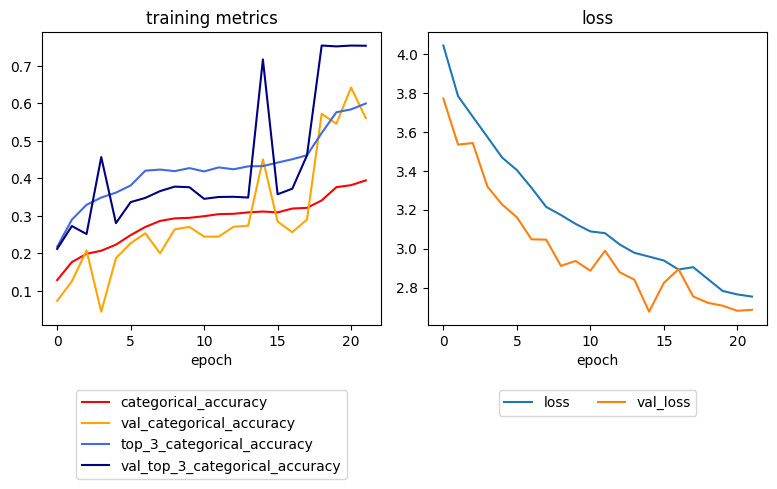

In [18]:
log = pd.read_csv(log_path)

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20*cm, 15*cm))

ax1.plot(log['epoch'], log['categorical_accuracy'], label='categorical_accuracy', color='red')
ax1.plot(log['epoch'], log['val_categorical_accuracy'], label='val_categorical_accuracy', color='orange')
ax1.plot(log['epoch'], log[f'top_{top_k}_categorical_accuracy'], label=f'top_{top_k}_categorical_accuracy', color='royalblue')
ax1.plot(log['epoch'], log[f'val_top_{top_k}_categorical_accuracy'], label=f'val_top_{top_k}_categorical_accuracy', color='navy')
ax1.set_title('training metrics')
ax1.set_xlabel('epoch')
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=1)  # Legend below the plot

ax2.plot(log['epoch'], log['loss'], label='loss')
ax2.plot(log['epoch'], log['val_loss'], label='val_loss')
ax2.set_title('loss')
ax2.set_xlabel('epoch')
ax2.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=2)  # Legend below the plot

fig.tight_layout(rect=[0, 0.1, 1, 1])

plt.savefig(f'{checkpoint_path}/metrics_loss.svg')
plt.show()

In [19]:
# load old model, if needed
if model is None:
    model = load_model(model_path)

In [20]:
# evaluate model
score = model.evaluate(x=Generator(X_test, y_test, 128, max_sequence_length))
print(f'Test loss: {score[0]}')
print(f'Test accuracy: {score[1]}')

  1/407 ━━━━━━━━━━━━━━━━━━━━ 3:48 564ms/step - categorical_accuracy: 0.4766 - loss: 2.3237 - top_3_categorical_accuracy: 0.7344 - w_categorical_accuracy: 0.4766 - w_top_3_categorical_accuracy: 0.7344

  4/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - categorical_accuracy: 0.5151 - loss: 2.4132 - top_3_categorical_accuracy: 0.7409 - w_categorical_accuracy: 0.5151 - w_top_3_categorical_accuracy: 0.7409   

  7/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - categorical_accuracy: 0.5408 - loss: 2.4042 - top_3_categorical_accuracy: 0.7566 - w_categorical_accuracy: 0.5408 - w_top_3_categorical_accuracy: 0.7566

 10/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - categorical_accuracy: 0.5537 - loss: 2.3830 - top_3_categorical_accuracy: 0.7667 - w_categorical_accuracy: 0.5537 - w_top_3_categorical_accuracy: 0.7667

 13/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5604 - loss: 2.3723 - top_3_categorical_accuracy: 0.7719 - w_categorical_accuracy: 0.5604 - w_top_3_categorical_accuracy: 0.7719

 16/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - categorical_accuracy: 0.5655 - loss: 2.3669 - top_3_categorical_accuracy: 0.7744 - w_categorical_accuracy: 0.5655 - w_top_3_categorical_accuracy: 0.7744

 19/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - categorical_accuracy: 0.5691 - loss: 2.3632 - top_3_categorical_accuracy: 0.7764 - w_categorical_accuracy: 0.5691 - w_top_3_categorical_accuracy: 0.7764

 22/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - categorical_accuracy: 0.5723 - loss: 2.3567 - top_3_categorical_accuracy: 0.7785 - w_categorical_accuracy: 0.5723 - w_top_3_categorical_accuracy: 0.7785

 26/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5751 - loss: 2.3519 - top_3_categorical_accuracy: 0.7803 - w_categorical_accuracy: 0.5751 - w_top_3_categorical_accuracy: 0.7803

 29/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5771 - loss: 2.3492 - top_3_categorical_accuracy: 0.7813 - w_categorical_accuracy: 0.5771 - w_top_3_categorical_accuracy: 0.7813

 32/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5788 - loss: 2.3469 - top_3_categorical_accuracy: 0.7819 - w_categorical_accuracy: 0.5788 - w_top_3_categorical_accuracy: 0.7819

 35/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5799 - loss: 2.3455 - top_3_categorical_accuracy: 0.7824 - w_categorical_accuracy: 0.5799 - w_top_3_categorical_accuracy: 0.7824

 38/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5808 - loss: 2.3442 - top_3_categorical_accuracy: 0.7827 - w_categorical_accuracy: 0.5808 - w_top_3_categorical_accuracy: 0.7827

 41/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5816 - loss: 2.3425 - top_3_categorical_accuracy: 0.7831 - w_categorical_accuracy: 0.5816 - w_top_3_categorical_accuracy: 0.7831

 44/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5822 - loss: 2.3412 - top_3_categorical_accuracy: 0.7834 - w_categorical_accuracy: 0.5822 - w_top_3_categorical_accuracy: 0.7834

 47/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5829 - loss: 2.3403 - top_3_categorical_accuracy: 0.7838 - w_categorical_accuracy: 0.5829 - w_top_3_categorical_accuracy: 0.7838

 50/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5836 - loss: 2.3399 - top_3_categorical_accuracy: 0.7841 - w_categorical_accuracy: 0.5836 - w_top_3_categorical_accuracy: 0.7841

 53/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5841 - loss: 2.3394 - top_3_categorical_accuracy: 0.7844 - w_categorical_accuracy: 0.5841 - w_top_3_categorical_accuracy: 0.7844

 56/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5846 - loss: 2.3387 - top_3_categorical_accuracy: 0.7848 - w_categorical_accuracy: 0.5846 - w_top_3_categorical_accuracy: 0.7848

 59/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5850 - loss: 2.3380 - top_3_categorical_accuracy: 0.7852 - w_categorical_accuracy: 0.5850 - w_top_3_categorical_accuracy: 0.7852

 63/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5856 - loss: 2.3372 - top_3_categorical_accuracy: 0.7857 - w_categorical_accuracy: 0.5856 - w_top_3_categorical_accuracy: 0.7857

 66/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5860 - loss: 2.3366 - top_3_categorical_accuracy: 0.7862 - w_categorical_accuracy: 0.5860 - w_top_3_categorical_accuracy: 0.7862

 69/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step - categorical_accuracy: 0.5864 - loss: 2.3360 - top_3_categorical_accuracy: 0.7865 - w_categorical_accuracy: 0.5864 - w_top_3_categorical_accuracy: 0.7865

 72/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5868 - loss: 2.3353 - top_3_categorical_accuracy: 0.7868 - w_categorical_accuracy: 0.5868 - w_top_3_categorical_accuracy: 0.7868

 76/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5873 - loss: 2.3341 - top_3_categorical_accuracy: 0.7872 - w_categorical_accuracy: 0.5873 - w_top_3_categorical_accuracy: 0.7872

 79/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5876 - loss: 2.3331 - top_3_categorical_accuracy: 0.7875 - w_categorical_accuracy: 0.5876 - w_top_3_categorical_accuracy: 0.7875

 81/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5878 - loss: 2.3325 - top_3_categorical_accuracy: 0.7876 - w_categorical_accuracy: 0.5878 - w_top_3_categorical_accuracy: 0.7876

 84/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5881 - loss: 2.3314 - top_3_categorical_accuracy: 0.7879 - w_categorical_accuracy: 0.5881 - w_top_3_categorical_accuracy: 0.7879

 88/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5885 - loss: 2.3301 - top_3_categorical_accuracy: 0.7882 - w_categorical_accuracy: 0.5885 - w_top_3_categorical_accuracy: 0.7882

 92/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5889 - loss: 2.3290 - top_3_categorical_accuracy: 0.7884 - w_categorical_accuracy: 0.5889 - w_top_3_categorical_accuracy: 0.7884

 95/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5892 - loss: 2.3283 - top_3_categorical_accuracy: 0.7886 - w_categorical_accuracy: 0.5892 - w_top_3_categorical_accuracy: 0.7886

 98/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5894 - loss: 2.3276 - top_3_categorical_accuracy: 0.7888 - w_categorical_accuracy: 0.5894 - w_top_3_categorical_accuracy: 0.7888

101/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5897 - loss: 2.3269 - top_3_categorical_accuracy: 0.7889 - w_categorical_accuracy: 0.5897 - w_top_3_categorical_accuracy: 0.7889

104/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5899 - loss: 2.3264 - top_3_categorical_accuracy: 0.7891 - w_categorical_accuracy: 0.5899 - w_top_3_categorical_accuracy: 0.7891

107/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5901 - loss: 2.3261 - top_3_categorical_accuracy: 0.7892 - w_categorical_accuracy: 0.5901 - w_top_3_categorical_accuracy: 0.7892

110/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5903 - loss: 2.3257 - top_3_categorical_accuracy: 0.7893 - w_categorical_accuracy: 0.5903 - w_top_3_categorical_accuracy: 0.7893

113/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5905 - loss: 2.3255 - top_3_categorical_accuracy: 0.7894 - w_categorical_accuracy: 0.5905 - w_top_3_categorical_accuracy: 0.7894

116/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5906 - loss: 2.3252 - top_3_categorical_accuracy: 0.7895 - w_categorical_accuracy: 0.5906 - w_top_3_categorical_accuracy: 0.7895

119/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5908 - loss: 2.3249 - top_3_categorical_accuracy: 0.7897 - w_categorical_accuracy: 0.5908 - w_top_3_categorical_accuracy: 0.7897

123/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step - categorical_accuracy: 0.5911 - loss: 2.3245 - top_3_categorical_accuracy: 0.7898 - w_categorical_accuracy: 0.5911 - w_top_3_categorical_accuracy: 0.7898

126/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5913 - loss: 2.3242 - top_3_categorical_accuracy: 0.7899 - w_categorical_accuracy: 0.5913 - w_top_3_categorical_accuracy: 0.7899

129/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5914 - loss: 2.3239 - top_3_categorical_accuracy: 0.7901 - w_categorical_accuracy: 0.5914 - w_top_3_categorical_accuracy: 0.7901

132/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5916 - loss: 2.3237 - top_3_categorical_accuracy: 0.7902 - w_categorical_accuracy: 0.5916 - w_top_3_categorical_accuracy: 0.7902

135/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5918 - loss: 2.3235 - top_3_categorical_accuracy: 0.7903 - w_categorical_accuracy: 0.5918 - w_top_3_categorical_accuracy: 0.7903

138/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5919 - loss: 2.3233 - top_3_categorical_accuracy: 0.7904 - w_categorical_accuracy: 0.5919 - w_top_3_categorical_accuracy: 0.7904

141/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5920 - loss: 2.3232 - top_3_categorical_accuracy: 0.7904 - w_categorical_accuracy: 0.5920 - w_top_3_categorical_accuracy: 0.7904

144/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5922 - loss: 2.3230 - top_3_categorical_accuracy: 0.7905 - w_categorical_accuracy: 0.5922 - w_top_3_categorical_accuracy: 0.7905

148/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5924 - loss: 2.3228 - top_3_categorical_accuracy: 0.7906 - w_categorical_accuracy: 0.5924 - w_top_3_categorical_accuracy: 0.7906

151/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5925 - loss: 2.3227 - top_3_categorical_accuracy: 0.7907 - w_categorical_accuracy: 0.5925 - w_top_3_categorical_accuracy: 0.7907

154/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5926 - loss: 2.3226 - top_3_categorical_accuracy: 0.7908 - w_categorical_accuracy: 0.5926 - w_top_3_categorical_accuracy: 0.7908

157/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5927 - loss: 2.3225 - top_3_categorical_accuracy: 0.7908 - w_categorical_accuracy: 0.5927 - w_top_3_categorical_accuracy: 0.7908

160/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5928 - loss: 2.3224 - top_3_categorical_accuracy: 0.7909 - w_categorical_accuracy: 0.5928 - w_top_3_categorical_accuracy: 0.7909

163/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5929 - loss: 2.3223 - top_3_categorical_accuracy: 0.7909 - w_categorical_accuracy: 0.5929 - w_top_3_categorical_accuracy: 0.7909

167/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5930 - loss: 2.3222 - top_3_categorical_accuracy: 0.7910 - w_categorical_accuracy: 0.5930 - w_top_3_categorical_accuracy: 0.7910

171/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5931 - loss: 2.3221 - top_3_categorical_accuracy: 0.7911 - w_categorical_accuracy: 0.5931 - w_top_3_categorical_accuracy: 0.7911

174/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5932 - loss: 2.3221 - top_3_categorical_accuracy: 0.7911 - w_categorical_accuracy: 0.5932 - w_top_3_categorical_accuracy: 0.7911

177/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - categorical_accuracy: 0.5933 - loss: 2.3220 - top_3_categorical_accuracy: 0.7912 - w_categorical_accuracy: 0.5933 - w_top_3_categorical_accuracy: 0.7912

181/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5934 - loss: 2.3219 - top_3_categorical_accuracy: 0.7913 - w_categorical_accuracy: 0.5934 - w_top_3_categorical_accuracy: 0.7913

184/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5935 - loss: 2.3218 - top_3_categorical_accuracy: 0.7913 - w_categorical_accuracy: 0.5935 - w_top_3_categorical_accuracy: 0.7913

187/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5936 - loss: 2.3218 - top_3_categorical_accuracy: 0.7914 - w_categorical_accuracy: 0.5936 - w_top_3_categorical_accuracy: 0.7914

190/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5937 - loss: 2.3217 - top_3_categorical_accuracy: 0.7914 - w_categorical_accuracy: 0.5937 - w_top_3_categorical_accuracy: 0.7914

193/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5938 - loss: 2.3216 - top_3_categorical_accuracy: 0.7915 - w_categorical_accuracy: 0.5938 - w_top_3_categorical_accuracy: 0.7915

196/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5939 - loss: 2.3216 - top_3_categorical_accuracy: 0.7915 - w_categorical_accuracy: 0.5939 - w_top_3_categorical_accuracy: 0.7915

199/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5940 - loss: 2.3215 - top_3_categorical_accuracy: 0.7916 - w_categorical_accuracy: 0.5940 - w_top_3_categorical_accuracy: 0.7916

202/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5940 - loss: 2.3214 - top_3_categorical_accuracy: 0.7916 - w_categorical_accuracy: 0.5940 - w_top_3_categorical_accuracy: 0.7916

205/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5941 - loss: 2.3214 - top_3_categorical_accuracy: 0.7916 - w_categorical_accuracy: 0.5941 - w_top_3_categorical_accuracy: 0.7916

208/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5942 - loss: 2.3213 - top_3_categorical_accuracy: 0.7917 - w_categorical_accuracy: 0.5942 - w_top_3_categorical_accuracy: 0.7917

211/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5943 - loss: 2.3212 - top_3_categorical_accuracy: 0.7917 - w_categorical_accuracy: 0.5943 - w_top_3_categorical_accuracy: 0.7917

215/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5944 - loss: 2.3211 - top_3_categorical_accuracy: 0.7918 - w_categorical_accuracy: 0.5944 - w_top_3_categorical_accuracy: 0.7918

218/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5945 - loss: 2.3210 - top_3_categorical_accuracy: 0.7918 - w_categorical_accuracy: 0.5945 - w_top_3_categorical_accuracy: 0.7918

221/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5945 - loss: 2.3209 - top_3_categorical_accuracy: 0.7918 - w_categorical_accuracy: 0.5945 - w_top_3_categorical_accuracy: 0.7918

224/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5946 - loss: 2.3209 - top_3_categorical_accuracy: 0.7919 - w_categorical_accuracy: 0.5946 - w_top_3_categorical_accuracy: 0.7919

227/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - categorical_accuracy: 0.5947 - loss: 2.3208 - top_3_categorical_accuracy: 0.7919 - w_categorical_accuracy: 0.5947 - w_top_3_categorical_accuracy: 0.7919

230/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.5947 - loss: 2.3207 - top_3_categorical_accuracy: 0.7920 - w_categorical_accuracy: 0.5947 - w_top_3_categorical_accuracy: 0.7920

233/407 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - categorical_accuracy: 0.5948 - loss: 2.3206 - top_3_categorical_accuracy: 0.7920 - w_categorical_accuracy: 0.5948 - w_top_3_categorical_accuracy: 0.7920

237/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5949 - loss: 2.3205 - top_3_categorical_accuracy: 0.7920 - w_categorical_accuracy: 0.5949 - w_top_3_categorical_accuracy: 0.7920

240/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5950 - loss: 2.3205 - top_3_categorical_accuracy: 0.7921 - w_categorical_accuracy: 0.5950 - w_top_3_categorical_accuracy: 0.7921

243/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5950 - loss: 2.3204 - top_3_categorical_accuracy: 0.7921 - w_categorical_accuracy: 0.5950 - w_top_3_categorical_accuracy: 0.7921

246/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5951 - loss: 2.3204 - top_3_categorical_accuracy: 0.7921 - w_categorical_accuracy: 0.5951 - w_top_3_categorical_accuracy: 0.7921

249/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5952 - loss: 2.3203 - top_3_categorical_accuracy: 0.7922 - w_categorical_accuracy: 0.5952 - w_top_3_categorical_accuracy: 0.7922

252/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5952 - loss: 2.3202 - top_3_categorical_accuracy: 0.7922 - w_categorical_accuracy: 0.5952 - w_top_3_categorical_accuracy: 0.7922

255/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5953 - loss: 2.3202 - top_3_categorical_accuracy: 0.7923 - w_categorical_accuracy: 0.5953 - w_top_3_categorical_accuracy: 0.7923

258/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5954 - loss: 2.3201 - top_3_categorical_accuracy: 0.7923 - w_categorical_accuracy: 0.5954 - w_top_3_categorical_accuracy: 0.7923

261/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5954 - loss: 2.3200 - top_3_categorical_accuracy: 0.7923 - w_categorical_accuracy: 0.5954 - w_top_3_categorical_accuracy: 0.7923

264/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5955 - loss: 2.3200 - top_3_categorical_accuracy: 0.7924 - w_categorical_accuracy: 0.5955 - w_top_3_categorical_accuracy: 0.7924

267/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5956 - loss: 2.3199 - top_3_categorical_accuracy: 0.7924 - w_categorical_accuracy: 0.5956 - w_top_3_categorical_accuracy: 0.7924

270/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5956 - loss: 2.3198 - top_3_categorical_accuracy: 0.7925 - w_categorical_accuracy: 0.5956 - w_top_3_categorical_accuracy: 0.7925

273/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5957 - loss: 2.3196 - top_3_categorical_accuracy: 0.7925 - w_categorical_accuracy: 0.5957 - w_top_3_categorical_accuracy: 0.7925

276/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5958 - loss: 2.3195 - top_3_categorical_accuracy: 0.7925 - w_categorical_accuracy: 0.5958 - w_top_3_categorical_accuracy: 0.7925

280/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5958 - loss: 2.3194 - top_3_categorical_accuracy: 0.7926 - w_categorical_accuracy: 0.5958 - w_top_3_categorical_accuracy: 0.7926

284/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5959 - loss: 2.3192 - top_3_categorical_accuracy: 0.7926 - w_categorical_accuracy: 0.5959 - w_top_3_categorical_accuracy: 0.7926

287/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5960 - loss: 2.3191 - top_3_categorical_accuracy: 0.7927 - w_categorical_accuracy: 0.5960 - w_top_3_categorical_accuracy: 0.7927

291/407 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - categorical_accuracy: 0.5961 - loss: 2.3189 - top_3_categorical_accuracy: 0.7927 - w_categorical_accuracy: 0.5961 - w_top_3_categorical_accuracy: 0.7927

294/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5961 - loss: 2.3188 - top_3_categorical_accuracy: 0.7927 - w_categorical_accuracy: 0.5961 - w_top_3_categorical_accuracy: 0.7927

297/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5962 - loss: 2.3186 - top_3_categorical_accuracy: 0.7928 - w_categorical_accuracy: 0.5962 - w_top_3_categorical_accuracy: 0.7928

300/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5962 - loss: 2.3185 - top_3_categorical_accuracy: 0.7928 - w_categorical_accuracy: 0.5962 - w_top_3_categorical_accuracy: 0.7928

303/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5963 - loss: 2.3184 - top_3_categorical_accuracy: 0.7928 - w_categorical_accuracy: 0.5963 - w_top_3_categorical_accuracy: 0.7928

306/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5963 - loss: 2.3182 - top_3_categorical_accuracy: 0.7929 - w_categorical_accuracy: 0.5963 - w_top_3_categorical_accuracy: 0.7929

309/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5964 - loss: 2.3181 - top_3_categorical_accuracy: 0.7929 - w_categorical_accuracy: 0.5964 - w_top_3_categorical_accuracy: 0.7929

312/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5965 - loss: 2.3180 - top_3_categorical_accuracy: 0.7929 - w_categorical_accuracy: 0.5965 - w_top_3_categorical_accuracy: 0.7929

315/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5965 - loss: 2.3178 - top_3_categorical_accuracy: 0.7930 - w_categorical_accuracy: 0.5965 - w_top_3_categorical_accuracy: 0.7930

318/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5966 - loss: 2.3177 - top_3_categorical_accuracy: 0.7930 - w_categorical_accuracy: 0.5966 - w_top_3_categorical_accuracy: 0.7930

321/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5966 - loss: 2.3175 - top_3_categorical_accuracy: 0.7930 - w_categorical_accuracy: 0.5966 - w_top_3_categorical_accuracy: 0.7930

325/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5967 - loss: 2.3174 - top_3_categorical_accuracy: 0.7931 - w_categorical_accuracy: 0.5967 - w_top_3_categorical_accuracy: 0.7931

328/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5968 - loss: 2.3173 - top_3_categorical_accuracy: 0.7931 - w_categorical_accuracy: 0.5968 - w_top_3_categorical_accuracy: 0.7931

332/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5968 - loss: 2.3171 - top_3_categorical_accuracy: 0.7931 - w_categorical_accuracy: 0.5968 - w_top_3_categorical_accuracy: 0.7931

335/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5969 - loss: 2.3170 - top_3_categorical_accuracy: 0.7932 - w_categorical_accuracy: 0.5969 - w_top_3_categorical_accuracy: 0.7932

338/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5969 - loss: 2.3169 - top_3_categorical_accuracy: 0.7932 - w_categorical_accuracy: 0.5969 - w_top_3_categorical_accuracy: 0.7932

342/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5970 - loss: 2.3167 - top_3_categorical_accuracy: 0.7932 - w_categorical_accuracy: 0.5970 - w_top_3_categorical_accuracy: 0.7932

345/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5970 - loss: 2.3166 - top_3_categorical_accuracy: 0.7933 - w_categorical_accuracy: 0.5970 - w_top_3_categorical_accuracy: 0.7933

348/407 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - categorical_accuracy: 0.5971 - loss: 2.3165 - top_3_categorical_accuracy: 0.7933 - w_categorical_accuracy: 0.5971 - w_top_3_categorical_accuracy: 0.7933

351/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5971 - loss: 2.3164 - top_3_categorical_accuracy: 0.7933 - w_categorical_accuracy: 0.5971 - w_top_3_categorical_accuracy: 0.7933

354/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5972 - loss: 2.3163 - top_3_categorical_accuracy: 0.7933 - w_categorical_accuracy: 0.5972 - w_top_3_categorical_accuracy: 0.7933

357/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5972 - loss: 2.3162 - top_3_categorical_accuracy: 0.7934 - w_categorical_accuracy: 0.5972 - w_top_3_categorical_accuracy: 0.7934

360/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5973 - loss: 2.3162 - top_3_categorical_accuracy: 0.7934 - w_categorical_accuracy: 0.5973 - w_top_3_categorical_accuracy: 0.7934

363/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5973 - loss: 2.3161 - top_3_categorical_accuracy: 0.7934 - w_categorical_accuracy: 0.5973 - w_top_3_categorical_accuracy: 0.7934

366/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5974 - loss: 2.3160 - top_3_categorical_accuracy: 0.7934 - w_categorical_accuracy: 0.5974 - w_top_3_categorical_accuracy: 0.7934

369/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5974 - loss: 2.3159 - top_3_categorical_accuracy: 0.7934 - w_categorical_accuracy: 0.5974 - w_top_3_categorical_accuracy: 0.7934

372/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5974 - loss: 2.3158 - top_3_categorical_accuracy: 0.7935 - w_categorical_accuracy: 0.5974 - w_top_3_categorical_accuracy: 0.7935

376/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5975 - loss: 2.3157 - top_3_categorical_accuracy: 0.7935 - w_categorical_accuracy: 0.5975 - w_top_3_categorical_accuracy: 0.7935

379/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5975 - loss: 2.3156 - top_3_categorical_accuracy: 0.7935 - w_categorical_accuracy: 0.5975 - w_top_3_categorical_accuracy: 0.7935

382/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5976 - loss: 2.3155 - top_3_categorical_accuracy: 0.7935 - w_categorical_accuracy: 0.5976 - w_top_3_categorical_accuracy: 0.7935

385/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5976 - loss: 2.3155 - top_3_categorical_accuracy: 0.7935 - w_categorical_accuracy: 0.5976 - w_top_3_categorical_accuracy: 0.7935

388/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5976 - loss: 2.3154 - top_3_categorical_accuracy: 0.7936 - w_categorical_accuracy: 0.5976 - w_top_3_categorical_accuracy: 0.7936

391/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5977 - loss: 2.3153 - top_3_categorical_accuracy: 0.7936 - w_categorical_accuracy: 0.5977 - w_top_3_categorical_accuracy: 0.7936

394/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5977 - loss: 2.3152 - top_3_categorical_accuracy: 0.7936 - w_categorical_accuracy: 0.5977 - w_top_3_categorical_accuracy: 0.7936

397/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5978 - loss: 2.3151 - top_3_categorical_accuracy: 0.7936 - w_categorical_accuracy: 0.5978 - w_top_3_categorical_accuracy: 0.7936

400/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5978 - loss: 2.3150 - top_3_categorical_accuracy: 0.7936 - w_categorical_accuracy: 0.5978 - w_top_3_categorical_accuracy: 0.7936

403/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - categorical_accuracy: 0.5978 - loss: 2.3149 - top_3_categorical_accuracy: 0.7936 - w_categorical_accuracy: 0.5978 - w_top_3_categorical_accuracy: 0.7936

407/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.5979 - loss: 2.3148 - top_3_categorical_accuracy: 0.7937 - w_categorical_accuracy: 0.5979 - w_top_3_categorical_accuracy: 0.7937

407/407 ━━━━━━━━━━━━━━━━━━━━ 8s 19ms/step - categorical_accuracy: 0.5979 - loss: 2.3148 - top_3_categorical_accuracy: 0.7937 - w_categorical_accuracy: 0.5979 - w_top_3_categorical_accuracy: 0.7937


Test loss: 2.301995277404785
Test accuracy: 0.602392315864563


In [21]:
# print classification report
y_pred = model.predict(x=Generator(X_test, y_test, 128, max_sequence_length))
y_pred = np.argmax(y_pred, axis=1)
y_true = np.argmax(y_test, axis=1)

distinct_labels = [labels_map[i] for i in range(labels_cardinality)]

report = classification_report(y_true, y_pred, target_names=distinct_labels, zero_division=np.nan)
report_dict = classification_report(y_true, y_pred, target_names=distinct_labels, zero_division=np.nan, output_dict=True)

print(report)

# save classification report to file
with open(f'{checkpoint_path}/classification_report.txt', 'w') as f:
    json.dump(report_dict, f)

  1/407 ━━━━━━━━━━━━━━━━━━━━ 5:17 781ms/step

  4/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step   

  7/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step

 11/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step

 15/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 19/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 23/407 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step

 26/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 30/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 34/407 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step

 38/407 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step

 42/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 46/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 50/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 54/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 58/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 62/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 65/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 69/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 73/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 77/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 80/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 83/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 87/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step

 91/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

 95/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

 99/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

103/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

107/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

111/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

115/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

118/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

122/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

126/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

130/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

134/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

137/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

141/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

145/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

149/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step

153/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

157/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

161/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

165/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

169/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

173/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

177/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

181/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

185/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

189/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

193/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

197/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

201/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

205/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

208/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

211/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step

215/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

219/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

223/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

227/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

231/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

234/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

238/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

242/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

246/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

250/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

254/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

258/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

262/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

266/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

270/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

274/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

278/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

282/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

286/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

290/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

293/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

297/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

301/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

305/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

309/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

312/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

316/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

320/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

323/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

326/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

330/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

334/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

338/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

342/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step

346/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

350/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

354/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

358/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

362/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

366/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

370/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

374/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

378/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

381/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

385/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

389/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

392/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

397/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

401/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

405/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

407/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step

407/407 ━━━━━━━━━━━━━━━━━━━━ 8s 17ms/step


                 precision    recall  f1-score   support

      adjkerntz       0.00      0.00      0.00        11
         alpine       0.42      0.59      0.49       560
          anvil       0.27      0.17      0.21       378
          atrun       0.21      1.00      0.35       237
            awk        nan      0.00      0.00         5
       basename        nan      0.00      0.00         2
           bash       0.93      0.96      0.94     12512
            cat        nan      0.00      0.00        26
        cleanup       0.38      0.44      0.41       276
            cmp        nan      0.00      0.00         5
             cp        nan      0.00      0.00        30
           cron       0.00      0.00      0.00       624
           date        nan      0.00      0.00      1218
             dd        nan      0.00      0.00       125
       dhclient       0.00      0.12      0.00        17
          dmesg       0.07      1.00      0.13        15
          egrep       0.00    

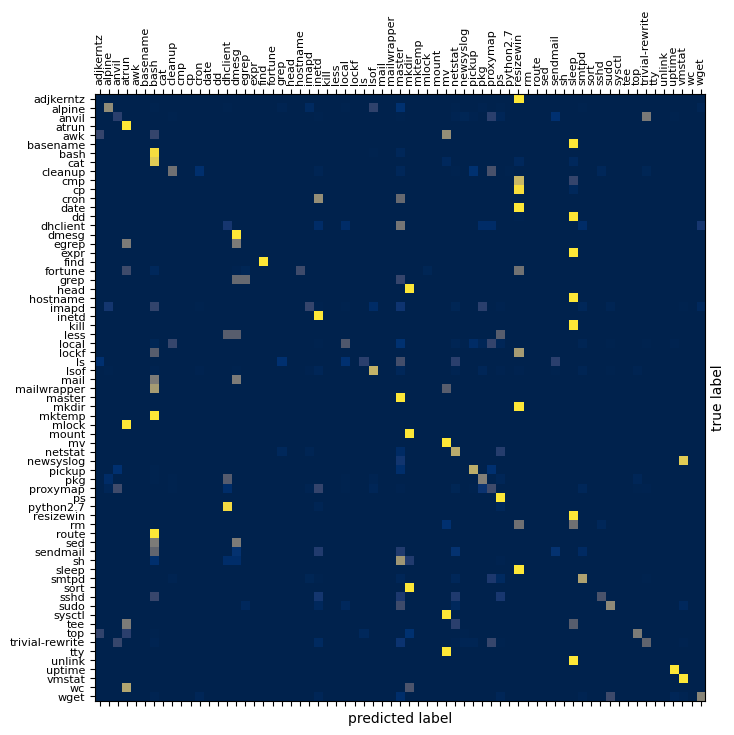

In [22]:
# print confusion matrix
# labels explicitly set, because current model may not predict all labels
conf_matrix = confusion_matrix(y_true, y_pred, labels=range(labels_cardinality), normalize='true')

# Replace all NaN values with 0
conf_matrix = np.nan_to_num(conf_matrix)

# Verify the distinct labels align correctly
distinct_labels = [labels_map[i] for i in range(labels_cardinality)]

# Plot the confusion matrix
fig, ax = plt.subplots(figsize=(20*cm, 20*cm))

ax.matshow(conf_matrix, cmap='cividis', aspect='auto')

# Set class names on axes
ax.set_xticks(range(len(distinct_labels)))
ax.set_yticks(range(len(distinct_labels)))
ax.set_xticklabels(distinct_labels, rotation=90, fontsize=8)
ax.set_yticklabels(distinct_labels, fontsize=8)

# Set axis labels "predicted" and "actual"
ax.set_xlabel('predicted label')
ax.set_ylabel('true label')
# y-axis label right side
ax.yaxis.set_label_position('right')

# set figsize
plt.savefig(f'{checkpoint_path}/confusion_matrix.svg')
plt.show()

In [23]:
unique_in_y_pred = [ labels_map[i] for i in np.unique(y_pred) ]
#print("Unique labels in y_pred:", unique_in_y_pred)

unique_not_in_y_pred = [ label for label in distinct_labels if label not in unique_in_y_pred ]
print("Unique labels not in y_pred:", unique_not_in_y_pred)

Unique labels not in y_pred: ['awk', 'basename', 'cat', 'cmp', 'cp', 'date', 'dd', 'expr', 'fortune', 'kill', 'lockf', 'mail', 'mailwrapper', 'mktemp', 'mount', 'rm', 'route', 'sh', 'sort', 'sysctl', 'tee', 'tty', 'unlink', 'wc']
